In [1]:
import os, sys
sys.path.append(os.path.dirname(os.path.dirname(os.path.abspath("./notebooks"))))

In [2]:
from tensorflow.keras import layers;
from tensorflow.keras import losses;
from tensorflow.keras import optimizers;
from dataset import Dataset;
from hyperparameter import HyperParameter;
from hyperparameter_search import HyperParameterSearch;
    
dataset_vector_25 = Dataset("../../preprocessed/row_size25_vector_size2000.csv")
dataset_vector_100 = Dataset("../../preprocessed/row_size100_vector_size2000.csv")

dataset_lambda_pair_set = [
    # 4 layer Dense Sigmoid
    (
        dataset_vector_25,
        lambda: (
            [
                layers.Dense(256, input_dim=dataset_vector_25.getInDimension(), activation="sigmoid"),
                layers.Dense(128, activation="sigmoid"),
                layers.Dense(64, activation="sigmoid"),
                layers.Dense(32, activation="sigmoid"),
                layers.Dense(dataset_vector_25.getOutDimension())
            ]
        ),
        '[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")]',
    ),
    (
        dataset_vector_100,
        lambda: (
            [
                layers.Dense(256, input_dim=dataset_vector_100.getInDimension(), activation="sigmoid"),
                layers.Dense(128, activation="sigmoid"),
                layers.Dense(64, activation="sigmoid"),
                layers.Dense(32, activation="sigmoid"),
                layers.Dense(dataset_vector_100.getOutDimension())
            ]
        ),
        '[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")]',
    ),
];
loss_set = [
    losses.mean_squared_error,
    # losses.mean_absolute_error,
    # losses.mean_absolute_percentage_error,
    # losses.mean_squared_logarithmic_error,
    # losses.cosine_similarity,
    # losses.huber,
    # losses.log_cosh
]
optimizer_set = [
    optimizers.SGD,
    optimizers.RMSprop,
    optimizers.Adam,
    optimizers.Adadelta,
    optimizers.Adagrad,
    optimizers.Adamax,
    optimizers.Nadam,
    optimizers.Ftrl
]
epoch_set = [
    30, 
    50, 
    75, 
    100
]
batch_size_set = [
    12, 
    18, 
    24, 
    32, 
    40
]
search = HyperParameterSearch();
parameters = search.createParameterSet(dataset_lambda_pair_set, loss_set, optimizer_set, epoch_set, batch_size_set)

print(str(parameters[0]))

search.run(parameters);

print(search.results)

Progress: [####################] 100.0%
{'Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90a00>, epochs=30, batch_size=12': {'estimator': <state_estimator.StateEstimator object at 0x7fba51bf2790>, 'metrics': [[-0.010871376098850138, 0.11326035463571643, 0.05196808762778849, 1077.789893356452, 0.004138748171104073, 1.712923642381731e-05], [-0.0011004651629380469, 0.10882342541724006, 0.051247919737994765, 131.05371739578663, 0.0038385112719844026, 1.4734168785151317e-05], [0.0019183495303264353, 1.5645948286798539, 0.1020440246941789, 79.82820506270609, 0.08315792027376155, 0.006915239704257283], [-32.582251100644875, 0.021569607570025916, 0.002112705163893221, 295189.51362274325, 1

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90a00>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.09e-02	1.13e-01	5.20e-02	1.08e+03	4.14e-03	1.71e-05
y		-1.10e-03	1.09e-01	5.12e-02	1.31e+02	3.84e-03	1.47e-05
z		1.92e-03	1.56e+00	1.02e-01	7.98e+01	8.32e-02	6.92e-03
phi		-3.26e+01	2.16e-02	2.11e-03	2.95e+05	1.22e-05	1.48e-10
theta		-3.84e+01	2.13e-02	2.12e-03	1.05e+05	1.22e-05	1.48e-10
psi		-1.65e+01	2.23e-02	2.23e-03	1.84e+05	1.31e-05	1.71e-10


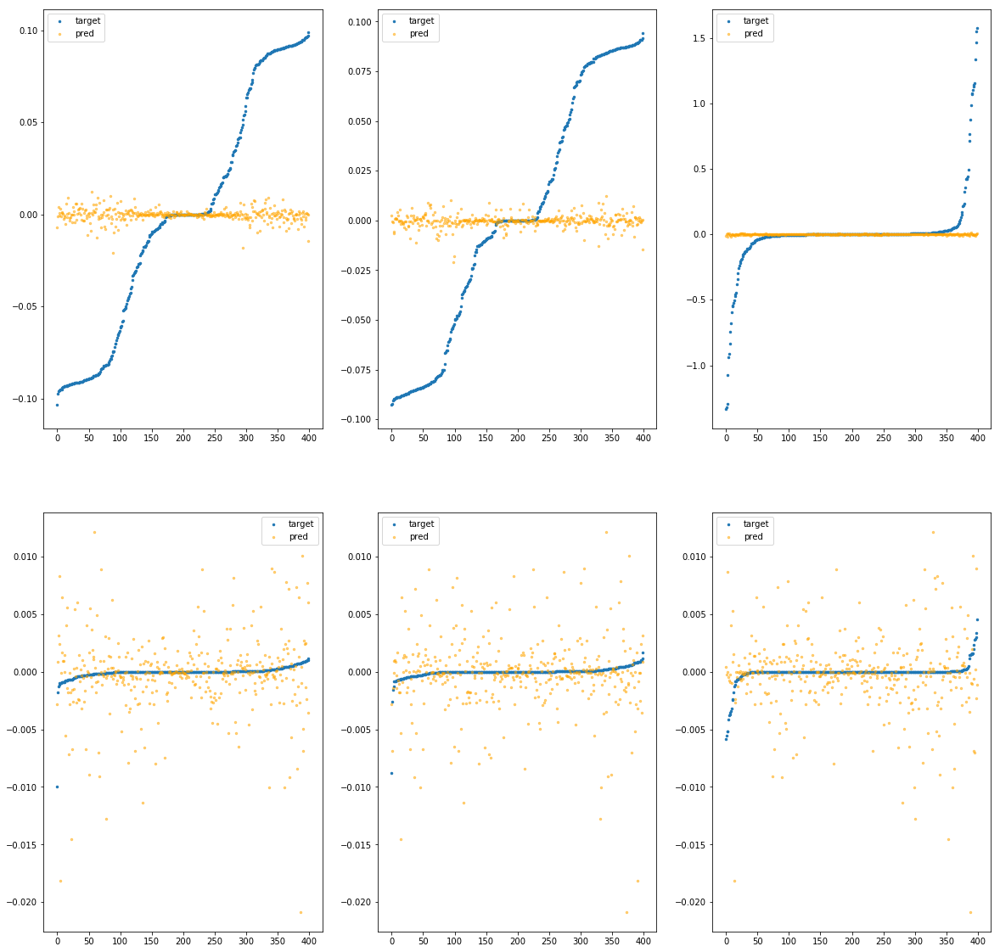

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90a60>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		4.94e-03	1.11e-01	5.17e-02	3.36e+03	4.07e-03	1.66e-05
y		-1.18e-02	1.06e-01	5.14e-02	1.29e+02	3.88e-03	1.50e-05
z		-1.13e-03	1.58e+00	1.02e-01	9.92e+01	8.34e-02	6.96e-03
phi		-3.54e+01	2.04e-02	2.23e-03	7.27e+05	1.32e-05	1.74e-10
theta		-4.20e+01	2.11e-02	2.23e-03	1.46e+05	1.33e-05	1.77e-10
psi		-1.68e+01	2.08e-02	2.29e-03	1.44e+05	1.33e-05	1.78e-10


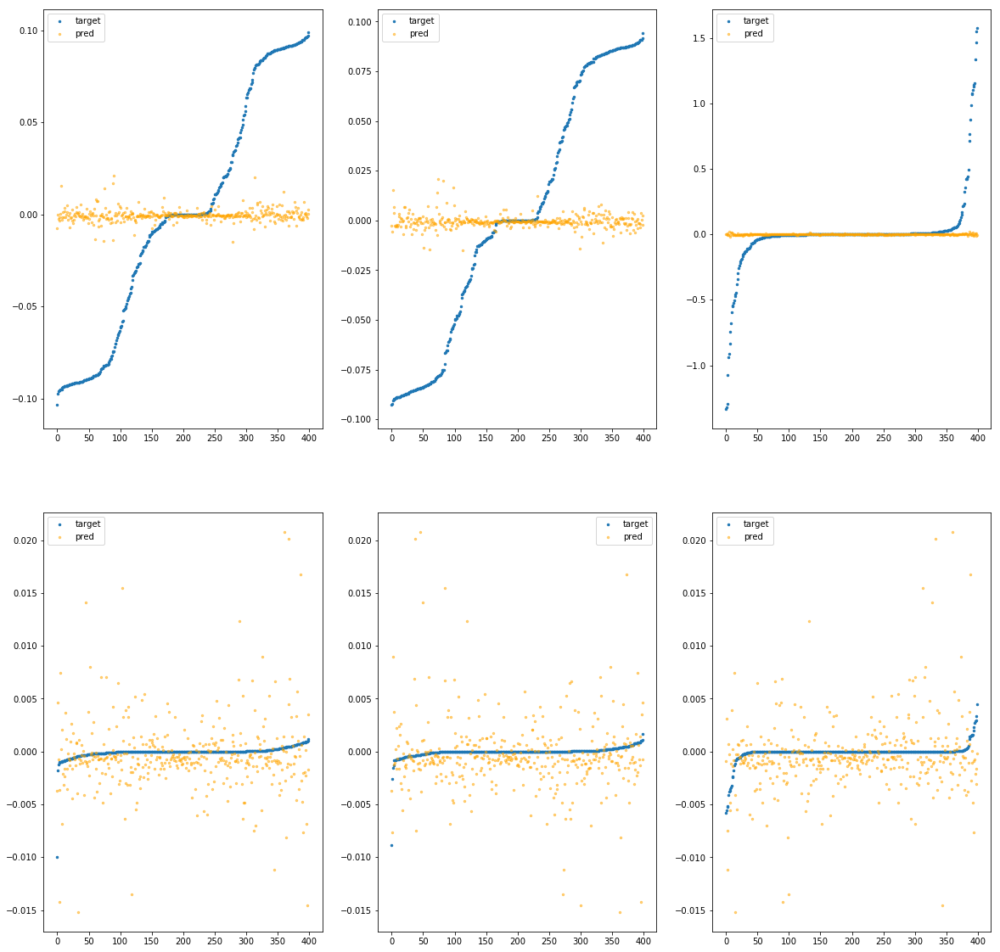

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90ac0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.55e-03	1.06e-01	5.17e-02	3.55e+03	4.08e-03	1.66e-05
y		-4.70e-03	1.01e-01	5.12e-02	2.31e+02	3.85e-03	1.48e-05
z		-3.85e-03	1.57e+00	1.02e-01	1.23e+02	8.36e-02	7.00e-03
phi		-2.02e+01	1.36e-02	1.83e-03	4.69e+05	7.67e-06	5.88e-11
theta		-2.36e+01	1.36e-02	1.83e-03	1.62e+05	7.59e-06	5.75e-11
psi		-9.86e+00	1.36e-02	1.87e-03	1.59e+05	8.14e-06	6.63e-11


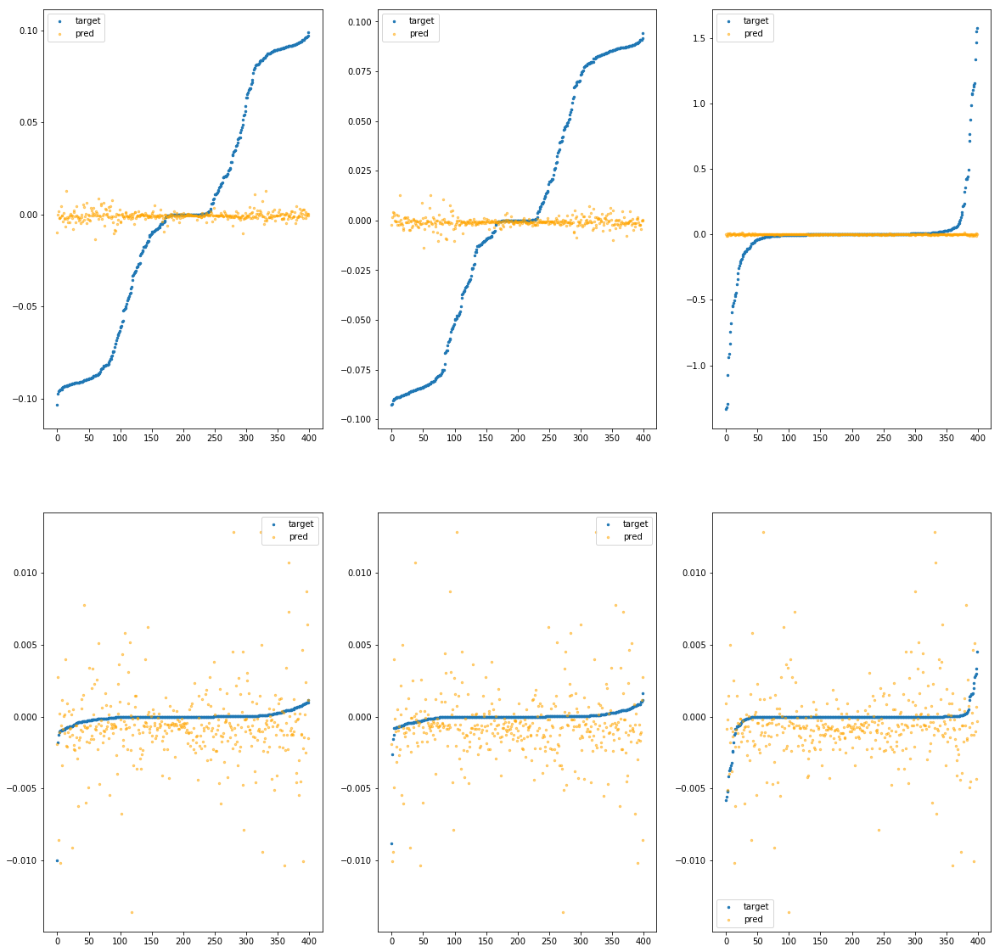

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90b20>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.14e-02	1.19e-01	5.20e-02	2.14e+03	4.14e-03	1.71e-05
y		-1.23e-02	1.02e-01	5.14e-02	1.01e+02	3.88e-03	1.51e-05
z		4.01e-03	1.58e+00	1.02e-01	7.73e+01	8.30e-02	6.89e-03
phi		-3.15e+01	2.08e-02	1.95e-03	3.27e+05	1.18e-05	1.39e-10
theta		-3.80e+01	2.03e-02	1.99e-03	1.12e+05	1.20e-05	1.45e-10
psi		-1.42e+01	1.93e-02	1.97e-03	8.33e+04	1.14e-05	1.29e-10


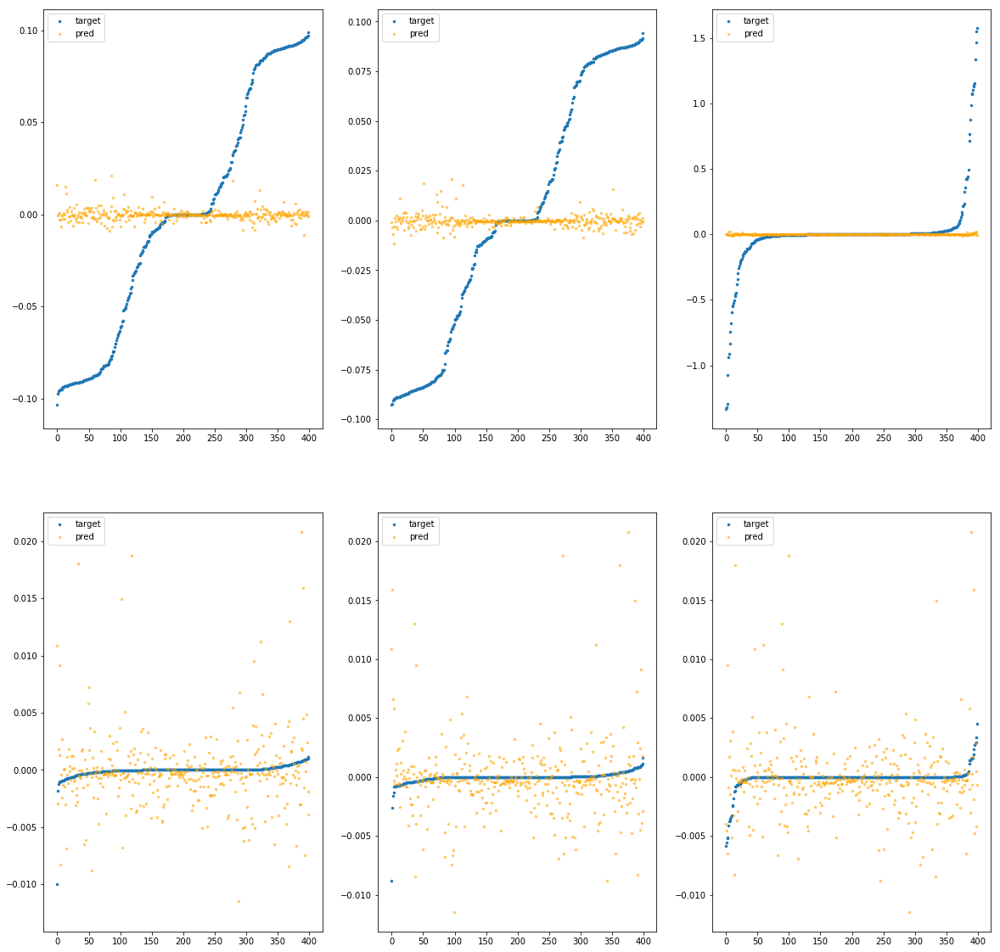

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90b80>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.17e-03	1.12e-01	5.19e-02	1.65e+03	4.13e-03	1.70e-05
y		-7.62e-03	1.01e-01	5.14e-02	1.01e+02	3.86e-03	1.49e-05
z		-2.86e-03	1.56e+00	1.02e-01	6.32e+01	8.36e-02	6.98e-03
phi		-4.36e+01	2.60e-02	2.21e-03	2.98e+05	1.61e-05	2.60e-10
theta		-4.97e+01	2.42e-02	2.19e-03	8.55e+04	1.57e-05	2.45e-10
psi		-2.07e+01	2.62e-02	2.26e-03	8.55e+04	1.63e-05	2.65e-10


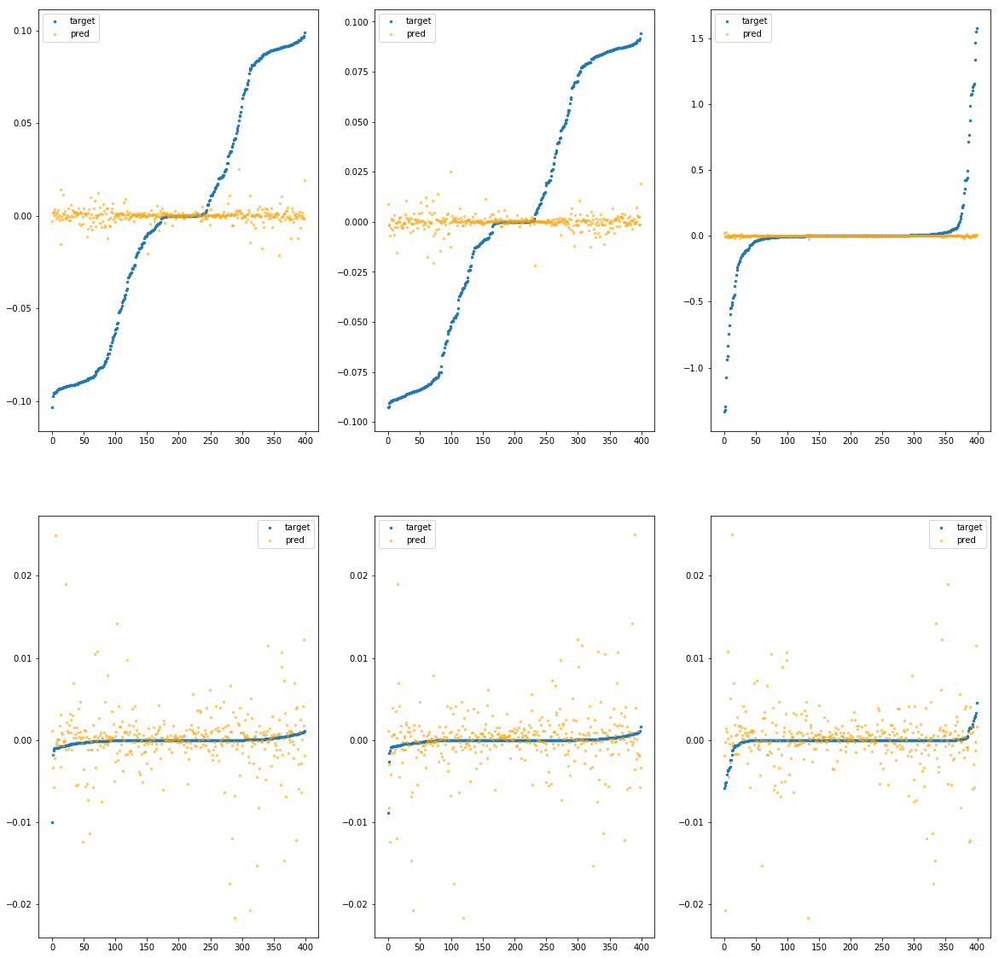

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90be0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.48e-03	1.08e-01	5.20e-02	2.43e+03	4.11e-03	1.69e-05
y		-6.30e-03	1.04e-01	5.13e-02	7.43e+01	3.86e-03	1.49e-05
z		4.86e-04	1.58e+00	1.02e-01	1.28e+02	8.33e-02	6.94e-03
phi		-5.49e+01	2.14e-02	2.86e-03	4.70e+05	2.02e-05	4.10e-10
theta		-6.50e+01	2.12e-02	2.88e-03	8.34e+04	2.04e-05	4.15e-10
psi		-2.58e+01	2.07e-02	2.89e-03	2.61e+05	2.01e-05	4.03e-10


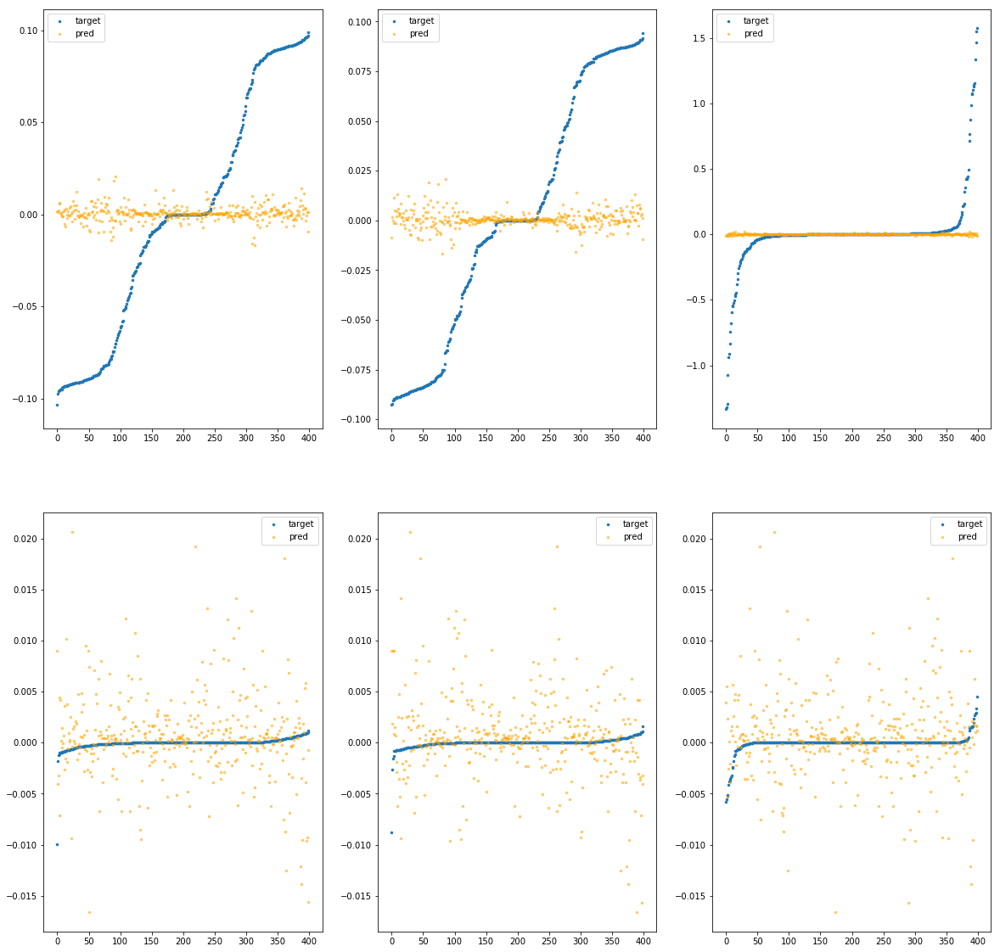

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90c40>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.88e-02	1.16e-01	5.21e-02	1.81e+03	4.17e-03	1.74e-05
y		-1.13e-02	1.12e-01	5.13e-02	3.44e+01	3.88e-03	1.50e-05
z		1.61e-03	1.58e+00	1.02e-01	4.23e+01	8.32e-02	6.92e-03
phi		-5.83e+01	3.47e-02	2.42e-03	3.60e+05	2.15e-05	4.62e-10
theta		-6.91e+01	3.45e-02	2.42e-03	6.81e+04	2.17e-05	4.69e-10
psi		-2.79e+01	3.56e-02	2.46e-03	1.81e+05	2.17e-05	4.69e-10


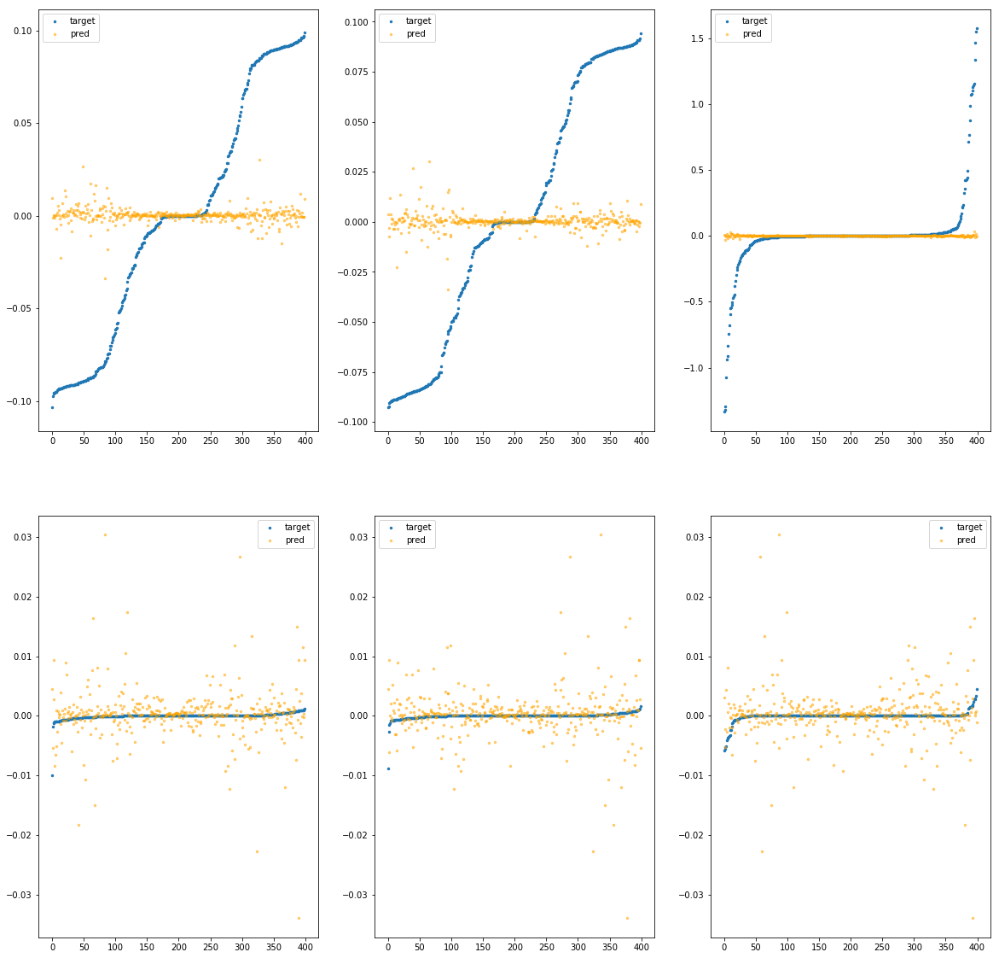

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90ca0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.61e-02	1.11e-01	5.21e-02	3.40e+03	4.16e-03	1.73e-05
y		-2.85e-02	1.07e-01	5.19e-02	7.94e+01	3.94e-03	1.56e-05
z		-6.52e-03	1.58e+00	1.03e-01	7.80e+01	8.39e-02	7.03e-03
phi		-6.47e+01	2.64e-02	2.91e-03	5.89e+05	2.38e-05	5.66e-10
theta		-7.63e+01	2.58e-02	2.92e-03	1.08e+05	2.39e-05	5.69e-10
psi		-3.09e+01	2.59e-02	2.98e-03	2.19e+05	2.39e-05	5.72e-10


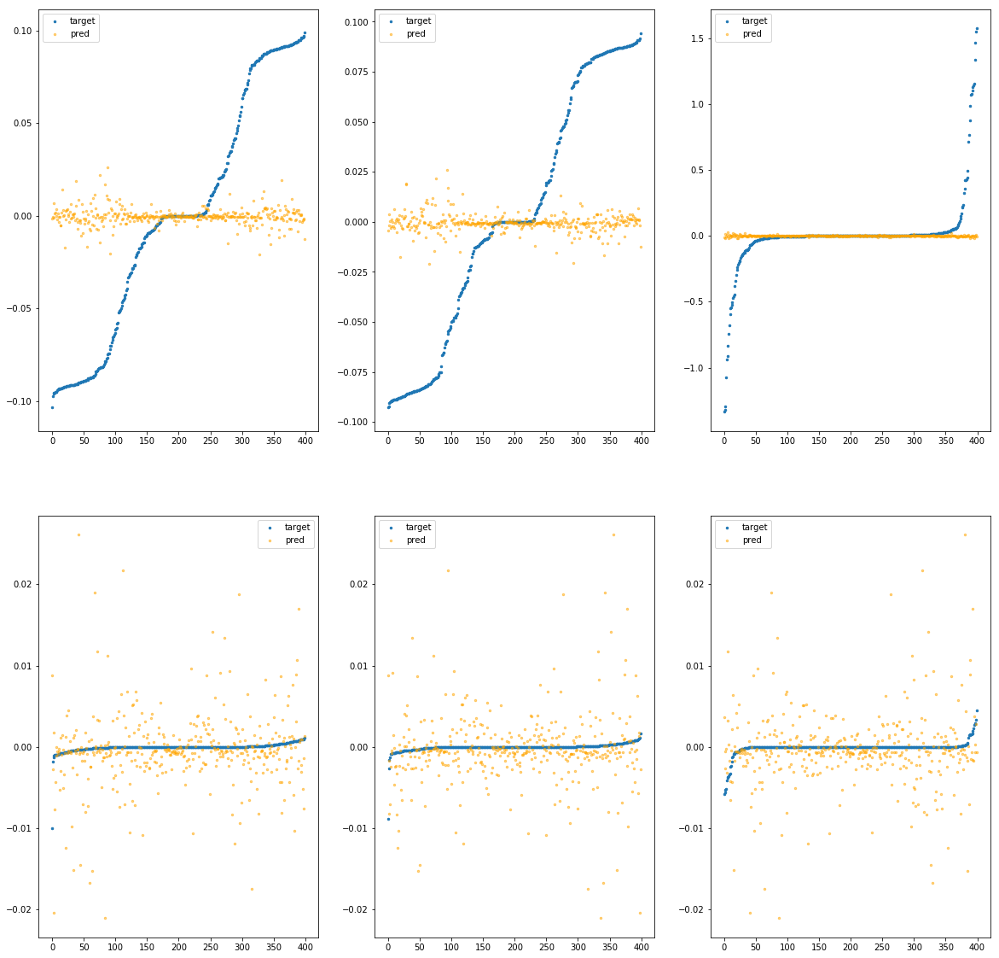

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90d00>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.48e-03	1.02e-01	5.16e-02	1.26e+03	4.08e-03	1.66e-05
y		4.54e-03	9.82e-02	5.10e-02	9.73e+01	3.82e-03	1.46e-05
z		1.41e-03	1.55e+00	1.02e-01	5.73e+01	8.32e-02	6.92e-03
phi		-3.42e+01	2.49e-02	2.08e-03	2.29e+05	1.27e-05	1.62e-10
theta		-4.00e+01	2.49e-02	2.08e-03	8.17e+04	1.27e-05	1.60e-10
psi		-1.60e+01	2.49e-02	2.11e-03	1.88e+05	1.27e-05	1.62e-10


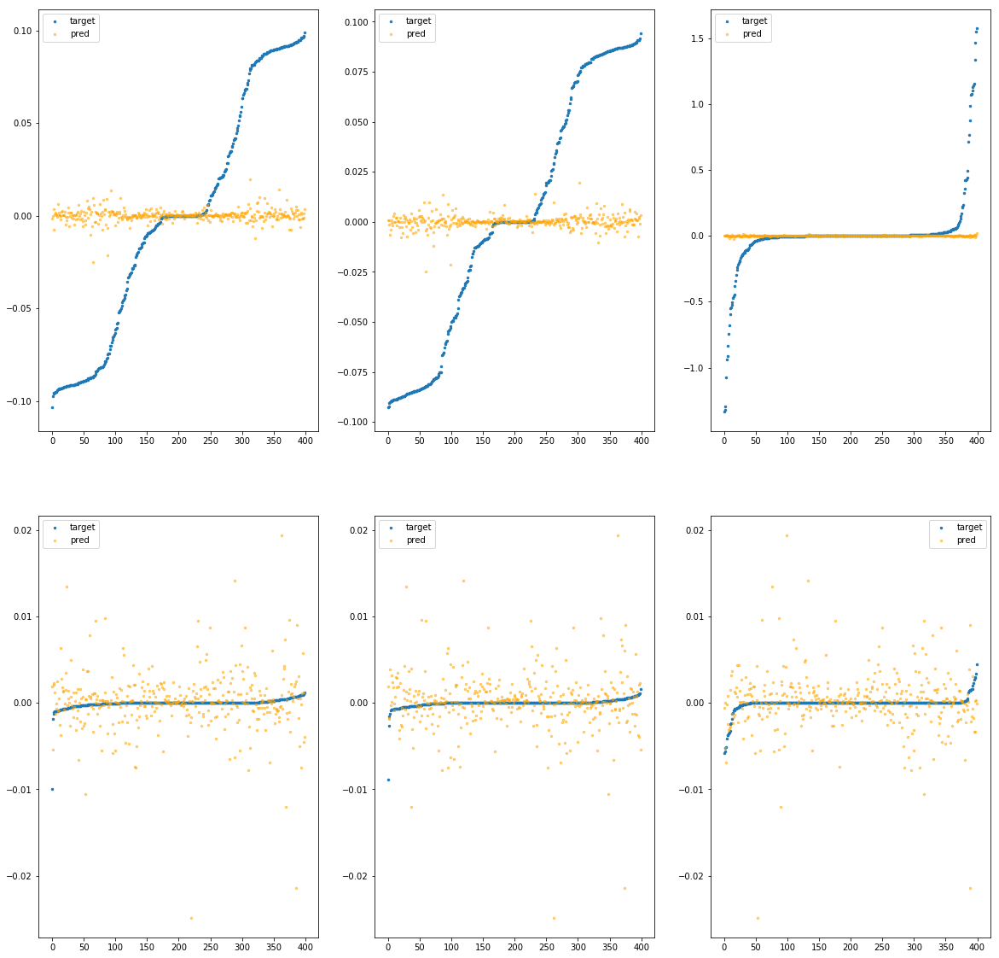

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90d60>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	1.06e-01	5.18e-02	1.34e+03	4.10e-03	1.68e-05
y		-7.71e-03	9.98e-02	5.13e-02	4.41e+01	3.86e-03	1.49e-05
z		1.27e-03	1.56e+00	1.02e-01	5.51e+01	8.32e-02	6.92e-03
phi		-2.57e+01	1.50e-02	1.81e-03	3.10e+05	9.65e-06	9.32e-11
theta		-3.05e+01	1.44e-02	1.80e-03	5.46e+04	9.73e-06	9.46e-11
psi		-1.26e+01	1.50e-02	1.85e-03	1.29e+05	1.02e-05	1.04e-10


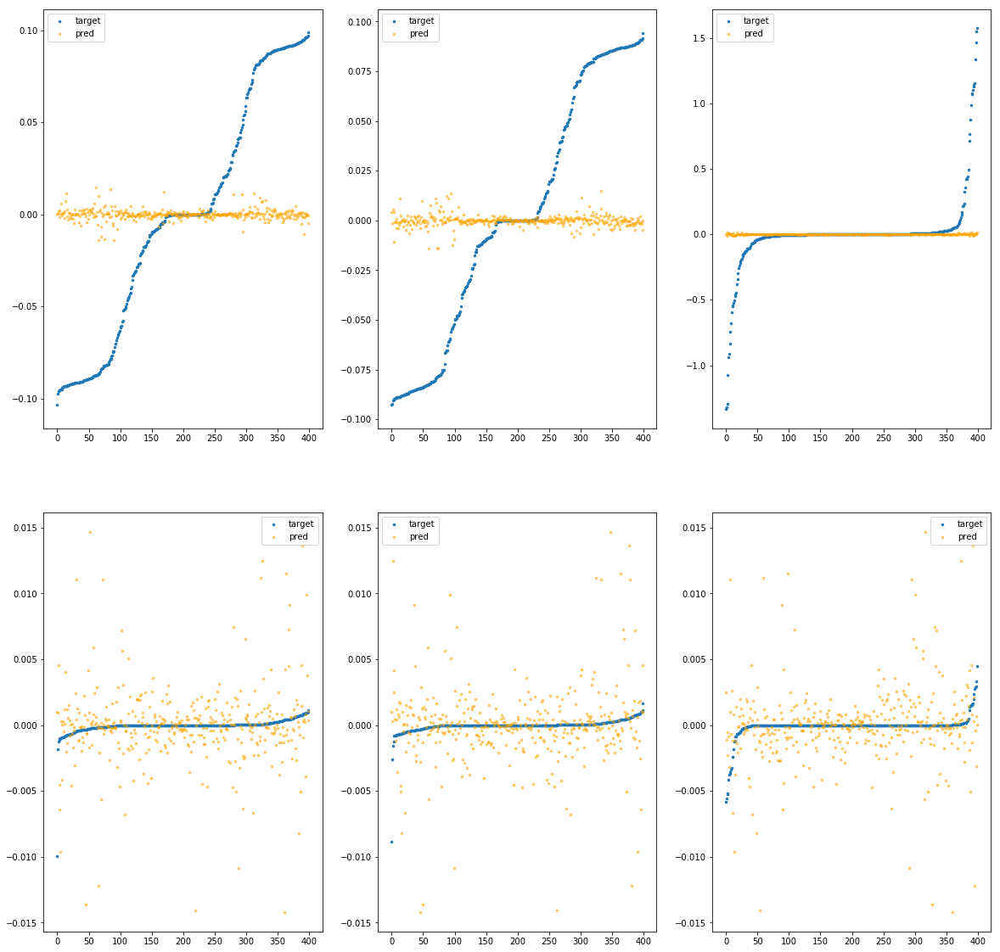

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90dc0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.06e-02	1.07e-01	5.15e-02	8.85e+02	4.05e-03	1.64e-05
y		1.80e-03	1.01e-01	5.11e-02	7.19e+01	3.83e-03	1.46e-05
z		2.65e-03	1.56e+00	1.02e-01	5.36e+01	8.31e-02	6.91e-03
phi		-3.48e+01	2.14e-02	2.10e-03	1.48e+05	1.30e-05	1.68e-10
theta		-4.19e+01	2.24e-02	2.11e-03	8.67e+04	1.33e-05	1.76e-10
psi		-1.68e+01	2.00e-02	2.11e-03	1.58e+05	1.33e-05	1.77e-10


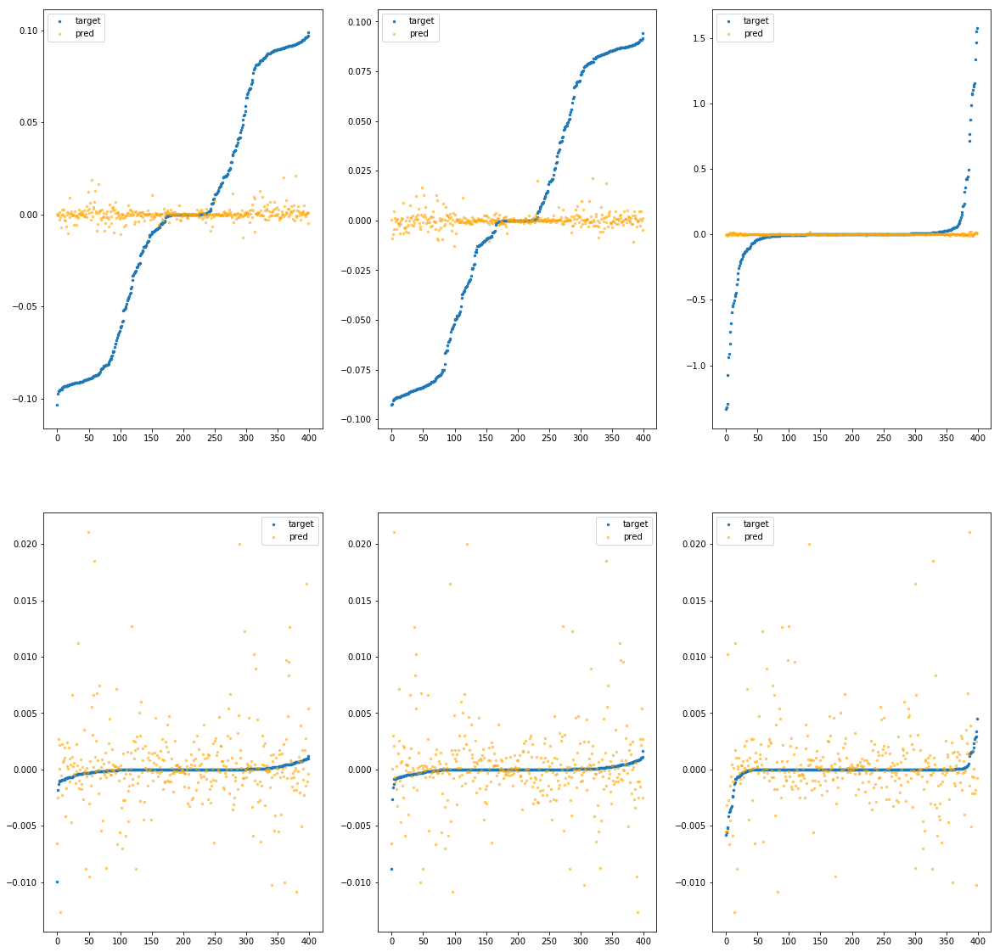

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90e20>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.88e-03	1.18e-01	5.17e-02	3.10e+03	4.11e-03	1.69e-05
y		-1.62e-02	1.05e-01	5.15e-02	2.56e+02	3.90e-03	1.52e-05
z		7.20e-03	1.57e+00	1.02e-01	1.16e+02	8.27e-02	6.84e-03
phi		-4.19e+01	2.31e-02	2.31e-03	5.19e+05	1.55e-05	2.42e-10
theta		-4.96e+01	2.29e-02	2.31e-03	2.63e+05	1.56e-05	2.44e-10
psi		-1.92e+01	2.40e-02	2.30e-03	1.72e+05	1.52e-05	2.30e-10


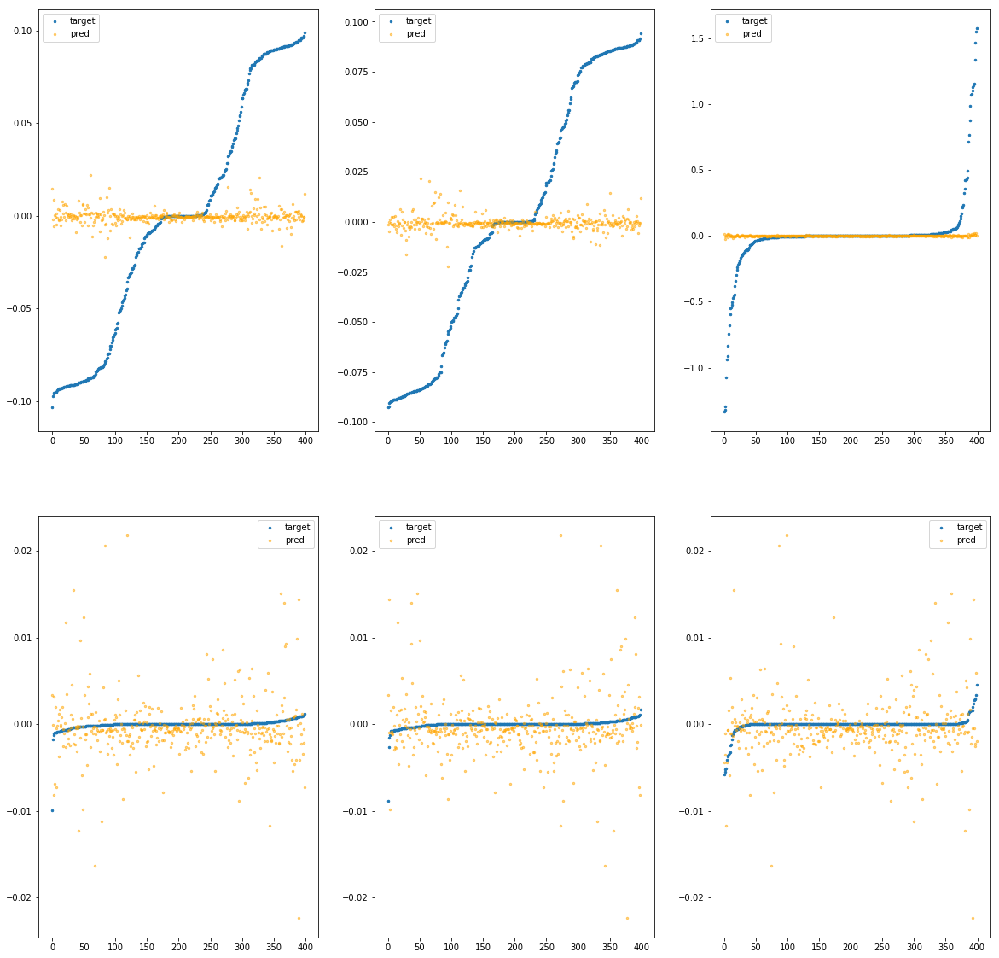

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90e80>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.26e-03	1.17e-01	5.17e-02	1.49e+03	4.10e-03	1.68e-05
y		-7.59e-04	1.04e-01	5.11e-02	7.85e+01	3.84e-03	1.47e-05
z		2.14e-03	1.57e+00	1.02e-01	4.92e+01	8.31e-02	6.91e-03
phi		-3.05e+01	2.30e-02	1.75e-03	2.60e+05	1.14e-05	1.30e-10
theta		-3.48e+01	2.36e-02	1.70e-03	5.35e+04	1.11e-05	1.22e-10
psi		-1.49e+01	2.35e-02	1.78e-03	1.10e+05	1.19e-05	1.42e-10


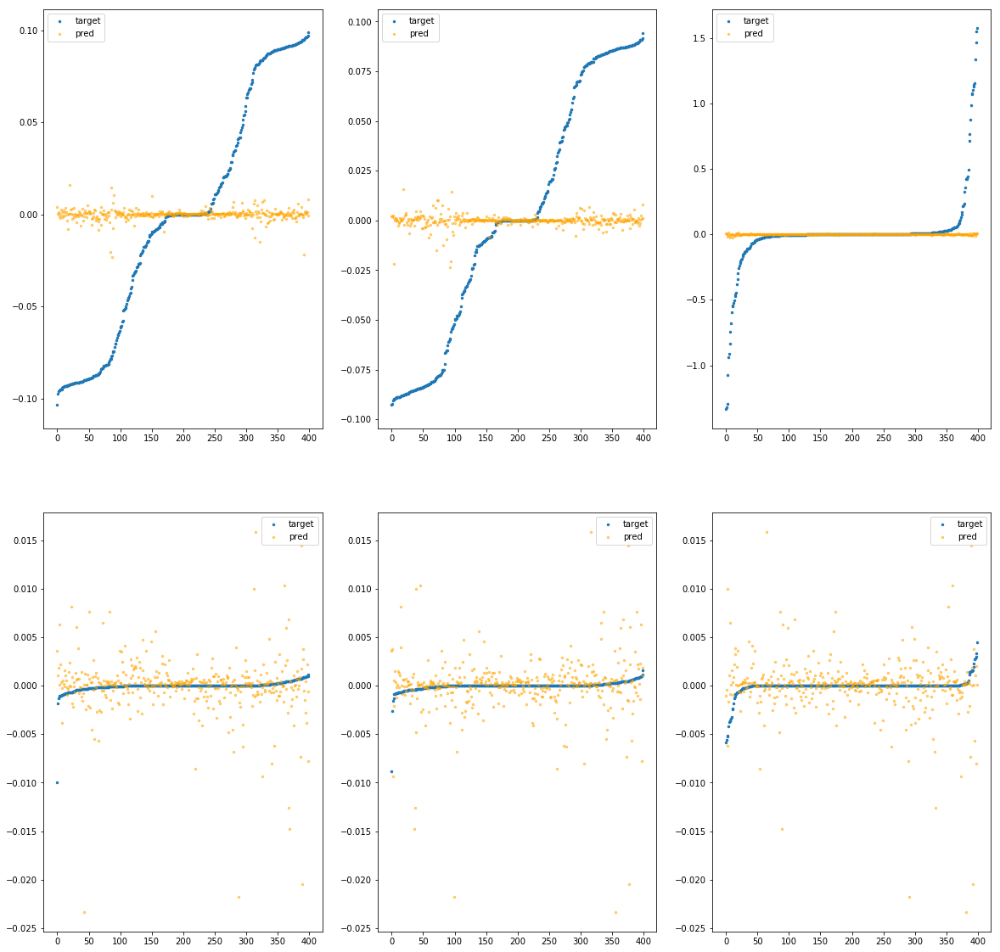

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90ee0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.67e-02	1.19e-01	5.21e-02	5.36e+02	4.16e-03	1.73e-05
y		-1.32e-02	1.14e-01	5.14e-02	1.26e+02	3.88e-03	1.51e-05
z		-5.54e-03	1.58e+00	1.03e-01	7.67e+01	8.38e-02	7.02e-03
phi		-5.58e+01	3.15e-02	2.56e-03	1.64e+05	2.05e-05	4.22e-10
theta		-6.61e+01	3.09e-02	2.56e-03	8.36e+04	2.07e-05	4.29e-10
psi		-2.66e+01	3.10e-02	2.62e-03	2.04e+05	2.07e-05	4.29e-10


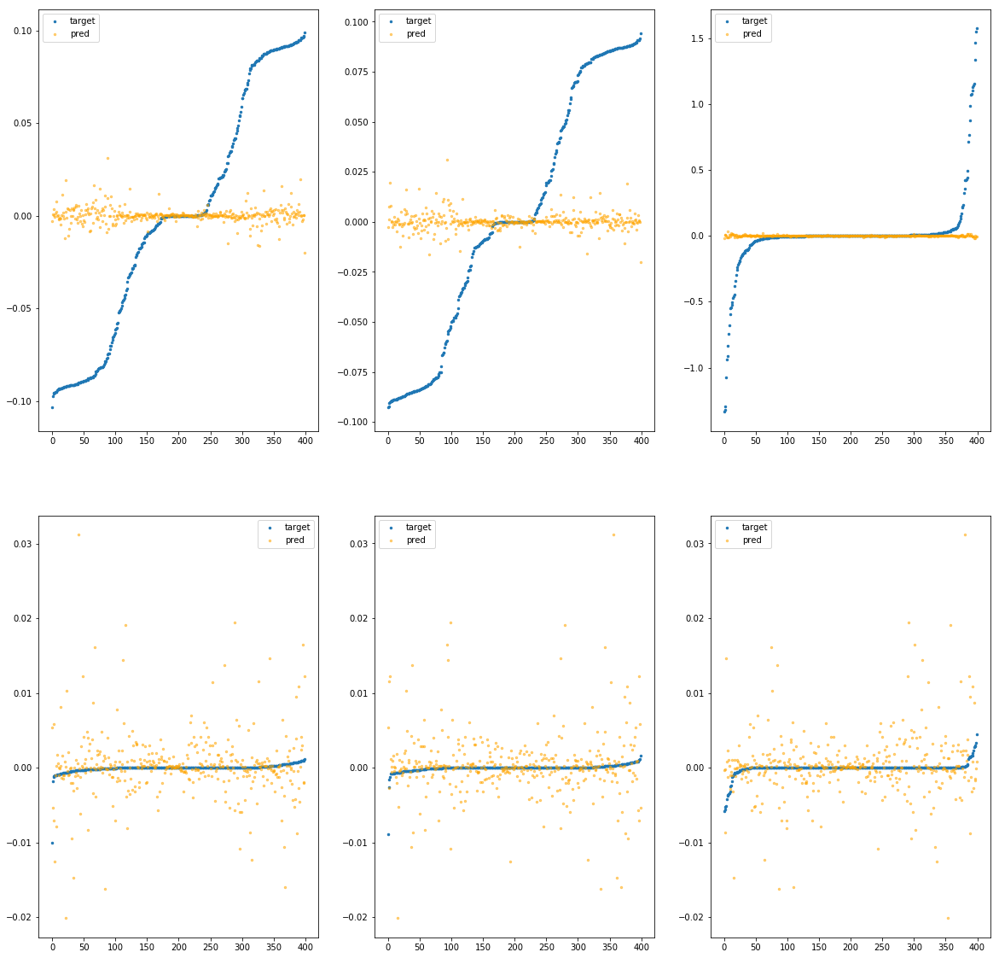

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90f40>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		4.54e-03	1.12e-01	5.16e-02	8.57e+02	4.08e-03	1.66e-05
y		-3.55e-03	1.07e-01	5.11e-02	1.06e+02	3.85e-03	1.48e-05
z		9.39e-04	1.57e+00	1.02e-01	4.99e+01	8.32e-02	6.93e-03
phi		-3.17e+01	1.71e-02	2.01e-03	2.12e+05	1.18e-05	1.40e-10
theta		-3.89e+01	1.81e-02	2.05e-03	9.28e+04	1.23e-05	1.52e-10
psi		-1.64e+01	1.73e-02	2.12e-03	2.51e+05	1.30e-05	1.70e-10


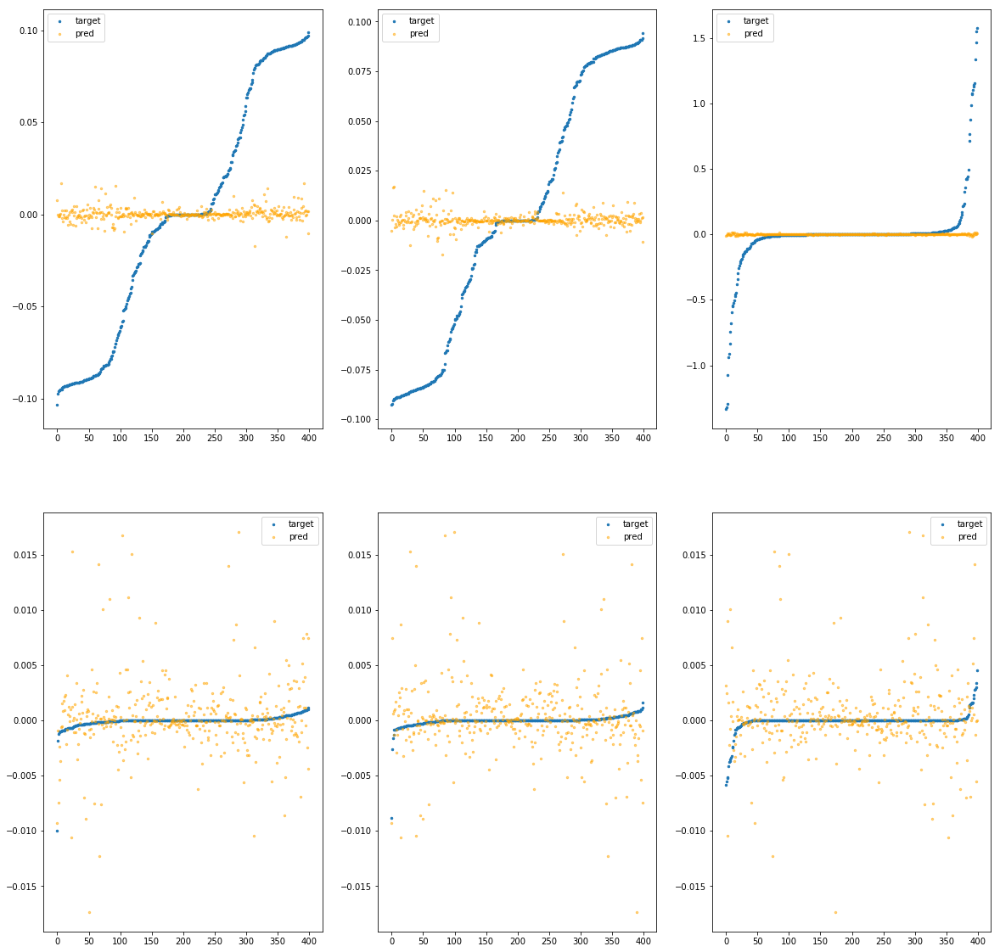

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fc90fa0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		4.56e-03	1.13e-01	5.16e-02	1.28e+03	4.08e-03	1.66e-05
y		-7.04e-04	9.60e-02	5.12e-02	1.66e+02	3.84e-03	1.47e-05
z		8.53e-04	1.56e+00	1.02e-01	7.65e+01	8.32e-02	6.93e-03
phi		-1.89e+01	1.39e-02	1.74e-03	2.24e+05	7.22e-06	5.21e-11
theta		-2.21e+01	1.39e-02	1.73e-03	1.13e+05	7.15e-06	5.11e-11
psi		-9.92e+00	1.43e-02	1.84e-03	1.14e+05	8.19e-06	6.71e-11


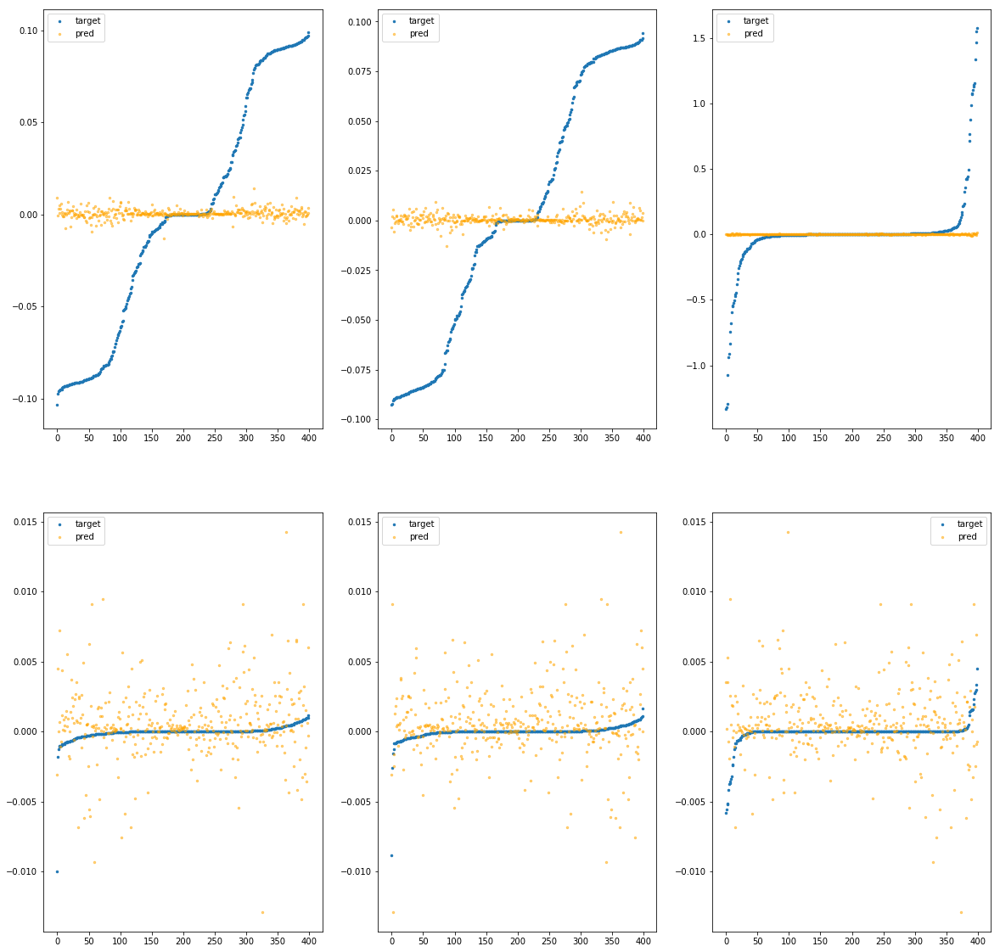

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fca4040>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.96e-03	1.04e-01	5.16e-02	1.77e+03	4.08e-03	1.66e-05
y		9.94e-04	9.92e-02	5.11e-02	4.81e+01	3.83e-03	1.47e-05
z		-2.18e-03	1.57e+00	1.02e-01	4.33e+01	8.35e-02	6.97e-03
phi		-3.05e+01	2.01e-02	1.84e-03	3.07e+05	1.14e-05	1.30e-10
theta		-3.45e+01	1.98e-02	1.79e-03	6.49e+04	1.10e-05	1.20e-10
psi		-1.61e+01	2.38e-02	1.96e-03	1.11e+05	1.28e-05	1.64e-10


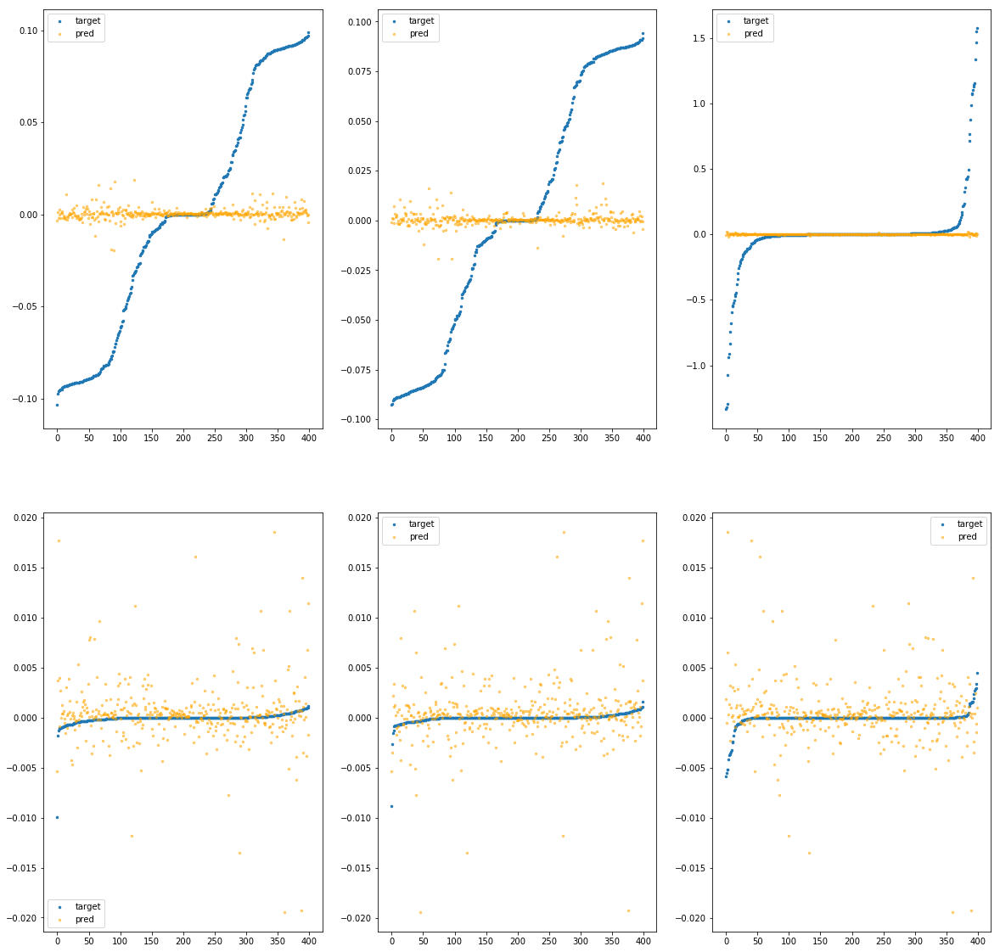

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fca40a0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.72e-03	1.13e-01	5.18e-02	3.64e+03	4.12e-03	1.70e-05
y		-7.76e-03	1.03e-01	5.13e-02	1.07e+02	3.86e-03	1.49e-05
z		1.44e-03	1.57e+00	1.02e-01	7.72e+01	8.32e-02	6.92e-03
phi		-4.69e+01	2.54e-02	2.27e-03	6.91e+05	1.73e-05	3.00e-10
theta		-5.46e+01	2.53e-02	2.27e-03	1.29e+05	1.72e-05	2.95e-10
psi		-2.19e+01	2.50e-02	2.24e-03	2.19e+05	1.72e-05	2.95e-10


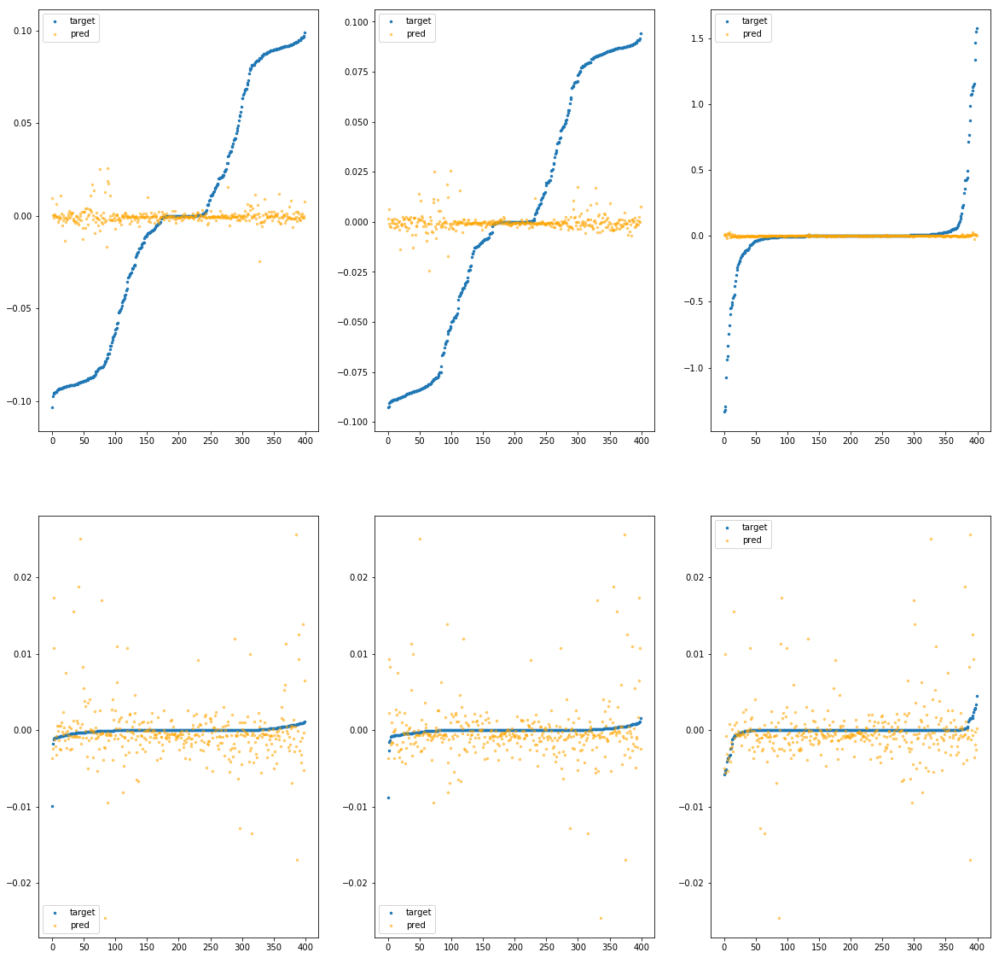

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fca4100>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		7.05e-03	1.06e-01	5.16e-02	1.50e+03	4.07e-03	1.65e-05
y		-6.50e-03	1.14e-01	5.14e-02	2.38e+02	3.86e-03	1.49e-05
z		-8.57e-03	1.58e+00	1.03e-01	1.06e+02	8.40e-02	7.06e-03
phi		-7.21e+01	3.32e-02	3.12e-03	4.82e+05	2.65e-05	7.00e-10
theta		-8.35e+01	3.53e-02	3.08e-03	1.87e+05	2.61e-05	6.82e-10
psi		-3.58e+01	3.43e-02	3.16e-03	2.78e+05	2.76e-05	7.60e-10


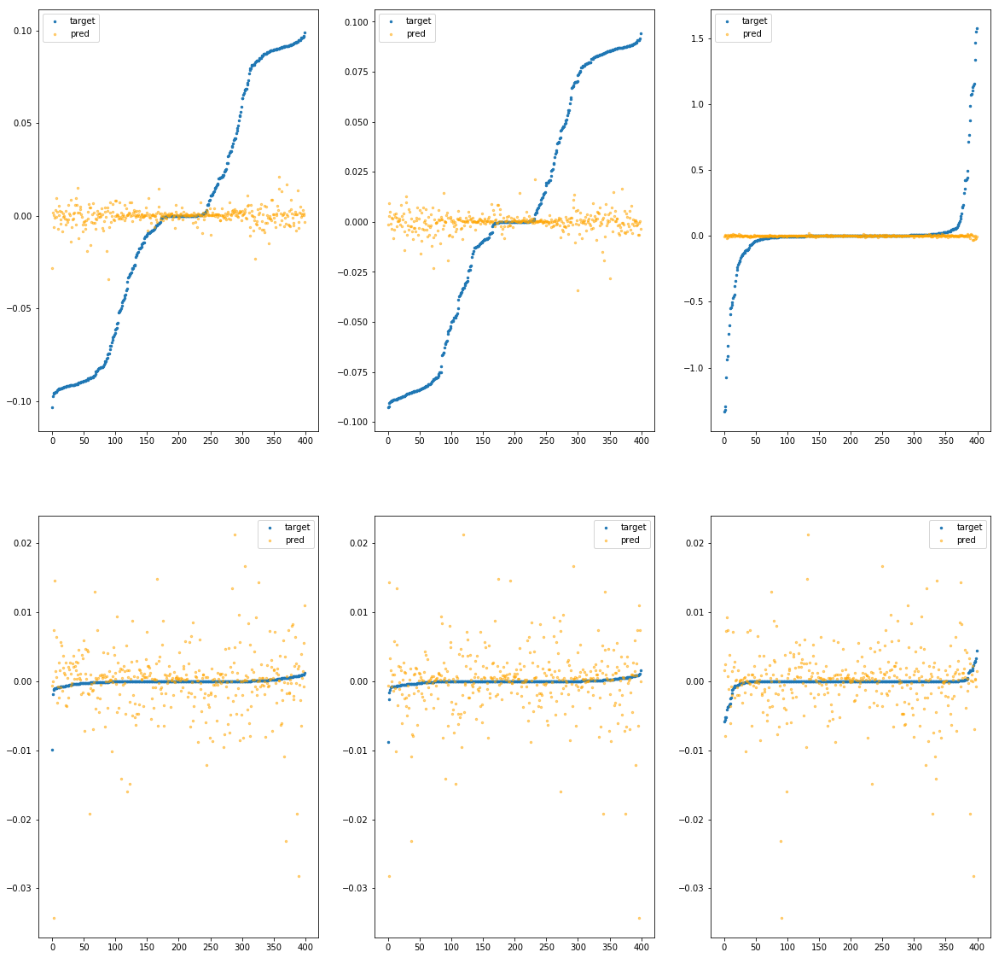

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba6fca4160>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.54e-04	1.02e-01	5.17e-02	6.12e+02	4.10e-03	1.68e-05
y		-2.15e-03	9.78e-02	5.11e-02	3.84e+01	3.84e-03	1.48e-05
z		-2.58e-03	1.57e+00	1.02e-01	2.79e+01	8.35e-02	6.98e-03
phi		-1.83e+01	2.01e-02	1.41e-03	1.66e+05	6.99e-06	4.89e-11
theta		-2.21e+01	2.09e-02	1.40e-03	2.96e+04	7.13e-06	5.08e-11
psi		-8.58e+00	2.06e-02	1.45e-03	1.24e+05	7.18e-06	5.16e-11


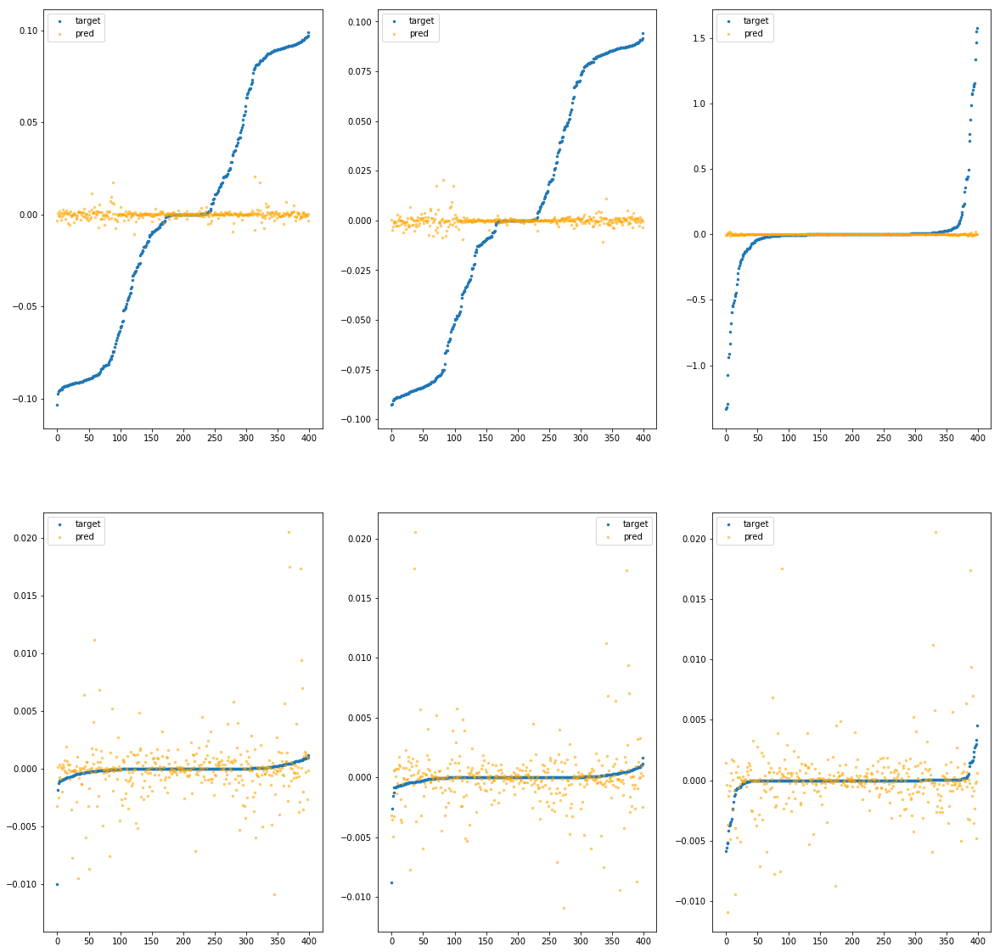

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca41c0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.47e-02	1.21e-01	5.62e-02	9.13e+04	4.44e-03	1.97e-05
y		-5.57e-02	1.10e-01	5.47e-02	4.66e+03	4.05e-03	1.64e-05
z		-1.22e-03	1.55e+00	1.12e-01	2.17e+03	8.34e-02	6.96e-03
phi		-8.91e+02	2.79e-02	1.80e-02	1.53e+07	3.23e-04	1.04e-07
theta		-1.04e+03	2.67e-02	1.79e-02	3.91e+06	3.22e-04	1.04e-07
psi		-4.32e+02	2.38e-02	1.80e-02	2.20e+06	3.24e-04	1.05e-07


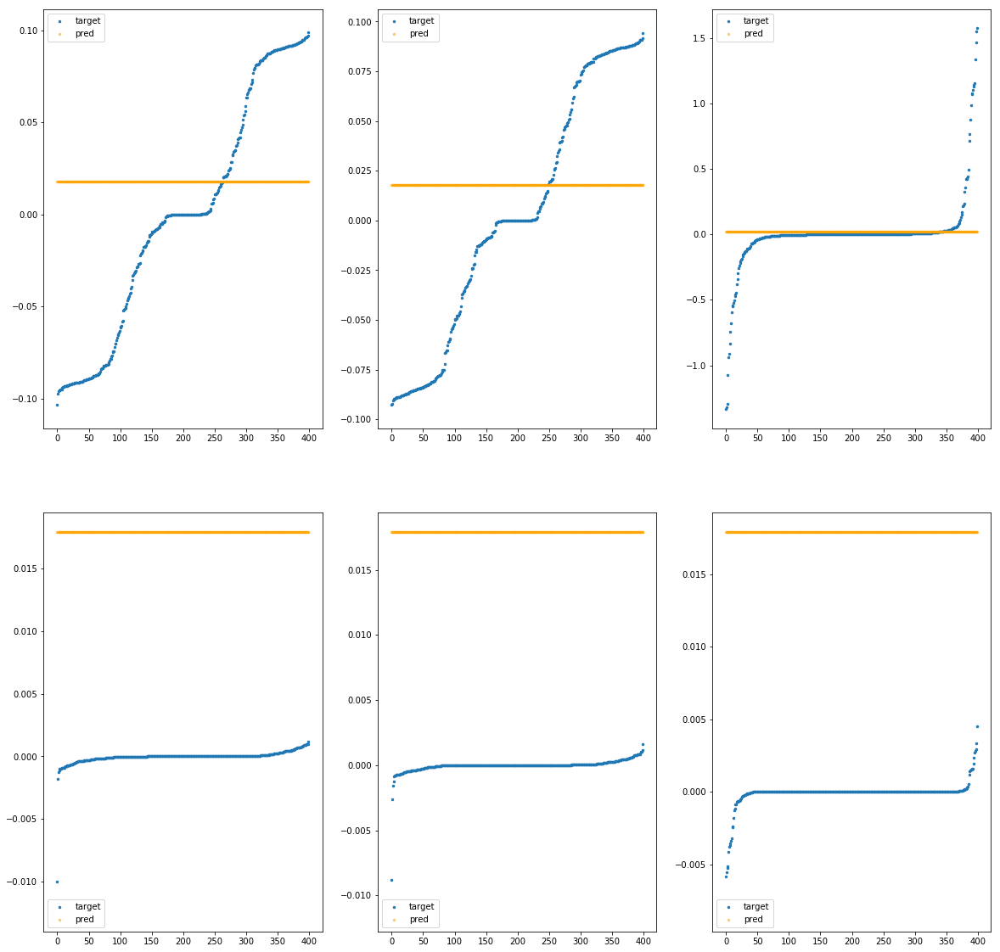

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca4220>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.45e-02	1.19e-01	5.55e-02	7.93e+04	4.36e-03	1.90e-05
y		-3.91e-02	1.08e-01	5.41e-02	4.04e+03	3.98e-03	1.59e-05
z		-7.30e-04	1.56e+00	1.10e-01	1.88e+03	8.34e-02	6.95e-03
phi		-6.71e+02	2.55e-02	1.56e-02	1.33e+07	2.43e-04	5.92e-08
theta		-7.85e+02	2.43e-02	1.56e-02	3.39e+06	2.43e-04	5.89e-08
psi		-3.25e+02	2.14e-02	1.56e-02	1.91e+06	2.45e-04	5.99e-08


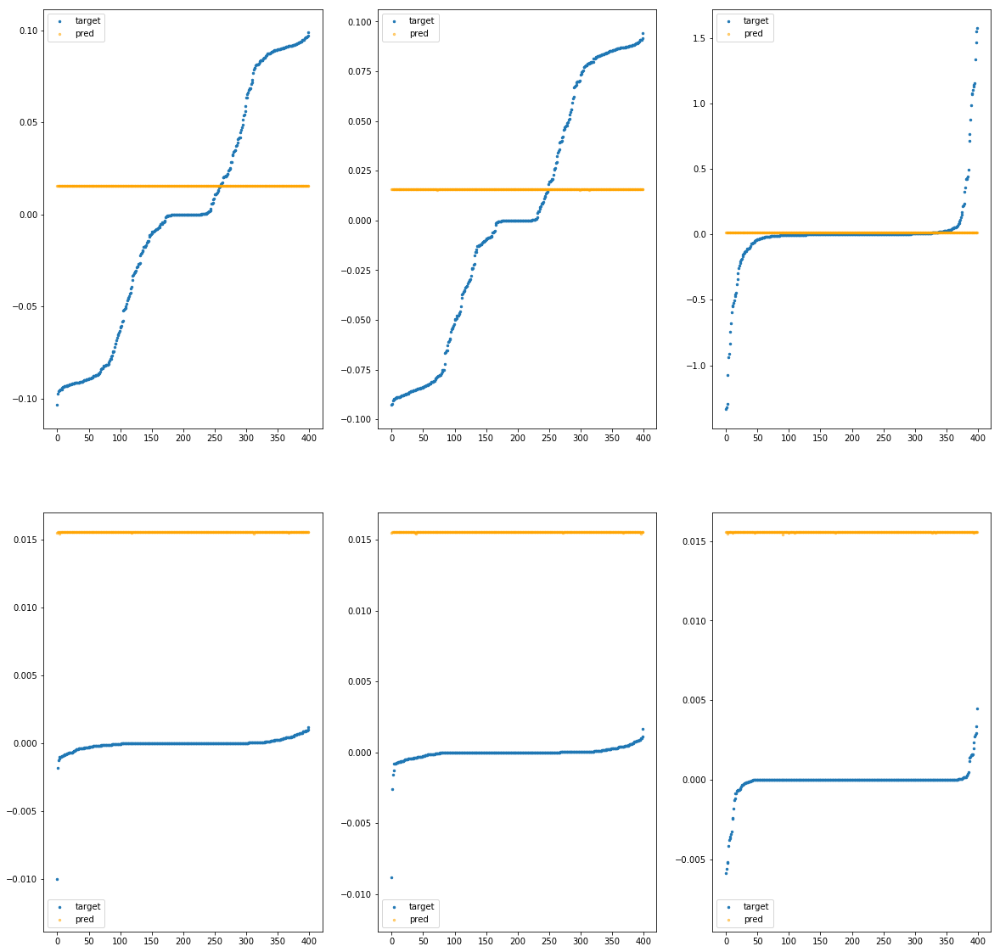

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca4280>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.30e-02	1.14e-01	5.48e-02	7.86e+04	4.31e-03	1.86e-05
y		-9.16e-02	1.10e-01	5.46e-02	4.01e+03	4.19e-03	1.75e-05
z		-6.50e-03	1.59e+00	1.10e-01	1.87e+03	8.39e-02	7.03e-03
phi		-6.55e+02	1.66e-02	1.54e-02	1.32e+07	2.37e-04	5.63e-08
theta		-7.69e+02	1.71e-02	1.54e-02	3.36e+06	2.38e-04	5.66e-08
psi		-3.15e+02	1.99e-02	1.54e-02	1.89e+06	2.37e-04	5.60e-08


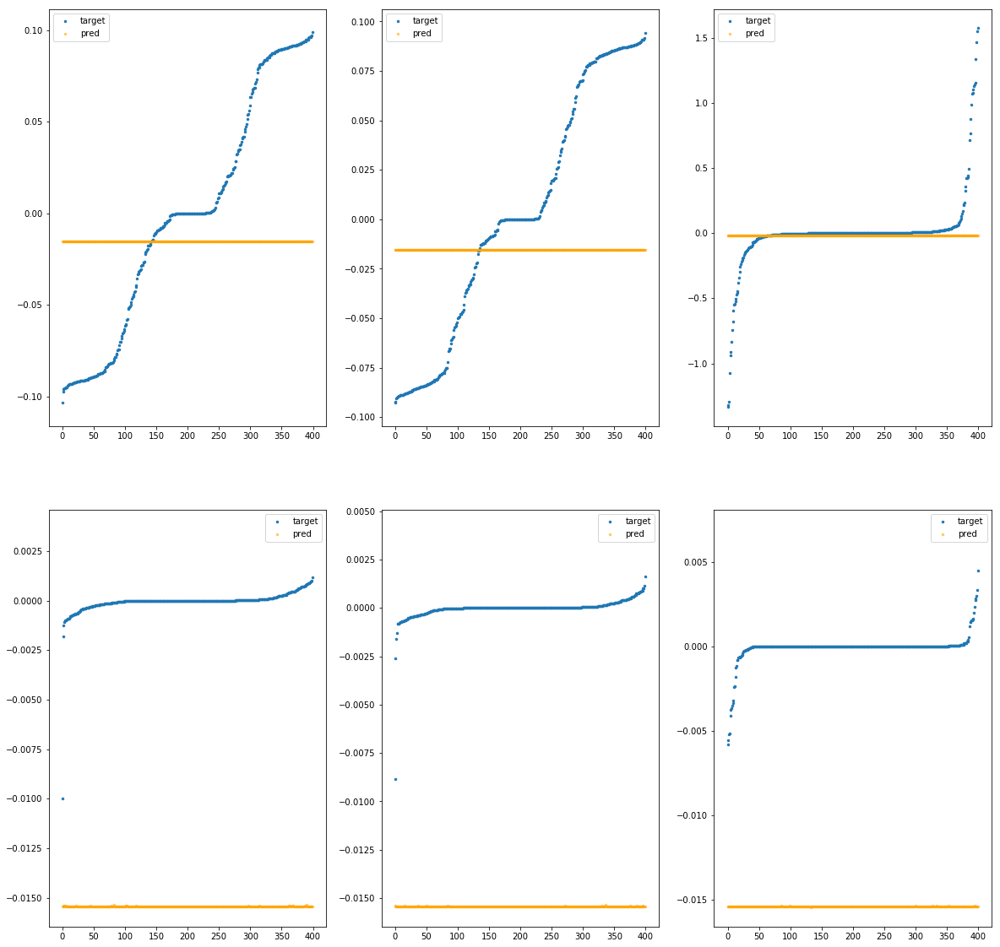

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca42e0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.47e-01	1.27e-01	5.82e-02	1.22e+05	4.70e-03	2.21e-05
y		-1.10e-01	1.16e-01	5.63e-02	6.20e+03	4.26e-03	1.81e-05
z		-3.08e-03	1.55e+00	1.16e-01	2.88e+03	8.36e-02	6.98e-03
phi		-1.58e+03	3.38e-02	2.39e-02	2.04e+07	5.71e-04	3.26e-07
theta		-1.84e+03	3.26e-02	2.39e-02	5.20e+06	5.70e-04	3.25e-07
psi		-7.62e+02	2.97e-02	2.39e-02	2.92e+06	5.73e-04	3.28e-07


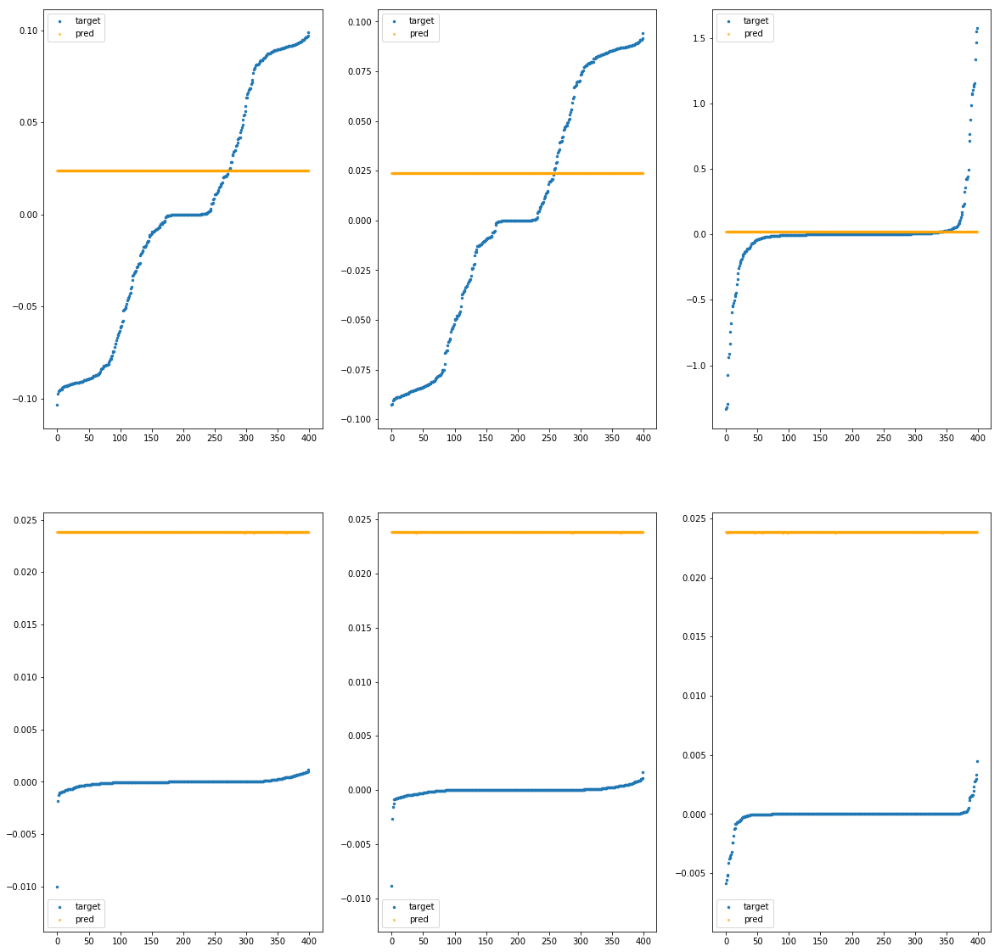

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca4340>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.49e-02	1.17e-01	5.56e-02	9.28e+04	4.40e-03	1.94e-05
y		-1.21e-01	1.13e-01	5.55e-02	4.74e+03	4.30e-03	1.85e-05
z		-8.14e-03	1.59e+00	1.12e-01	2.20e+03	8.40e-02	7.06e-03
phi		-9.13e+02	1.93e-02	1.82e-02	1.56e+07	3.31e-04	1.09e-07
theta		-1.07e+03	1.99e-02	1.82e-02	3.97e+06	3.32e-04	1.10e-07
psi		-4.39e+02	2.27e-02	1.81e-02	2.23e+06	3.30e-04	1.09e-07


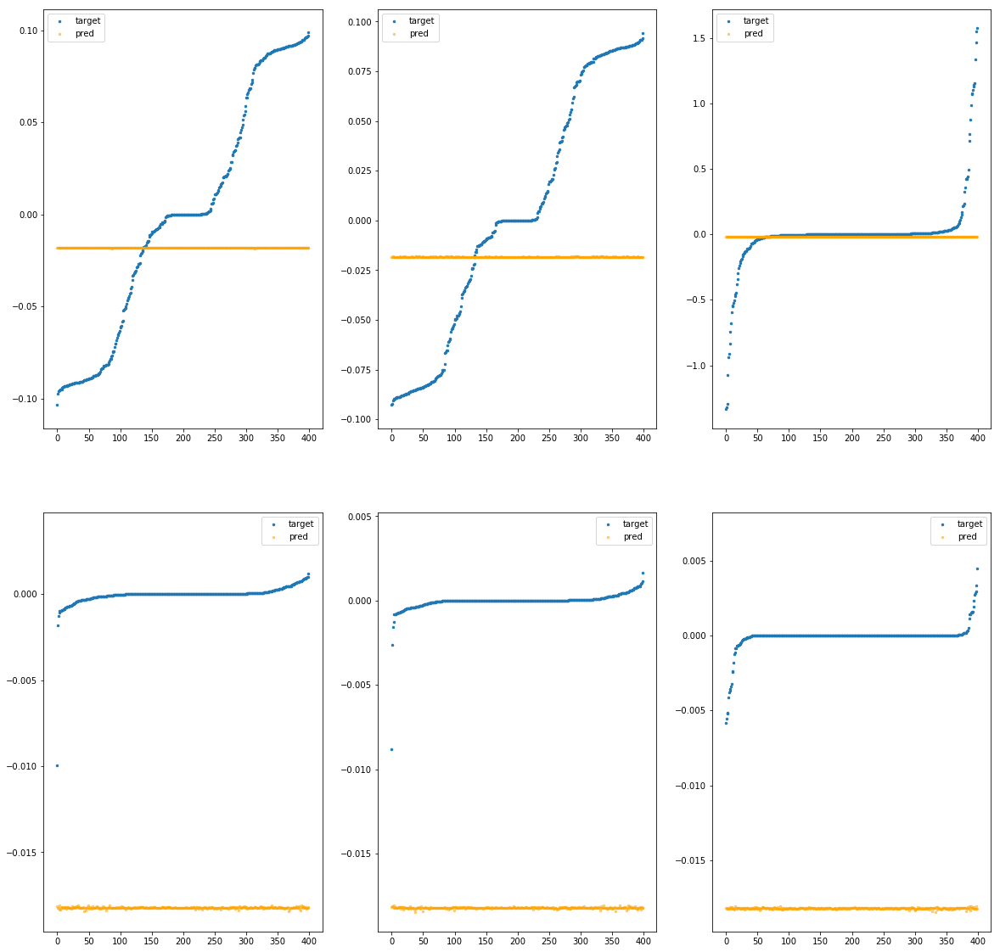

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca43a0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.83e-02	1.15e-01	5.44e-02	6.02e+04	4.25e-03	1.81e-05
y		-1.89e-02	1.04e-01	5.32e-02	3.07e+03	3.91e-03	1.53e-05
z		-1.89e-04	1.56e+00	1.07e-01	1.43e+03	8.33e-02	6.94e-03
phi		-3.88e+02	2.18e-02	1.19e-02	1.01e+07	1.41e-04	1.99e-08
theta		-4.54e+02	2.06e-02	1.18e-02	2.58e+06	1.40e-04	1.97e-08
psi		-1.89e+02	1.77e-02	1.19e-02	1.45e+06	1.42e-04	2.02e-08


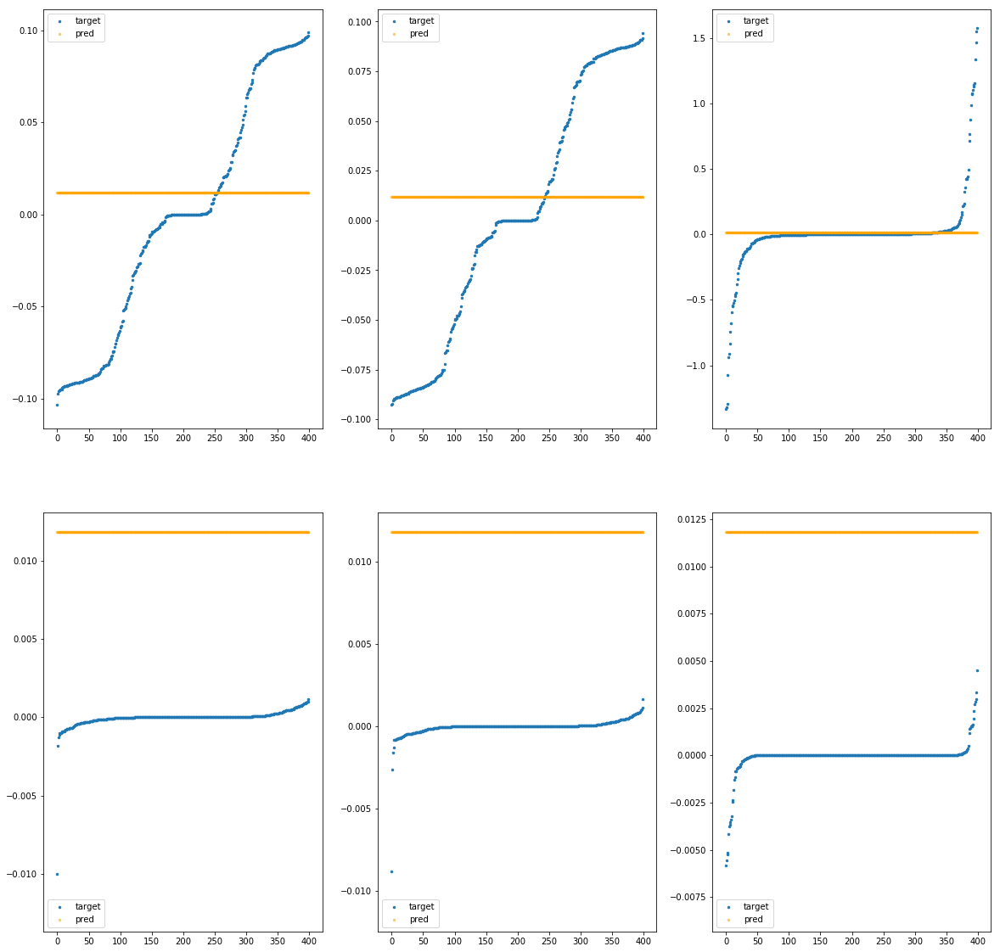

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca4400>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.10e-02	1.11e-01	5.39e-02	6.10e+04	4.22e-03	1.78e-05
y		-6.08e-02	1.06e-01	5.35e-02	3.11e+03	4.07e-03	1.65e-05
z		-4.72e-03	1.58e+00	1.08e-01	1.45e+03	8.37e-02	7.01e-03
phi		-3.93e+02	1.31e-02	1.19e-02	1.02e+07	1.43e-04	2.04e-08
theta		-4.62e+02	1.36e-02	1.19e-02	2.61e+06	1.43e-04	2.05e-08
psi		-1.89e+02	1.65e-02	1.19e-02	1.47e+06	1.42e-04	2.02e-08


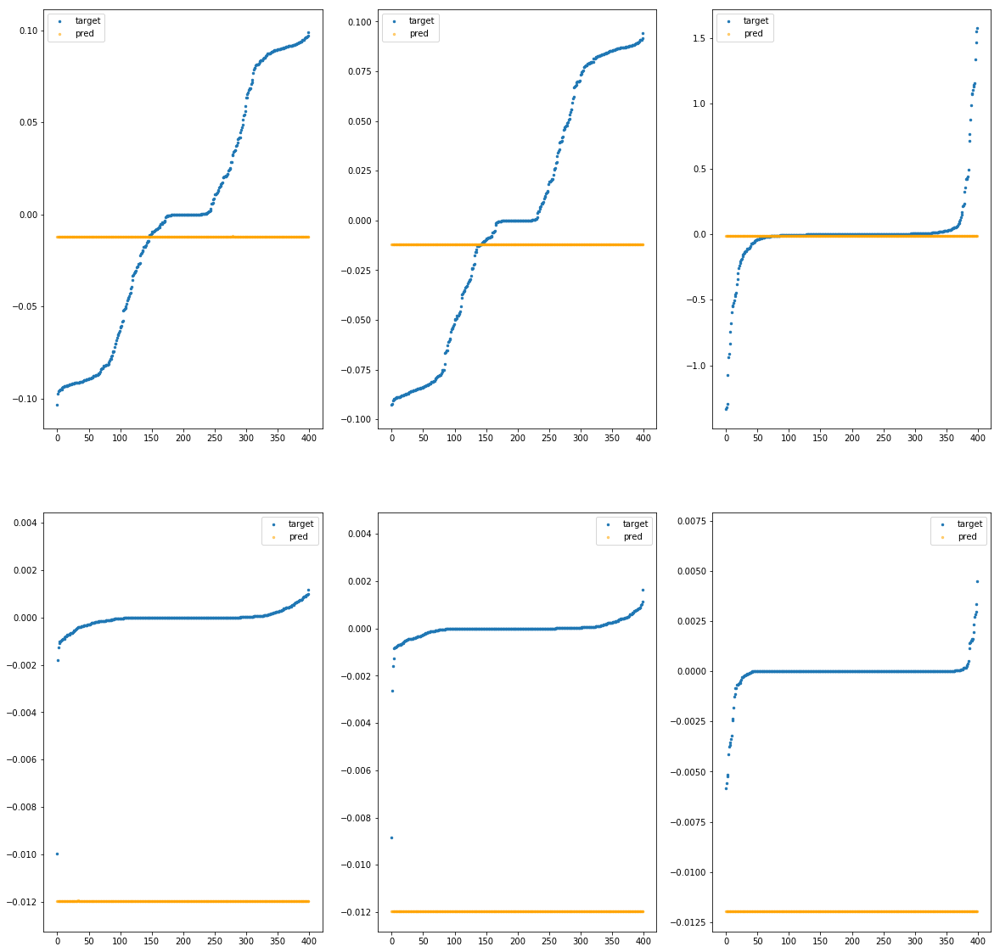

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca4460>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.66e-02	1.19e-01	5.55e-02	8.06e+04	4.37e-03	1.91e-05
y		-4.08e-02	1.08e-01	5.42e-02	4.11e+03	3.99e-03	1.59e-05
z		-7.63e-04	1.56e+00	1.10e-01	1.91e+03	8.34e-02	6.95e-03
phi		-6.94e+02	2.58e-02	1.59e-02	1.35e+07	2.52e-04	6.33e-08
theta		-8.12e+02	2.46e-02	1.58e-02	3.45e+06	2.51e-04	6.30e-08
psi		-3.36e+02	2.16e-02	1.59e-02	1.94e+06	2.53e-04	6.40e-08


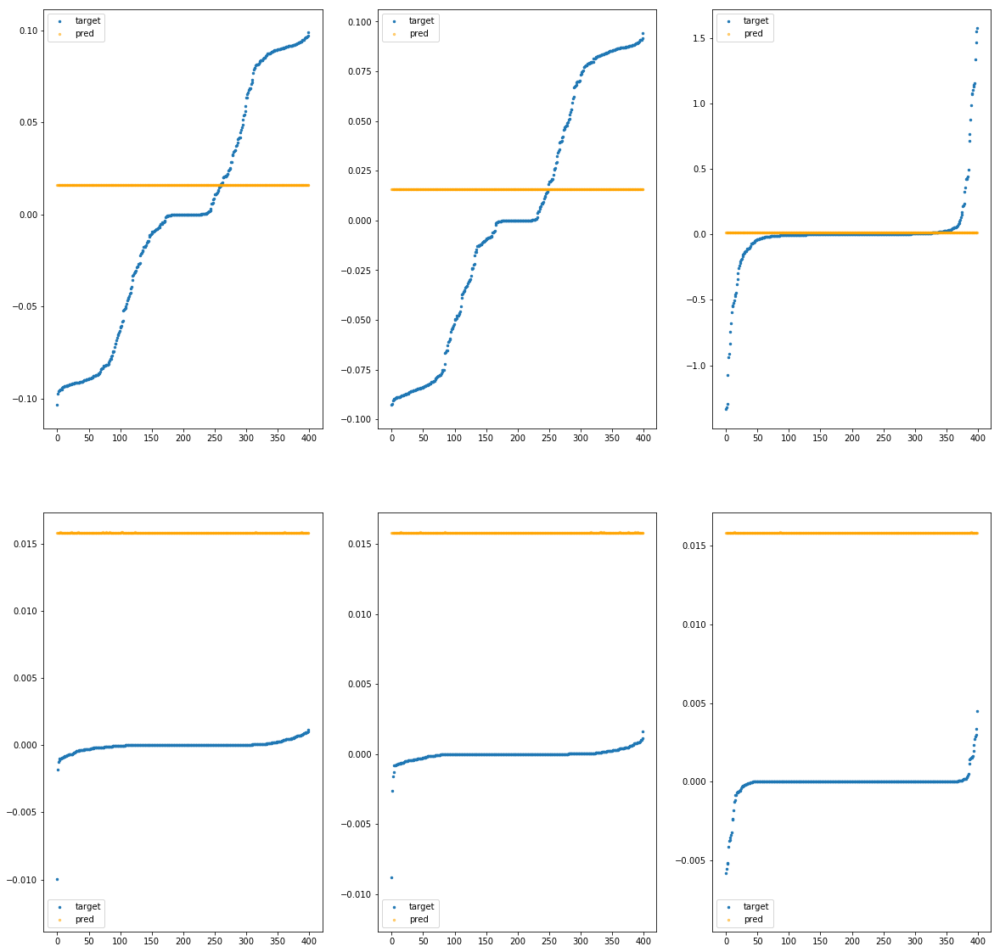

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca44c0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.36e-02	1.09e-01	5.35e-02	5.37e+04	4.19e-03	1.76e-05
y		-5.00e-02	1.05e-01	5.31e-02	2.74e+03	4.03e-03	1.62e-05
z		-4.07e-03	1.58e+00	1.07e-01	1.27e+03	8.37e-02	7.00e-03
phi		-3.05e+02	1.17e-02	1.05e-02	9.02e+06	1.11e-04	1.22e-08
theta		-3.58e+02	1.22e-02	1.05e-02	2.30e+06	1.11e-04	1.23e-08
psi		-1.46e+02	1.50e-02	1.05e-02	1.29e+06	1.10e-04	1.22e-08


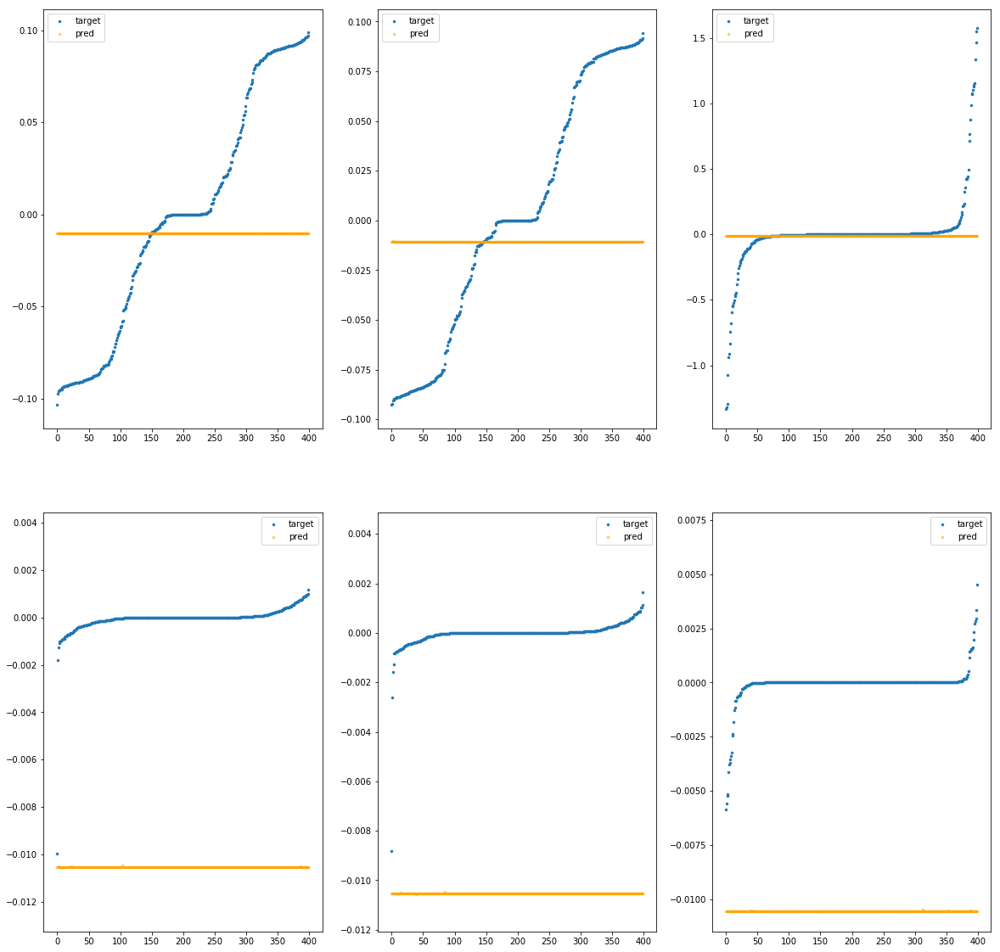

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca4520>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.00e-02	1.16e-01	5.54e-02	8.98e+04	4.38e-03	1.92e-05
y		-1.14e-01	1.12e-01	5.54e-02	4.58e+03	4.27e-03	1.83e-05
z		-7.77e-03	1.59e+00	1.11e-01	2.13e+03	8.40e-02	7.05e-03
phi		-8.55e+02	1.88e-02	1.76e-02	1.51e+07	3.10e-04	9.60e-08
theta		-1.00e+03	1.93e-02	1.76e-02	3.84e+06	3.10e-04	9.63e-08
psi		-4.11e+02	2.21e-02	1.76e-02	2.16e+06	3.09e-04	9.55e-08


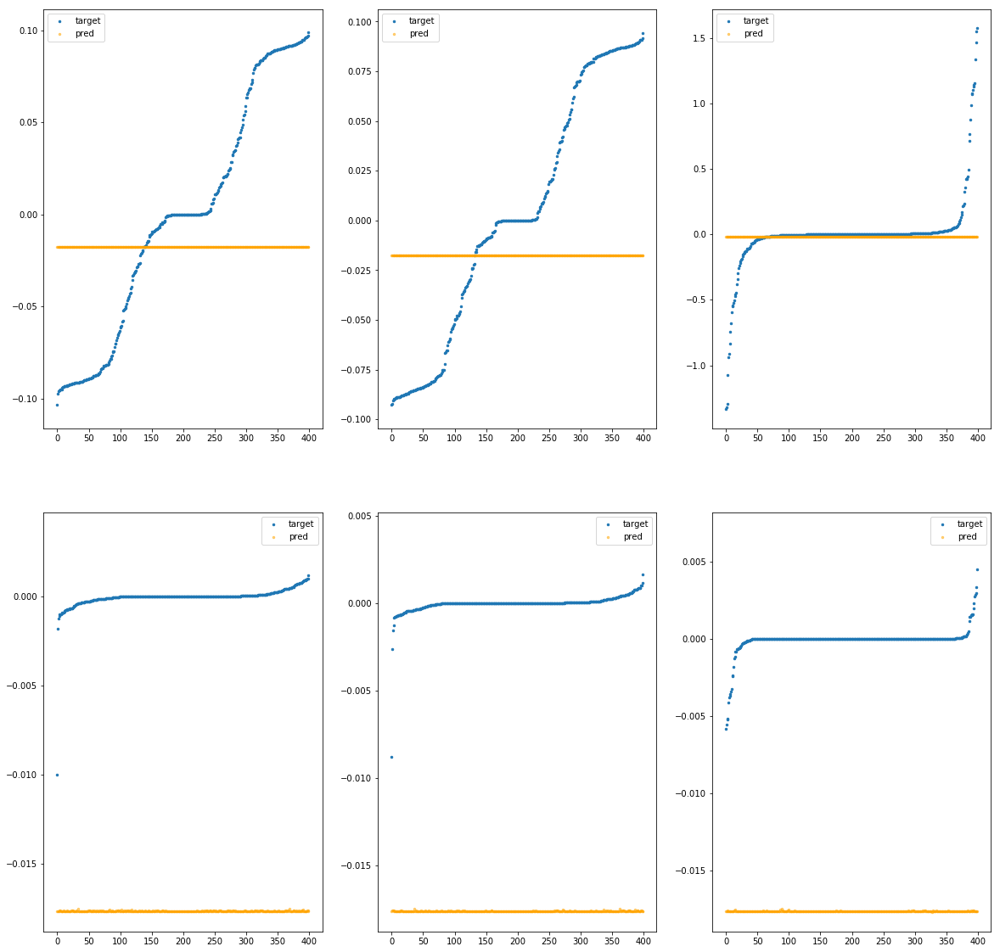

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca4580>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.19e-02	1.16e-01	5.46e-02	6.32e+04	4.27e-03	1.82e-05
y		-2.16e-02	1.05e-01	5.34e-02	3.23e+03	3.92e-03	1.53e-05
z		-2.48e-04	1.56e+00	1.08e-01	1.50e+03	8.33e-02	6.95e-03
phi		-4.27e+02	2.24e-02	1.24e-02	1.06e+07	1.55e-04	2.41e-08
theta		-4.99e+02	2.12e-02	1.24e-02	2.70e+06	1.55e-04	2.39e-08
psi		-2.07e+02	1.82e-02	1.25e-02	1.52e+06	1.56e-04	2.44e-08


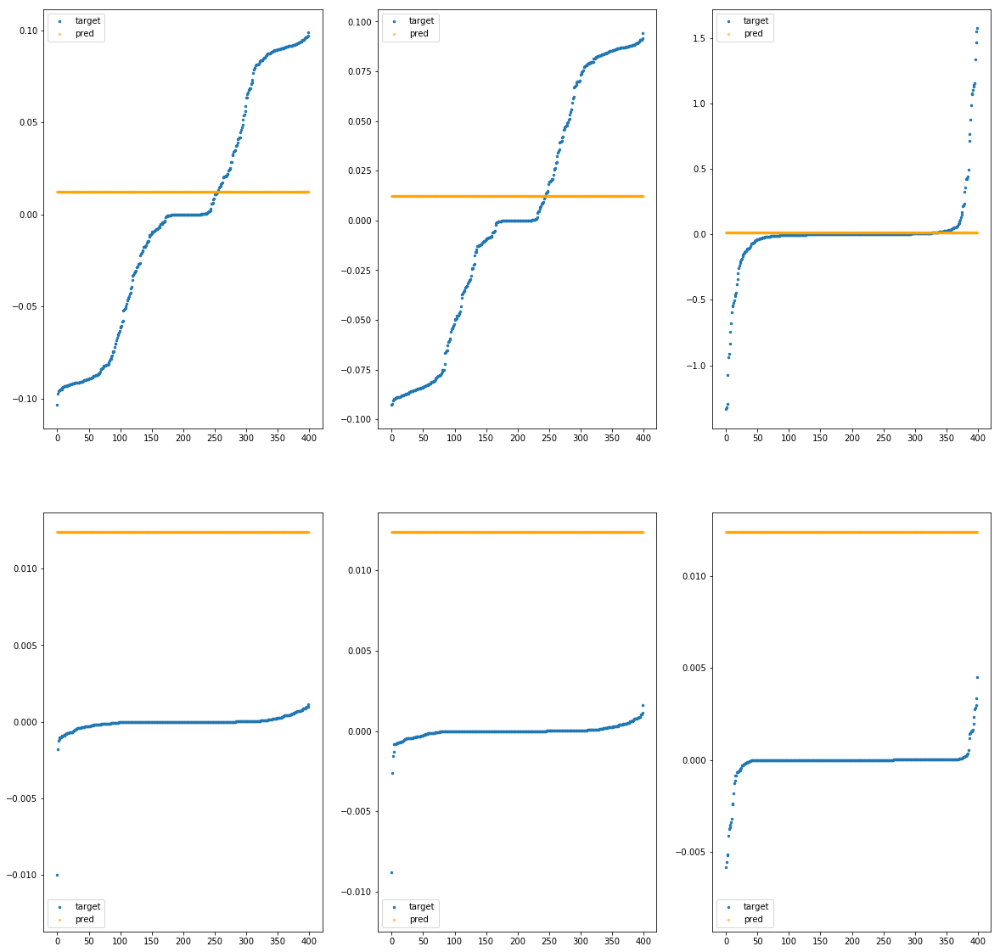

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca45e0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.88e-02	1.12e-01	5.42e-02	6.78e+04	4.25e-03	1.81e-05
y		-7.19e-02	1.08e-01	5.39e-02	3.46e+03	4.11e-03	1.69e-05
z		-5.38e-03	1.59e+00	1.08e-01	1.61e+03	8.38e-02	7.02e-03
phi		-4.86e+02	1.45e-02	1.33e-02	1.14e+07	1.76e-04	3.11e-08
theta		-5.72e+02	1.49e-02	1.33e-02	2.90e+06	1.77e-04	3.13e-08
psi		-2.34e+02	1.78e-02	1.32e-02	1.63e+06	1.76e-04	3.09e-08


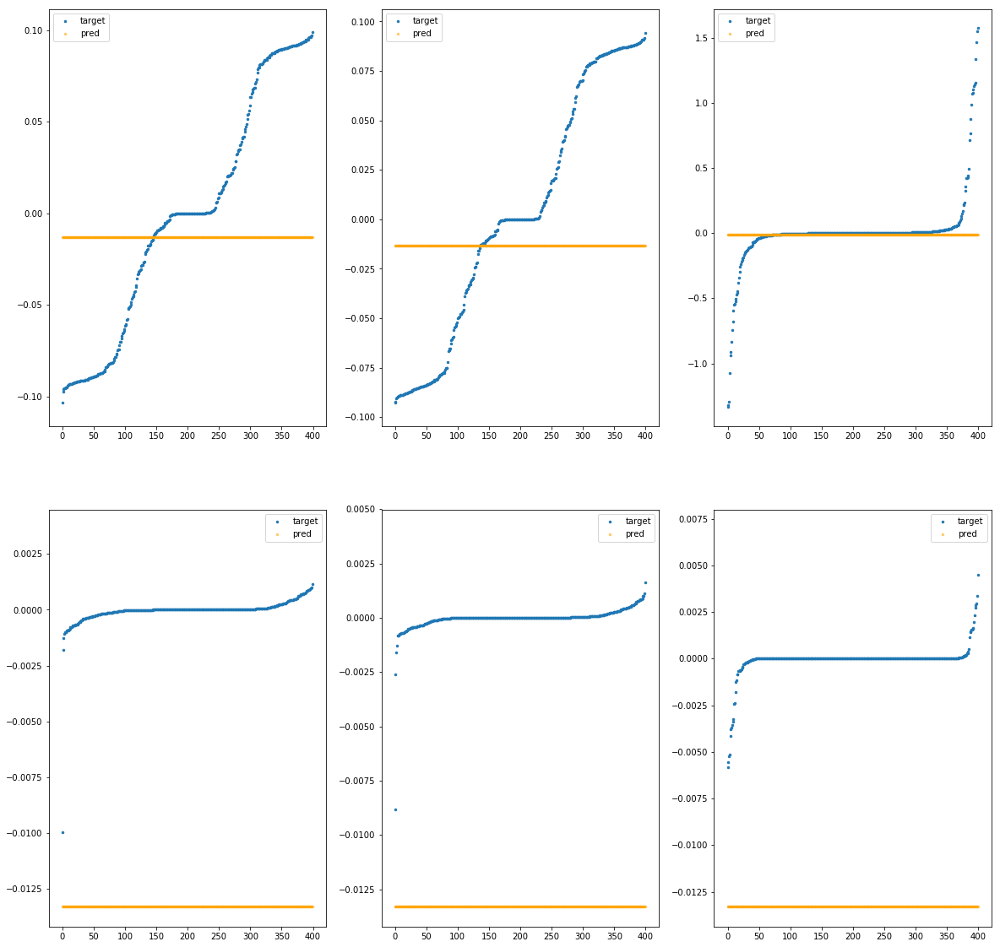

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca4640>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.19e-02	1.09e-01	5.34e-02	5.18e+04	4.18e-03	1.75e-05
y		-4.73e-02	1.04e-01	5.30e-02	2.64e+03	4.02e-03	1.61e-05
z		-3.90e-03	1.58e+00	1.06e-01	1.23e+03	8.36e-02	7.00e-03
phi		-2.83e+02	1.13e-02	1.01e-02	8.70e+06	1.03e-04	1.06e-08
theta		-3.33e+02	1.18e-02	1.01e-02	2.22e+06	1.03e-04	1.07e-08
psi		-1.36e+02	1.47e-02	1.01e-02	1.25e+06	1.03e-04	1.05e-08


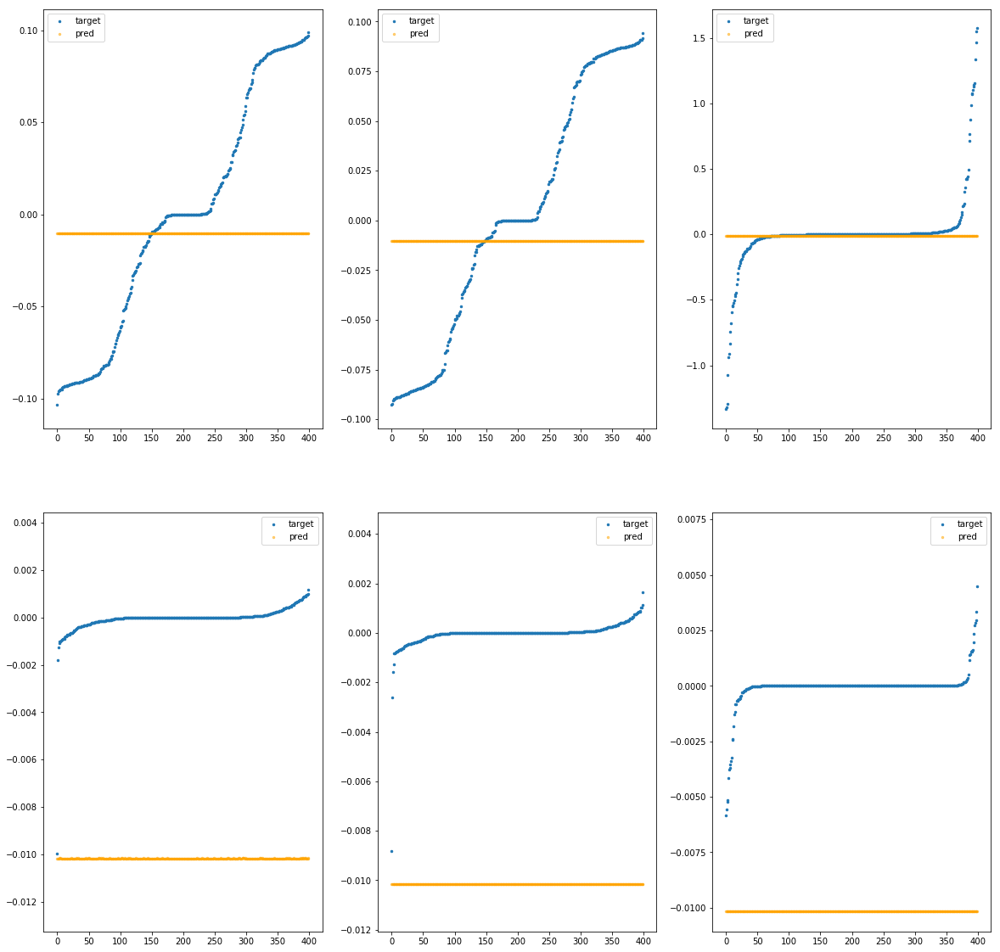

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca46a0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.71e-02	1.15e-01	5.50e-02	8.15e+04	4.33e-03	1.87e-05
y		-9.71e-02	1.10e-01	5.48e-02	4.16e+03	4.21e-03	1.77e-05
z		-6.84e-03	1.59e+00	1.10e-01	1.93e+03	8.39e-02	7.04e-03
phi		-7.03e+02	1.71e-02	1.60e-02	1.37e+07	2.55e-04	6.50e-08
theta		-8.26e+02	1.76e-02	1.60e-02	3.49e+06	2.56e-04	6.53e-08
psi		-3.38e+02	2.05e-02	1.59e-02	1.96e+06	2.54e-04	6.47e-08


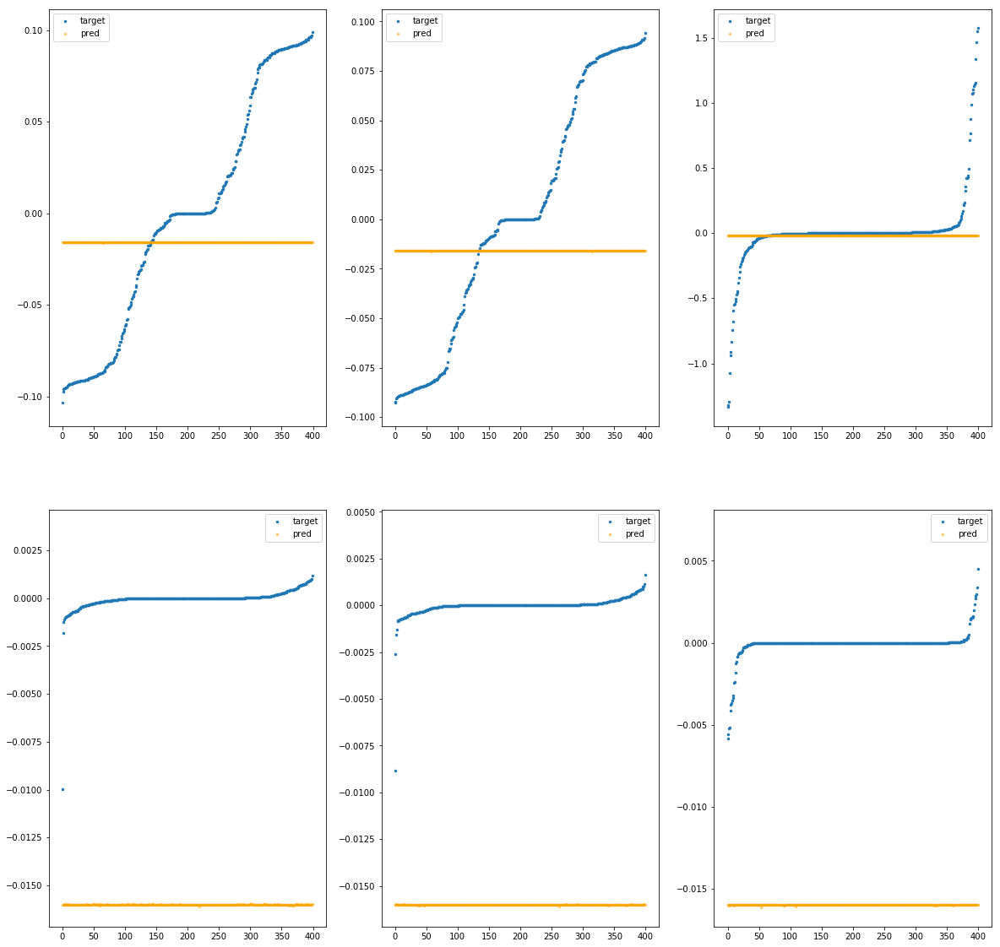

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca4700>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.01e-02	1.17e-01	5.49e-02	6.95e+04	4.30e-03	1.85e-05
y		-2.78e-02	1.06e-01	5.36e-02	3.55e+03	3.94e-03	1.55e-05
z		-3.99e-04	1.56e+00	1.09e-01	1.65e+03	8.34e-02	6.95e-03
phi		-5.16e+02	2.36e-02	1.37e-02	1.17e+07	1.87e-04	3.50e-08
theta		-6.03e+02	2.24e-02	1.36e-02	2.97e+06	1.87e-04	3.48e-08
psi		-2.50e+02	1.95e-02	1.37e-02	1.67e+06	1.88e-04	3.55e-08


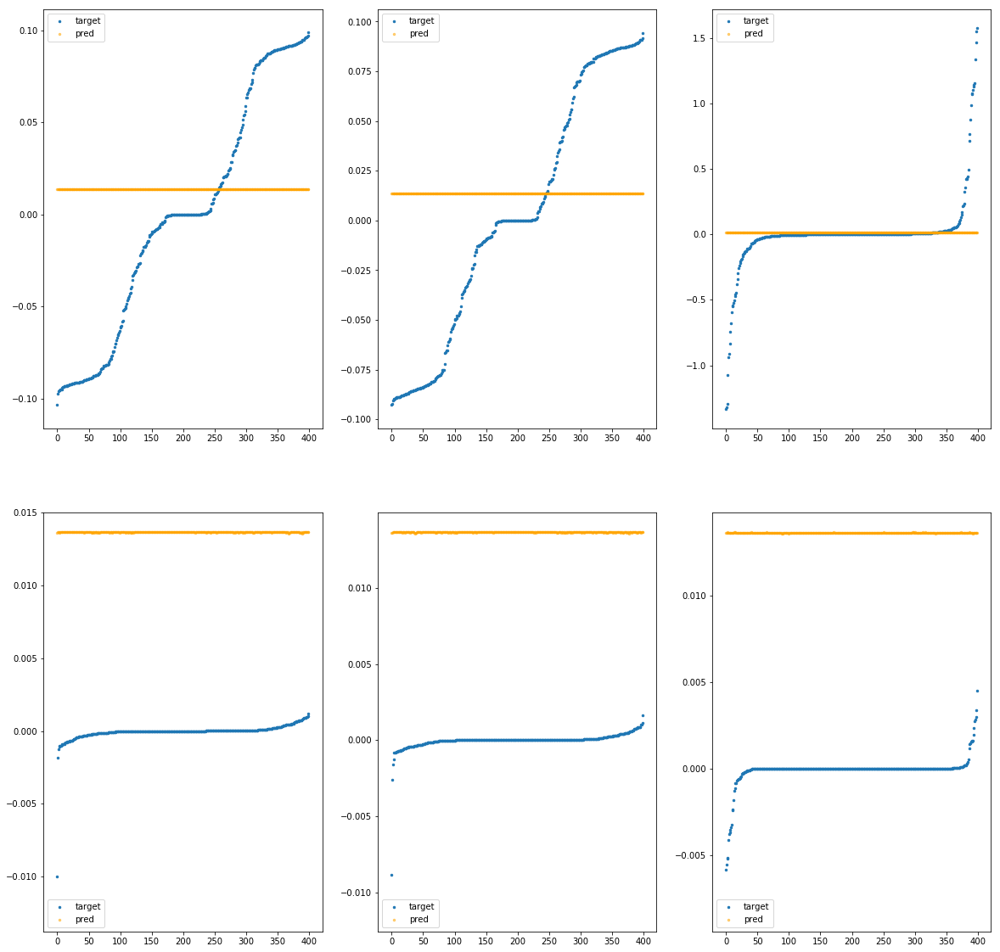

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca4760>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.72e-02	1.12e-01	5.41e-02	6.64e+04	4.25e-03	1.80e-05
y		-6.97e-02	1.07e-01	5.38e-02	3.39e+03	4.10e-03	1.68e-05
z		-5.24e-03	1.59e+00	1.08e-01	1.58e+03	8.38e-02	7.01e-03
phi		-4.67e+02	1.42e-02	1.30e-02	1.12e+07	1.69e-04	2.87e-08
theta		-5.49e+02	1.47e-02	1.30e-02	2.84e+06	1.70e-04	2.88e-08
psi		-2.24e+02	1.75e-02	1.30e-02	1.60e+06	1.69e-04	2.85e-08


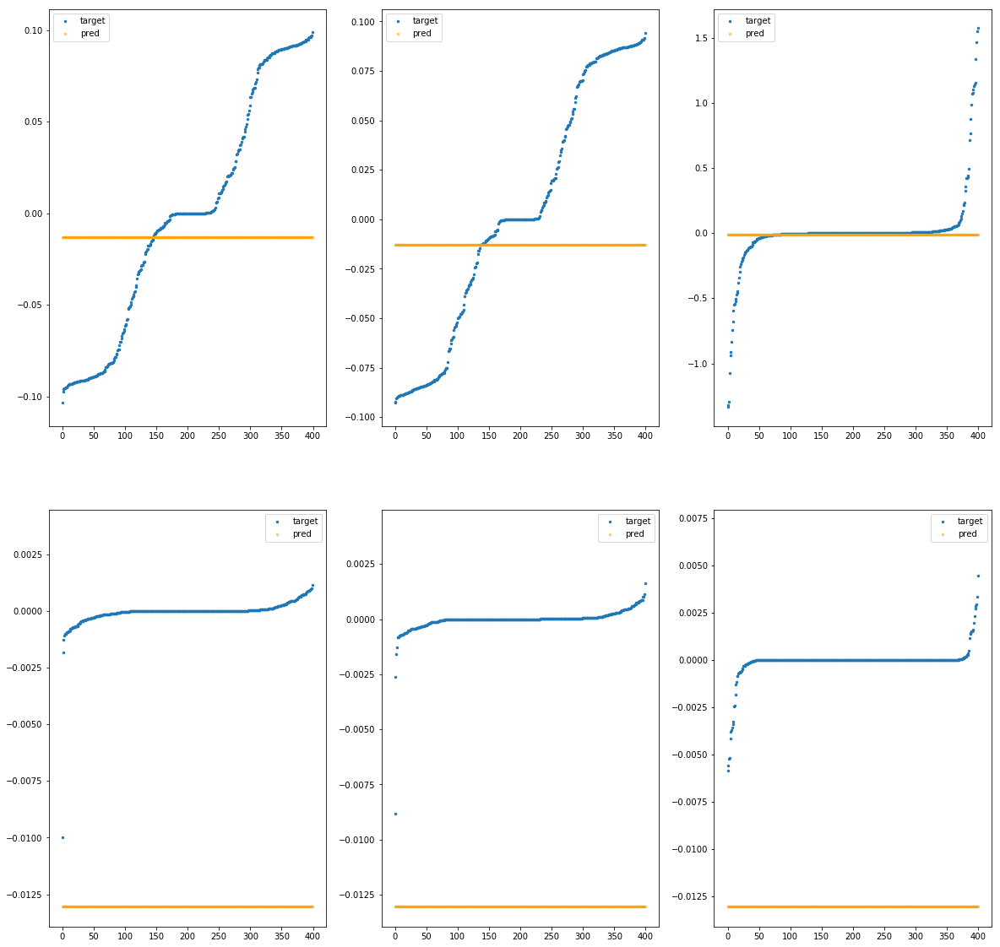

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca47c0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.32e-02	1.09e-01	5.35e-02	5.32e+04	4.19e-03	1.75e-05
y		-4.93e-02	1.05e-01	5.31e-02	2.72e+03	4.02e-03	1.62e-05
z		-4.02e-03	1.58e+00	1.07e-01	1.26e+03	8.37e-02	7.00e-03
phi		-2.99e+02	1.16e-02	1.04e-02	8.94e+06	1.09e-04	1.18e-08
theta		-3.52e+02	1.21e-02	1.04e-02	2.28e+06	1.09e-04	1.19e-08
psi		-1.44e+02	1.49e-02	1.04e-02	1.28e+06	1.08e-04	1.18e-08


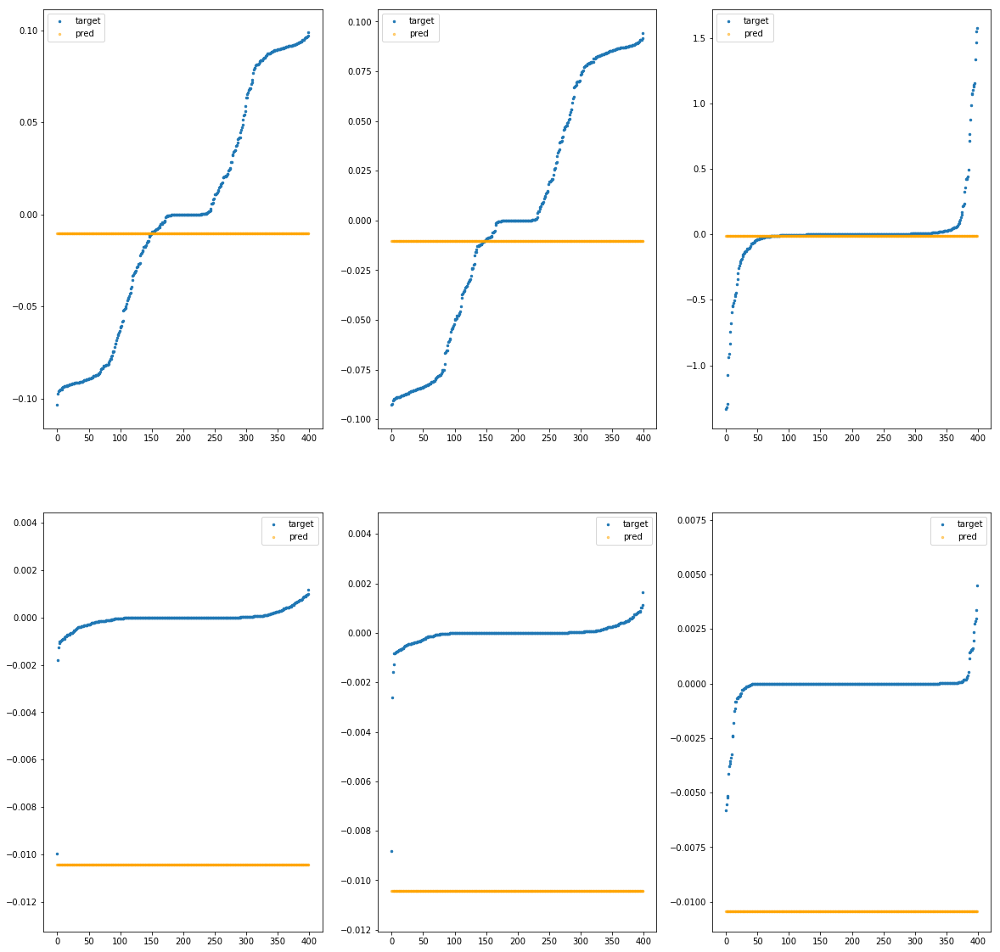

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca4820>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.17e-02	1.14e-01	5.41e-02	5.45e+04	4.22e-03	1.78e-05
y		-1.42e-02	1.03e-01	5.30e-02	2.78e+03	3.89e-03	1.51e-05
z		-9.75e-05	1.56e+00	1.07e-01	1.29e+03	8.33e-02	6.94e-03
phi		-3.18e+02	2.07e-02	1.07e-02	9.14e+06	1.15e-04	1.33e-08
theta		-3.71e+02	1.95e-02	1.07e-02	2.33e+06	1.15e-04	1.32e-08
psi		-1.54e+02	1.65e-02	1.08e-02	1.31e+06	1.16e-04	1.36e-08


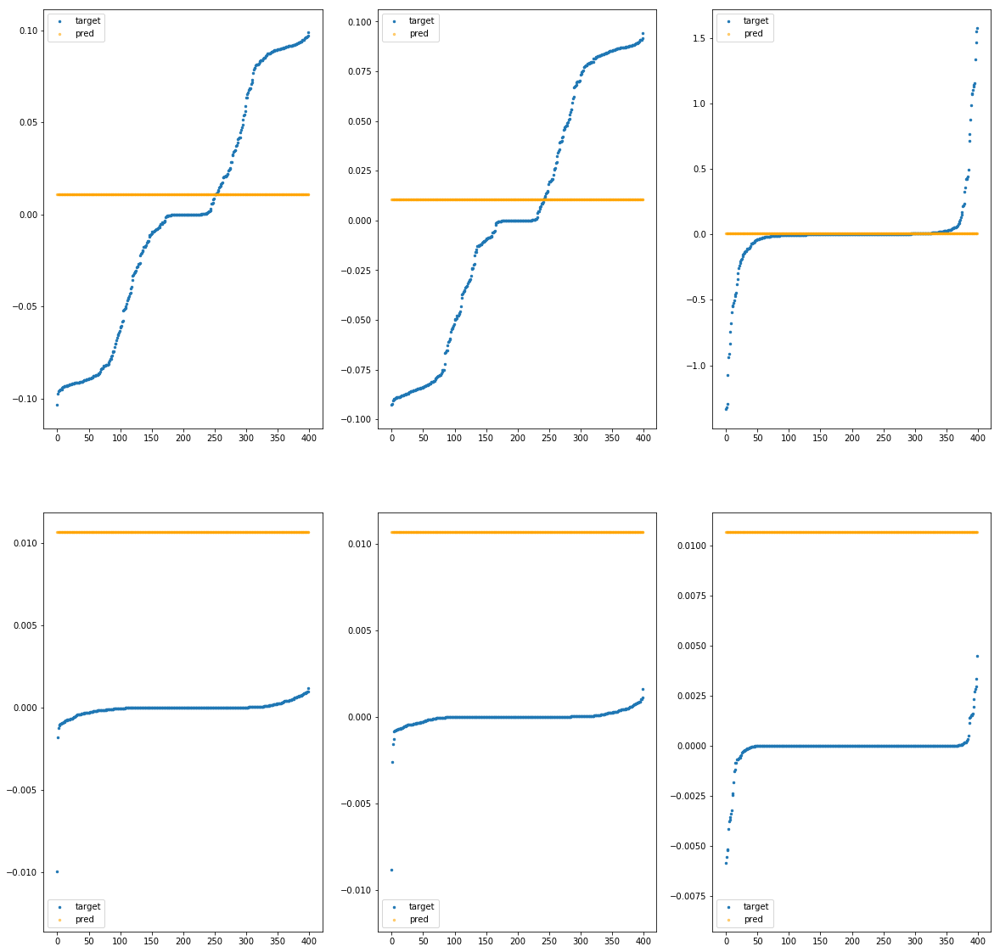

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca4880>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.39e-02	1.13e-01	5.44e-02	7.18e+04	4.27e-03	1.83e-05
y		-7.90e-02	1.08e-01	5.42e-02	3.67e+03	4.14e-03	1.71e-05
z		-5.79e-03	1.59e+00	1.09e-01	1.70e+03	8.38e-02	7.02e-03
phi		-5.46e+02	1.53e-02	1.41e-02	1.21e+07	1.98e-04	3.93e-08
theta		-6.42e+02	1.57e-02	1.41e-02	3.07e+06	1.99e-04	3.95e-08
psi		-2.63e+02	1.86e-02	1.40e-02	1.73e+06	1.98e-04	3.91e-08


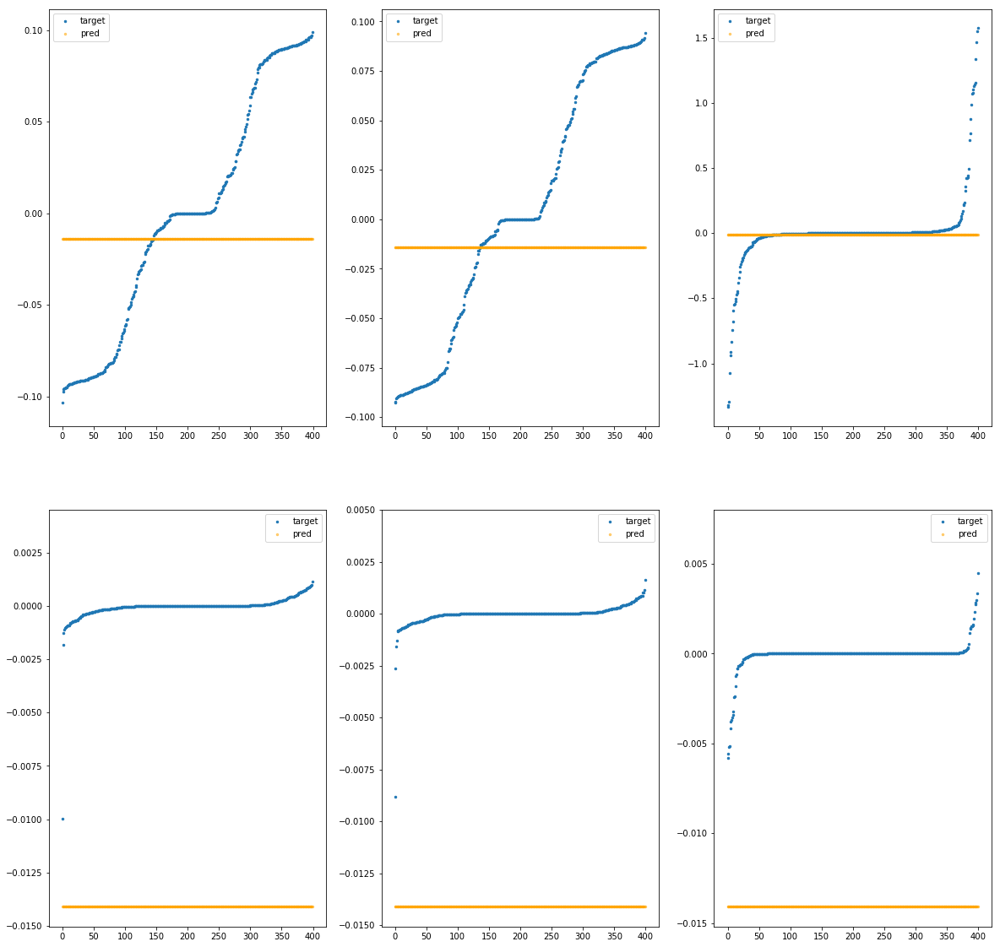

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba6fca48e0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.71e-02	1.12e-01	5.41e-02	6.64e+04	4.25e-03	1.80e-05
y		-6.96e-02	1.07e-01	5.38e-02	3.39e+03	4.10e-03	1.68e-05
z		-5.22e-03	1.59e+00	1.08e-01	1.57e+03	8.38e-02	7.01e-03
phi		-4.66e+02	1.41e-02	1.30e-02	1.11e+07	1.69e-04	2.85e-08
theta		-5.47e+02	1.47e-02	1.30e-02	2.84e+06	1.69e-04	2.87e-08
psi		-2.24e+02	1.75e-02	1.30e-02	1.60e+06	1.68e-04	2.84e-08


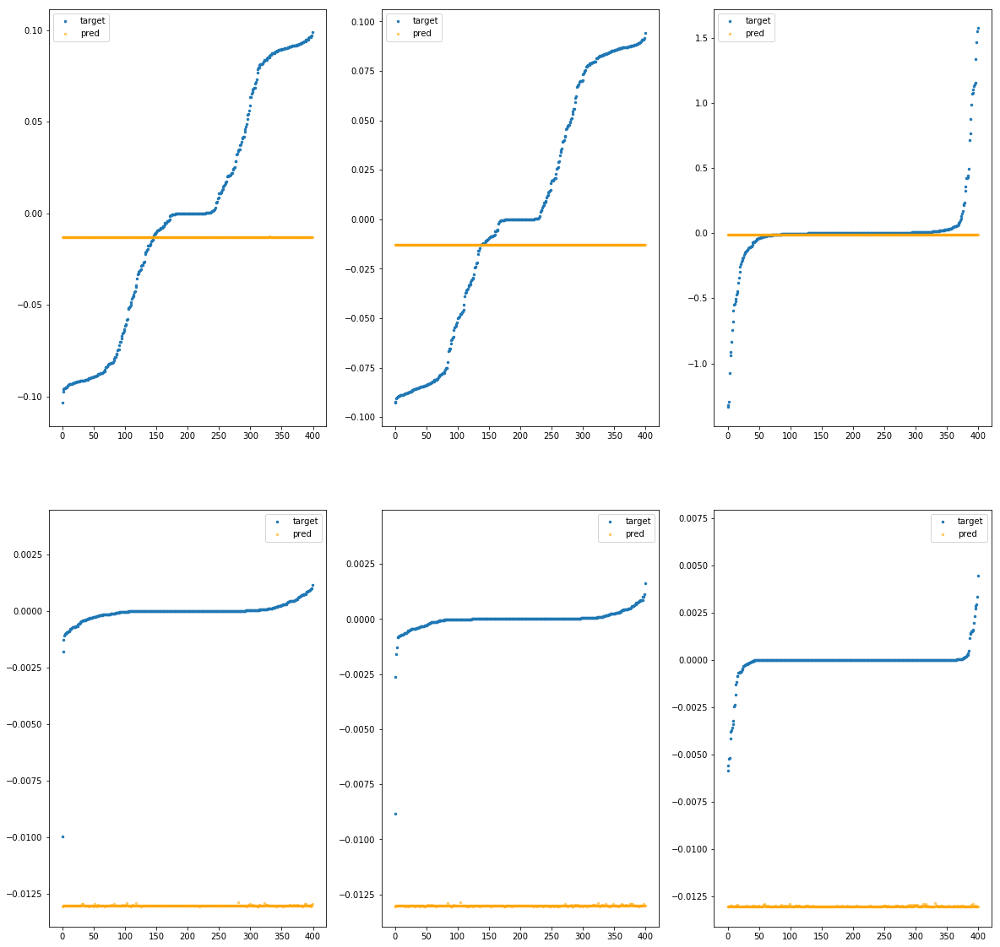

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4940>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.41e-04	1.03e-01	5.17e-02	2.05e+02	4.10e-03	1.68e-05
y		-3.12e-04	9.28e-02	5.11e-02	1.26e+01	3.84e-03	1.47e-05
z		-2.89e-04	1.57e+00	1.02e-01	9.86e+00	8.33e-02	6.95e-03
phi		-1.36e+00	9.91e-03	4.40e-04	4.28e+04	8.56e-07	7.33e-13
theta		-1.30e+00	8.76e-03	4.10e-04	7.40e+03	7.10e-07	5.03e-13
psi		-5.76e-01	6.61e-03	4.91e-04	1.99e+04	1.18e-06	1.40e-12


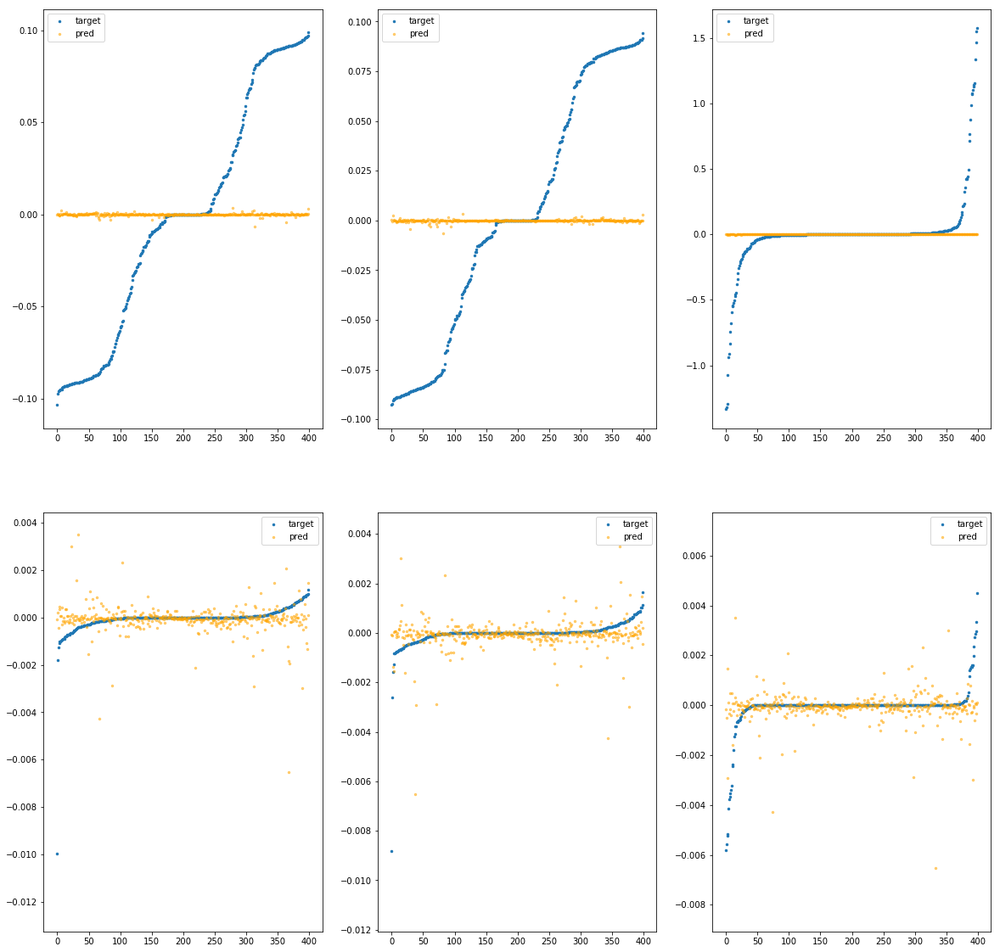

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca49a0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.30e-03	1.02e-01	5.16e-02	1.29e+03	4.09e-03	1.67e-05
y		-2.43e-03	9.44e-02	5.11e-02	7.34e+01	3.84e-03	1.48e-05
z		-8.11e-04	1.57e+00	1.02e-01	3.41e+01	8.34e-02	6.95e-03
phi		-7.11e-01	7.60e-03	4.95e-04	2.26e+05	6.20e-07	3.84e-13
theta		-8.06e-01	6.45e-03	4.88e-04	5.85e+04	5.58e-07	3.11e-13
psi		-4.72e-01	5.74e-03	5.91e-04	4.49e+04	1.10e-06	1.22e-12


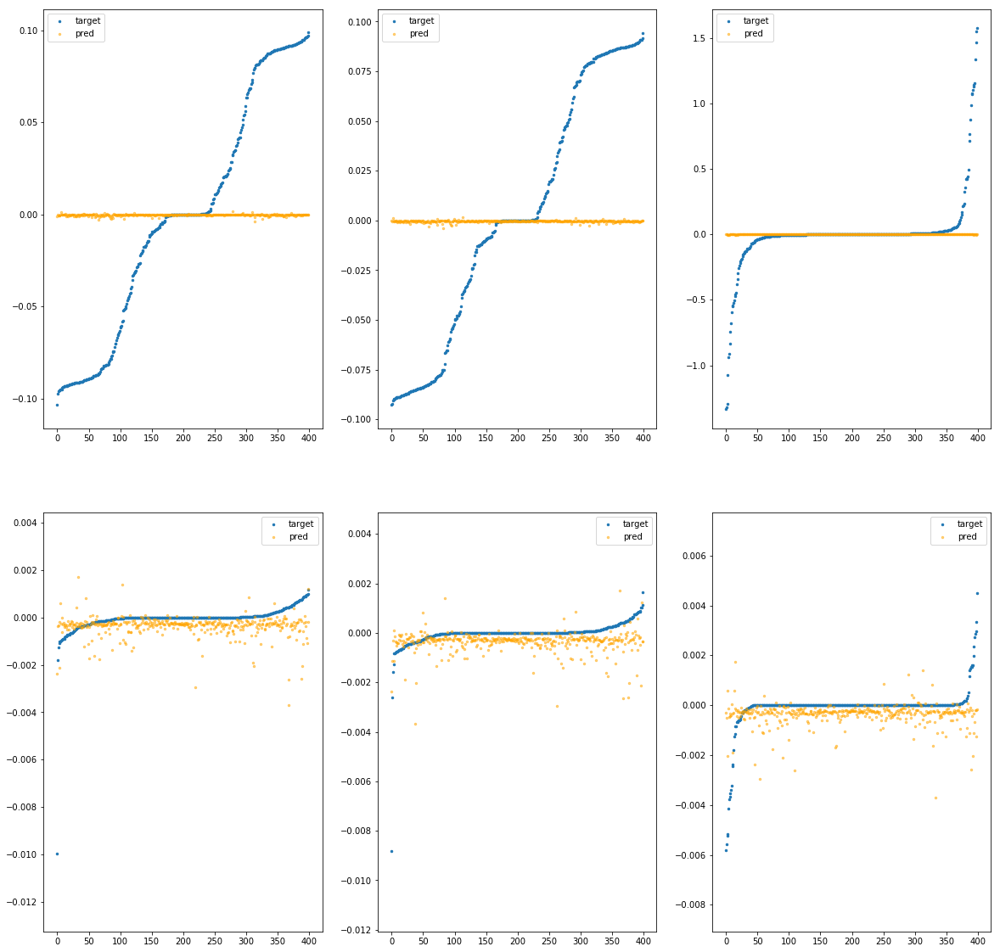

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4a00>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		9.89e-04	1.02e-01	5.17e-02	2.82e+03	4.09e-03	1.67e-05
y		-3.24e-03	9.31e-02	5.12e-02	1.45e+02	3.85e-03	1.48e-05
z		-1.25e-03	1.57e+00	1.02e-01	6.87e+01	8.34e-02	6.96e-03
phi		-1.43e+00	6.54e-03	7.16e-04	4.91e+05	8.79e-07	7.72e-13
theta		-1.72e+00	5.39e-03	7.12e-04	1.22e+05	8.40e-07	7.06e-13
psi		-7.96e-01	6.19e-03	8.15e-04	7.46e+04	1.35e-06	1.81e-12


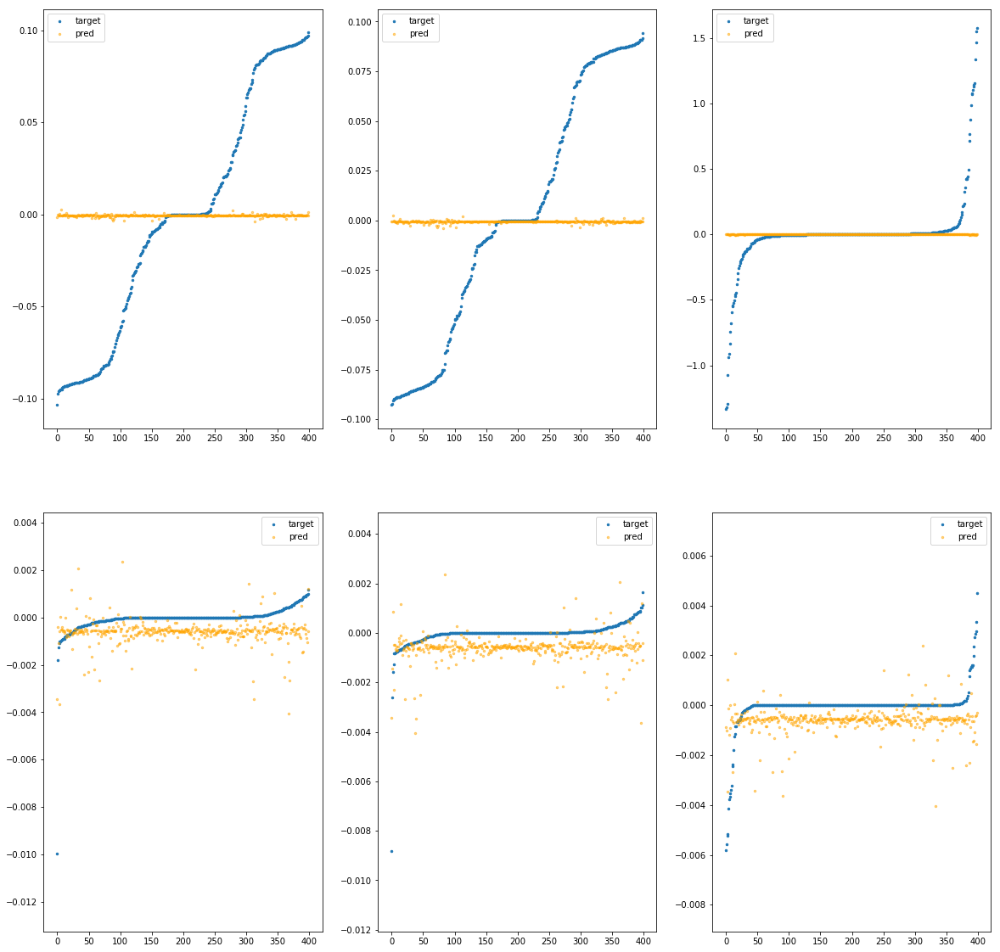

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4a60>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		2.15e-03	1.01e-01	5.16e-02	2.40e+02	4.09e-03	1.67e-05
y		-2.50e-03	9.28e-02	5.11e-02	2.05e+01	3.84e-03	1.48e-05
z		-8.58e-04	1.57e+00	1.02e-01	1.02e+01	8.34e-02	6.95e-03
phi		-7.74e-01	6.26e-03	4.16e-04	5.84e+04	6.42e-07	4.13e-13
theta		-7.39e-01	5.11e-03	3.98e-04	1.43e+04	5.37e-07	2.89e-13
psi		-4.55e-01	5.83e-03	4.89e-04	1.69e+04	1.09e-06	1.19e-12


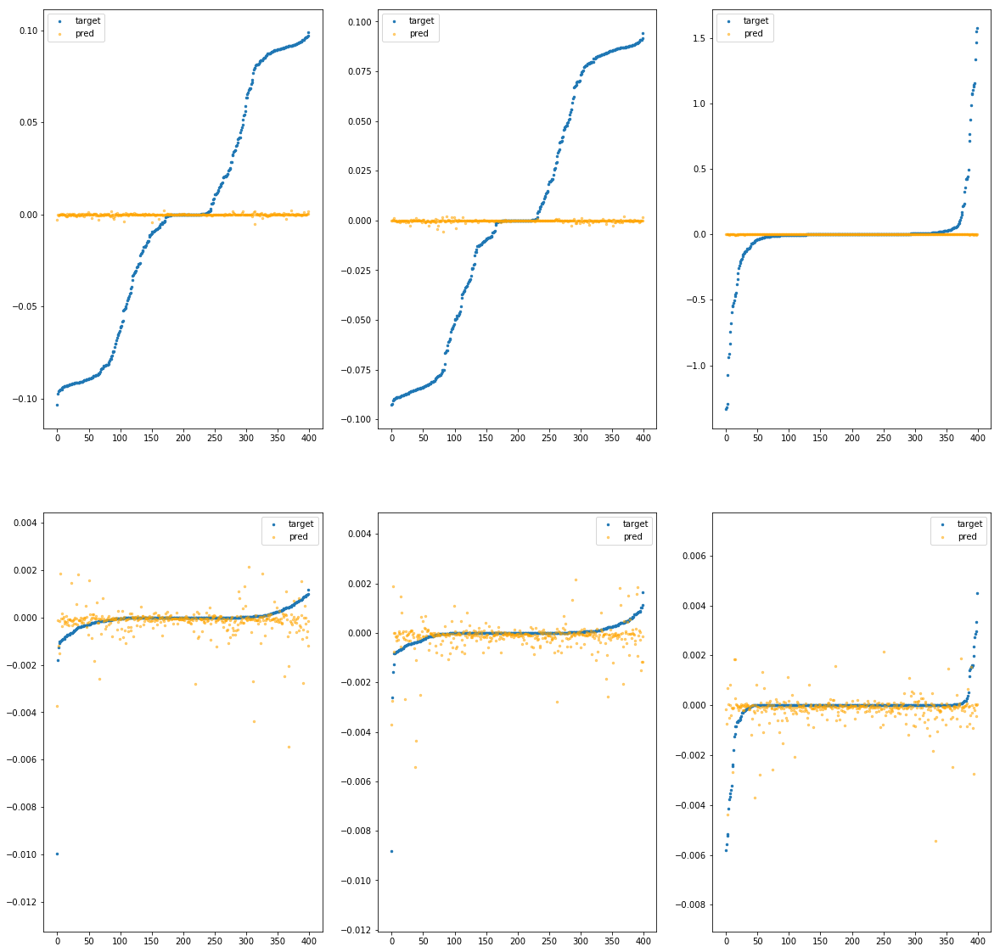

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4ac0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.84e-03	1.01e-01	5.17e-02	3.96e+03	4.09e-03	1.67e-05
y		-4.95e-03	9.33e-02	5.12e-02	2.08e+02	3.85e-03	1.48e-05
z		-6.72e-04	1.58e+00	1.02e-01	9.63e+01	8.34e-02	6.95e-03
phi		-2.17e+00	6.66e-03	8.81e-04	6.82e+05	1.15e-06	1.32e-12
theta		-2.55e+00	5.51e-03	8.87e-04	1.72e+05	1.10e-06	1.20e-12
psi		-1.06e+00	6.53e-03	9.75e-04	1.06e+05	1.55e-06	2.39e-12


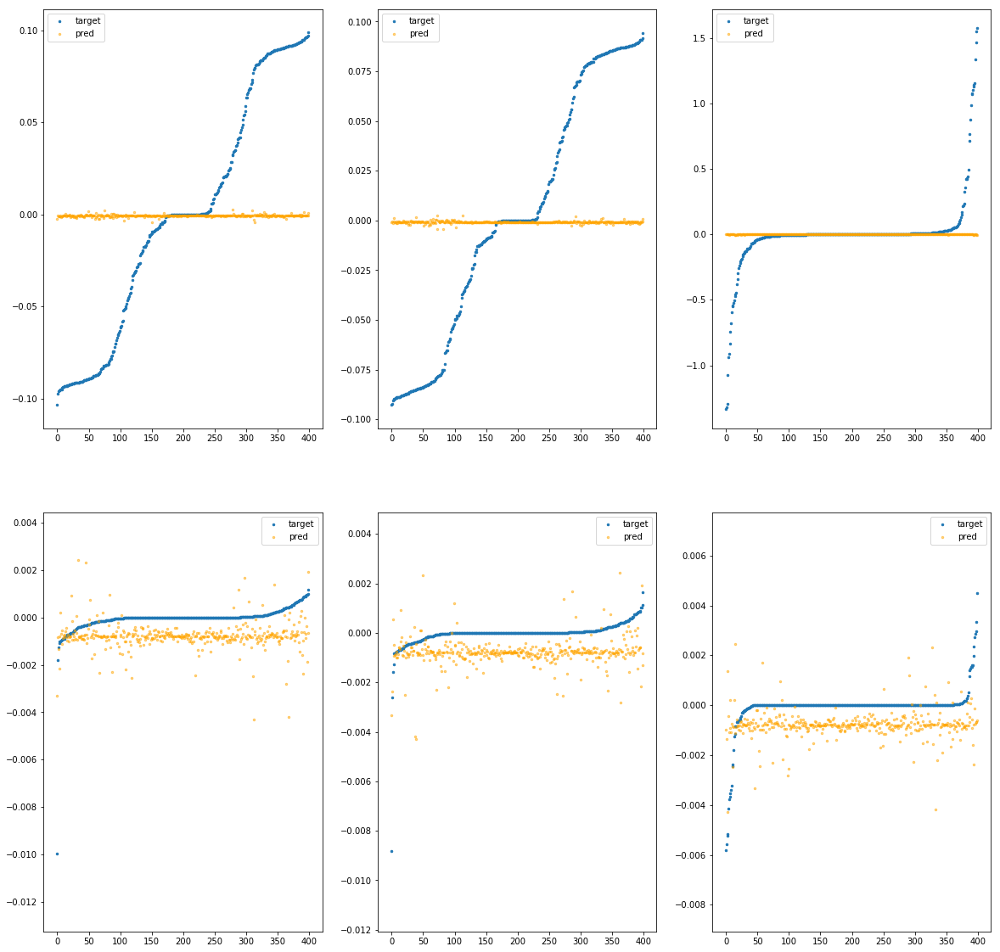

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4b20>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.36e-04	1.02e-01	5.18e-02	7.13e+03	4.10e-03	1.68e-05
y		-6.03e-03	9.53e-02	5.13e-02	3.64e+02	3.86e-03	1.49e-05
z		-1.07e-03	1.57e+00	1.02e-01	1.70e+02	8.34e-02	6.96e-03
phi		-5.08e+00	8.41e-03	1.40e-03	1.20e+06	2.20e-06	4.84e-12
theta		-6.10e+00	7.26e-03	1.42e-03	3.05e+05	2.19e-06	4.81e-12
psi		-2.33e+00	5.86e-03	1.48e-03	1.70e+05	2.50e-06	6.23e-12


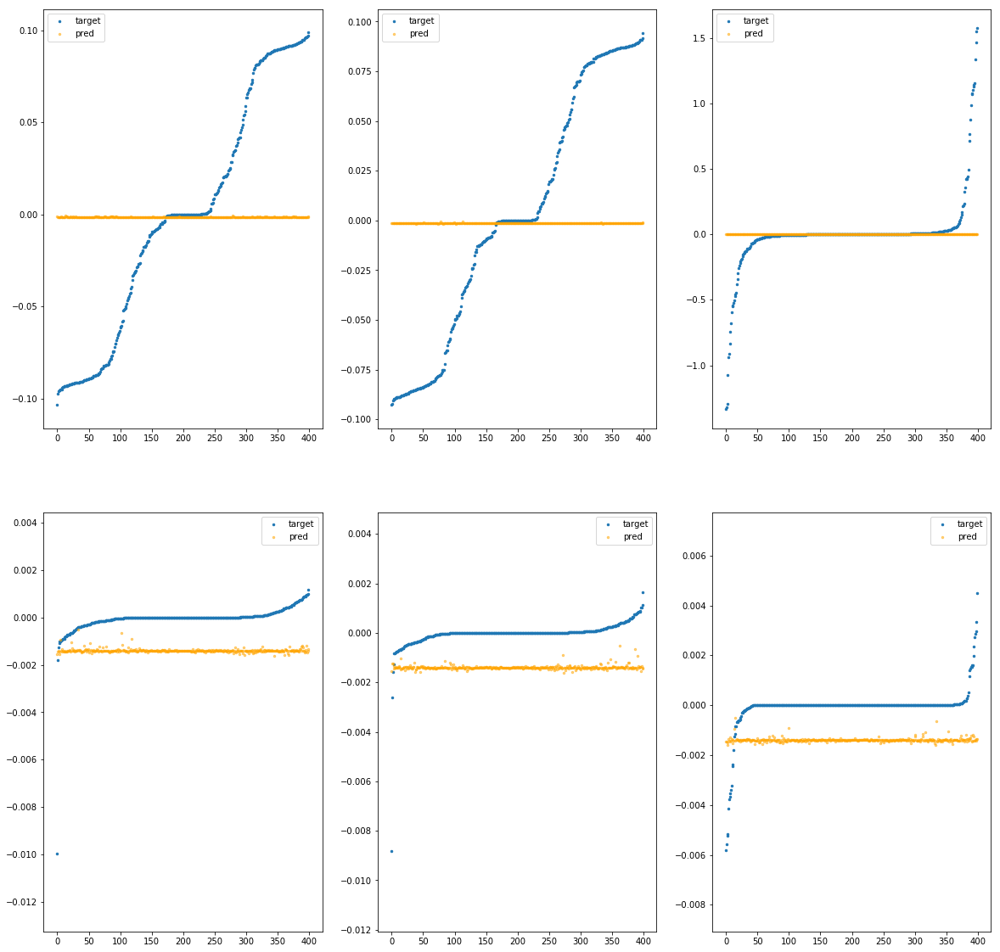

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4b80>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.67e-04	1.02e-01	5.18e-02	6.02e+03	4.10e-03	1.68e-05
y		-4.79e-03	9.32e-02	5.13e-02	3.12e+02	3.85e-03	1.48e-05
z		-1.07e-03	1.57e+00	1.02e-01	1.46e+02	8.34e-02	6.96e-03
phi		-4.09e+00	7.47e-03	1.20e-03	1.02e+06	1.84e-06	3.39e-12
theta		-4.64e+00	6.32e-03	1.20e-03	2.62e+05	1.74e-06	3.03e-12
psi		-1.84e+00	6.69e-03	1.27e-03	1.43e+05	2.13e-06	4.54e-12


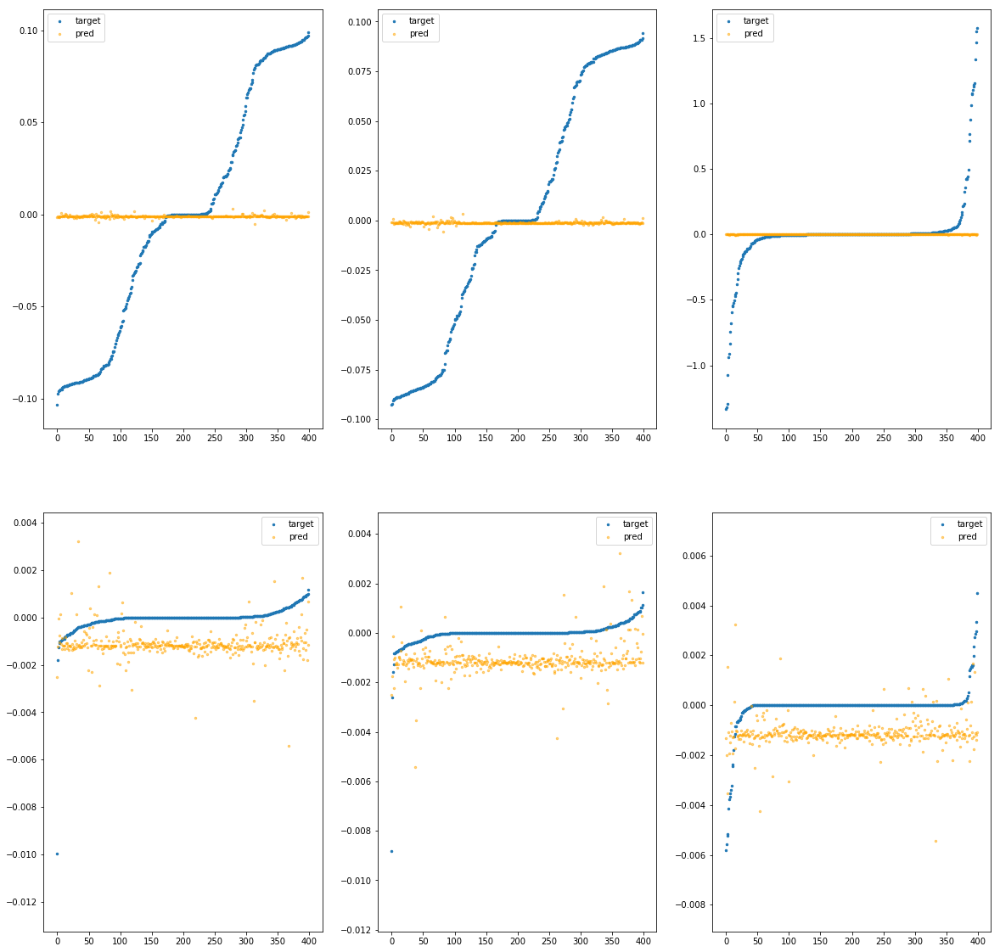

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4be0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		5.57e-04	1.01e-01	5.16e-02	2.34e+02	4.09e-03	1.67e-05
y		-2.90e-03	9.32e-02	5.11e-02	1.70e+01	3.85e-03	1.48e-05
z		-9.44e-04	1.57e+00	1.02e-01	9.79e+00	8.34e-02	6.95e-03
phi		-1.04e+00	8.10e-03	4.38e-04	5.14e+04	7.38e-07	5.45e-13
theta		-1.06e+00	6.95e-03	4.16e-04	1.11e+04	6.37e-07	4.06e-13
psi		-4.96e-01	6.80e-03	4.82e-04	2.30e+04	1.12e-06	1.26e-12


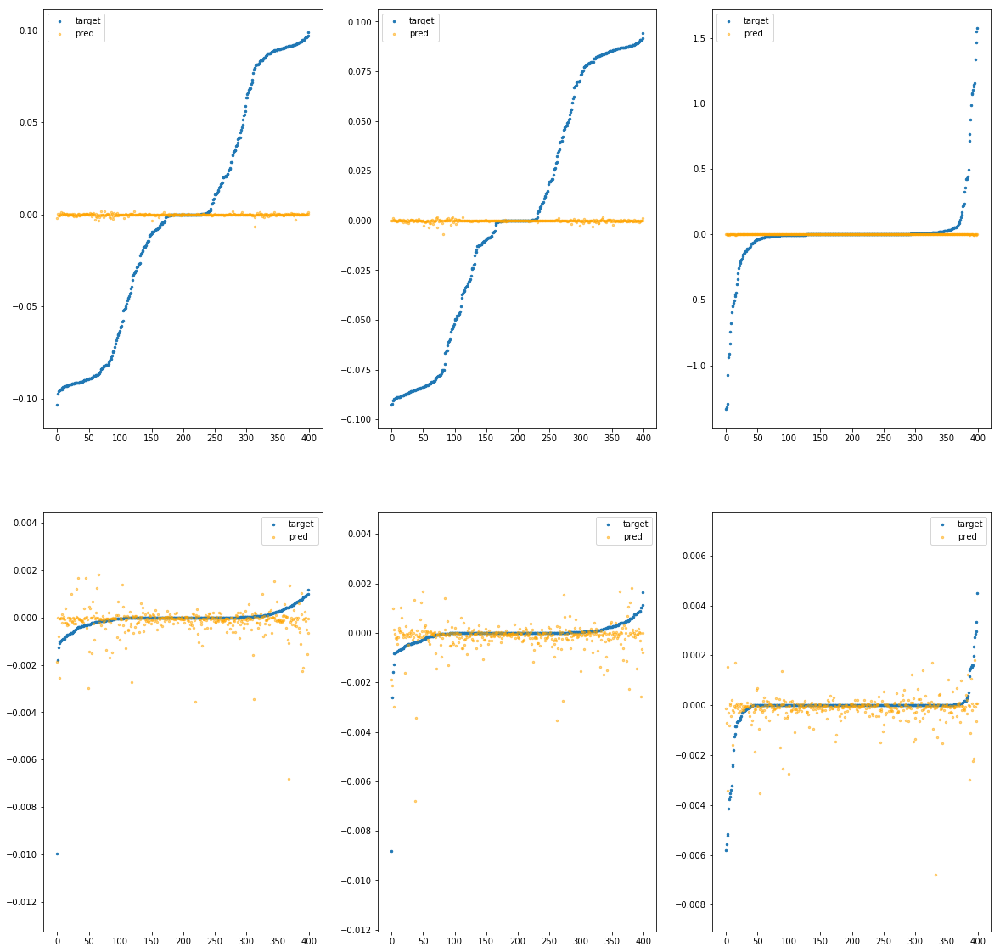

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4c40>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.46e-03	1.02e-01	5.16e-02	1.77e+02	4.09e-03	1.67e-05
y		-2.59e-03	9.39e-02	5.11e-02	1.12e+01	3.84e-03	1.48e-05
z		-1.39e-03	1.57e+00	1.02e-01	7.37e+00	8.34e-02	6.96e-03
phi		-3.88e-01	8.13e-03	3.84e-04	4.52e+04	5.03e-07	2.53e-13
theta		-4.40e-01	6.98e-03	3.68e-04	7.44e+03	4.45e-07	1.98e-13
psi		-2.05e-01	5.31e-03	4.50e-04	1.52e+04	9.04e-07	8.17e-13


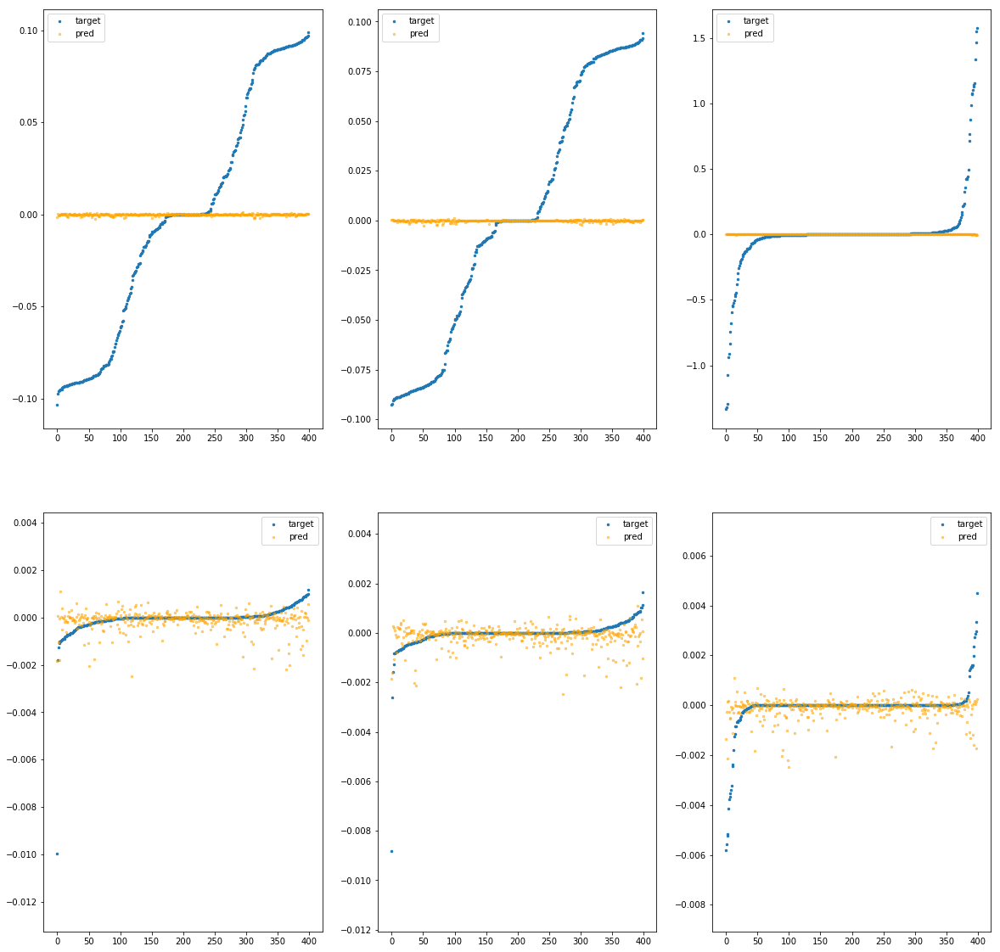

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4ca0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.41e-04	1.02e-01	5.17e-02	1.04e+03	4.10e-03	1.68e-05
y		-4.17e-03	9.40e-02	5.12e-02	5.25e+01	3.85e-03	1.48e-05
z		-6.81e-04	1.57e+00	1.02e-01	2.81e+01	8.34e-02	6.95e-03
phi		-6.81e-01	9.74e-03	4.55e-04	1.77e+05	6.09e-07	3.70e-13
theta		-6.89e-01	8.59e-03	4.39e-04	4.17e+04	5.22e-07	2.72e-13
psi		-4.20e-01	5.85e-03	5.38e-04	2.94e+04	1.06e-06	1.13e-12


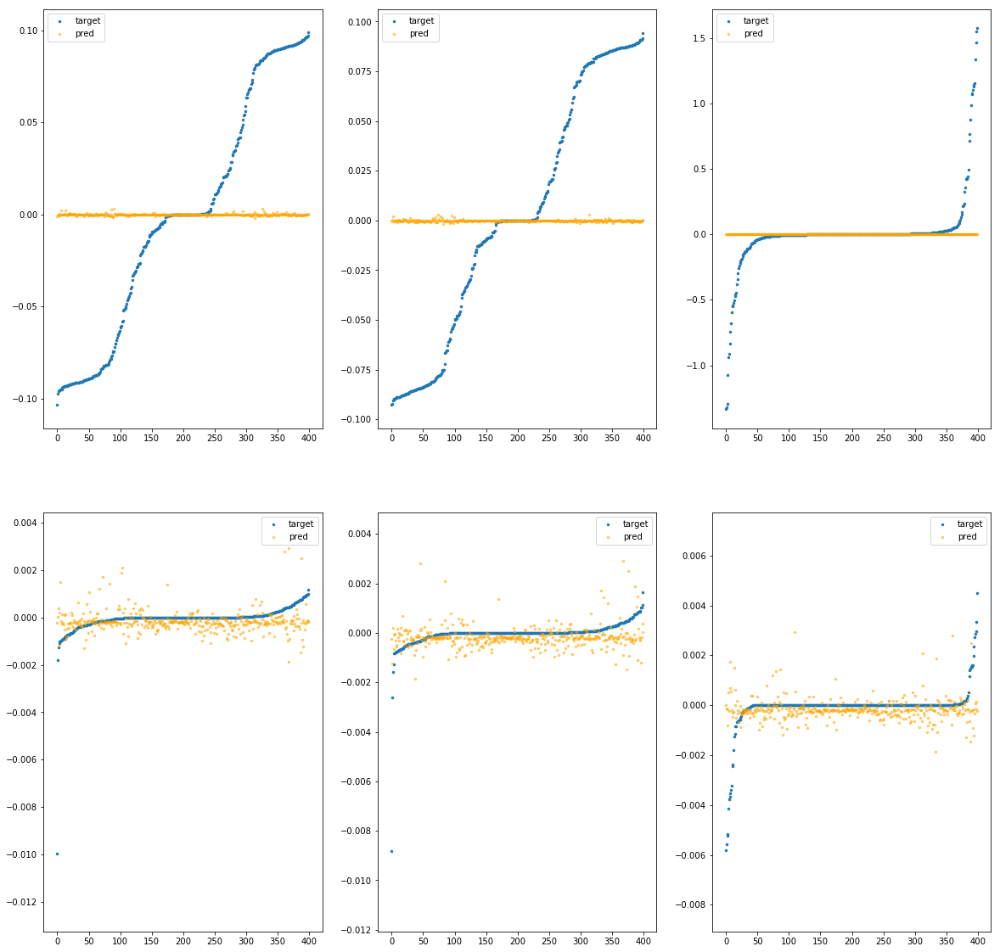

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4d00>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		5.30e-05	1.02e-01	5.20e-02	1.58e+04	4.09e-03	1.68e-05
y		-1.01e-02	9.74e-02	5.16e-02	8.15e+02	3.87e-03	1.50e-05
z		-2.07e-03	1.58e+00	1.03e-01	3.77e+02	8.35e-02	6.97e-03
phi		-2.88e+01	9.82e-03	3.20e-03	2.66e+06	1.08e-05	1.17e-10
theta		-3.39e+01	8.99e-03	3.21e-03	6.74e+05	1.08e-05	1.16e-10
psi		-1.39e+01	9.75e-03	3.21e-03	3.80e+05	1.12e-05	1.25e-10


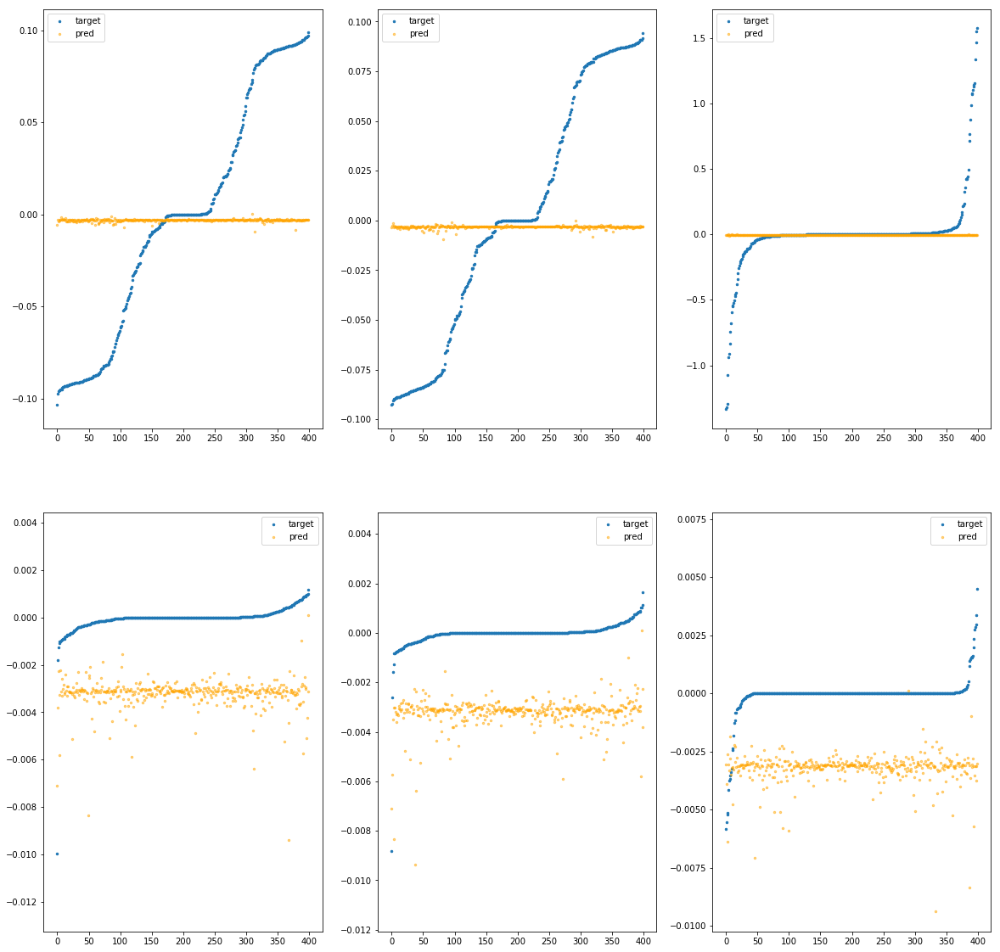

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4d60>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.28e-05	1.05e-01	5.18e-02	3.39e+03	4.09e-03	1.68e-05
y		-9.82e-04	9.33e-02	5.12e-02	1.70e+02	3.84e-03	1.47e-05
z		-2.58e-04	1.57e+00	1.02e-01	7.82e+01	8.33e-02	6.95e-03
phi		-1.65e+00	7.74e-03	7.59e-04	5.60e+05	9.58e-07	9.18e-13
theta		-1.85e+00	6.59e-03	7.38e-04	1.42e+05	8.80e-07	7.74e-13
psi		-9.60e-01	7.08e-03	8.66e-04	7.40e+04	1.47e-06	2.16e-12


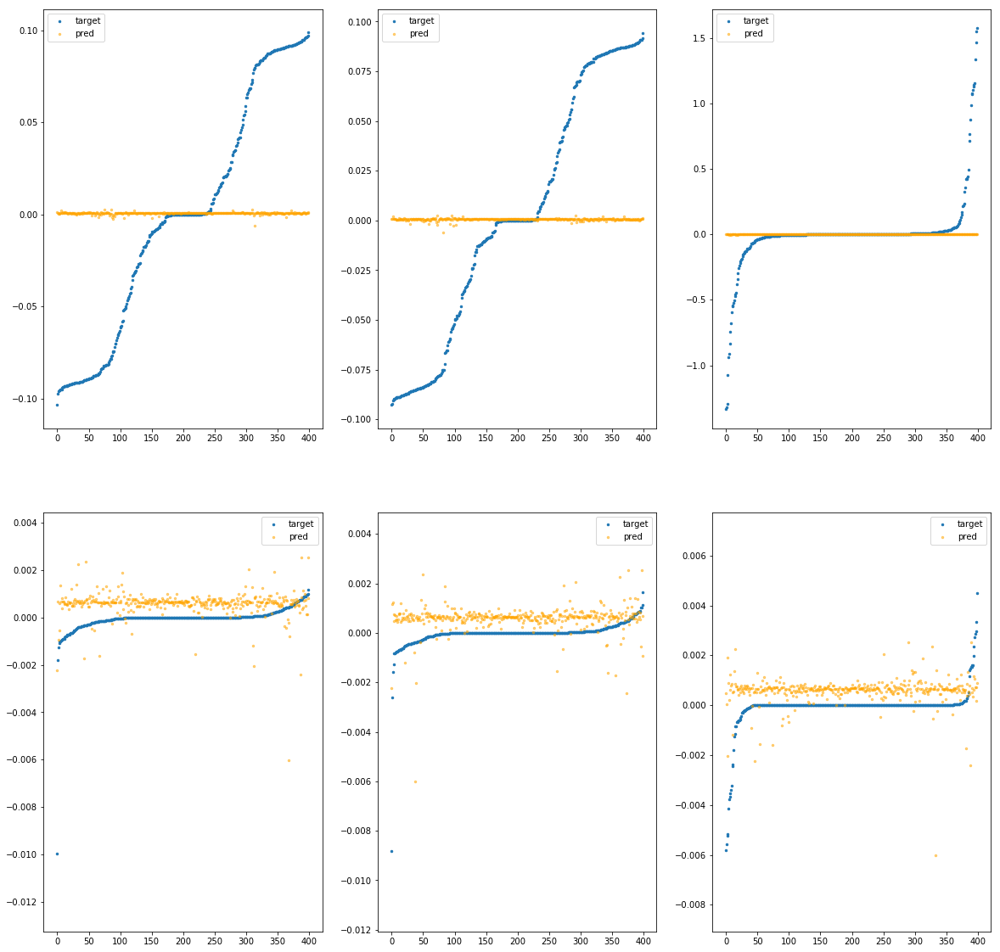

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4dc0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		7.23e-04	1.03e-01	5.17e-02	2.05e+03	4.09e-03	1.67e-05
y		-2.25e-03	9.34e-02	5.12e-02	1.04e+02	3.84e-03	1.48e-05
z		-7.88e-04	1.57e+00	1.02e-01	4.80e+01	8.34e-02	6.95e-03
phi		-3.51e-01	8.36e-03	4.84e-04	3.38e+05	4.89e-07	2.39e-13
theta		-3.89e-01	7.21e-03	4.64e-04	8.81e+04	4.29e-07	1.84e-13
psi		-2.74e-01	6.17e-03	5.95e-04	4.59e+04	9.55e-07	9.13e-13


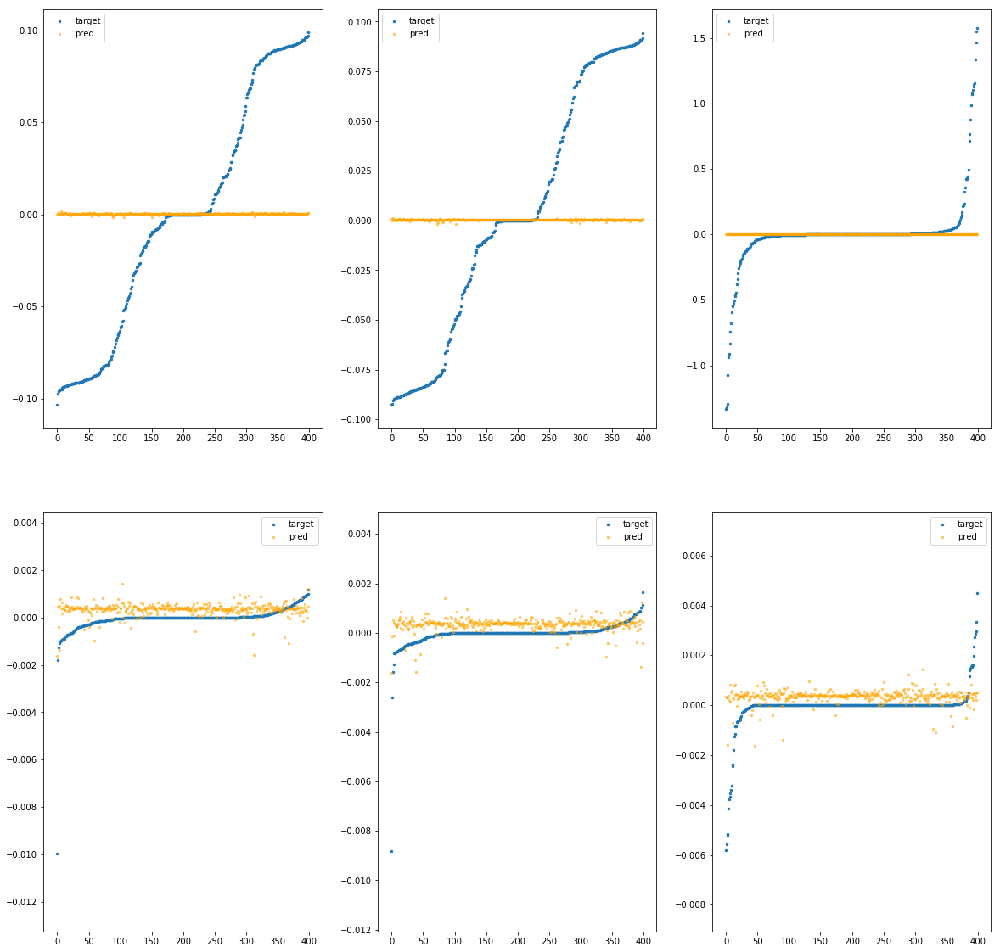

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4e20>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.75e-04	1.02e-01	5.17e-02	1.25e+03	4.09e-03	1.68e-05
y		-2.75e-03	9.25e-02	5.11e-02	7.03e+01	3.84e-03	1.48e-05
z		-5.00e-04	1.57e+00	1.02e-01	3.26e+01	8.34e-02	6.95e-03
phi		-1.05e+00	8.91e-03	4.89e-04	2.18e+05	7.43e-07	5.51e-13
theta		-1.07e+00	7.76e-03	4.78e-04	5.69e+04	6.40e-07	4.09e-13
psi		-4.15e-01	5.94e-03	5.67e-04	3.62e+04	1.06e-06	1.13e-12


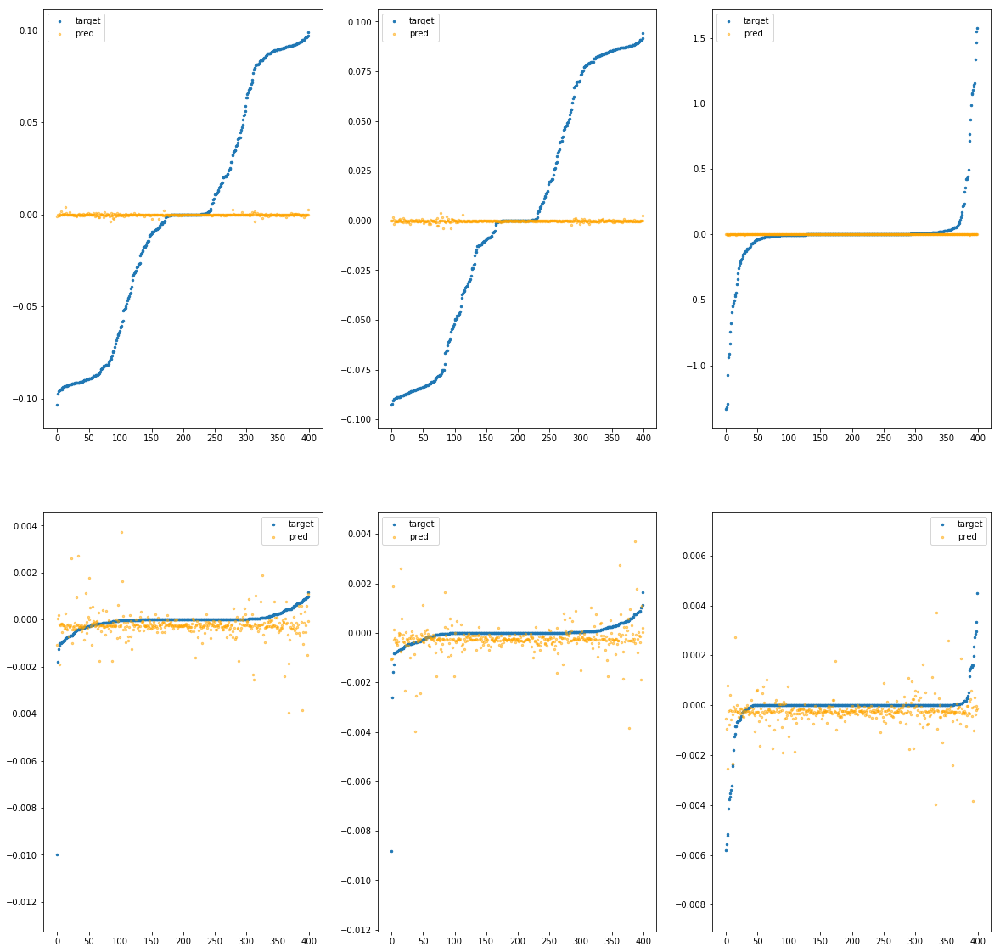

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4e80>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.18e-03	1.02e-01	5.16e-02	2.68e+02	4.09e-03	1.67e-05
y		-1.78e-03	9.33e-02	5.11e-02	8.17e+00	3.84e-03	1.48e-05
z		-4.31e-04	1.57e+00	1.02e-01	7.39e+00	8.34e-02	6.95e-03
phi		-1.05e+00	8.02e-03	4.33e-04	4.21e+04	7.42e-07	5.50e-13
theta		-1.14e+00	6.87e-03	4.04e-04	1.13e+04	6.60e-07	4.36e-13
psi		-6.19e-01	7.66e-03	4.92e-04	1.59e+04	1.21e-06	1.47e-12


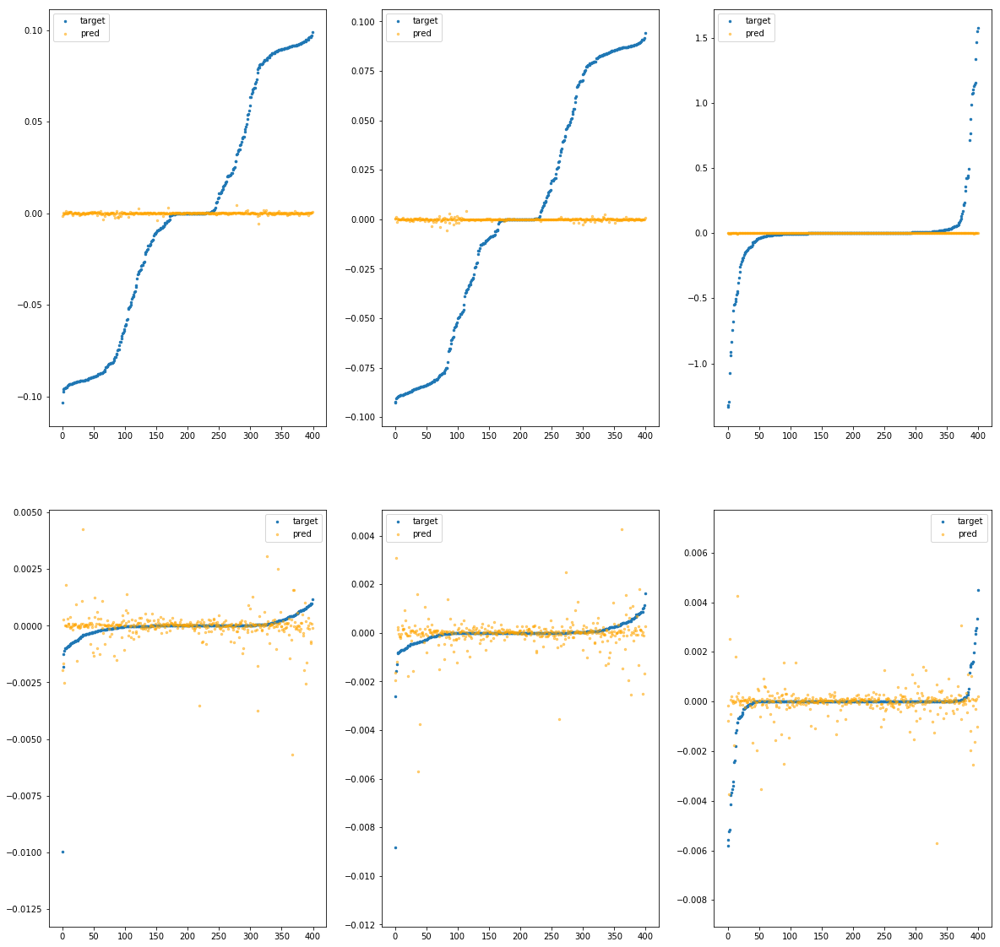

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4ee0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		6.88e-04	1.00e-01	5.19e-02	1.24e+04	4.09e-03	1.67e-05
y		-7.29e-03	9.61e-02	5.15e-02	6.41e+02	3.86e-03	1.49e-05
z		-1.32e-03	1.58e+00	1.02e-01	2.98e+02	8.34e-02	6.96e-03
phi		-1.89e+01	1.10e-02	2.57e-03	2.08e+06	7.20e-06	5.19e-11
theta		-2.23e+01	1.02e-02	2.58e-03	5.31e+05	7.19e-06	5.18e-11
psi		-8.93e+00	1.05e-02	2.58e-03	3.05e+05	7.45e-06	5.55e-11


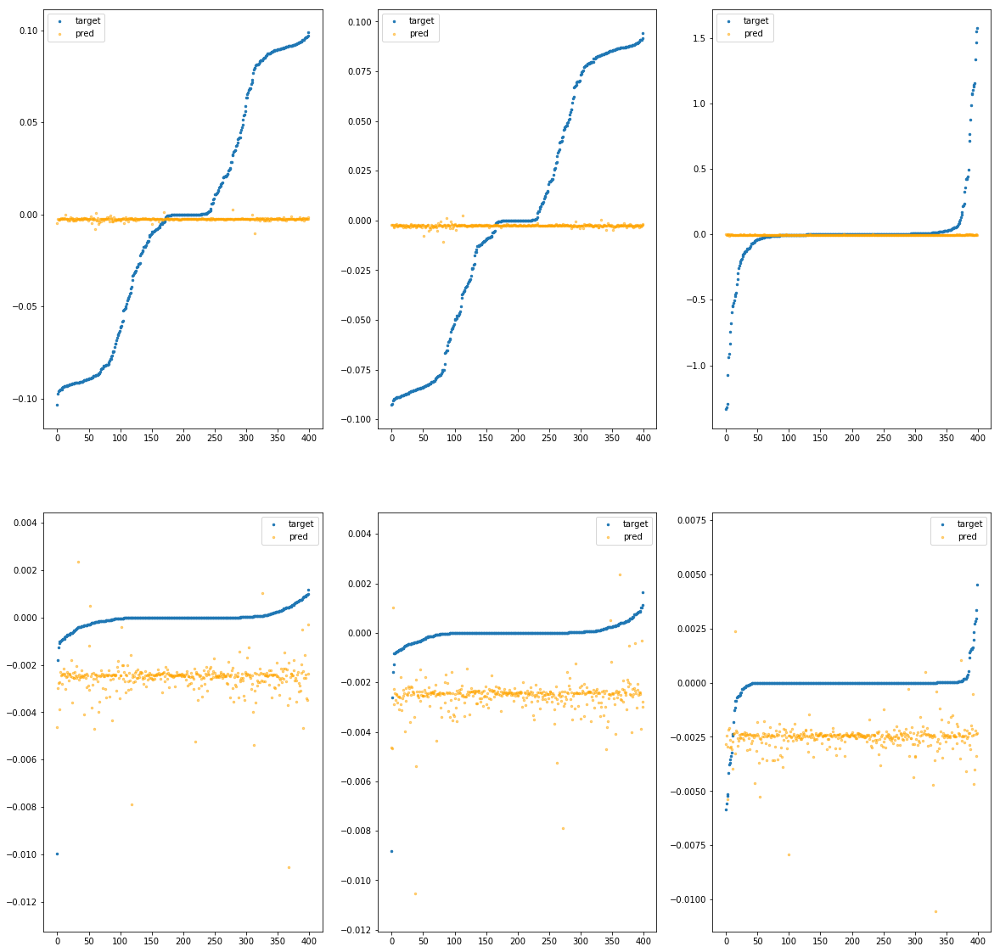

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4f40>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		4.39e-04	1.02e-01	5.18e-02	9.88e+03	4.09e-03	1.67e-05
y		-6.29e-03	9.76e-02	5.14e-02	5.09e+02	3.86e-03	1.49e-05
z		-1.13e-03	1.57e+00	1.02e-01	2.37e+02	8.34e-02	6.96e-03
phi		-1.23e+01	9.91e-03	2.04e-03	1.67e+06	4.83e-06	2.33e-11
theta		-1.43e+01	9.09e-03	2.04e-03	4.18e+05	4.71e-06	2.22e-11
psi		-5.81e+00	9.48e-03	2.10e-03	2.46e+05	5.11e-06	2.61e-11


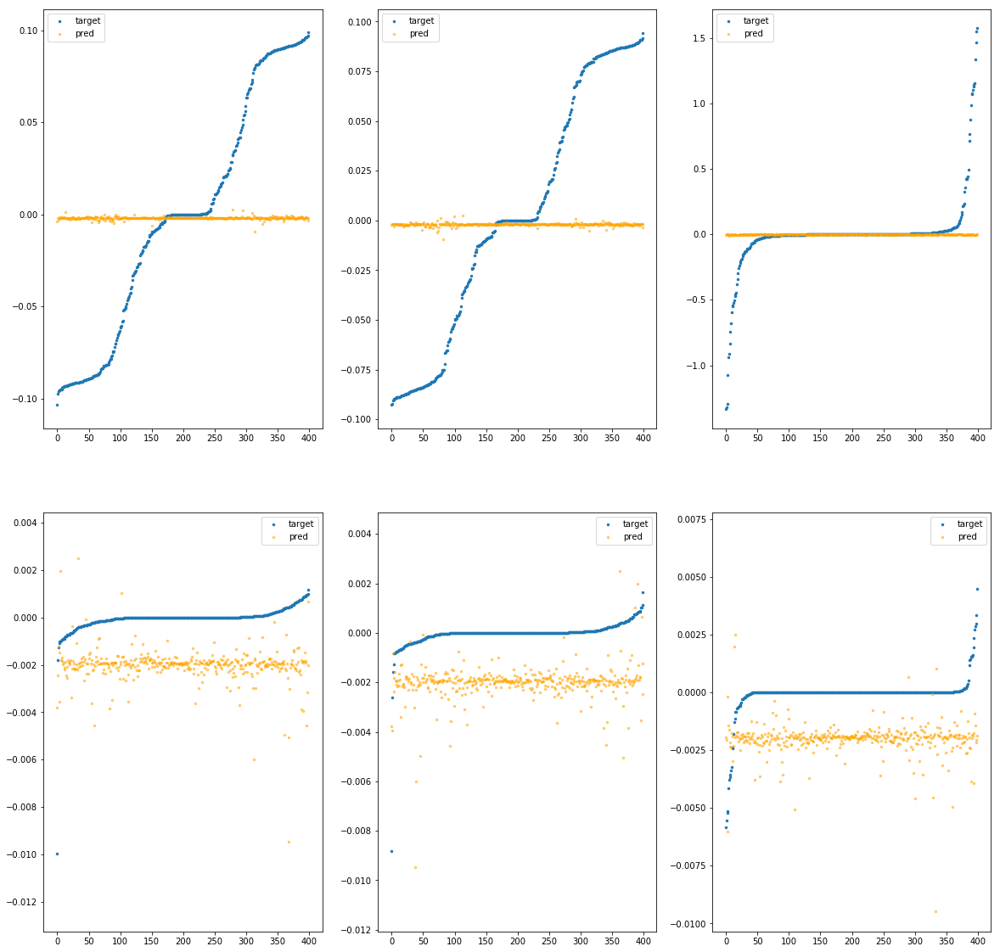

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fca4fa0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.28e-03	1.04e-01	5.17e-02	1.82e+03	4.09e-03	1.67e-05
y		9.09e-04	9.26e-02	5.11e-02	8.51e+01	3.83e-03	1.47e-05
z		-1.76e-04	1.57e+00	1.02e-01	4.16e+01	8.33e-02	6.94e-03
phi		-1.77e+00	1.06e-02	5.77e-04	2.89e+05	1.00e-06	1.01e-12
theta		-1.82e+00	9.80e-03	5.46e-04	7.70e+04	8.71e-07	7.58e-13
psi		-9.48e-01	1.02e-02	6.63e-04	4.18e+04	1.46e-06	2.13e-12


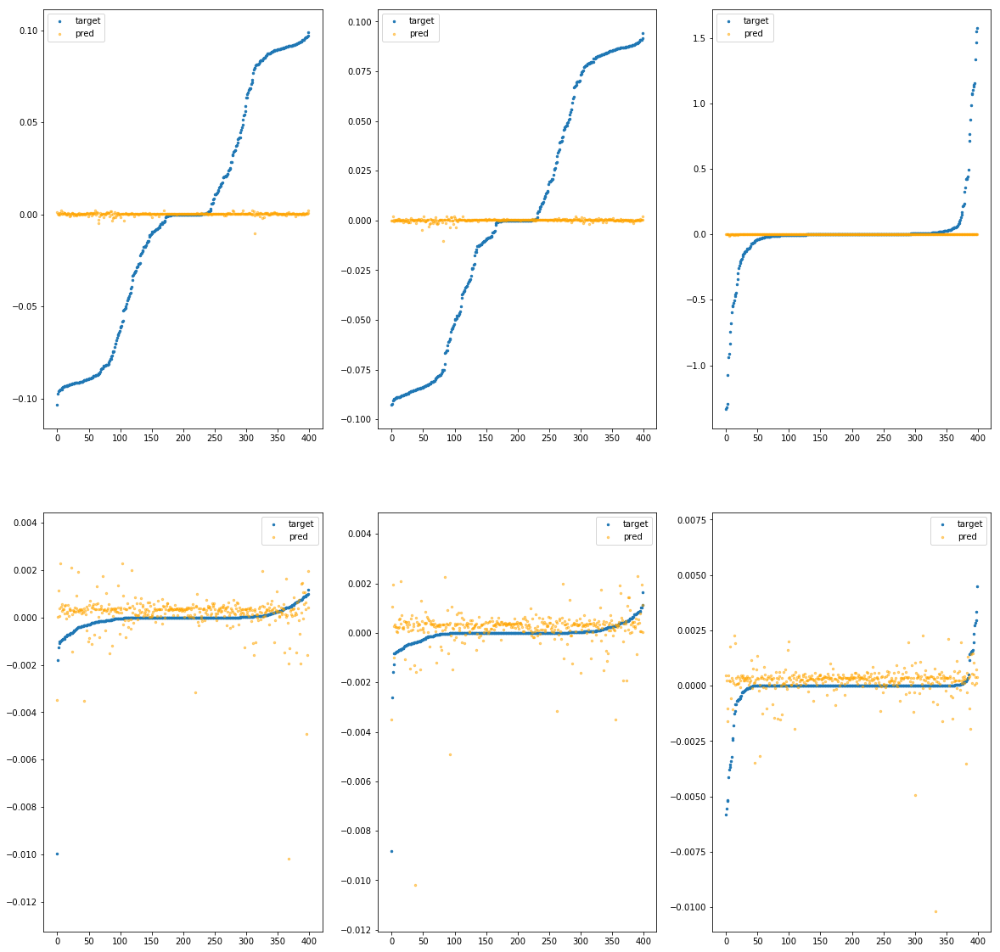

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fcbf040>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.47e-03	1.03e-01	5.16e-02	2.05e+02	4.09e-03	1.67e-05
y		-2.88e-03	9.26e-02	5.11e-02	1.20e+01	3.85e-03	1.48e-05
z		-8.50e-04	1.57e+00	1.02e-01	8.24e+00	8.34e-02	6.95e-03
phi		-5.35e-01	8.20e-03	3.90e-04	4.70e+04	5.56e-07	3.09e-13
theta		-5.93e-01	7.05e-03	3.69e-04	7.80e+03	4.92e-07	2.42e-13
psi		-3.02e-01	6.49e-03	4.43e-04	1.31e+04	9.77e-07	9.54e-13


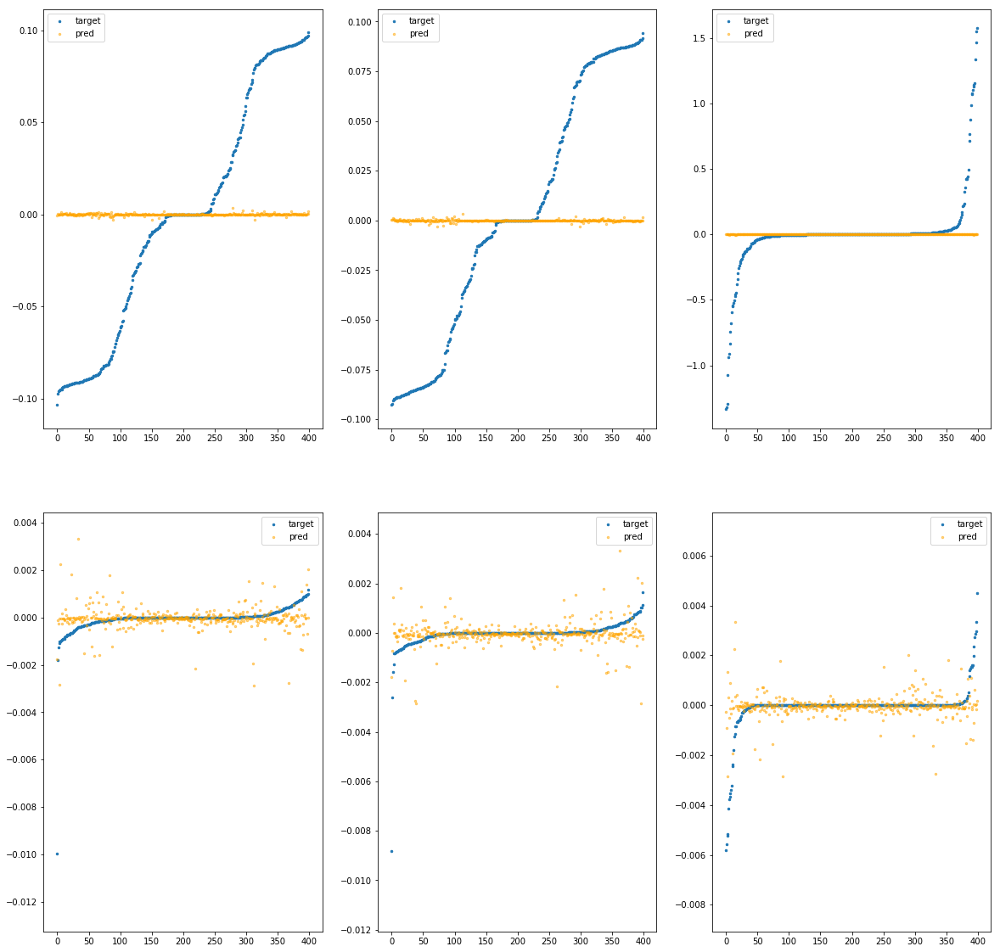

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba6fcbf0a0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		9.18e-04	1.02e-01	5.16e-02	4.11e+02	4.09e-03	1.67e-05
y		-2.19e-03	9.39e-02	5.11e-02	1.76e+01	3.84e-03	1.48e-05
z		-1.38e-03	1.57e+00	1.02e-01	1.05e+01	8.34e-02	6.96e-03
phi		-3.42e-01	7.08e-03	3.55e-04	7.83e+04	4.86e-07	2.36e-13
theta		-3.61e-01	5.93e-03	3.42e-04	1.53e+04	4.20e-07	1.77e-13
psi		-2.93e-01	5.68e-03	4.32e-04	1.92e+04	9.70e-07	9.41e-13


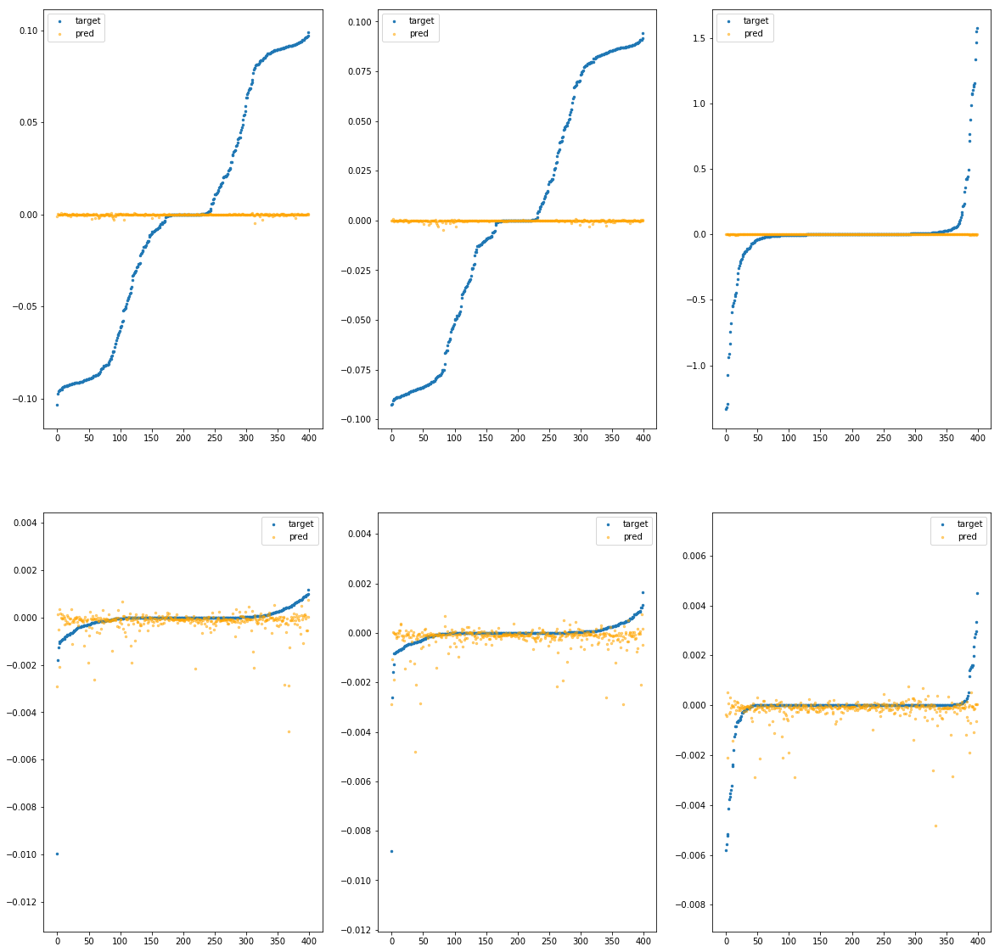

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf100>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.11e-03	1.08e-01	5.17e-02	1.14e+03	4.10e-03	1.68e-05
y		-2.02e-02	1.03e-01	5.16e-02	1.05e+02	3.91e-03	1.53e-05
z		-6.34e-05	1.58e+00	1.02e-01	5.05e+01	8.33e-02	6.94e-03
phi		-2.82e+01	2.20e-02	1.90e-03	1.58e+05	1.06e-05	1.12e-10
theta		-3.31e+01	2.08e-02	1.89e-03	7.21e+04	1.05e-05	1.11e-10
psi		-1.24e+01	1.50e-02	1.92e-03	1.90e+05	1.01e-05	1.01e-10


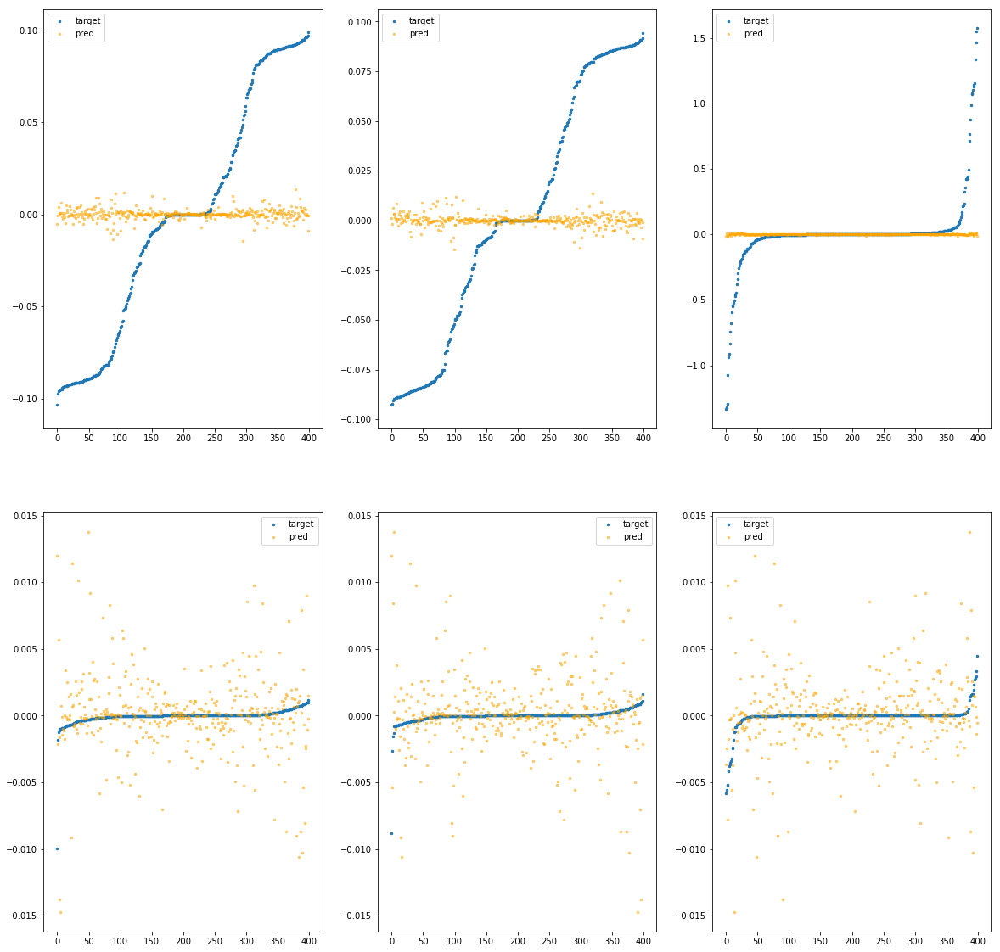

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf160>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		7.20e-03	1.04e-01	5.16e-02	1.41e+03	4.06e-03	1.65e-05
y		1.13e-02	9.68e-02	5.08e-02	8.80e+01	3.79e-03	1.44e-05
z		-1.16e-03	1.56e+00	1.02e-01	6.27e+01	8.34e-02	6.96e-03
phi		-3.91e+01	2.44e-02	2.20e-03	2.62e+05	1.45e-05	2.11e-10
theta		-4.60e+01	2.42e-02	2.19e-03	1.33e+05	1.45e-05	2.10e-10
psi		-1.99e+01	2.52e-02	2.27e-03	2.04e+05	1.57e-05	2.46e-10


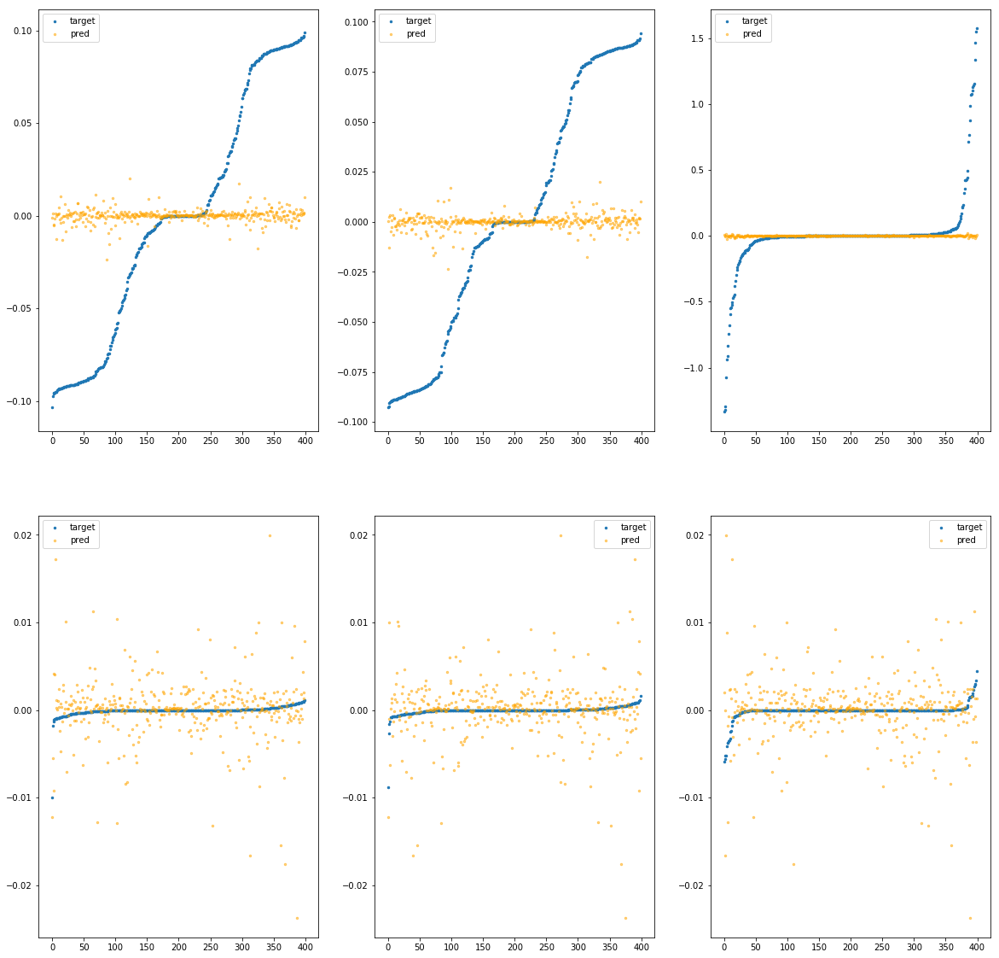

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf1c0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.87e+02	9.91e-01	8.75e-01	4.46e+06	7.69e-01	5.92e-01
y		-2.01e+02	9.87e-01	8.79e-01	2.28e+05	7.76e-01	6.02e-01
z		-9.37e+00	2.46e+00	8.91e-01	1.06e+05	8.64e-01	7.46e-01
phi		-2.12e+06	8.94e-01	8.75e-01	7.49e+08	7.66e-01	5.87e-01
theta		-2.48e+06	8.96e-01	8.75e-01	1.91e+08	7.66e-01	5.87e-01
psi		-1.02e+06	8.95e-01	8.75e-01	1.07e+08	7.66e-01	5.87e-01


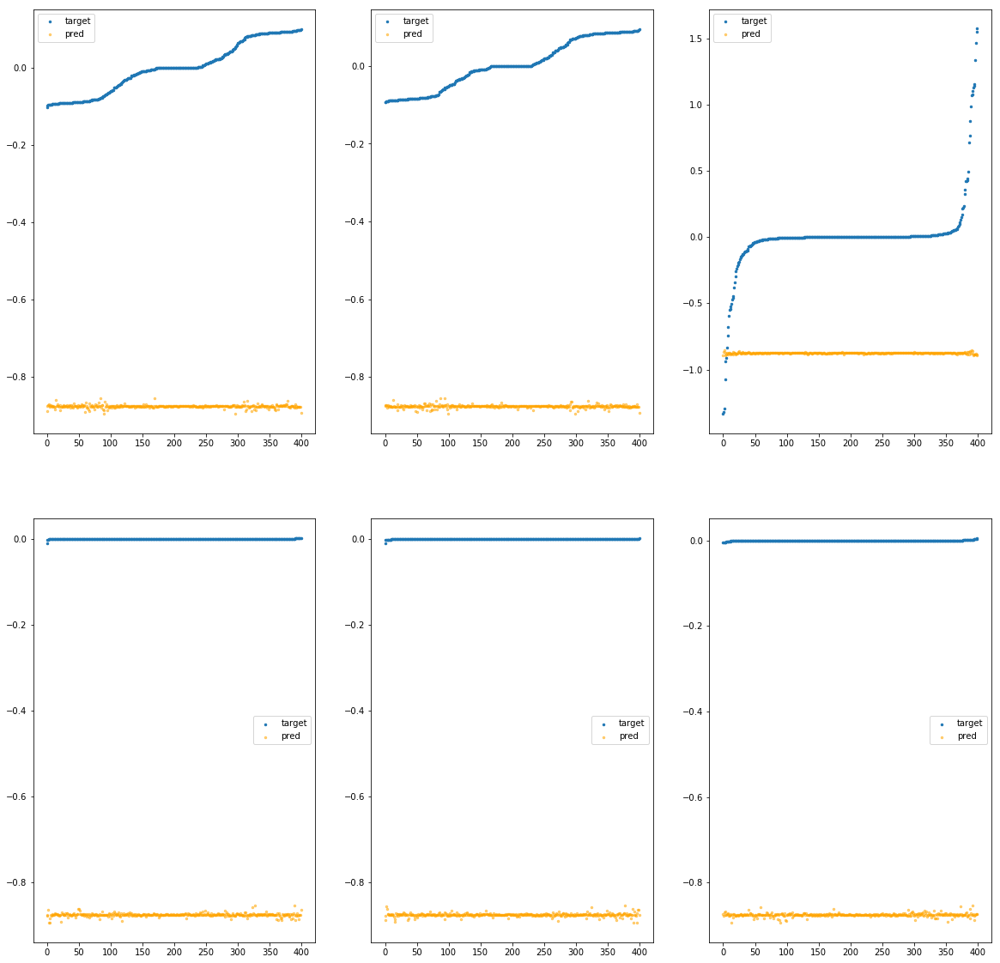

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf220>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.93e+01	5.66e-01	4.49e-01	2.29e+06	2.06e-01	4.24e-02
y		-5.36e+01	5.45e-01	4.53e-01	1.17e+05	2.09e-01	4.38e-02
z		-2.52e+00	2.03e+00	4.86e-01	5.44e+04	2.93e-01	8.58e-02
phi		-5.59e+05	4.71e-01	4.50e-01	3.85e+08	2.02e-01	4.10e-02
theta		-6.55e+05	4.71e-01	4.50e-01	9.81e+07	2.02e-01	4.10e-02
psi		-2.70e+05	4.71e-01	4.50e-01	5.51e+07	2.02e-01	4.10e-02


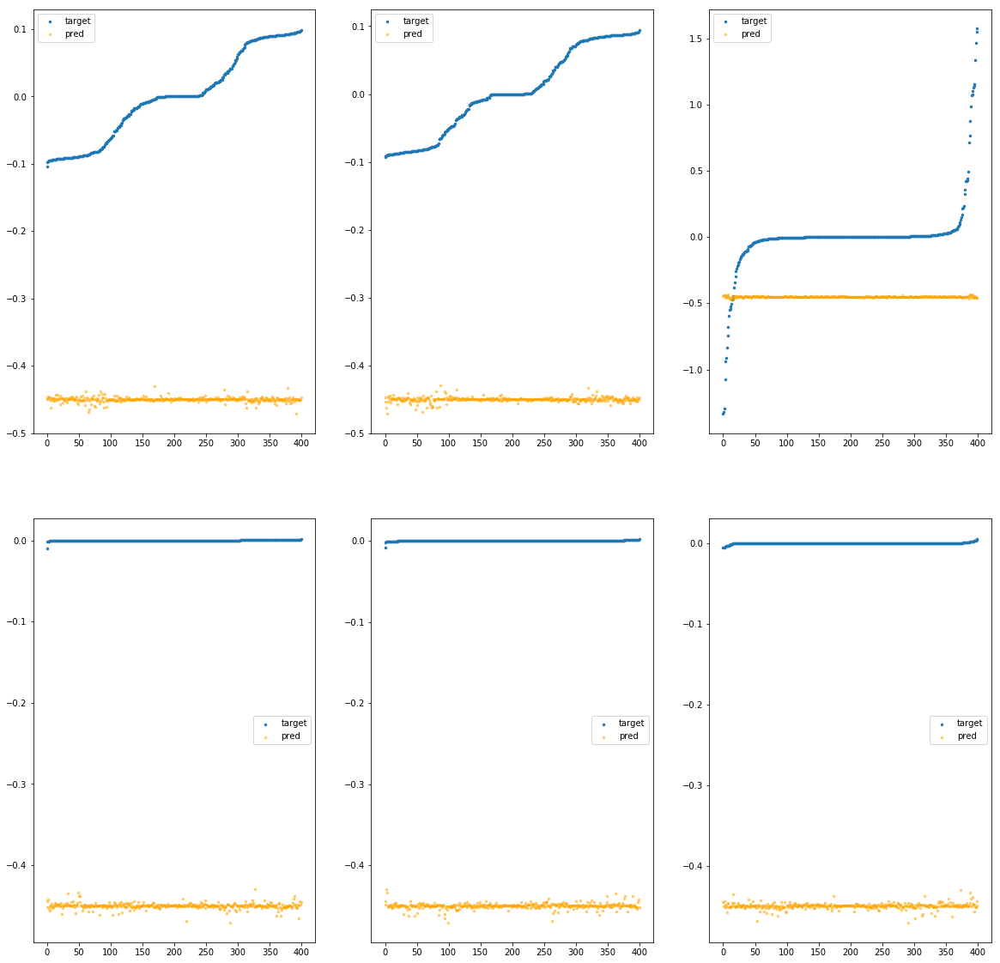

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf280>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.44e+01	4.27e-01	3.16e-01	1.61e+06	1.04e-01	1.08e-02
y		-2.67e+01	4.24e-01	3.20e-01	8.24e+04	1.06e-01	1.13e-02
z		-1.27e+00	1.91e+00	3.64e-01	3.83e+04	1.89e-01	3.57e-02
phi		-2.77e+05	3.45e-01	3.17e-01	2.71e+08	1.00e-01	1.01e-02
theta		-3.25e+05	3.47e-01	3.17e-01	6.90e+07	1.00e-01	1.01e-02
psi		-1.34e+05	3.46e-01	3.17e-01	3.87e+07	1.00e-01	1.01e-02


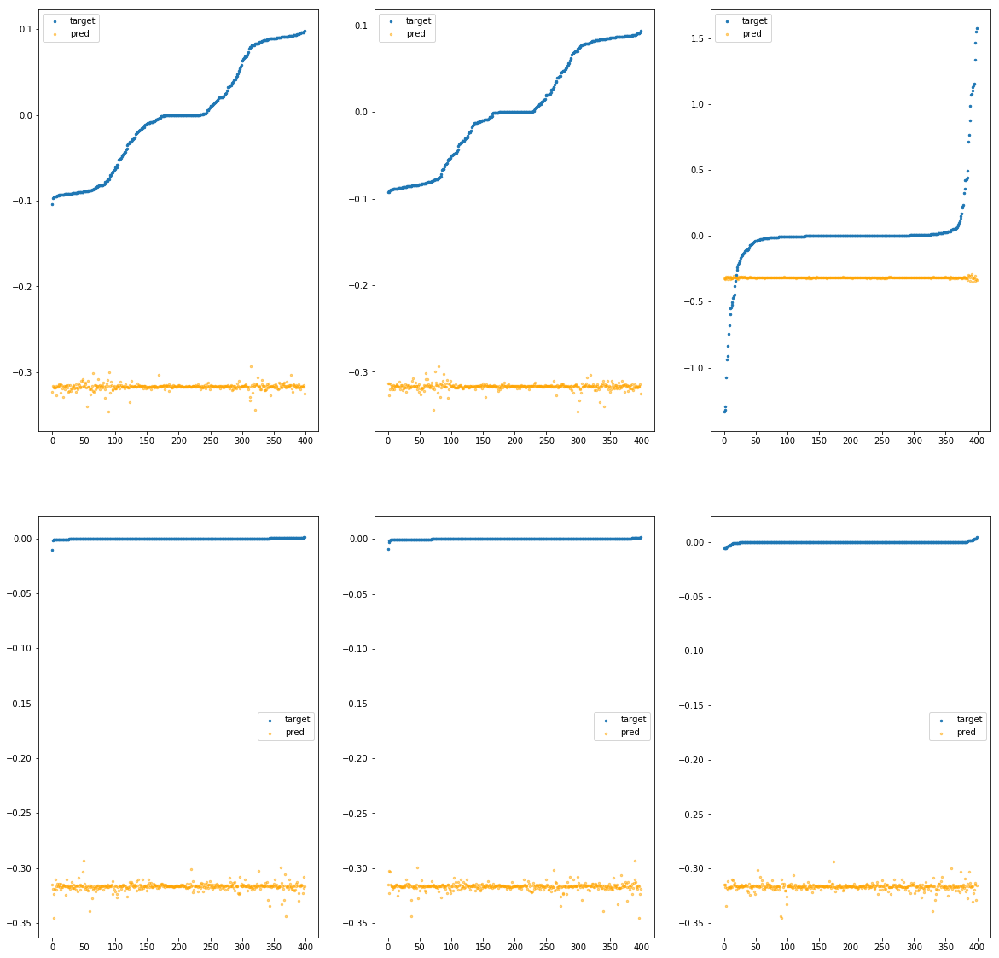

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf2e0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.39e-03	1.15e-01	5.17e-02	1.56e+03	4.09e-03	1.67e-05
y		-6.44e-03	9.53e-02	5.13e-02	8.16e+01	3.86e-03	1.49e-05
z		1.62e-03	1.56e+00	1.02e-01	4.66e+01	8.32e-02	6.92e-03
phi		-2.20e+01	1.99e-02	1.68e-03	3.11e+05	8.34e-06	6.96e-11
theta		-2.71e+01	1.99e-02	1.72e-03	9.29e+04	8.68e-06	7.53e-11
psi		-1.11e+01	2.03e-02	1.77e-03	1.60e+05	9.05e-06	8.19e-11


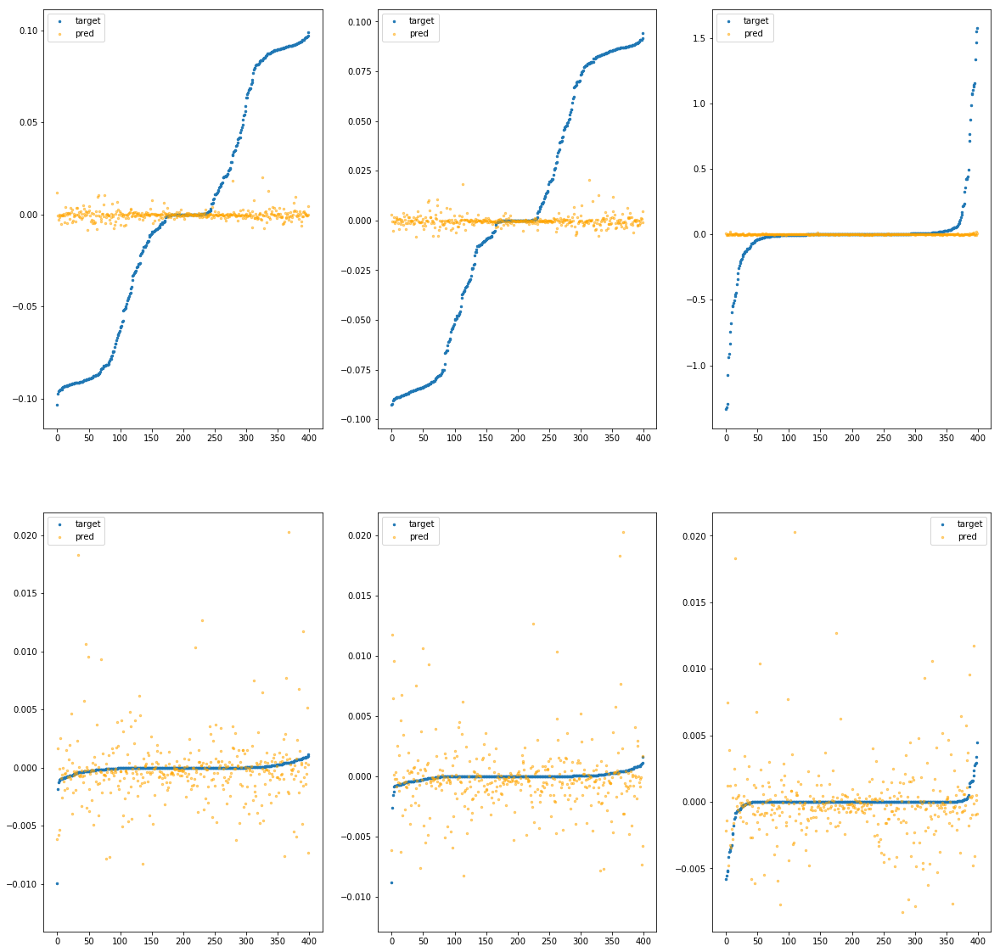

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf340>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.24e-03	1.18e-01	5.18e-02	3.64e+03	4.11e-03	1.69e-05
y		-9.87e-03	1.04e-01	5.14e-02	1.81e+02	3.87e-03	1.50e-05
z		6.52e-03	1.57e+00	1.02e-01	1.15e+02	8.28e-02	6.85e-03
phi		-5.99e+01	2.90e-02	2.64e-03	6.24e+05	2.20e-05	4.86e-10
theta		-7.14e+01	2.98e-02	2.66e-03	1.50e+05	2.24e-05	5.00e-10
psi		-2.82e+01	2.94e-02	2.66e-03	1.89e+05	2.19e-05	4.79e-10


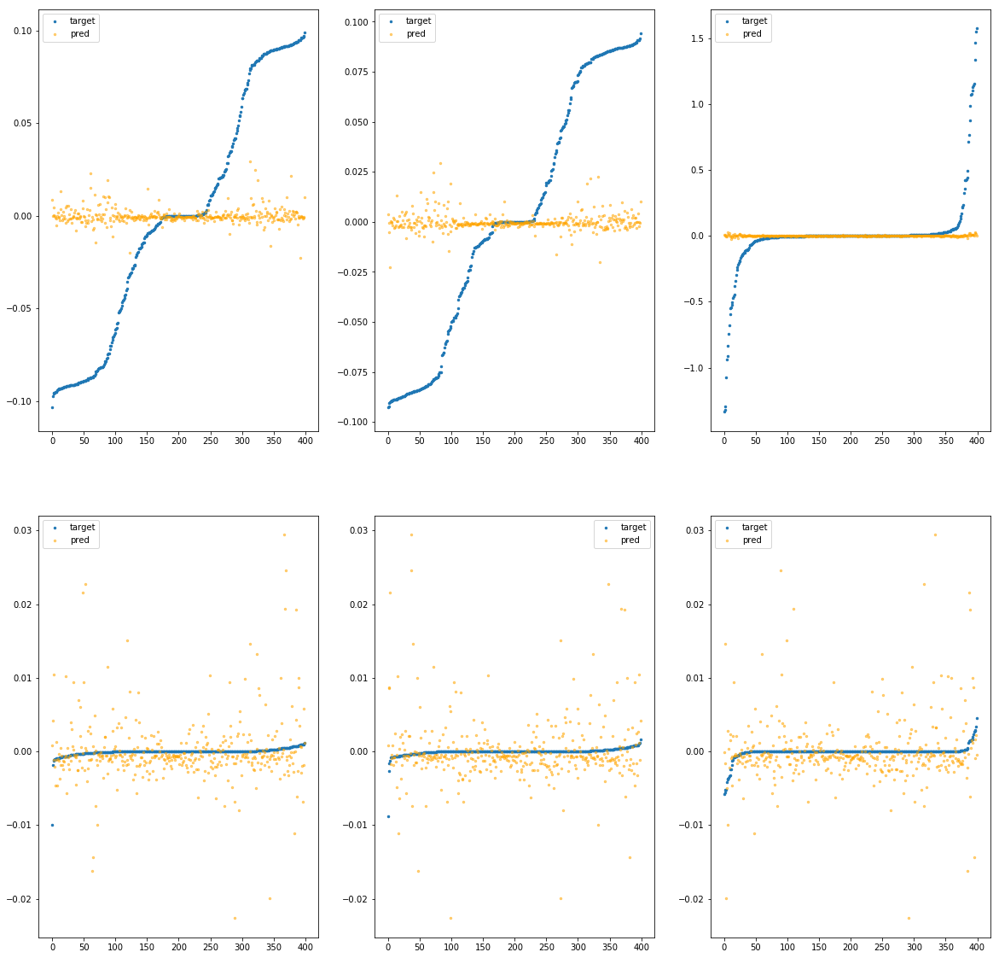

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf3a0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-02	1.23e-01	5.21e-02	2.23e+03	4.14e-03	1.71e-05
y		-7.91e-03	1.06e-01	5.13e-02	1.87e+02	3.86e-03	1.49e-05
z		-6.55e-03	1.57e+00	1.02e-01	9.33e+01	8.39e-02	7.03e-03
phi		-7.39e+01	3.48e-02	2.93e-03	4.79e+05	2.71e-05	7.35e-10
theta		-8.67e+01	3.42e-02	2.94e-03	1.79e+05	2.71e-05	7.34e-10
psi		-3.58e+01	3.43e-02	2.99e-03	1.68e+05	2.76e-05	7.61e-10


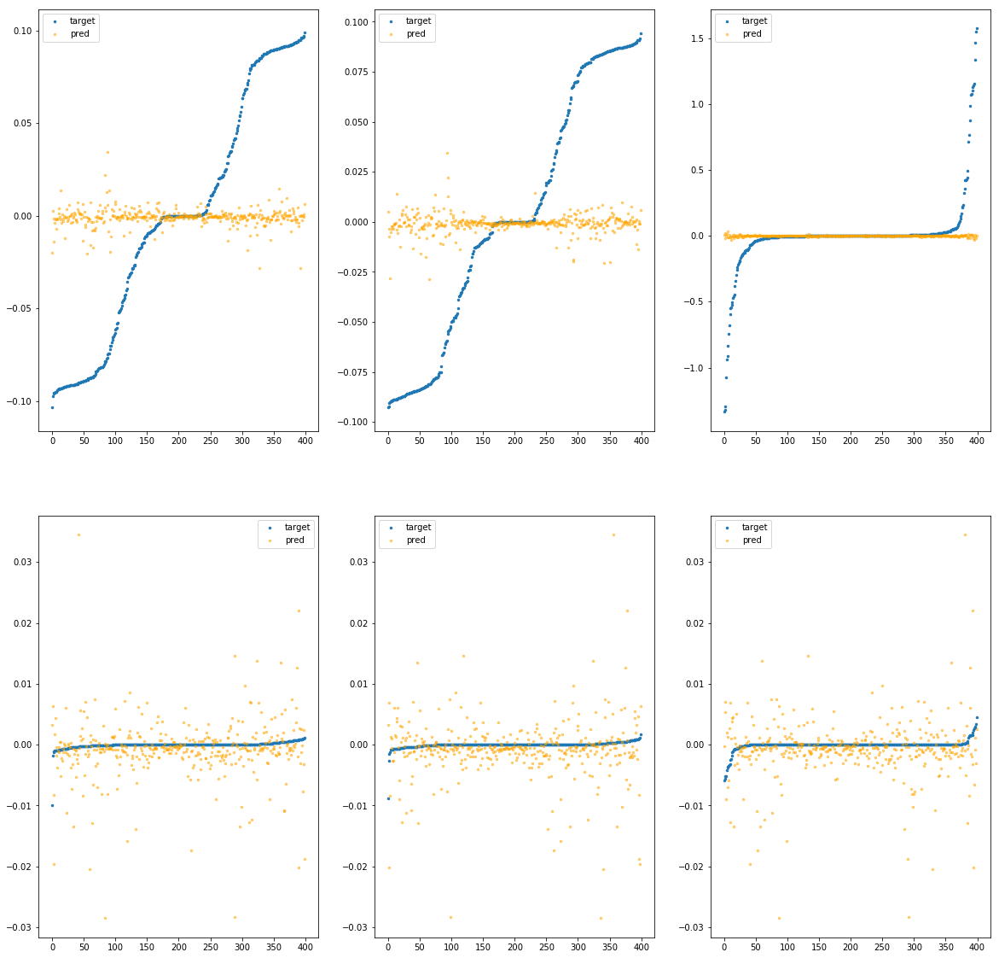

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf400>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.28e+00	2.69e-01	1.60e-01	8.18e+05	2.98e-02	8.89e-04
y		-7.05e+00	2.57e-01	1.64e-01	4.17e+04	3.09e-02	9.54e-04
z		-3.43e-01	1.73e+00	2.26e-01	1.94e+04	1.12e-01	1.25e-02
phi		-7.17e+04	1.75e-01	1.61e-01	1.37e+08	2.60e-02	6.75e-04
theta		-8.41e+04	1.76e-01	1.61e-01	3.50e+07	2.60e-02	6.75e-04
psi		-3.46e+04	1.75e-01	1.61e-01	1.97e+07	2.60e-02	6.74e-04


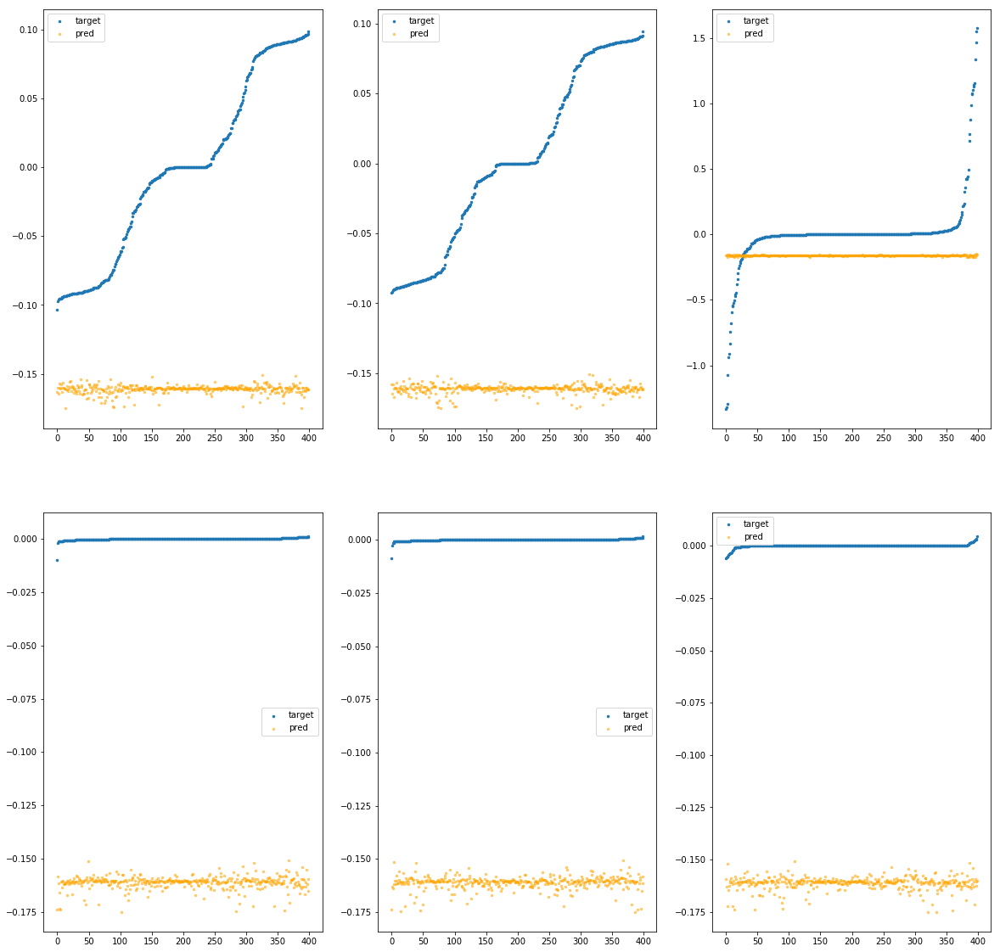

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf460>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.92e-02	1.21e-01	5.22e-02	1.23e+03	4.17e-03	1.74e-05
y		-3.07e-02	1.17e-01	5.18e-02	1.42e+02	3.95e-03	1.56e-05
z		3.14e-03	1.58e+00	1.02e-01	8.70e+01	8.31e-02	6.90e-03
phi		-5.56e+01	2.78e-02	2.45e-03	2.91e+05	2.05e-05	4.19e-10
theta		-6.70e+01	2.78e-02	2.49e-03	8.18e+04	2.10e-05	4.41e-10
psi		-2.73e+01	2.81e-02	2.48e-03	1.23e+05	2.12e-05	4.51e-10


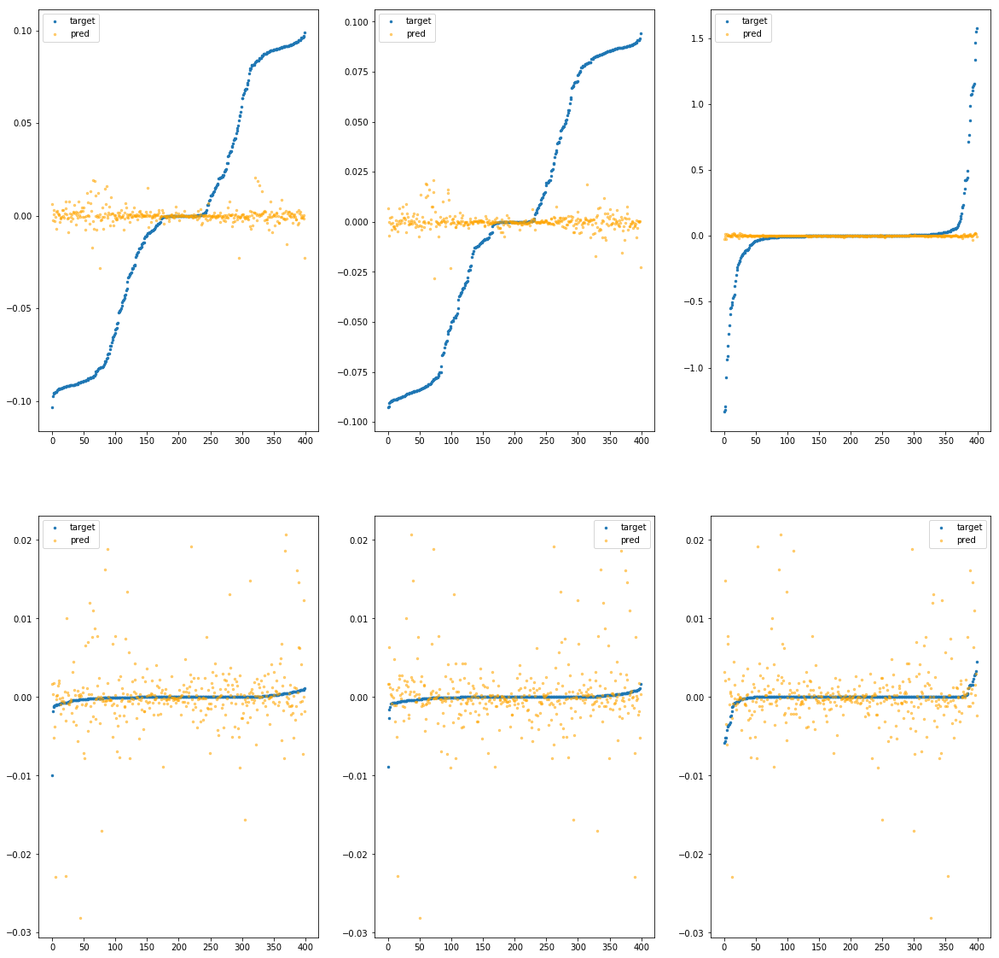

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf4c0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.09e-03	1.06e-01	5.17e-02	1.02e+03	4.10e-03	1.68e-05
y		-1.67e-02	1.01e-01	5.15e-02	3.85e+01	3.90e-03	1.52e-05
z		-2.70e-03	1.59e+00	1.02e-01	3.69e+01	8.35e-02	6.98e-03
phi		-2.63e+01	1.87e-02	1.76e-03	2.64e+05	9.88e-06	9.76e-11
theta		-3.13e+01	1.78e-02	1.76e-03	7.07e+04	9.98e-06	9.96e-11
psi		-1.19e+01	1.82e-02	1.77e-03	1.28e+05	9.71e-06	9.43e-11


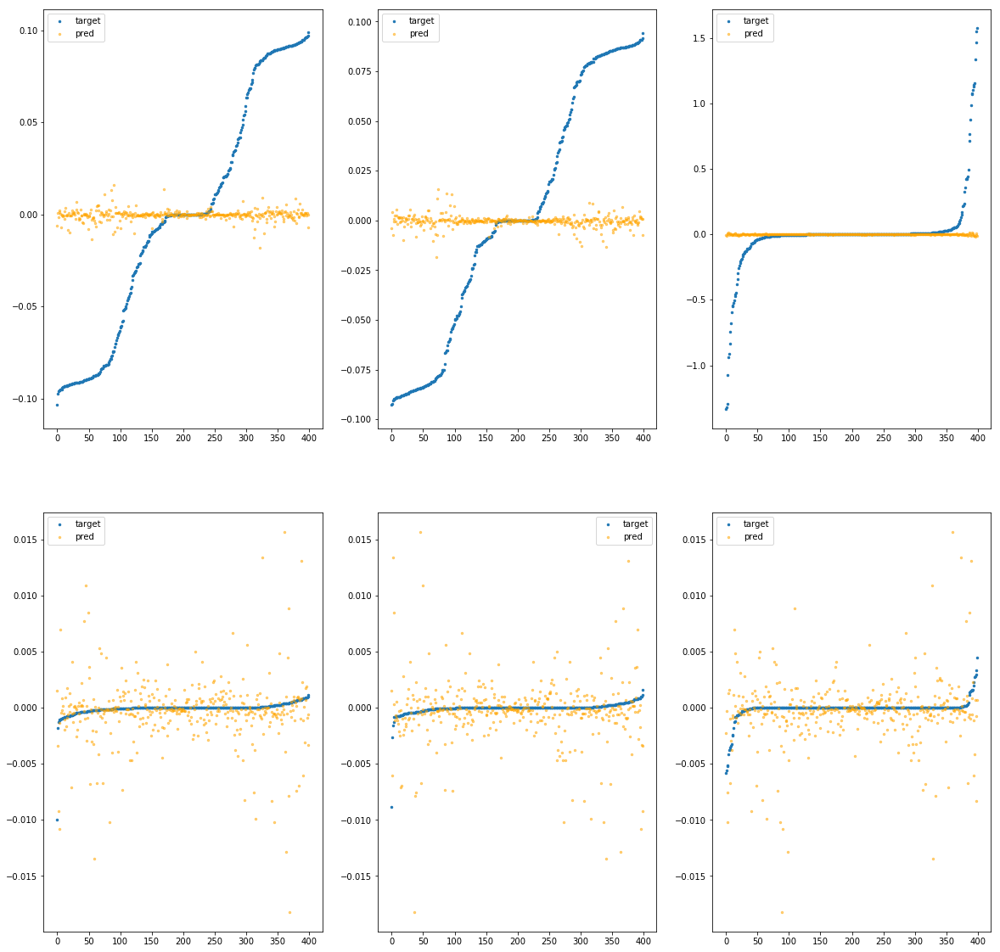

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf520>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.19e-02	1.15e-01	5.20e-02	3.62e+03	4.14e-03	1.72e-05
y		-4.73e-03	9.74e-02	5.12e-02	2.66e+02	3.85e-03	1.48e-05
z		2.63e-03	1.56e+00	1.02e-01	1.18e+02	8.31e-02	6.91e-03
phi		-3.53e+01	2.43e-02	2.12e-03	5.99e+05	1.31e-05	1.72e-10
theta		-4.10e+01	2.25e-02	2.10e-03	2.11e+05	1.30e-05	1.68e-10
psi		-1.76e+01	2.37e-02	2.20e-03	1.62e+05	1.39e-05	1.94e-10


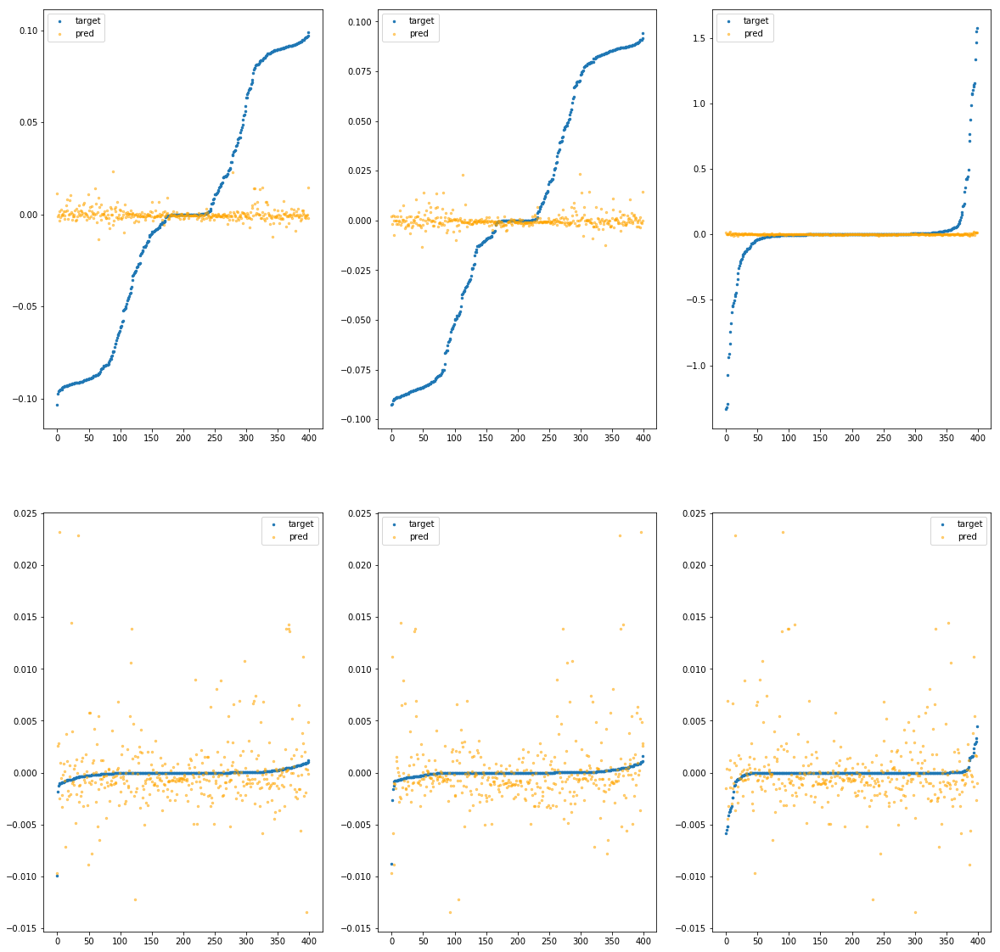

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf580>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.96e+01	4.64e-01	3.48e-01	1.77e+06	1.25e-01	1.57e-02
y		-3.09e+01	4.59e-01	3.44e-01	9.01e+04	1.22e-01	1.50e-02
z		-1.38e+00	1.68e+00	3.97e-01	4.19e+04	1.99e-01	3.94e-02
phi		-3.33e+05	3.68e-01	3.47e-01	2.96e+08	1.21e-01	1.46e-02
theta		-3.91e+05	3.68e-01	3.47e-01	7.55e+07	1.21e-01	1.46e-02
psi		-1.61e+05	3.69e-01	3.47e-01	4.25e+07	1.21e-01	1.46e-02


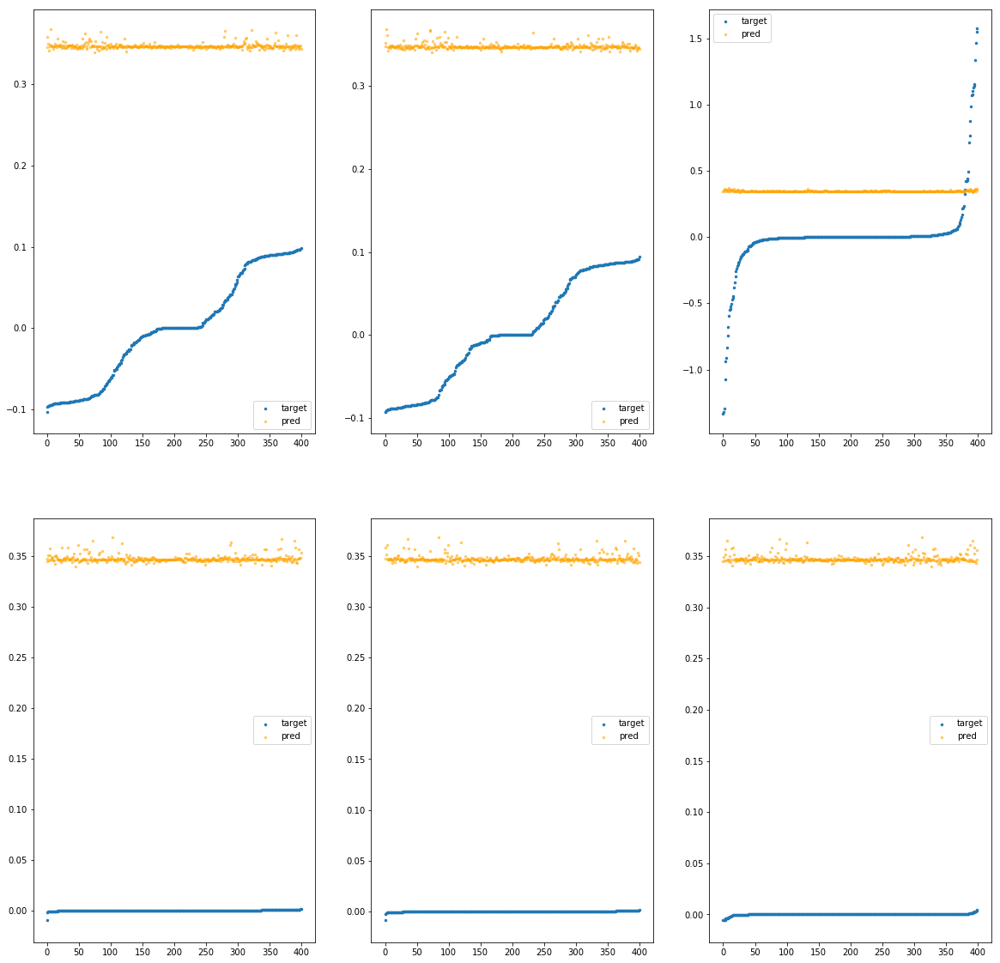

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf610>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.03e-02	1.23e-01	5.20e-02	1.09e+03	4.14e-03	1.71e-05
y		-5.85e-03	1.04e-01	5.12e-02	9.47e+01	3.86e-03	1.49e-05
z		3.20e-03	1.58e+00	1.02e-01	5.86e+01	8.31e-02	6.90e-03
phi		-2.90e+01	2.57e-02	1.83e-03	2.49e+05	1.09e-05	1.18e-10
theta		-3.41e+01	2.36e-02	1.80e-03	7.69e+04	1.08e-05	1.17e-10
psi		-1.39e+01	2.46e-02	1.86e-03	7.30e+04	1.12e-05	1.25e-10


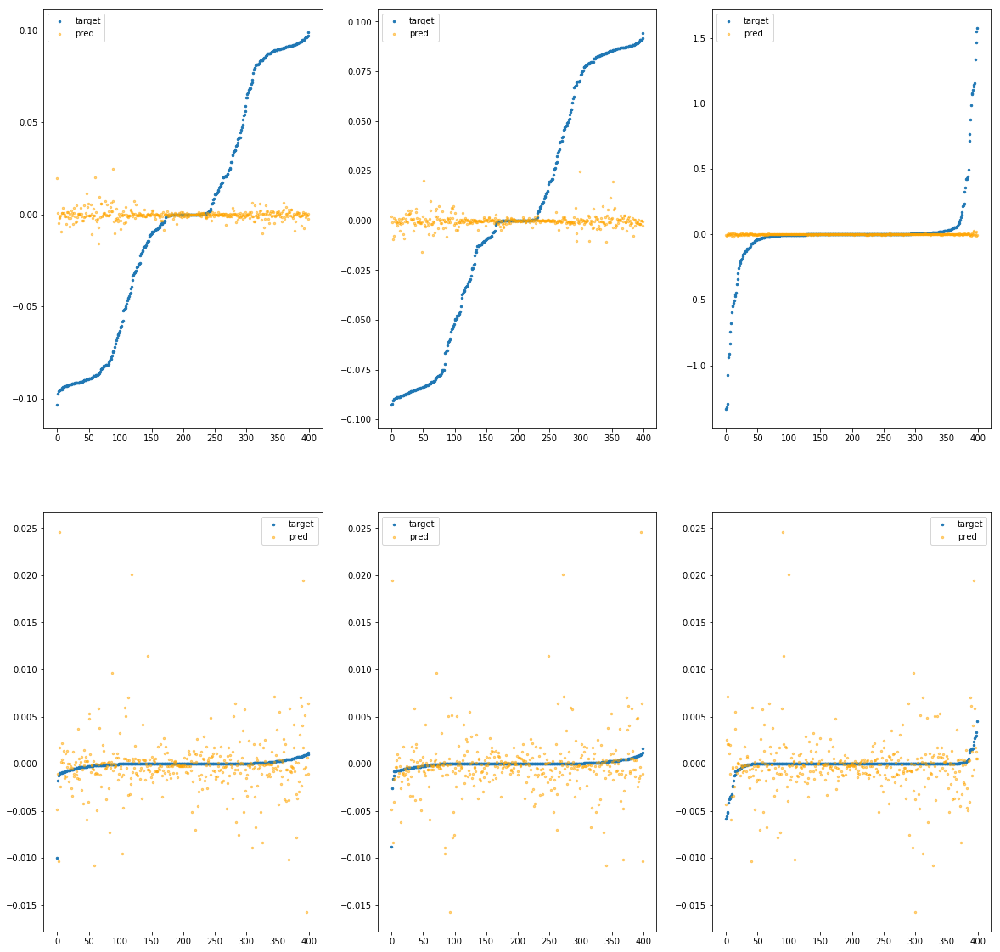

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf670>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.37e+01	3.43e-01	2.37e-01	1.21e+06	6.01e-02	3.62e-03
y		-1.51e+01	3.38e-01	2.41e-01	6.16e+04	6.18e-02	3.82e-03
z		-7.20e-01	1.81e+00	2.93e-01	2.87e+04	1.43e-01	2.05e-02
phi		-1.56e+05	2.54e-01	2.37e-01	2.03e+08	5.63e-02	3.17e-03
theta		-1.82e+05	2.54e-01	2.37e-01	5.17e+07	5.63e-02	3.17e-03
psi		-7.51e+04	2.54e-01	2.37e-01	2.91e+07	5.63e-02	3.17e-03


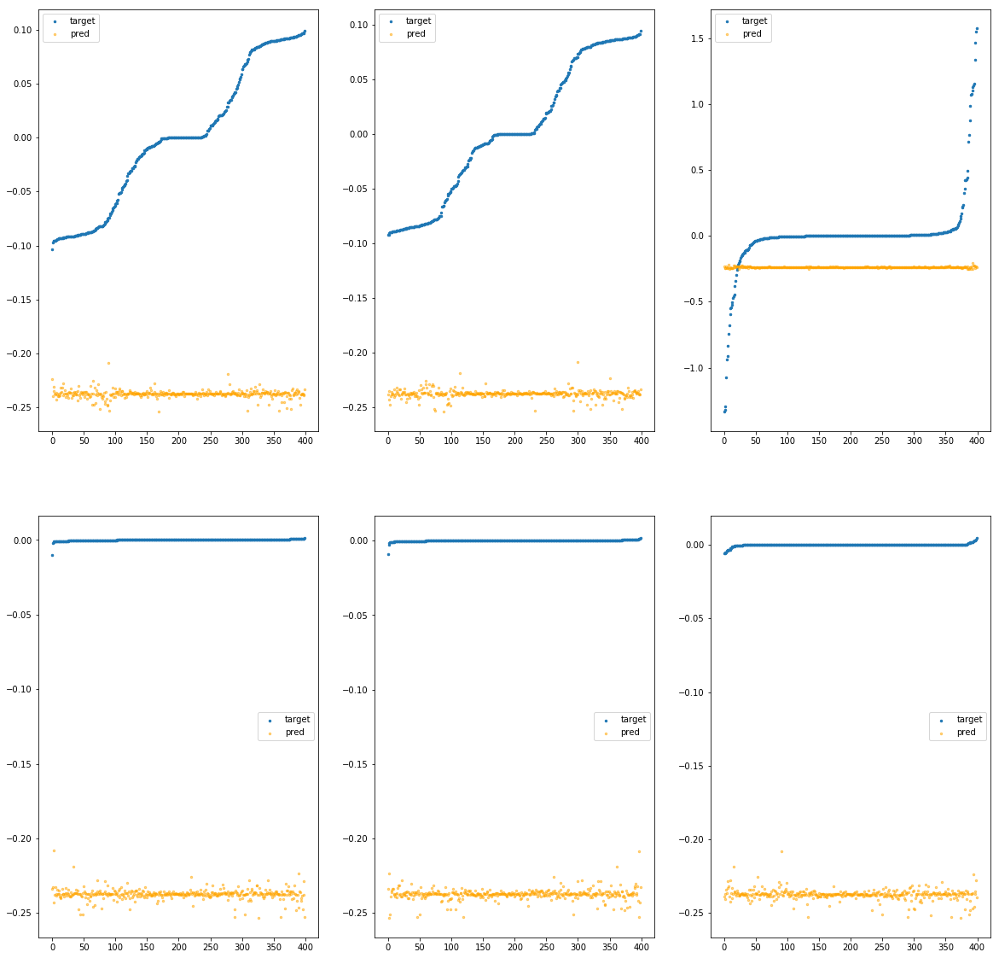

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf6d0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.00e-03	1.04e-01	5.17e-02	4.09e+03	4.08e-03	1.67e-05
y		-8.75e-03	9.81e-02	5.14e-02	1.91e+02	3.87e-03	1.50e-05
z		-3.29e-03	1.56e+00	1.02e-01	9.85e+01	8.36e-02	6.99e-03
phi		-3.04e+01	2.49e-02	2.00e-03	5.87e+05	1.14e-05	1.29e-10
theta		-3.55e+01	2.50e-02	2.00e-03	1.72e+05	1.13e-05	1.27e-10
psi		-1.50e+01	2.50e-02	2.07e-03	1.26e+05	1.20e-05	1.45e-10


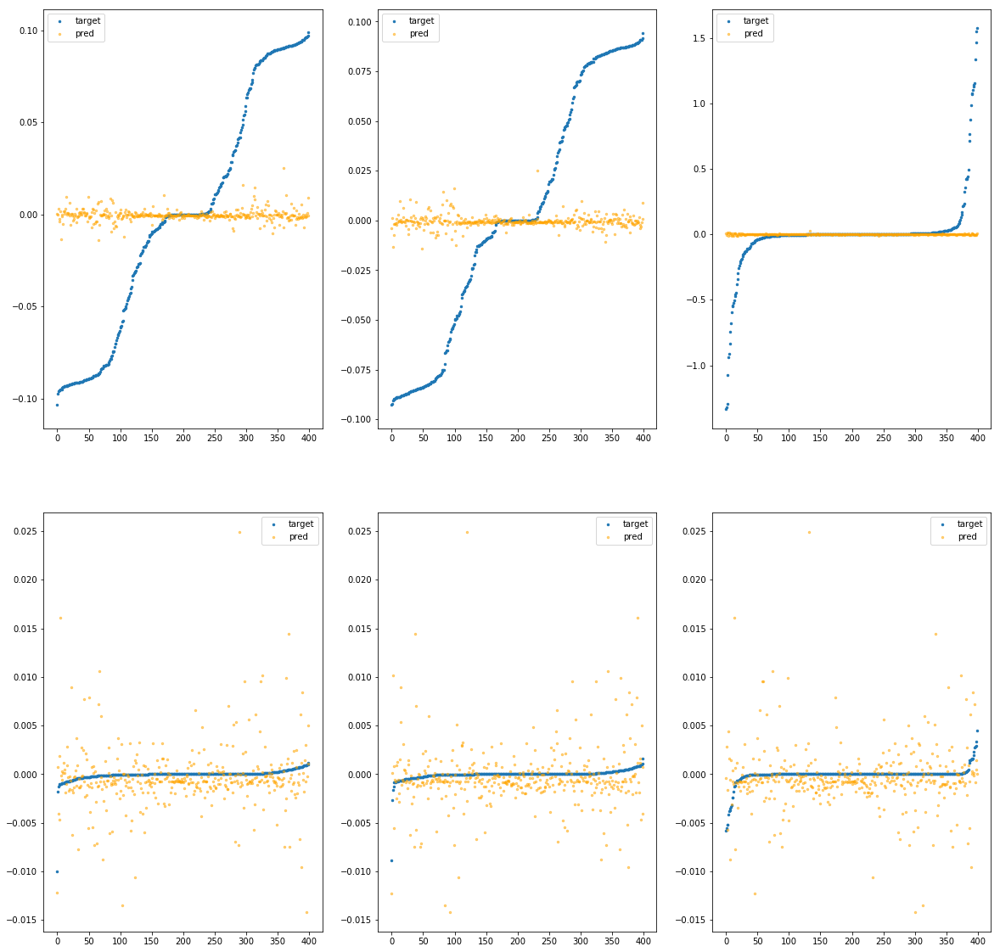

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf730>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.28e-03	1.05e-01	5.17e-02	1.18e+03	4.08e-03	1.67e-05
y		3.01e-03	9.70e-02	5.10e-02	4.37e+01	3.82e-03	1.46e-05
z		9.74e-04	1.57e+00	1.02e-01	4.29e+01	8.32e-02	6.93e-03
phi		-2.10e+01	1.74e-02	1.67e-03	1.76e+05	7.95e-06	6.33e-11
theta		-2.48e+01	1.82e-02	1.69e-03	5.08e+04	7.96e-06	6.34e-11
psi		-1.05e+01	2.03e-02	1.76e-03	1.30e+05	8.61e-06	7.42e-11


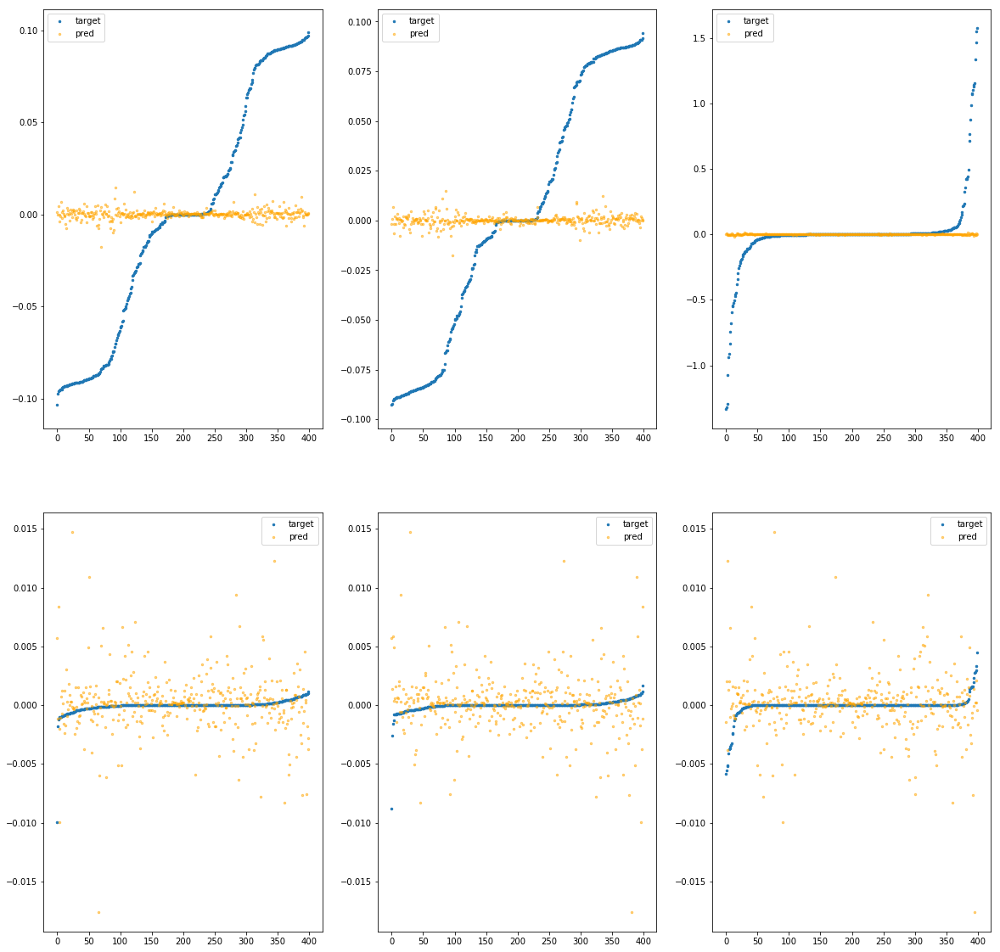

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf790>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.94e-03	1.10e-01	5.19e-02	1.18e+03	4.11e-03	1.69e-05
y		-9.12e-03	9.95e-02	5.14e-02	6.23e+01	3.87e-03	1.50e-05
z		1.17e-04	1.58e+00	1.02e-01	6.75e+01	8.33e-02	6.94e-03
phi		-3.44e+01	1.62e-02	2.11e-03	2.97e+05	1.28e-05	1.64e-10
theta		-4.11e+01	1.77e-02	2.08e-03	6.58e+04	1.30e-05	1.69e-10
psi		-1.65e+01	1.59e-02	2.12e-03	7.85e+04	1.31e-05	1.72e-10


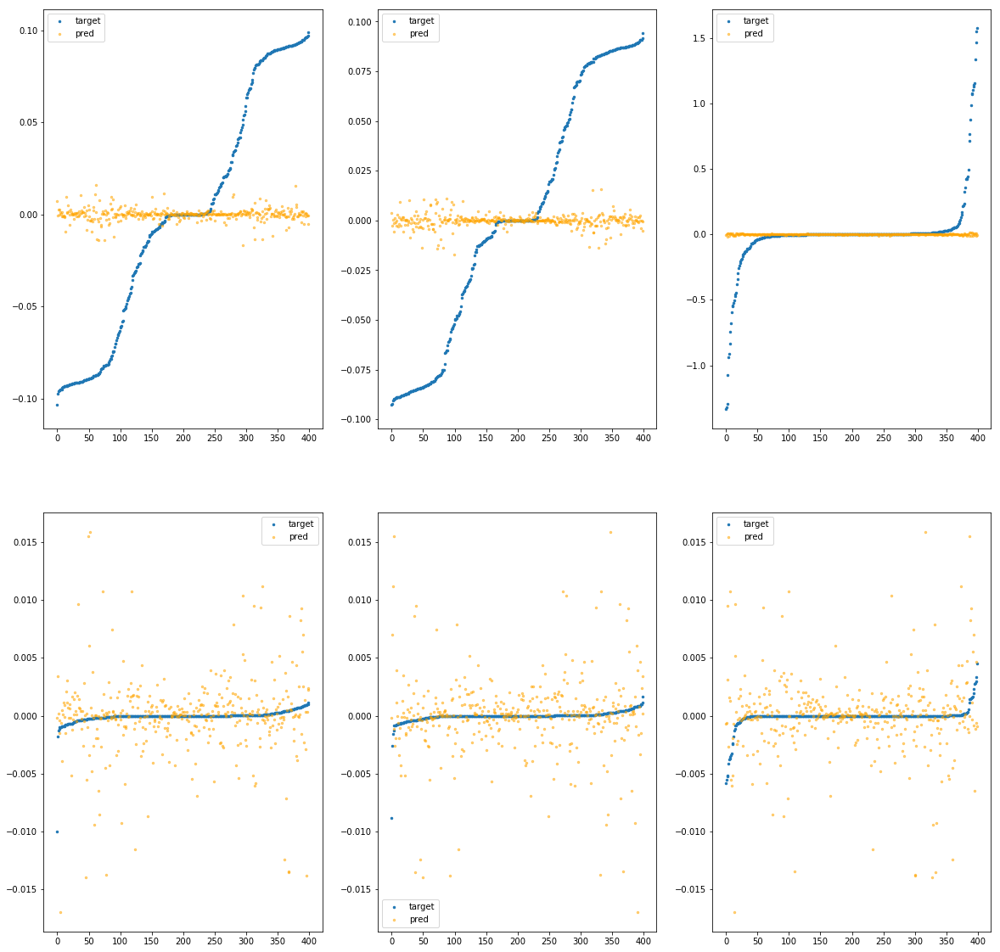

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf7f0>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.04e-01	1.48e-01	5.92e-02	1.47e+05	4.93e-03	2.43e-05
y		-2.84e-01	1.43e-01	5.93e-02	7.47e+03	4.92e-03	2.42e-05
z		-1.97e-02	1.61e+00	1.19e-01	3.49e+03	8.50e-02	7.22e-03
phi		-2.45e+03	5.06e-02	2.95e-02	2.46e+07	8.89e-04	7.89e-07
theta		-2.88e+03	5.07e-02	2.96e-02	6.29e+06	8.90e-04	7.91e-07
psi		-1.18e+03	5.09e-02	2.95e-02	3.54e+06	8.87e-04	7.87e-07


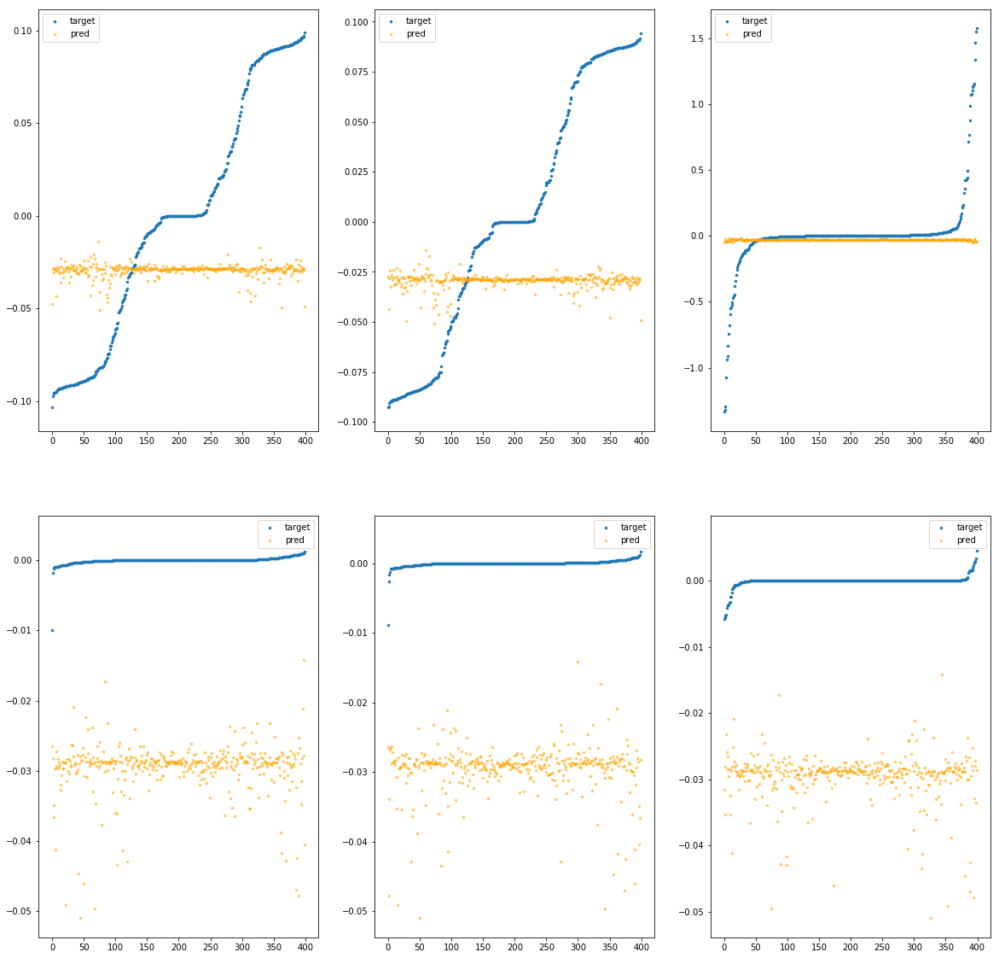

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf850>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.17e-02	1.06e-01	5.14e-02	1.09e+03	4.05e-03	1.64e-05
y		1.66e-02	9.75e-02	5.06e-02	6.61e+01	3.77e-03	1.42e-05
z		-5.53e-03	1.57e+00	1.02e-01	5.28e+01	8.38e-02	7.02e-03
phi		-4.29e+01	2.54e-02	1.95e-03	1.98e+05	1.59e-05	2.53e-10
theta		-4.96e+01	2.65e-02	1.93e-03	6.46e+04	1.56e-05	2.44e-10
psi		-2.13e+01	2.57e-02	2.03e-03	1.49e+05	1.67e-05	2.80e-10


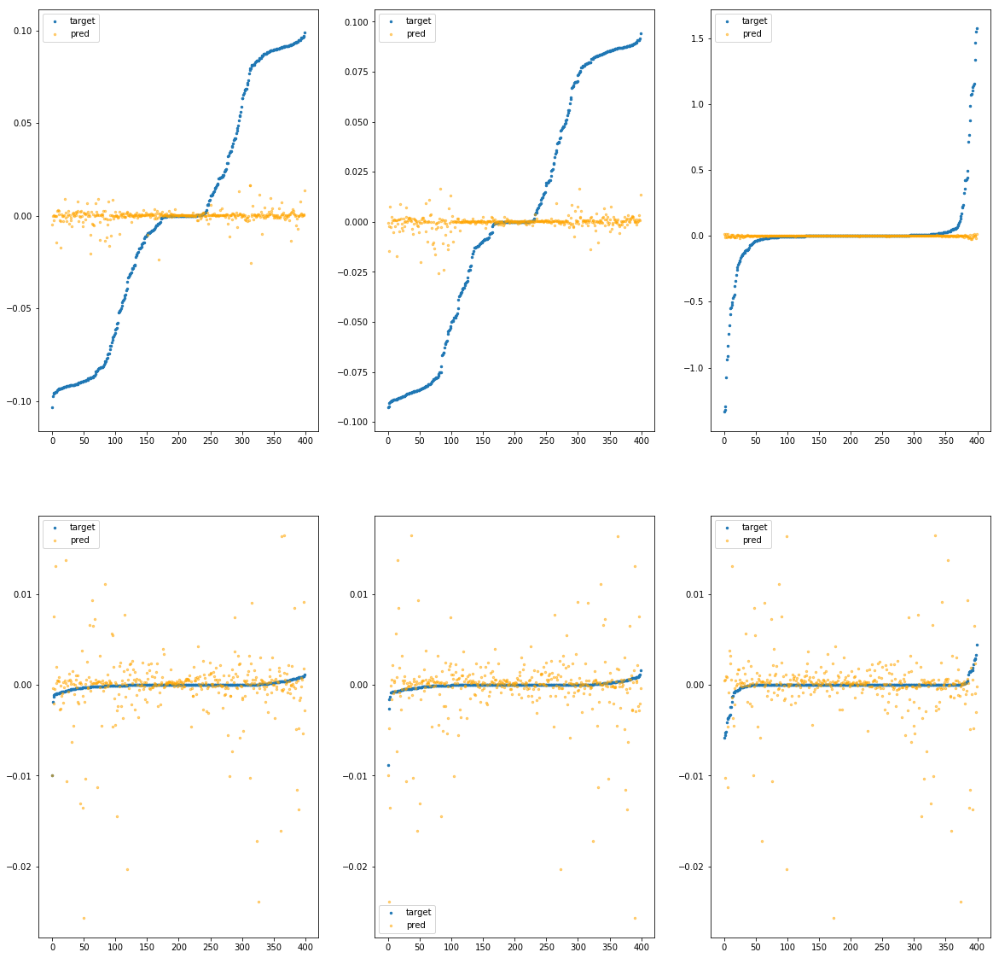

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbf8b0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.50e-03	1.04e-01	5.17e-02	1.30e+03	4.09e-03	1.67e-05
y		5.54e-03	9.56e-02	5.10e-02	5.88e+01	3.81e-03	1.45e-05
z		-1.80e-03	1.56e+00	1.02e-01	5.73e+01	8.35e-02	6.97e-03
phi		-2.17e+01	2.30e-02	1.63e-03	2.45e+05	8.22e-06	6.76e-11
theta		-2.40e+01	2.33e-02	1.58e-03	6.49e+04	7.73e-06	5.98e-11
psi		-1.07e+01	2.22e-02	1.70e-03	1.28e+05	8.79e-06	7.72e-11


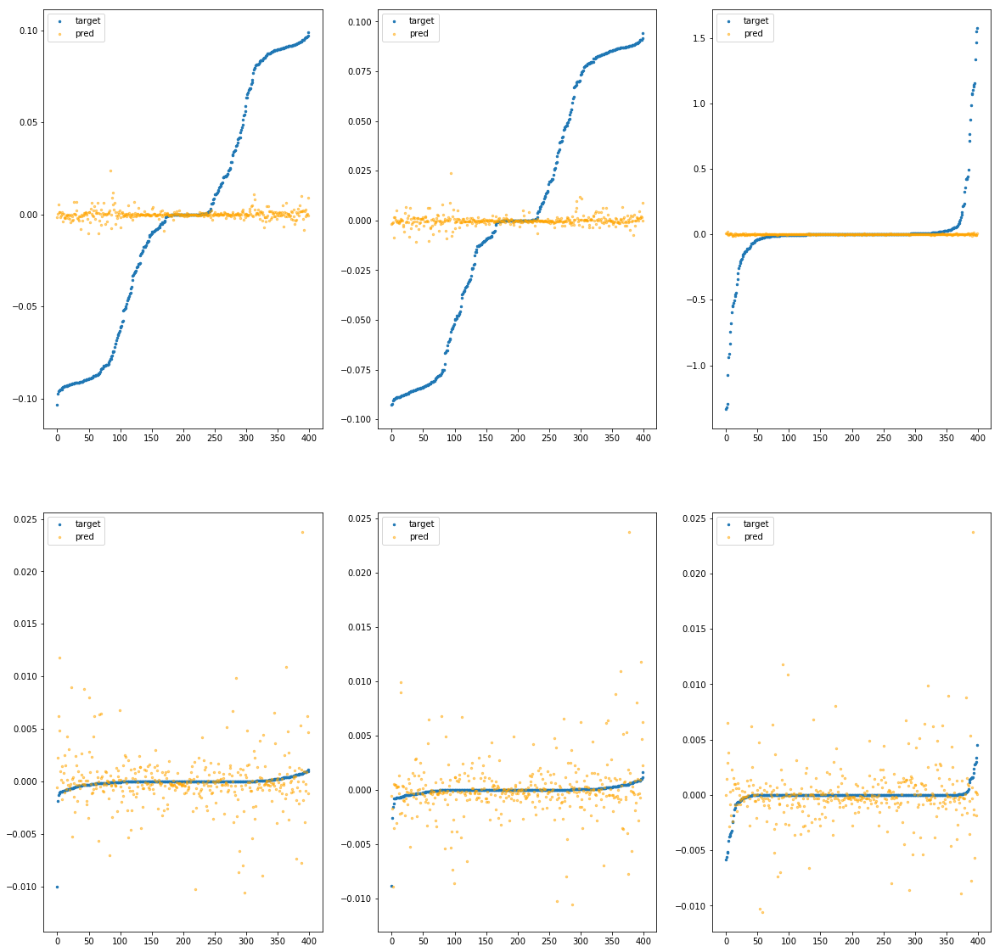

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbf910>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.38e-03	1.08e-01	5.18e-02	1.25e+03	4.10e-03	1.68e-05
y		-5.32e-03	9.76e-02	5.13e-02	1.01e+02	3.85e-03	1.49e-05
z		-5.65e-03	1.58e+00	1.02e-01	6.32e+01	8.38e-02	7.02e-03
phi		-3.21e+01	2.40e-02	1.98e-03	2.15e+05	1.20e-05	1.44e-10
theta		-3.76e+01	2.22e-02	1.98e-03	7.64e+04	1.19e-05	1.42e-10
psi		-1.44e+01	2.43e-02	1.96e-03	1.45e+05	1.15e-05	1.33e-10


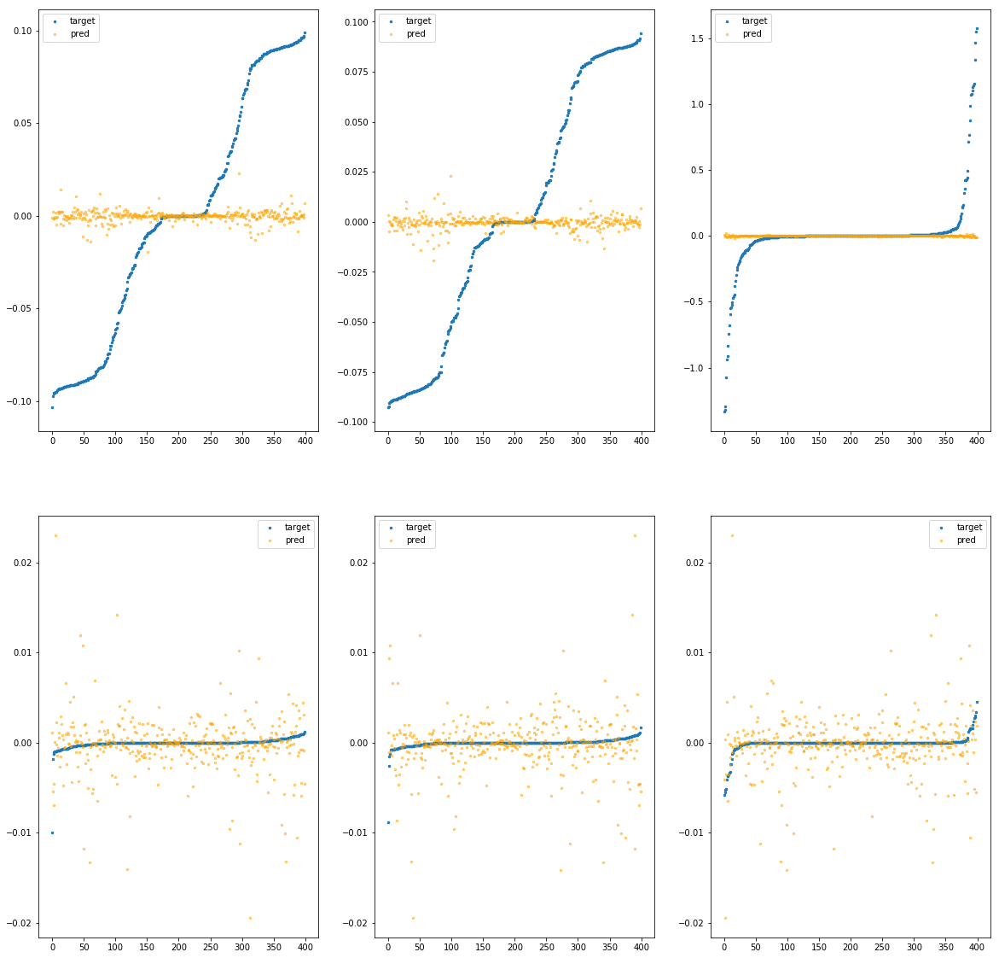

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbf970>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		8.20e-03	1.04e-01	5.15e-02	1.00e+03	4.06e-03	1.65e-05
y		4.19e-03	9.59e-02	5.11e-02	4.48e+01	3.82e-03	1.46e-05
z		1.05e-03	1.57e+00	1.02e-01	4.56e+01	8.32e-02	6.93e-03
phi		-2.71e+01	1.80e-02	1.79e-03	1.99e+05	1.02e-05	1.03e-10
theta		-3.27e+01	1.81e-02	1.82e-03	5.81e+04	1.04e-05	1.08e-10
psi		-1.25e+01	1.82e-02	1.84e-03	1.13e+05	1.02e-05	1.03e-10


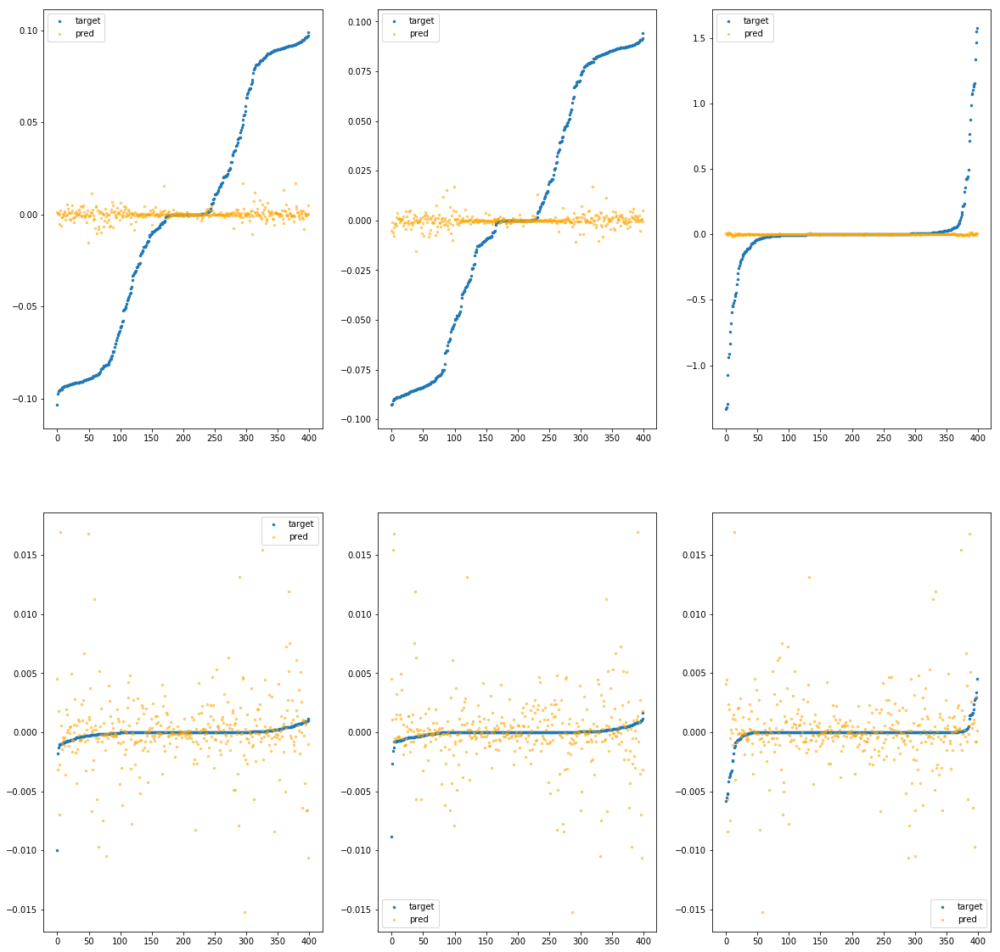

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbf9d0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		6.53e-04	1.17e-01	5.18e-02	3.31e+03	4.09e-03	1.67e-05
y		6.46e-04	1.10e-01	5.11e-02	2.14e+02	3.83e-03	1.47e-05
z		-3.87e-03	1.58e+00	1.02e-01	1.10e+02	8.36e-02	7.00e-03
phi		-6.01e+01	2.98e-02	2.52e-03	6.21e+05	2.21e-05	4.90e-10
theta		-7.07e+01	2.99e-02	2.56e-03	1.66e+05	2.21e-05	4.90e-10
psi		-2.91e+01	3.01e-02	2.56e-03	1.77e+05	2.26e-05	5.10e-10


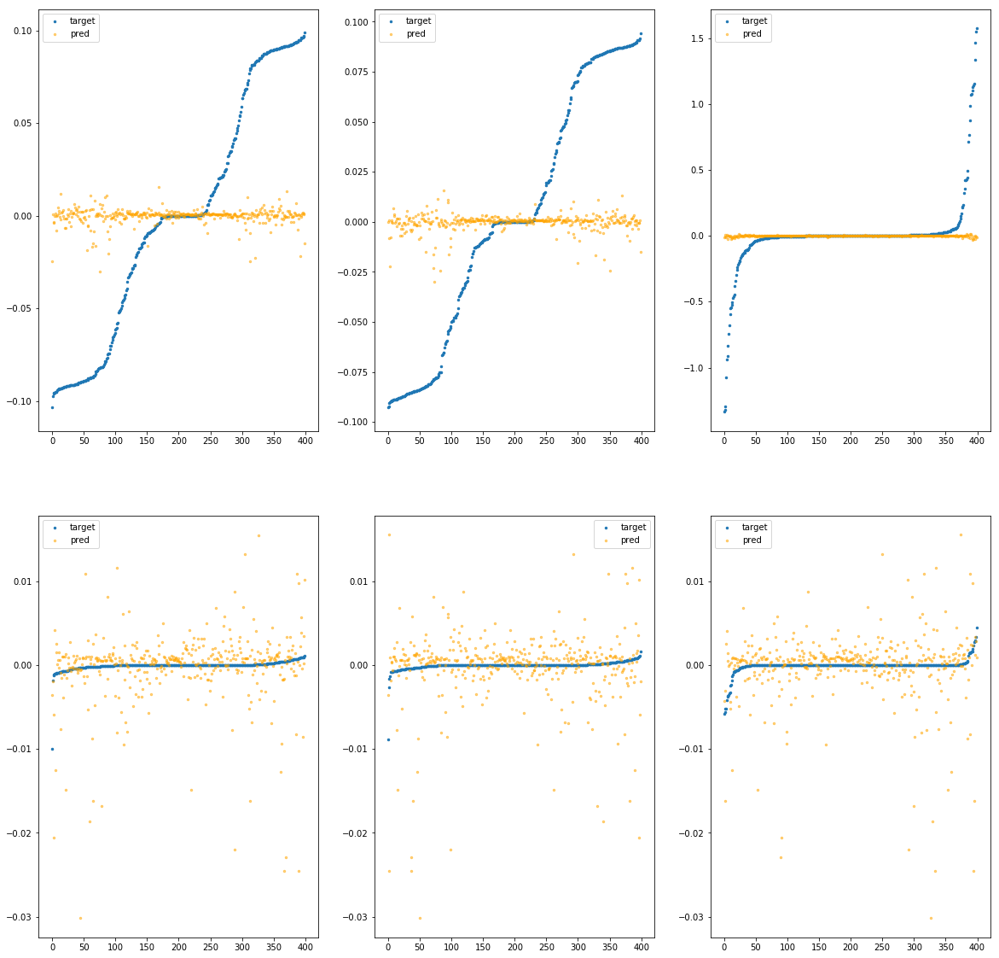

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbfa30>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.84e-02	1.20e-01	5.36e-02	4.23e+04	4.21e-03	1.77e-05
y		-1.62e-03	1.16e-01	5.23e-02	2.11e+03	3.84e-03	1.47e-05
z		1.97e-03	1.55e+00	1.05e-01	9.92e+02	8.32e-02	6.91e-03
phi		-2.62e+02	4.44e-02	8.95e-03	7.09e+06	9.52e-05	9.06e-09
theta		-3.05e+02	4.26e-02	8.93e-03	1.78e+06	9.44e-05	8.92e-09
psi		-1.27e+02	4.47e-02	8.98e-03	1.16e+06	9.62e-05	9.26e-09


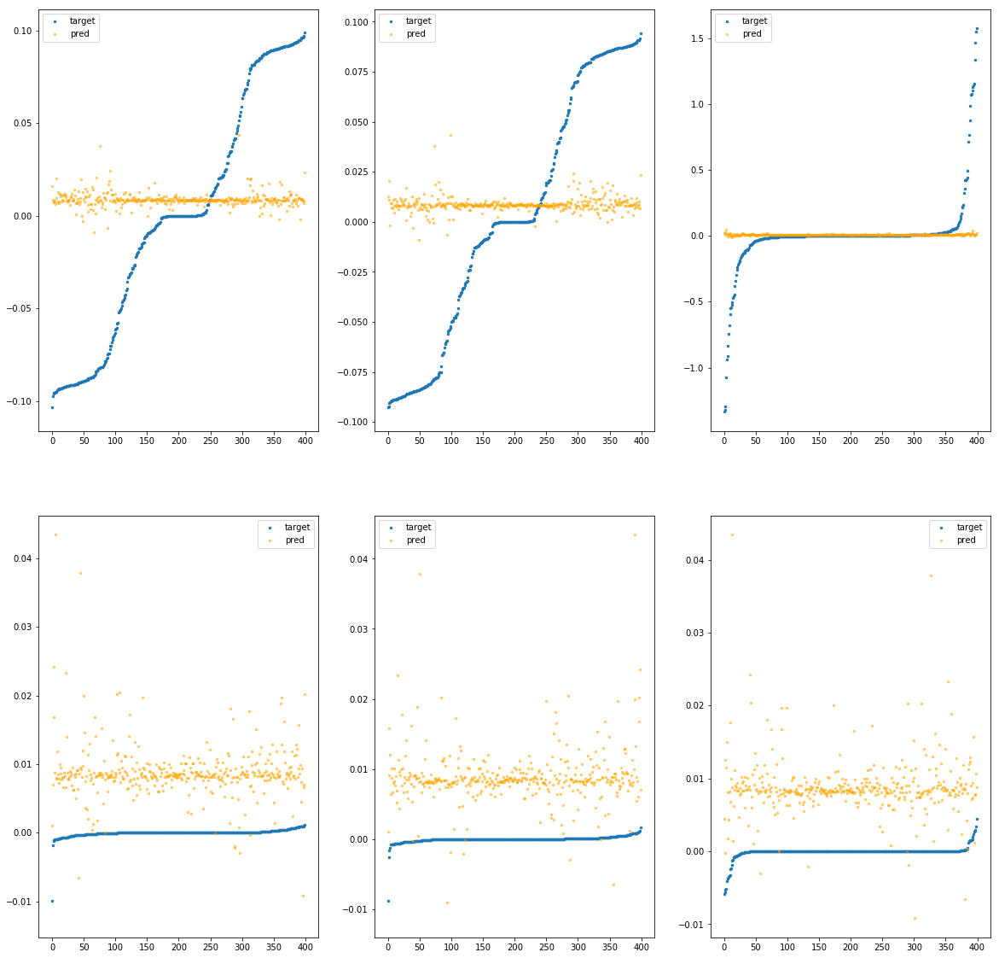

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbfa90>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.68e-03	1.09e-01	5.20e-02	1.25e+03	4.13e-03	1.71e-05
y		-3.46e-03	9.43e-02	5.13e-02	9.03e+01	3.85e-03	1.48e-05
z		-1.42e-03	1.57e+00	1.02e-01	6.47e+01	8.34e-02	6.96e-03
phi		-2.99e+01	2.09e-02	2.01e-03	3.33e+05	1.12e-05	1.25e-10
theta		-3.39e+01	2.05e-02	1.97e-03	6.32e+04	1.08e-05	1.16e-10
psi		-1.39e+01	2.07e-02	2.04e-03	1.45e+05	1.12e-05	1.25e-10


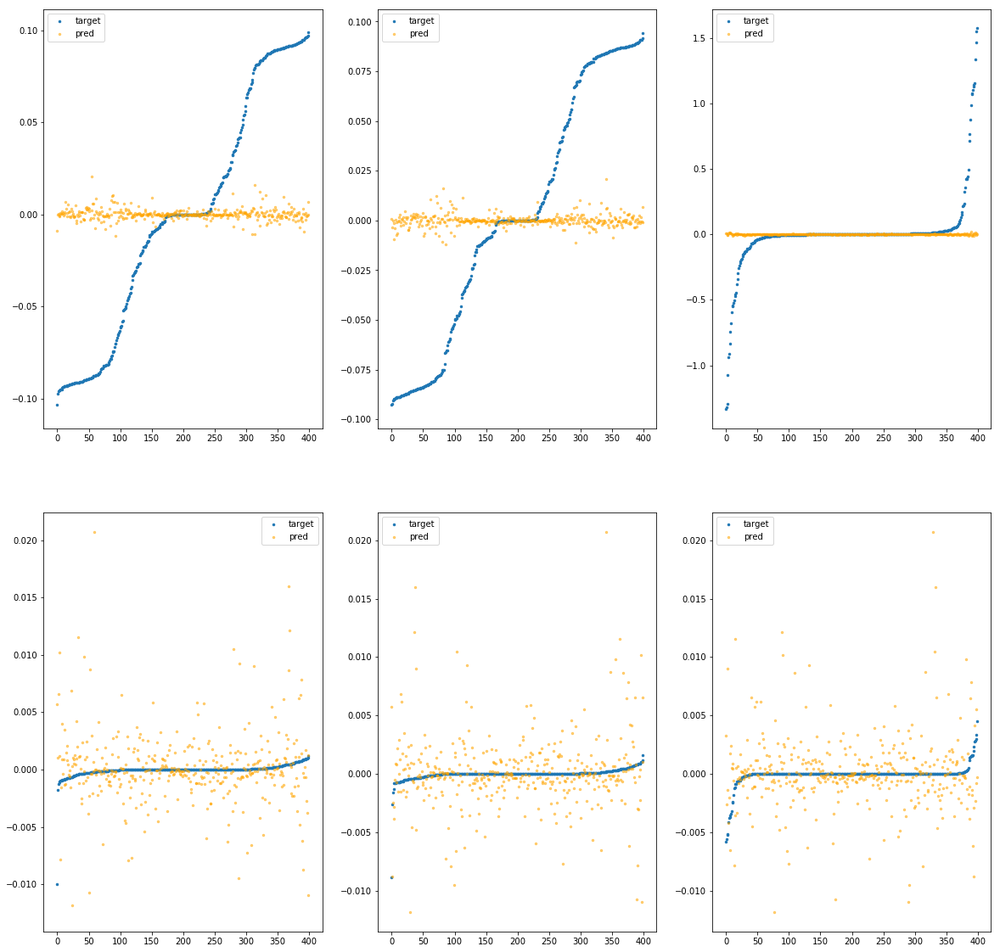

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbfaf0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		2.83e-03	1.10e-01	5.16e-02	1.36e+03	4.08e-03	1.67e-05
y		-9.41e-03	1.05e-01	5.12e-02	1.21e+02	3.87e-03	1.50e-05
z		1.92e-03	1.56e+00	1.02e-01	5.49e+01	8.32e-02	6.92e-03
phi		-3.86e+01	2.28e-02	2.07e-03	1.53e+05	1.44e-05	2.06e-10
theta		-4.52e+01	2.26e-02	2.06e-03	9.97e+04	1.43e-05	2.04e-10
psi		-1.90e+01	2.37e-02	2.10e-03	1.42e+05	1.50e-05	2.26e-10


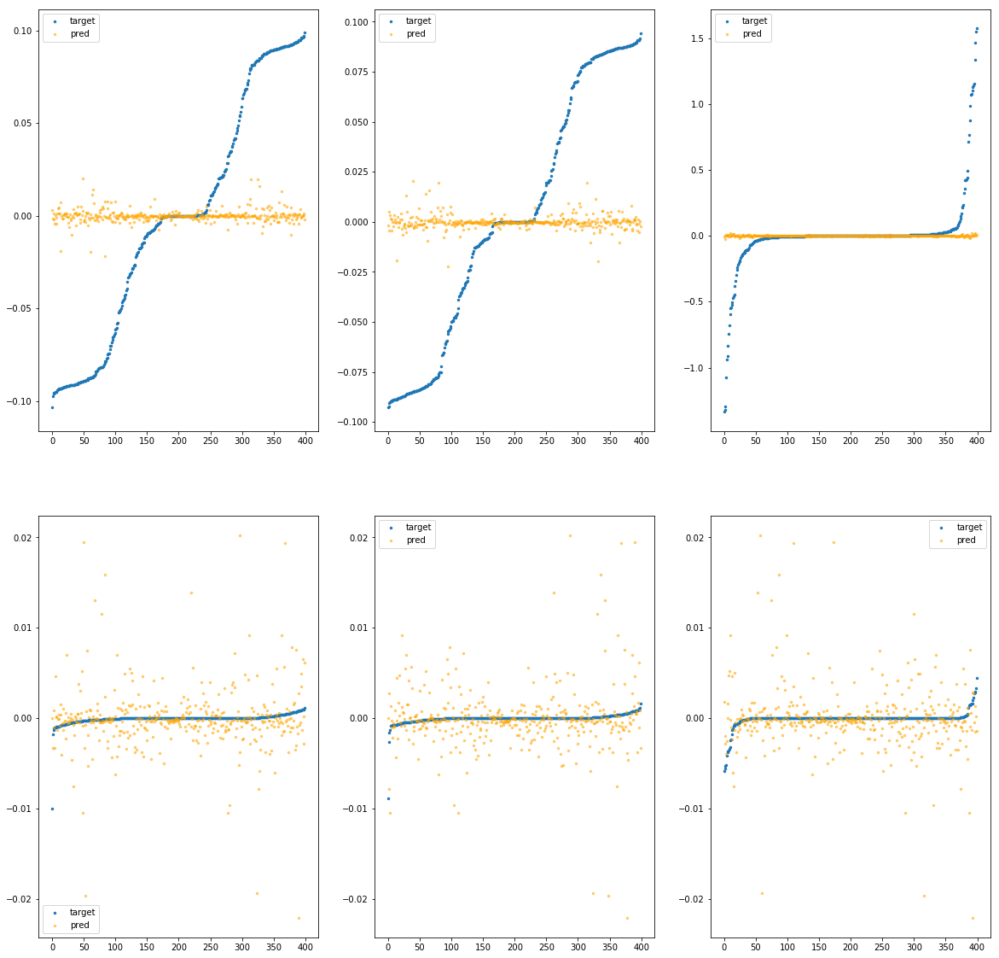

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbfb50>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.41e-02	1.08e-01	5.20e-02	6.98e+02	4.15e-03	1.72e-05
y		-9.23e-03	1.01e-01	5.13e-02	3.28e+01	3.87e-03	1.50e-05
z		2.87e-03	1.58e+00	1.02e-01	3.53e+01	8.31e-02	6.90e-03
phi		-3.21e+01	2.00e-02	1.87e-03	1.19e+05	1.20e-05	1.43e-10
theta		-3.82e+01	1.95e-02	1.88e-03	3.63e+04	1.21e-05	1.47e-10
psi		-1.54e+01	2.04e-02	1.91e-03	1.76e+05	1.23e-05	1.52e-10


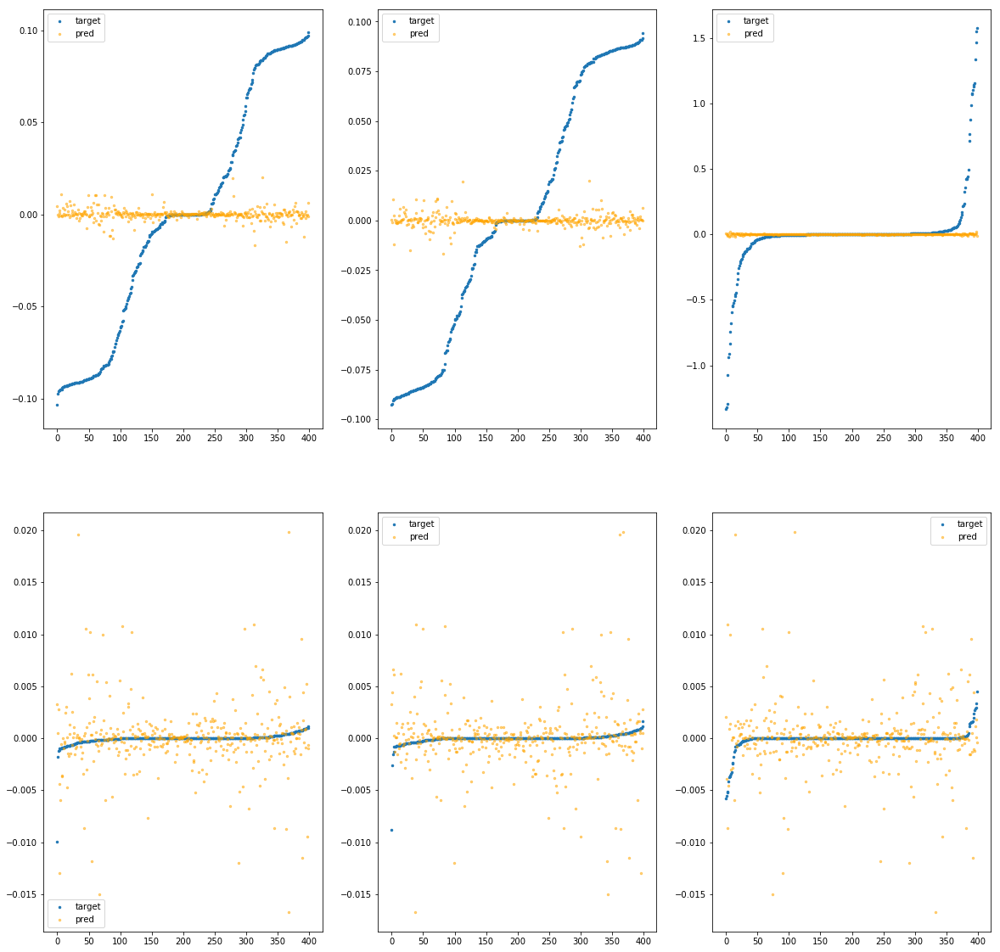

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbfbb0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.43e-03	1.22e-01	5.18e-02	2.09e+03	4.13e-03	1.70e-05
y		-1.82e-02	1.06e-01	5.15e-02	1.18e+02	3.90e-03	1.52e-05
z		2.88e-03	1.56e+00	1.02e-01	7.68e+01	8.31e-02	6.90e-03
phi		-5.92e+01	2.89e-02	2.60e-03	5.04e+05	2.18e-05	4.75e-10
theta		-7.02e+01	2.89e-02	2.59e-03	8.85e+04	2.20e-05	4.83e-10
psi		-2.81e+01	2.89e-02	2.60e-03	1.75e+05	2.18e-05	4.75e-10


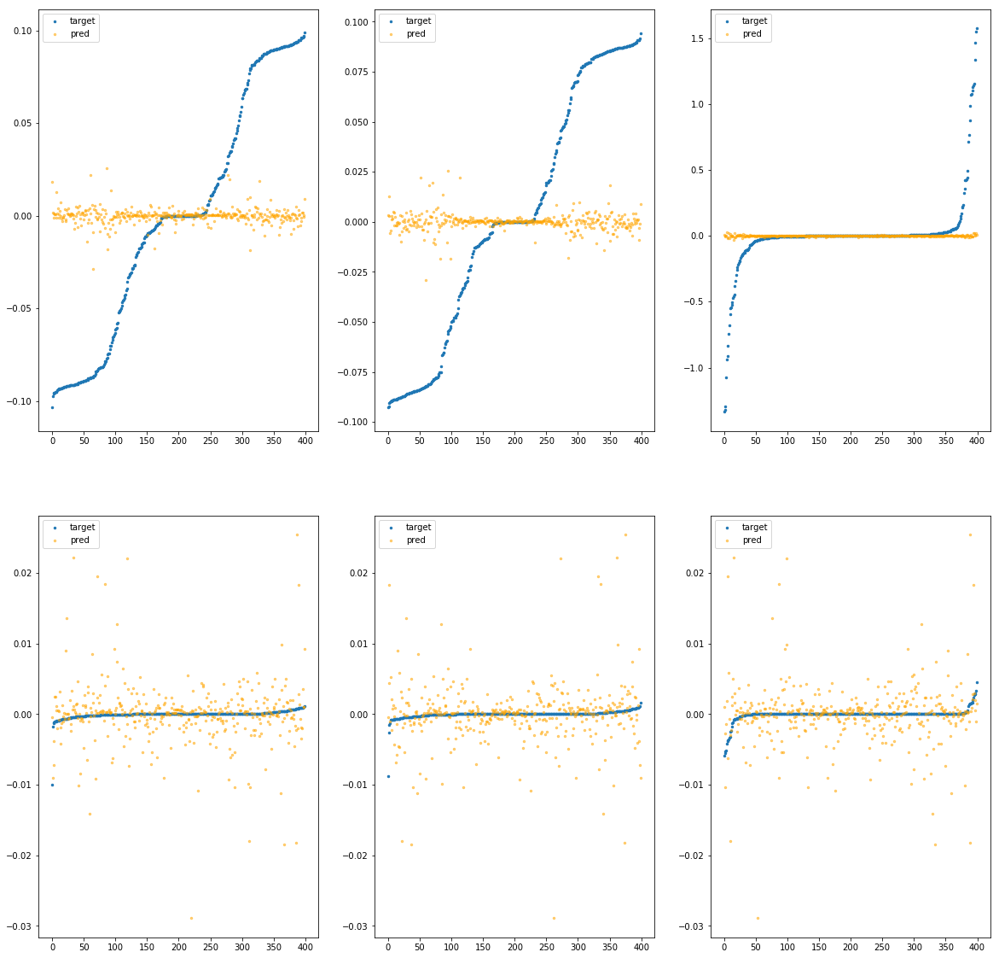

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbfc10>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		5.36e-03	1.02e-01	5.16e-02	1.97e+03	4.07e-03	1.66e-05
y		-5.06e-03	9.86e-02	5.12e-02	1.45e+02	3.85e-03	1.49e-05
z		1.88e-04	1.57e+00	1.02e-01	7.33e+01	8.33e-02	6.94e-03
phi		-2.32e+01	1.68e-02	1.80e-03	4.42e+05	8.76e-06	7.68e-11
theta		-2.77e+01	1.71e-02	1.80e-03	1.35e+05	8.87e-06	7.87e-11
psi		-1.18e+01	1.68e-02	1.90e-03	1.65e+05	9.61e-06	9.23e-11


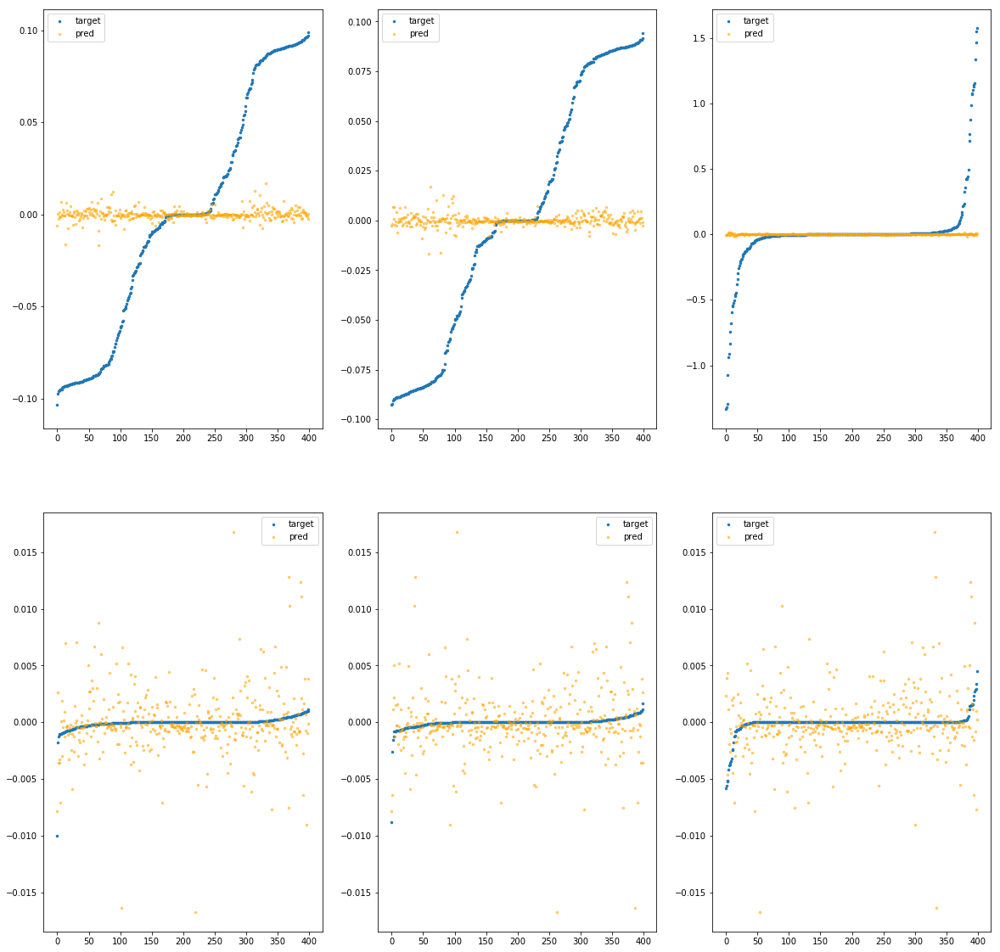

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbfc70>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.02e-02	1.19e-01	5.20e-02	1.42e+03	4.14e-03	1.71e-05
y		-7.00e-03	1.10e-01	5.12e-02	6.57e+01	3.86e-03	1.49e-05
z		1.84e-03	1.57e+00	1.02e-01	4.41e+01	8.32e-02	6.92e-03
phi		-4.56e+01	2.75e-02	2.30e-03	2.48e+05	1.69e-05	2.85e-10
theta		-5.37e+01	2.79e-02	2.33e-03	8.51e+04	1.69e-05	2.85e-10
psi		-2.19e+01	2.77e-02	2.36e-03	1.86e+05	1.71e-05	2.94e-10


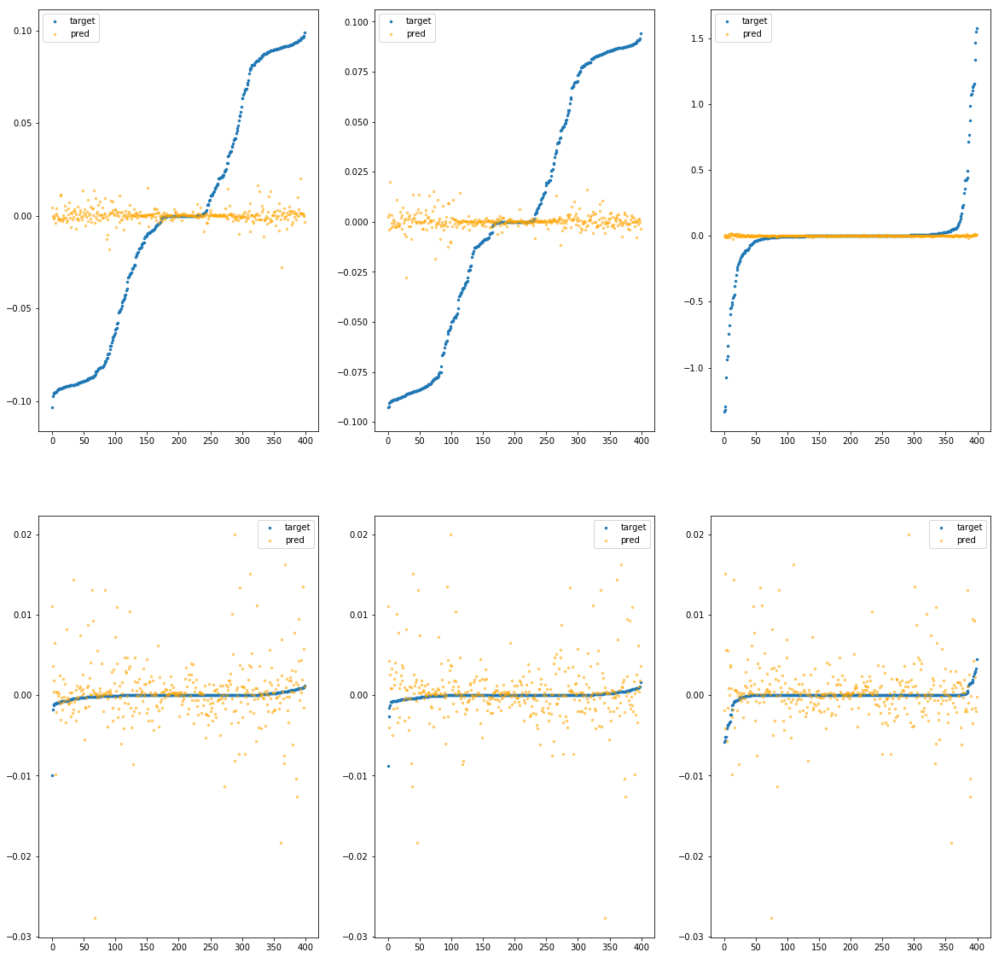

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbfcd0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.10e-03	1.03e-01	5.19e-02	1.74e+03	4.11e-03	1.69e-05
y		4.31e-03	9.87e-02	5.10e-02	5.20e+01	3.82e-03	1.46e-05
z		-1.18e-03	1.57e+00	1.02e-01	4.60e+01	8.34e-02	6.96e-03
phi		-4.88e+01	2.64e-02	2.55e-03	3.55e+05	1.80e-05	3.25e-10
theta		-5.75e+01	2.64e-02	2.55e-03	1.06e+05	1.81e-05	3.26e-10
psi		-2.36e+01	2.64e-02	2.62e-03	1.00e+05	1.84e-05	3.40e-10


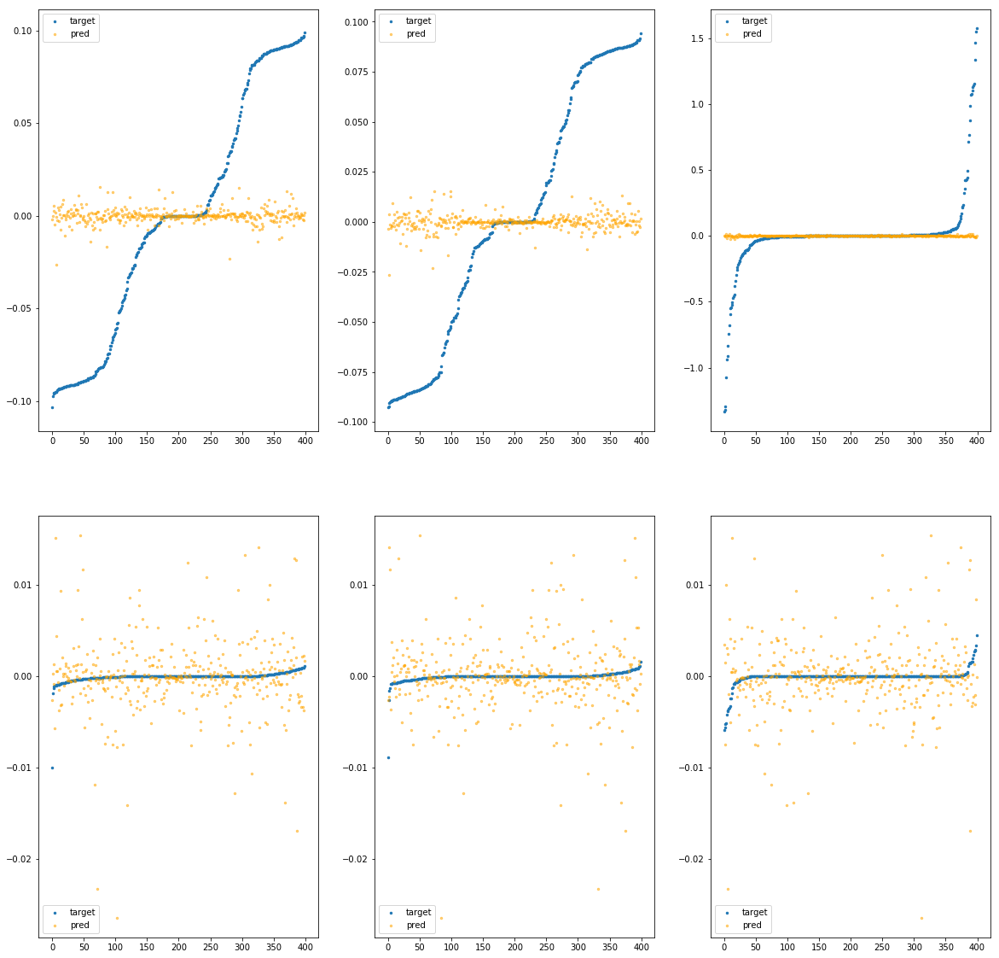

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbfd30>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		7.86e-03	1.12e-01	5.15e-02	2.31e+03	4.06e-03	1.65e-05
y		-1.16e-02	1.07e-01	5.14e-02	1.42e+02	3.88e-03	1.50e-05
z		-4.93e-03	1.58e+00	1.02e-01	6.65e+01	8.37e-02	7.01e-03
phi		-3.82e+01	1.71e-02	2.33e-03	3.32e+05	1.42e-05	2.01e-10
theta		-4.41e+01	1.72e-02	2.31e-03	1.29e+05	1.39e-05	1.94e-10
psi		-1.91e+01	1.72e-02	2.41e-03	2.27e+05	1.51e-05	2.27e-10


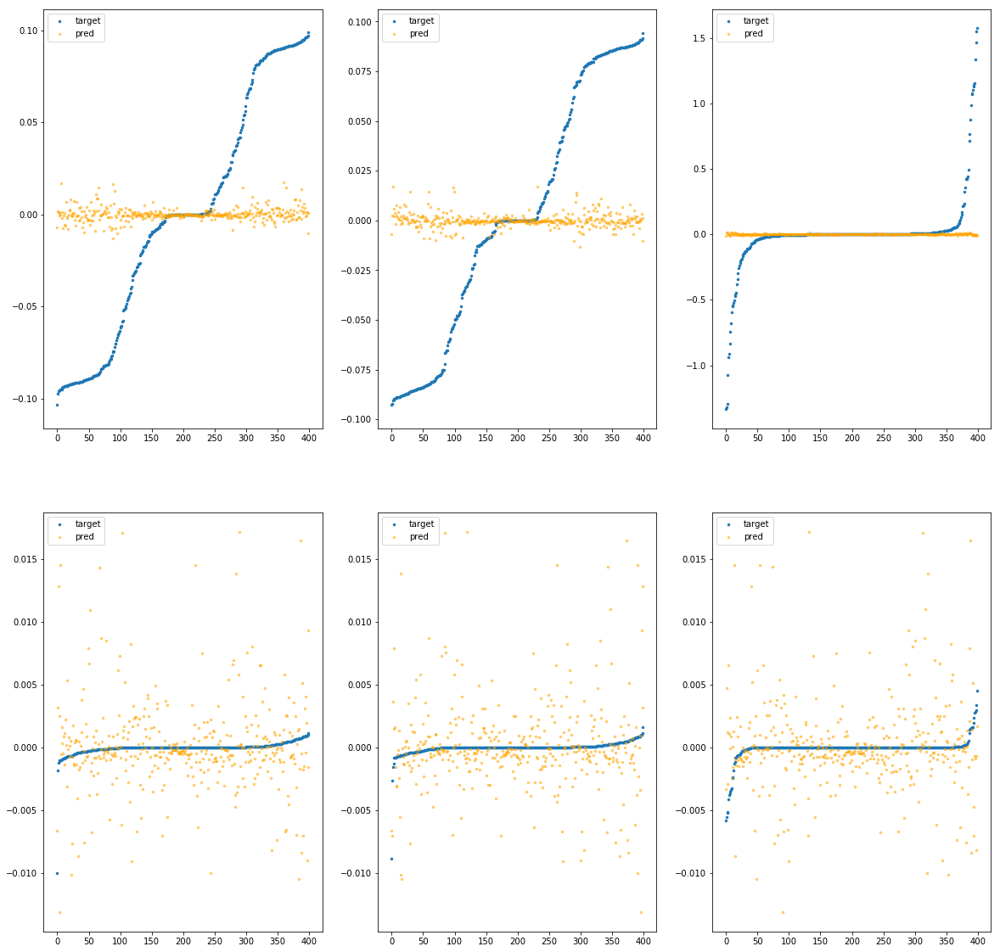

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbfd90>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.37e-03	1.01e-01	5.16e-02	7.98e+02	4.08e-03	1.66e-05
y		-4.23e-03	9.98e-02	5.12e-02	3.87e+01	3.85e-03	1.48e-05
z		-6.29e-03	1.57e+00	1.02e-01	4.63e+01	8.38e-02	7.03e-03
phi		-4.21e+01	2.47e-02	2.18e-03	2.46e+05	1.56e-05	2.43e-10
theta		-4.98e+01	2.48e-02	2.16e-03	2.98e+04	1.57e-05	2.46e-10
psi		-1.95e+01	2.48e-02	2.17e-03	1.96e+05	1.53e-05	2.35e-10


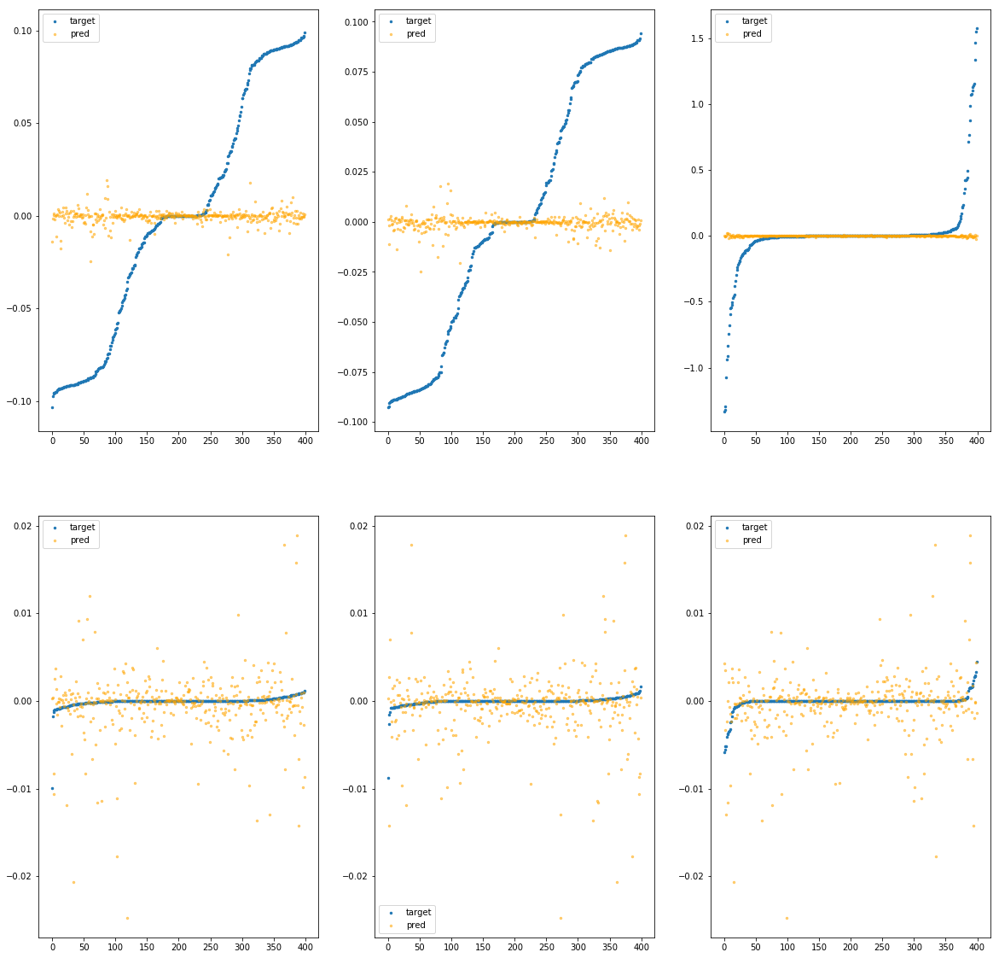

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbfdf0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		5.67e-03	1.05e-01	5.15e-02	9.54e+02	4.07e-03	1.66e-05
y		-6.27e-03	1.01e-01	5.13e-02	3.83e+01	3.86e-03	1.49e-05
z		-5.73e-03	1.58e+00	1.02e-01	4.83e+01	8.38e-02	7.02e-03
phi		-2.91e+01	1.69e-02	1.98e-03	2.07e+05	1.09e-05	1.19e-10
theta		-3.40e+01	1.72e-02	1.97e-03	5.66e+04	1.08e-05	1.17e-10
psi		-1.46e+01	1.70e-02	2.07e-03	1.48e+05	1.17e-05	1.36e-10


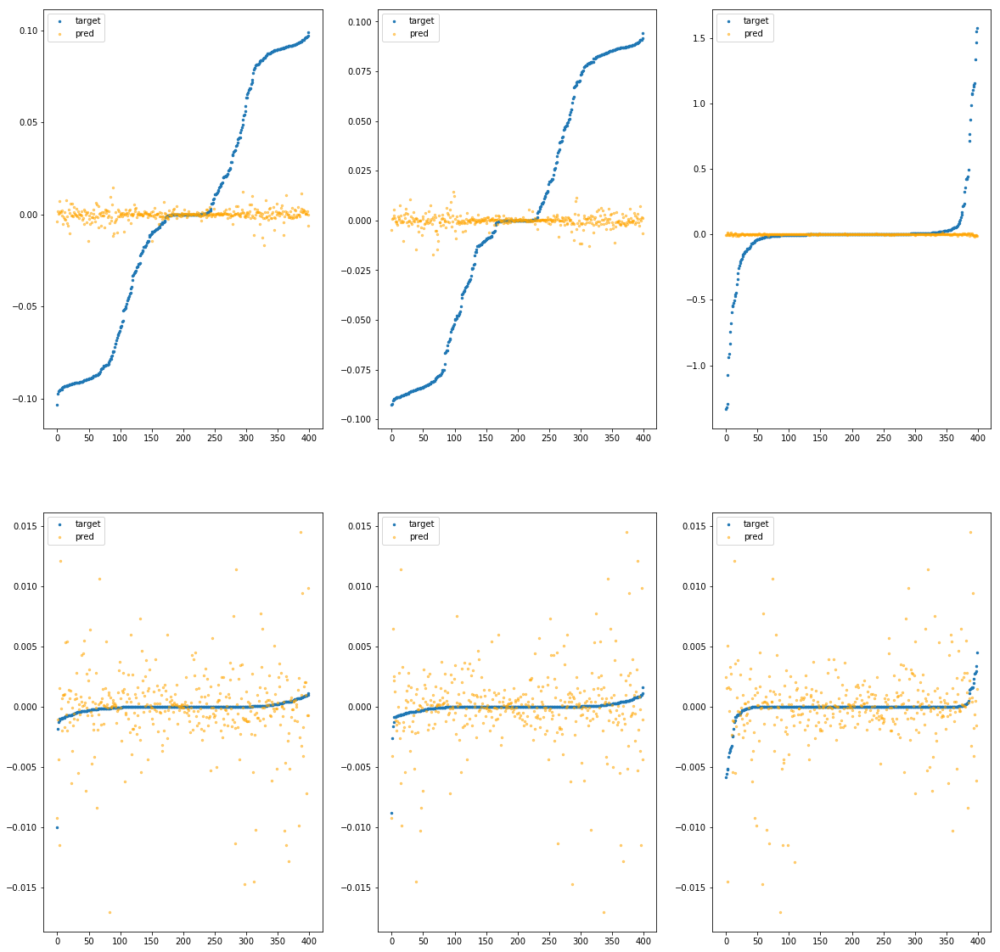

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbfe50>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.38e-03	1.06e-01	5.20e-02	6.70e+02	4.13e-03	1.70e-05
y		6.03e-03	9.68e-02	5.09e-02	9.27e+01	3.81e-03	1.45e-05
z		-3.51e-04	1.57e+00	1.02e-01	5.44e+01	8.33e-02	6.95e-03
phi		-2.50e+01	2.70e-02	1.73e-03	1.89e+05	9.40e-06	8.83e-11
theta		-2.82e+01	2.61e-02	1.71e-03	6.49e+04	9.02e-06	8.14e-11
psi		-1.29e+01	2.65e-02	1.83e-03	1.82e+05	1.04e-05	1.09e-10


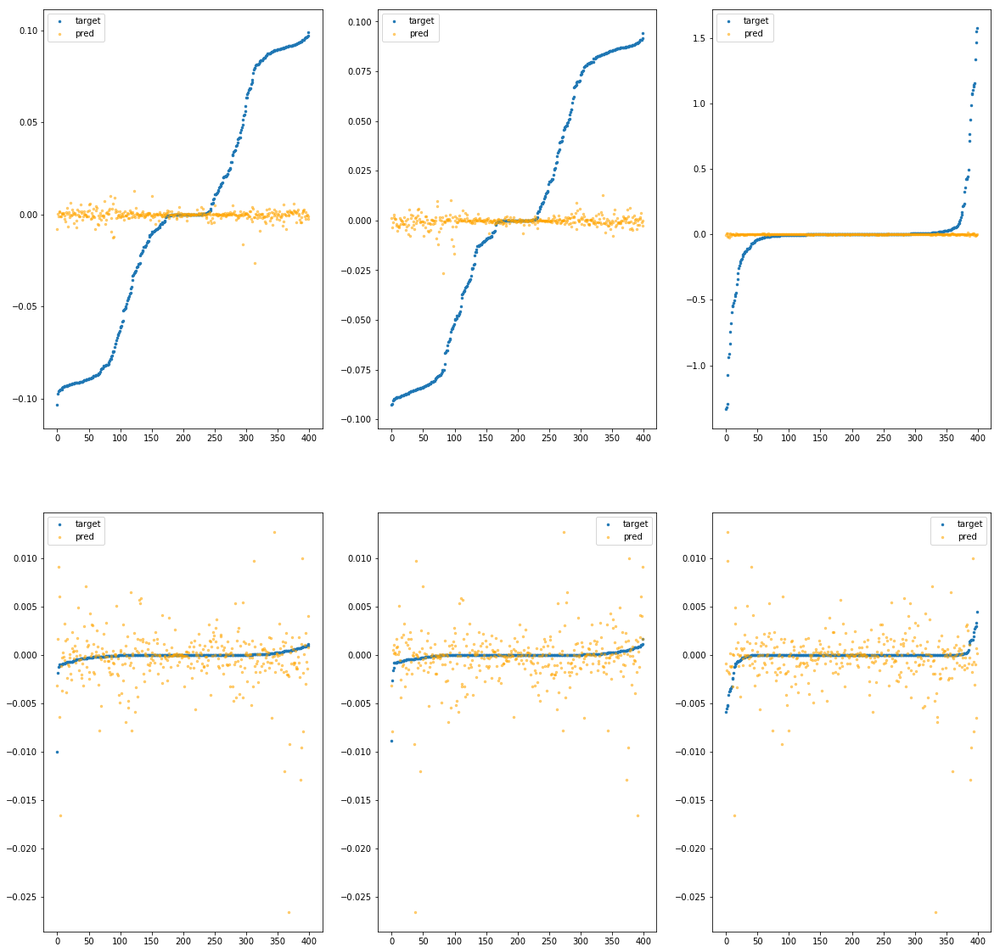

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbfeb0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.69e-03	1.10e-01	5.18e-02	1.58e+03	4.11e-03	1.69e-05
y		4.27e-03	1.06e-01	5.11e-02	7.84e+01	3.82e-03	1.46e-05
z		-1.37e-03	1.60e+00	1.02e-01	7.19e+01	8.34e-02	6.96e-03
phi		-5.15e+01	3.17e-02	2.40e-03	2.23e+05	1.90e-05	3.61e-10
theta		-6.02e+01	3.17e-02	2.40e-03	8.50e+04	1.89e-05	3.57e-10
psi		-2.40e+01	3.13e-02	2.42e-03	1.78e+05	1.87e-05	3.50e-10


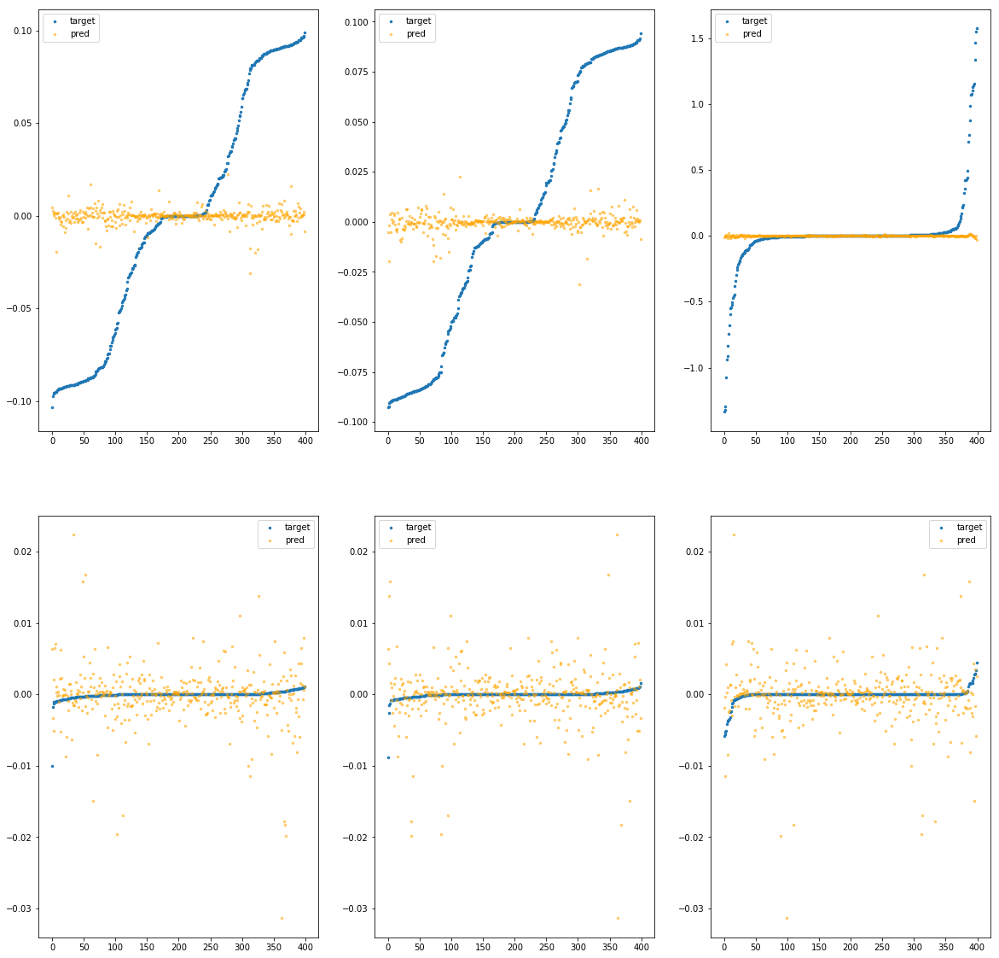

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbff10>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.09e-03	1.10e-01	5.20e-02	1.25e+03	4.12e-03	1.70e-05
y		-3.23e-02	1.16e-01	5.18e-02	8.50e+01	3.96e-03	1.57e-05
z		-5.81e-03	1.59e+00	1.02e-01	5.95e+01	8.38e-02	7.02e-03
phi		-7.03e+01	2.97e-02	2.82e-03	2.99e+05	2.58e-05	6.67e-10
theta		-8.51e+01	2.86e-02	2.82e-03	1.00e+05	2.66e-05	7.07e-10
psi		-3.10e+01	2.70e-02	2.78e-03	2.05e+05	2.40e-05	5.76e-10


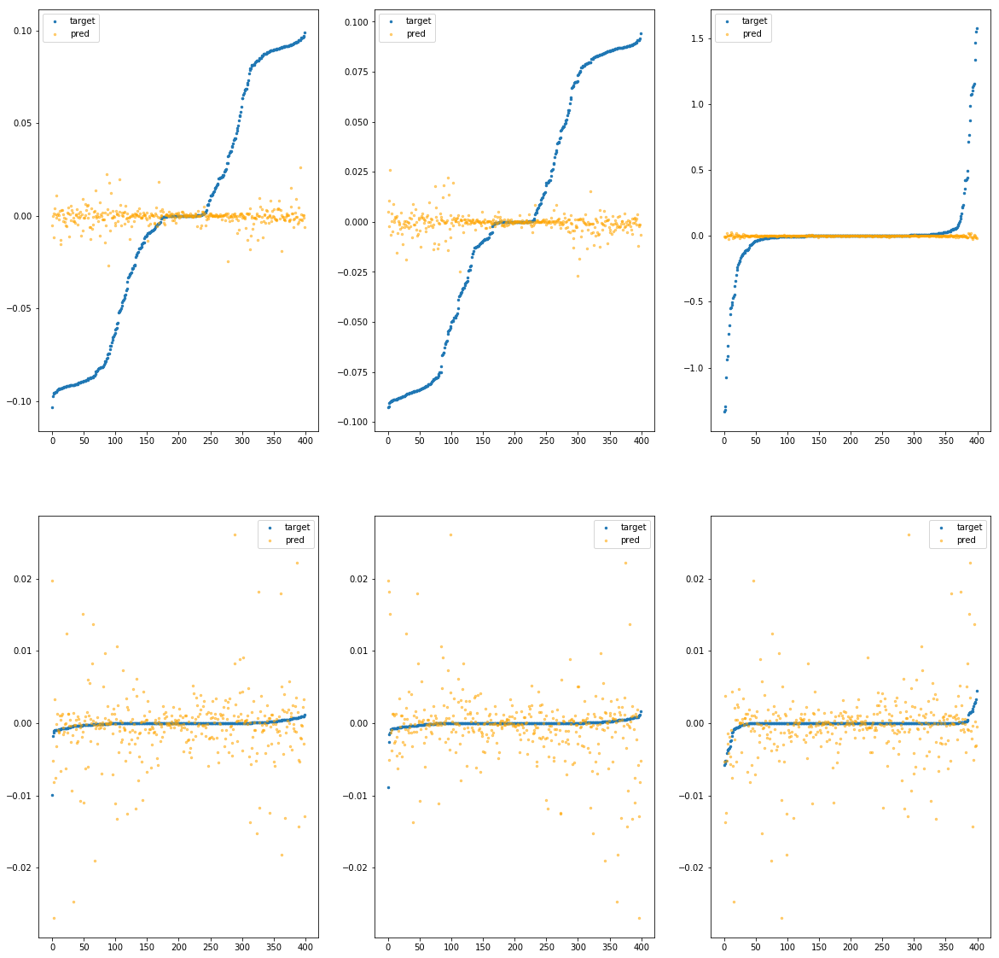

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbff70>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.69e-03	1.25e-01	5.20e-02	1.70e+03	4.11e-03	1.69e-05
y		-2.20e-03	1.21e-01	5.10e-02	1.22e+02	3.84e-03	1.48e-05
z		1.63e-03	1.58e+00	1.02e-01	6.22e+01	8.32e-02	6.92e-03
phi		-7.97e+01	3.88e-02	2.86e-03	3.66e+05	2.92e-05	8.54e-10
theta		-9.30e+01	3.88e-02	2.85e-03	1.12e+05	2.90e-05	8.44e-10
psi		-3.98e+01	3.89e-02	2.96e-03	1.73e+05	3.06e-05	9.34e-10


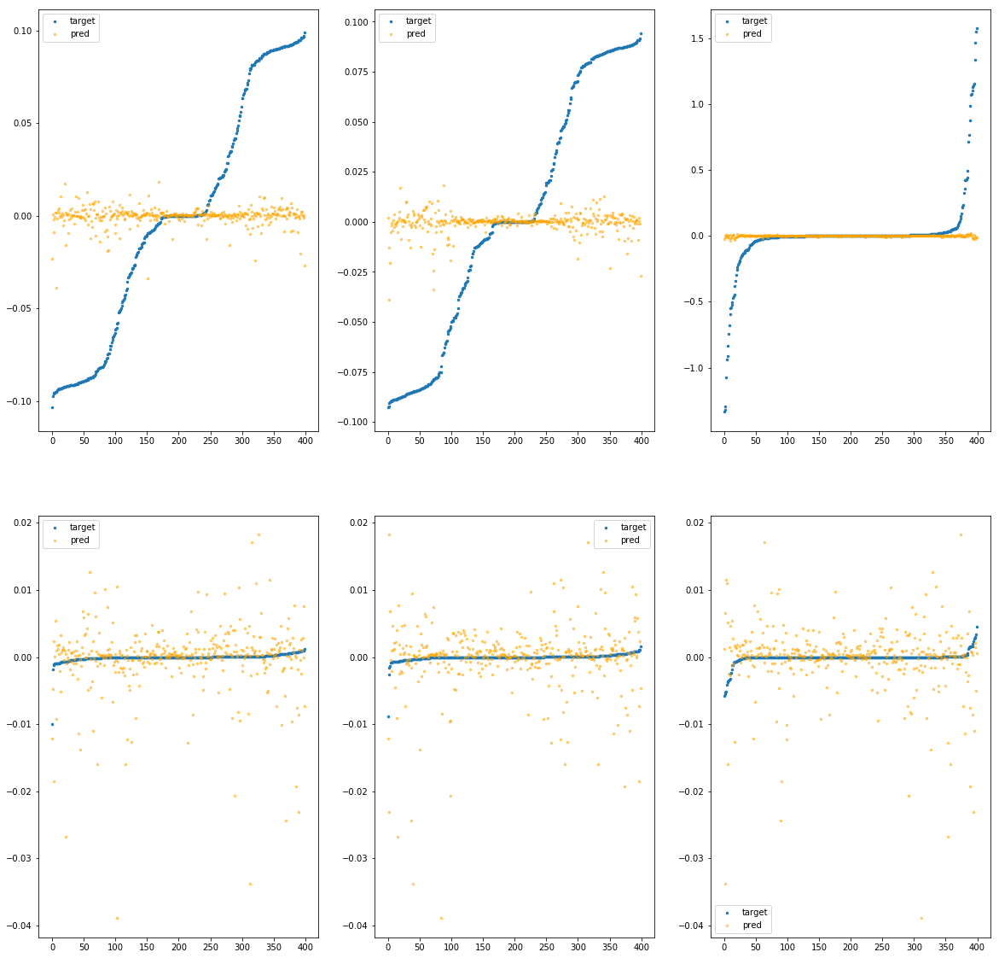

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba6fcbffd0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		9.82e-03	1.06e-01	5.14e-02	2.10e+03	4.05e-03	1.64e-05
y		9.10e-03	1.01e-01	5.09e-02	1.71e+02	3.80e-03	1.44e-05
z		-2.07e-03	1.56e+00	1.02e-01	8.43e+01	8.35e-02	6.97e-03
phi		-3.69e+01	2.26e-02	1.99e-03	3.90e+05	1.37e-05	1.89e-10
theta		-4.21e+01	2.24e-02	1.95e-03	9.96e+04	1.33e-05	1.77e-10
psi		-1.80e+01	2.33e-02	2.06e-03	1.69e+05	1.42e-05	2.03e-10


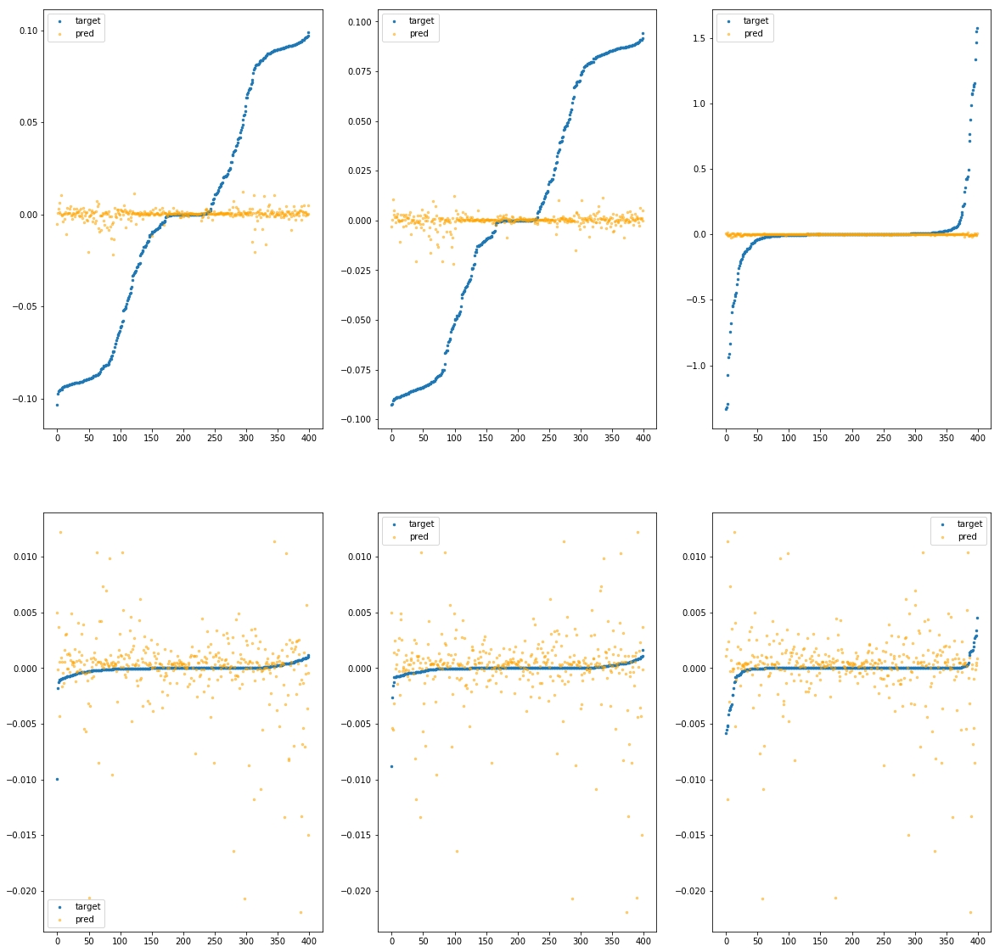

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf070>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.53e-03	1.03e-01	5.17e-02	4.16e+03	4.08e-03	1.66e-05
y		6.06e-03	9.86e-02	5.10e-02	2.05e+02	3.81e-03	1.45e-05
z		6.06e-04	1.57e+00	1.02e-01	9.52e+01	8.33e-02	6.93e-03
phi		-7.29e+00	1.14e-02	1.06e-03	6.67e+05	3.00e-06	9.00e-12
theta		-8.20e+00	1.24e-02	1.03e-03	1.80e+05	2.84e-06	8.07e-12
psi		-3.94e+00	1.17e-02	1.15e-03	9.41e+04	3.70e-06	1.37e-11


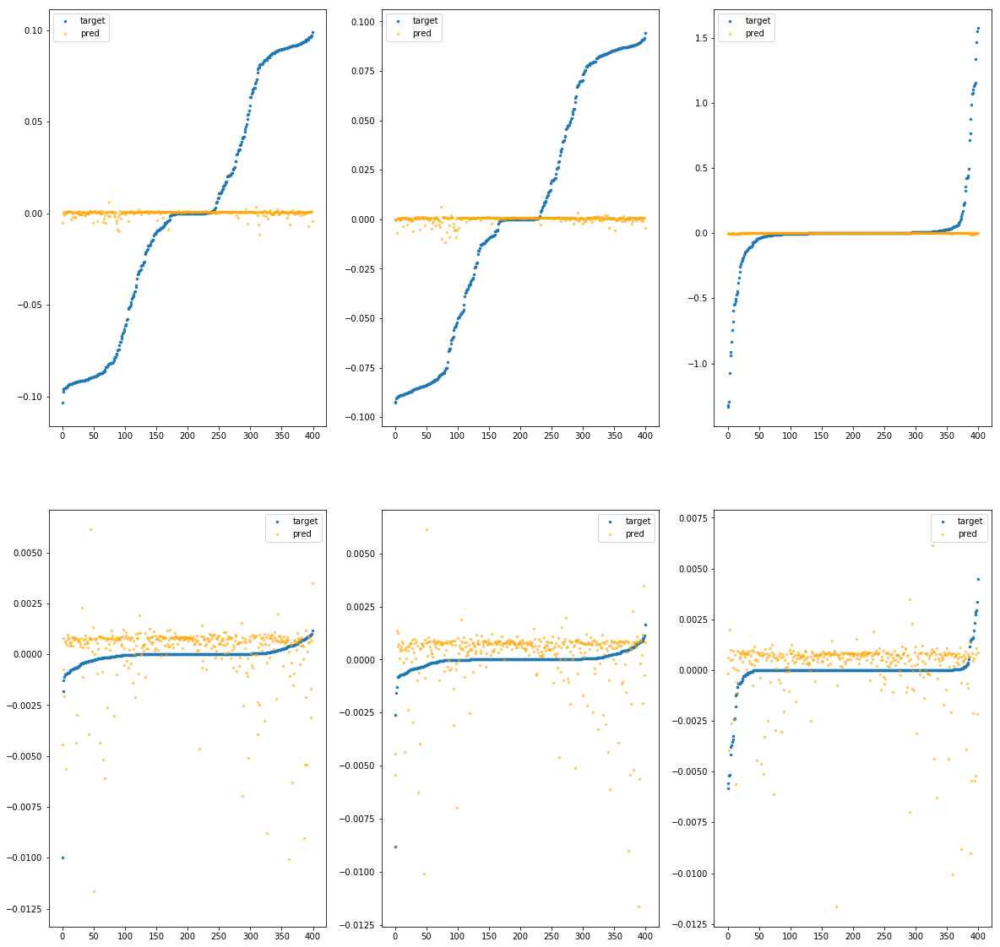

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf0d0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.01e-03	1.06e-01	5.18e-02	2.17e+03	4.11e-03	1.69e-05
y		-1.23e-02	9.54e-02	5.14e-02	9.97e+01	3.88e-03	1.51e-05
z		1.67e-03	1.57e+00	1.02e-01	5.20e+01	8.32e-02	6.92e-03
phi		-9.57e+00	1.23e-02	9.46e-04	3.78e+05	3.83e-06	1.47e-11
theta		-1.18e+01	1.39e-02	9.61e-04	9.28e+04	3.95e-06	1.56e-11
psi		-5.01e+00	1.25e-02	1.03e-03	7.03e+04	4.51e-06	2.03e-11


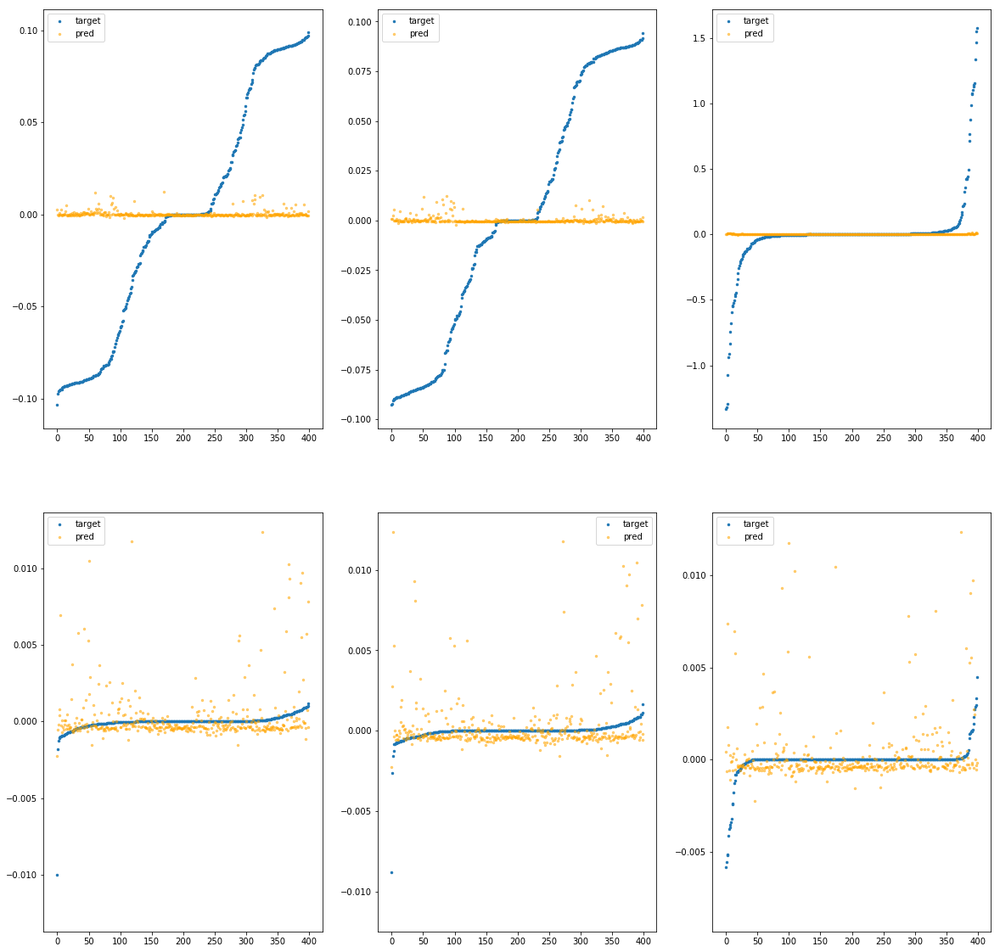

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf130>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.40e-03	1.08e-01	5.18e-02	5.10e+03	4.10e-03	1.68e-05
y		-1.12e-02	9.53e-02	5.14e-02	2.71e+02	3.88e-03	1.50e-05
z		-1.35e-03	1.57e+00	1.02e-01	1.26e+02	8.34e-02	6.96e-03
phi		-9.75e+00	1.31e-02	1.29e-03	8.93e+05	3.89e-06	1.52e-11
theta		-1.17e+01	1.34e-02	1.31e-03	2.31e+05	3.93e-06	1.54e-11
psi		-4.52e+00	1.23e-02	1.37e-03	1.26e+05	4.14e-06	1.71e-11


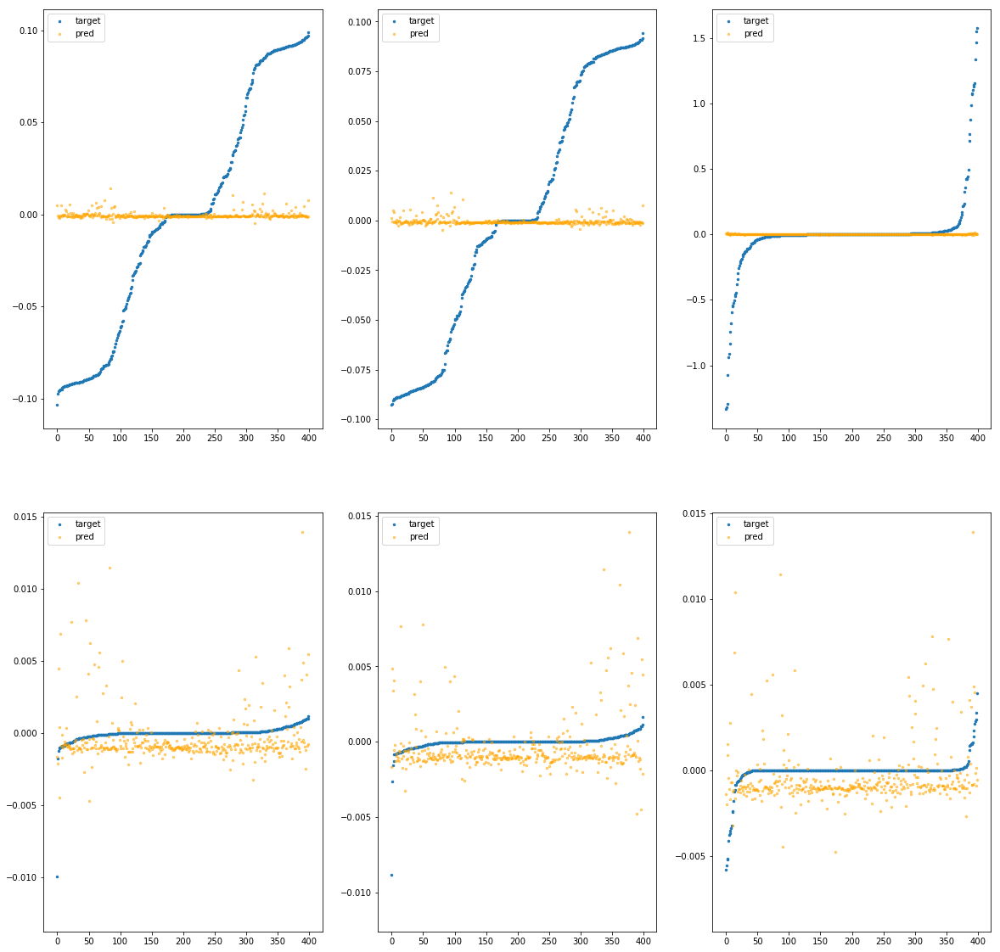

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf190>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.08e-04	1.03e-01	5.17e-02	8.17e+02	4.09e-03	1.68e-05
y		-3.96e-03	9.41e-02	5.11e-02	3.25e+01	3.85e-03	1.48e-05
z		-2.60e-03	1.57e+00	1.02e-01	2.31e+01	8.35e-02	6.98e-03
phi		-5.89e+00	1.39e-02	7.81e-04	9.77e+04	2.49e-06	6.22e-12
theta		-7.45e+00	1.39e-02	7.66e-04	2.10e+04	2.61e-06	6.81e-12
psi		-2.95e+00	1.35e-02	8.43e-04	4.51e+04	2.96e-06	8.76e-12


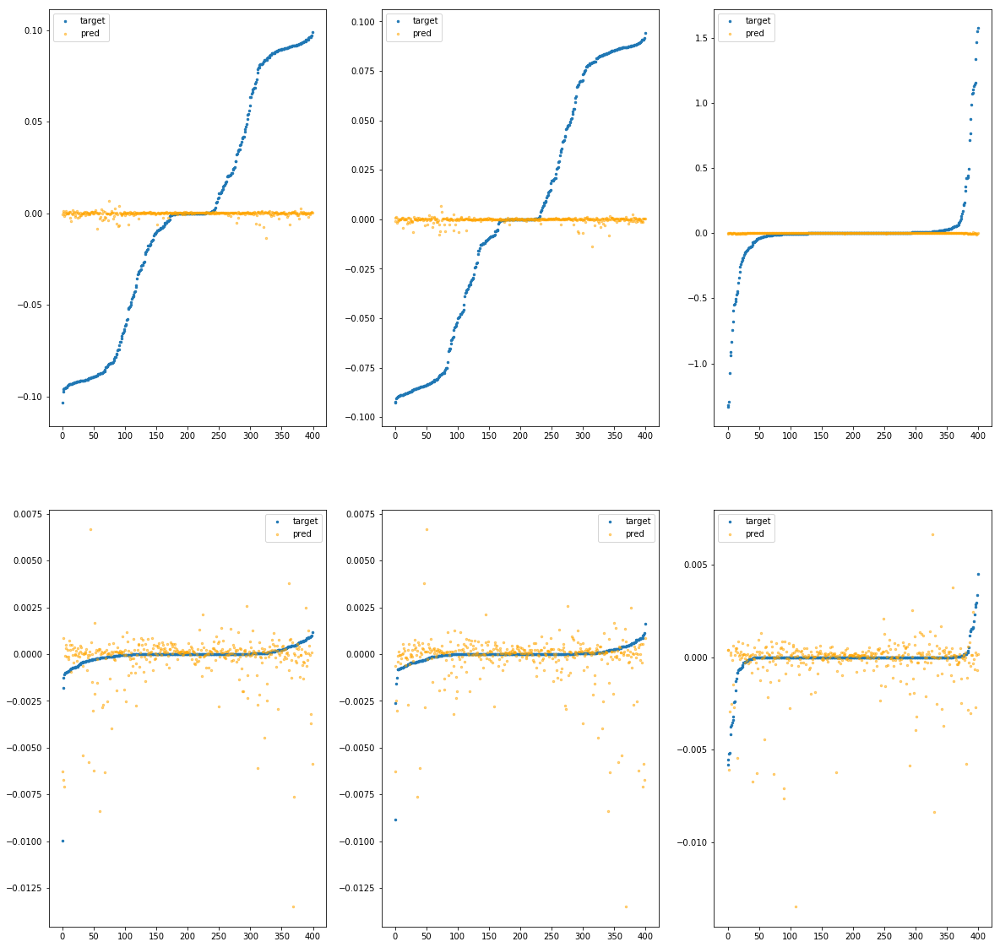

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf1f0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		6.13e-03	9.80e-02	5.16e-02	2.45e+03	4.07e-03	1.66e-05
y		1.39e-03	9.30e-02	5.11e-02	1.17e+02	3.83e-03	1.47e-05
z		-5.15e-04	1.57e+00	1.02e-01	5.52e+01	8.34e-02	6.95e-03
phi		-4.77e+00	1.02e-02	8.20e-04	4.08e+05	2.09e-06	4.37e-12
theta		-5.24e+00	9.52e-03	7.89e-04	1.09e+05	1.93e-06	3.72e-12
psi		-2.18e+00	9.85e-03	8.77e-04	5.30e+04	2.39e-06	5.69e-12


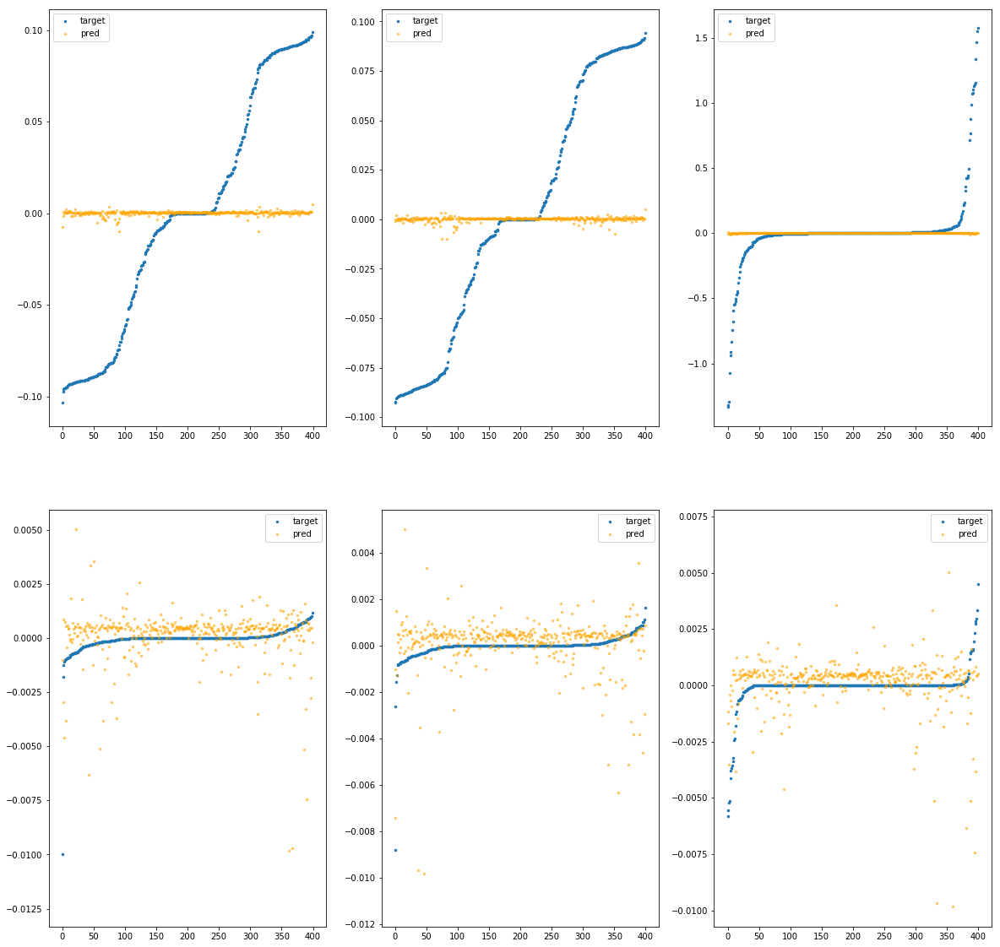

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf250>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.15e-03	1.05e-01	5.17e-02	4.74e+03	4.09e-03	1.67e-05
y		-2.60e-03	9.49e-02	5.12e-02	2.40e+02	3.84e-03	1.48e-05
z		1.03e-03	1.57e+00	1.02e-01	1.11e+02	8.32e-02	6.93e-03
phi		-4.79e+00	8.69e-03	1.08e-03	8.07e+05	2.10e-06	4.40e-12
theta		-5.45e+00	7.72e-03	1.07e-03	1.96e+05	1.99e-06	3.97e-12
psi		-2.31e+00	8.01e-03	1.16e-03	1.08e+05	2.49e-06	6.18e-12


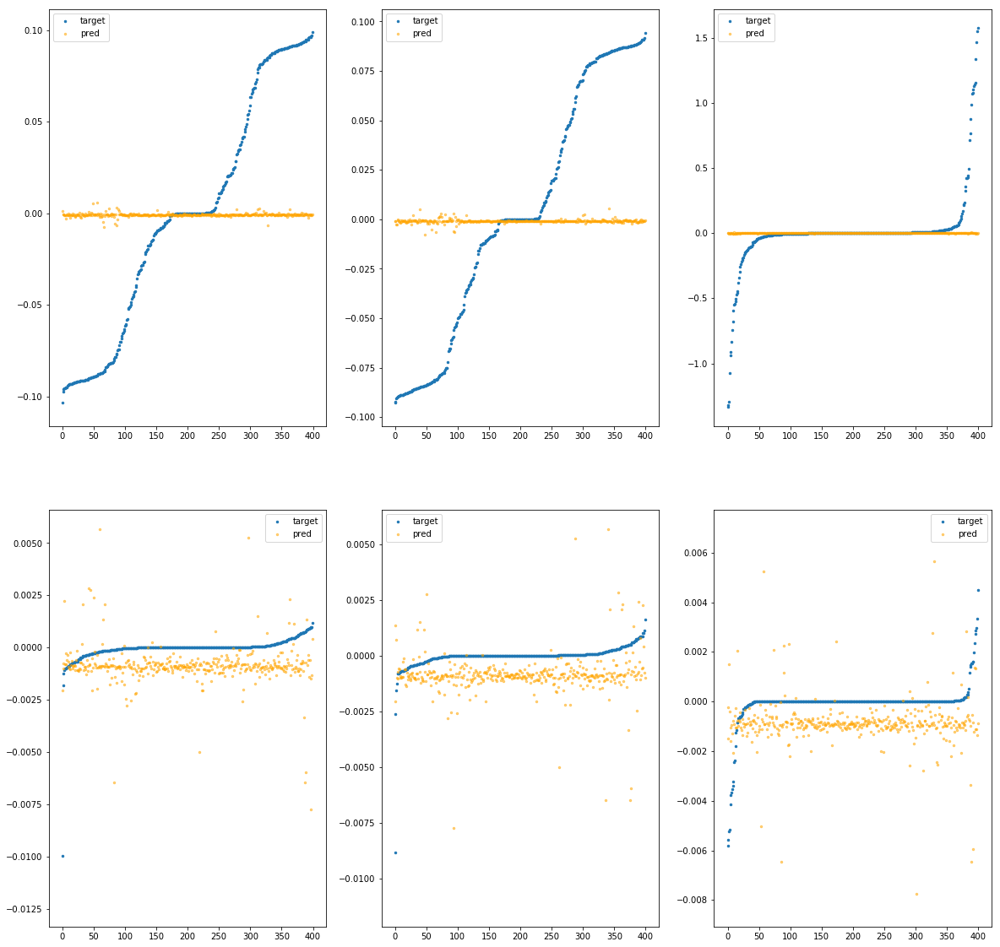

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf2b0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.98e-03	9.96e-02	5.17e-02	7.01e+03	4.08e-03	1.66e-05
y		-3.87e-03	9.51e-02	5.13e-02	3.65e+02	3.85e-03	1.48e-05
z		-1.73e-03	1.58e+00	1.02e-01	1.69e+02	8.35e-02	6.97e-03
phi		-1.16e+01	1.10e-02	1.81e-03	1.19e+06	4.56e-06	2.08e-11
theta		-1.36e+01	1.01e-02	1.82e-03	3.00e+05	4.51e-06	2.04e-11
psi		-5.68e+00	1.05e-02	1.88e-03	1.94e+05	5.01e-06	2.51e-11


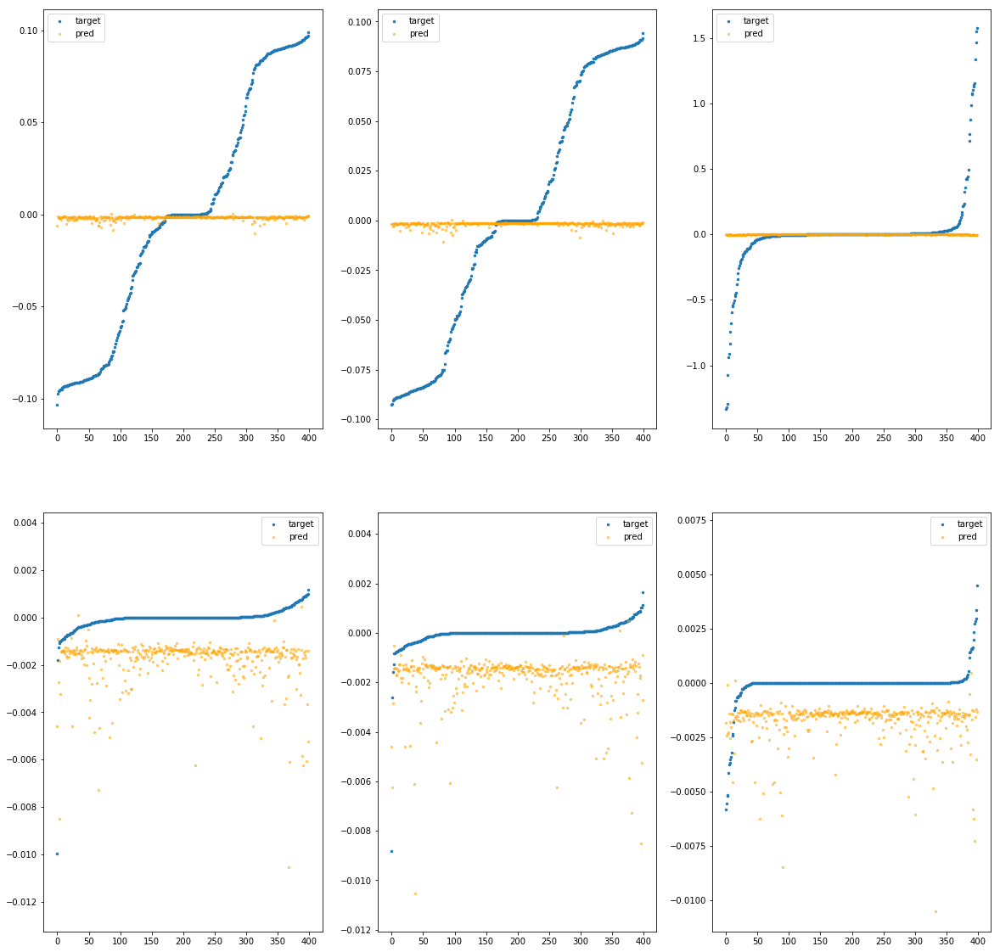

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf310>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.57e-03	1.08e-01	5.17e-02	1.09e+03	4.11e-03	1.69e-05
y		-1.79e-03	9.35e-02	5.11e-02	5.44e+01	3.84e-03	1.48e-05
z		-8.30e-04	1.57e+00	1.02e-01	3.15e+01	8.34e-02	6.95e-03
phi		-4.16e+00	1.04e-02	6.87e-04	2.21e+05	1.87e-06	3.49e-12
theta		-4.33e+00	9.56e-03	6.49e-04	3.35e+04	1.65e-06	2.71e-12
psi		-2.00e+00	9.96e-03	7.39e-04	4.60e+04	2.25e-06	5.07e-12


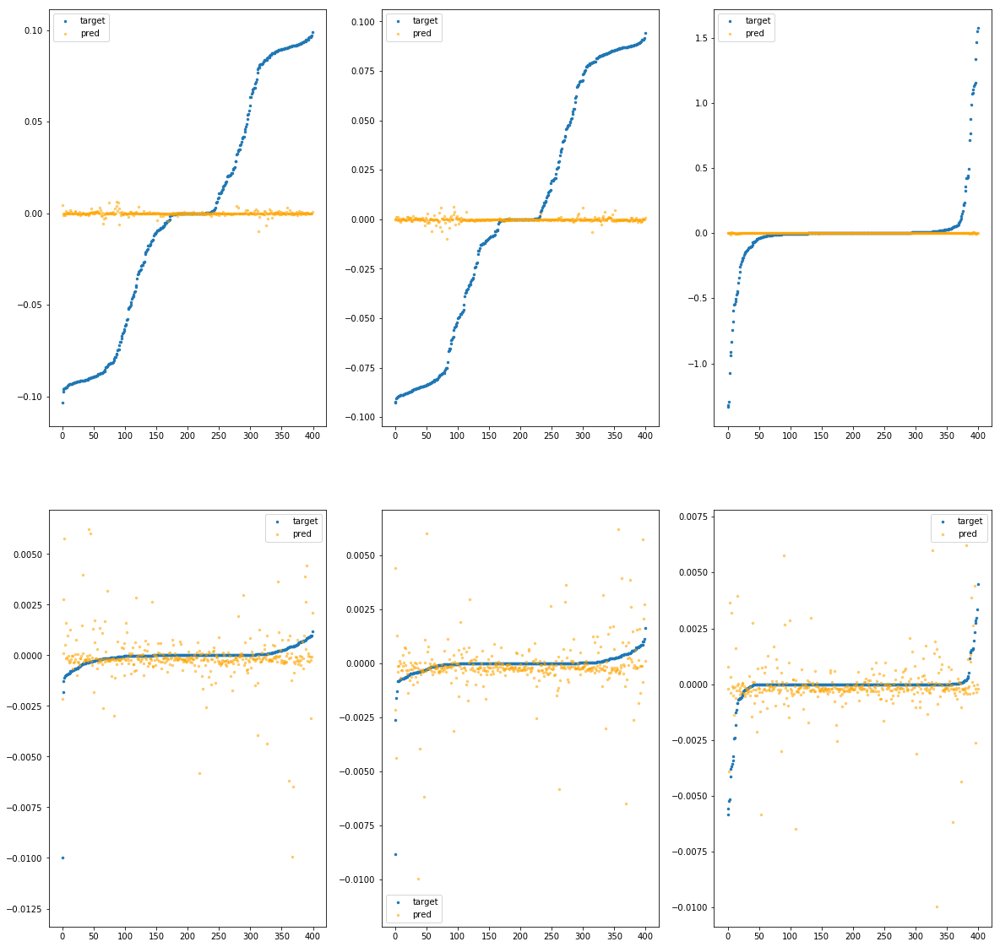

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf370>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		4.82e-03	1.01e-01	5.15e-02	8.05e+02	4.07e-03	1.66e-05
y		-1.34e-04	9.67e-02	5.10e-02	3.70e+01	3.83e-03	1.47e-05
z		-2.96e-03	1.57e+00	1.02e-01	1.88e+01	8.36e-02	6.98e-03
phi		-4.20e+00	1.20e-02	6.14e-04	1.39e+05	1.88e-06	3.55e-12
theta		-4.39e+00	1.13e-02	5.72e-04	3.52e+04	1.66e-06	2.77e-12
psi		-2.28e+00	1.16e-02	6.73e-04	3.07e+04	2.46e-06	6.06e-12


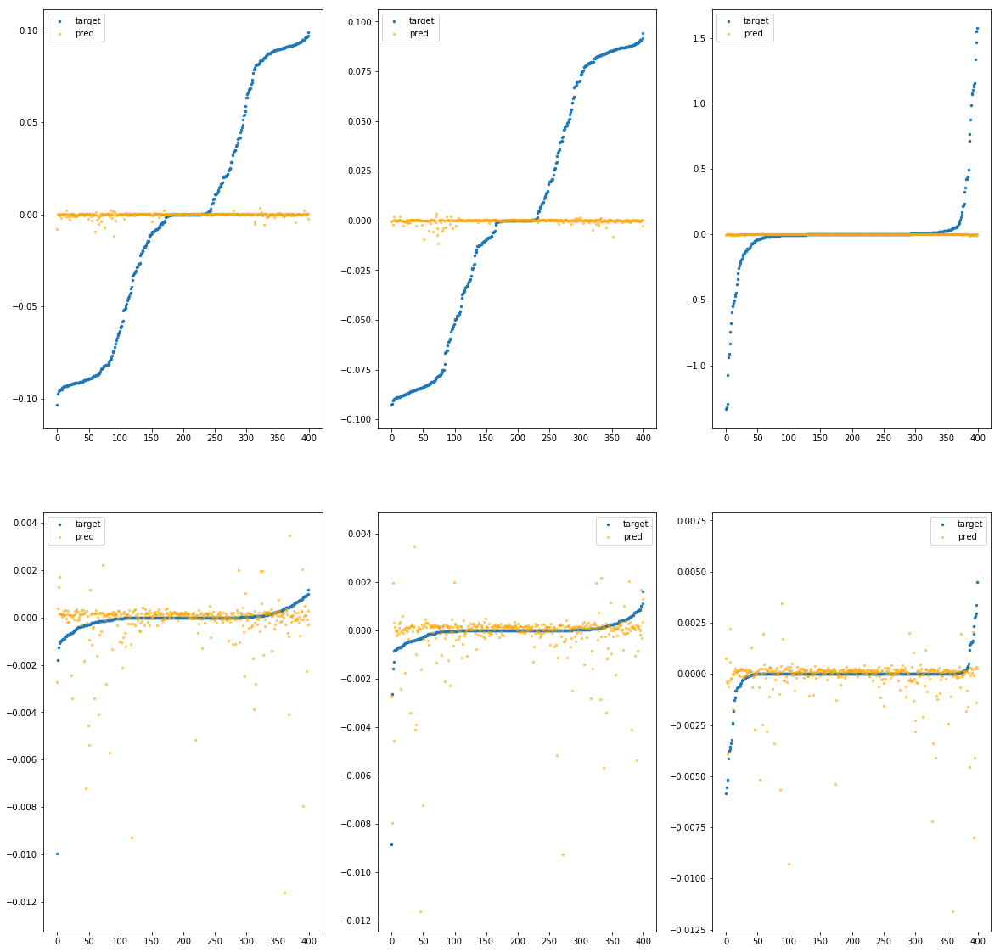

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf3d0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.27e-03	1.08e-01	5.18e-02	2.67e+03	4.12e-03	1.69e-05
y		-1.27e-02	9.89e-02	5.14e-02	1.20e+02	3.88e-03	1.51e-05
z		3.21e-03	1.57e+00	1.02e-01	6.40e+01	8.31e-02	6.90e-03
phi		-1.25e+01	1.68e-02	9.93e-04	4.36e+05	4.90e-06	2.40e-11
theta		-1.51e+01	1.60e-02	9.95e-04	1.14e+05	4.96e-06	2.46e-11
psi		-5.32e+00	1.43e-02	1.06e-03	7.03e+04	4.74e-06	2.25e-11


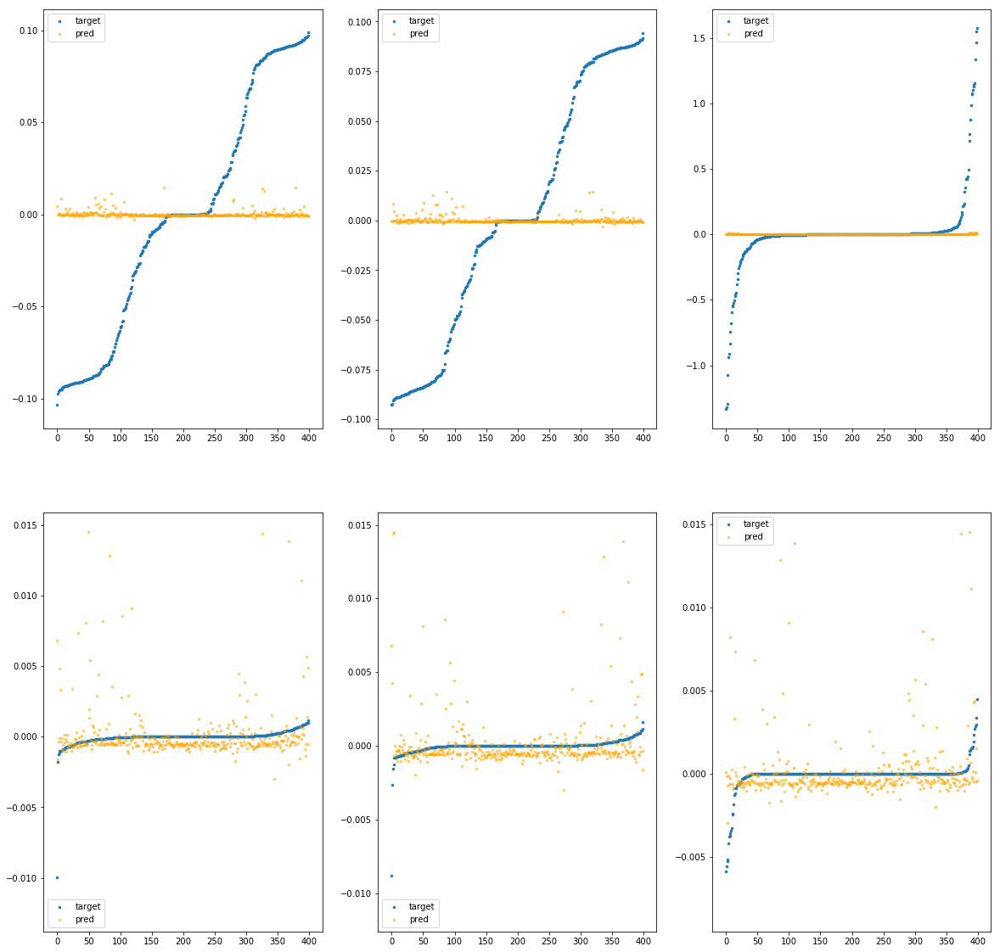

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf430>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.79e-03	1.03e-01	5.18e-02	8.45e+03	4.09e-03	1.67e-05
y		-6.49e-03	9.48e-02	5.13e-02	4.28e+02	3.86e-03	1.49e-05
z		5.42e-04	1.58e+00	1.02e-01	1.96e+02	8.33e-02	6.93e-03
phi		-9.51e+00	8.00e-03	1.75e-03	1.41e+06	3.80e-06	1.45e-11
theta		-1.14e+01	7.30e-03	1.76e-03	3.50e+05	3.84e-06	1.47e-11
psi		-4.48e+00	8.14e-03	1.81e-03	2.11e+05	4.11e-06	1.69e-11


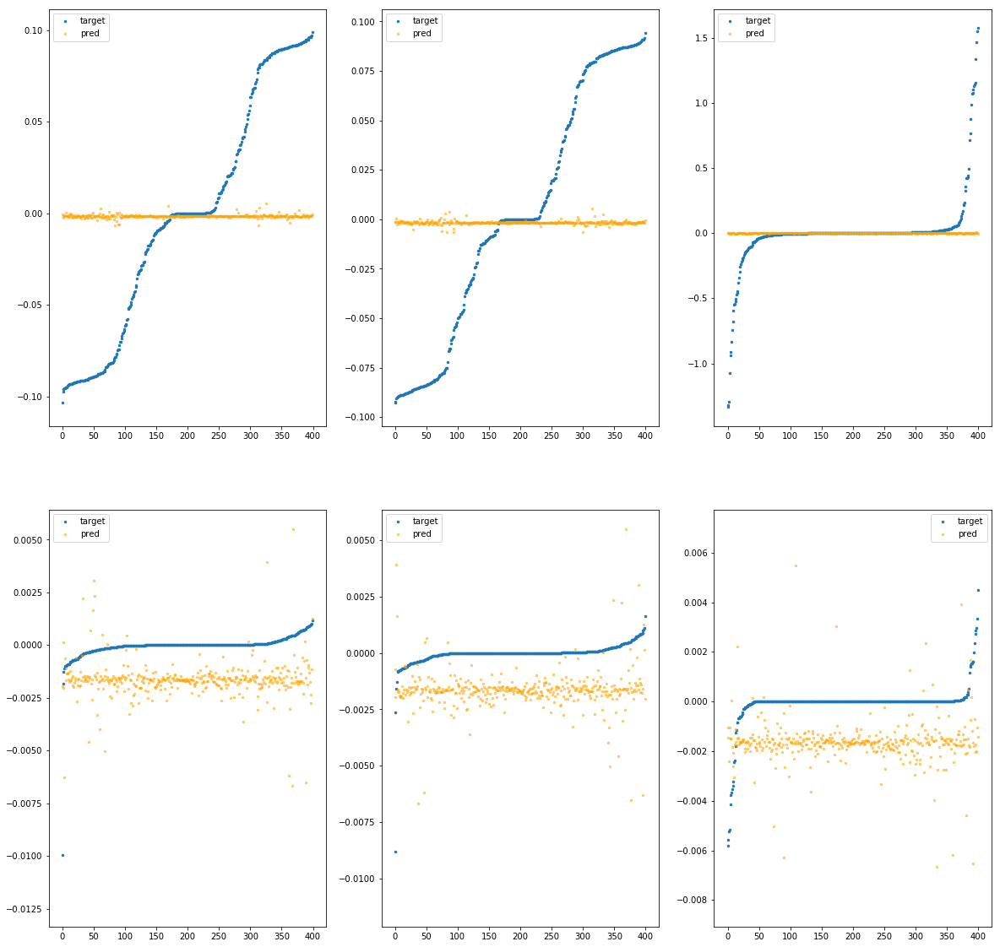

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf490>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.55e-03	9.83e-02	5.16e-02	1.52e+03	4.08e-03	1.66e-05
y		-1.26e-03	9.26e-02	5.11e-02	8.44e+01	3.84e-03	1.47e-05
z		-1.93e-03	1.57e+00	1.02e-01	3.82e+01	8.35e-02	6.97e-03
phi		-3.72e+00	1.06e-02	7.16e-04	2.60e+05	1.71e-06	2.92e-12
theta		-3.73e+00	9.73e-03	6.84e-04	5.17e+04	1.46e-06	2.14e-12
psi		-1.96e+00	1.01e-02	7.90e-04	5.11e+04	2.22e-06	4.94e-12


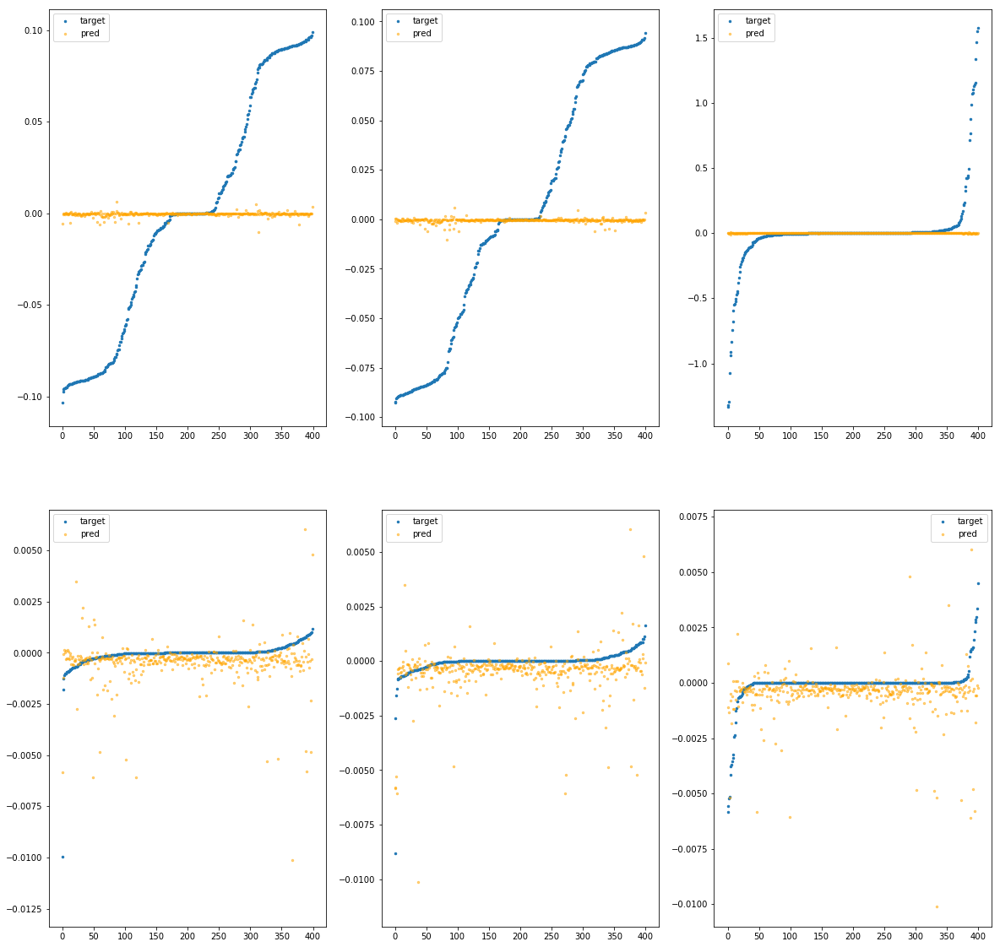

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf4f0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		4.15e-03	1.03e-01	5.18e-02	1.33e+04	4.08e-03	1.66e-05
y		-6.79e-03	9.87e-02	5.14e-02	6.69e+02	3.86e-03	1.49e-05
z		-6.19e-04	1.58e+00	1.02e-01	3.10e+02	8.34e-02	6.95e-03
phi		-2.79e+01	1.79e-02	2.92e-03	2.25e+06	1.05e-05	1.09e-10
theta		-3.29e+01	1.76e-02	2.94e-03	5.55e+05	1.05e-05	1.10e-10
psi		-1.33e+01	1.87e-02	2.91e-03	3.19e+05	1.07e-05	1.15e-10


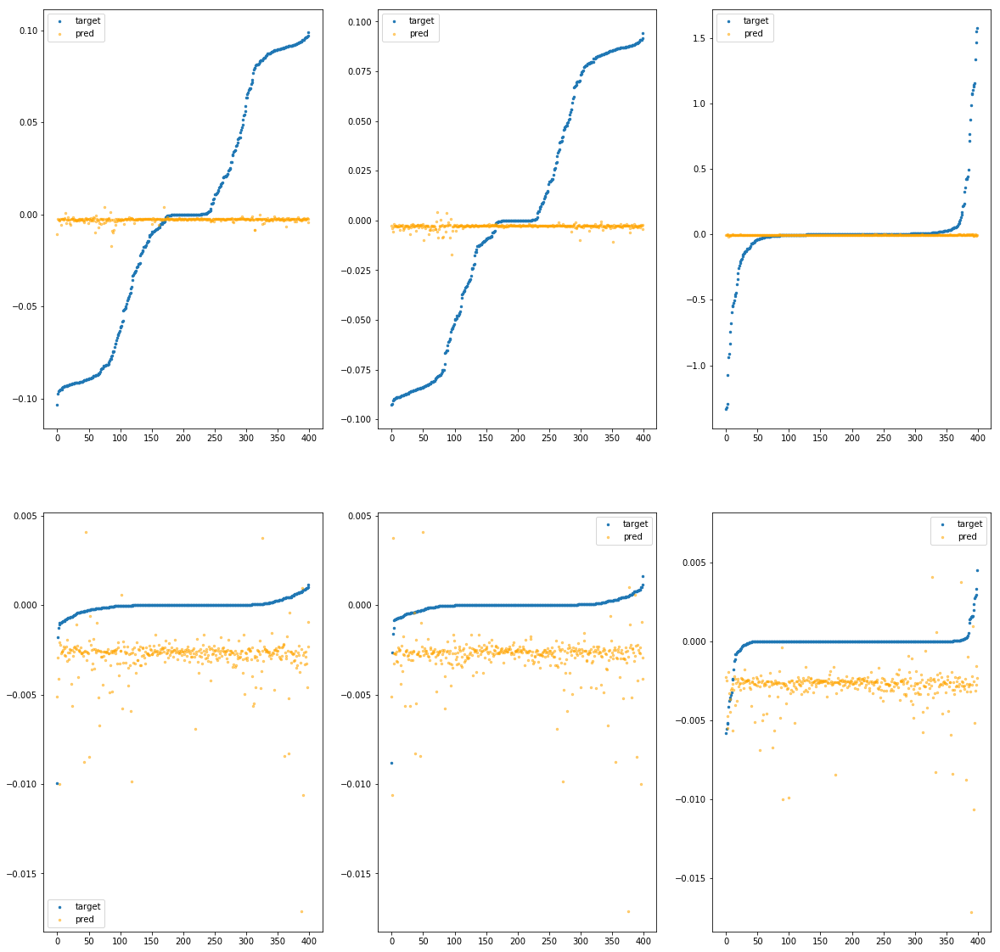

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf550>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		5.73e-03	1.03e-01	5.16e-02	2.78e+03	4.07e-03	1.66e-05
y		1.04e-03	9.84e-02	5.10e-02	1.36e+02	3.83e-03	1.47e-05
z		-6.30e-04	1.58e+00	1.02e-01	6.48e+01	8.34e-02	6.95e-03
phi		-5.19e+00	1.24e-02	8.44e-04	4.59e+05	2.24e-06	5.03e-12
theta		-5.76e+00	1.21e-02	8.00e-04	1.24e+05	2.09e-06	4.36e-12
psi		-2.45e+00	1.32e-02	9.01e-04	5.77e+04	2.59e-06	6.69e-12


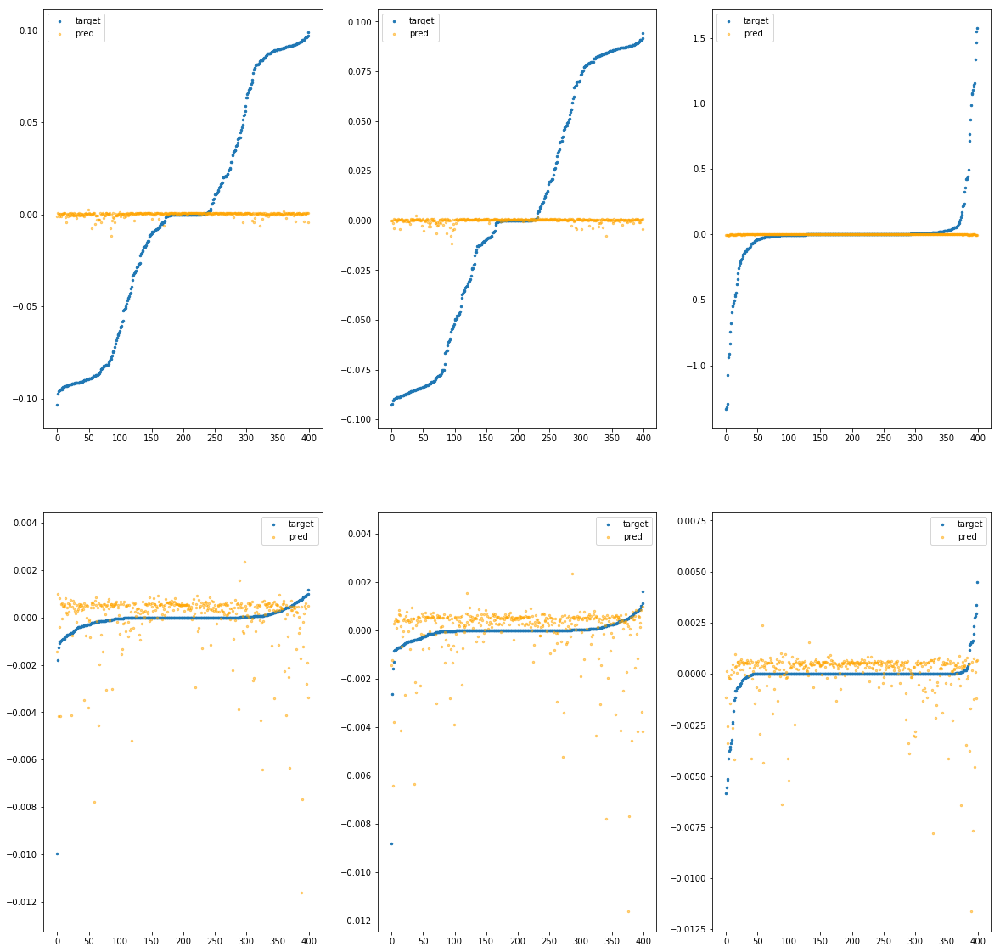

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf5b0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.53e-03	1.01e-01	5.17e-02	8.14e+02	4.10e-03	1.68e-05
y		-5.65e-03	9.49e-02	5.12e-02	4.34e+01	3.86e-03	1.49e-05
z		-2.70e-03	1.57e+00	1.02e-01	1.98e+01	8.35e-02	6.98e-03
phi		-4.30e+00	1.18e-02	6.38e-04	1.40e+05	1.92e-06	3.68e-12
theta		-5.13e+00	1.07e-02	6.17e-04	2.77e+04	1.89e-06	3.59e-12
psi		-1.53e+00	8.11e-03	6.51e-04	3.24e+04	1.90e-06	3.59e-12


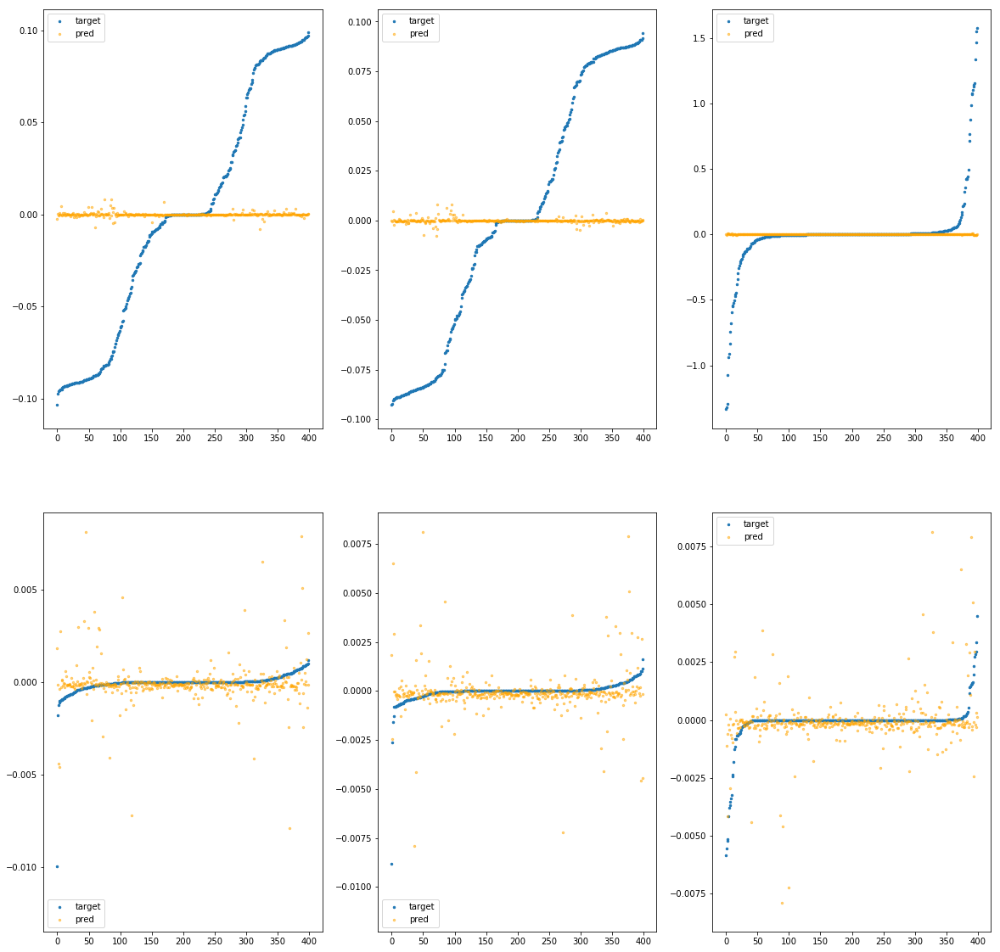

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf610>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		2.81e-03	1.02e-01	5.17e-02	4.24e+03	4.08e-03	1.67e-05
y		-3.60e-05	9.37e-02	5.12e-02	2.15e+02	3.83e-03	1.47e-05
z		5.78e-04	1.57e+00	1.02e-01	1.01e+02	8.33e-02	6.93e-03
phi		-3.48e+00	9.52e-03	9.71e-04	7.01e+05	1.62e-06	2.63e-12
theta		-3.67e+00	8.37e-03	9.39e-04	1.90e+05	1.44e-06	2.08e-12
psi		-1.89e+00	7.36e-03	1.09e-03	9.50e+04	2.17e-06	4.69e-12


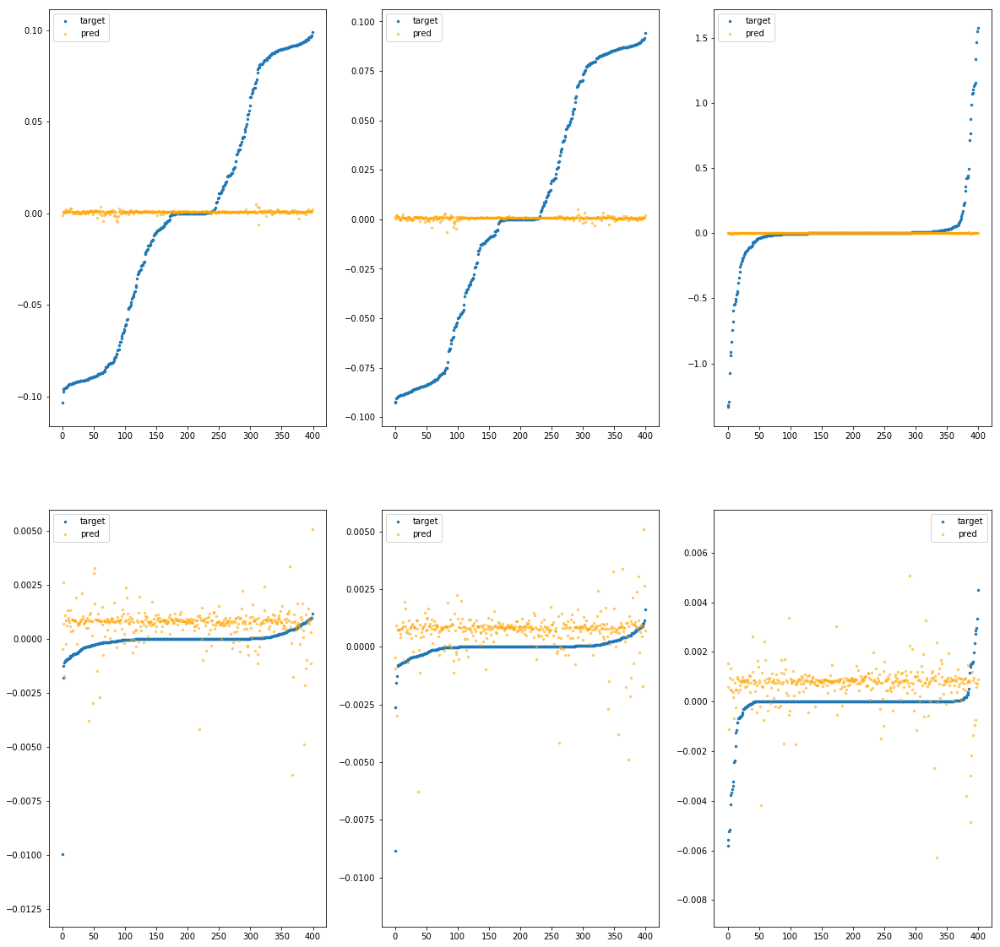

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf670>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		8.68e-04	1.05e-01	5.17e-02	3.36e+03	4.09e-03	1.67e-05
y		-3.37e-03	9.68e-02	5.12e-02	1.74e+02	3.85e-03	1.48e-05
z		-2.33e-04	1.57e+00	1.02e-01	7.53e+01	8.33e-02	6.95e-03
phi		-3.74e+00	9.32e-03	8.96e-04	5.39e+05	1.72e-06	2.95e-12
theta		-4.09e+00	8.50e-03	8.56e-04	1.34e+05	1.57e-06	2.48e-12
psi		-2.04e+00	9.76e-03	9.83e-04	8.17e+04	2.28e-06	5.20e-12


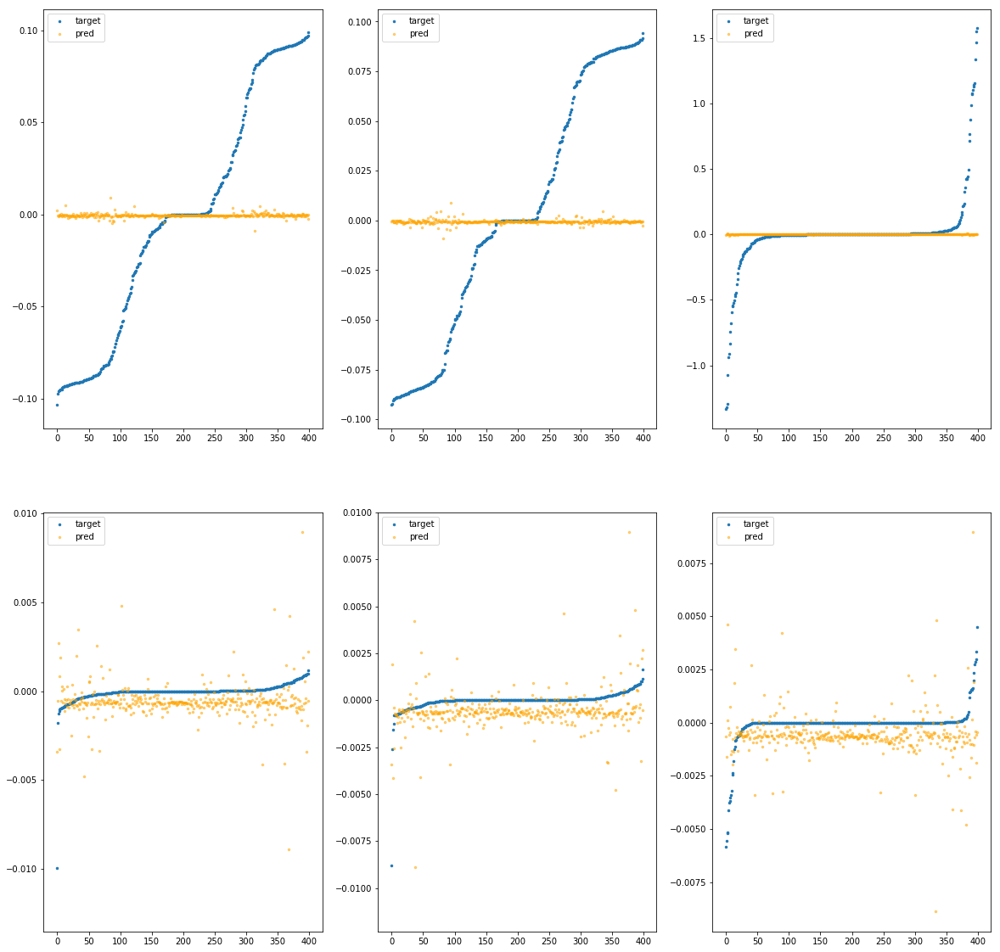

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf6d0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.31e-03	1.08e-01	5.16e-02	3.06e+03	4.08e-03	1.67e-05
y		-4.70e-03	9.26e-02	5.12e-02	1.64e+02	3.85e-03	1.48e-05
z		2.70e-04	1.57e+00	1.02e-01	7.18e+01	8.33e-02	6.94e-03
phi		-5.41e+00	1.42e-02	8.57e-04	5.08e+05	2.32e-06	5.38e-12
theta		-6.74e+00	1.24e-02	8.53e-04	1.30e+05	2.39e-06	5.71e-12
psi		-2.67e+00	1.45e-02	9.41e-04	7.41e+04	2.75e-06	7.56e-12


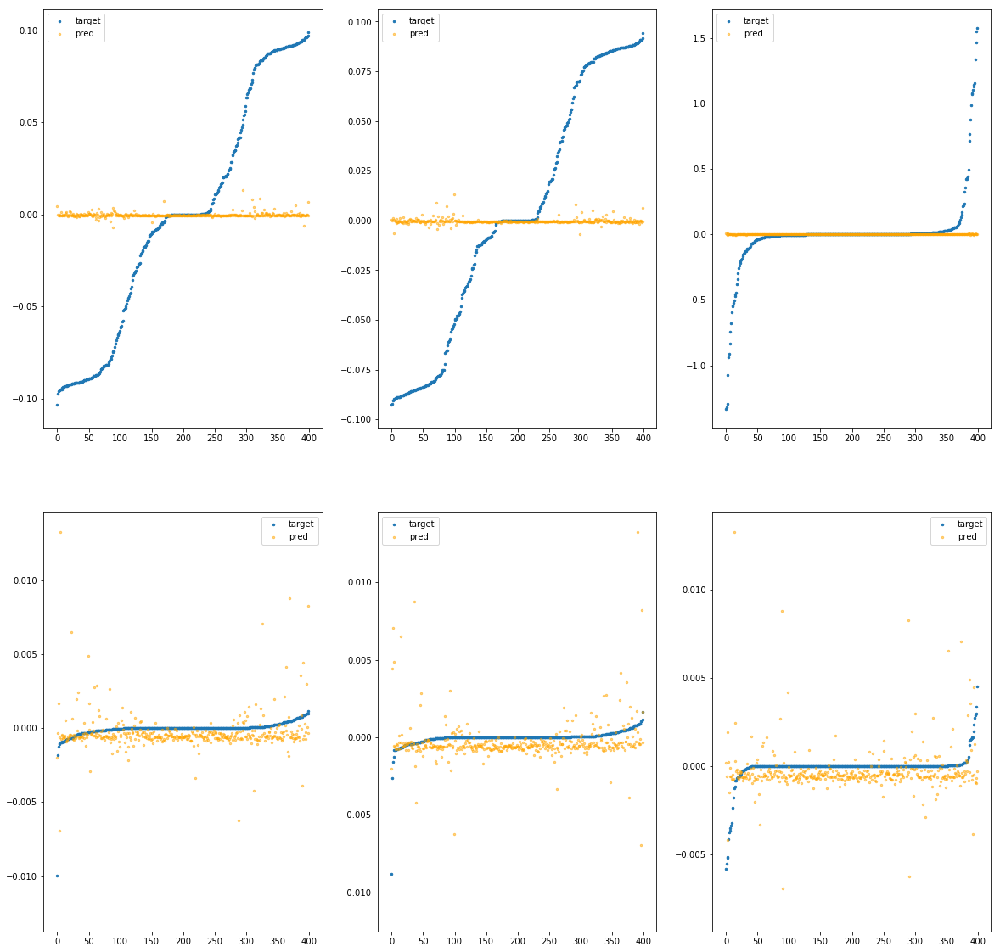

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf730>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.08e-01	5.17e-02	4.27e+03	4.09e-03	1.68e-05
y		-5.64e-03	9.39e-02	5.12e-02	2.18e+02	3.86e-03	1.49e-05
z		-7.48e-04	1.57e+00	1.02e-01	1.00e+02	8.34e-02	6.95e-03
phi		-5.85e+00	9.89e-03	1.05e-03	7.12e+05	2.48e-06	6.15e-12
theta		-6.97e+00	1.16e-02	1.04e-03	1.74e+05	2.46e-06	6.07e-12
psi		-2.84e+00	1.05e-02	1.12e-03	1.03e+05	2.88e-06	8.32e-12


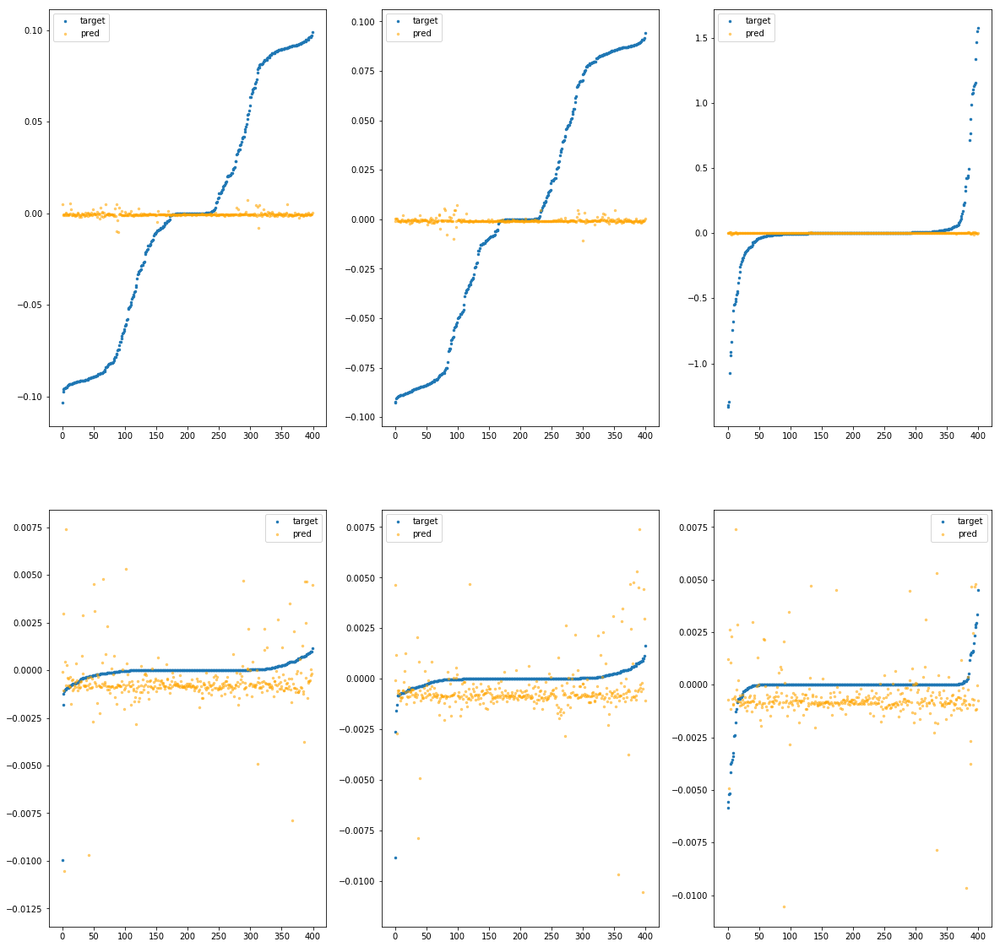

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bbf790>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.95e-03	1.08e-01	5.19e-02	5.28e+03	4.12e-03	1.70e-05
y		-1.21e-02	9.71e-02	5.14e-02	2.74e+02	3.88e-03	1.51e-05
z		-1.18e-03	1.58e+00	1.02e-01	1.25e+02	8.34e-02	6.96e-03
phi		-1.12e+01	2.07e-02	1.30e-03	8.85e+05	4.42e-06	1.95e-11
theta		-1.34e+01	2.10e-02	1.30e-03	2.25e+05	4.44e-06	1.97e-11
psi		-5.16e+00	1.99e-02	1.38e-03	1.26e+05	4.62e-06	2.14e-11


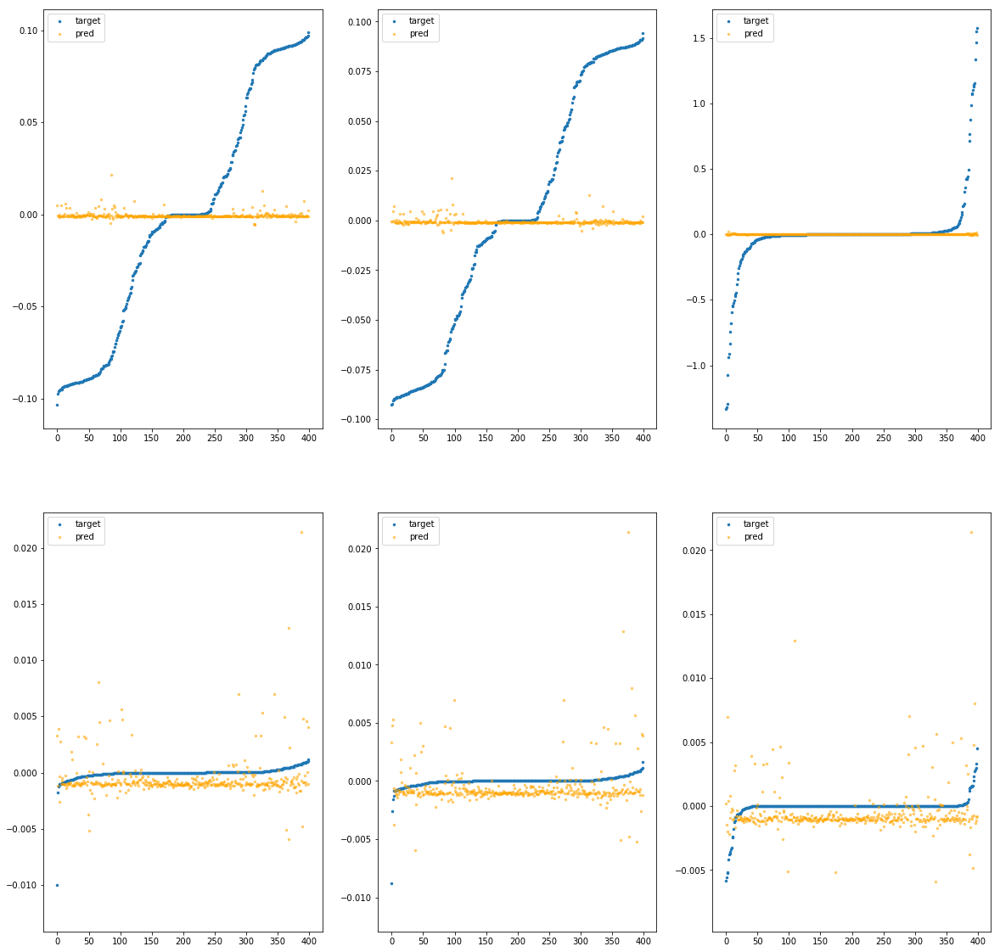

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbf7f0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.75e-03	1.05e-01	5.22e-02	1.52e+04	4.10e-03	1.68e-05
y		7.37e-04	9.62e-02	5.15e-02	7.80e+02	3.83e-03	1.47e-05
z		1.19e-04	1.57e+00	1.03e-01	3.64e+02	8.33e-02	6.94e-03
phi		-2.56e+01	9.13e-03	2.99e-03	2.57e+06	9.63e-06	9.27e-11
theta		-2.96e+01	7.98e-03	2.97e-03	6.63e+05	9.44e-06	8.91e-11
psi		-1.29e+01	1.03e-02	3.05e-03	3.51e+05	1.04e-05	1.08e-10


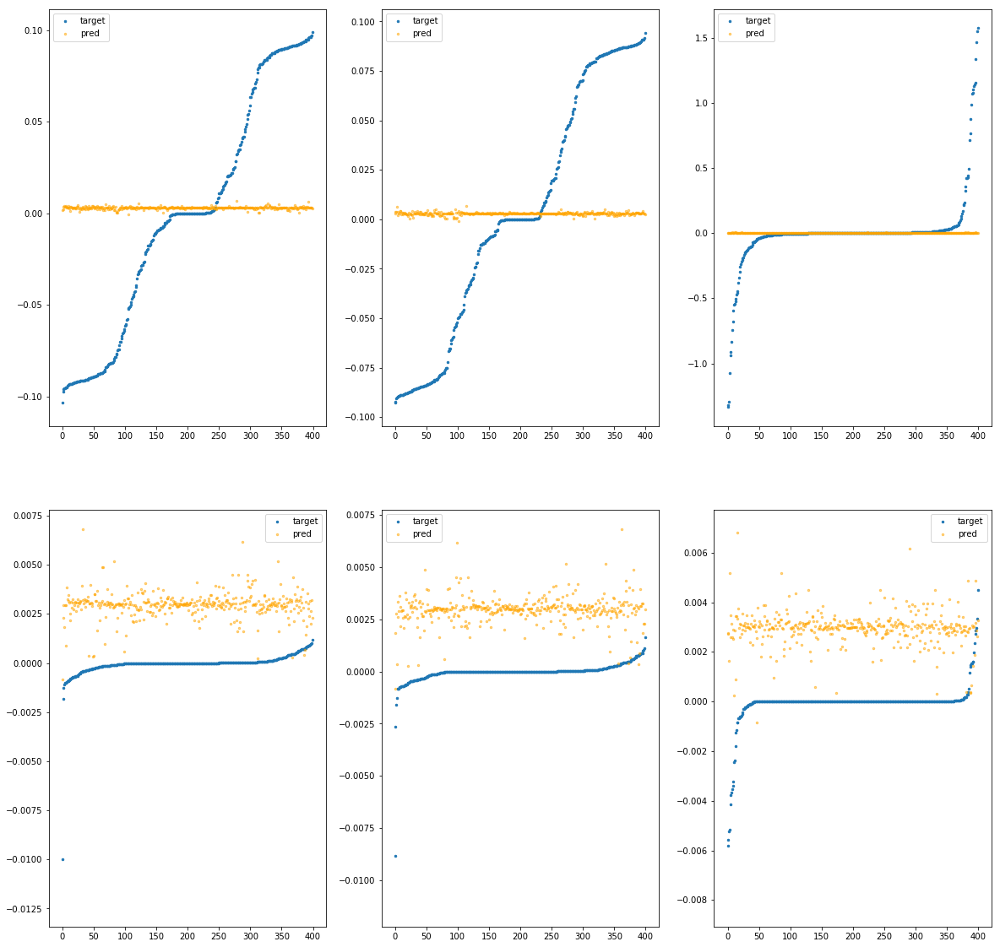

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbf850>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		2.94e-04	1.04e-01	5.17e-02	4.75e+02	4.09e-03	1.68e-05
y		-1.59e-03	9.30e-02	5.11e-02	1.76e+01	3.84e-03	1.47e-05
z		3.78e-04	1.57e+00	1.02e-01	1.05e+01	8.33e-02	6.94e-03
phi		-9.75e-01	7.47e-03	4.42e-04	8.02e+04	7.15e-07	5.11e-13
theta		-1.03e+00	6.32e-03	4.13e-04	1.91e+04	6.27e-07	3.93e-13
psi		-5.18e-01	6.86e-03	4.96e-04	1.75e+04	1.14e-06	1.30e-12


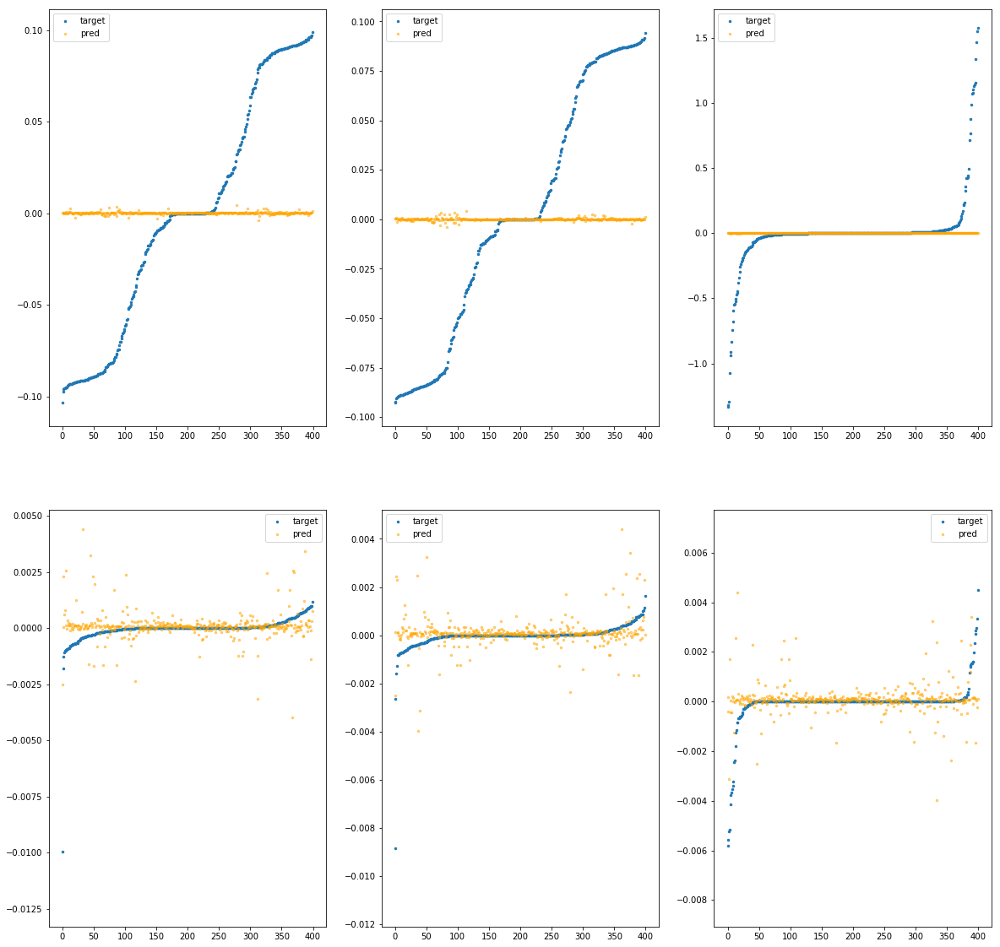

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbf8b0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.53e-03	1.03e-01	5.17e-02	1.58e+03	4.09e-03	1.67e-05
y		-1.25e-03	9.35e-02	5.11e-02	8.00e+01	3.84e-03	1.47e-05
z		-5.30e-04	1.57e+00	1.02e-01	3.62e+01	8.34e-02	6.95e-03
phi		-6.07e-01	9.03e-03	4.64e-04	2.42e+05	5.82e-07	3.38e-13
theta		-6.53e-01	7.88e-03	4.47e-04	6.57e+04	5.11e-07	2.61e-13
psi		-3.46e-01	6.40e-03	5.54e-04	2.80e+04	1.01e-06	1.02e-12


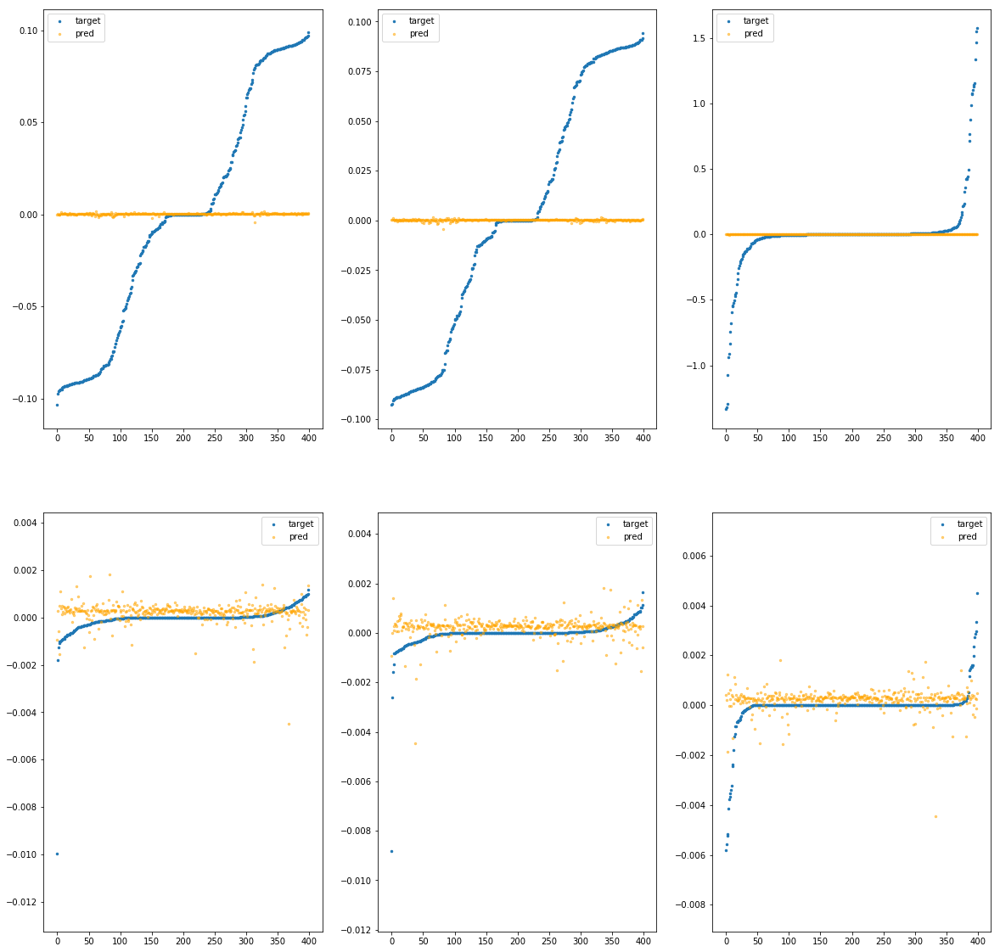

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbf910>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.75e-03	1.05e-01	5.17e-02	2.78e+03	4.09e-03	1.67e-05
y		-8.69e-04	9.31e-02	5.11e-02	1.37e+02	3.84e-03	1.47e-05
z		-2.09e-04	1.57e+00	1.02e-01	6.33e+01	8.33e-02	6.94e-03
phi		-1.44e+00	6.59e-03	6.72e-04	4.52e+05	8.84e-07	7.82e-13
theta		-1.50e+00	5.44e-03	6.37e-04	1.19e+05	7.71e-07	5.94e-13
psi		-8.16e-01	5.81e-03	7.85e-04	6.32e+04	1.36e-06	1.85e-12


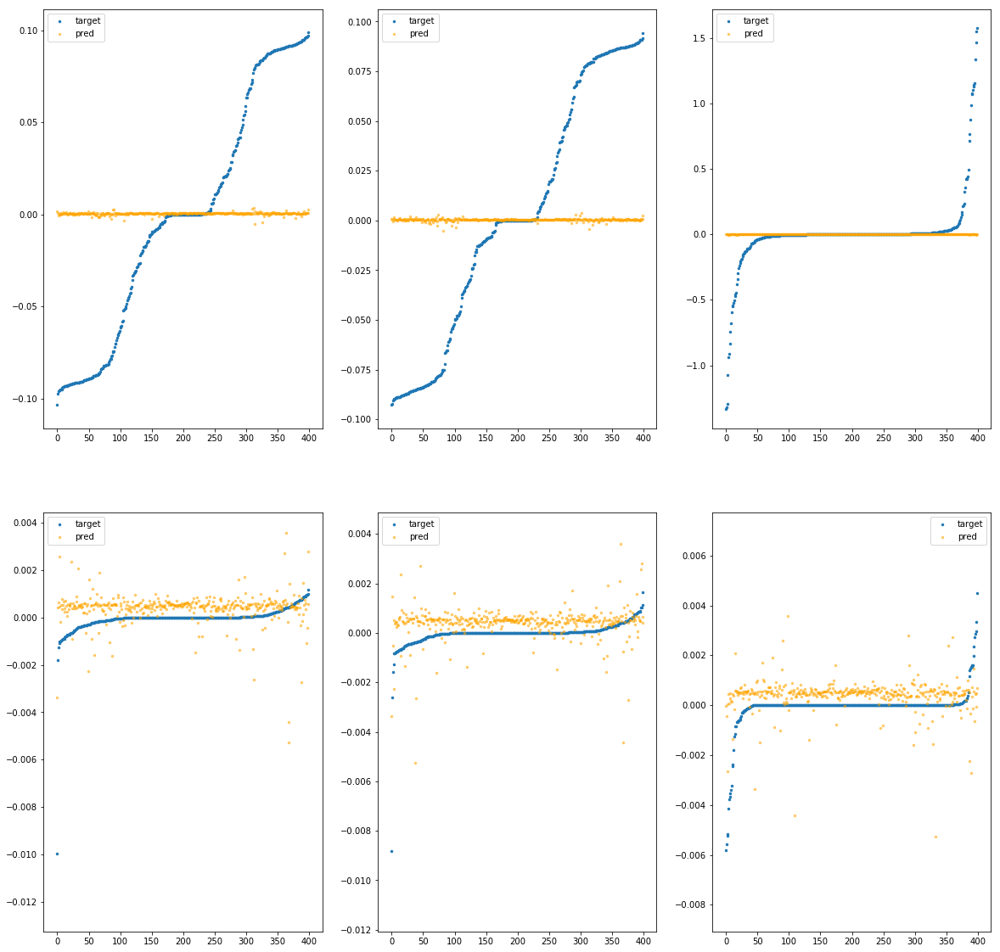

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbf970>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.71e-03	1.03e-01	5.16e-02	2.31e+02	4.09e-03	1.67e-05
y		-1.55e-03	9.44e-02	5.11e-02	4.59e+00	3.84e-03	1.47e-05
z		-4.12e-04	1.57e+00	1.02e-01	7.02e+00	8.34e-02	6.95e-03
phi		-1.60e+00	7.06e-03	4.99e-04	5.14e+04	9.40e-07	8.84e-13
theta		-1.95e+00	6.79e-03	4.75e-04	4.99e+03	9.10e-07	8.29e-13
psi		-8.80e-01	6.78e-03	5.57e-04	2.48e+04	1.41e-06	1.99e-12


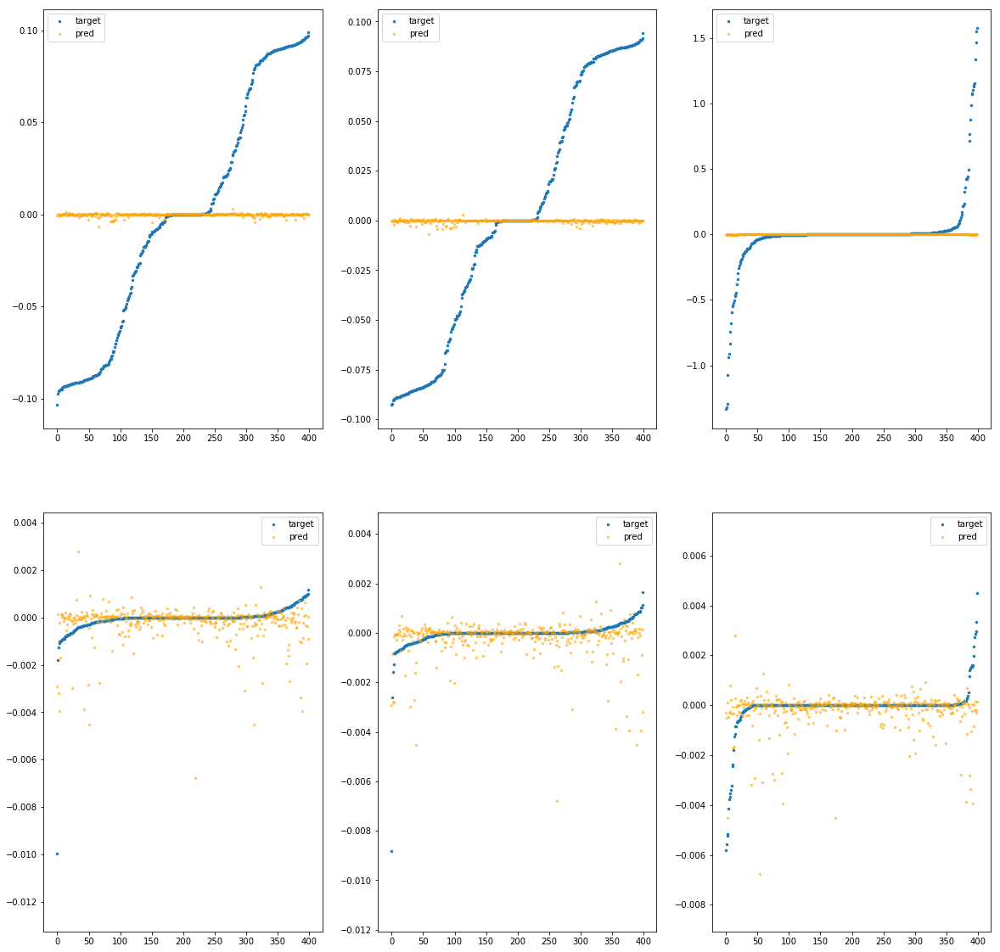

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbf9d0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.79e-03	1.02e-01	5.24e-02	2.82e+04	4.11e-03	1.69e-05
y		-2.09e-02	9.79e-02	5.20e-02	1.45e+03	3.91e-03	1.53e-05
z		-1.39e-03	1.58e+00	1.04e-01	6.75e+02	8.34e-02	6.96e-03
phi		-8.43e+01	9.56e-03	5.52e-03	4.76e+06	3.09e-05	9.55e-10
theta		-9.95e+01	8.73e-03	5.53e-03	1.21e+06	3.11e-05	9.64e-10
psi		-4.03e+01	9.89e-03	5.48e-03	6.84e+05	3.10e-05	9.58e-10


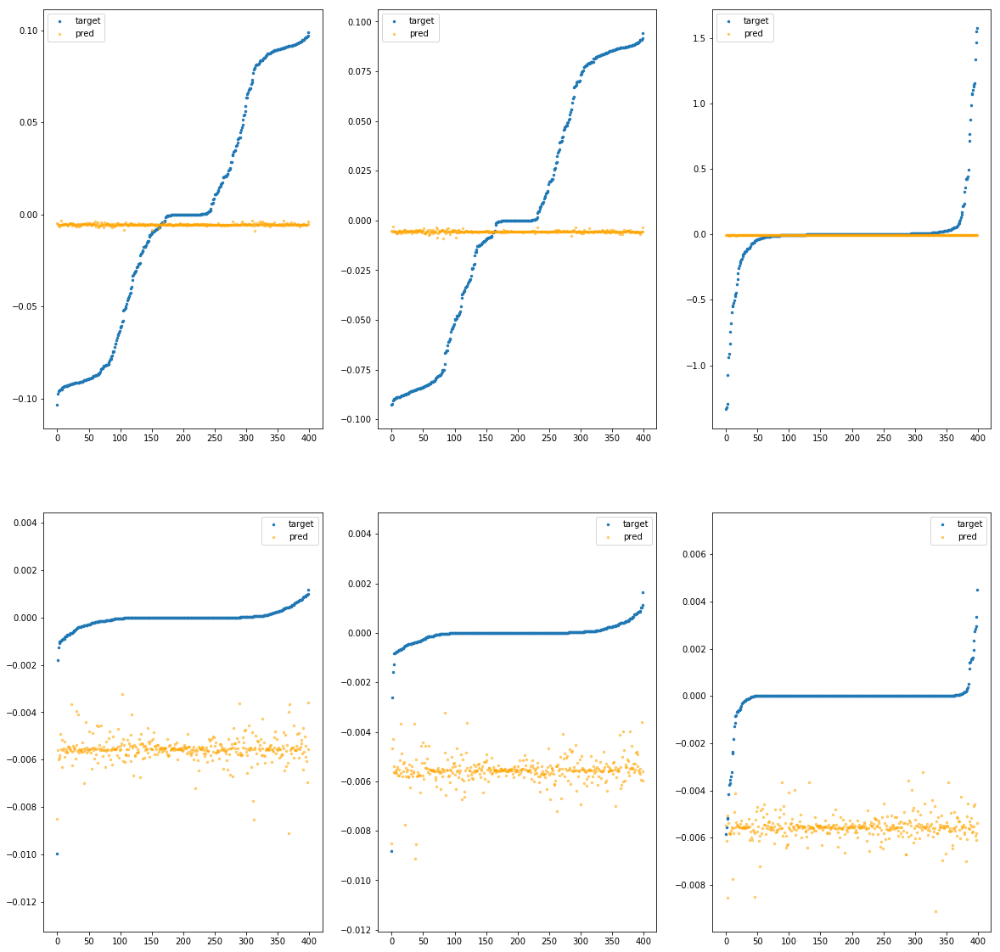

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbfa30>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.85e-03	1.07e-01	5.25e-02	2.26e+04	4.11e-03	1.69e-05
y		5.86e-04	9.71e-02	5.18e-02	1.14e+03	3.83e-03	1.47e-05
z		-5.73e-04	1.57e+00	1.03e-01	5.36e+02	8.34e-02	6.95e-03
phi		-5.43e+01	1.39e-02	4.39e-03	3.80e+06	2.00e-05	4.01e-10
theta		-6.31e+01	1.27e-02	4.37e-03	9.72e+05	1.98e-05	3.92e-10
psi		-2.65e+01	9.68e-03	4.42e-03	5.51e+05	2.06e-05	4.25e-10


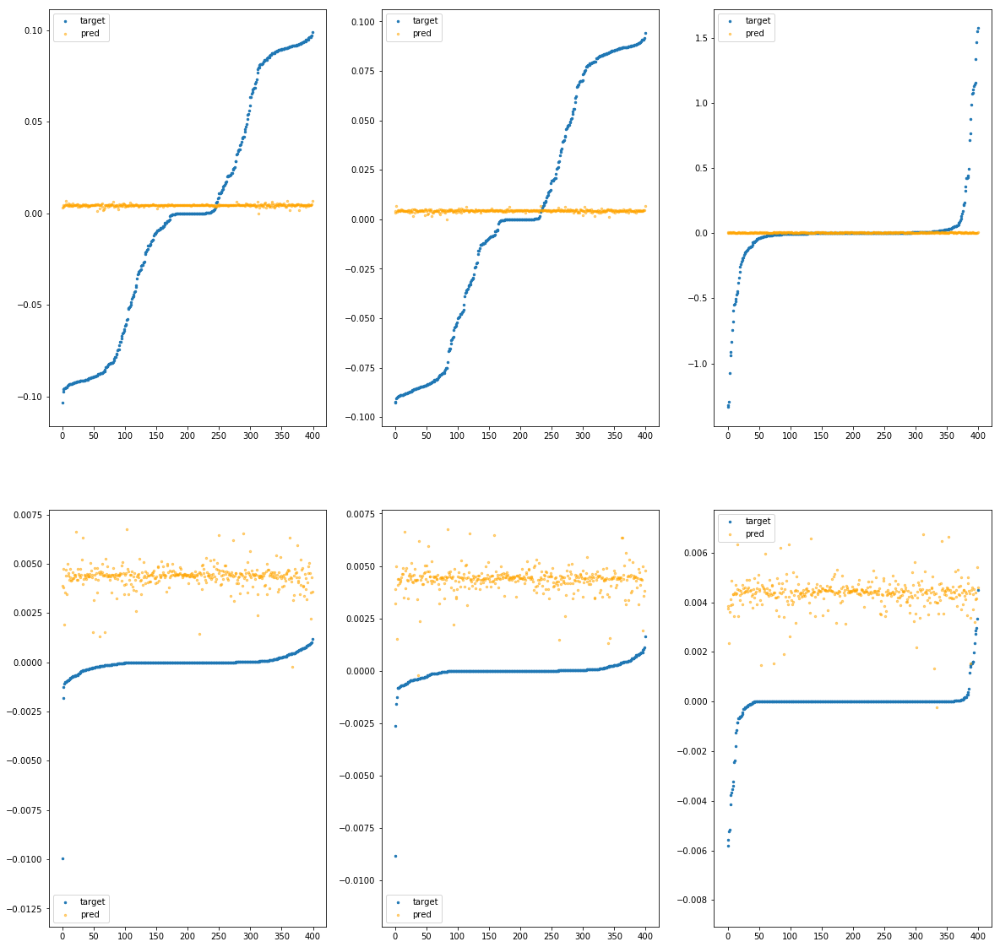

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbfa90>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.96e-03	1.05e-01	5.26e-02	3.39e+04	4.13e-03	1.70e-05
y		-2.54e-02	1.01e-01	5.23e-02	1.74e+03	3.93e-03	1.55e-05
z		-2.01e-03	1.58e+00	1.04e-01	8.04e+02	8.35e-02	6.97e-03
phi		-1.22e+02	1.10e-02	6.61e-03	5.71e+06	4.44e-05	1.97e-09
theta		-1.43e+02	1.06e-02	6.62e-03	1.45e+06	4.44e-05	1.97e-09
psi		-5.80e+01	1.12e-02	6.57e-03	8.14e+05	4.43e-05	1.96e-09


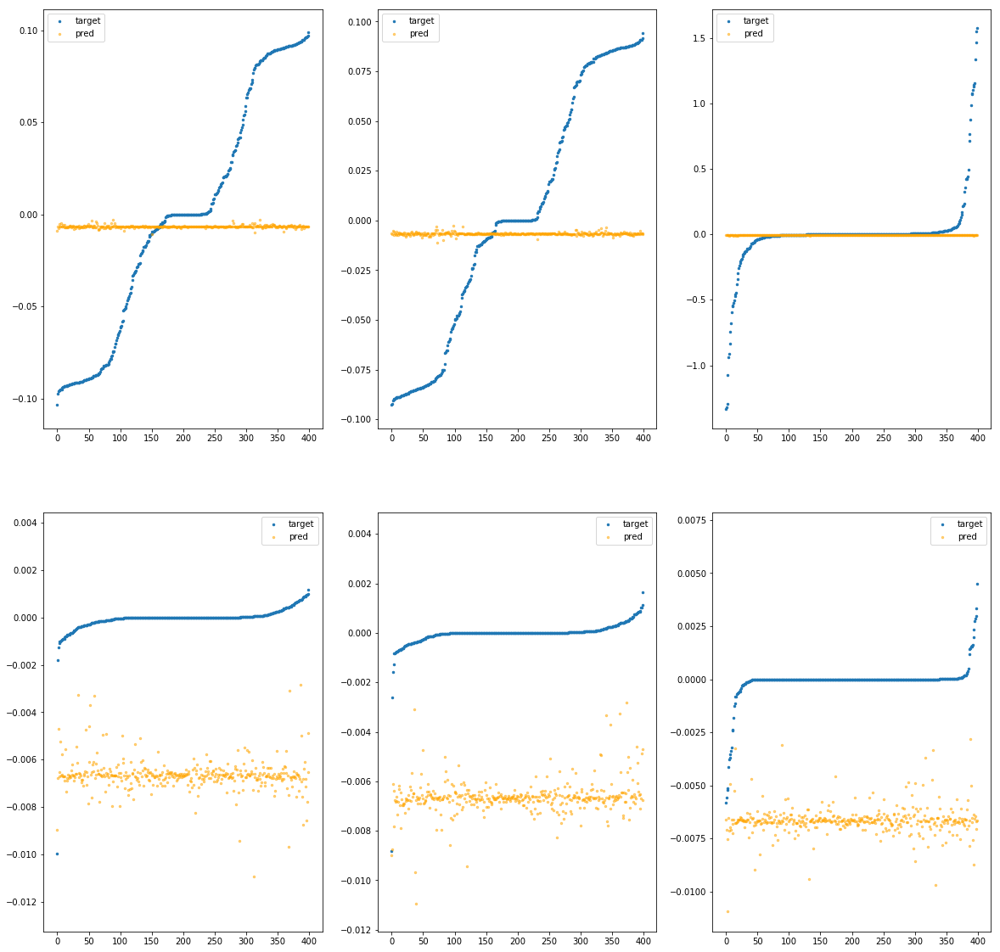

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbfaf0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		6.18e-04	1.04e-01	5.16e-02	4.47e+02	4.09e-03	1.67e-05
y		-2.11e-03	9.28e-02	5.11e-02	2.81e+01	3.84e-03	1.48e-05
z		8.64e-05	1.57e+00	1.02e-01	1.43e+01	8.33e-02	6.94e-03
phi		-1.20e+00	7.99e-03	4.60e-04	8.80e+04	7.98e-07	6.37e-13
theta		-1.23e+00	6.84e-03	4.43e-04	1.84e+04	6.87e-07	4.73e-13
psi		-4.91e-01	6.58e-03	5.06e-04	2.55e+04	1.12e-06	1.25e-12


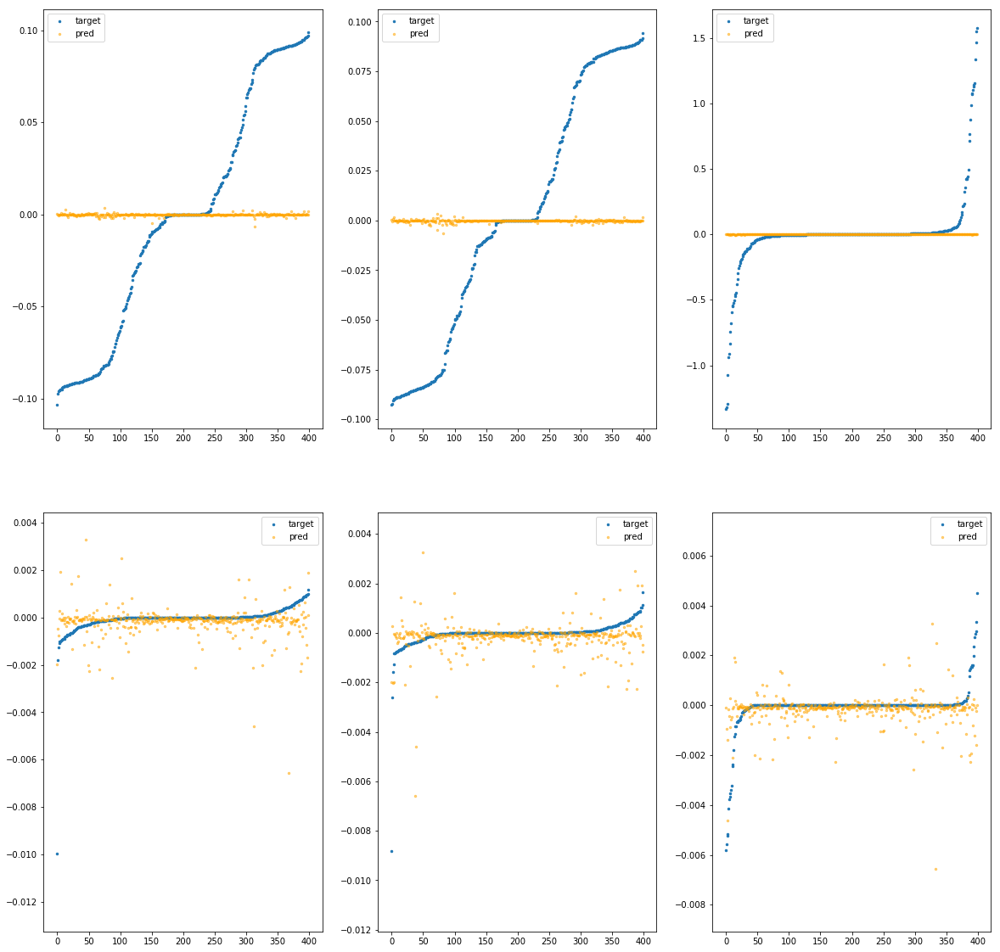

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbfb50>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.93e-04	1.03e-01	5.17e-02	1.16e+03	4.10e-03	1.68e-05
y		-3.42e-03	9.32e-02	5.12e-02	5.83e+01	3.85e-03	1.48e-05
z		-6.78e-04	1.57e+00	1.02e-01	2.75e+01	8.34e-02	6.95e-03
phi		-1.22e+00	8.51e-03	5.19e-04	1.86e+05	8.04e-07	6.47e-13
theta		-1.48e+00	7.36e-03	5.09e-04	5.06e+04	7.65e-07	5.85e-13
psi		-7.92e-01	9.11e-03	5.99e-04	2.66e+04	1.34e-06	1.81e-12


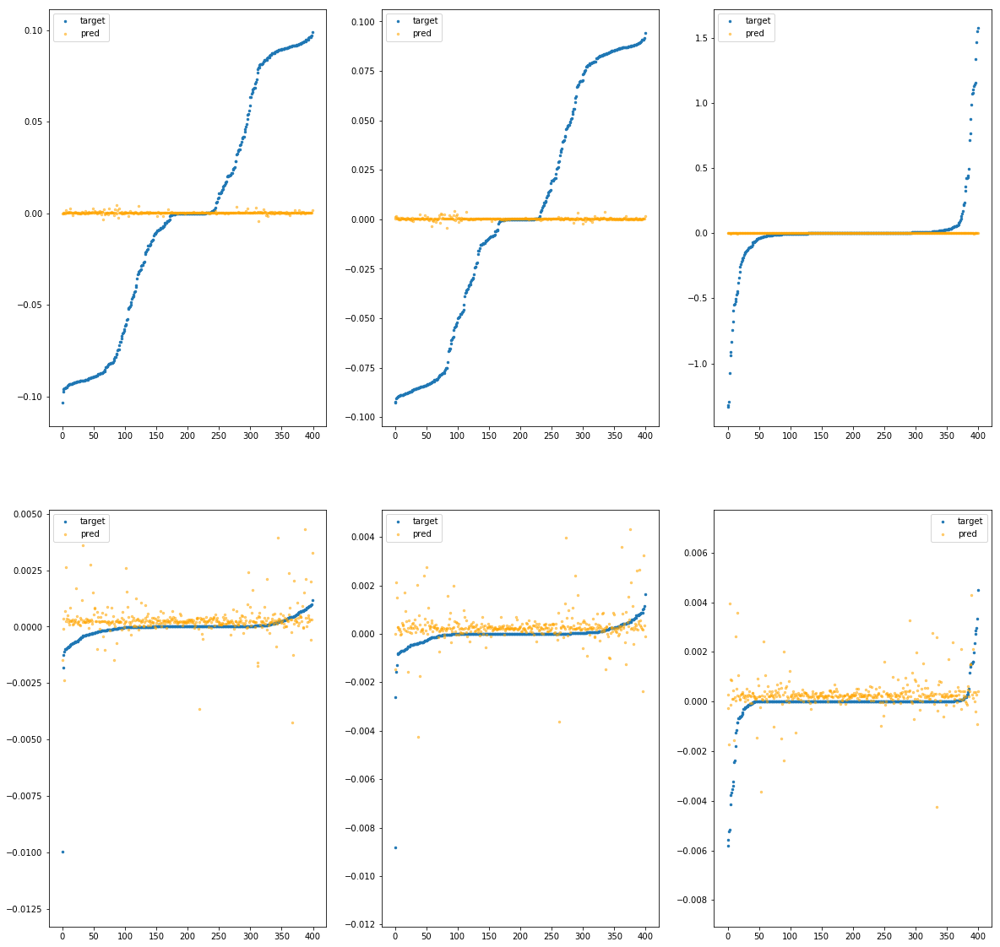

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbfbb0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.09e-03	1.02e-01	5.19e-02	7.58e+03	4.09e-03	1.67e-05
y		2.10e-04	9.40e-02	5.13e-02	3.80e+02	3.83e-03	1.47e-05
z		-7.13e-04	1.57e+00	1.02e-01	1.78e+02	8.34e-02	6.95e-03
phi		-6.64e+00	8.44e-03	1.51e-03	1.26e+06	2.77e-06	7.65e-12
theta		-7.35e+00	7.29e-03	1.48e-03	3.21e+05	2.58e-06	6.66e-12
psi		-3.47e+00	7.21e-03	1.62e-03	1.78e+05	3.35e-06	1.12e-11


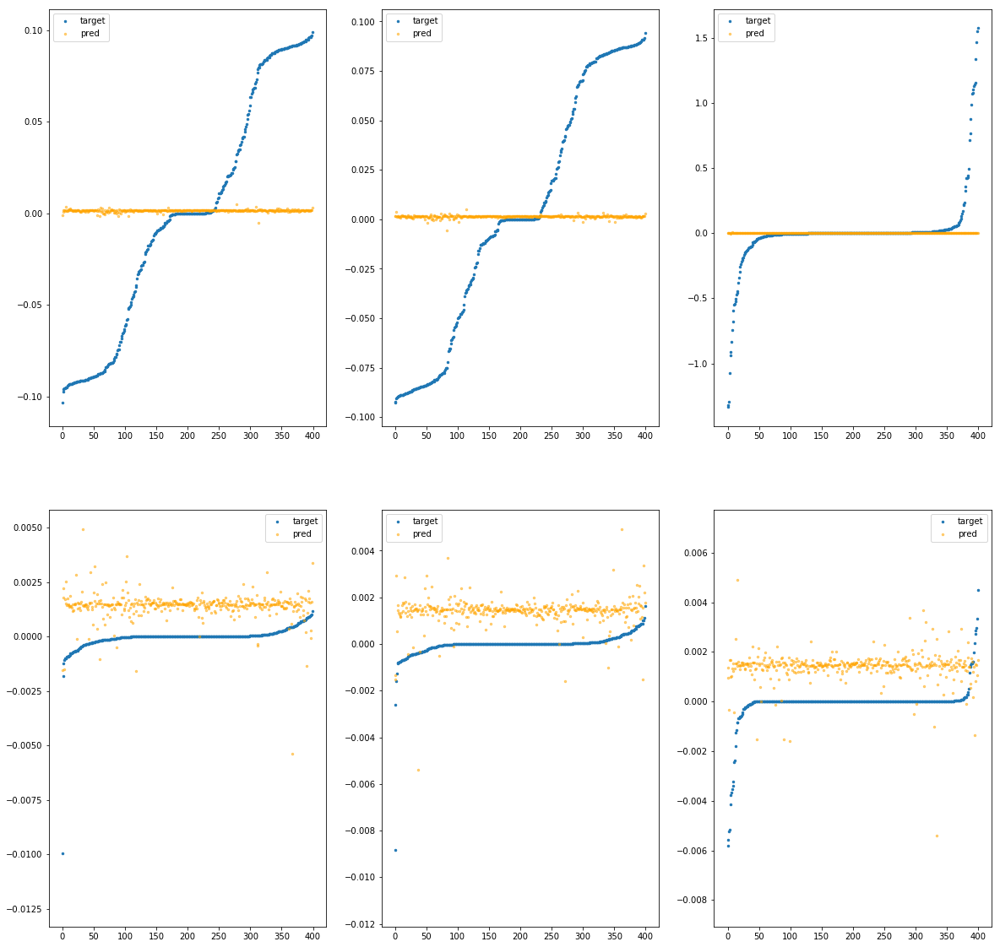

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbfc10>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.54e-02	1.07e-01	5.30e-02	4.36e+04	4.16e-03	1.73e-05
y		-3.64e-02	1.02e-01	5.26e-02	2.23e+03	3.97e-03	1.58e-05
z		-3.19e-03	1.58e+00	1.05e-01	1.04e+03	8.36e-02	6.99e-03
phi		-2.09e+02	2.08e-02	8.65e-03	7.33e+06	7.59e-05	5.77e-09
theta		-2.45e+02	1.99e-02	8.67e-03	1.87e+06	7.60e-05	5.78e-09
psi		-1.00e+02	2.03e-02	8.62e-03	1.06e+06	7.59e-05	5.75e-09


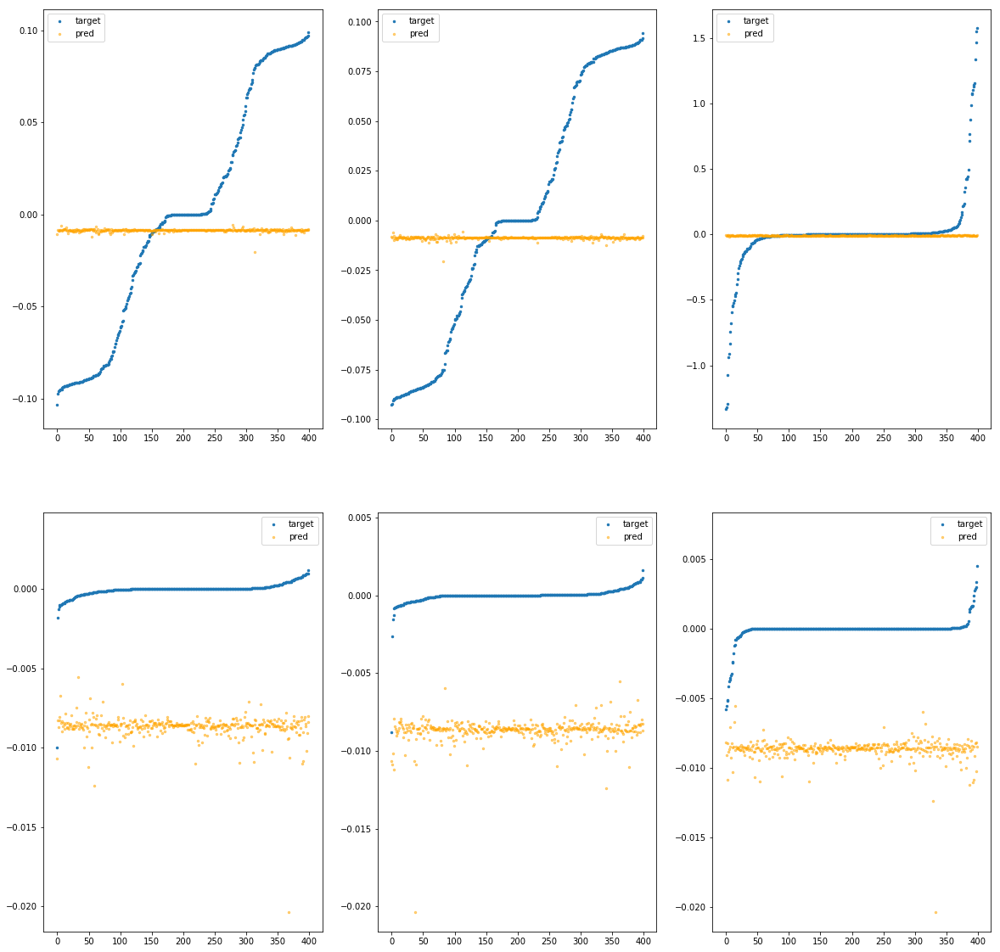

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbfc70>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.31e-04	1.04e-01	5.18e-02	5.51e+03	4.10e-03	1.68e-05
y		-1.72e-03	9.36e-02	5.13e-02	2.84e+02	3.84e-03	1.48e-05
z		-4.58e-04	1.57e+00	1.02e-01	1.31e+02	8.34e-02	6.95e-03
phi		-3.75e+00	9.50e-03	1.15e-03	9.18e+05	1.72e-06	2.95e-12
theta		-4.16e+00	8.35e-03	1.13e-03	2.37e+05	1.59e-06	2.54e-12
psi		-1.97e+00	7.36e-03	1.25e-03	1.29e+05	2.23e-06	4.97e-12


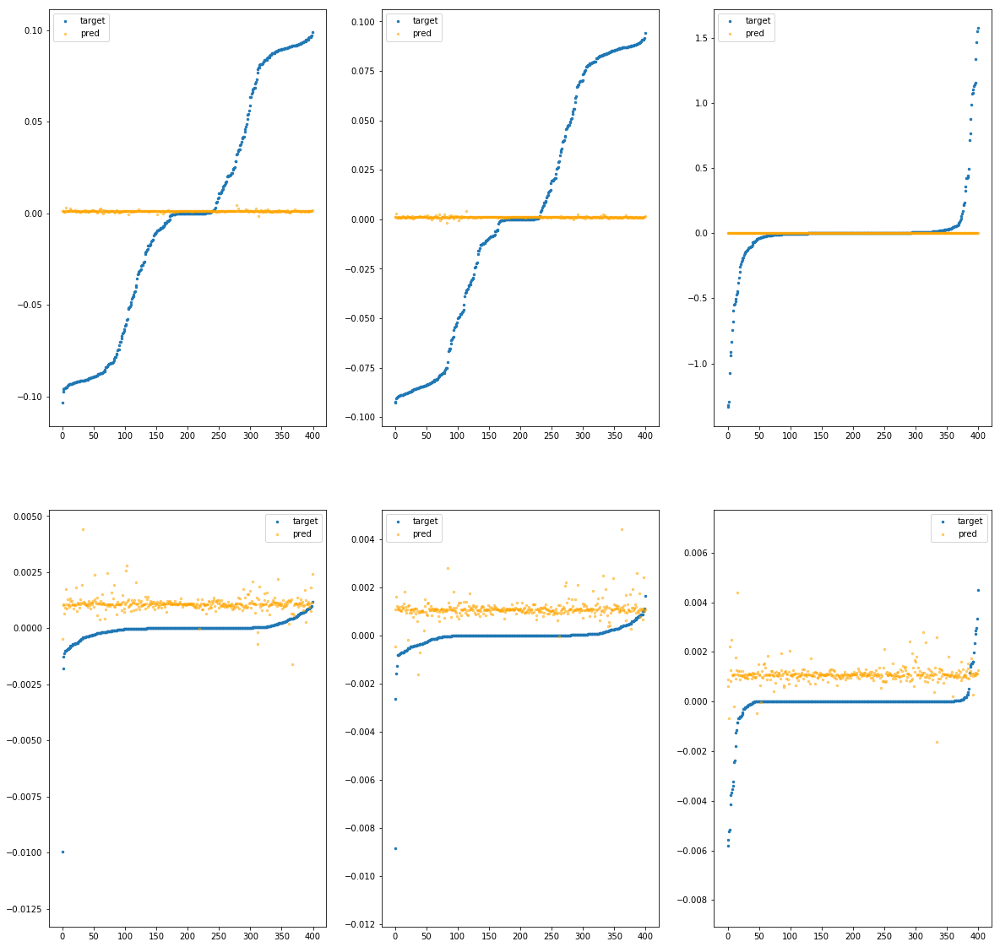

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbfcd0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		7.91e-04	9.89e-02	5.18e-02	7.93e+03	4.09e-03	1.67e-05
y		-5.24e-03	9.44e-02	5.13e-02	4.24e+02	3.85e-03	1.49e-05
z		-8.79e-04	1.57e+00	1.02e-01	1.94e+02	8.34e-02	6.95e-03
phi		-8.18e+00	6.80e-03	1.66e-03	1.36e+06	3.32e-06	1.10e-11
theta		-9.67e+00	6.35e-03	1.67e-03	3.48e+05	3.30e-06	1.09e-11
psi		-4.01e+00	6.84e-03	1.72e-03	1.84e+05	3.76e-06	1.41e-11


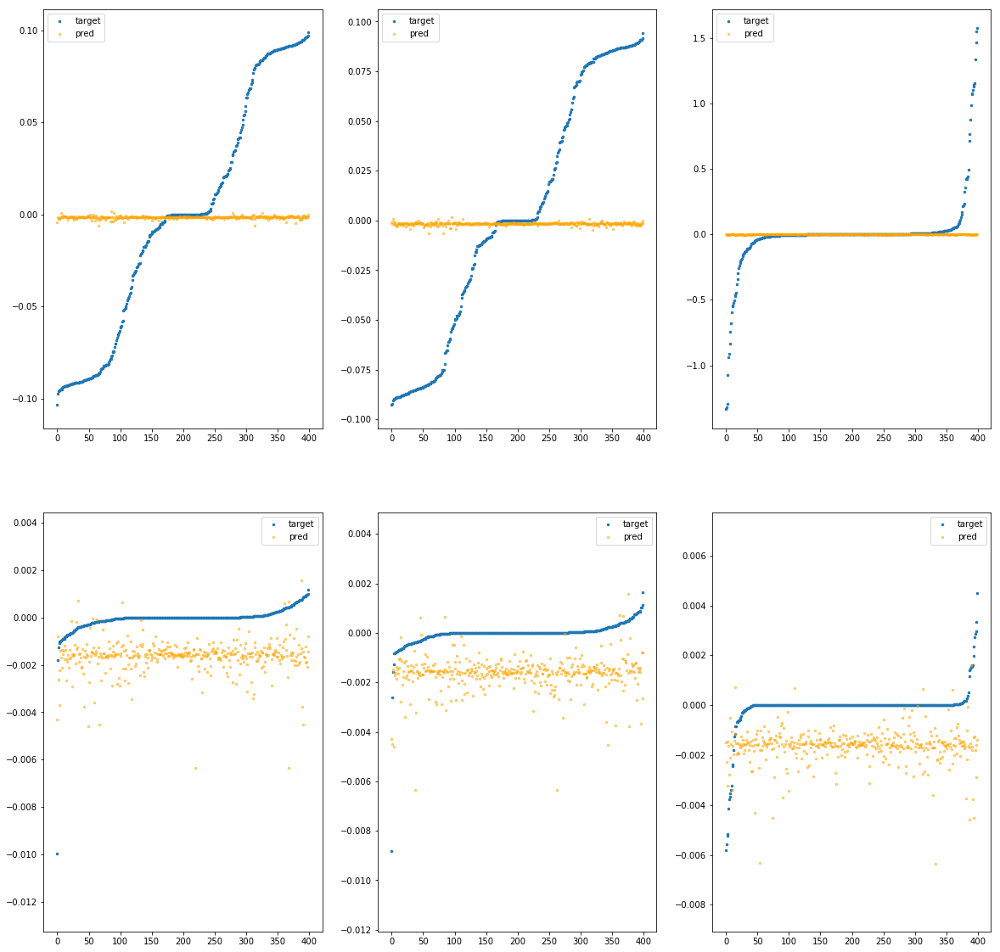

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbfd30>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.76e-04	1.03e-01	5.18e-02	2.62e+03	4.10e-03	1.68e-05
y		-1.81e-03	9.32e-02	5.12e-02	1.28e+02	3.84e-03	1.48e-05
z		-1.33e-03	1.57e+00	1.02e-01	6.05e+01	8.34e-02	6.96e-03
phi		-2.03e+00	8.12e-03	7.35e-04	4.33e+05	1.10e-06	1.20e-12
theta		-2.30e+00	6.97e-03	7.09e-04	1.09e+05	1.02e-06	1.04e-12
psi		-1.05e+00	6.28e-03	8.40e-04	6.34e+04	1.54e-06	2.37e-12


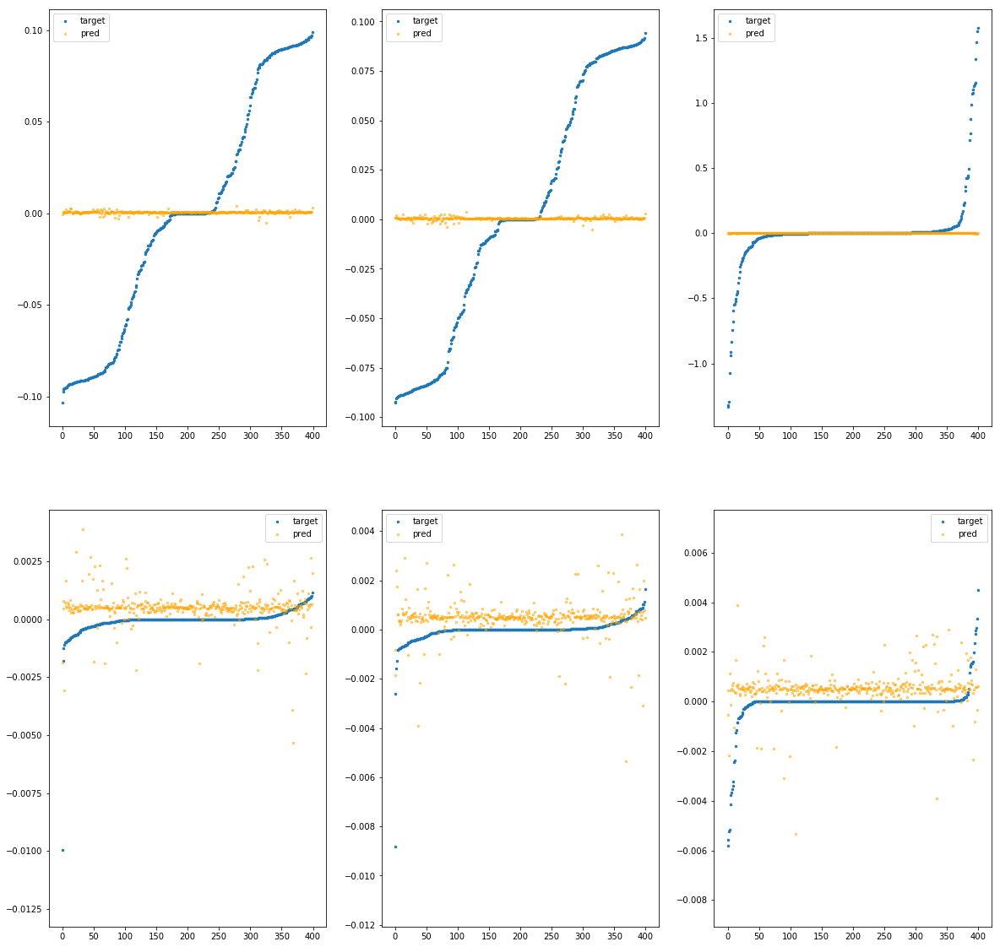

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbfd90>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.76e-04	1.04e-01	5.19e-02	6.48e+03	4.09e-03	1.68e-05
y		-5.63e-04	9.39e-02	5.13e-02	3.22e+02	3.84e-03	1.47e-05
z		-7.62e-05	1.57e+00	1.02e-01	1.50e+02	8.33e-02	6.94e-03
phi		-5.17e+00	8.97e-03	1.32e-03	1.07e+06	2.23e-06	4.99e-12
theta		-5.77e+00	7.82e-03	1.31e-03	2.74e+05	2.09e-06	4.37e-12
psi		-2.60e+00	7.20e-03	1.42e-03	1.55e+05	2.70e-06	7.28e-12


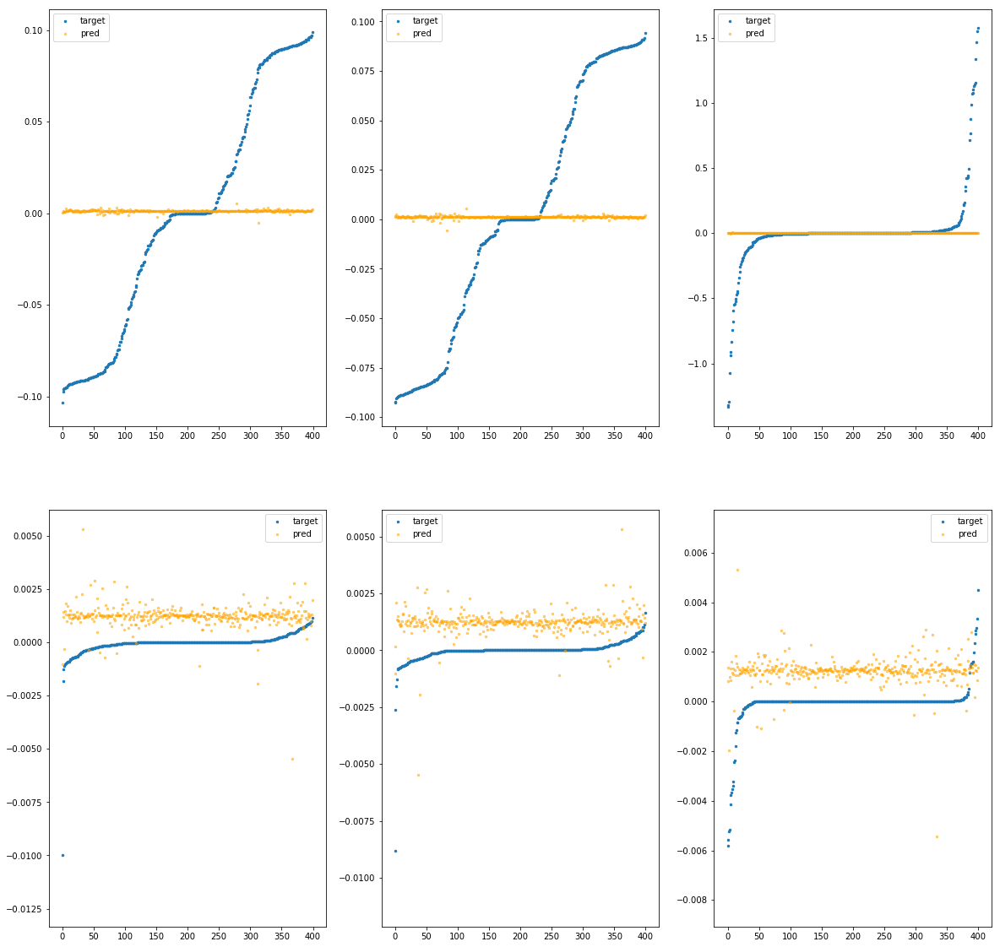

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbfdf0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.16e-04	1.02e-01	5.17e-02	5.41e+02	4.10e-03	1.68e-05
y		-2.06e-03	9.29e-02	5.11e-02	1.59e+01	3.84e-03	1.48e-05
z		-1.13e-03	1.57e+00	1.02e-01	1.21e+01	8.34e-02	6.96e-03
phi		-1.06e+00	8.67e-03	4.48e-04	8.69e+04	7.45e-07	5.55e-13
theta		-9.87e-01	7.85e-03	4.15e-04	1.93e+04	6.14e-07	3.77e-13
psi		-7.01e-01	8.24e-03	5.26e-04	2.10e+04	1.28e-06	1.63e-12


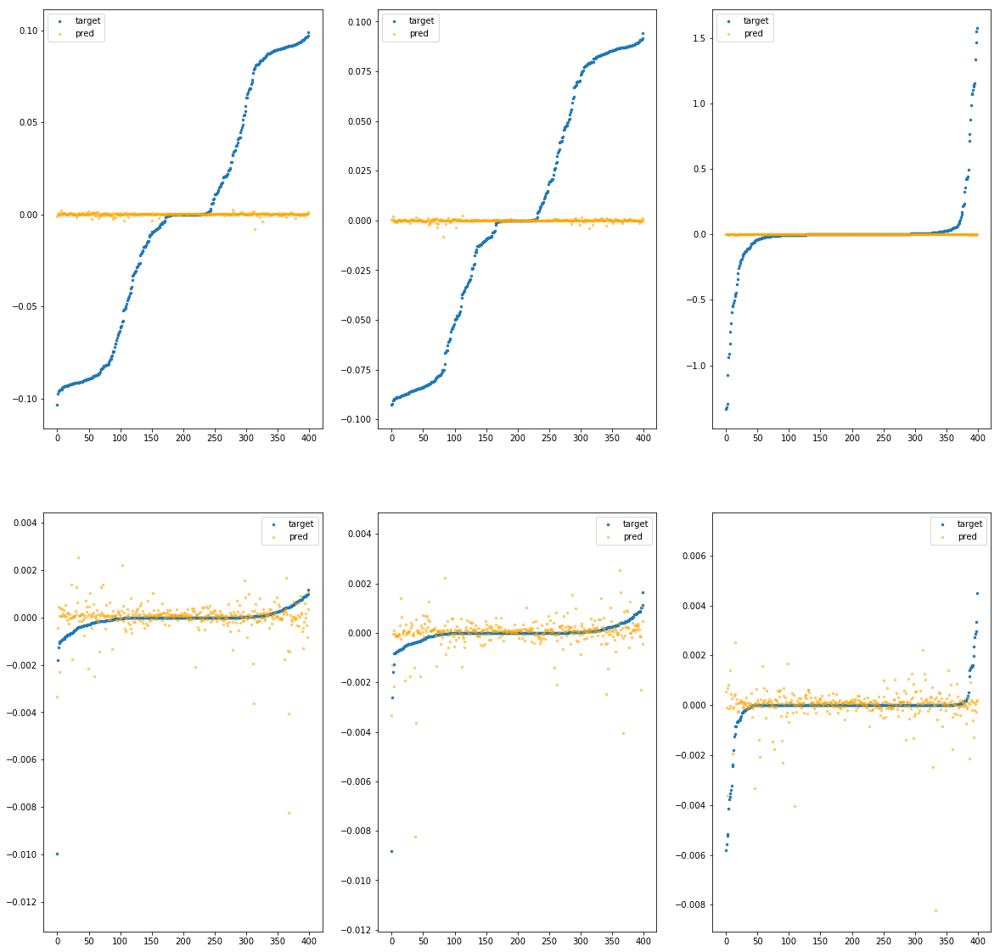

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbfe50>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.85e-03	1.03e-01	5.22e-02	2.38e+04	4.11e-03	1.69e-05
y		-1.69e-02	9.85e-02	5.19e-02	1.22e+03	3.90e-03	1.52e-05
z		-1.04e-03	1.58e+00	1.03e-01	5.69e+02	8.34e-02	6.96e-03
phi		-6.23e+01	9.87e-03	4.73e-03	4.00e+06	2.29e-05	5.26e-10
theta		-7.36e+01	9.04e-03	4.75e-03	1.02e+06	2.31e-05	5.31e-10
psi		-2.99e+01	9.44e-03	4.71e-03	5.71e+05	2.32e-05	5.36e-10


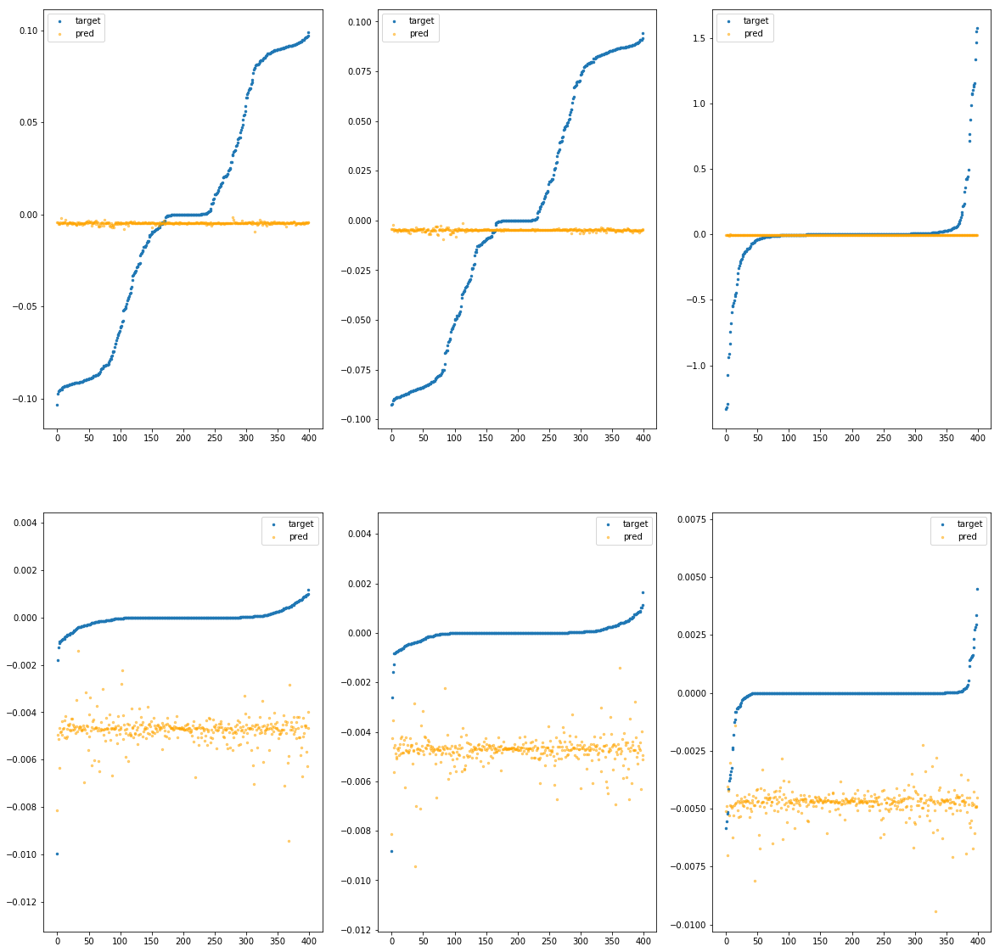

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbfeb0>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		2.06e-04	9.96e-02	5.19e-02	1.22e+04	4.09e-03	1.68e-05
y		-7.99e-03	9.52e-02	5.15e-02	6.27e+02	3.86e-03	1.49e-05
z		-1.07e-03	1.57e+00	1.02e-01	2.92e+02	8.34e-02	6.96e-03
phi		-1.68e+01	7.40e-03	2.43e-03	2.05e+06	6.44e-06	4.14e-11
theta		-1.98e+01	6.58e-03	2.44e-03	5.22e+05	6.42e-06	4.12e-11
psi		-7.85e+00	6.97e-03	2.44e-03	3.00e+05	6.64e-06	4.41e-11


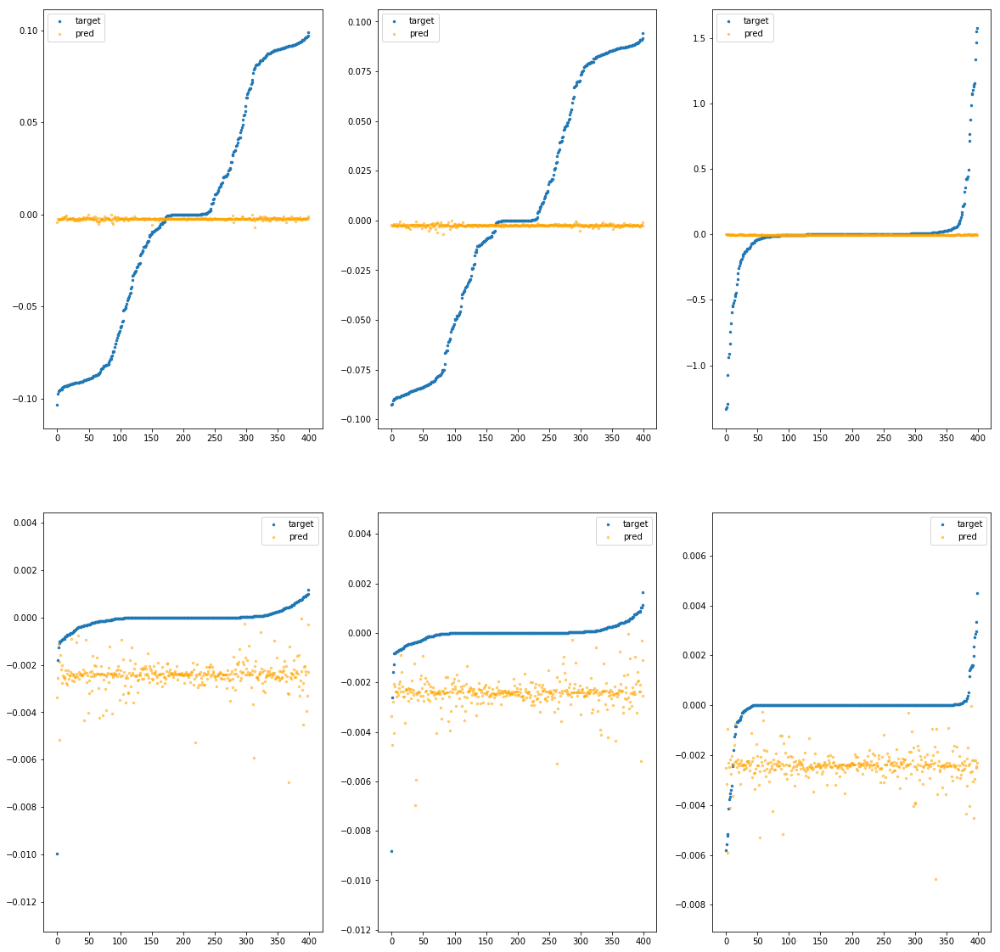

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51bbff10>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.66e-03	1.06e-01	5.26e-02	3.44e+04	4.13e-03	1.71e-05
y		-2.68e-02	1.02e-01	5.23e-02	1.76e+03	3.94e-03	1.55e-05
z		-2.43e-03	1.58e+00	1.04e-01	8.24e+02	8.35e-02	6.98e-03
phi		-1.31e+02	1.29e-02	6.87e-03	5.80e+06	4.79e-05	2.30e-09
theta		-1.54e+02	1.20e-02	6.89e-03	1.47e+06	4.80e-05	2.30e-09
psi		-6.30e+01	1.24e-02	6.84e-03	8.31e+05	4.80e-05	2.31e-09


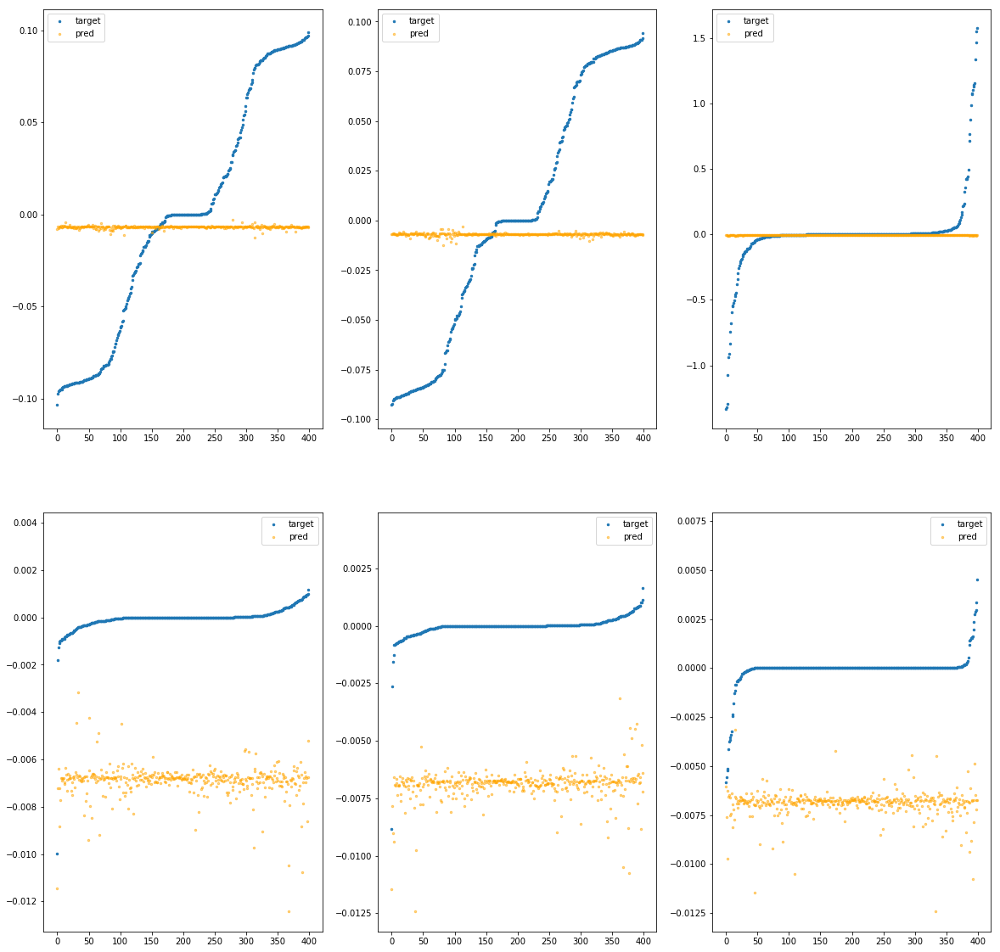

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bbff70>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.08e-04	1.03e-01	5.17e-02	1.74e+02	4.09e-03	1.68e-05
y		-2.91e-03	9.43e-02	5.11e-02	9.73e+00	3.85e-03	1.48e-05
z		-7.48e-04	1.57e+00	1.02e-01	4.84e+00	8.34e-02	6.95e-03
phi		-1.45e-05	9.94e-03	2.22e-04	2.90e+04	3.62e-07	1.31e-13
theta		-8.37e-04	8.79e-03	2.11e-04	7.40e+03	3.09e-07	9.56e-14
psi		-1.63e-03	5.80e-03	2.66e-04	4.16e+03	7.51e-07	5.64e-13


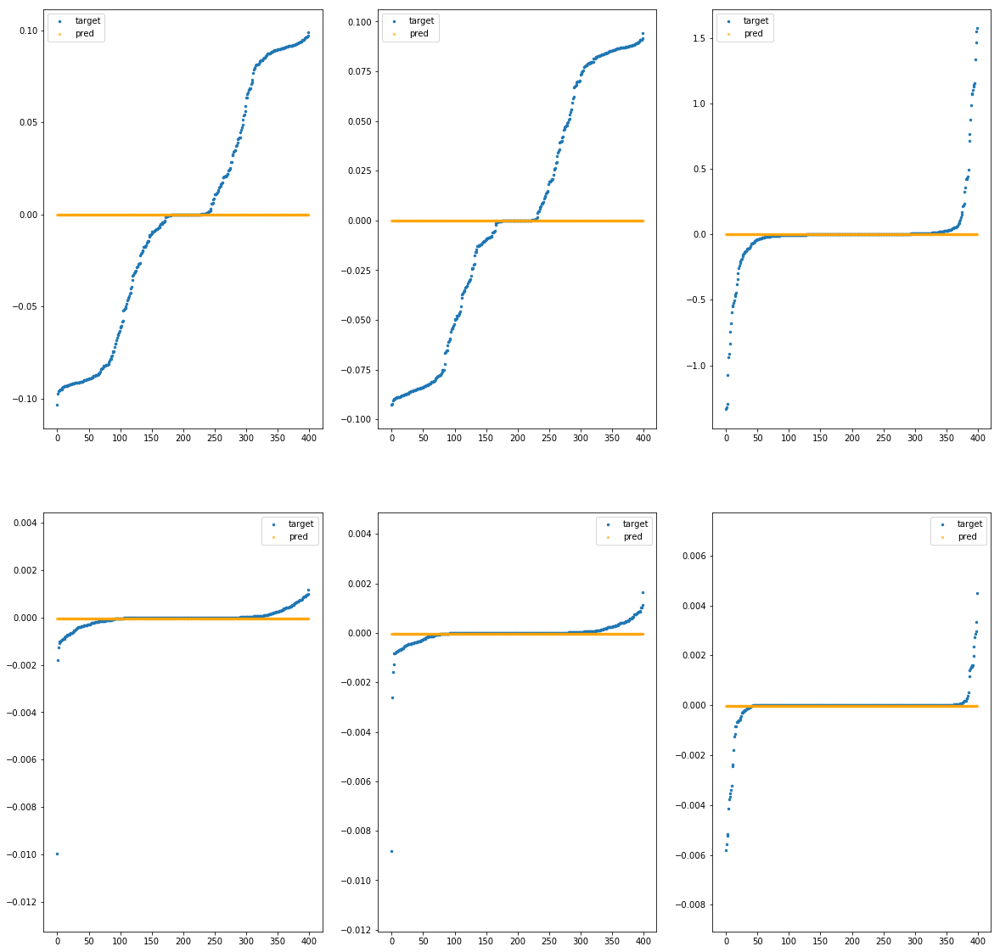

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bbffd0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.28e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.25e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.10e+00	8.34e-02	6.95e-03
phi		-1.89e-04	9.93e-03	2.27e-04	3.81e+04	3.62e-07	1.31e-13
theta		-2.30e-03	8.78e-03	2.17e-04	9.71e+03	3.10e-07	9.58e-14
psi		-7.91e-04	5.78e-03	2.75e-04	5.45e+03	7.51e-07	5.63e-13


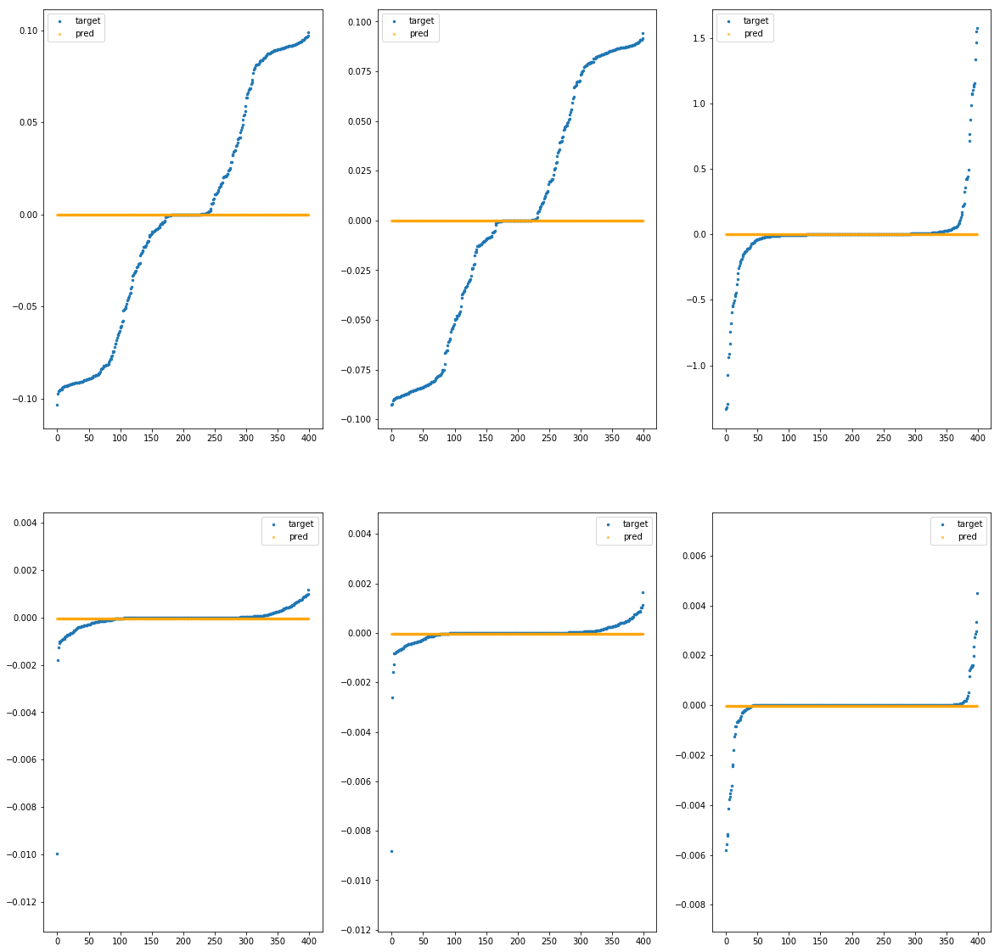

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca070>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.01e-04	1.03e-01	5.17e-02	2.94e+02	4.09e-03	1.68e-05
y		-2.95e-03	9.43e-02	5.11e-02	1.58e+01	3.85e-03	1.48e-05
z		-7.52e-04	1.57e+00	1.02e-01	7.66e+00	8.34e-02	6.95e-03
phi		-1.25e-03	9.92e-03	2.34e-04	4.92e+04	3.63e-07	1.31e-13
theta		-5.09e-03	8.77e-03	2.25e-04	1.25e+04	3.10e-07	9.64e-14
psi		-1.72e-04	5.77e-03	2.85e-04	7.05e+03	7.50e-07	5.63e-13


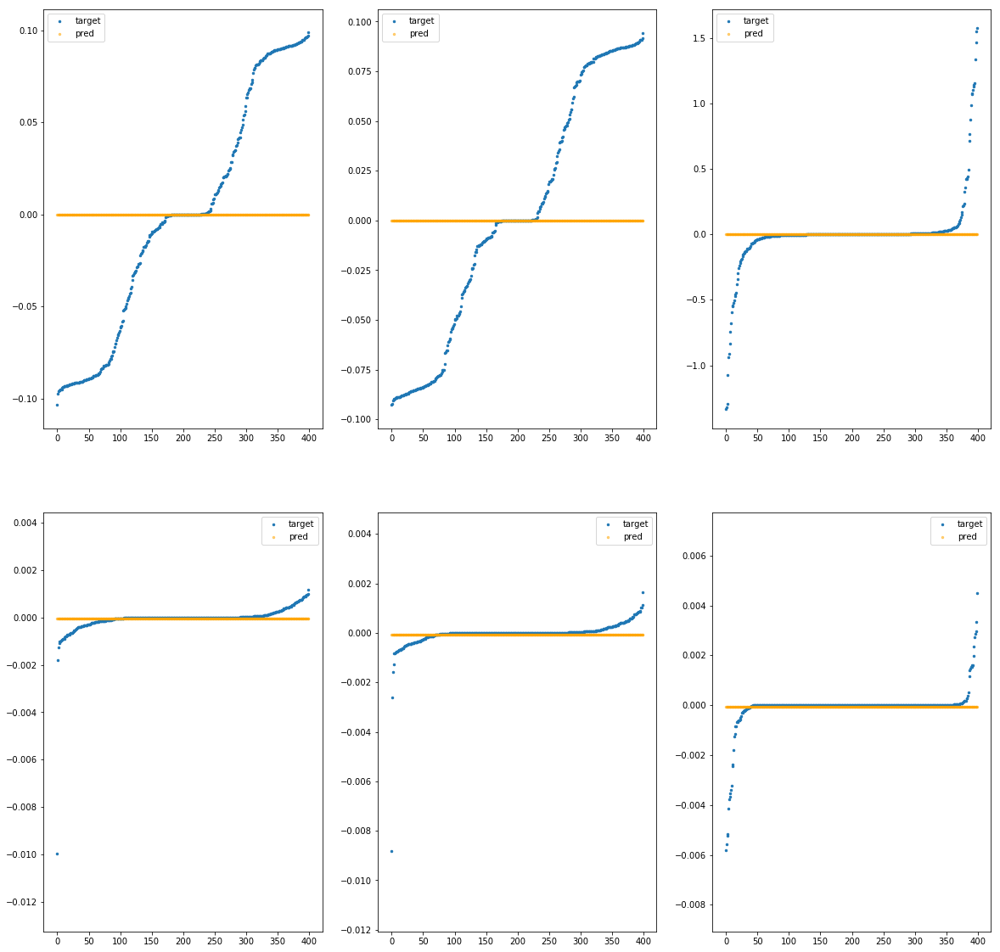

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca0d0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.03e-04	1.03e-01	5.17e-02	2.54e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.38e+01	3.85e-03	1.48e-05
z		-7.51e-04	1.57e+00	1.02e-01	6.71e+00	8.34e-02	6.95e-03
phi		-4.93e-04	9.92e-03	2.30e-04	4.24e+04	3.62e-07	1.31e-13
theta		-3.26e-03	8.77e-03	2.20e-04	1.08e+04	3.10e-07	9.60e-14
psi		-4.95e-04	5.78e-03	2.79e-04	6.08e+03	7.50e-07	5.63e-13


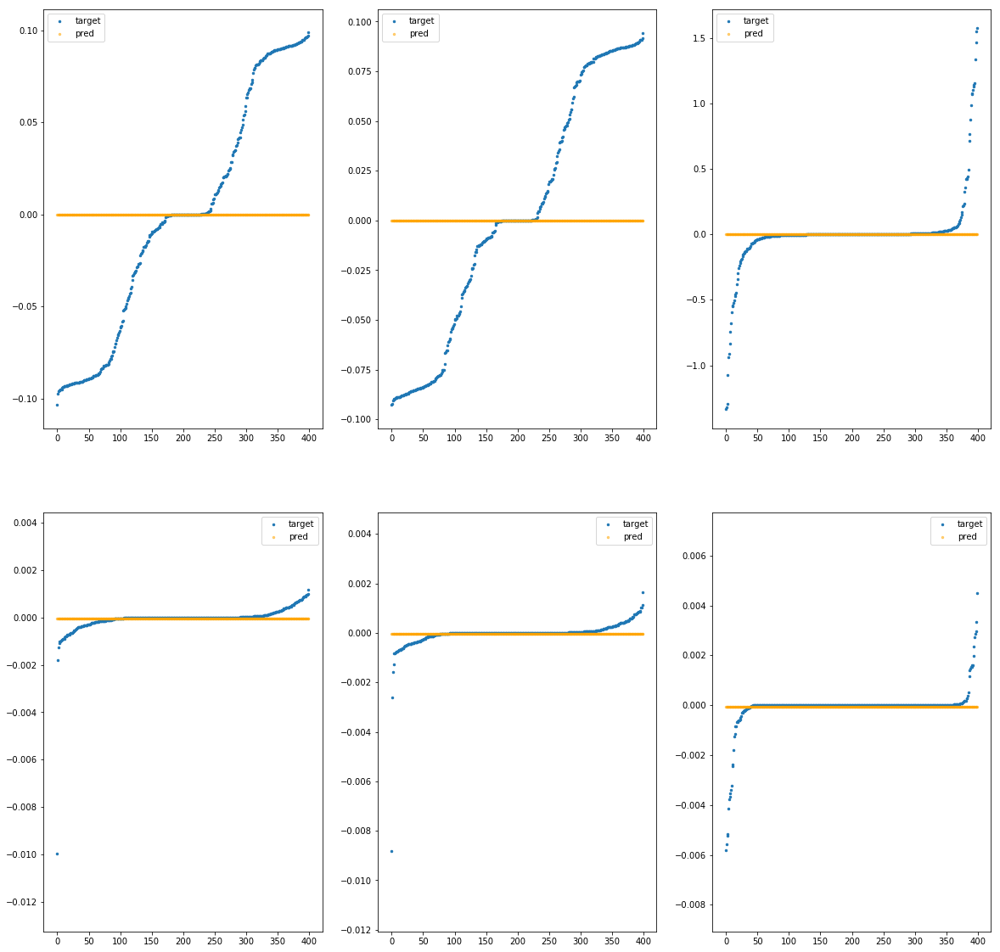

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca130>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.07e-04	1.03e-01	5.17e-02	1.92e+02	4.09e-03	1.68e-05
y		-2.91e-03	9.43e-02	5.11e-02	1.07e+01	3.85e-03	1.48e-05
z		-7.49e-04	1.57e+00	1.02e-01	5.26e+00	8.34e-02	6.95e-03
phi		-4.54e-06	9.94e-03	2.24e-04	3.21e+04	3.62e-07	1.31e-13
theta		-1.25e-03	8.79e-03	2.13e-04	8.18e+03	3.09e-07	9.56e-14
psi		-1.31e-03	5.79e-03	2.69e-04	4.60e+03	7.51e-07	5.64e-13


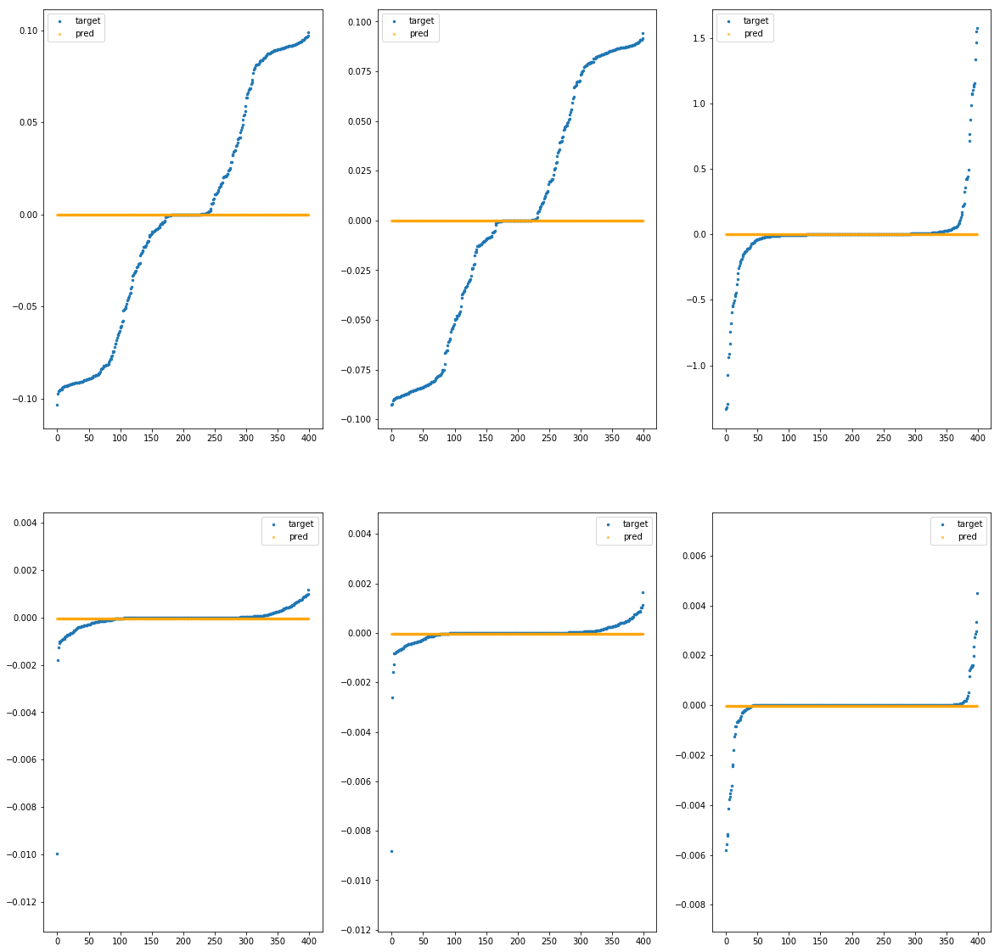

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca190>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.16e-04	1.03e-01	5.17e-02	5.81e+01	4.09e-03	1.68e-05
y		-2.87e-03	9.43e-02	5.11e-02	3.84e+00	3.85e-03	1.48e-05
z		-7.44e-04	1.57e+00	1.02e-01	2.16e+00	8.34e-02	6.95e-03
phi		-1.73e-03	9.96e-03	2.12e-04	9.61e+03	3.63e-07	1.32e-13
theta		-1.42e-04	8.81e-03	1.98e-04	2.45e+03	3.09e-07	9.54e-14
psi		-4.43e-03	5.82e-03	2.48e-04	1.38e+03	7.53e-07	5.67e-13


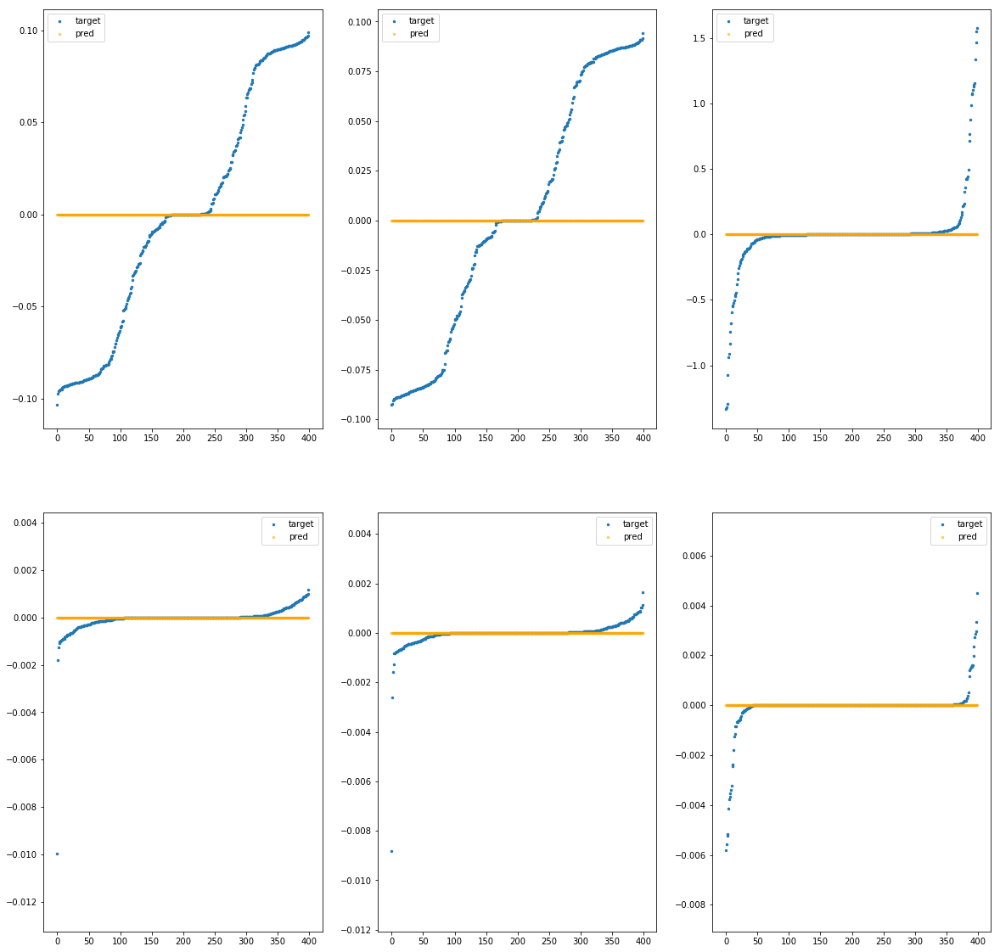

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca1f0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.02e-04	1.03e-01	5.17e-02	2.72e+02	4.09e-03	1.68e-05
y		-2.94e-03	9.43e-02	5.11e-02	1.47e+01	3.85e-03	1.48e-05
z		-7.51e-04	1.57e+00	1.02e-01	7.15e+00	8.34e-02	6.95e-03
phi		-8.01e-04	9.92e-03	2.32e-04	4.56e+04	3.62e-07	1.31e-13
theta		-4.06e-03	8.77e-03	2.23e-04	1.16e+04	3.10e-07	9.62e-14
psi		-3.25e-04	5.78e-03	2.82e-04	6.53e+03	7.50e-07	5.63e-13


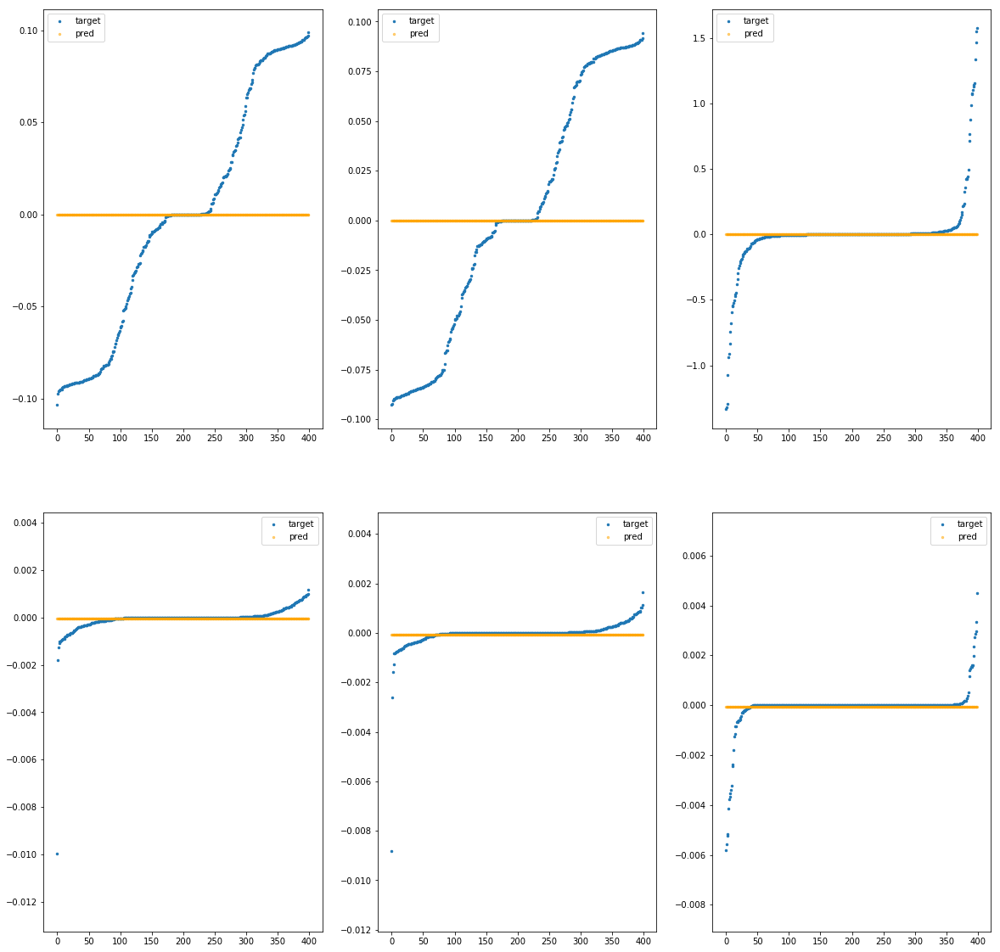

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca250>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.10e-04	1.03e-01	5.17e-02	1.54e+02	4.09e-03	1.68e-05
y		-2.90e-03	9.43e-02	5.11e-02	8.74e+00	3.85e-03	1.48e-05
z		-7.47e-04	1.57e+00	1.02e-01	4.38e+00	8.34e-02	6.95e-03
phi		-1.03e-04	9.94e-03	2.20e-04	2.58e+04	3.62e-07	1.31e-13
theta		-4.86e-04	8.79e-03	2.08e-04	6.57e+03	3.09e-07	9.55e-14
psi		-2.00e-03	5.80e-03	2.63e-04	3.69e+03	7.51e-07	5.65e-13


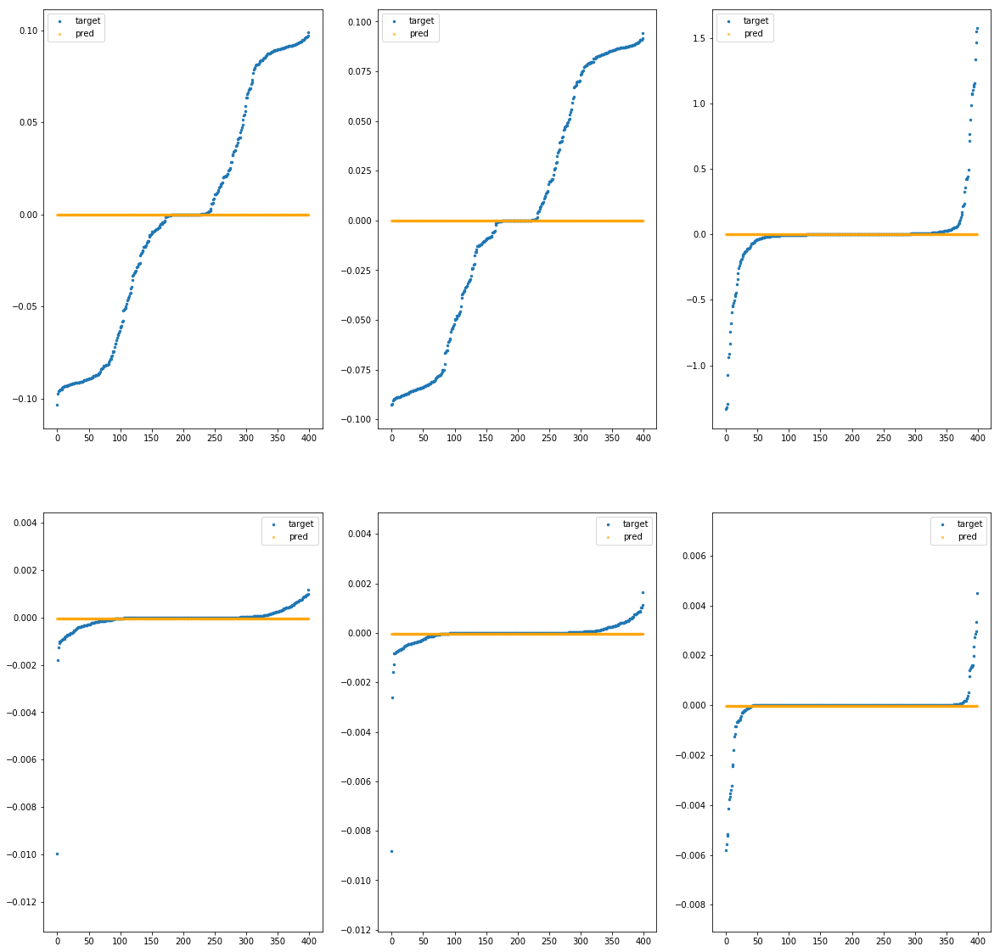

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca2b0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.10e-04	1.03e-01	5.17e-02	1.44e+02	4.09e-03	1.68e-05
y		-2.90e-03	9.43e-02	5.11e-02	8.21e+00	3.85e-03	1.48e-05
z		-7.47e-04	1.57e+00	1.02e-01	4.14e+00	8.34e-02	6.95e-03
phi		-1.83e-04	9.94e-03	2.19e-04	2.40e+04	3.62e-07	1.31e-13
theta		-3.38e-04	8.79e-03	2.07e-04	6.12e+03	3.09e-07	9.55e-14
psi		-2.22e-03	5.80e-03	2.62e-04	3.44e+03	7.52e-07	5.65e-13


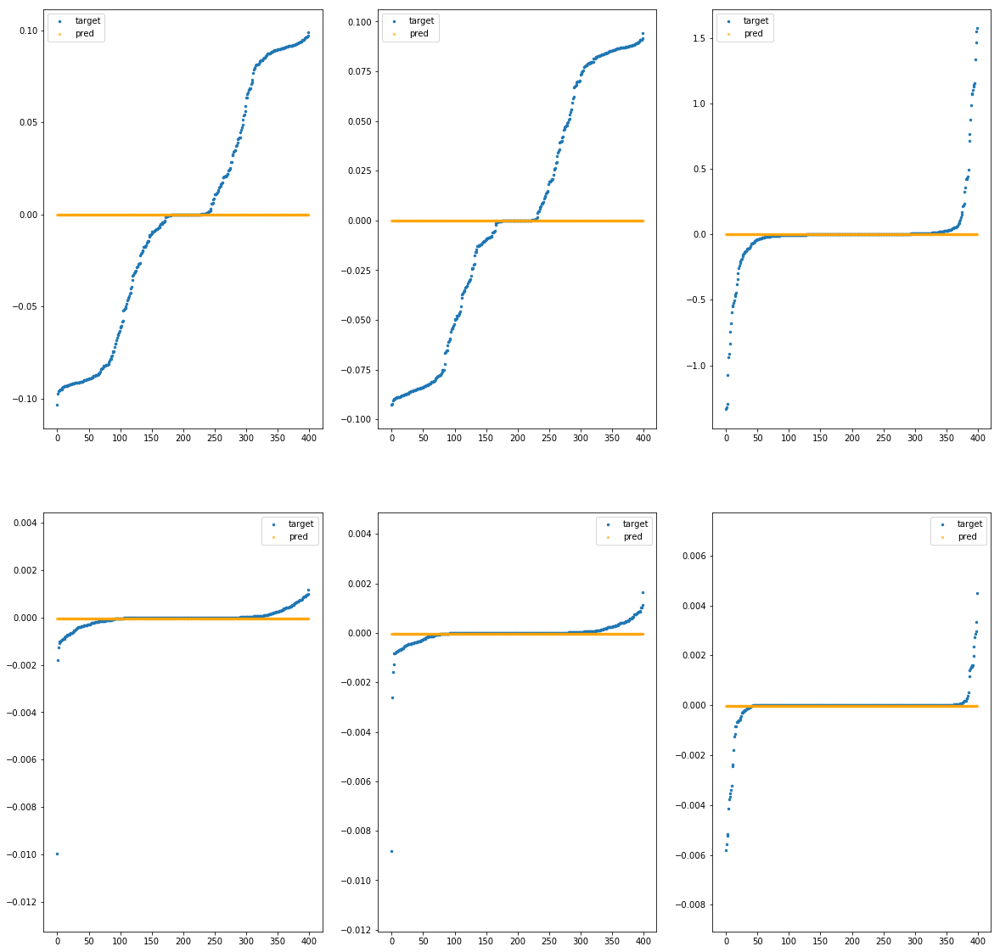

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca310>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.06e-04	1.03e-01	5.17e-02	2.09e+02	4.09e-03	1.68e-05
y		-2.92e-03	9.43e-02	5.11e-02	1.15e+01	3.85e-03	1.48e-05
z		-7.49e-04	1.57e+00	1.02e-01	5.67e+00	8.34e-02	6.95e-03
phi		-6.05e-05	9.93e-03	2.25e-04	3.50e+04	3.62e-07	1.31e-13
theta		-1.72e-03	8.78e-03	2.15e-04	8.92e+03	3.09e-07	9.57e-14
psi		-1.04e-03	5.79e-03	2.72e-04	5.01e+03	7.51e-07	5.64e-13


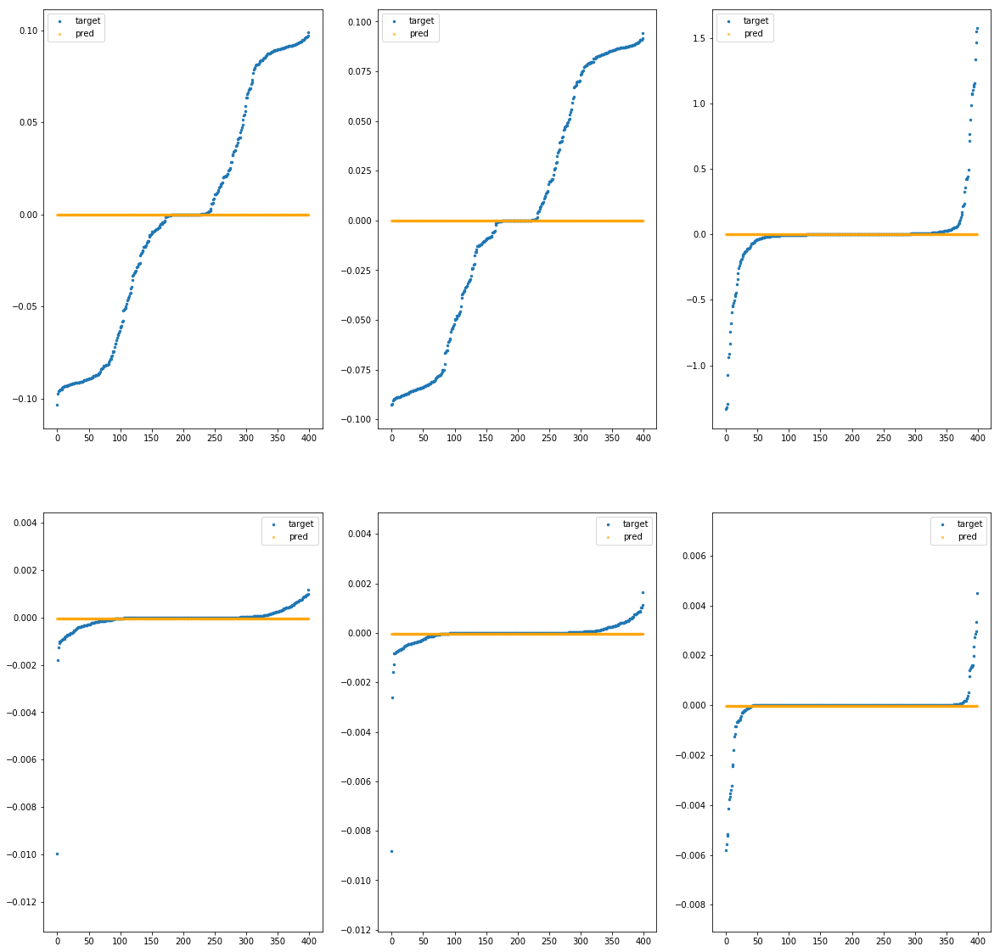

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca370>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.26e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.24e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.06e+00	8.34e-02	6.95e-03
phi		-1.74e-04	9.93e-03	2.27e-04	3.78e+04	3.62e-07	1.31e-13
theta		-2.24e-03	8.78e-03	2.17e-04	9.63e+03	3.10e-07	9.58e-14
psi		-8.13e-04	5.79e-03	2.74e-04	5.41e+03	7.51e-07	5.63e-13


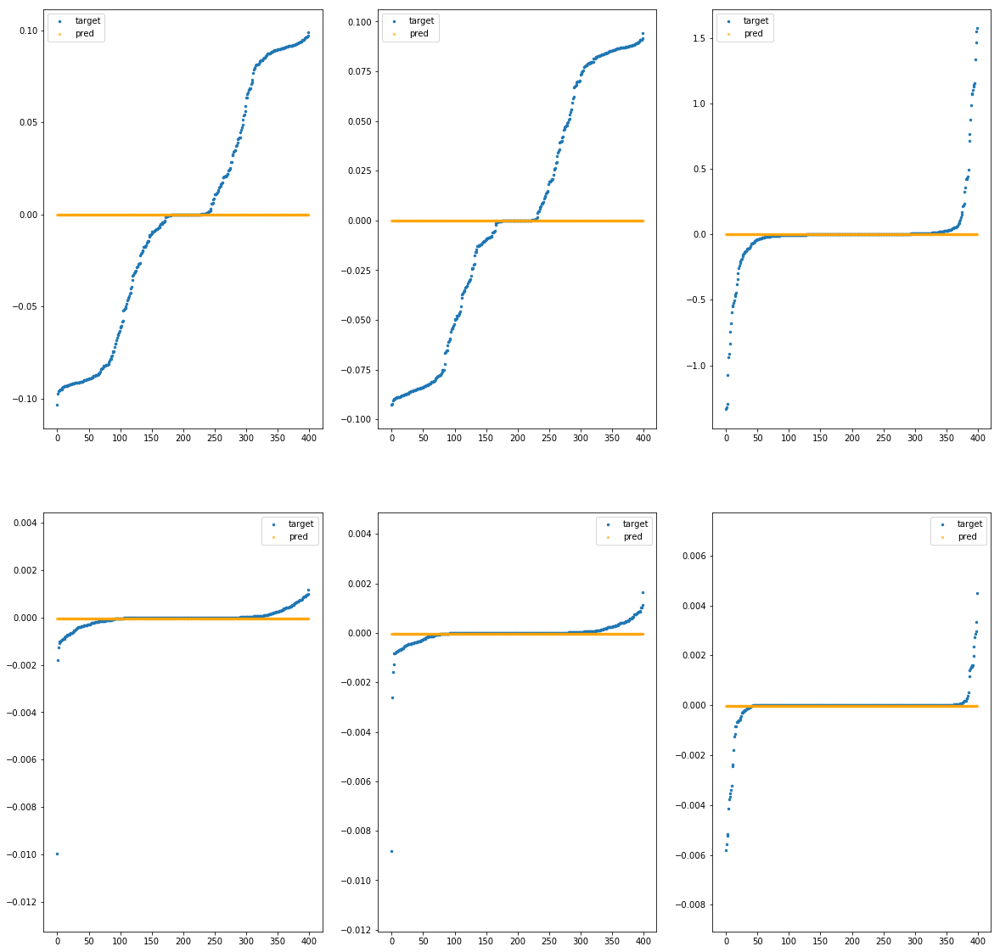

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca3d0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.23e-05	1.03e-01	5.17e-02	4.38e+02	4.09e-03	1.68e-05
y		-3.00e-03	9.43e-02	5.11e-02	2.32e+01	3.85e-03	1.48e-05
z		-7.58e-04	1.57e+00	1.02e-01	1.10e+01	8.34e-02	6.95e-03
phi		-6.76e-03	9.89e-03	2.50e-04	7.33e+04	3.64e-07	1.33e-13
theta		-1.49e-02	8.74e-03	2.43e-04	1.87e+04	3.13e-07	9.83e-14
psi		-3.77e-04	5.74e-03	3.08e-04	1.05e+04	7.50e-07	5.63e-13


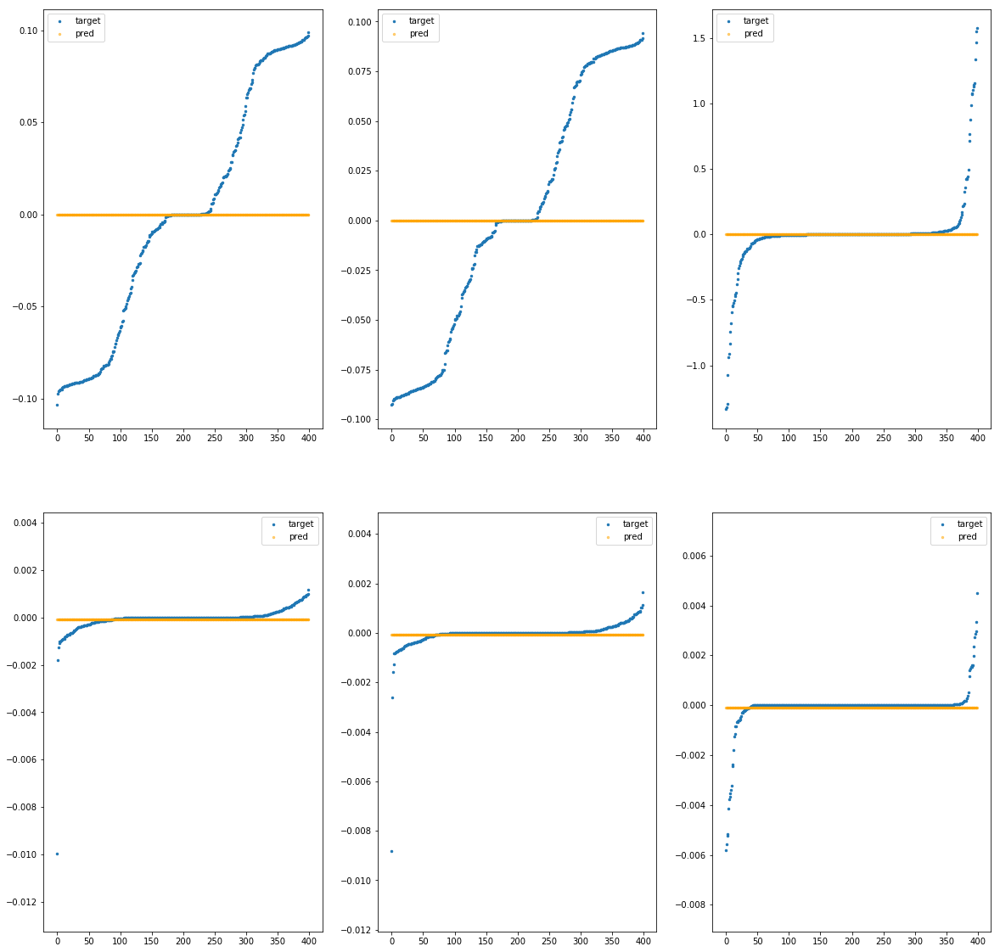

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca430>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.10e-04	1.03e-01	5.17e-02	1.55e+02	4.09e-03	1.68e-05
y		-2.90e-03	9.43e-02	5.11e-02	8.76e+00	3.85e-03	1.48e-05
z		-7.47e-04	1.57e+00	1.02e-01	4.40e+00	8.34e-02	6.95e-03
phi		-9.98e-05	9.94e-03	2.20e-04	2.59e+04	3.62e-07	1.31e-13
theta		-4.94e-04	8.79e-03	2.09e-04	6.59e+03	3.09e-07	9.55e-14
psi		-1.99e-03	5.80e-03	2.63e-04	3.70e+03	7.51e-07	5.65e-13


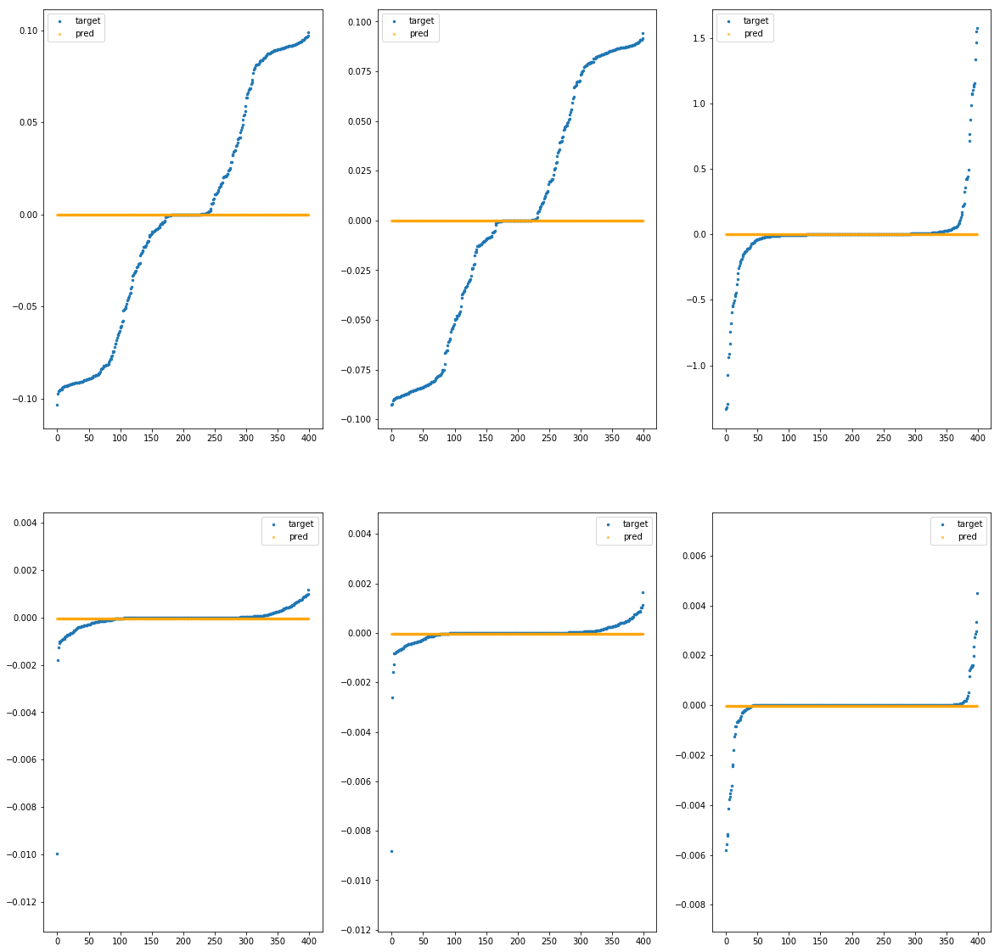

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca490>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.08e-04	1.03e-01	5.17e-02	1.75e+02	4.09e-03	1.68e-05
y		-2.91e-03	9.43e-02	5.11e-02	9.78e+00	3.85e-03	1.48e-05
z		-7.48e-04	1.57e+00	1.02e-01	4.86e+00	8.34e-02	6.95e-03
phi		-1.23e-05	9.94e-03	2.22e-04	2.92e+04	3.62e-07	1.31e-13
theta		-8.56e-04	8.79e-03	2.11e-04	7.44e+03	3.09e-07	9.56e-14
psi		-1.61e-03	5.80e-03	2.66e-04	4.18e+03	7.51e-07	5.64e-13


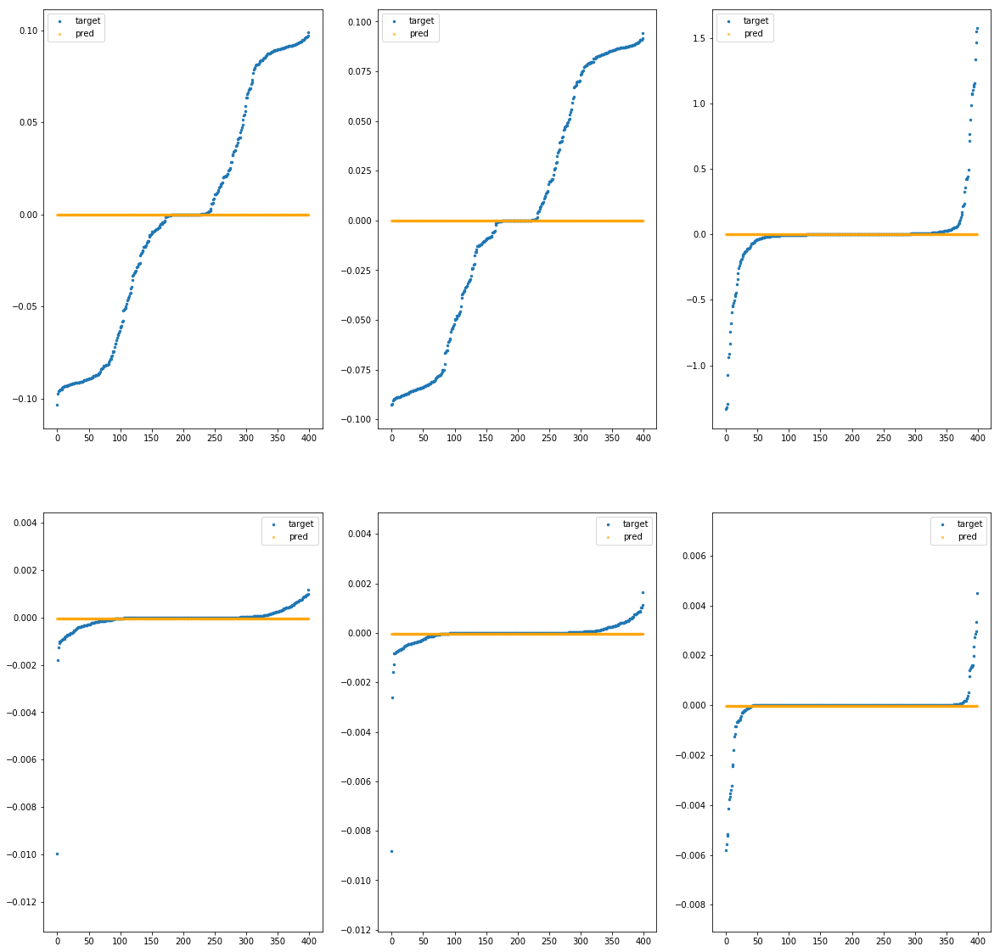

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca4f0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.10e-04	1.03e-01	5.17e-02	1.45e+02	4.09e-03	1.68e-05
y		-2.90e-03	9.43e-02	5.11e-02	8.27e+00	3.85e-03	1.48e-05
z		-7.47e-04	1.57e+00	1.02e-01	4.17e+00	8.34e-02	6.95e-03
phi		-1.74e-04	9.94e-03	2.19e-04	2.42e+04	3.62e-07	1.31e-13
theta		-3.53e-04	8.79e-03	2.07e-04	6.17e+03	3.09e-07	9.55e-14
psi		-2.19e-03	5.80e-03	2.62e-04	3.47e+03	7.52e-07	5.65e-13


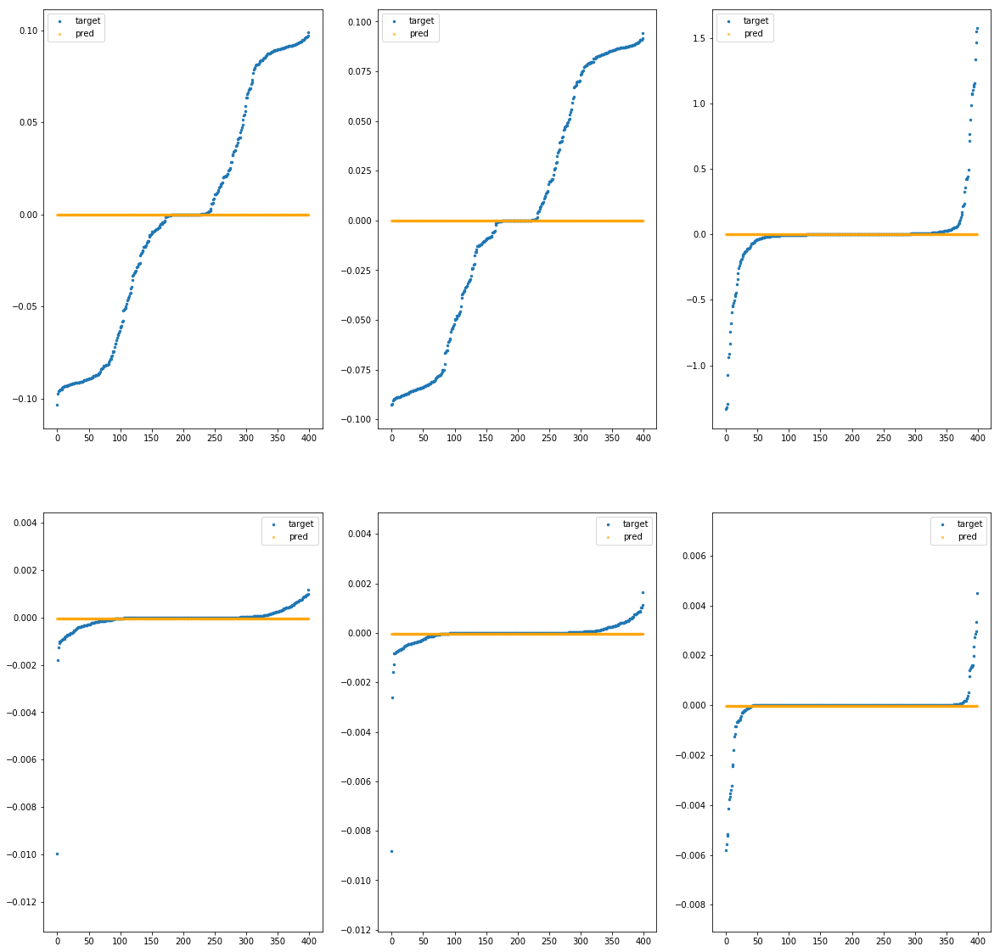

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca550>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.10e-04	1.03e-01	5.17e-02	1.54e+02	4.09e-03	1.68e-05
y		-2.90e-03	9.43e-02	5.11e-02	8.70e+00	3.85e-03	1.48e-05
z		-7.47e-04	1.57e+00	1.02e-01	4.37e+00	8.34e-02	6.95e-03
phi		-1.08e-04	9.94e-03	2.20e-04	2.56e+04	3.62e-07	1.31e-13
theta		-4.75e-04	8.79e-03	2.08e-04	6.54e+03	3.09e-07	9.55e-14
psi		-2.02e-03	5.80e-03	2.63e-04	3.67e+03	7.52e-07	5.65e-13


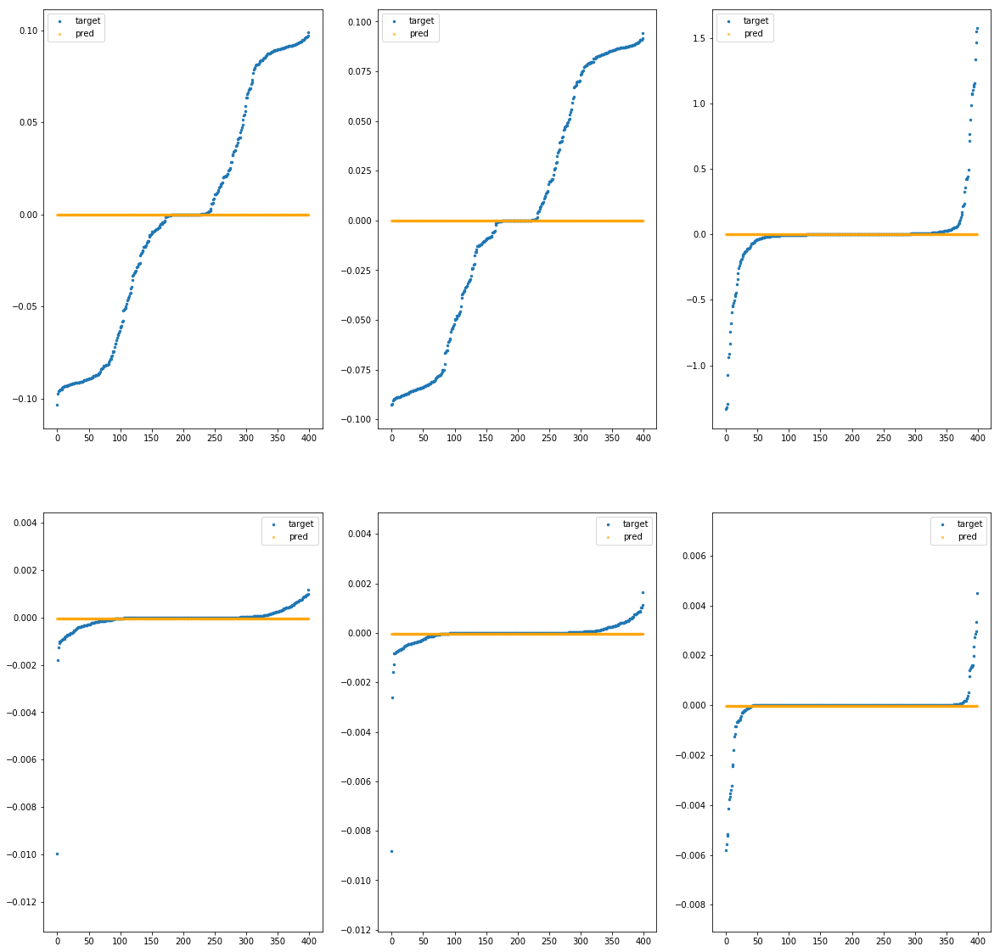

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca5b0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.17e-04	1.03e-01	5.17e-02	3.87e+01	4.09e-03	1.68e-05
y		-2.86e-03	9.43e-02	5.11e-02	2.87e+00	3.85e-03	1.48e-05
z		-7.43e-04	1.57e+00	1.02e-01	1.73e+00	8.34e-02	6.95e-03
phi		-2.29e-03	9.97e-03	2.10e-04	6.36e+03	3.63e-07	1.32e-13
theta		-3.53e-04	8.82e-03	1.96e-04	1.62e+03	3.09e-07	9.55e-14
psi		-5.03e-03	5.82e-03	2.45e-04	9.11e+02	7.54e-07	5.68e-13


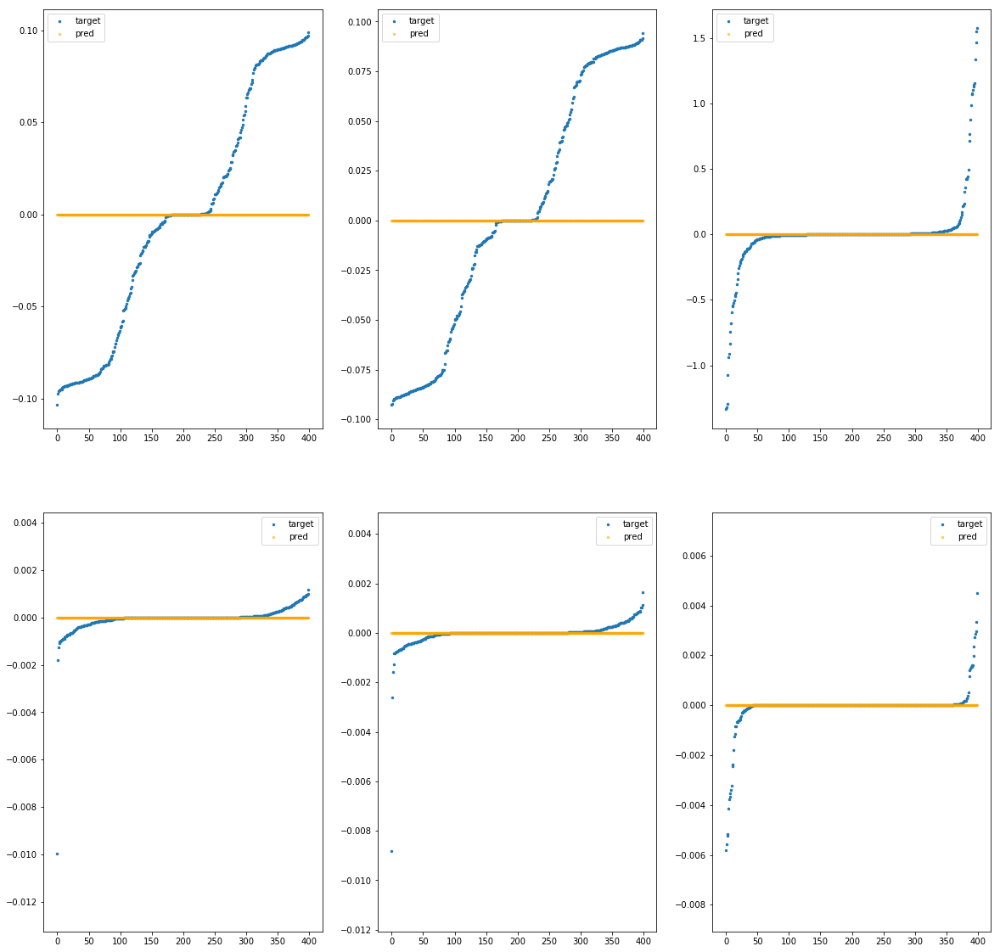

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca610>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.06e-04	1.03e-01	5.17e-02	2.19e+02	4.09e-03	1.68e-05
y		-2.92e-03	9.43e-02	5.11e-02	1.20e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	5.89e+00	8.34e-02	6.95e-03
phi		-1.20e-04	9.93e-03	2.26e-04	3.66e+04	3.62e-07	1.31e-13
theta		-2.01e-03	8.78e-03	2.16e-04	9.33e+03	3.09e-07	9.58e-14
psi		-9.05e-04	5.79e-03	2.73e-04	5.25e+03	7.51e-07	5.64e-13


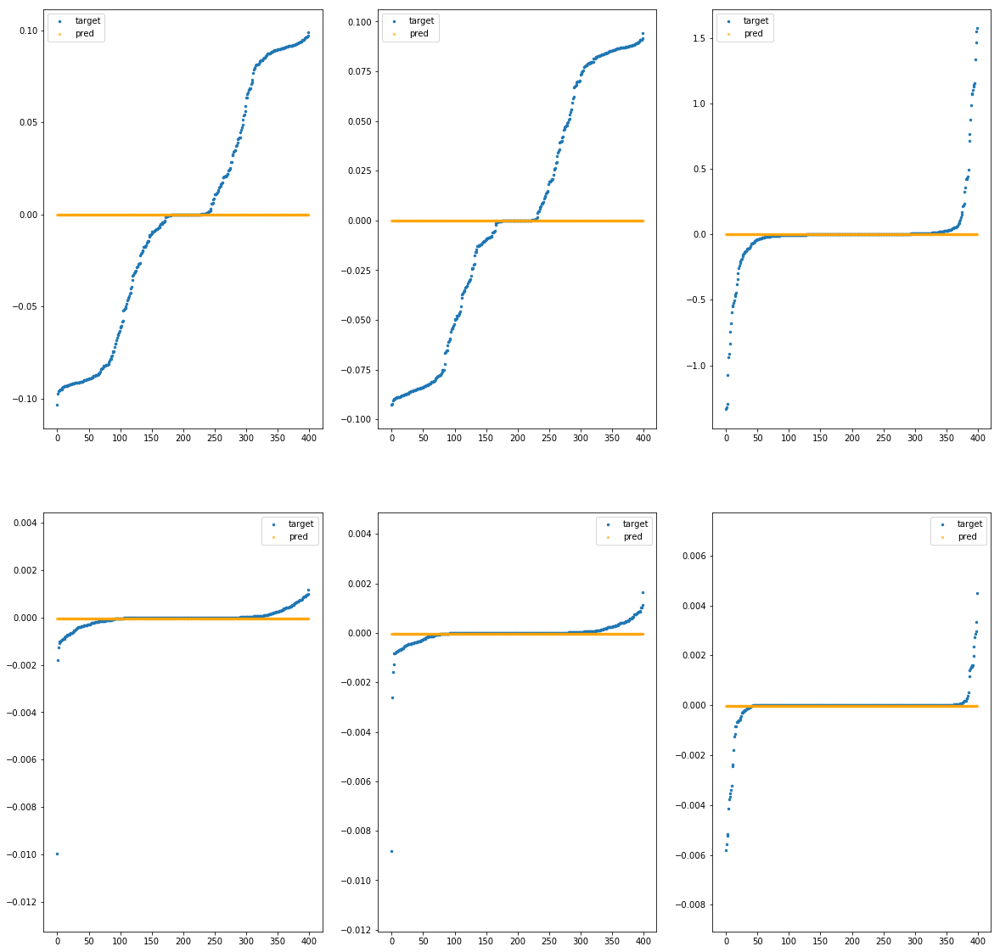

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca670>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-04	1.03e-01	5.17e-02	2.31e+02	4.09e-03	1.68e-05
y		-2.93e-03	9.43e-02	5.11e-02	1.27e+01	3.85e-03	1.48e-05
z		-7.50e-04	1.57e+00	1.02e-01	6.18e+00	8.34e-02	6.95e-03
phi		-2.27e-04	9.93e-03	2.28e-04	3.87e+04	3.62e-07	1.31e-13
theta		-2.43e-03	8.78e-03	2.18e-04	9.86e+03	3.10e-07	9.59e-14
psi		-7.47e-04	5.78e-03	2.75e-04	5.54e+03	7.51e-07	5.63e-13


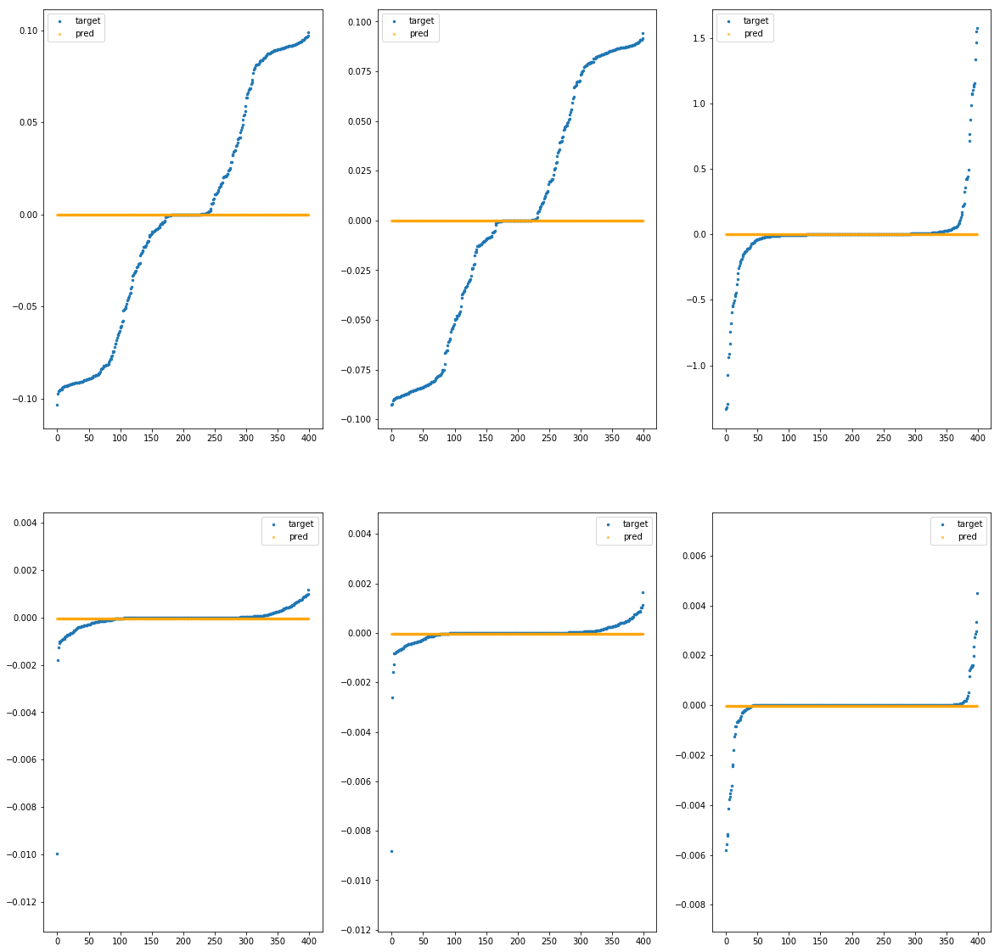

Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bca6d0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.07e-04	1.03e-01	5.17e-02	1.91e+02	4.09e-03	1.68e-05
y		-2.91e-03	9.43e-02	5.11e-02	1.06e+01	3.85e-03	1.48e-05
z		-7.48e-04	1.57e+00	1.02e-01	5.24e+00	8.34e-02	6.95e-03
phi		-3.23e-06	9.94e-03	2.24e-04	3.19e+04	3.62e-07	1.31e-13
theta		-1.22e-03	8.79e-03	2.13e-04	8.14e+03	3.09e-07	9.56e-14
psi		-1.33e-03	5.79e-03	2.69e-04	4.57e+03	7.51e-07	5.64e-13


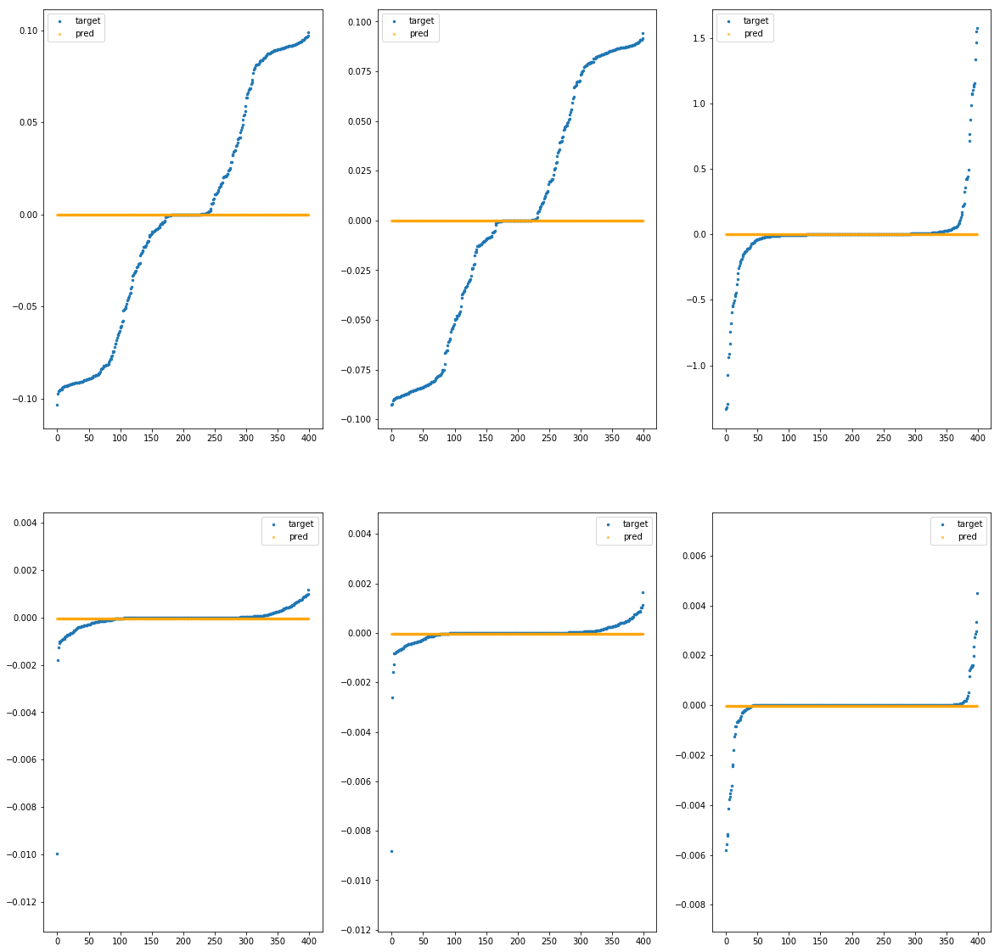

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bca730>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.63e-03	4.14e-01	2.06e-01	7.22e+02	6.42e-02	4.12e-03
y		1.89e-04	3.66e-01	1.88e-01	6.82e+01	5.48e-02	3.00e-03
z		5.55e-05	6.22e+00	2.77e-01	4.54e+01	8.75e-01	7.65e-01
phi		-7.64e+00	2.44e-02	2.83e-03	2.75e+05	1.61e-05	2.58e-10
theta		-1.24e+01	2.39e-02	2.87e-03	7.49e+04	1.71e-05	2.92e-10
psi		-3.34e-01	3.90e-02	3.41e-03	5.08e+04	3.27e-05	1.07e-09


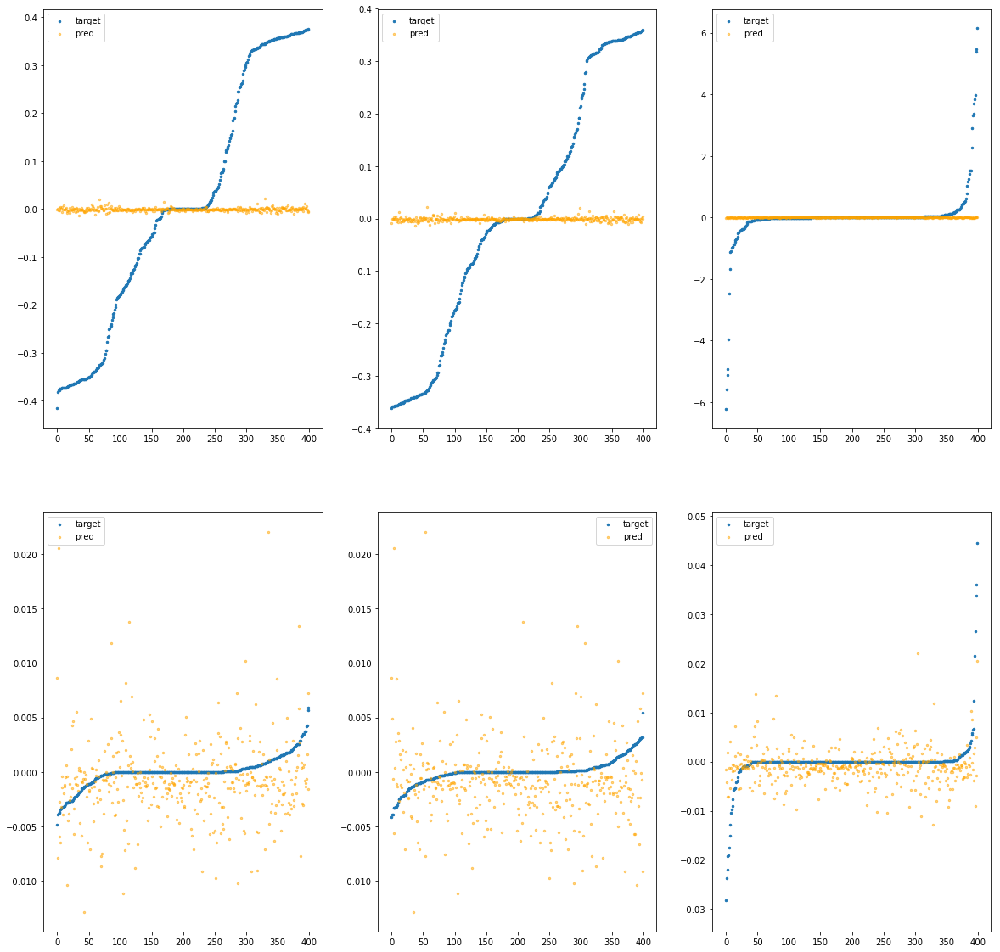

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bca790>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.68e-04	4.13e-01	2.05e-01	2.00e+02	6.41e-02	4.11e-03
y		-5.21e-03	3.78e-01	1.88e-01	4.08e+01	5.51e-02	3.04e-03
z		-1.74e-03	6.25e+00	2.78e-01	3.54e+01	8.76e-01	7.68e-01
phi		-1.13e+01	2.38e-02	3.09e-03	8.61e+04	2.28e-05	5.21e-10
theta		-1.61e+01	2.35e-02	3.01e-03	3.71e+04	2.17e-05	4.69e-10
psi		-8.59e-01	4.43e-02	3.69e-03	6.61e+04	4.56e-05	2.08e-09


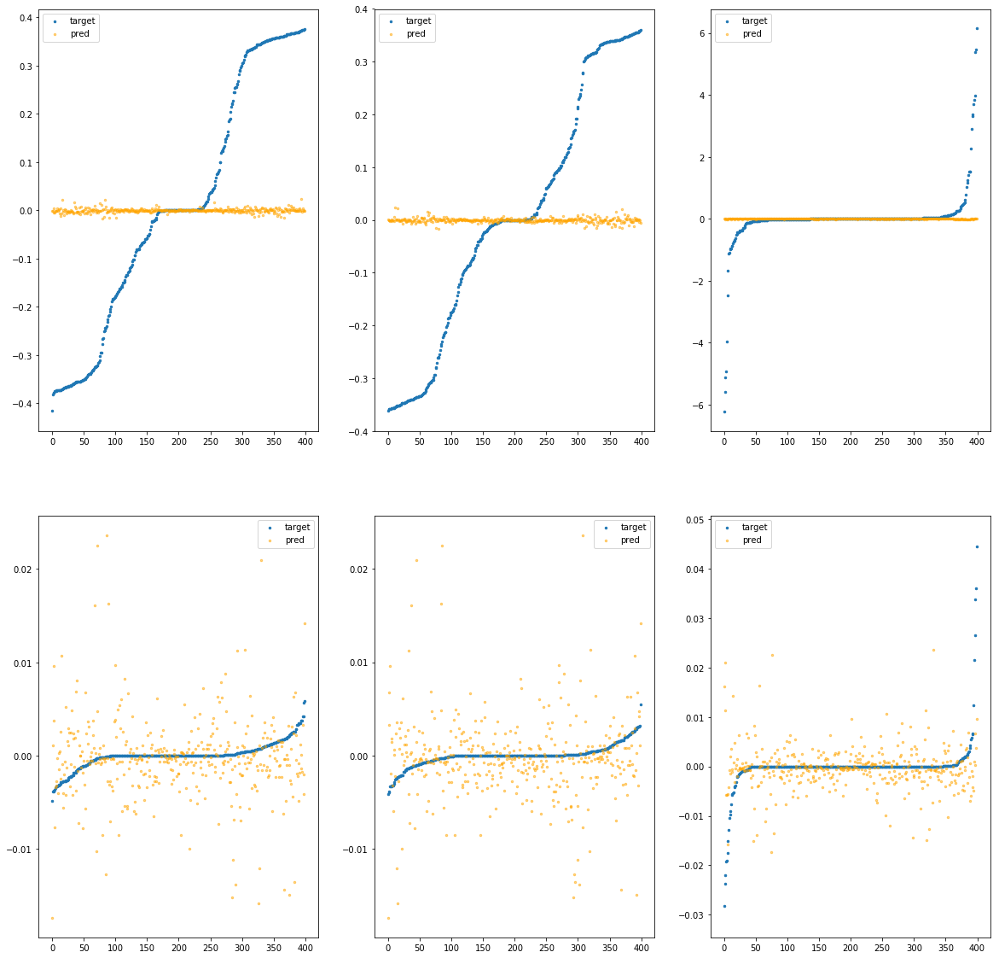

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bca7f0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.02e-03	3.99e-01	2.06e-01	3.23e+02	6.44e-02	4.15e-03
y		3.12e-04	3.62e-01	1.88e-01	3.95e+01	5.48e-02	3.00e-03
z		-1.41e-03	6.23e+00	2.77e-01	3.99e+01	8.76e-01	7.68e-01
phi		-7.07e+00	2.19e-02	2.57e-03	1.37e+05	1.50e-05	2.25e-10
theta		-8.82e+00	1.68e-02	2.38e-03	5.77e+04	1.25e-05	1.56e-10
psi		-5.96e-01	4.97e-02	3.25e-03	5.41e+04	3.91e-05	1.53e-09


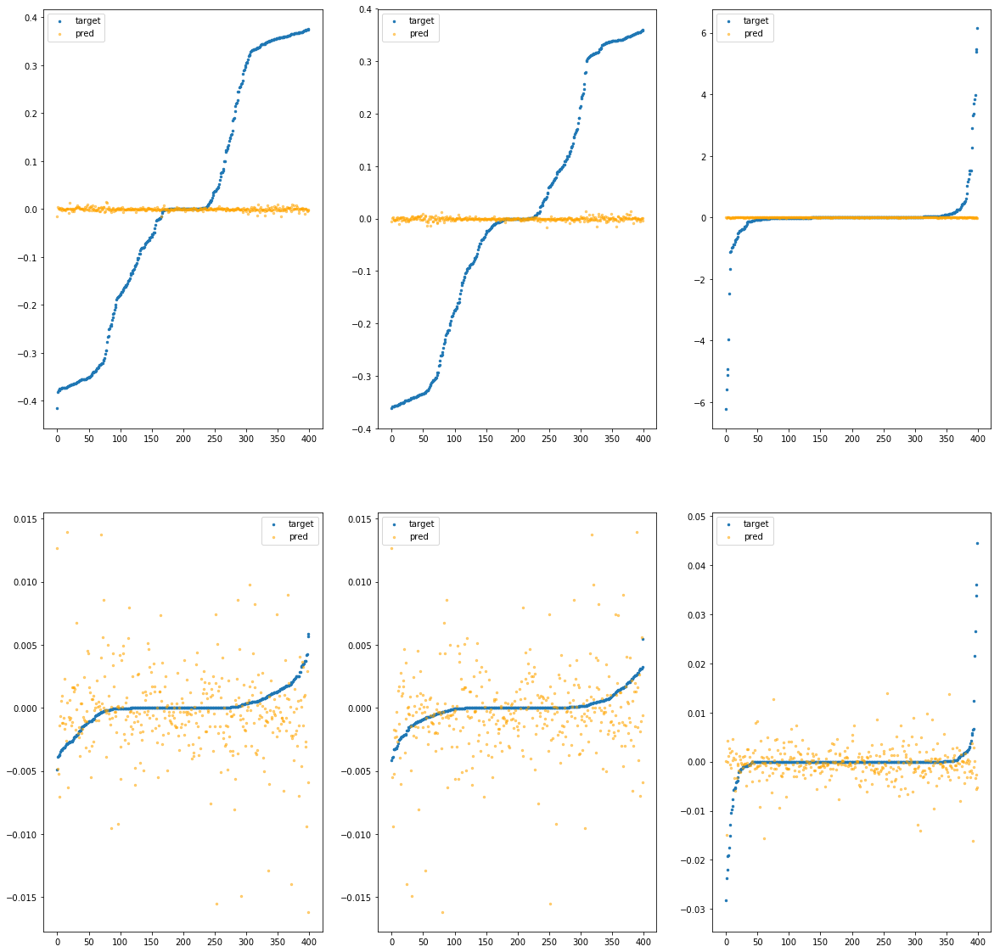

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bca850>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.87e-05	3.90e-01	2.05e-01	3.42e+02	6.41e-02	4.11e-03
y		1.46e-03	3.63e-01	1.88e-01	4.34e+01	5.47e-02	3.00e-03
z		-7.43e-04	6.22e+00	2.77e-01	3.76e+01	8.76e-01	7.67e-01
phi		-1.10e+01	3.06e-02	2.96e-03	1.20e+05	2.23e-05	4.99e-10
theta		-1.58e+01	2.56e-02	2.88e-03	4.87e+04	2.14e-05	4.57e-10
psi		-6.55e-01	3.79e-02	3.44e-03	5.87e+04	4.06e-05	1.65e-09


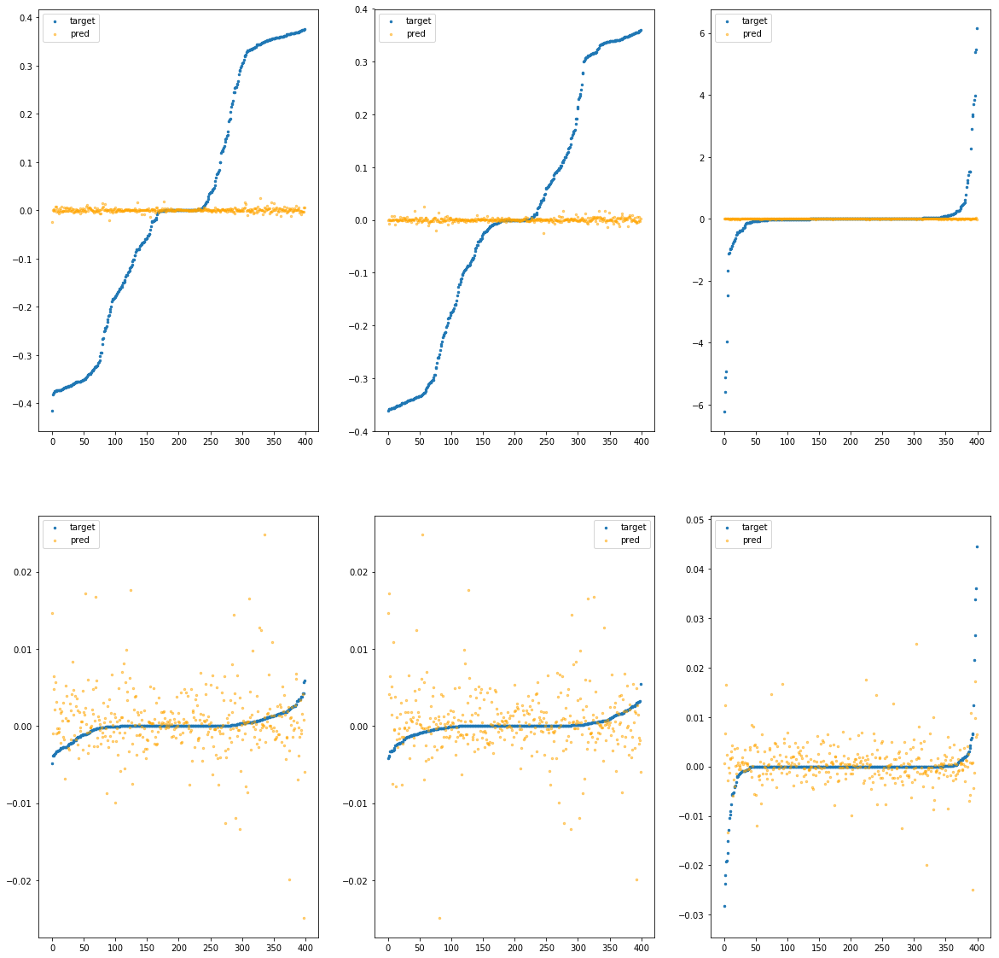

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bca8b0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.14e-03	4.21e-01	2.06e-01	1.94e+02	6.43e-02	4.14e-03
y		-2.71e-03	3.75e-01	1.88e-01	6.35e+01	5.50e-02	3.02e-03
z		-1.78e-03	6.21e+00	2.78e-01	2.82e+01	8.76e-01	7.68e-01
phi		-1.13e+01	2.81e-02	3.07e-03	8.51e+04	2.29e-05	5.27e-10
theta		-1.60e+01	2.63e-02	2.95e-03	4.96e+04	2.15e-05	4.64e-10
psi		-5.42e-01	3.69e-02	3.52e-03	3.86e+04	3.78e-05	1.43e-09


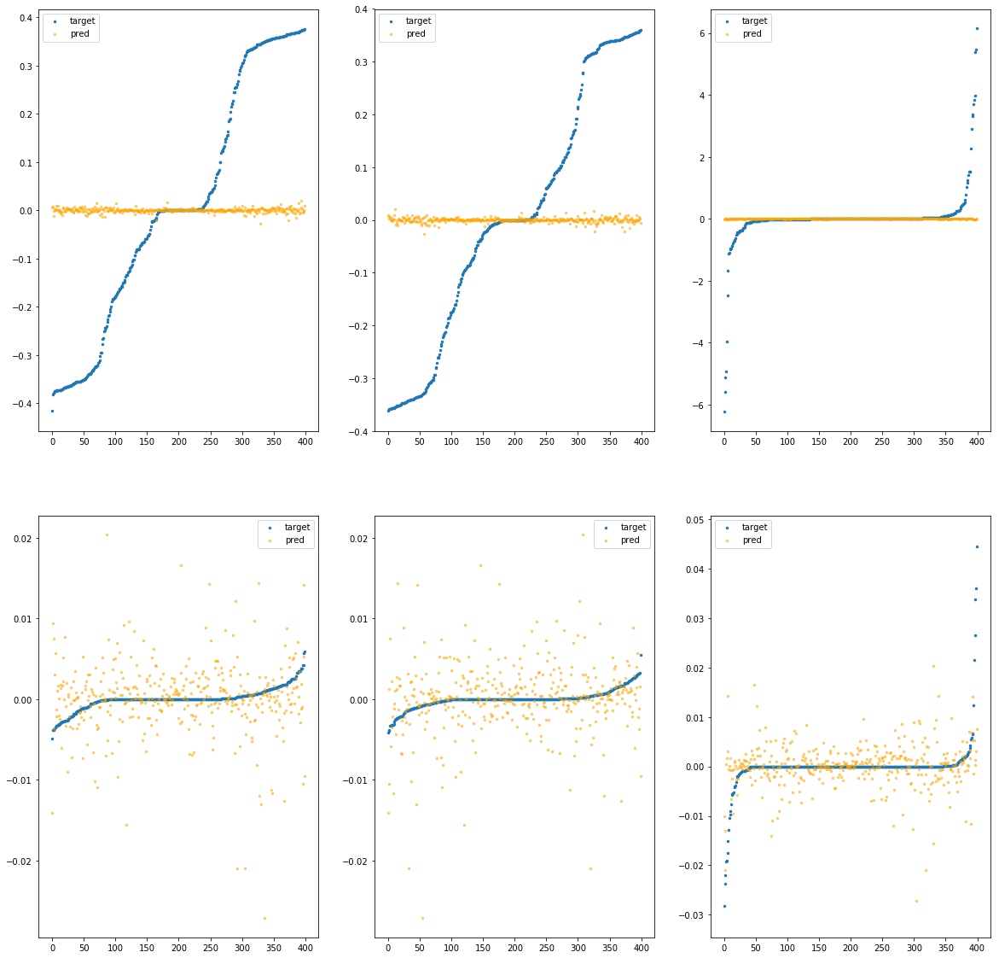

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bca910>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.25e-03	4.17e-01	2.06e-01	4.74e+02	6.44e-02	4.15e-03
y		-1.30e-03	3.63e-01	1.88e-01	5.97e+01	5.49e-02	3.01e-03
z		-2.07e-03	6.21e+00	2.78e-01	5.24e+01	8.77e-01	7.69e-01
phi		-7.74e+00	2.18e-02	2.79e-03	1.62e+05	1.63e-05	2.64e-10
theta		-1.15e+01	2.18e-02	2.70e-03	6.17e+04	1.59e-05	2.53e-10
psi		-7.92e-01	5.11e-02	3.41e-03	5.12e+04	4.40e-05	1.93e-09


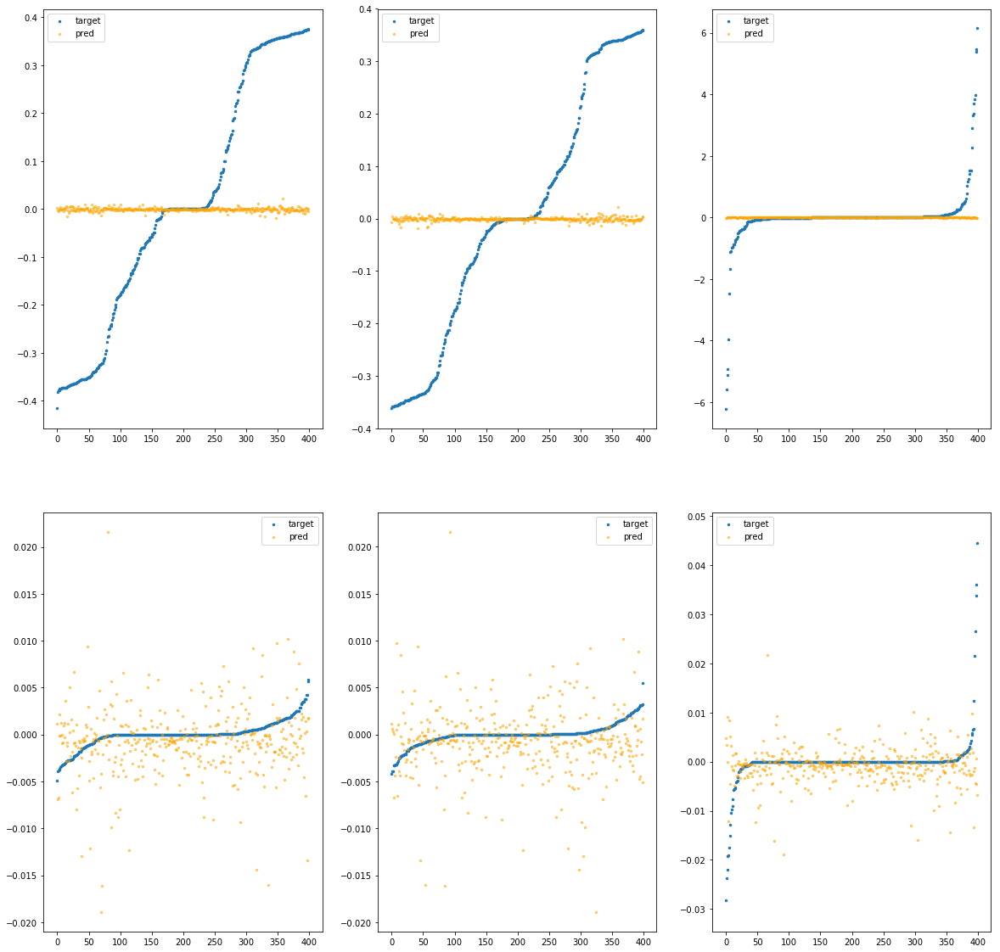

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bca970>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.09e-03	4.22e-01	2.06e-01	4.56e+02	6.44e-02	4.14e-03
y		-3.49e-03	3.63e-01	1.88e-01	9.73e+01	5.50e-02	3.03e-03
z		-2.37e-03	6.21e+00	2.78e-01	6.91e+01	8.77e-01	7.69e-01
phi		-1.18e+01	2.43e-02	3.38e-03	1.64e+05	2.38e-05	5.66e-10
theta		-1.75e+01	2.41e-02	3.36e-03	6.98e+04	2.35e-05	5.54e-10
psi		-6.97e-01	3.98e-02	4.00e-03	8.48e+04	4.16e-05	1.73e-09


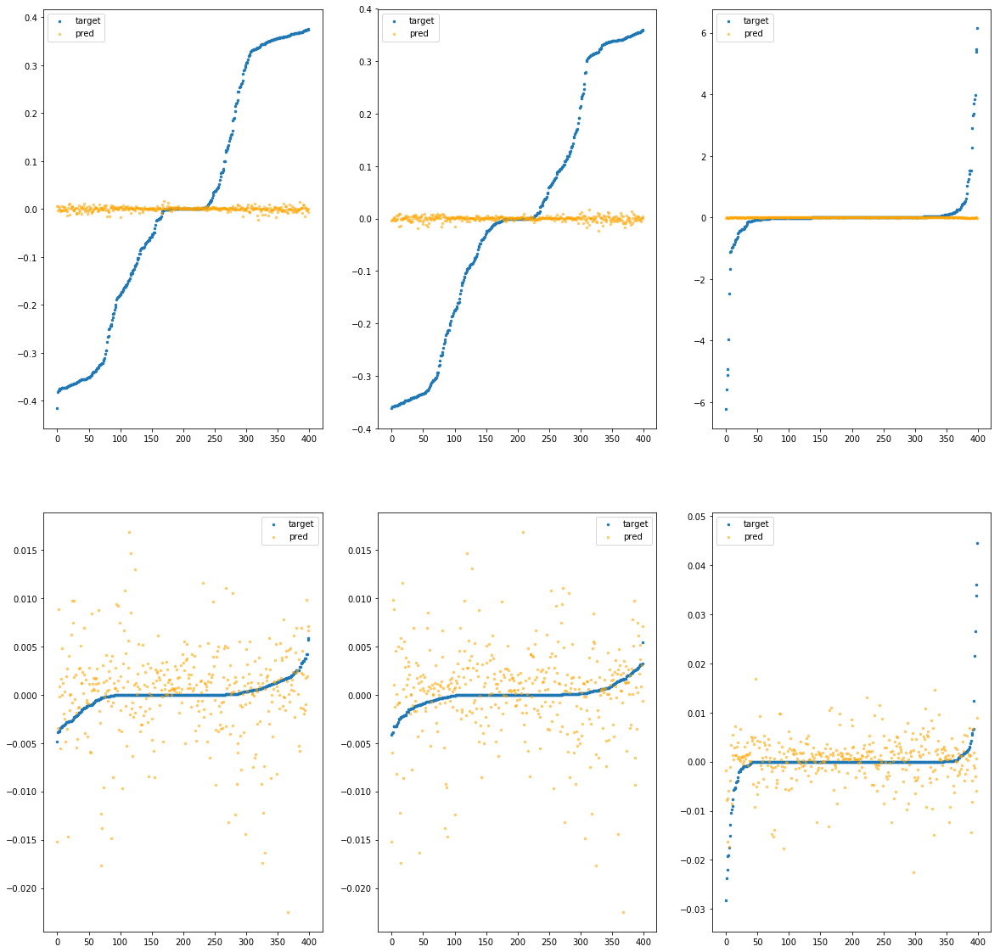

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bca9d0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.28e-03	4.22e-01	2.05e-01	2.30e+02	6.42e-02	4.12e-03
y		-2.64e-03	3.79e-01	1.88e-01	1.91e+01	5.50e-02	3.02e-03
z		-1.04e-03	6.24e+00	2.77e-01	2.21e+01	8.76e-01	7.67e-01
phi		-6.28e+00	2.45e-02	2.50e-03	1.05e+05	1.35e-05	1.83e-10
theta		-9.29e+00	2.42e-02	2.35e-03	2.33e+04	1.31e-05	1.71e-10
psi		-4.76e-01	4.39e-02	3.14e-03	3.97e+04	3.62e-05	1.31e-09


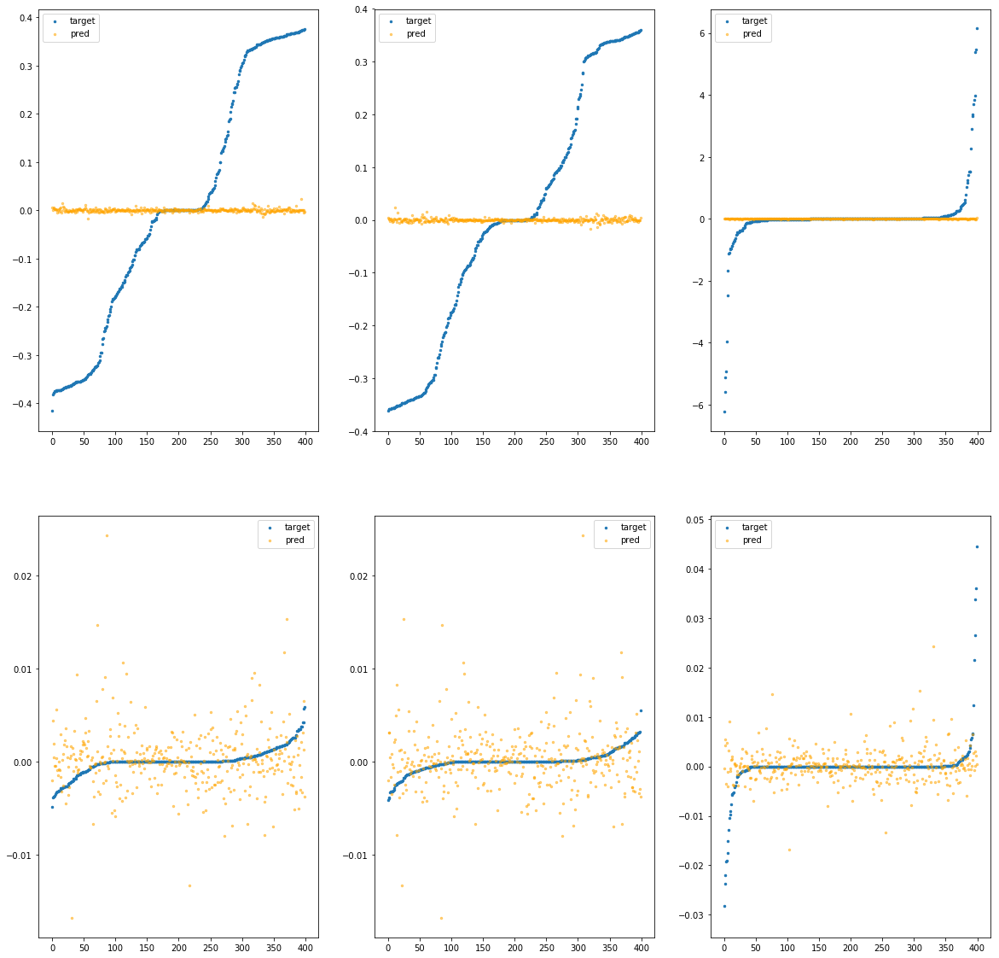

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bcaa30>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.90e-03	4.22e-01	2.06e-01	3.55e+02	6.44e-02	4.15e-03
y		-6.91e-04	3.64e-01	1.88e-01	4.74e+01	5.49e-02	3.01e-03
z		-1.93e-03	6.22e+00	2.78e-01	3.42e+01	8.77e-01	7.68e-01
phi		-9.17e+00	2.80e-02	2.71e-03	1.69e+05	1.89e-05	3.58e-10
theta		-1.37e+01	2.79e-02	2.67e-03	4.36e+04	1.86e-05	3.47e-10
psi		-8.05e-01	4.62e-02	3.48e-03	5.13e+04	4.43e-05	1.96e-09


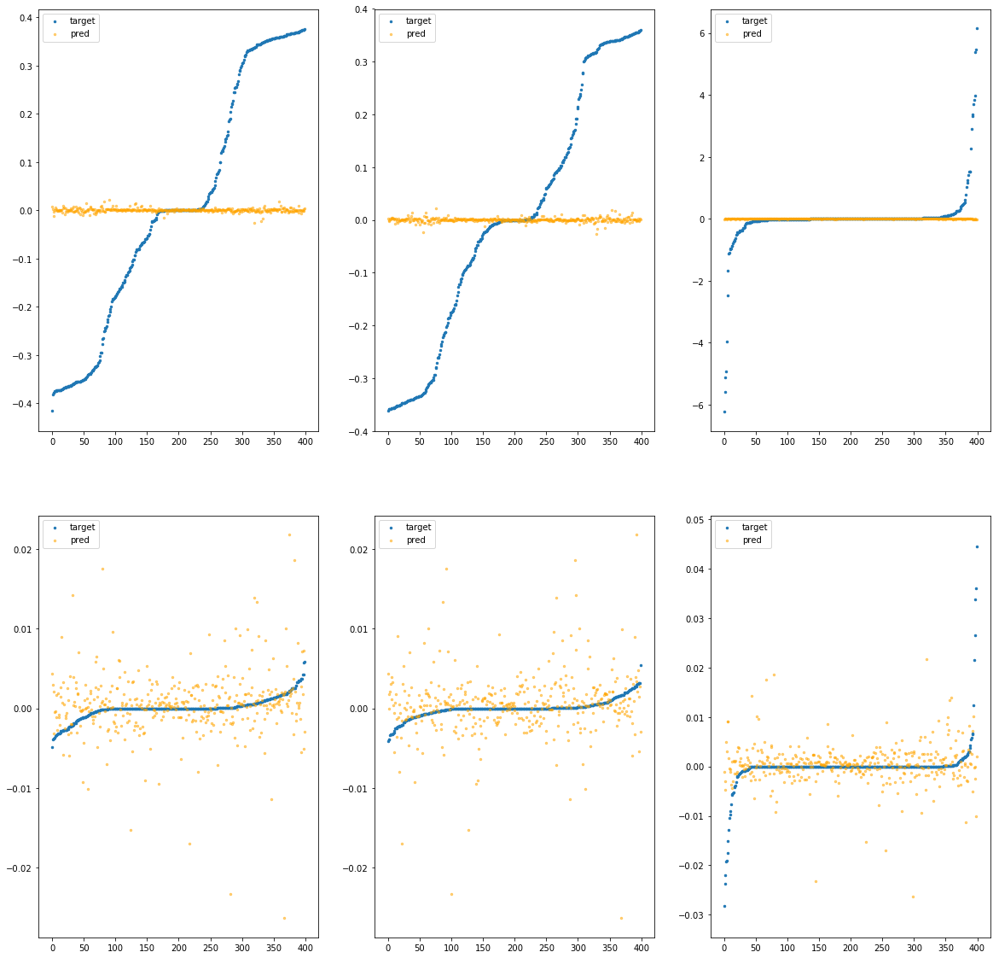

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bcaa90>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.83e-04	4.02e-01	2.05e-01	5.80e+02	6.41e-02	4.11e-03
y		-3.78e-03	3.78e-01	1.88e-01	7.78e+01	5.50e-02	3.03e-03
z		1.35e-03	6.20e+00	2.78e-01	5.01e+01	8.74e-01	7.63e-01
phi		-1.91e+01	3.17e-02	3.88e-03	1.95e+05	3.75e-05	1.41e-09
theta		-2.79e+01	3.20e-02	3.84e-03	6.00e+04	3.67e-05	1.35e-09
psi		-1.88e+00	6.88e-02	4.64e-03	6.62e+04	7.06e-05	4.99e-09


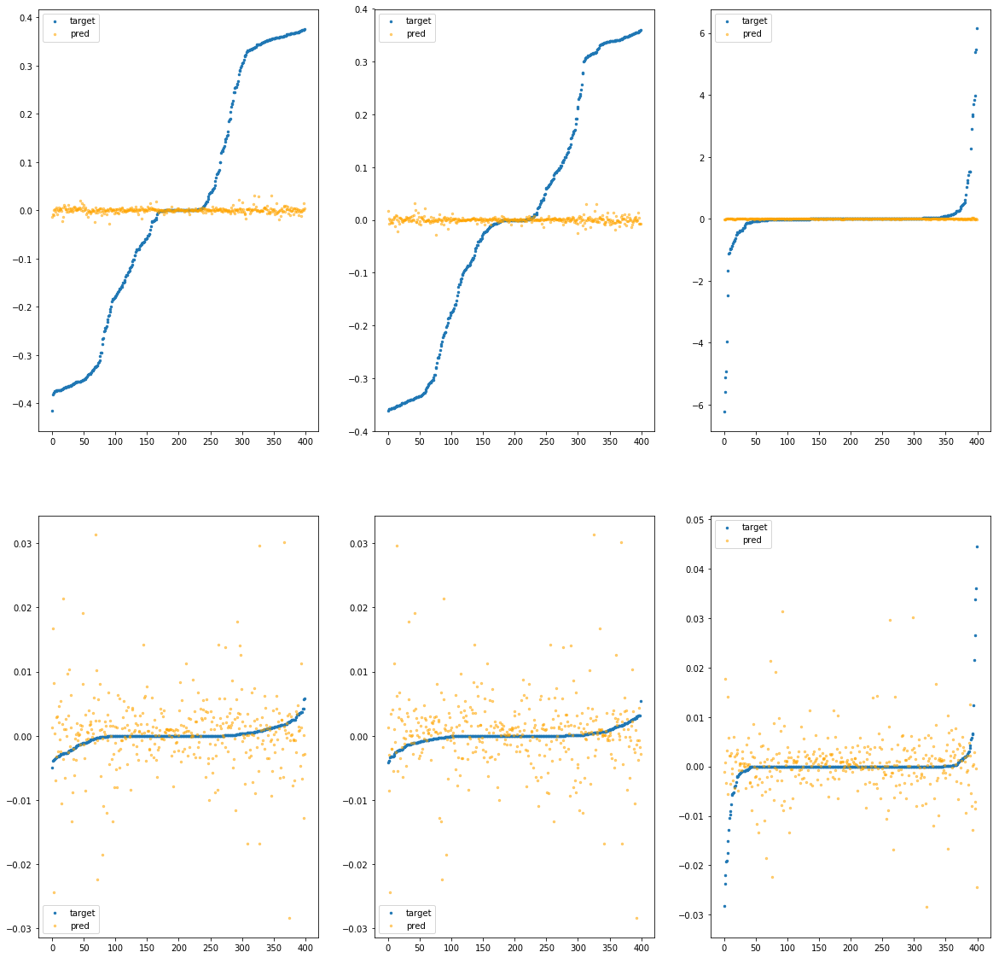

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bcaaf0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.29e-04	4.16e-01	2.05e-01	4.92e+02	6.41e-02	4.11e-03
y		8.82e-04	3.65e-01	1.88e-01	7.75e+01	5.48e-02	3.00e-03
z		-1.02e-03	6.24e+00	2.78e-01	5.04e+01	8.76e-01	7.67e-01
phi		-6.36e+00	1.76e-02	2.57e-03	1.98e+05	1.37e-05	1.88e-10
theta		-9.42e+00	1.72e-02	2.46e-03	8.06e+04	1.32e-05	1.75e-10
psi		-5.47e-01	4.63e-02	3.20e-03	3.70e+04	3.79e-05	1.44e-09


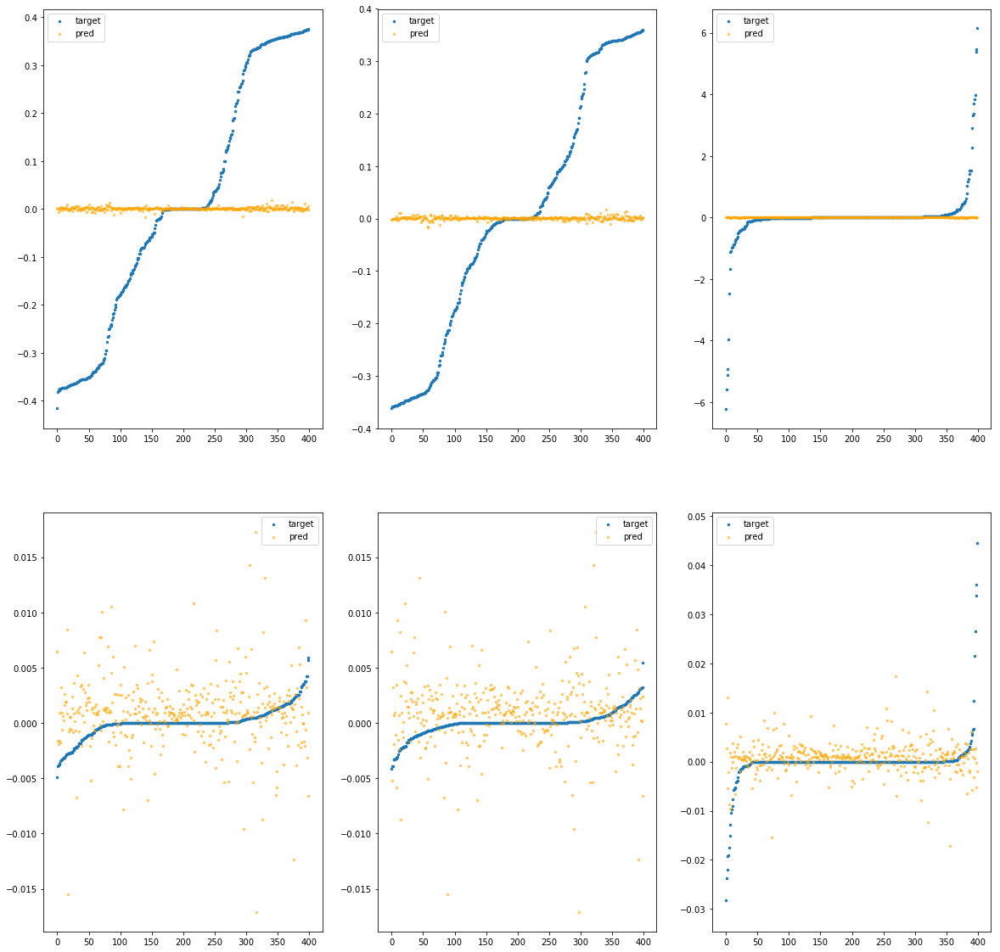

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bcab50>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.33e-03	4.12e-01	2.05e-01	2.94e+02	6.40e-02	4.10e-03
y		2.93e-04	3.76e-01	1.88e-01	3.45e+01	5.48e-02	3.00e-03
z		-1.81e-03	6.25e+00	2.78e-01	3.32e+01	8.76e-01	7.68e-01
phi		-1.17e+01	3.04e-02	3.00e-03	1.26e+05	2.37e-05	5.61e-10
theta		-1.72e+01	3.04e-02	2.96e-03	3.90e+04	2.31e-05	5.33e-10
psi		-1.01e+00	5.19e-02	3.73e-03	5.38e+04	4.92e-05	2.42e-09


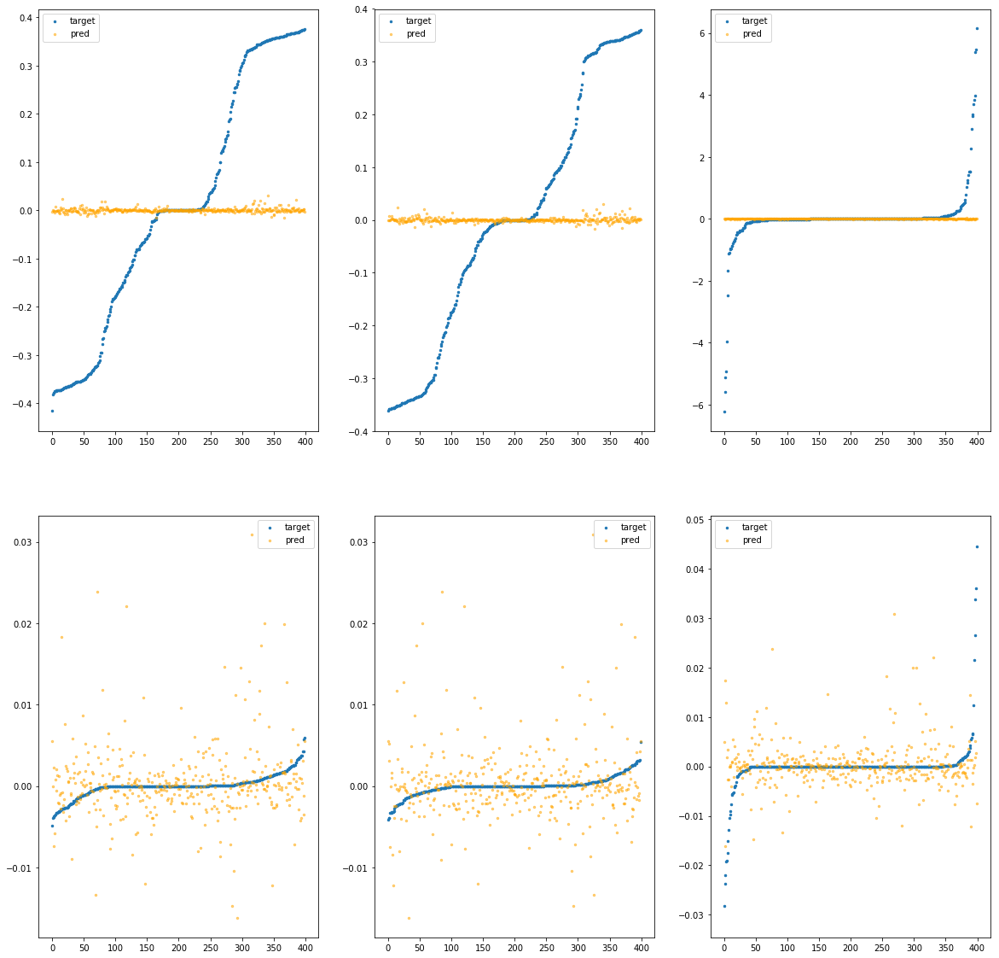

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bcabb0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.65e-03	4.15e-01	2.06e-01	9.06e+02	6.45e-02	4.17e-03
y		1.55e-03	3.64e-01	1.88e-01	1.44e+02	5.47e-02	3.00e-03
z		-1.39e-03	6.22e+00	2.78e-01	8.17e+01	8.76e-01	7.68e-01
phi		-1.48e+01	2.44e-02	3.77e-03	3.39e+05	2.95e-05	8.68e-10
theta		-2.31e+01	2.42e-02	3.83e-03	1.38e+05	3.06e-05	9.36e-10
psi		-1.31e+00	4.44e-02	4.57e-03	7.55e+04	5.67e-05	3.22e-09


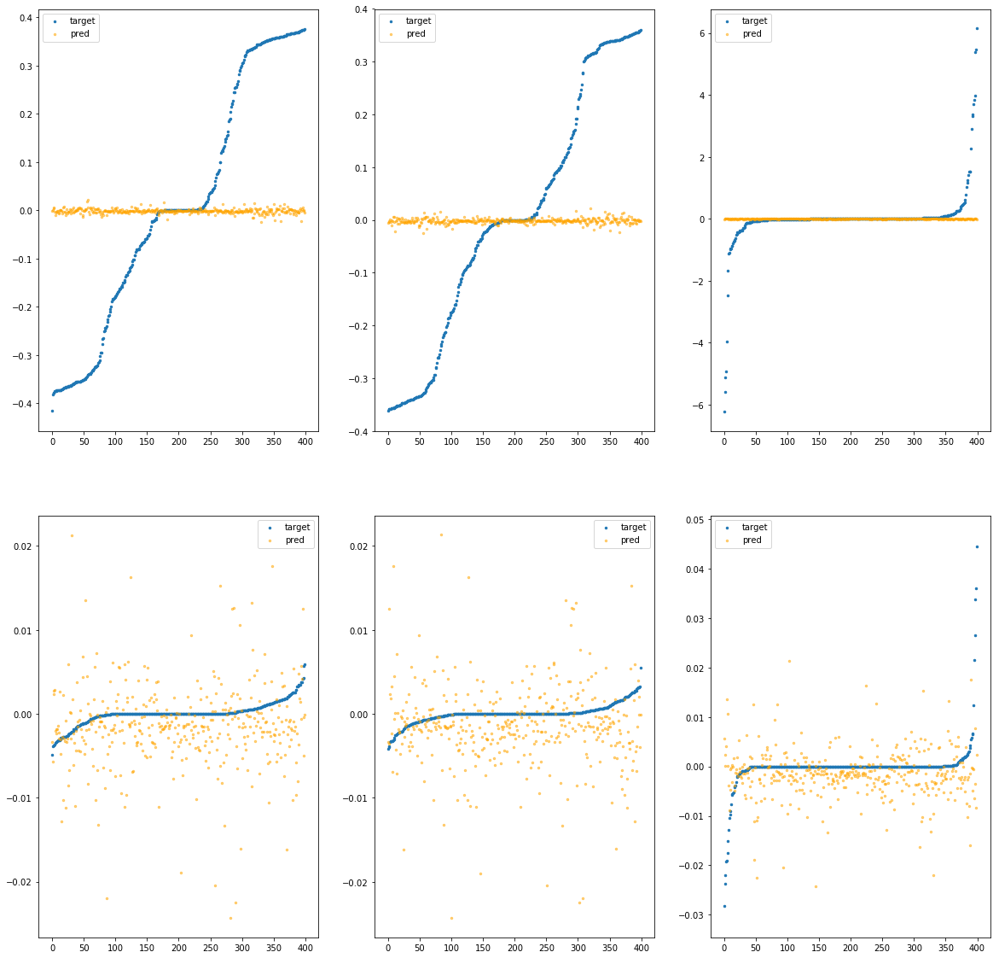

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bcac10>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.42e-03	4.22e-01	2.06e-01	2.44e+02	6.44e-02	4.15e-03
y		-1.49e-03	3.64e-01	1.88e-01	2.48e+01	5.49e-02	3.01e-03
z		-1.01e-03	6.22e+00	2.78e-01	2.66e+01	8.76e-01	7.67e-01
phi		-7.29e+00	2.17e-02	2.69e-03	9.83e+04	1.54e-05	2.38e-10
theta		-1.06e+01	2.10e-02	2.63e-03	1.29e+04	1.47e-05	2.15e-10
psi		-3.20e-01	3.52e-02	3.21e-03	4.14e+04	3.24e-05	1.05e-09


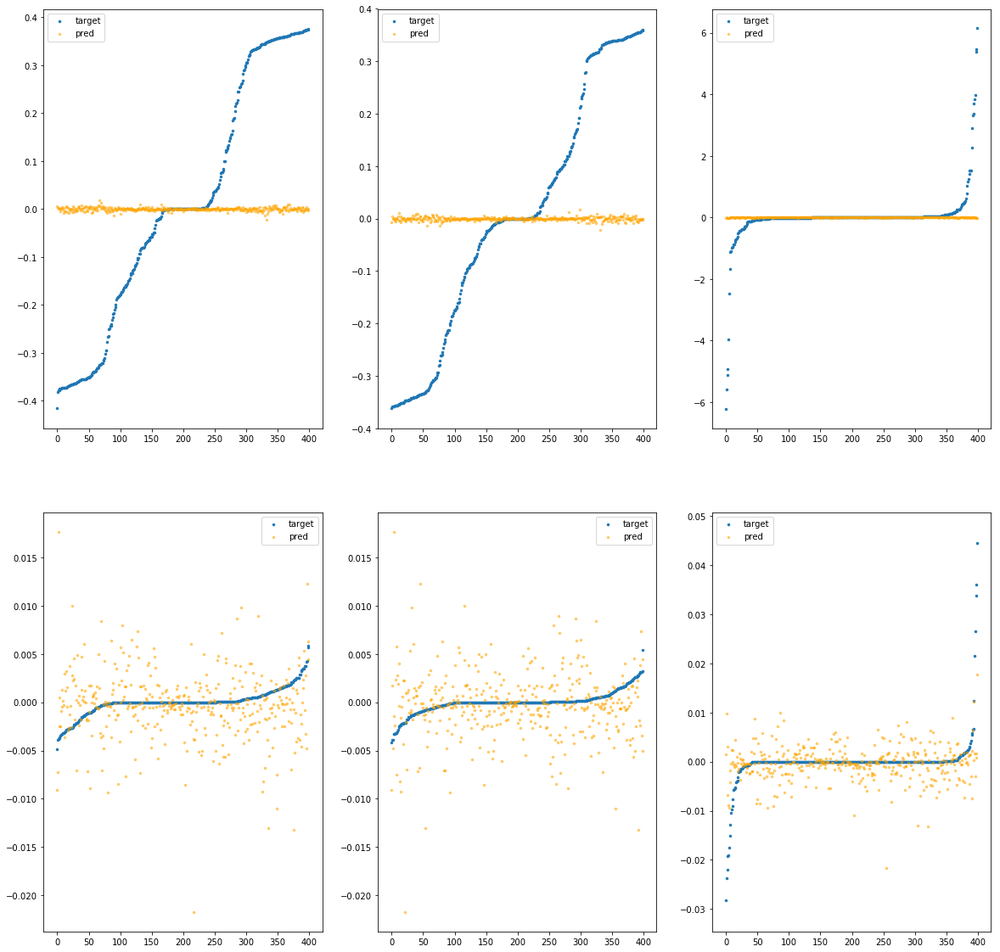

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bcac70>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.44e-04	3.90e-01	2.05e-01	2.88e+02	6.41e-02	4.12e-03
y		3.96e-04	3.70e-01	1.88e-01	6.69e+01	5.48e-02	3.00e-03
z		-1.10e-03	6.23e+00	2.78e-01	3.83e+01	8.76e-01	7.67e-01
phi		-1.28e+01	3.12e-02	3.34e-03	1.08e+05	2.56e-05	6.56e-10
theta		-1.67e+01	2.52e-02	3.17e-03	4.10e+04	2.25e-05	5.08e-10
psi		-9.32e-01	4.23e-02	4.06e-03	4.17e+04	4.74e-05	2.25e-09


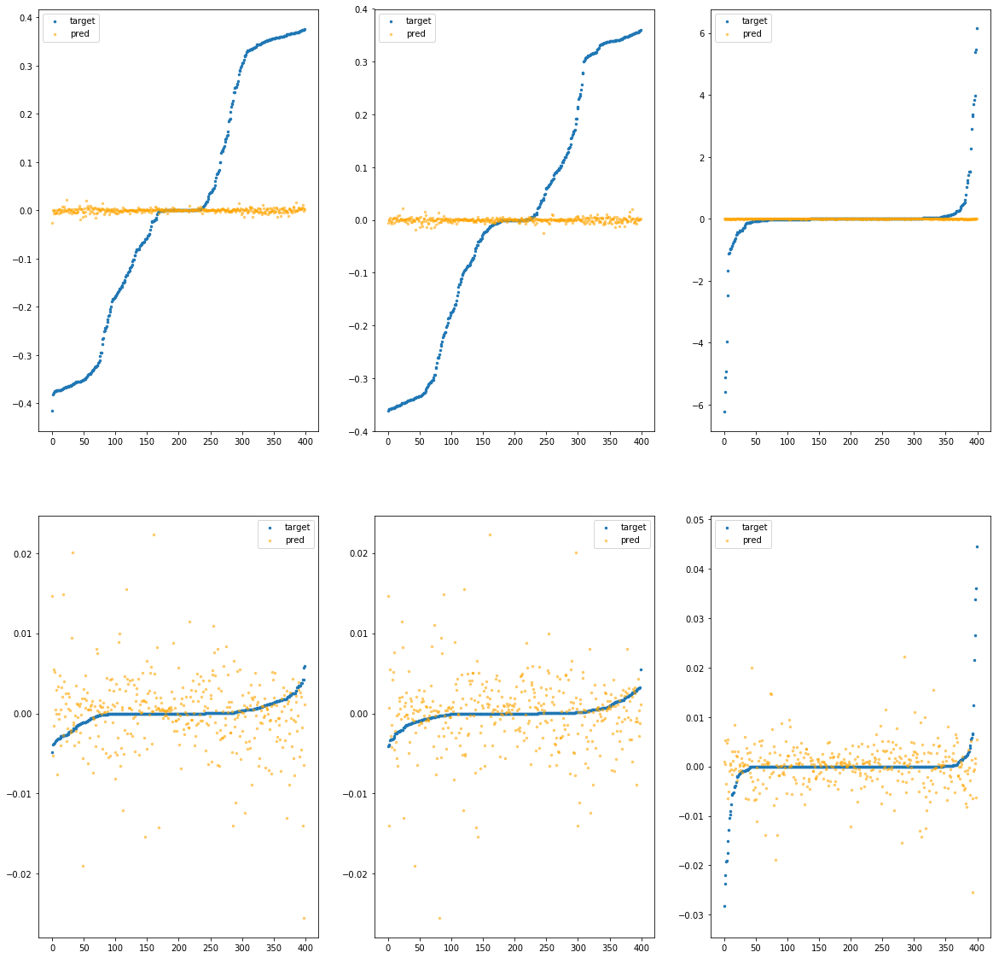

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bcacd0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		4.12e-04	3.97e-01	2.05e-01	4.36e+02	6.41e-02	4.11e-03
y		1.64e-03	3.61e-01	1.88e-01	7.03e+01	5.47e-02	3.00e-03
z		-1.57e-04	6.21e+00	2.77e-01	2.91e+01	8.75e-01	7.66e-01
phi		-1.10e+01	2.37e-02	3.26e-03	1.48e+05	2.24e-05	5.03e-10
theta		-1.56e+01	2.15e-02	3.18e-03	7.01e+04	2.11e-05	4.45e-10
psi		-6.52e-01	3.66e-02	3.76e-03	6.66e+04	4.05e-05	1.64e-09


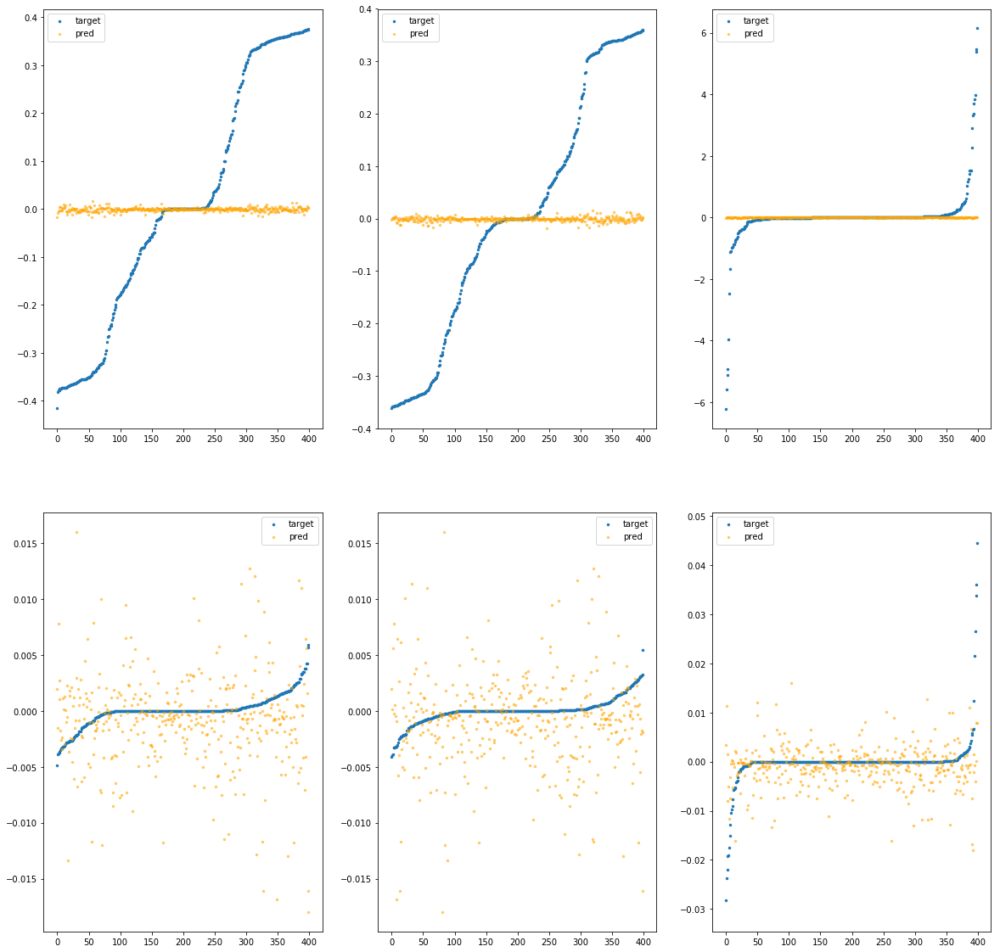

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bcad30>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.37e-03	4.17e-01	2.06e-01	2.11e+02	6.43e-02	4.14e-03
y		-2.01e-03	3.68e-01	1.88e-01	4.69e+01	5.49e-02	3.02e-03
z		-2.02e-03	6.21e+00	2.78e-01	2.76e+01	8.77e-01	7.68e-01
phi		-7.73e+00	1.68e-02	2.76e-03	7.93e+04	1.62e-05	2.64e-10
theta		-1.20e+01	1.70e-02	2.79e-03	5.53e+04	1.66e-05	2.74e-10
psi		-7.57e-01	3.82e-02	3.55e-03	3.71e+04	4.31e-05	1.86e-09


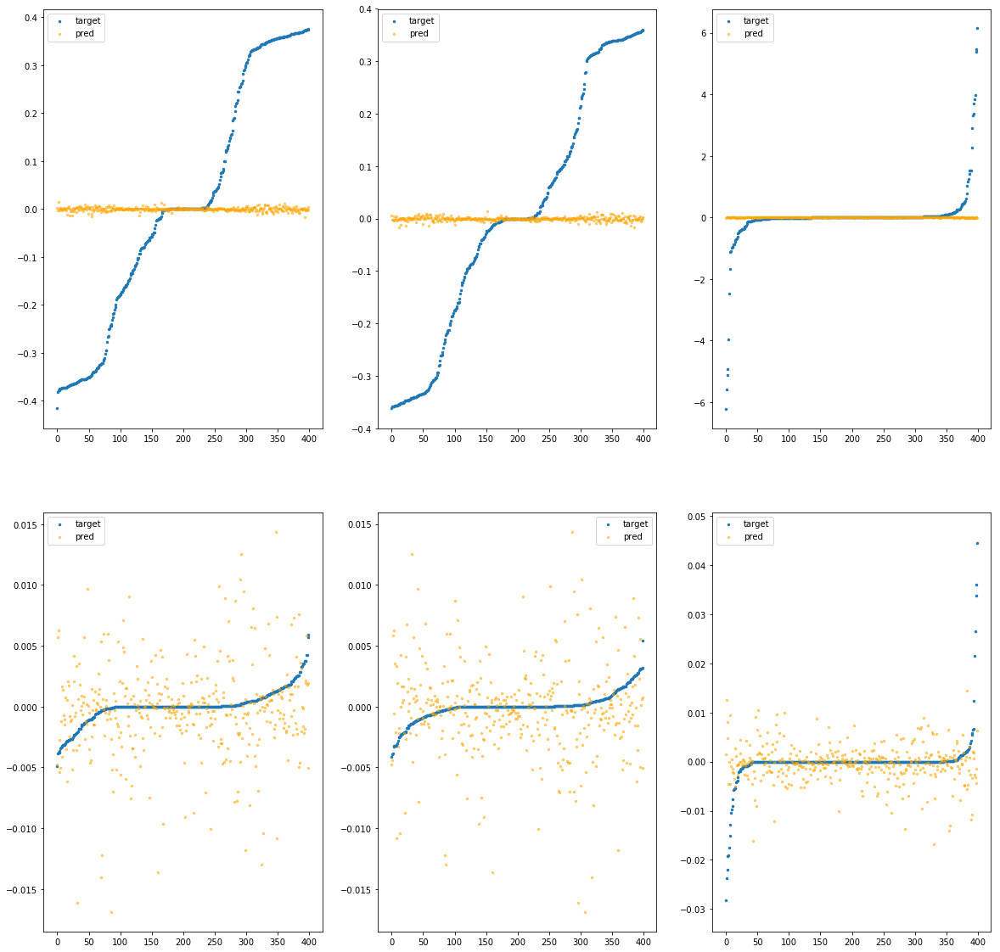

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bcad90>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.39e-04	4.15e-01	2.05e-01	2.45e+02	6.42e-02	4.12e-03
y		1.27e-03	3.65e-01	1.88e-01	6.92e+01	5.48e-02	3.00e-03
z		-4.67e-04	6.22e+00	2.77e-01	1.58e+01	8.75e-01	7.66e-01
phi		-6.25e+00	1.94e-02	2.46e-03	1.09e+05	1.35e-05	1.82e-10
theta		-8.99e+00	1.94e-02	2.39e-03	1.85e+04	1.27e-05	1.61e-10
psi		-5.96e-01	5.30e-02	3.13e-03	2.65e+04	3.92e-05	1.53e-09


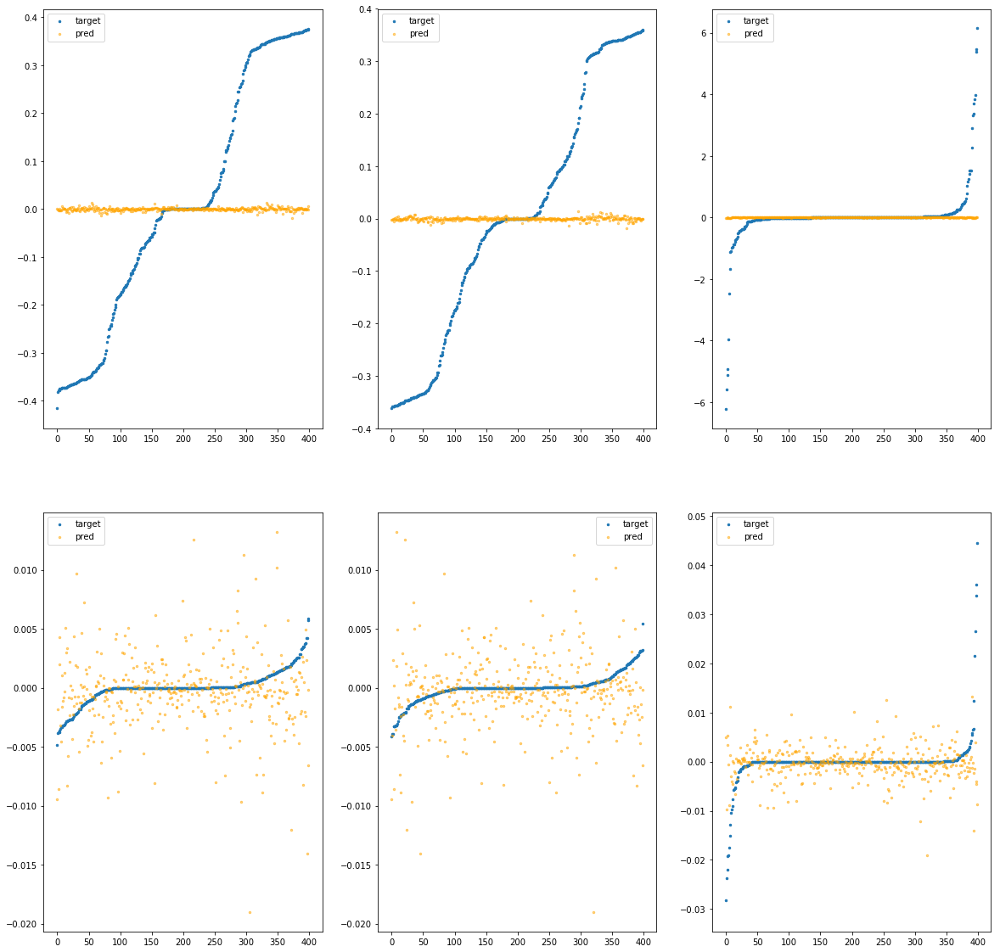

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bcadf0>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.05e-03	4.17e-01	2.06e-01	6.14e+02	6.43e-02	4.14e-03
y		-5.27e-04	3.65e-01	1.88e-01	7.45e+01	5.49e-02	3.01e-03
z		-1.81e-03	6.22e+00	2.78e-01	3.99e+01	8.76e-01	7.68e-01
phi		-6.67e+00	2.63e-02	2.53e-03	2.05e+05	1.43e-05	2.04e-10
theta		-9.64e+00	2.58e-02	2.46e-03	6.66e+04	1.35e-05	1.83e-10
psi		-2.78e-01	4.08e-02	3.10e-03	5.35e+04	3.13e-05	9.83e-10


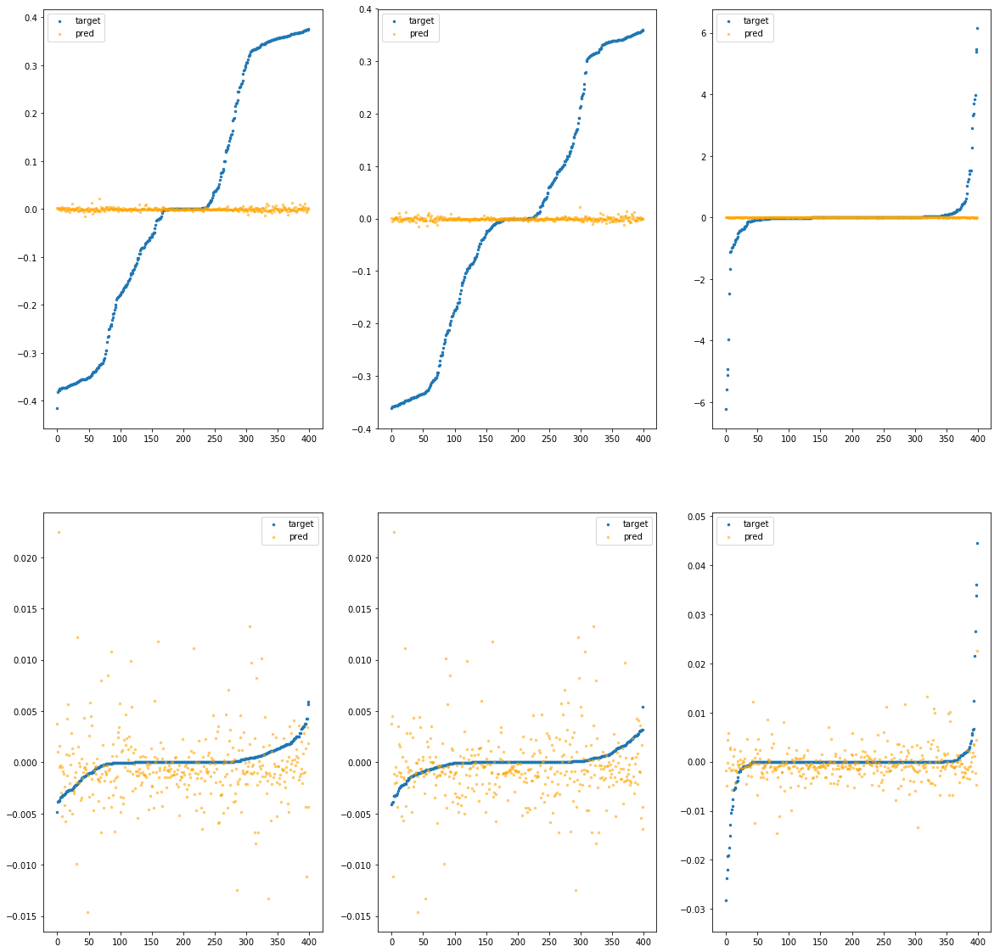

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.gradient_descent.SGD object at 0x7fba51bcae50>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.06e-03	4.24e-01	2.06e-01	1.62e+02	6.42e-02	4.13e-03
y		1.16e-04	3.67e-01	1.88e-01	3.97e+01	5.48e-02	3.00e-03
z		-1.86e-03	6.23e+00	2.78e-01	2.39e+01	8.76e-01	7.68e-01
phi		-7.25e+00	2.76e-02	2.60e-03	6.27e+04	1.54e-05	2.36e-10
theta		-1.21e+01	2.84e-02	2.68e-03	3.64e+04	1.66e-05	2.77e-10
psi		-4.27e-01	3.84e-02	3.26e-03	4.27e+04	3.50e-05	1.22e-09


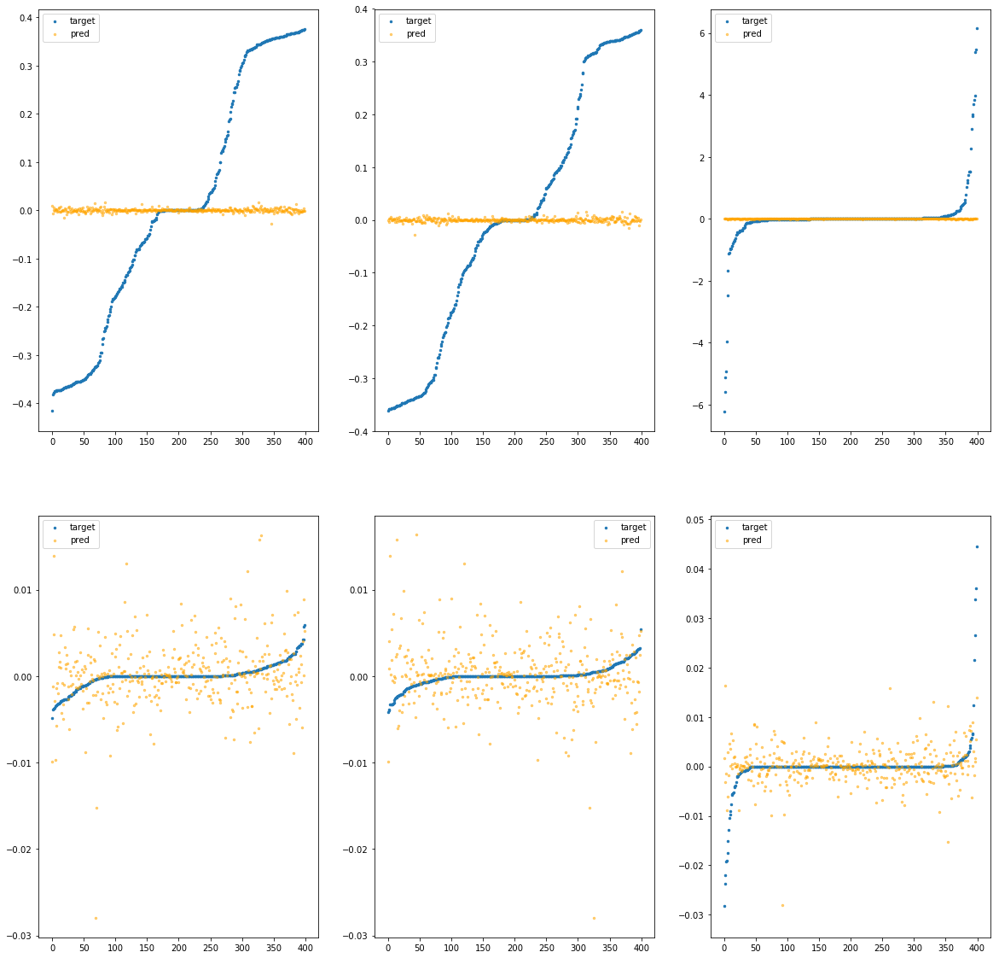

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bcaeb0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.46e-03	4.06e-01	2.07e-01	5.49e+03	6.45e-02	4.16e-03
y		-5.57e-03	3.70e-01	1.89e-01	7.30e+02	5.51e-02	3.04e-03
z		-1.59e-03	6.22e+00	2.80e-01	3.83e+02	8.76e-01	7.68e-01
phi		-4.39e+01	1.63e-02	9.03e-03	2.10e+06	8.36e-05	6.99e-09
theta		-6.37e+01	1.62e-02	8.98e-03	7.54e+05	8.21e-05	6.74e-09
psi		-3.28e+00	5.52e-02	9.38e-03	2.46e+05	1.05e-04	1.10e-08


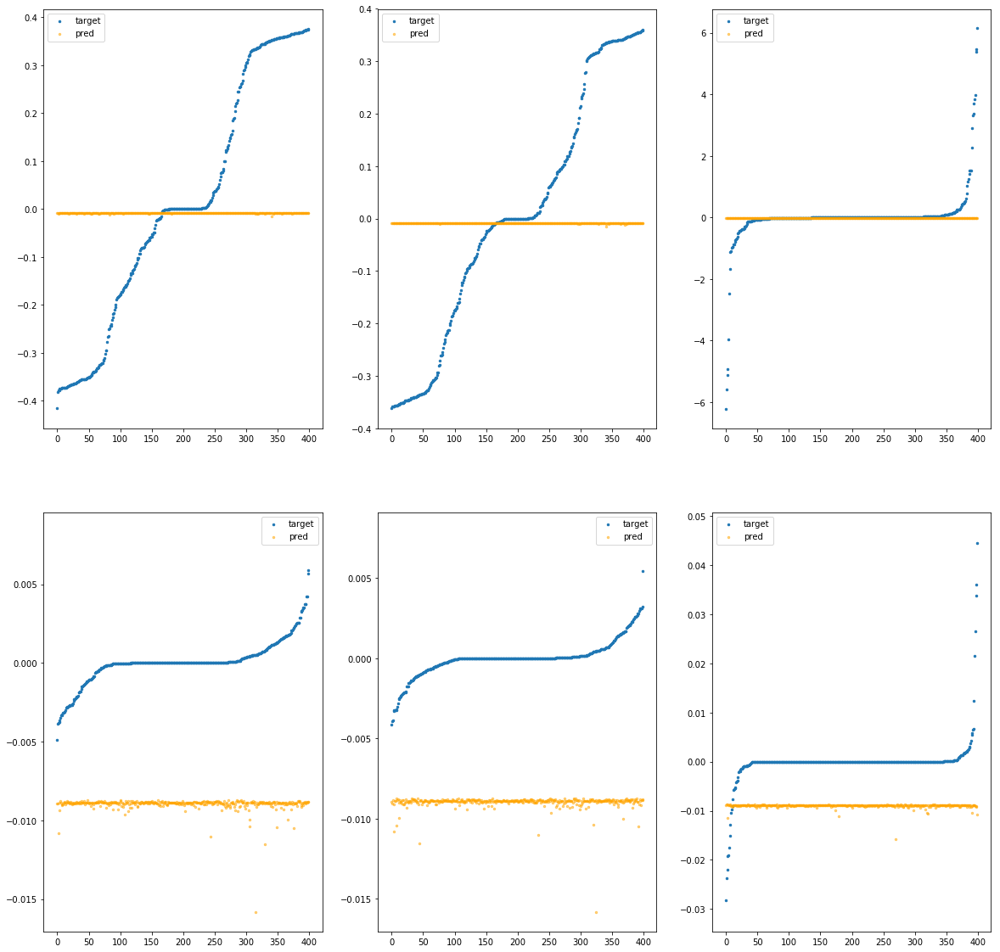

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bcaf10>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.01e-03	4.05e-01	2.07e-01	6.11e+03	6.46e-02	4.17e-03
y		-6.00e-03	3.71e-01	1.89e-01	8.13e+02	5.52e-02	3.04e-03
z		-2.07e-03	6.22e+00	2.80e-01	4.27e+02	8.77e-01	7.69e-01
phi		-5.51e+01	1.78e-02	1.01e-02	2.33e+06	1.04e-04	1.09e-08
theta		-8.00e+01	1.83e-02	1.01e-02	8.40e+05	1.03e-04	1.06e-08
psi		-4.12e+00	5.47e-02	1.04e-02	2.74e+05	1.26e-04	1.58e-08


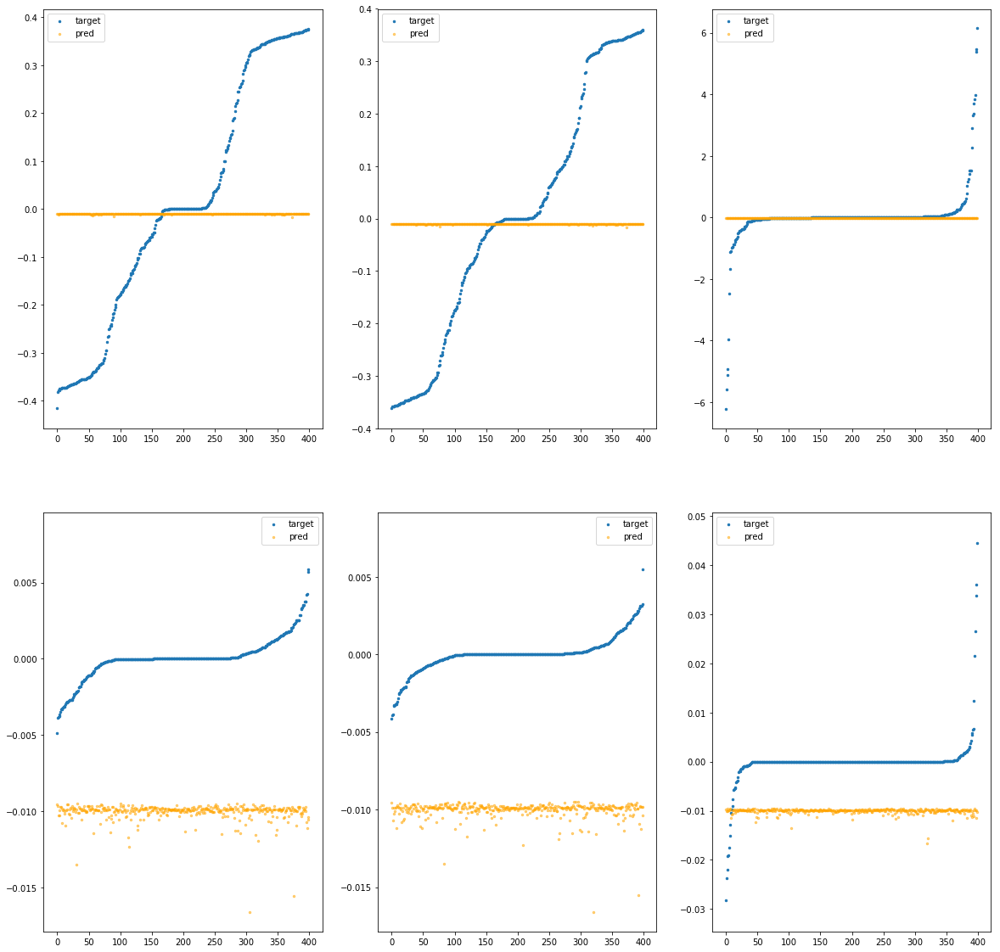

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bcaf70>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.68e-04	4.30e-01	2.08e-01	9.45e+03	6.41e-02	4.11e-03
y		-1.30e-03	3.77e-01	1.90e-01	1.26e+03	5.49e-02	3.01e-03
z		-3.67e-04	6.24e+00	2.82e-01	6.54e+02	8.75e-01	7.66e-01
phi		-1.23e+02	2.06e-02	1.51e-02	3.61e+06	2.32e-04	5.36e-08
theta		-1.82e+02	1.99e-02	1.52e-02	1.30e+06	2.32e-04	5.39e-08
psi		-9.46e+00	4.40e-02	1.57e-02	4.19e+05	2.57e-04	6.58e-08


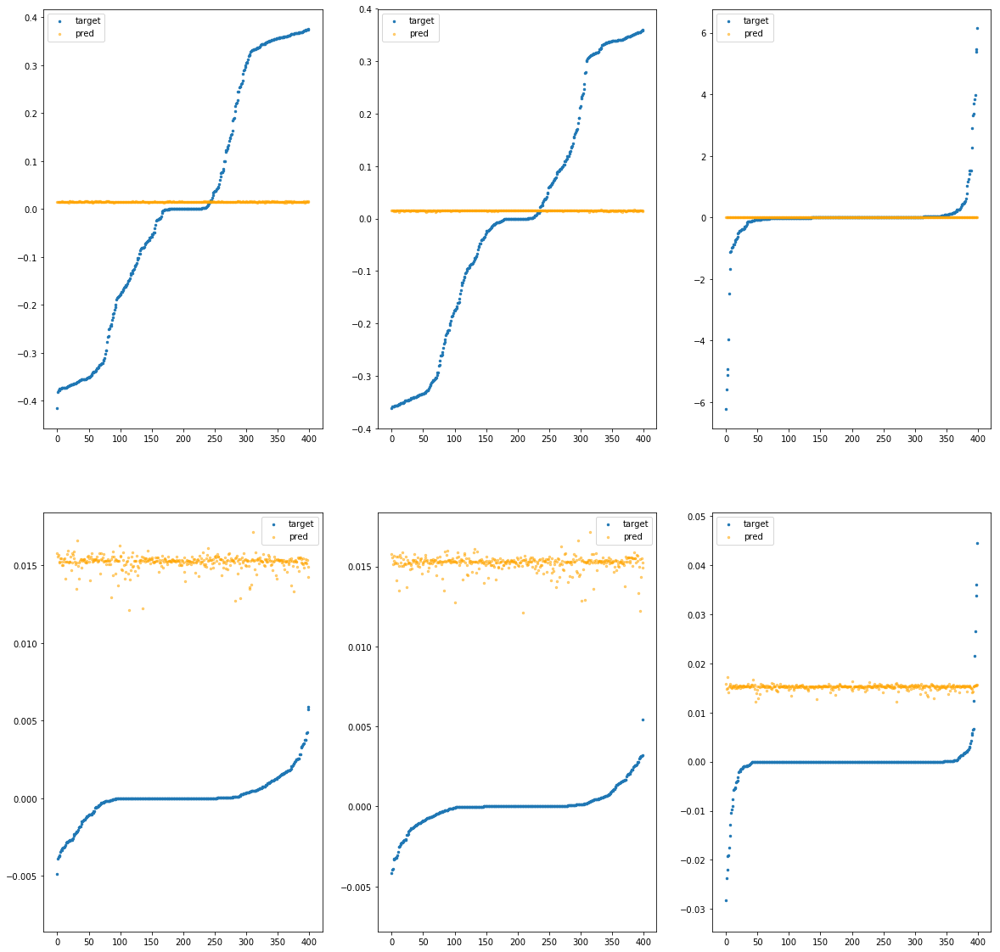

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bcafd0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.41e-03	4.34e-01	2.10e-01	1.28e+04	6.42e-02	4.12e-03
y		-2.97e-03	3.82e-01	1.91e-01	1.70e+03	5.50e-02	3.02e-03
z		-9.31e-05	6.25e+00	2.85e-01	8.89e+02	8.75e-01	7.66e-01
phi		-2.29e+02	2.62e-02	2.07e-02	4.89e+06	4.29e-04	1.84e-07
theta		-3.38e+02	2.54e-02	2.07e-02	1.76e+06	4.30e-04	1.85e-07
psi		-1.75e+01	4.90e-02	2.10e-02	5.70e+05	4.55e-04	2.07e-07


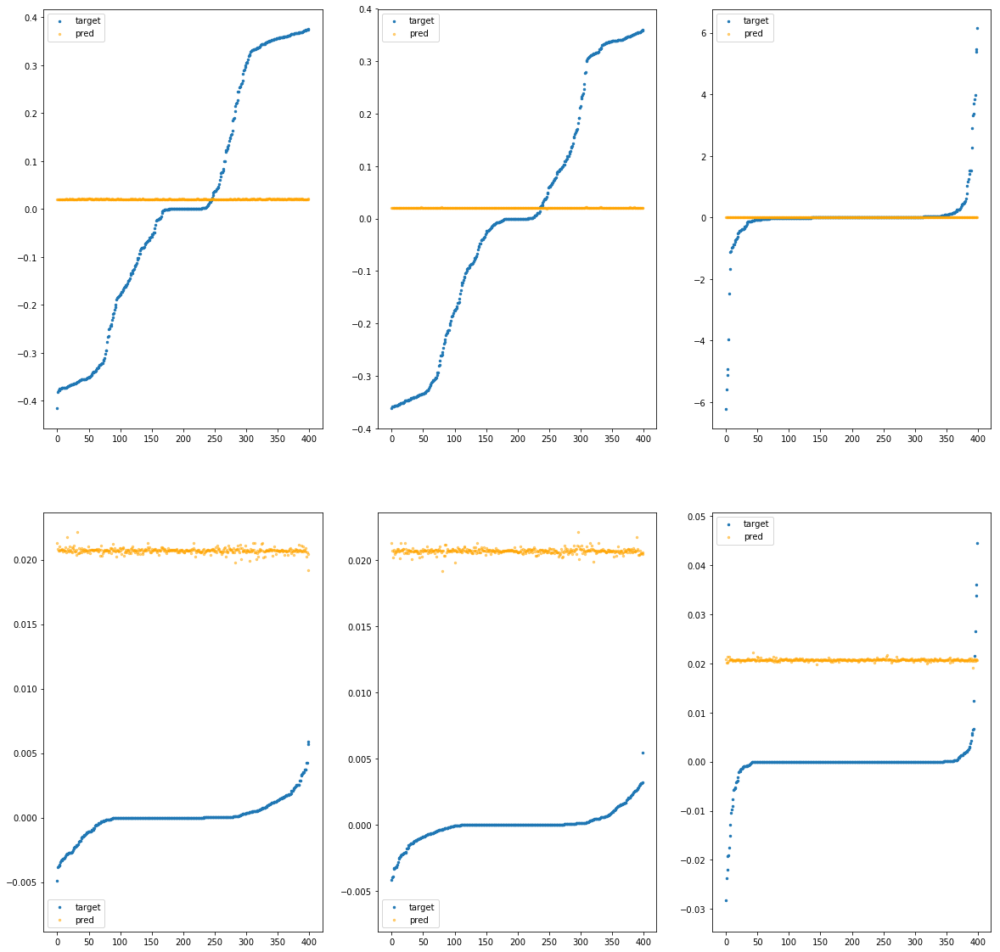

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd4070>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.14e-02	4.02e-01	2.10e-01	1.60e+04	6.55e-02	4.29e-03
y		-2.10e-02	3.87e-01	1.93e-01	2.13e+03	5.60e-02	3.13e-03
z		-3.58e-03	6.20e+00	2.88e-01	1.12e+03	8.78e-01	7.71e-01
phi		-3.69e+02	3.66e-02	2.62e-02	6.12e+06	6.88e-04	4.74e-07
theta		-5.38e+02	3.34e-02	2.61e-02	2.20e+06	6.85e-04	4.69e-07
psi		-2.78e+01	7.00e-02	2.61e-02	7.16e+05	7.06e-04	4.98e-07


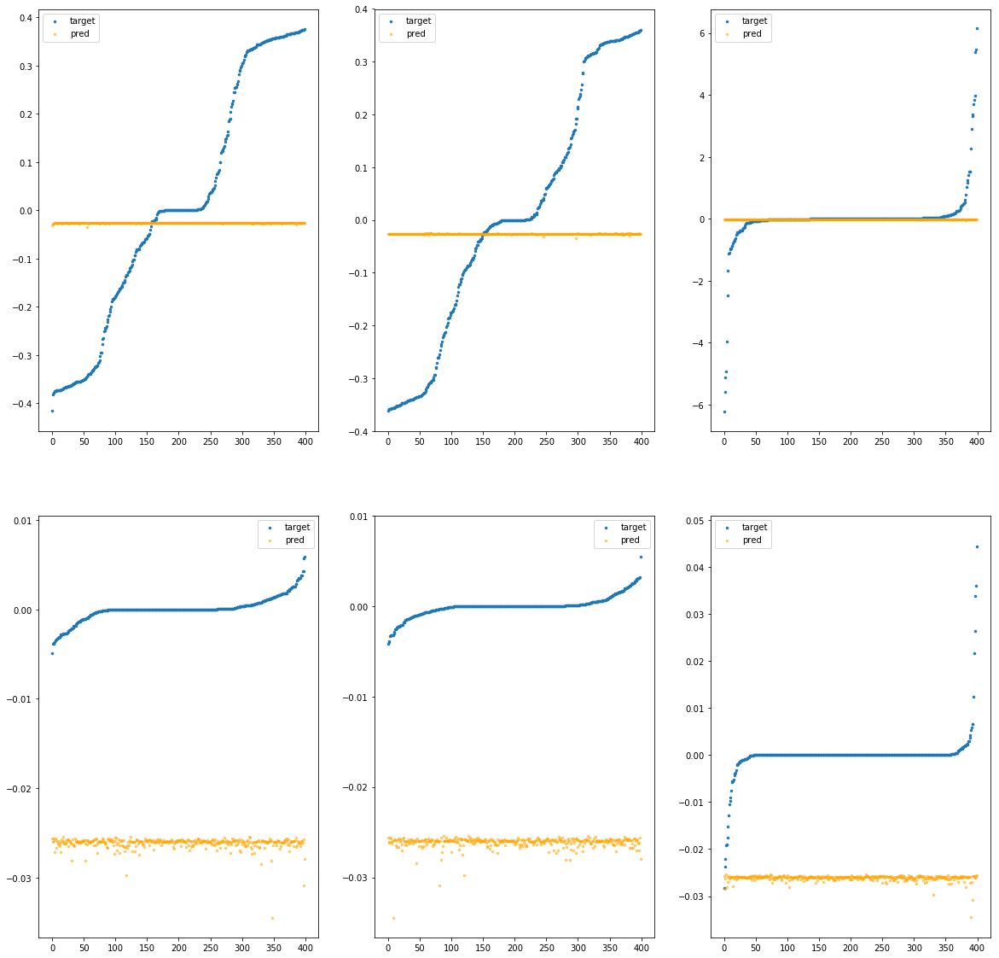

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd40d0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.05e-02	4.01e-01	2.08e-01	8.82e+03	6.48e-02	4.20e-03
y		-7.78e-03	3.75e-01	1.90e-01	1.17e+03	5.52e-02	3.05e-03
z		-1.95e-03	6.21e+00	2.82e-01	6.13e+02	8.77e-01	7.68e-01
phi		-1.10e+02	2.07e-02	1.43e-02	3.37e+06	2.06e-04	4.24e-08
theta		-1.60e+02	2.08e-02	1.42e-02	1.21e+06	2.04e-04	4.18e-08
psi		-8.37e+00	5.87e-02	1.45e-02	3.92e+05	2.30e-04	5.28e-08


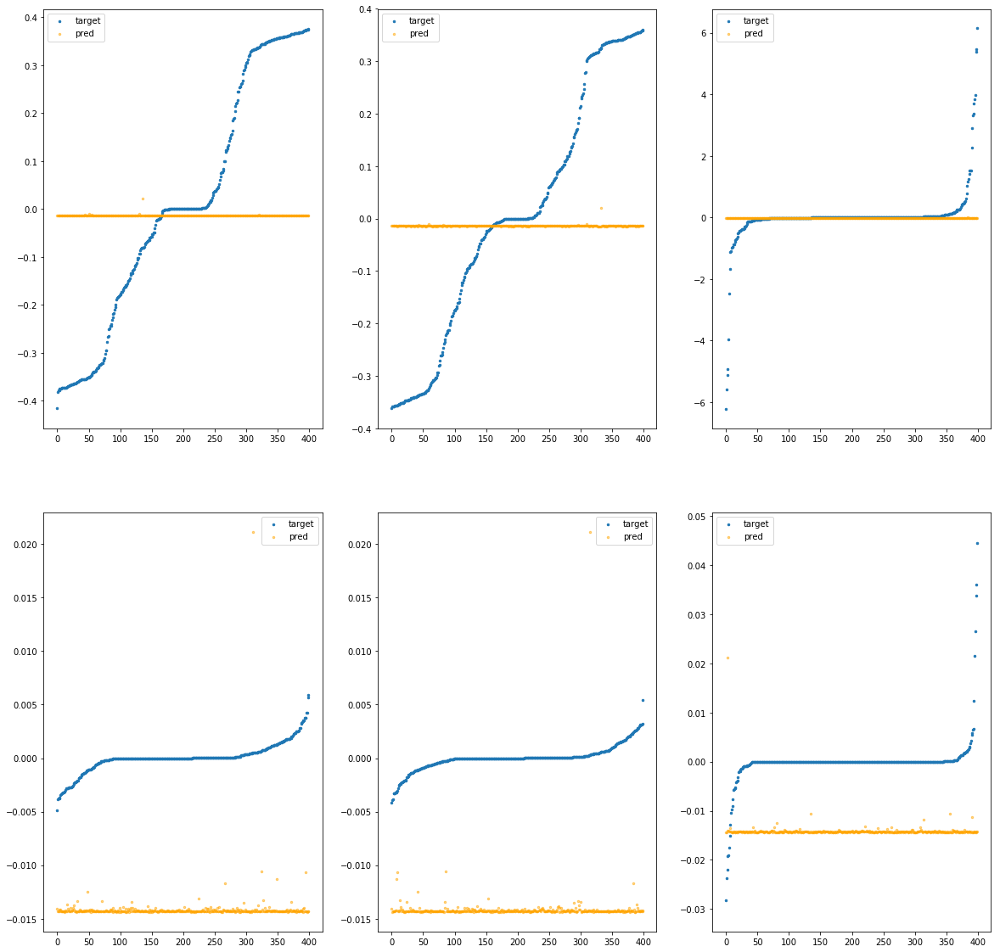

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd4130>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.96e-03	4.05e-01	2.07e-01	6.39e+03	6.46e-02	4.18e-03
y		-6.42e-03	3.71e-01	1.89e-01	8.52e+02	5.52e-02	3.04e-03
z		-2.20e-03	6.22e+00	2.80e-01	4.45e+02	8.77e-01	7.69e-01
phi		-6.00e+01	1.90e-02	1.05e-02	2.44e+06	1.13e-04	1.29e-08
theta		-8.71e+01	1.89e-02	1.05e-02	8.78e+05	1.12e-04	1.25e-08
psi		-4.47e+00	5.56e-02	1.08e-02	2.86e+05	1.34e-04	1.80e-08


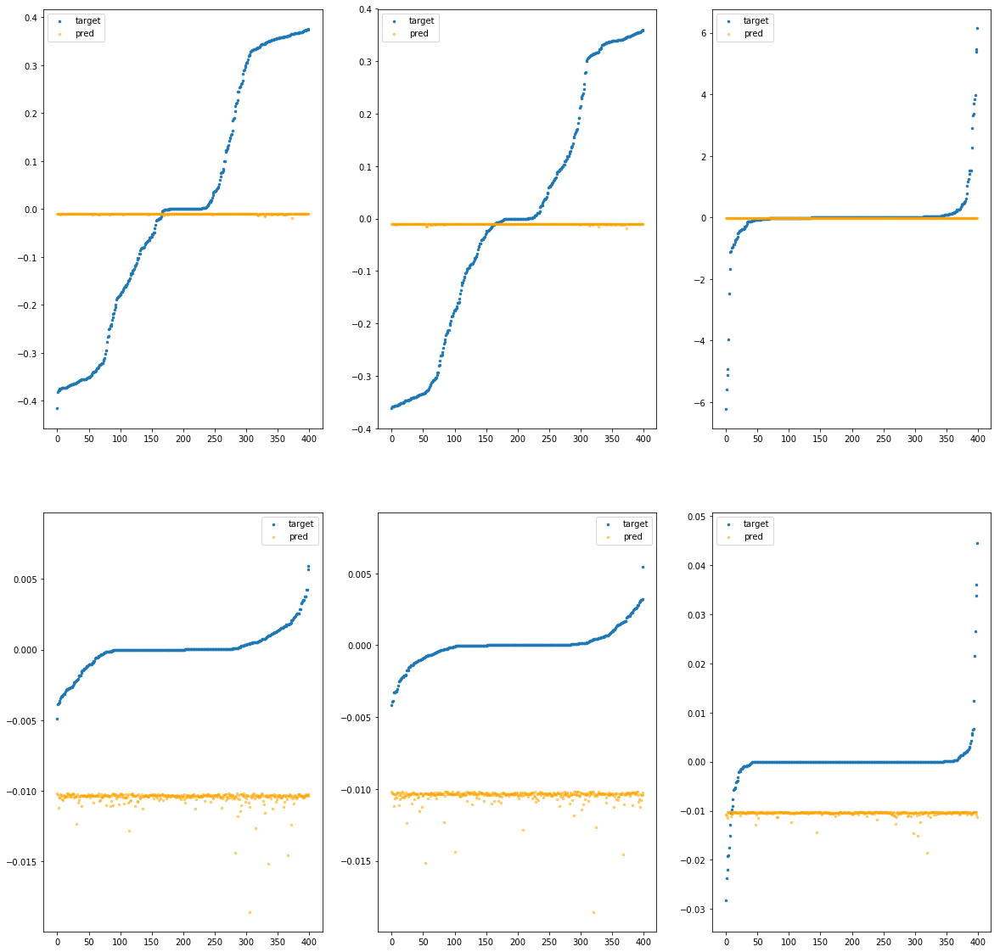

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd4190>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.96e-03	4.04e-01	2.07e-01	6.21e+03	6.46e-02	4.17e-03
y		-5.74e-03	3.71e-01	1.89e-01	8.27e+02	5.51e-02	3.04e-03
z		-1.53e-03	6.21e+00	2.80e-01	4.33e+02	8.76e-01	7.68e-01
phi		-5.56e+01	1.66e-02	1.02e-02	2.37e+06	1.05e-04	1.11e-08
theta		-8.09e+01	1.62e-02	1.01e-02	8.53e+05	1.04e-04	1.08e-08
psi		-4.12e+00	5.41e-02	1.04e-02	2.79e+05	1.26e-04	1.58e-08


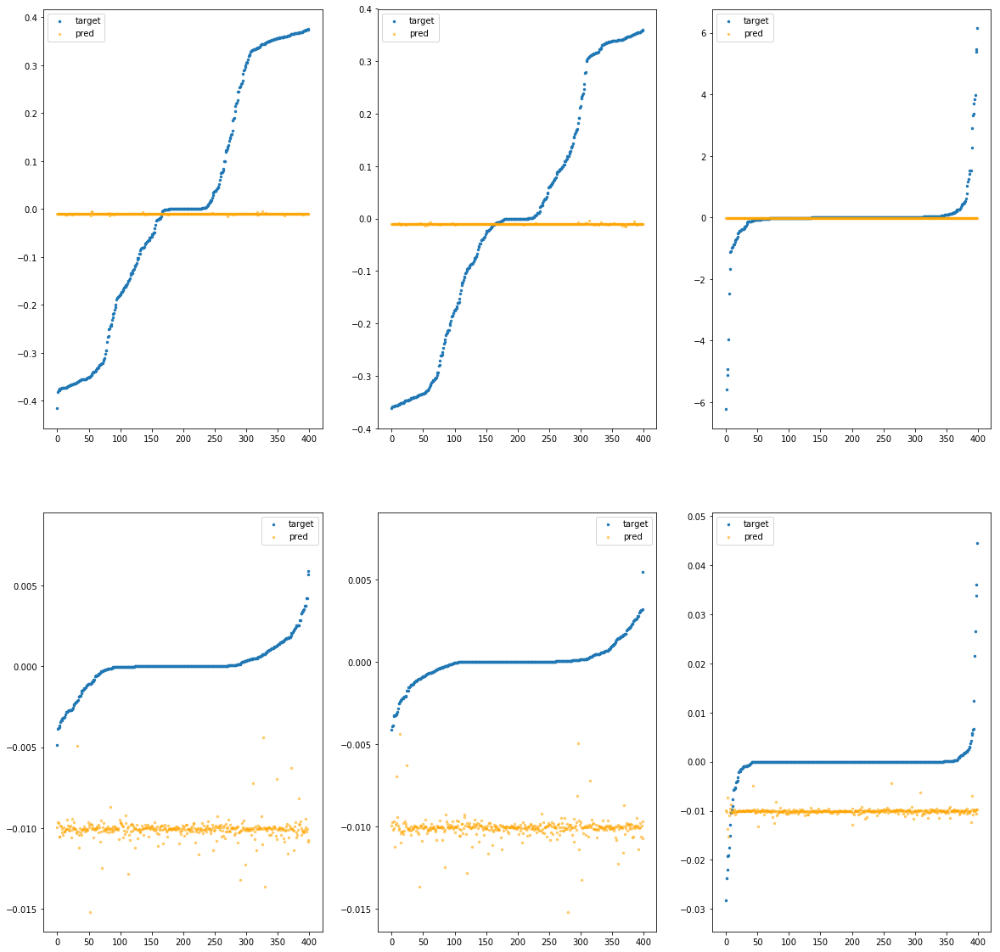

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd41f0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.31e-04	4.35e-01	2.09e-01	1.20e+04	6.42e-02	4.12e-03
y		-2.66e-03	3.81e-01	1.91e-01	1.60e+03	5.50e-02	3.02e-03
z		-6.74e-05	6.24e+00	2.84e-01	8.35e+02	8.75e-01	7.65e-01
phi		-2.01e+02	2.47e-02	1.93e-02	4.59e+06	3.76e-04	1.41e-07
theta		-2.96e+02	2.40e-02	1.94e-02	1.65e+06	3.77e-04	1.42e-07
psi		-1.54e+01	4.77e-02	1.97e-02	5.34e+05	4.02e-04	1.61e-07


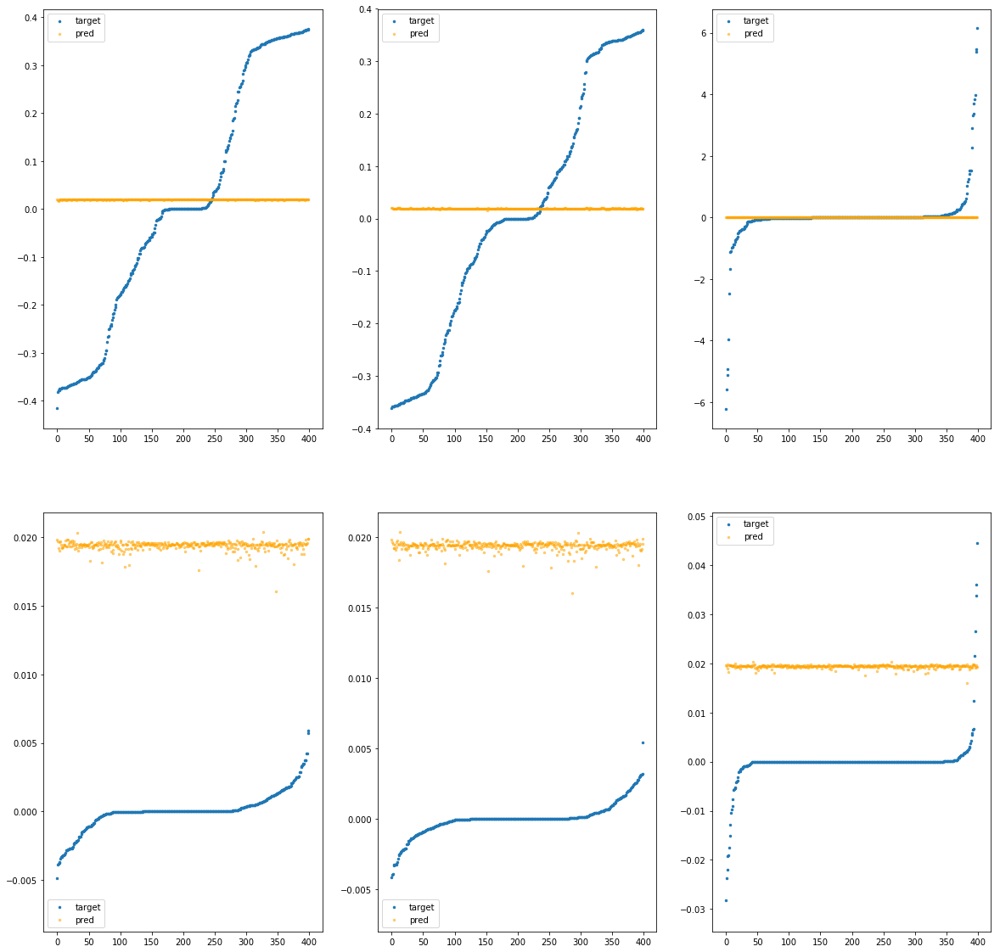

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd4250>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.71e-02	3.96e-01	2.09e-01	1.33e+04	6.52e-02	4.25e-03
y		-1.58e-02	3.83e-01	1.91e-01	1.77e+03	5.57e-02	3.10e-03
z		-3.16e-03	6.20e+00	2.86e-01	9.25e+02	8.78e-01	7.70e-01
phi		-2.52e+02	2.74e-02	2.17e-02	5.07e+06	4.72e-04	2.23e-07
theta		-3.68e+02	2.69e-02	2.16e-02	1.82e+06	4.69e-04	2.20e-07
psi		-1.90e+01	6.64e-02	2.16e-02	5.92e+05	4.91e-04	2.41e-07


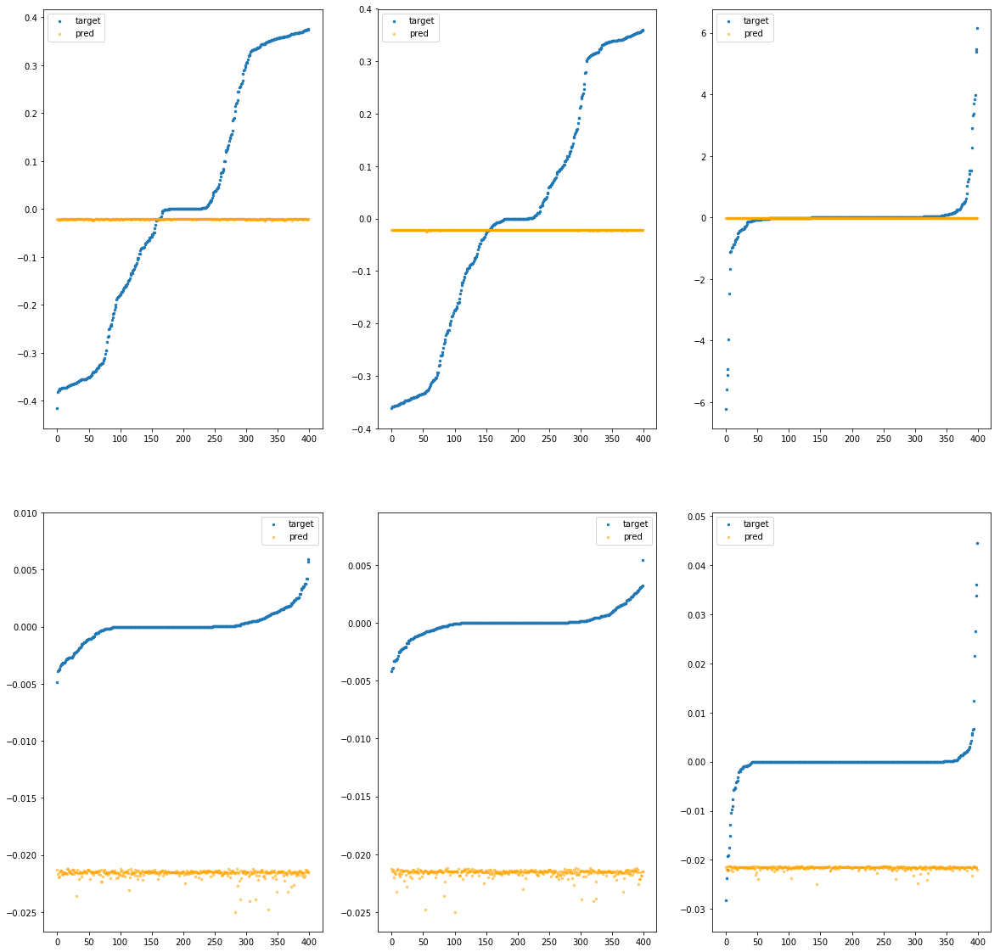

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd42b0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.34e-03	4.03e-01	2.07e-01	7.74e+03	6.46e-02	4.18e-03
y		-8.13e-03	3.94e-01	1.90e-01	1.03e+03	5.53e-02	3.05e-03
z		-1.14e-03	6.21e+00	2.81e-01	5.35e+02	8.76e-01	7.67e-01
phi		-9.22e+01	5.01e-02	1.28e-02	2.95e+06	1.74e-04	3.01e-08
theta		-1.34e+02	4.83e-02	1.27e-02	1.06e+06	1.71e-04	2.93e-08
psi		-6.75e+00	5.67e-02	1.29e-02	3.40e+05	1.90e-04	3.62e-08


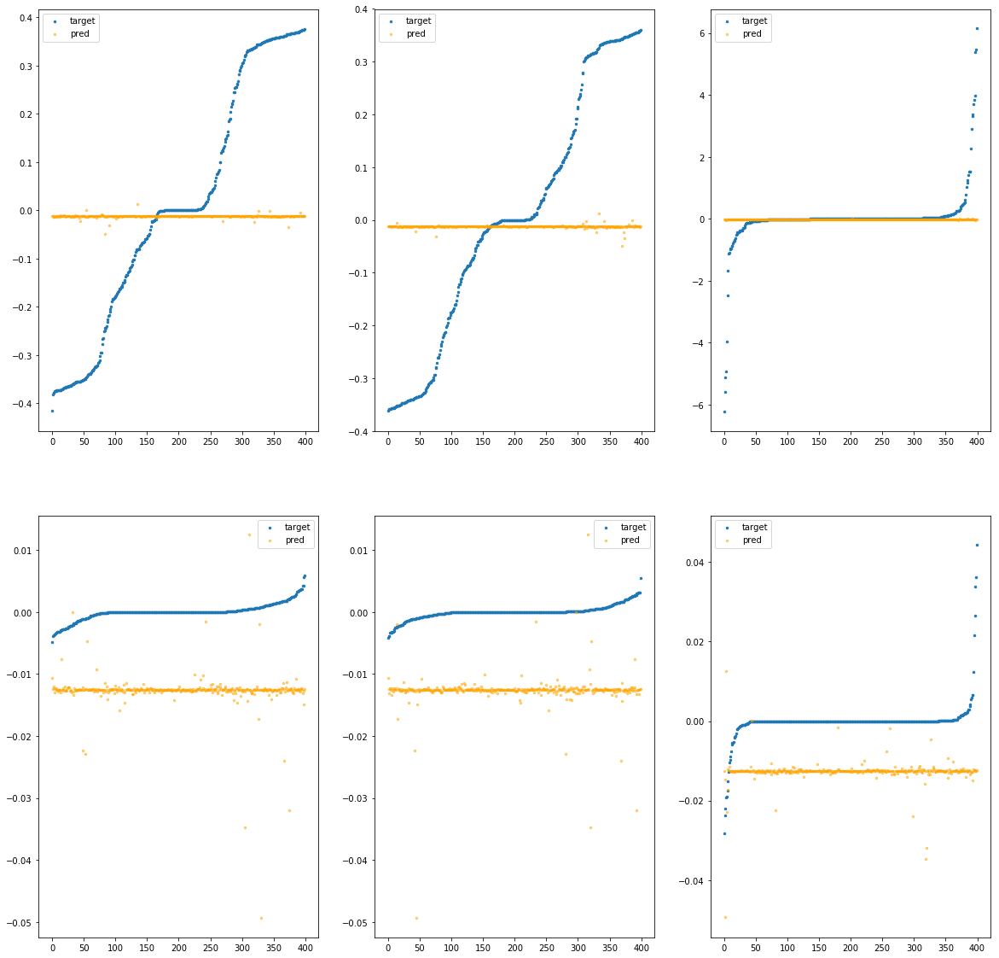

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd4310>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.10e-05	4.24e-01	2.07e-01	5.36e+03	6.41e-02	4.11e-03
y		-7.79e-04	3.70e-01	1.89e-01	7.14e+02	5.49e-02	3.01e-03
z		-5.14e-04	6.24e+00	2.80e-01	3.74e+02	8.75e-01	7.66e-01
phi		-3.99e+01	1.51e-02	8.58e-03	2.05e+06	7.61e-05	5.79e-09
theta		-5.90e+01	1.50e-02	8.62e-03	7.36e+05	7.62e-05	5.81e-09
psi		-3.03e+00	3.69e-02	9.27e-03	2.38e+05	9.88e-05	9.77e-09


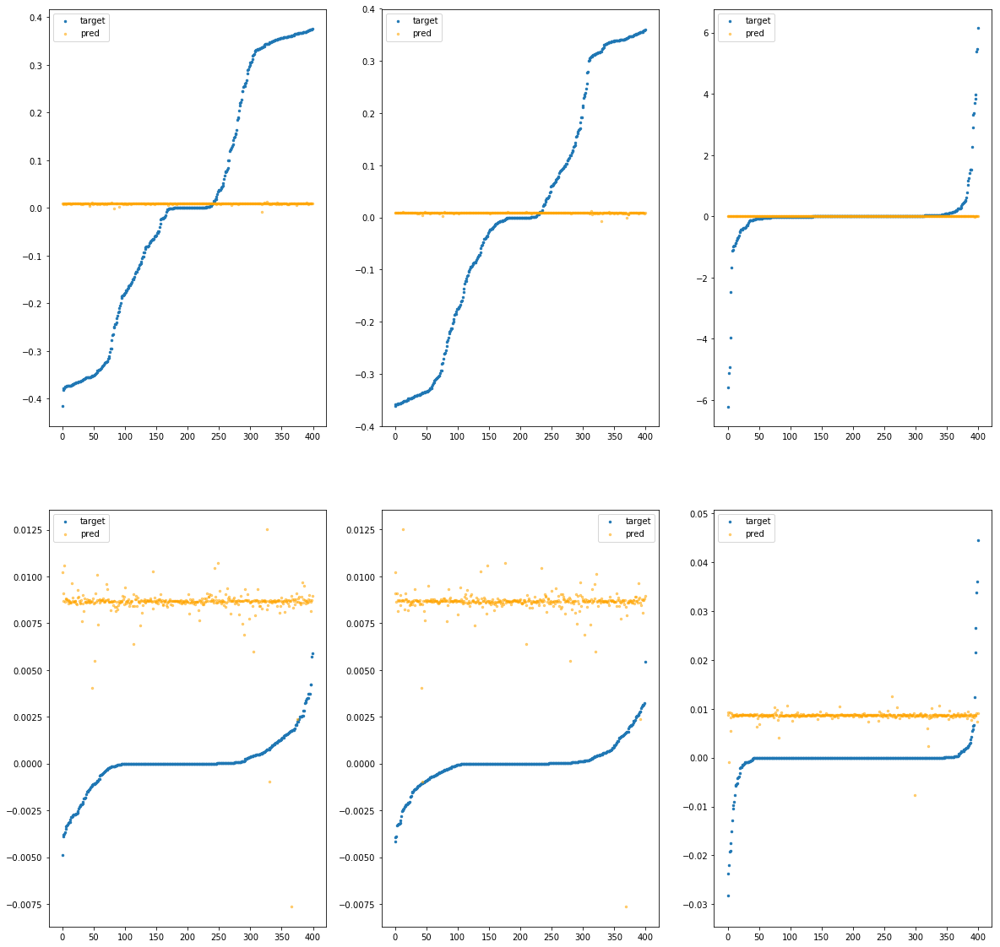

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd4370>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.54e-03	4.05e-01	2.07e-01	5.69e+03	6.45e-02	4.16e-03
y		-4.75e-03	3.70e-01	1.89e-01	7.59e+02	5.51e-02	3.03e-03
z		-1.75e-03	6.22e+00	2.80e-01	3.97e+02	8.76e-01	7.68e-01
phi		-4.69e+01	1.82e-02	9.30e-03	2.17e+06	8.91e-05	7.94e-09
theta		-6.80e+01	1.88e-02	9.25e-03	7.81e+05	8.76e-05	7.68e-09
psi		-3.47e+00	5.33e-02	9.63e-03	2.56e+05	1.10e-04	1.20e-08


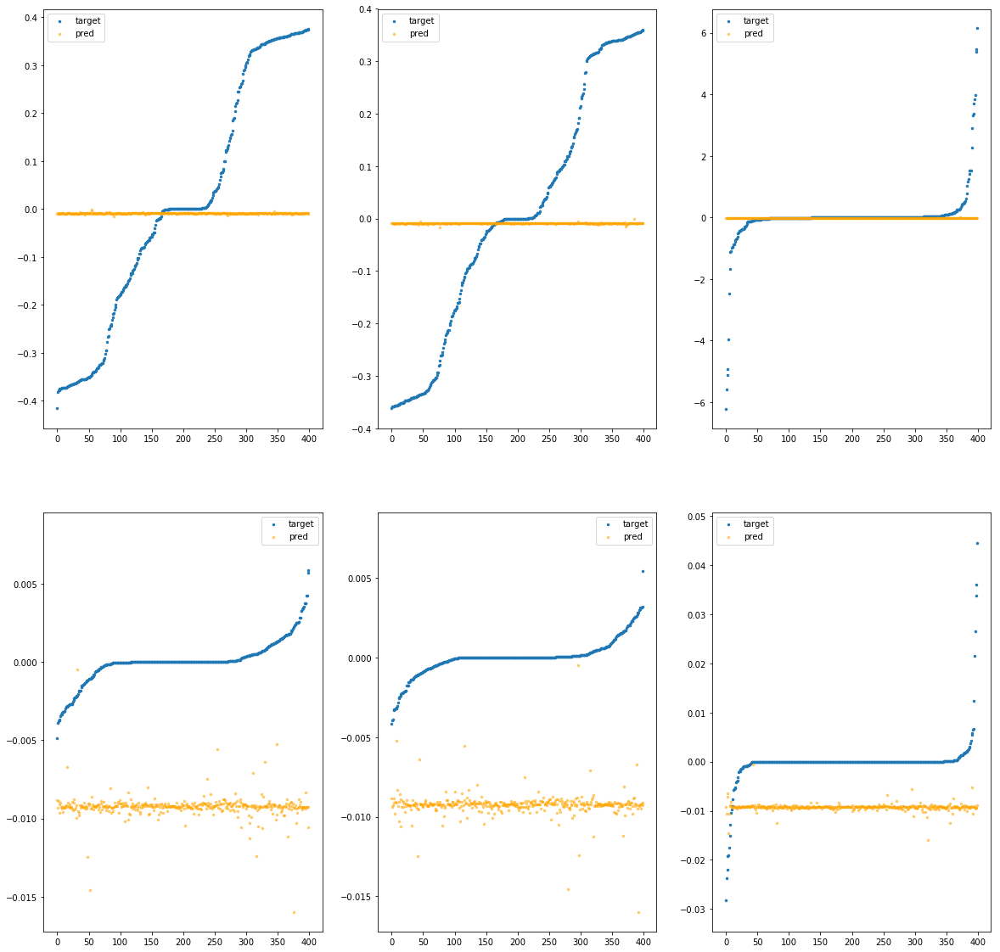

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd43d0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.58e-03	4.36e-01	2.10e-01	1.28e+04	6.42e-02	4.12e-03
y		-2.88e-03	3.82e-01	1.91e-01	1.70e+03	5.50e-02	3.02e-03
z		3.02e-05	6.25e+00	2.85e-01	8.91e+02	8.75e-01	7.65e-01
phi		-2.32e+02	3.06e-02	2.08e-02	4.89e+06	4.33e-04	1.88e-07
theta		-3.41e+02	2.84e-02	2.08e-02	1.76e+06	4.35e-04	1.89e-07
psi		-1.77e+01	4.88e-02	2.11e-02	5.71e+05	4.60e-04	2.11e-07


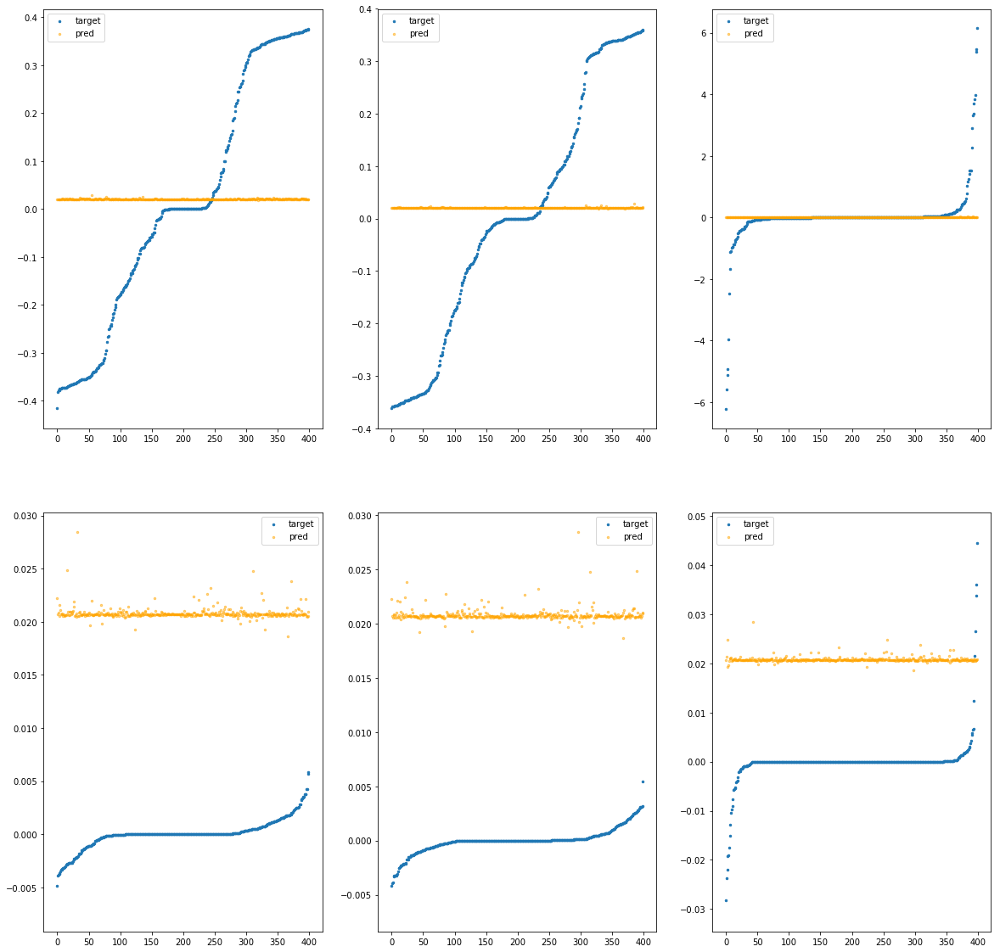

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd4430>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.86e-04	4.28e-01	2.08e-01	7.66e+03	6.42e-02	4.12e-03
y		-1.00e-04	3.74e-01	1.89e-01	1.02e+03	5.48e-02	3.01e-03
z		-3.17e-04	6.24e+00	2.81e-01	5.32e+02	8.75e-01	7.66e-01
phi		-8.42e+01	2.88e-02	1.24e-02	2.93e+06	1.59e-04	2.52e-08
theta		-1.24e+02	2.65e-02	1.25e-02	1.05e+06	1.59e-04	2.53e-08
psi		-6.48e+00	4.36e-02	1.30e-02	3.41e+05	1.83e-04	3.36e-08


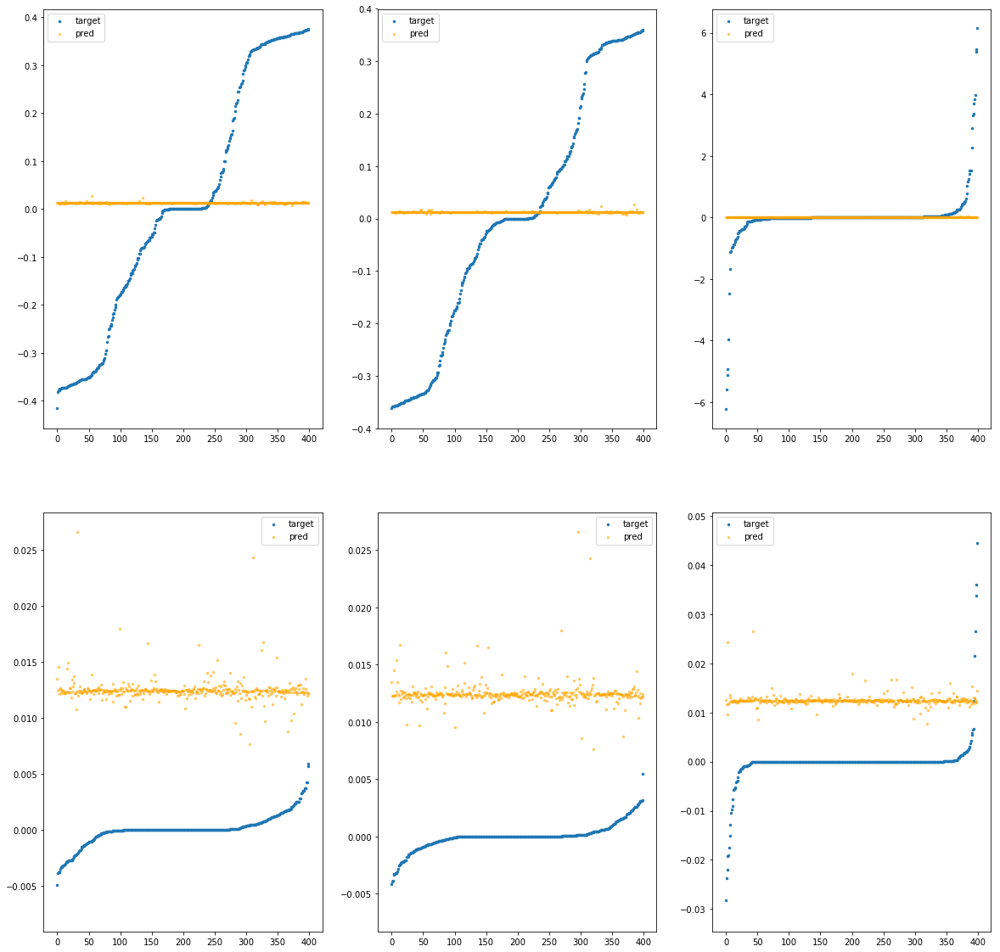

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd4490>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.34e-03	4.28e-01	2.08e-01	8.17e+03	6.42e-02	4.12e-03
y		4.34e-04	3.75e-01	1.90e-01	1.09e+03	5.48e-02	3.00e-03
z		-1.50e-04	6.25e+00	2.81e-01	5.72e+02	8.75e-01	7.66e-01
phi		-9.97e+01	5.67e-02	1.34e-02	3.12e+06	1.87e-04	3.51e-08
theta		-1.46e+02	5.45e-02	1.34e-02	1.12e+06	1.87e-04	3.50e-08
psi		-7.63e+00	5.46e-02	1.40e-02	3.67e+05	2.12e-04	4.49e-08


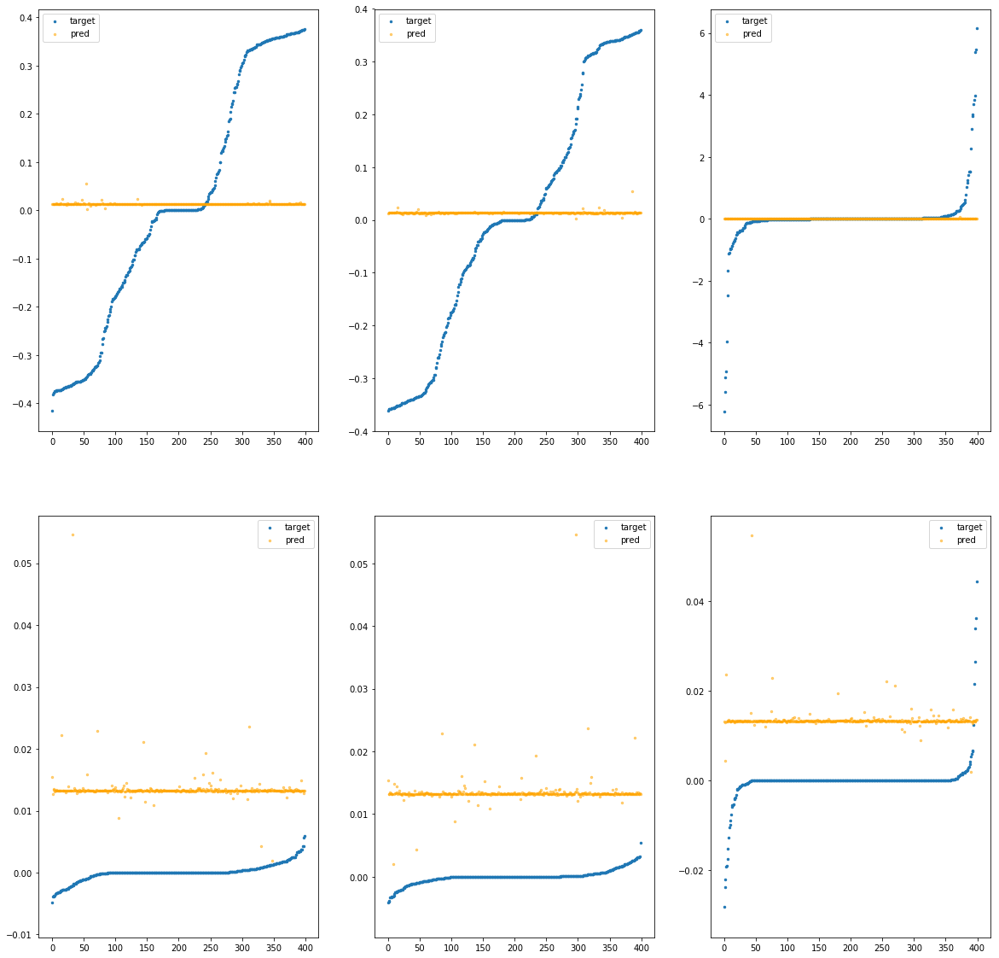

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd44f0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.92e-03	4.03e-01	2.08e-01	7.78e+03	6.48e-02	4.19e-03
y		-6.98e-03	3.73e-01	1.89e-01	1.04e+03	5.52e-02	3.05e-03
z		-2.04e-03	6.21e+00	2.81e-01	5.41e+02	8.77e-01	7.69e-01
phi		-8.56e+01	1.91e-02	1.26e-02	2.97e+06	1.61e-04	2.60e-08
theta		-1.25e+02	1.89e-02	1.25e-02	1.07e+06	1.60e-04	2.55e-08
psi		-6.33e+00	4.66e-02	1.28e-02	3.46e+05	1.80e-04	3.24e-08


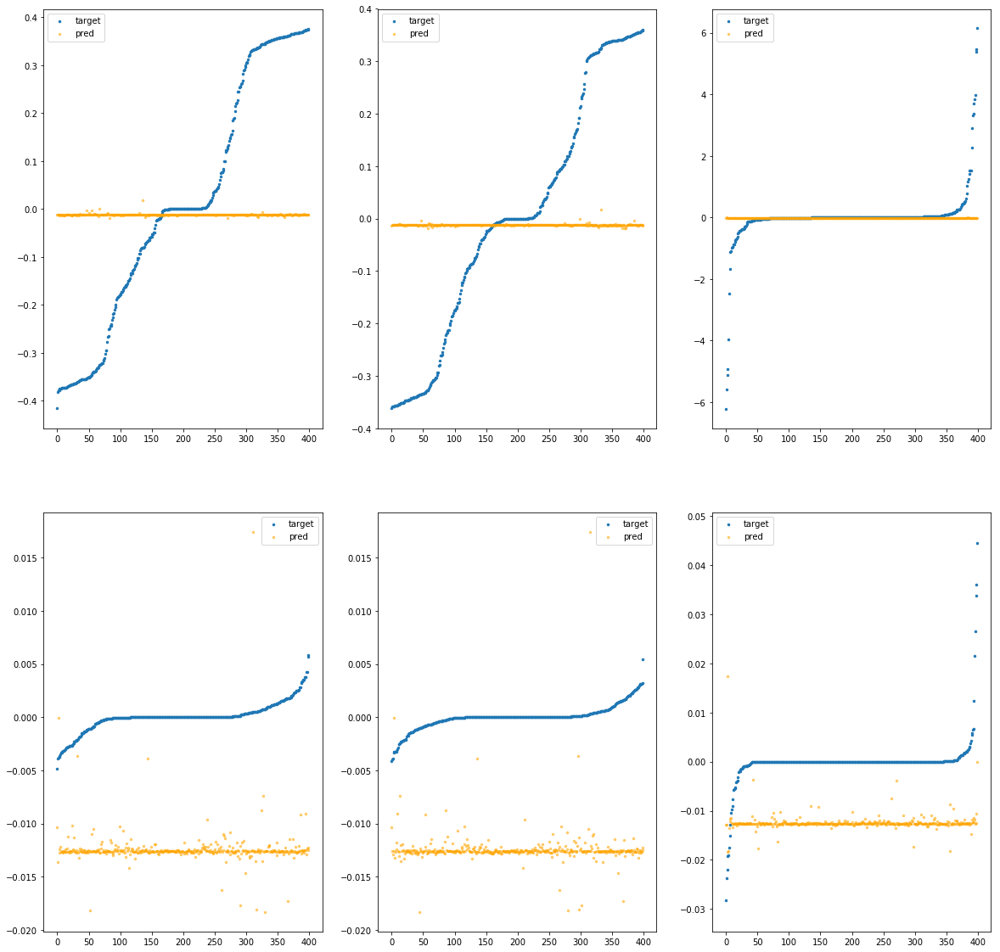

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd4550>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.52e-03	4.02e-01	2.08e-01	8.18e+03	6.47e-02	4.19e-03
y		-8.72e-03	3.74e-01	1.90e-01	1.09e+03	5.53e-02	3.06e-03
z		-2.23e-03	6.21e+00	2.82e-01	5.69e+02	8.77e-01	7.69e-01
phi		-9.70e+01	2.29e-02	1.34e-02	3.12e+06	1.82e-04	3.33e-08
theta		-1.41e+02	2.29e-02	1.34e-02	1.12e+06	1.81e-04	3.26e-08
psi		-7.25e+00	5.76e-02	1.36e-02	3.65e+05	2.02e-04	4.09e-08


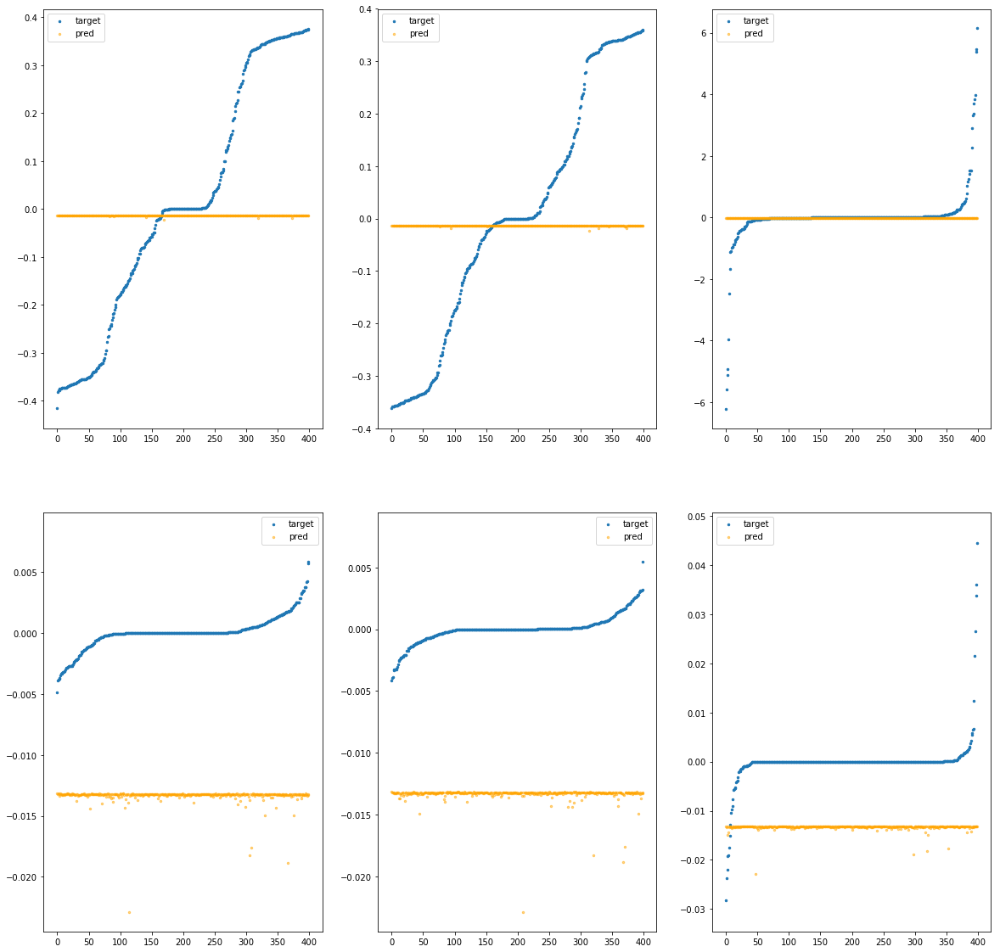

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd45b0>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.17e-02	4.00e-01	2.08e-01	9.27e+03	6.49e-02	4.21e-03
y		-7.84e-03	3.75e-01	1.90e-01	1.23e+03	5.53e-02	3.05e-03
z		-1.89e-03	6.21e+00	2.82e-01	6.44e+02	8.77e-01	7.68e-01
phi		-1.20e+02	2.09e-02	1.49e-02	3.54e+06	2.26e-04	5.10e-08
theta		-1.75e+02	2.04e-02	1.49e-02	1.27e+06	2.23e-04	4.98e-08
psi		-9.04e+00	5.89e-02	1.51e-02	4.12e+05	2.46e-04	6.07e-08


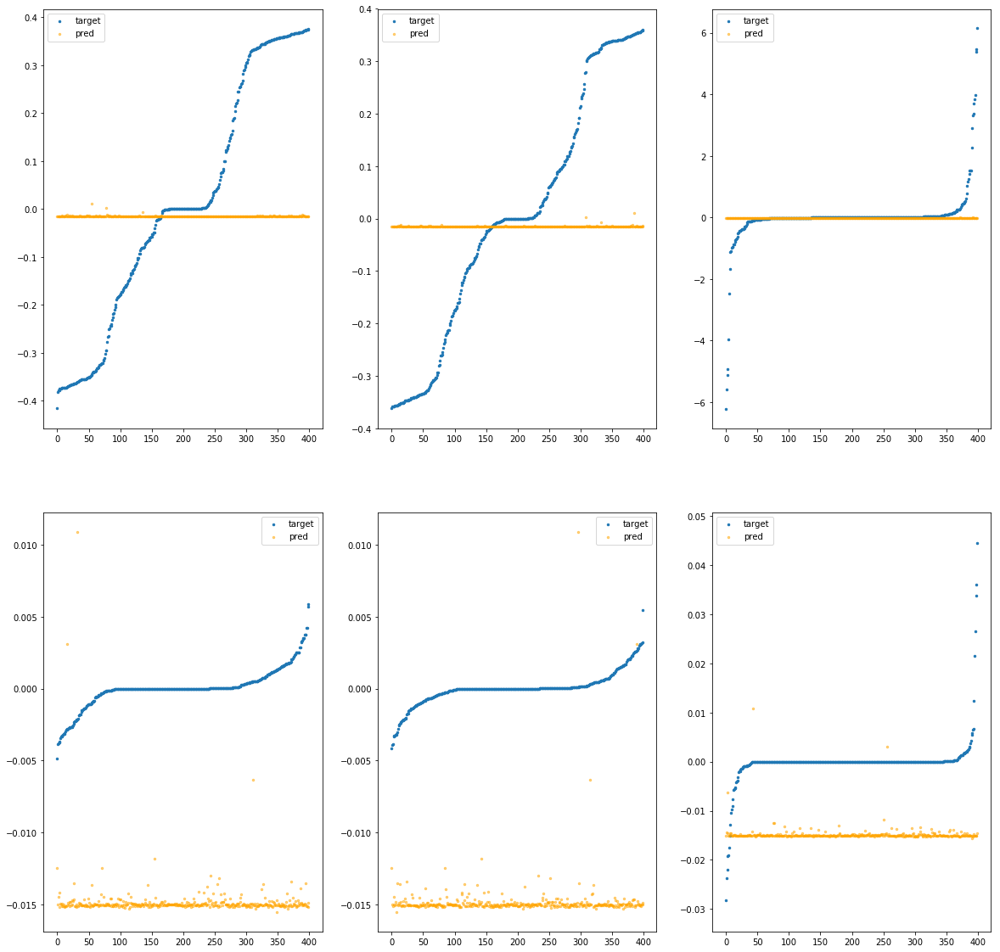

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.rmsprop.RMSprop object at 0x7fba51bd4610>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.22e-03	4.29e-01	2.08e-01	8.70e+03	6.42e-02	4.12e-03
y		6.77e-04	3.75e-01	1.90e-01	1.16e+03	5.48e-02	3.00e-03
z		7.88e-05	6.24e+00	2.81e-01	6.06e+02	8.75e-01	7.65e-01
phi		-1.15e+02	7.05e-02	1.43e-02	3.32e+06	2.15e-04	4.63e-08
theta		-1.69e+02	7.07e-02	1.44e-02	1.20e+06	2.16e-04	4.66e-08
psi		-9.02e+00	9.02e-02	1.49e-02	3.88e+05	2.46e-04	6.04e-08


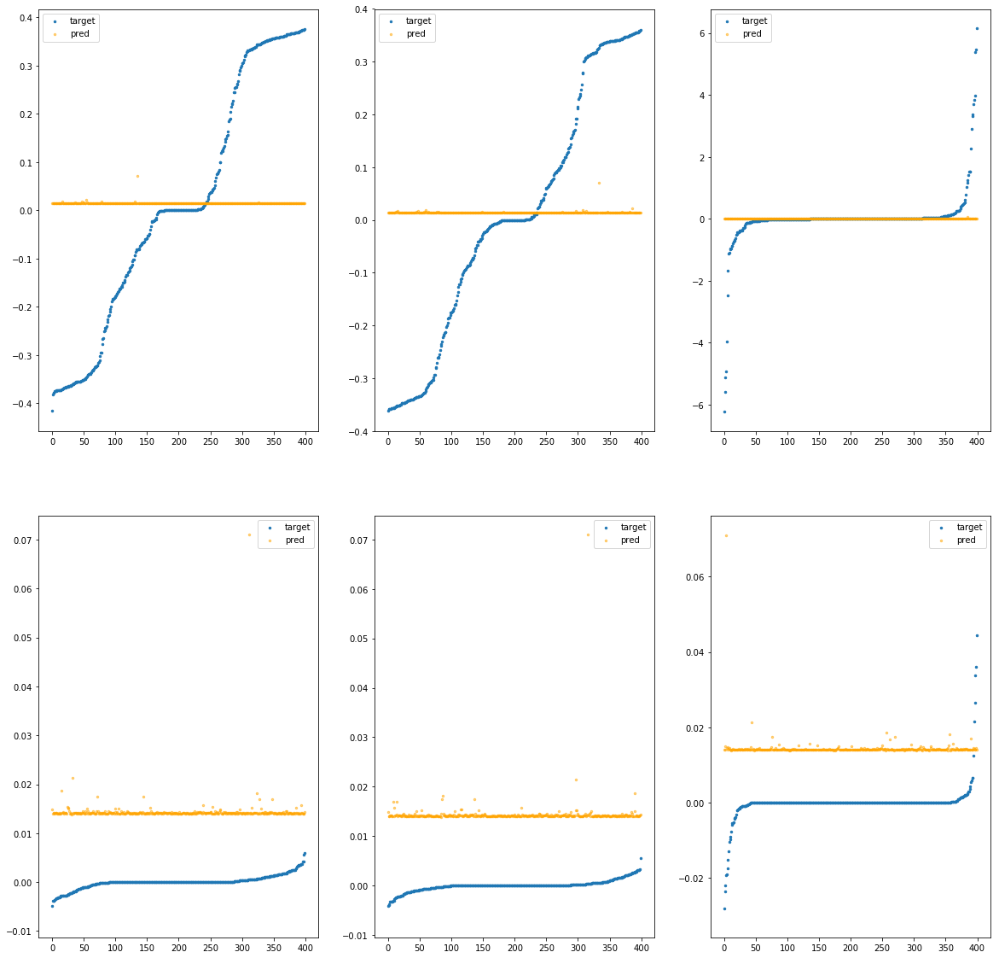

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4670>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.41e-03	4.10e-01	2.05e-01	2.91e+02	6.42e-02	4.12e-03
y		-1.67e-03	3.61e-01	1.88e-01	4.91e+01	5.49e-02	3.02e-03
z		-1.81e-03	6.23e+00	2.77e-01	2.73e+01	8.76e-01	7.68e-01
phi		-3.37e+00	2.16e-02	1.82e-03	1.06e+05	8.14e-06	6.62e-11
theta		-4.71e+00	2.35e-02	1.65e-03	4.20e+04	7.25e-06	5.25e-11
psi		-9.09e-02	3.63e-02	2.28e-03	2.54e+04	2.68e-05	7.16e-10


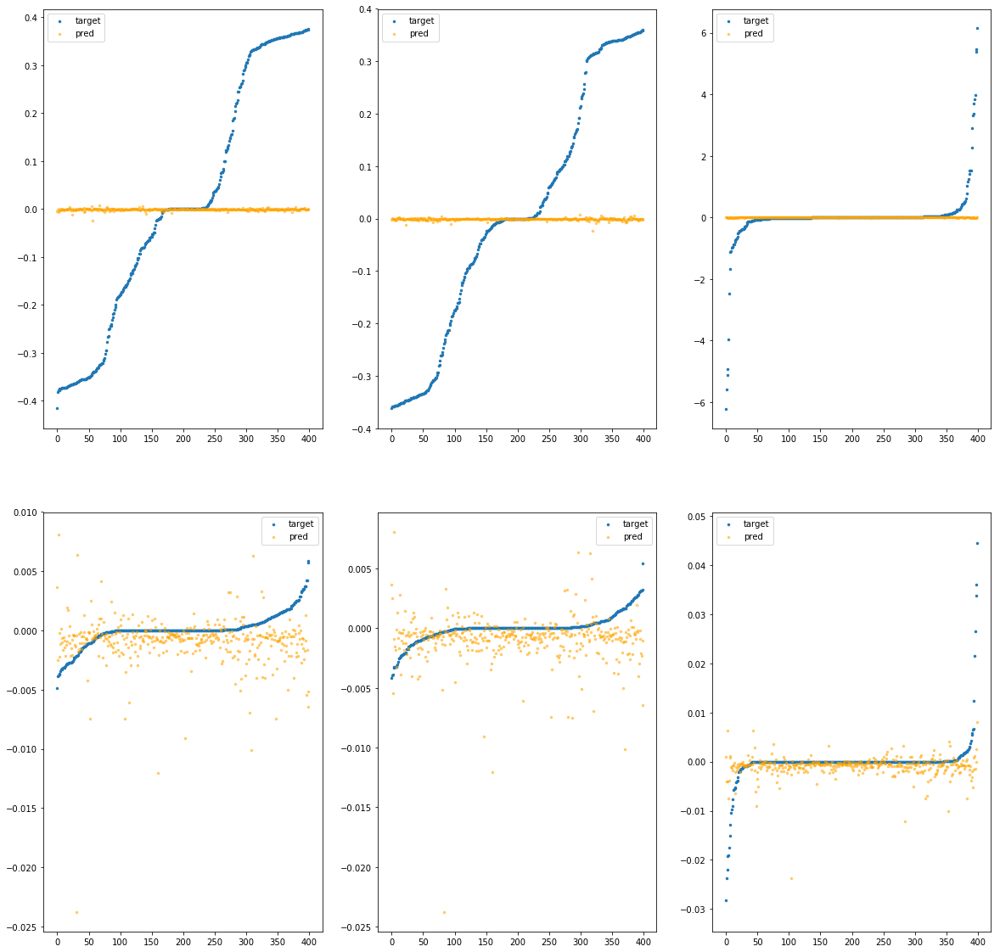

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd46d0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.65e-03	4.12e-01	2.05e-01	3.42e+02	6.42e-02	4.12e-03
y		-5.09e-04	3.62e-01	1.88e-01	3.95e+01	5.48e-02	3.01e-03
z		-1.18e-03	6.23e+00	2.77e-01	2.91e+01	8.76e-01	7.67e-01
phi		-1.87e+00	1.21e-02	1.57e-03	1.40e+05	5.34e-06	2.85e-11
theta		-2.32e+00	1.10e-02	1.41e-03	4.83e+04	4.22e-06	1.78e-11
psi		-8.25e-02	4.02e-02	2.18e-03	1.60e+04	2.66e-05	7.05e-10


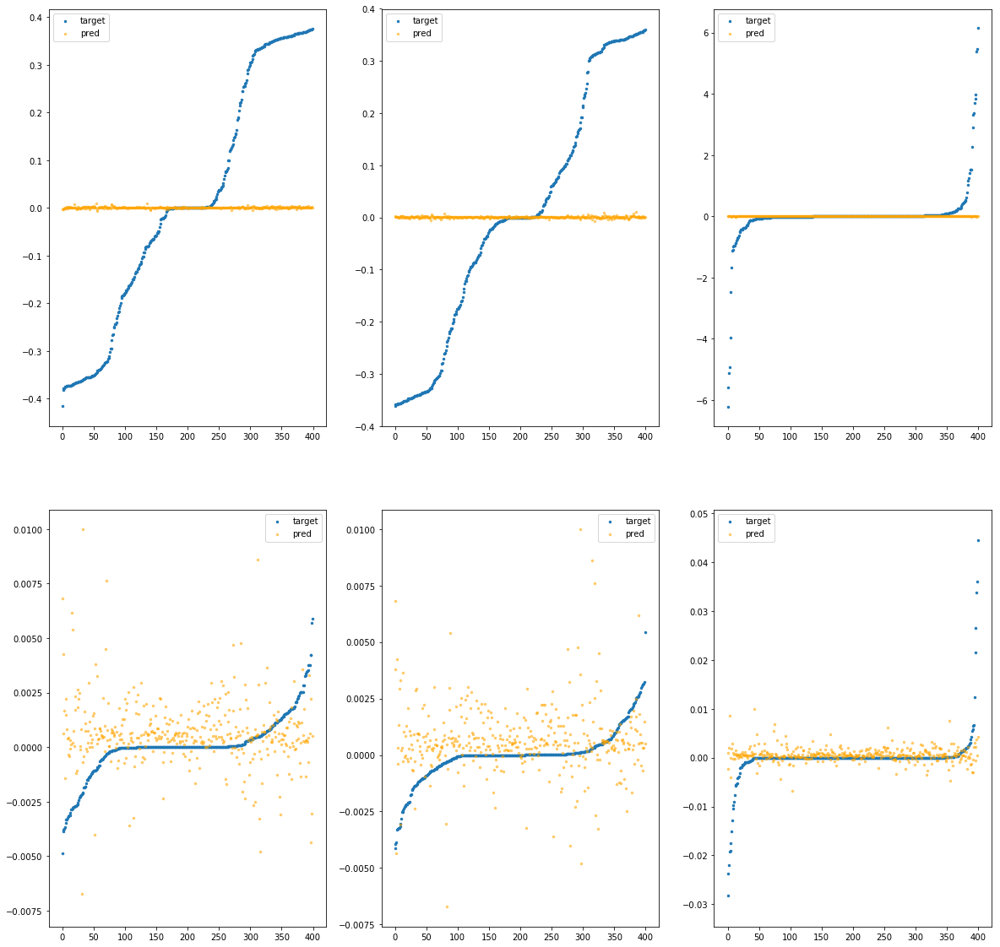

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4730>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.99e-03	4.15e-01	2.05e-01	3.34e+01	6.42e-02	4.13e-03
y		-1.11e-03	3.61e-01	1.88e-01	5.56e+00	5.49e-02	3.01e-03
z		-9.70e-04	6.23e+00	2.77e-01	3.21e+00	8.76e-01	7.67e-01
phi		-1.27e-02	5.79e-03	7.99e-04	1.20e+04	1.88e-06	3.55e-12
theta		-1.74e-03	5.36e-03	6.51e-04	4.59e+03	1.27e-06	1.62e-12
psi		-1.57e-03	4.45e-02	1.29e-03	1.51e+03	2.46e-05	6.04e-10


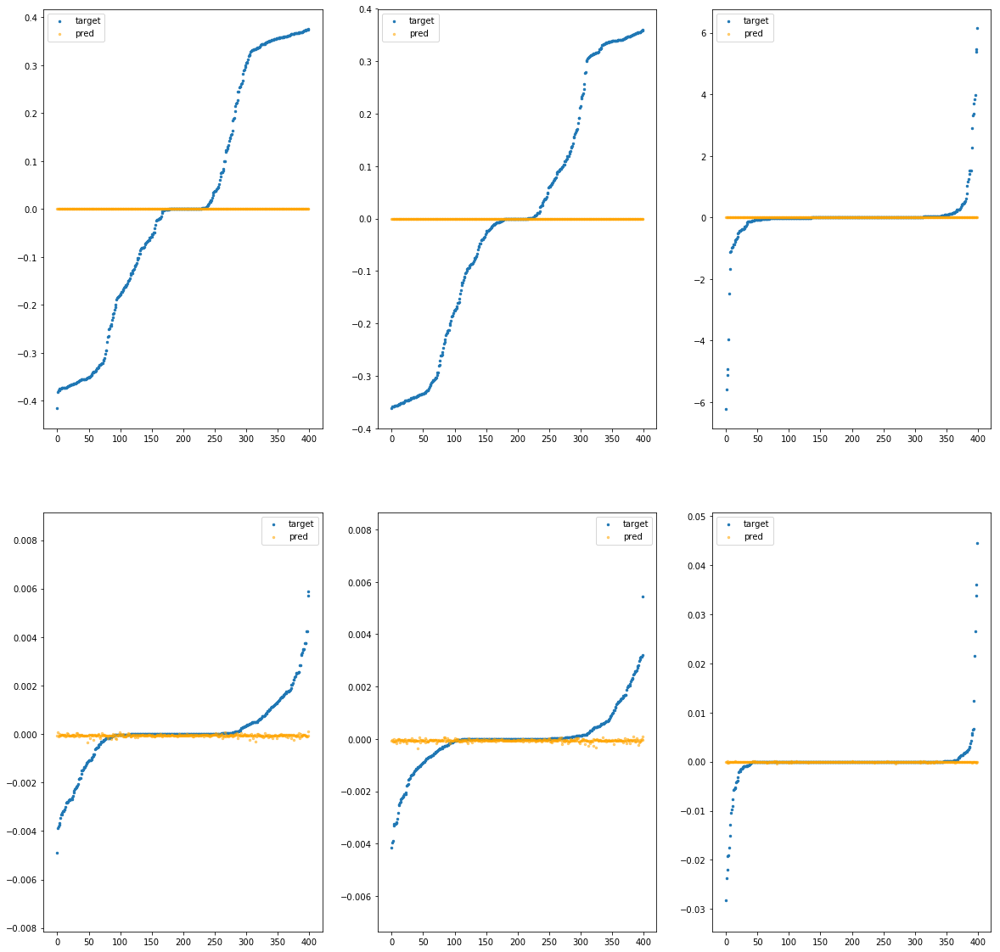

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4790>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.66e-03	4.11e-01	2.05e-01	9.82e+01	6.42e-02	4.12e-03
y		-1.04e-03	3.61e-01	1.88e-01	1.04e+01	5.49e-02	3.01e-03
z		-1.22e-03	6.22e+00	2.77e-01	1.33e+01	8.76e-01	7.67e-01
phi		-3.12e+00	1.33e-02	1.71e-03	3.74e+04	7.66e-06	5.87e-11
theta		-3.97e+00	1.49e-02	1.50e-03	8.39e+03	6.32e-06	3.99e-11
psi		-1.01e-01	3.75e-02	2.16e-03	1.27e+04	2.70e-05	7.29e-10


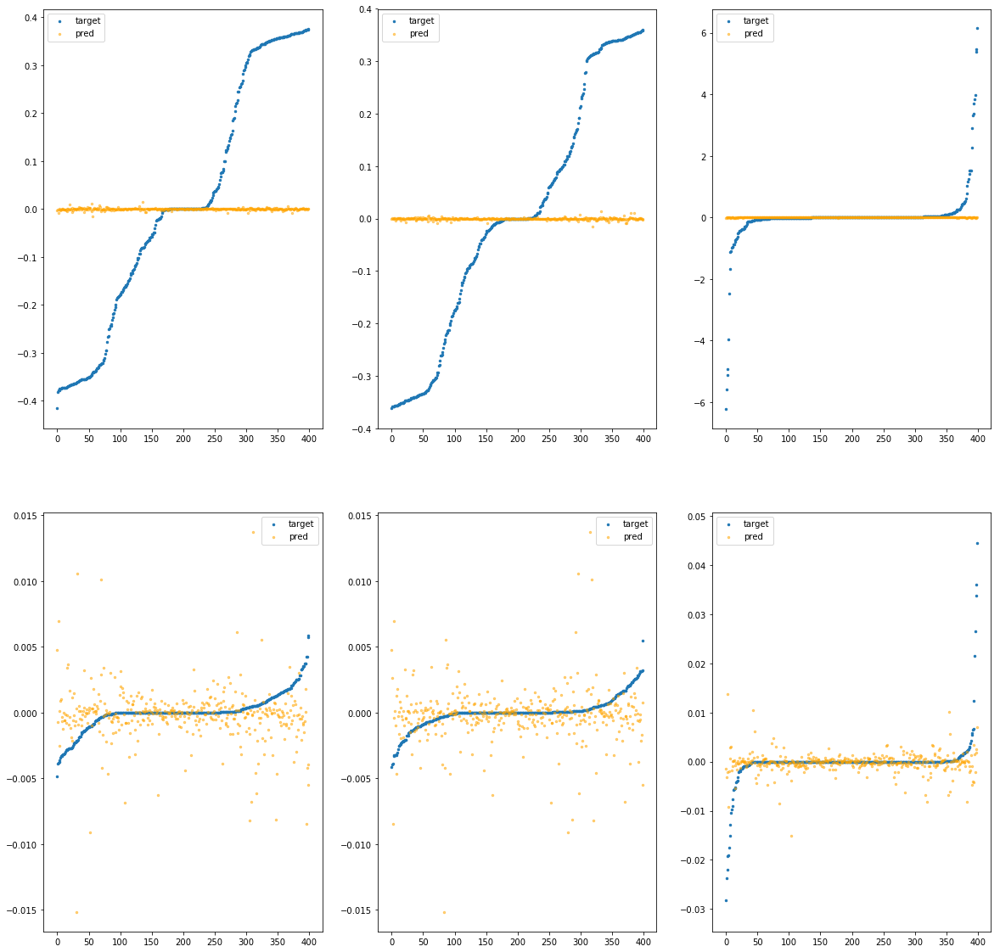

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd47f0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.23e-03	4.06e-01	2.05e-01	4.42e+02	6.42e-02	4.12e-03
y		-1.11e-03	3.60e-01	1.88e-01	4.63e+01	5.49e-02	3.01e-03
z		-1.50e-03	6.22e+00	2.77e-01	3.42e+01	8.76e-01	7.68e-01
phi		-3.76e+00	1.54e-02	1.86e-03	1.84e+05	8.87e-06	7.86e-11
theta		-4.85e+00	1.39e-02	1.68e-03	5.96e+04	7.42e-06	5.51e-11
psi		-1.44e-01	3.51e-02	2.40e-03	1.57e+04	2.81e-05	7.88e-10


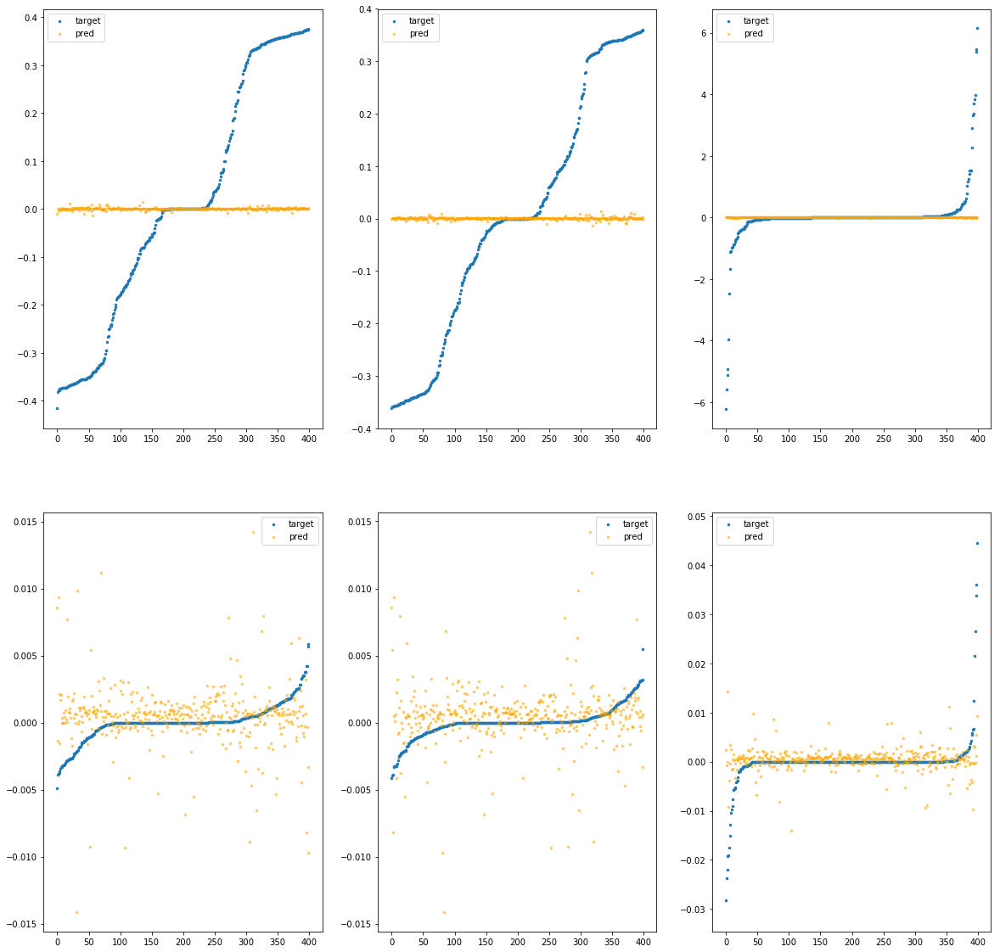

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4850>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.32e-03	3.94e-01	2.06e-01	1.02e+03	6.42e-02	4.12e-03
y		2.45e-04	3.61e-01	1.88e-01	1.34e+02	5.48e-02	3.00e-03
z		-2.77e-03	6.23e+00	2.77e-01	7.10e+01	8.77e-01	7.70e-01
phi		-6.89e+00	2.67e-02	2.50e-03	3.93e+05	1.47e-05	2.16e-10
theta		-9.26e+00	2.07e-02	2.44e-03	1.42e+05	1.30e-05	1.70e-10
psi		-5.19e-01	3.90e-02	3.20e-03	4.63e+04	3.73e-05	1.39e-09


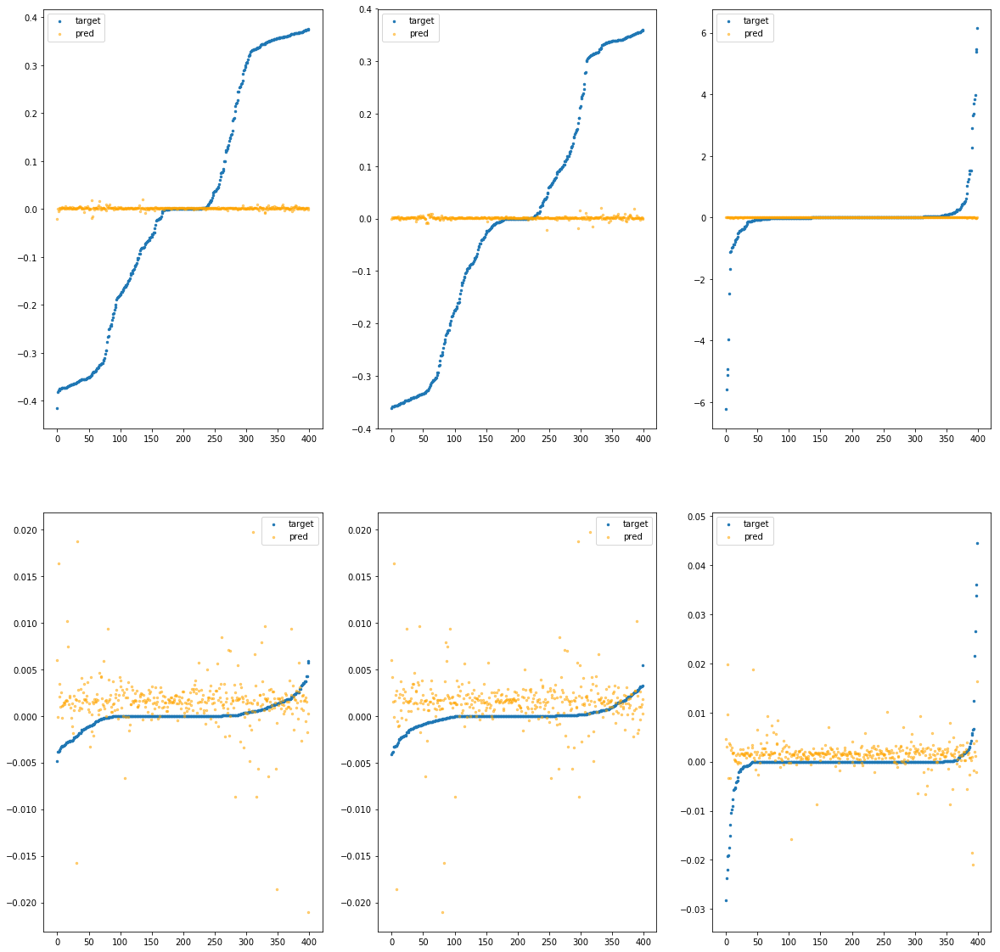

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd48b0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.05e-01	2.05e-01	1.09e+02	6.42e-02	4.13e-03
y		-2.09e-04	3.60e-01	1.88e-01	1.69e+01	5.48e-02	3.01e-03
z		-2.00e-03	6.22e+00	2.77e-01	1.04e+01	8.77e-01	7.68e-01
phi		-4.47e+00	1.62e-02	1.90e-03	4.42e+04	1.02e-05	1.04e-10
theta		-5.96e+00	1.54e-02	1.76e-03	8.94e+03	8.83e-06	7.80e-11
psi		-1.87e-01	4.02e-02	2.39e-03	1.75e+04	2.91e-05	8.47e-10


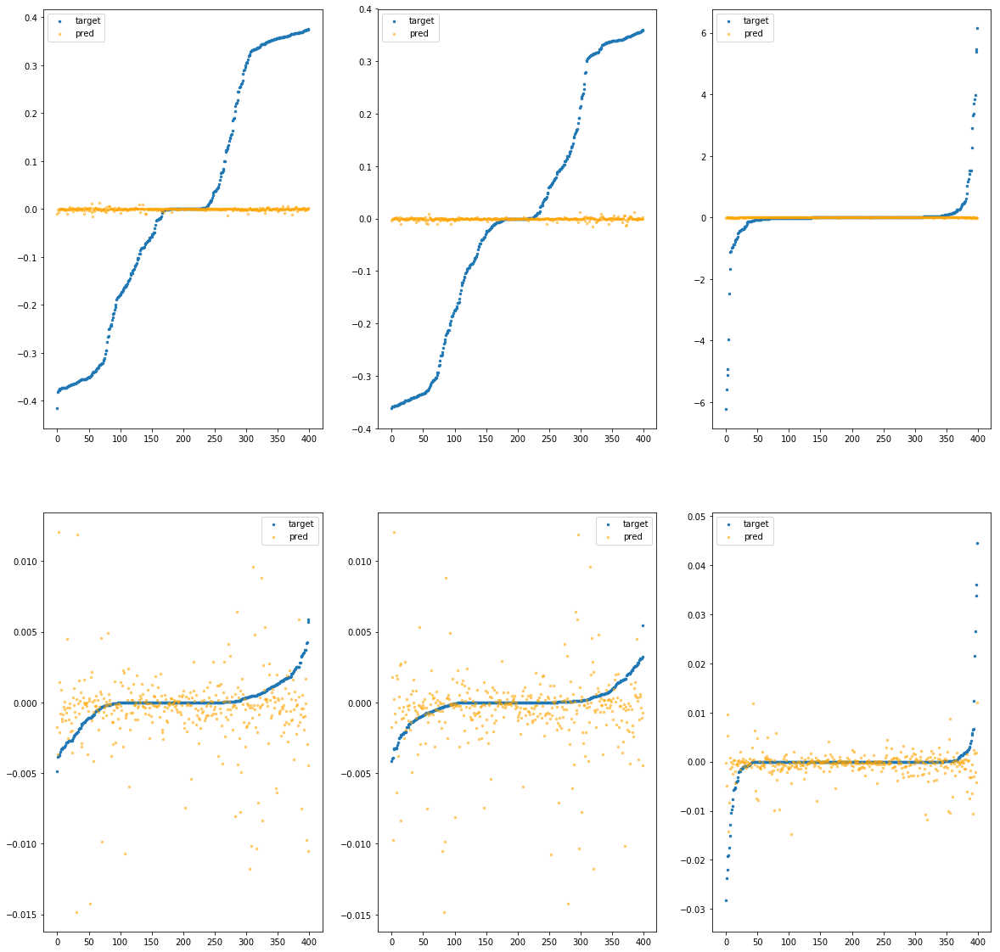

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4910>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.02e-03	4.11e-01	2.06e-01	1.69e+03	6.43e-02	4.14e-03
y		-1.46e-03	3.63e-01	1.88e-01	2.33e+02	5.49e-02	3.01e-03
z		-1.21e-03	6.22e+00	2.78e-01	1.19e+02	8.76e-01	7.67e-01
phi		-4.42e+00	1.00e-02	2.87e-03	6.39e+05	1.01e-05	1.02e-10
theta		-6.15e+00	8.45e-03	2.78e-03	2.31e+05	9.09e-06	8.25e-11
psi		-3.02e-01	4.60e-02	3.57e-03	7.46e+04	3.19e-05	1.02e-09


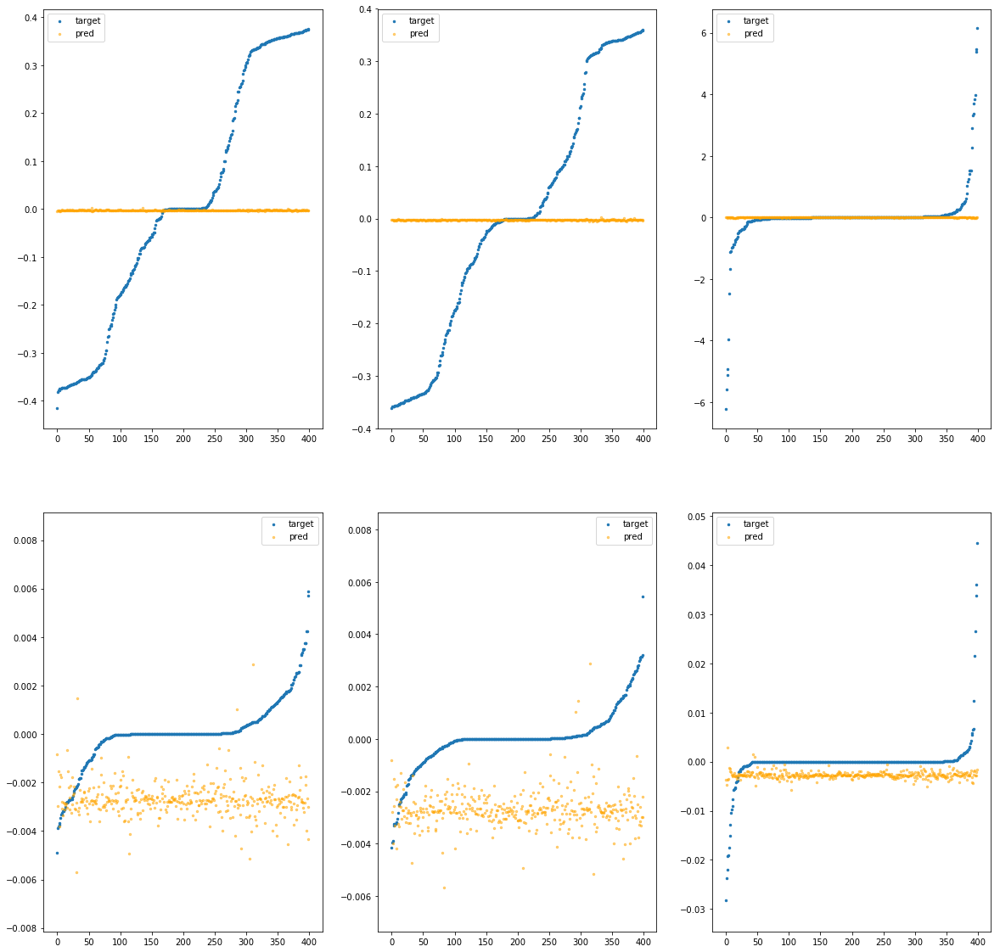

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4970>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.44e-03	4.11e-01	2.05e-01	3.40e+02	6.42e-02	4.12e-03
y		-1.25e-03	3.61e-01	1.88e-01	3.51e+01	5.49e-02	3.01e-03
z		-1.24e-03	6.23e+00	2.77e-01	2.70e+01	8.76e-01	7.67e-01
phi		-2.09e+00	1.18e-02	1.56e-03	1.36e+05	5.75e-06	3.30e-11
theta		-2.50e+00	1.20e-02	1.38e-03	4.39e+04	4.44e-06	1.97e-11
psi		-1.96e-02	3.87e-02	2.06e-03	1.47e+04	2.50e-05	6.26e-10


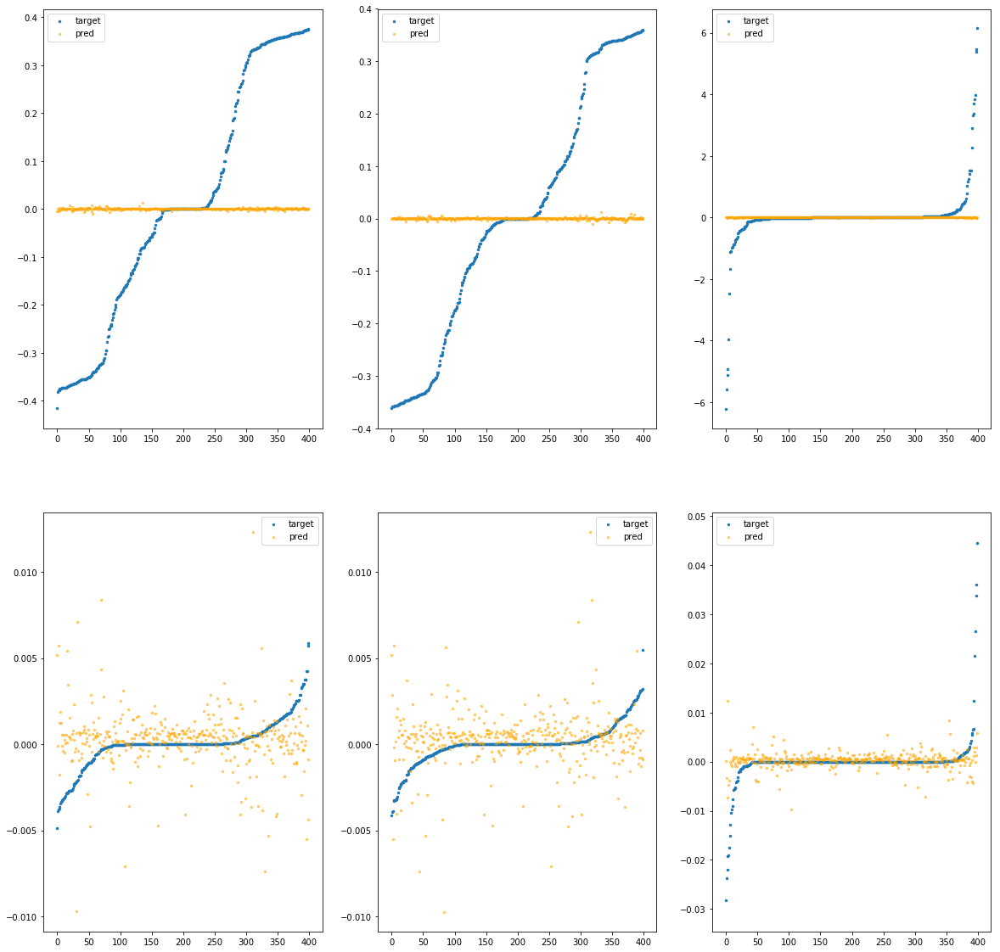

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd49d0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.56e-03	4.08e-01	2.05e-01	2.35e+02	6.42e-02	4.12e-03
y		-8.54e-04	3.61e-01	1.88e-01	3.41e+01	5.49e-02	3.01e-03
z		-1.80e-03	6.22e+00	2.77e-01	1.60e+01	8.76e-01	7.68e-01
phi		-3.97e+00	1.84e-02	1.87e-03	8.07e+04	9.25e-06	8.55e-11
theta		-5.11e+00	2.02e-02	1.68e-03	3.02e+04	7.77e-06	6.03e-11
psi		-1.86e-01	3.70e-02	2.37e-03	2.03e+04	2.91e-05	8.47e-10


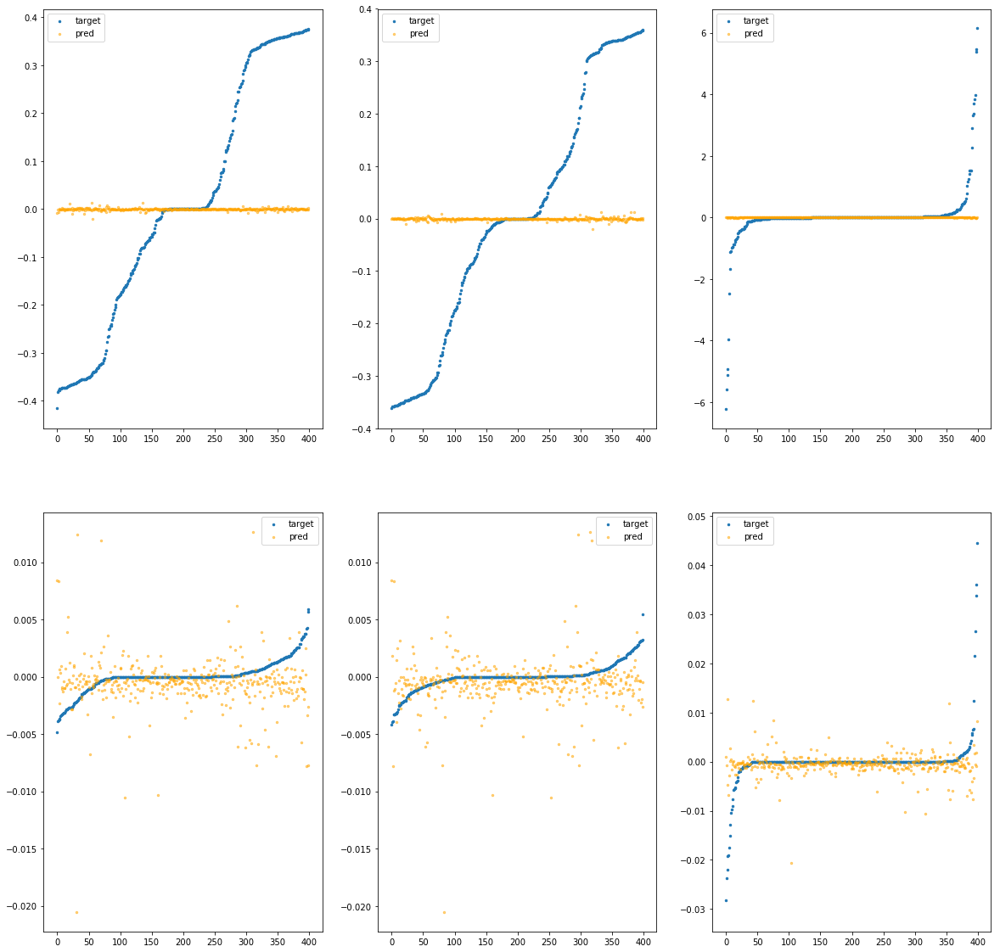

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4a30>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.07e-03	4.06e-01	2.06e-01	1.27e+03	6.42e-02	4.13e-03
y		5.43e-04	3.61e-01	1.88e-01	1.74e+02	5.48e-02	3.00e-03
z		-1.50e-03	6.23e+00	2.78e-01	9.34e+01	8.76e-01	7.68e-01
phi		-6.30e+00	2.26e-02	2.68e-03	4.98e+05	1.36e-05	1.85e-10
theta		-8.44e+00	1.71e-02	2.68e-03	1.79e+05	1.20e-05	1.44e-10
psi		-4.83e-01	3.68e-02	3.48e-03	5.43e+04	3.64e-05	1.32e-09


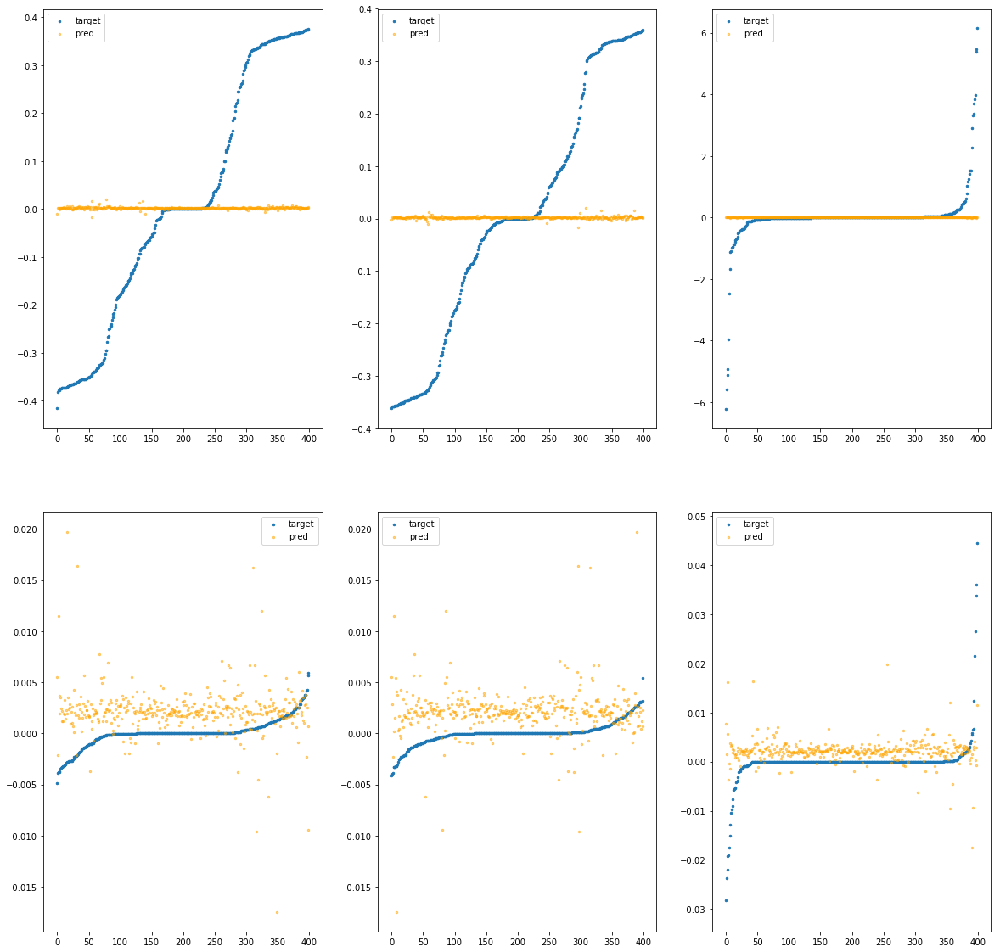

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4a90>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.16e-03	4.01e-01	2.05e-01	2.34e+02	6.43e-02	4.13e-03
y		-1.80e-03	3.60e-01	1.88e-01	4.25e+01	5.49e-02	3.02e-03
z		-2.51e-03	6.22e+00	2.77e-01	2.21e+01	8.77e-01	7.69e-01
phi		-4.15e+00	1.98e-02	1.95e-03	7.49e+04	9.58e-06	9.18e-11
theta		-5.65e+00	1.39e-02	1.82e-03	3.13e+04	8.45e-06	7.13e-11
psi		-2.09e-01	3.86e-02	2.44e-03	2.30e+04	2.97e-05	8.80e-10


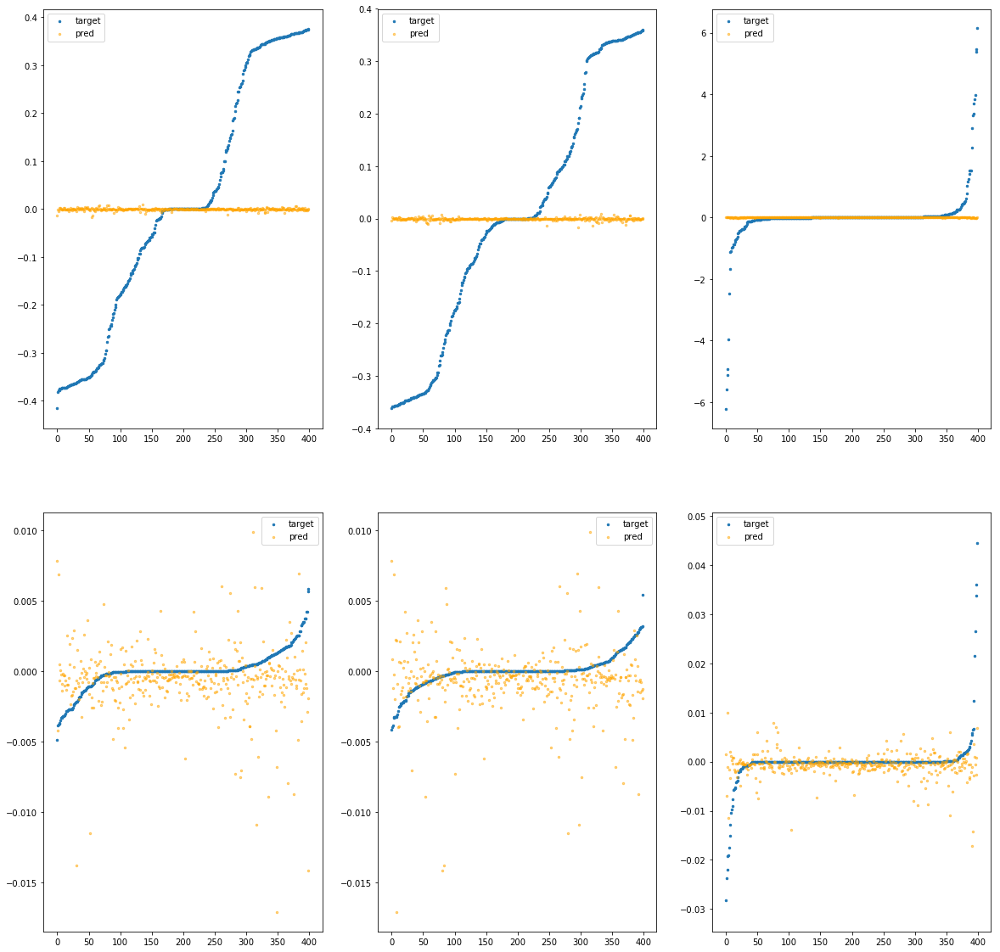

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4af0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.72e-03	4.10e-01	2.05e-01	2.17e+02	6.42e-02	4.12e-03
y		-1.36e-03	3.61e-01	1.88e-01	2.16e+01	5.49e-02	3.01e-03
z		-1.91e-03	6.23e+00	2.77e-01	1.85e+01	8.77e-01	7.68e-01
phi		-5.17e+00	1.61e-02	1.92e-03	9.19e+04	1.15e-05	1.32e-10
theta		-7.50e+00	1.70e-02	1.83e-03	2.39e+04	1.08e-05	1.17e-10
psi		-1.94e-01	3.52e-02	2.41e-03	1.56e+04	2.93e-05	8.59e-10


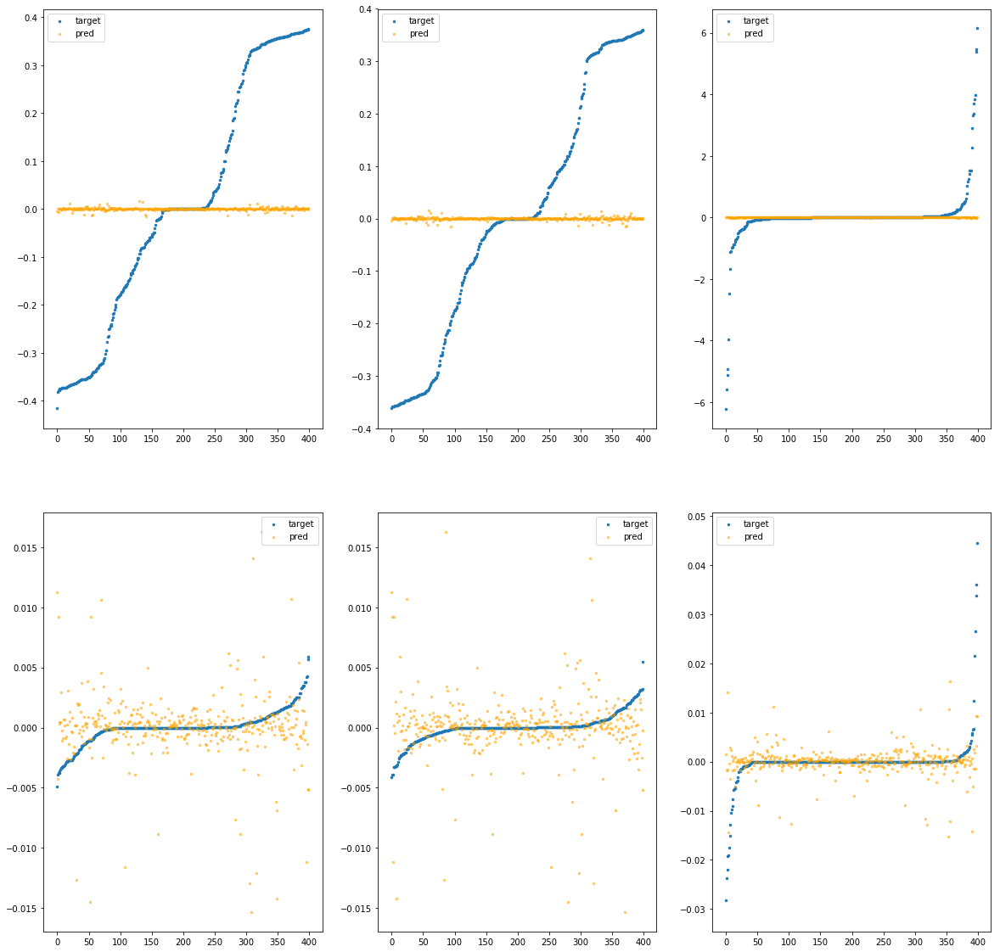

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4b50>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.75e-03	4.16e-01	2.06e-01	1.04e+03	6.42e-02	4.13e-03
y		-1.23e-03	3.63e-01	1.88e-01	1.36e+02	5.49e-02	3.01e-03
z		-1.41e-03	6.23e+00	2.77e-01	7.14e+01	8.76e-01	7.68e-01
phi		-2.23e+00	1.04e-02	1.96e-03	3.99e+05	6.01e-06	3.62e-11
theta		-3.07e+00	9.69e-03	1.89e-03	1.39e+05	5.17e-06	2.67e-11
psi		-1.14e-01	4.06e-02	2.71e-03	4.39e+04	2.73e-05	7.47e-10


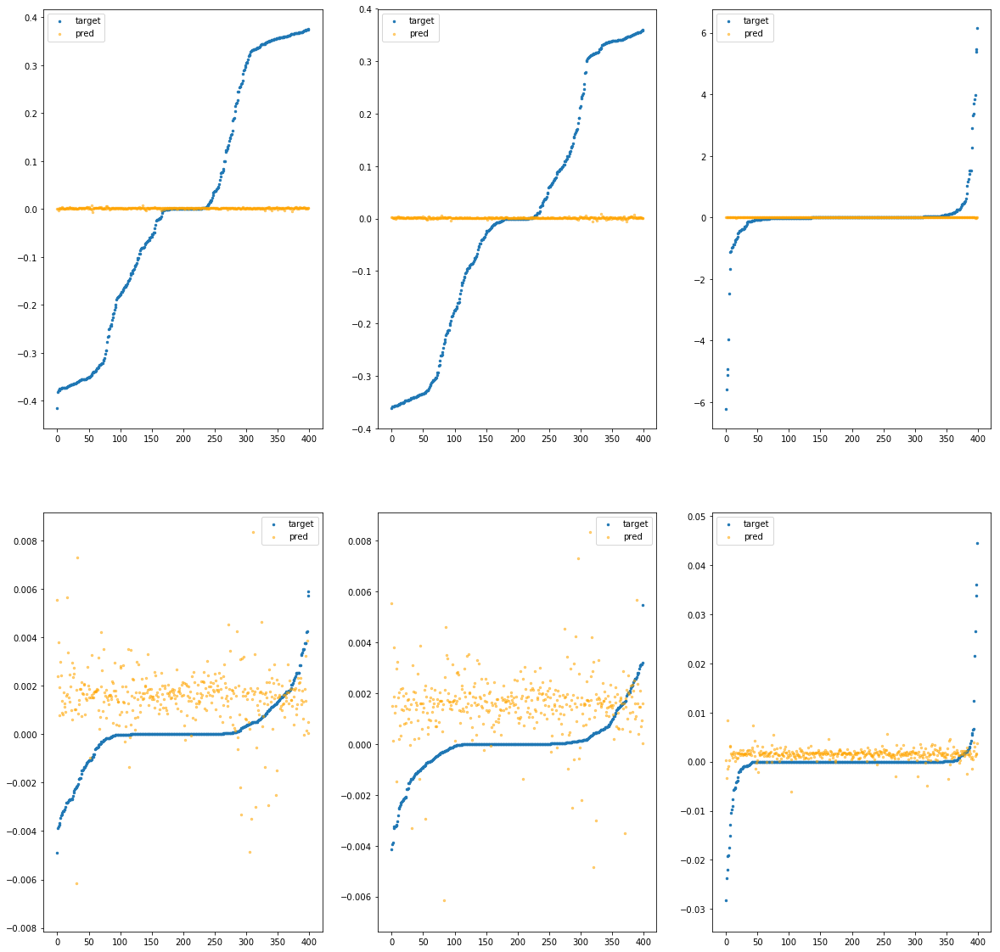

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4bb0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.97e-03	4.02e-01	2.06e-01	3.18e+02	6.42e-02	4.13e-03
y		-6.89e-04	3.60e-01	1.88e-01	3.79e+01	5.49e-02	3.01e-03
z		-2.66e-03	6.22e+00	2.77e-01	2.61e+01	8.77e-01	7.69e-01
phi		-7.23e+00	1.97e-02	2.29e-03	1.35e+05	1.53e-05	2.35e-10
theta		-1.01e+01	1.96e-02	2.17e-03	3.85e+04	1.40e-05	1.97e-10
psi		-4.12e-01	3.88e-02	2.75e-03	1.90e+04	3.46e-05	1.20e-09


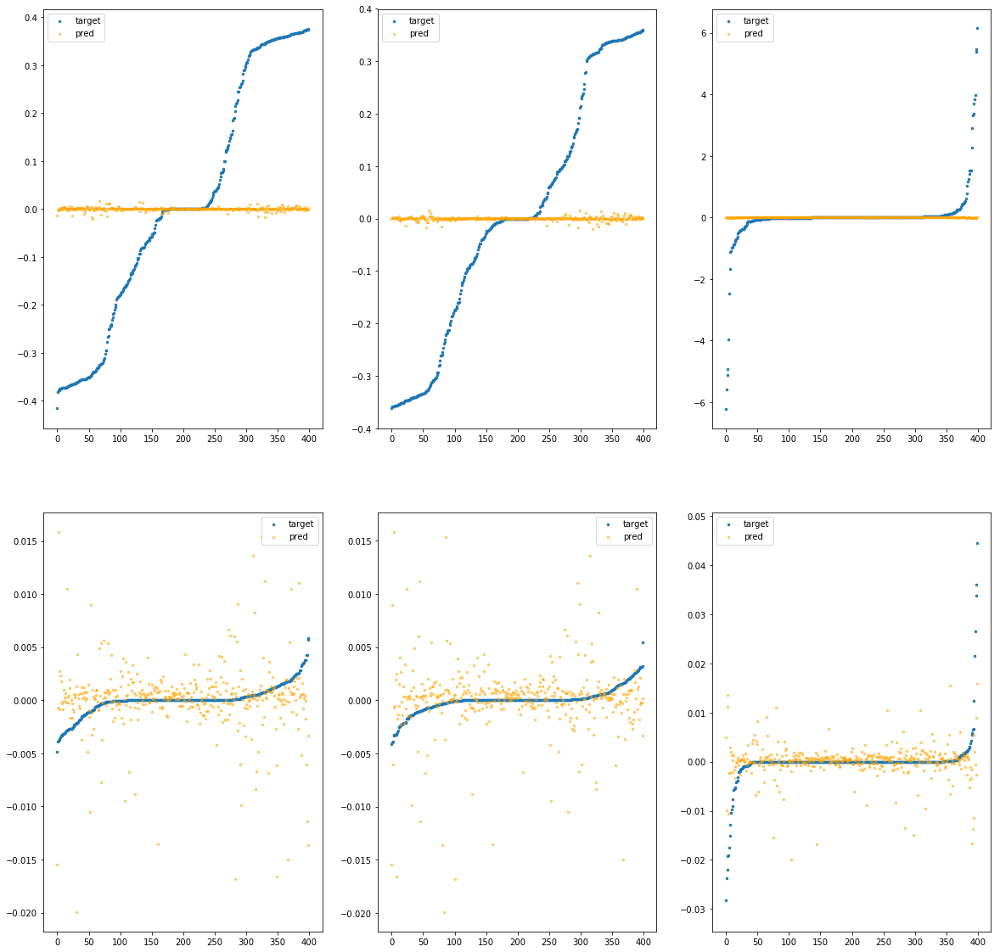

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4c10>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.23e-03	4.05e-01	2.06e-01	1.53e+03	6.43e-02	4.14e-03
y		-2.06e-03	3.63e-01	1.88e-01	2.02e+02	5.49e-02	3.02e-03
z		-1.48e-03	6.22e+00	2.78e-01	1.07e+02	8.76e-01	7.68e-01
phi		-8.49e+00	2.72e-02	3.21e-03	5.79e+05	1.77e-05	3.12e-10
theta		-1.15e+01	2.49e-02	3.10e-03	2.10e+05	1.59e-05	2.53e-10
psi		-5.95e-01	4.29e-02	3.73e-03	7.43e+04	3.91e-05	1.53e-09


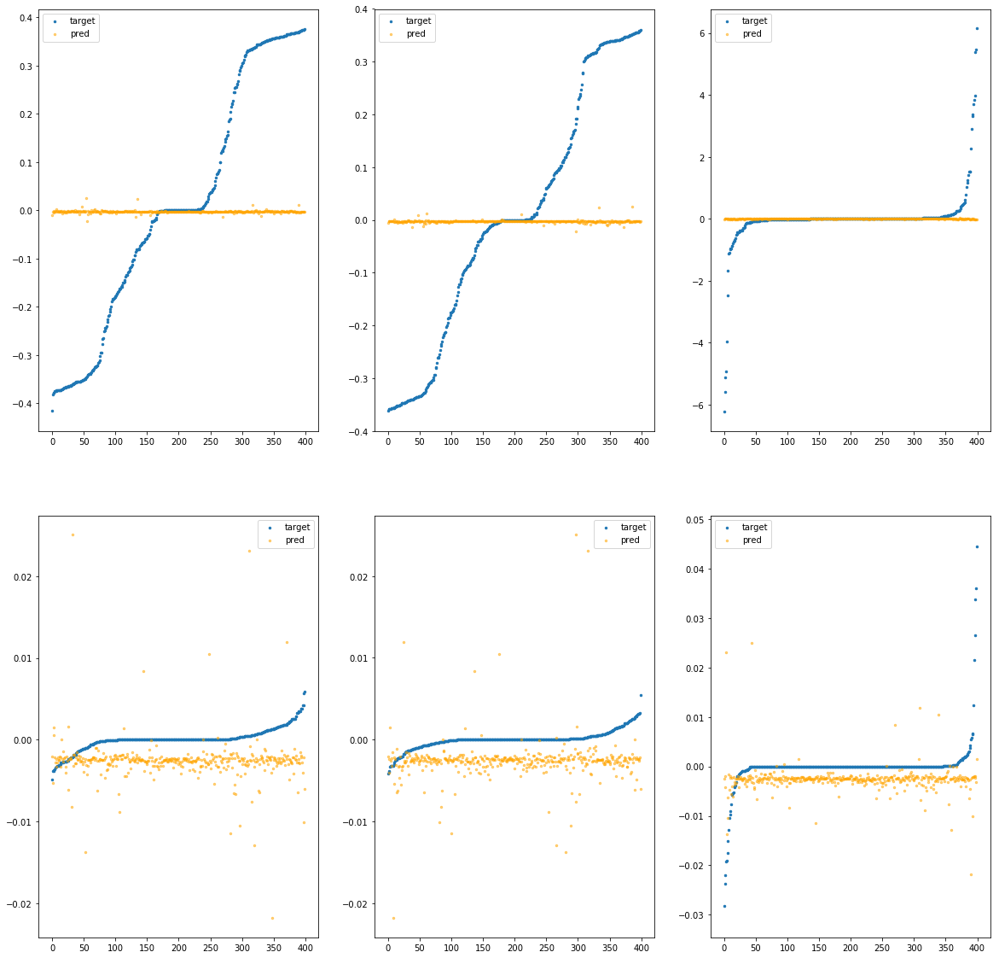

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4c70>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.37e-03	4.02e-01	2.05e-01	2.89e+02	6.42e-02	4.12e-03
y		-1.68e-03	3.60e-01	1.88e-01	4.23e+01	5.49e-02	3.02e-03
z		-2.17e-03	6.23e+00	2.77e-01	2.10e+01	8.77e-01	7.69e-01
phi		-4.51e+00	1.91e-02	2.01e-03	1.06e+05	1.03e-05	1.05e-10
theta		-6.21e+00	1.45e-02	1.85e-03	4.76e+04	9.15e-06	8.37e-11
psi		-2.26e-01	3.83e-02	2.43e-03	2.51e+04	3.01e-05	9.05e-10


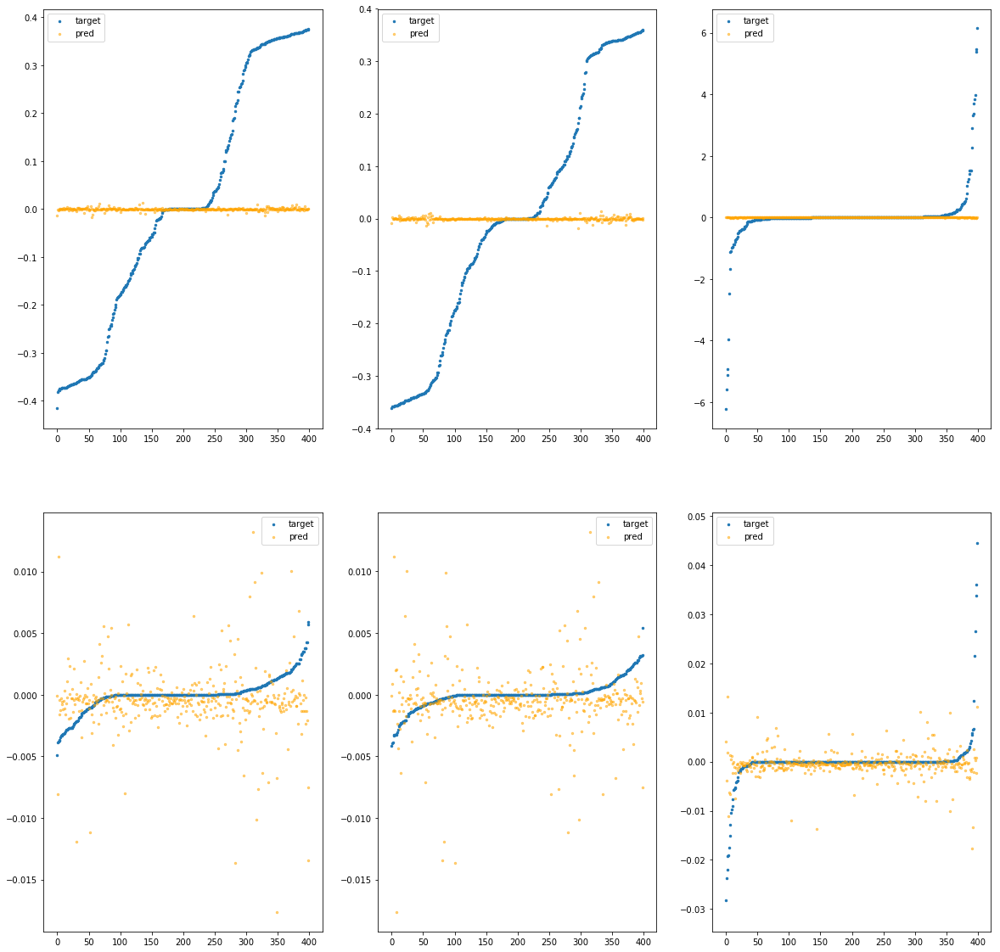

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4cd0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.70e-03	4.02e-01	2.06e-01	1.28e+03	6.42e-02	4.12e-03
y		8.02e-04	3.63e-01	1.88e-01	1.71e+02	5.48e-02	3.00e-03
z		-2.36e-03	6.24e+00	2.78e-01	9.03e+01	8.77e-01	7.69e-01
phi		-7.43e+00	2.24e-02	2.89e-03	5.07e+05	1.57e-05	2.46e-10
theta		-1.09e+01	2.19e-02	2.90e-03	1.75e+05	1.51e-05	2.28e-10
psi		-4.64e-01	3.74e-02	3.57e-03	5.04e+04	3.59e-05	1.29e-09


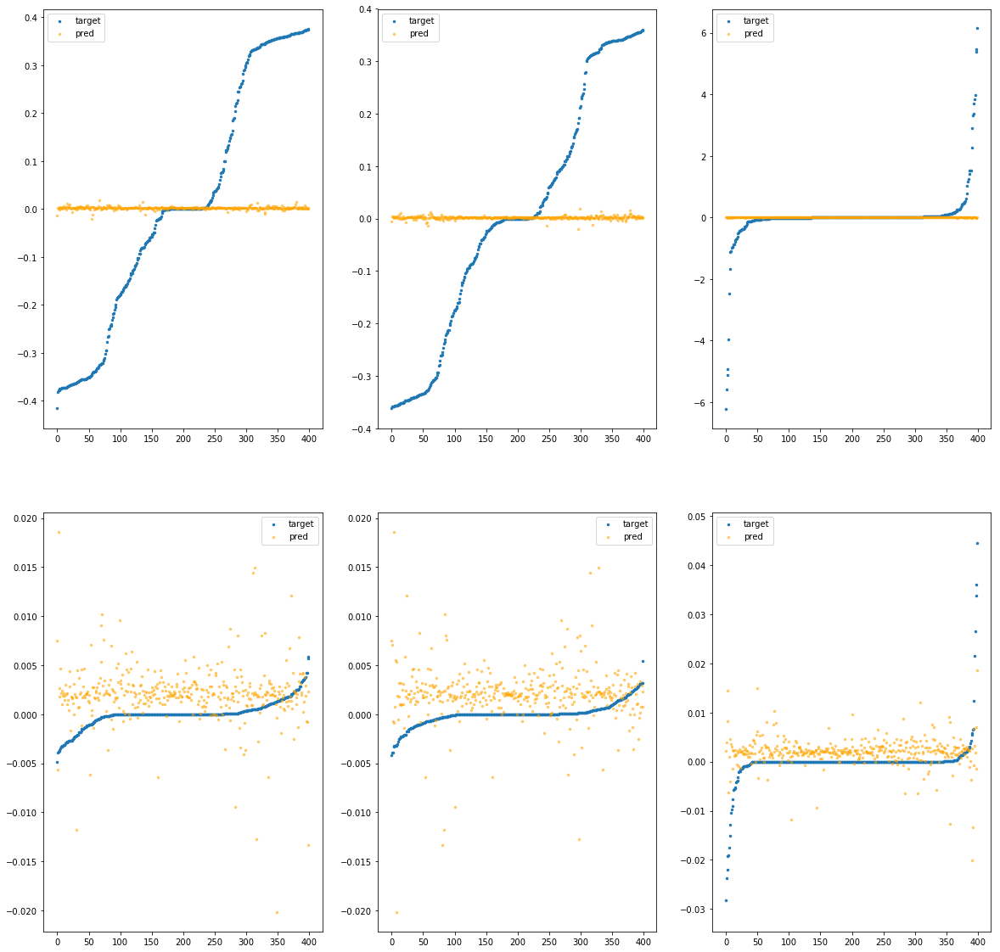

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4d30>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.77e-03	3.98e-01	2.06e-01	4.84e+02	6.43e-02	4.13e-03
y		-1.13e-03	3.64e-01	1.88e-01	8.09e+01	5.49e-02	3.01e-03
z		-3.05e-03	6.24e+00	2.77e-01	3.69e+01	8.78e-01	7.70e-01
phi		-7.29e+00	2.84e-02	2.44e-03	1.65e+05	1.54e-05	2.38e-10
theta		-1.06e+01	3.03e-02	2.36e-03	7.72e+04	1.48e-05	2.19e-10
psi		-6.05e-01	4.40e-02	2.95e-03	3.83e+04	3.94e-05	1.55e-09


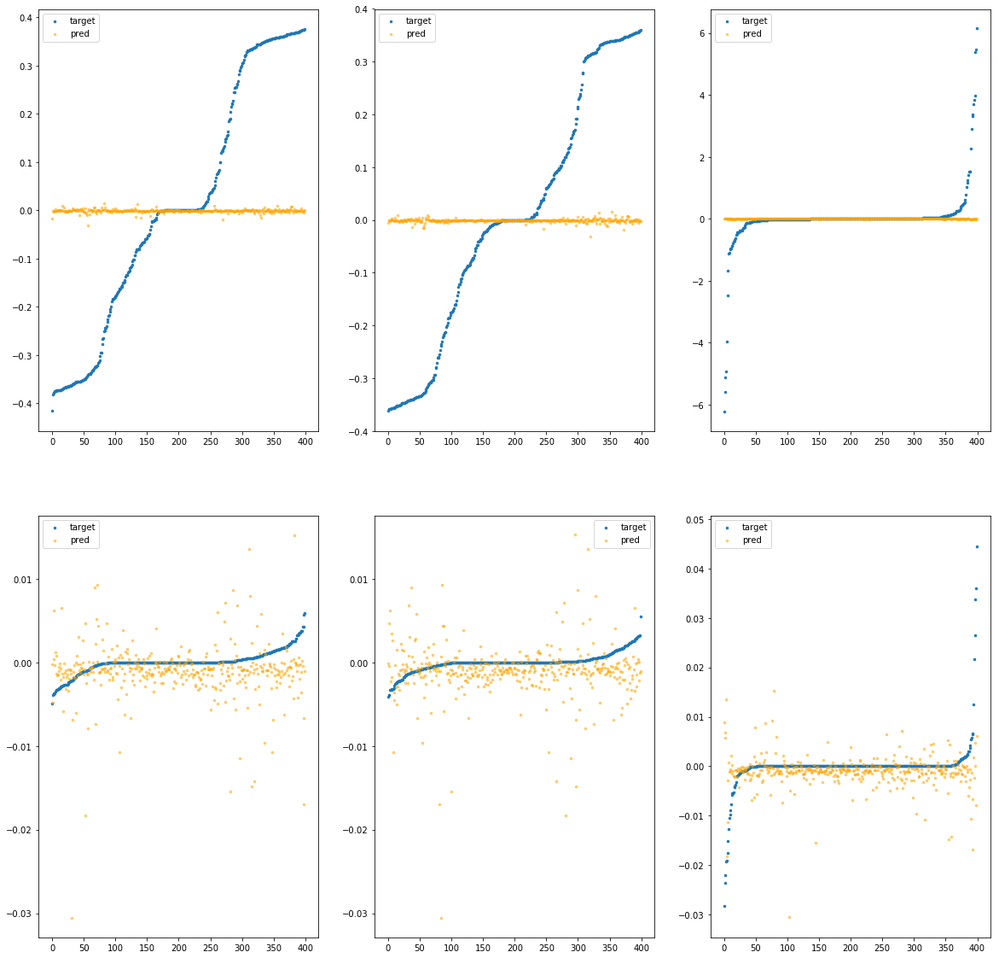

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adam.Adam object at 0x7fba51bd4d90>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.86e-03	4.05e-01	2.05e-01	1.09e+02	6.42e-02	4.13e-03
y		-1.64e-03	3.61e-01	1.88e-01	1.10e+01	5.49e-02	3.02e-03
z		-1.93e-03	6.22e+00	2.77e-01	1.12e+01	8.77e-01	7.68e-01
phi		-5.74e+00	1.89e-02	2.05e-03	4.13e+04	1.25e-05	1.57e-10
theta		-7.45e+00	1.84e-02	1.86e-03	6.68e+03	1.07e-05	1.15e-10
psi		-2.72e-01	3.84e-02	2.47e-03	2.03e+04	3.12e-05	9.73e-10


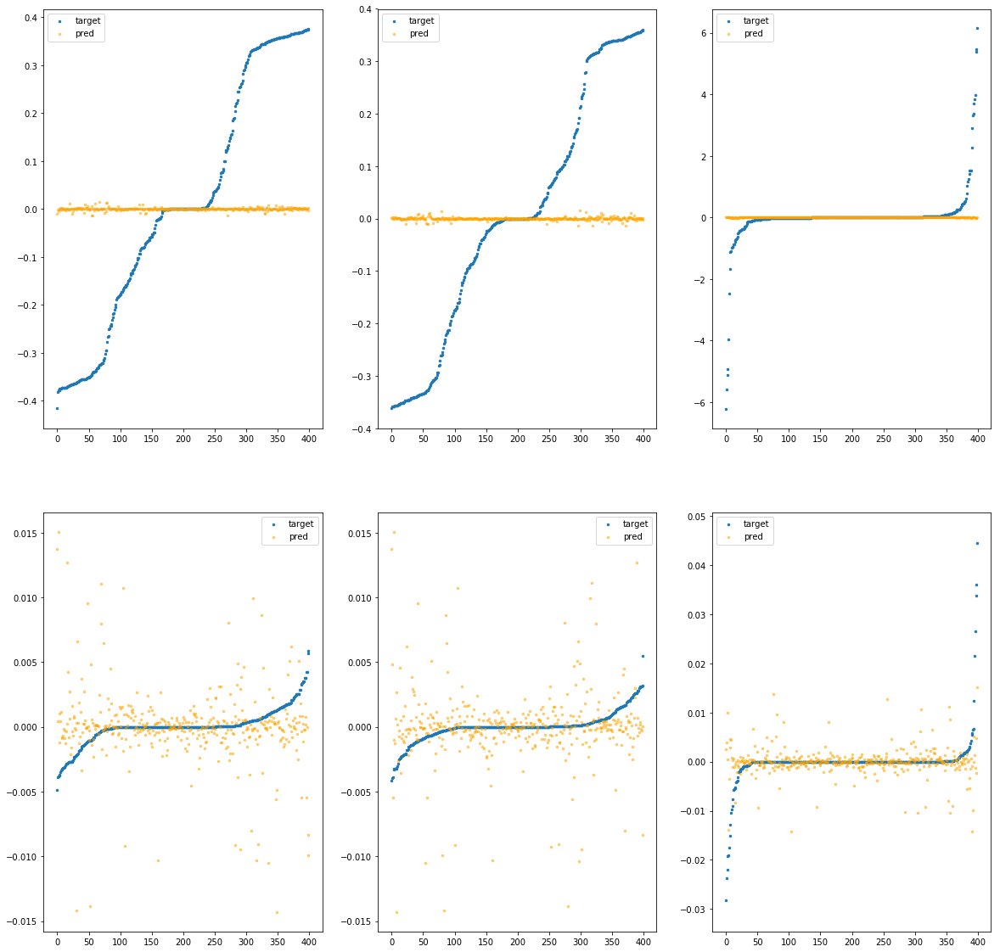

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bd4df0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-5.75e-03	4.15e-01	2.06e-01	2.57e+02	6.45e-02	4.16e-03
y		-1.56e-03	3.66e-01	1.88e-01	5.66e+01	5.49e-02	3.01e-03
z		-2.70e-03	6.22e+00	2.78e-01	3.01e+01	8.77e-01	7.70e-01
phi		-9.87e+00	3.11e-02	2.88e-03	9.83e+04	2.02e-05	4.09e-10
theta		-1.53e+01	3.14e-02	2.90e-03	6.02e+04	2.06e-05	4.26e-10
psi		-9.42e-01	4.80e-02	3.64e-03	4.30e+04	4.76e-05	2.27e-09


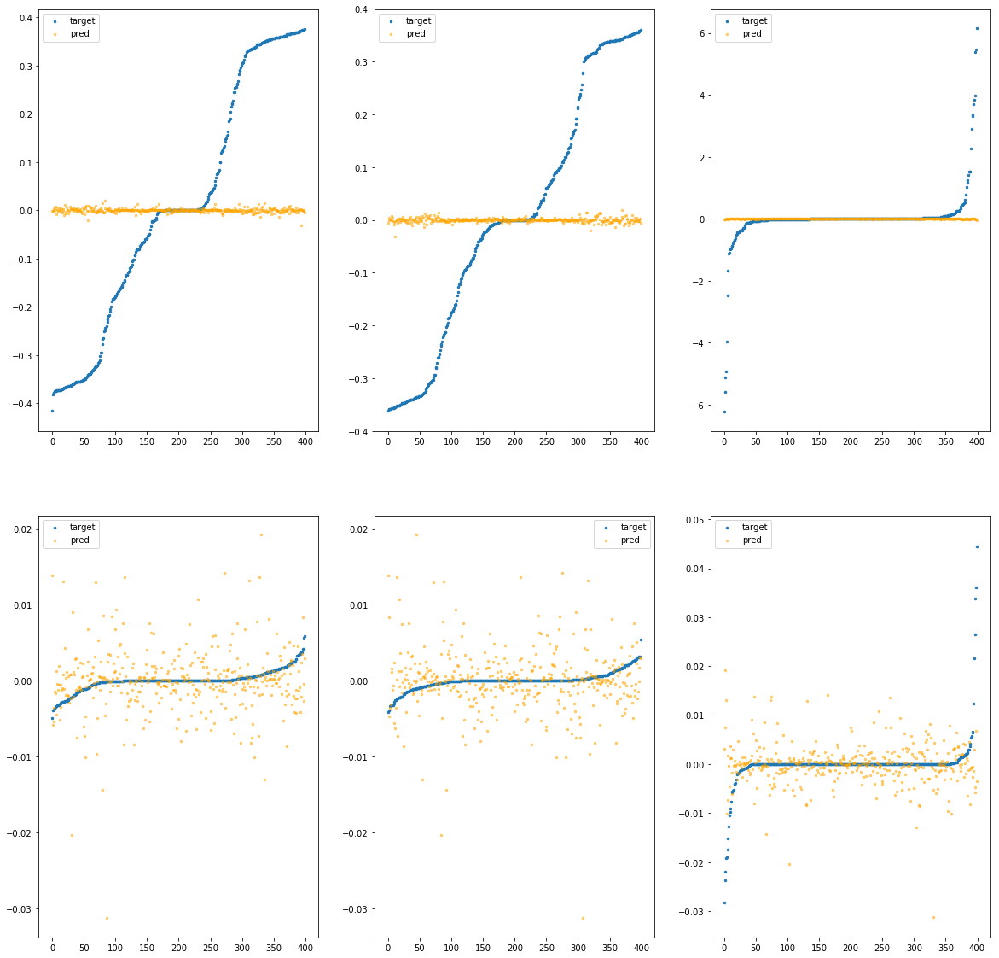

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bd4e50>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.73e+00	7.07e-01	3.46e-01	1.98e+05	1.75e-01	3.07e-02
y		-1.99e+00	6.89e-01	3.37e-01	2.64e+04	1.64e-01	2.68e-02
z		-1.40e-01	6.47e+00	5.27e-01	1.38e+04	9.97e-01	9.95e-01
phi		-5.57e+04	3.48e-01	3.22e-01	7.57e+07	1.04e-01	1.07e-02
theta		-8.16e+04	3.48e-01	3.22e-01	2.72e+07	1.04e-01	1.07e-02
psi		-4.22e+03	3.62e-01	3.22e-01	8.84e+06	1.04e-01	1.07e-02


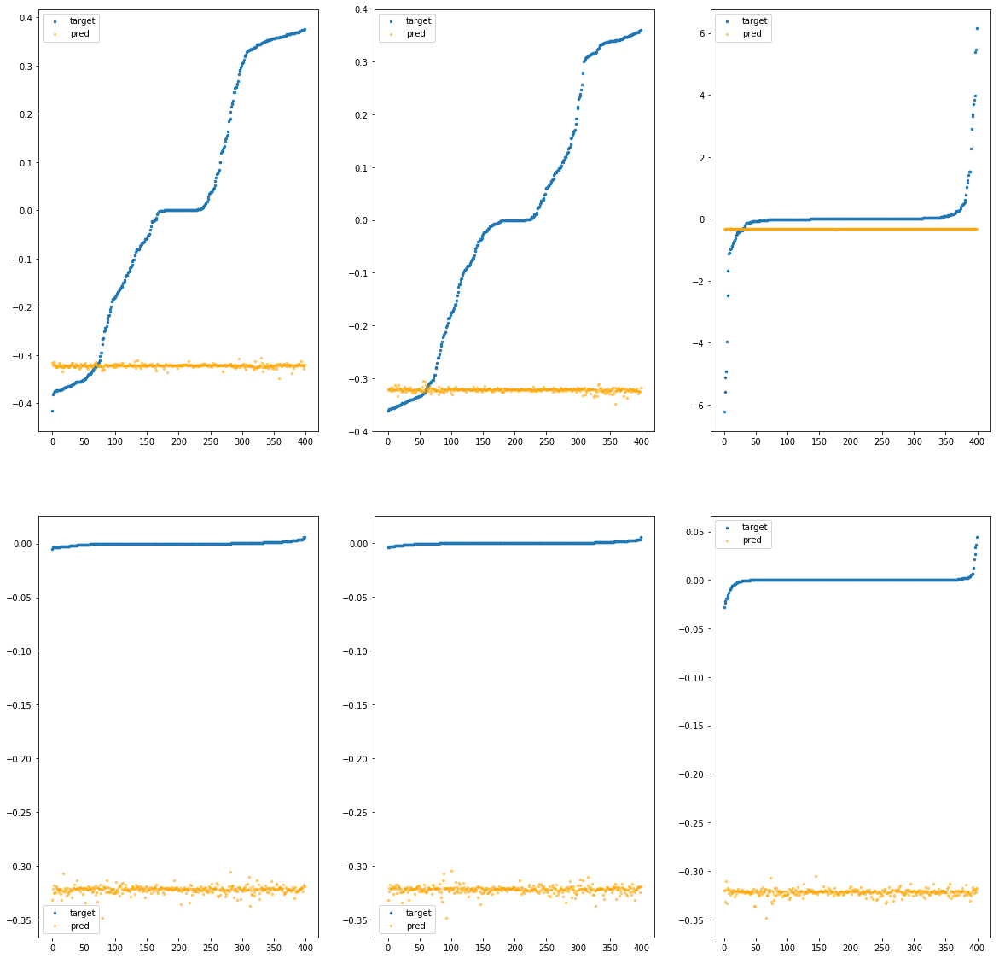

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bd4eb0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.05e-02	4.44e-01	2.18e-01	3.85e+04	6.93e-02	4.80e-03
y		-9.19e-02	4.26e-01	2.03e-01	5.12e+03	5.99e-02	3.58e-03
z		-9.77e-03	6.20e+00	3.14e-01	2.68e+03	8.83e-01	7.80e-01
phi		-2.13e+03	8.20e-02	6.28e-02	1.47e+07	3.96e-03	1.57e-05
theta		-3.12e+03	8.16e-02	6.28e-02	5.28e+06	3.96e-03	1.57e-05
psi		-1.61e+02	1.16e-01	6.27e-02	1.77e+06	3.98e-03	1.58e-05


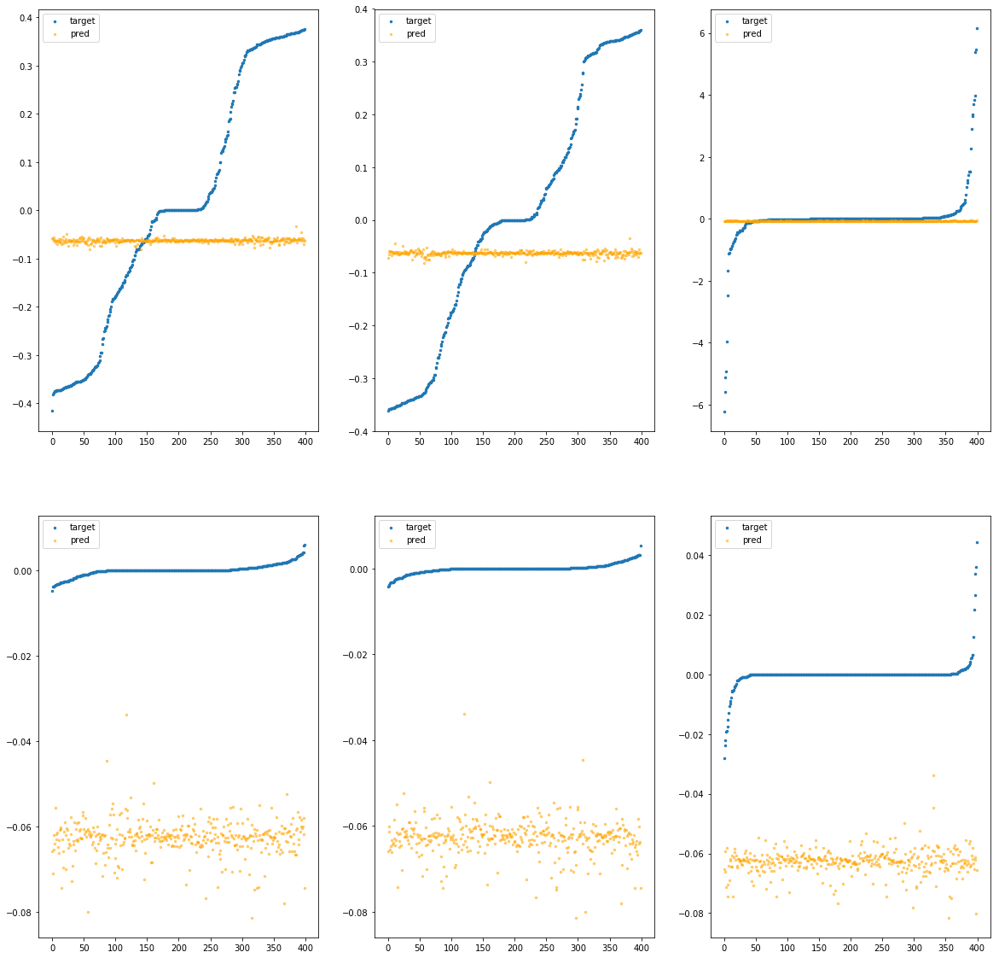

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bd4f10>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.26e-03	4.00e-01	2.07e-01	5.55e+03	6.44e-02	4.15e-03
y		-7.62e-03	3.75e-01	1.89e-01	7.29e+02	5.52e-02	3.05e-03
z		-9.12e-04	6.22e+00	2.80e-01	3.91e+02	8.76e-01	7.67e-01
phi		-5.28e+01	2.80e-02	9.35e-03	2.11e+06	1.00e-04	1.00e-08
theta		-7.67e+01	2.80e-02	9.29e-03	7.58e+05	9.86e-05	9.73e-09
psi		-4.05e+00	6.72e-02	9.66e-03	2.28e+05	1.24e-04	1.53e-08


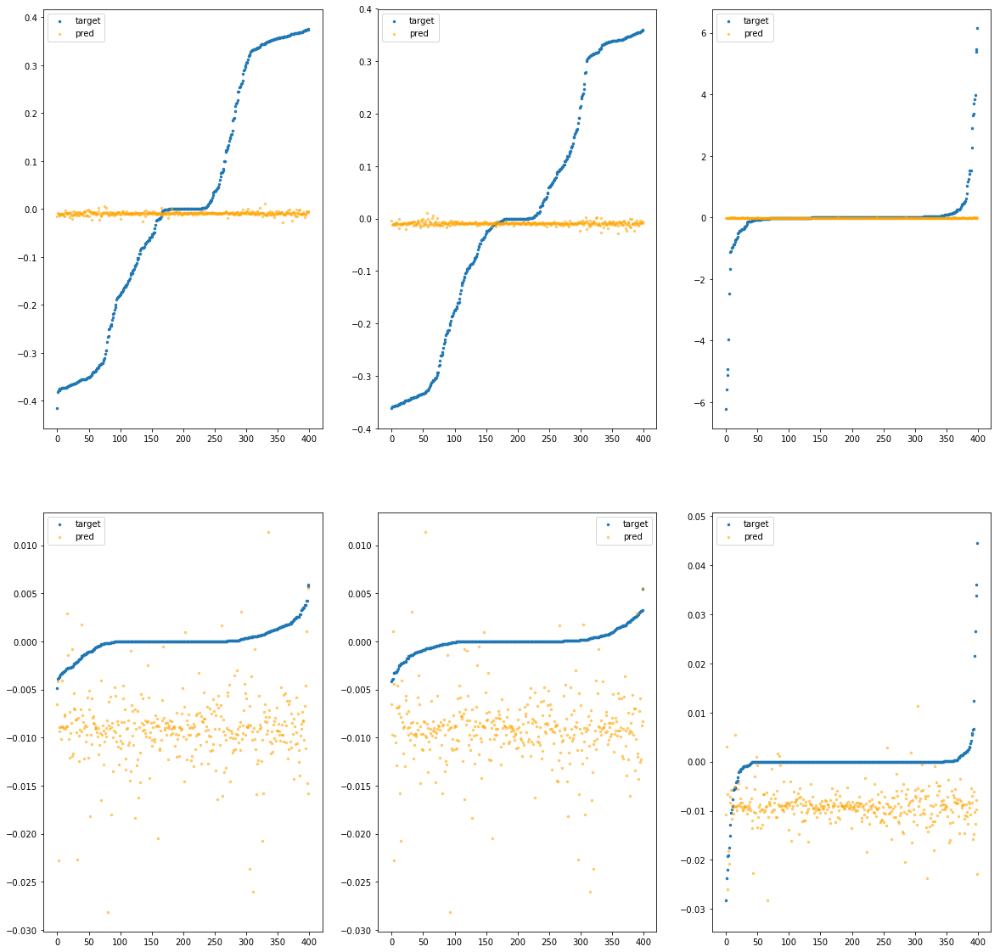

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bd4f70>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.31e-03	4.09e-01	2.07e-01	3.14e+03	6.44e-02	4.15e-03
y		-3.42e-03	3.69e-01	1.89e-01	3.91e+02	5.50e-02	3.03e-03
z		-2.66e-03	6.23e+00	2.79e-01	2.07e+02	8.77e-01	7.69e-01
phi		-2.12e+01	2.06e-02	5.53e-03	1.21e+06	4.13e-05	1.71e-09
theta		-3.12e+01	2.06e-02	5.50e-03	4.26e+05	4.09e-05	1.67e-09
psi		-1.67e+00	3.68e-02	6.32e-03	1.30e+05	6.56e-05	4.30e-09


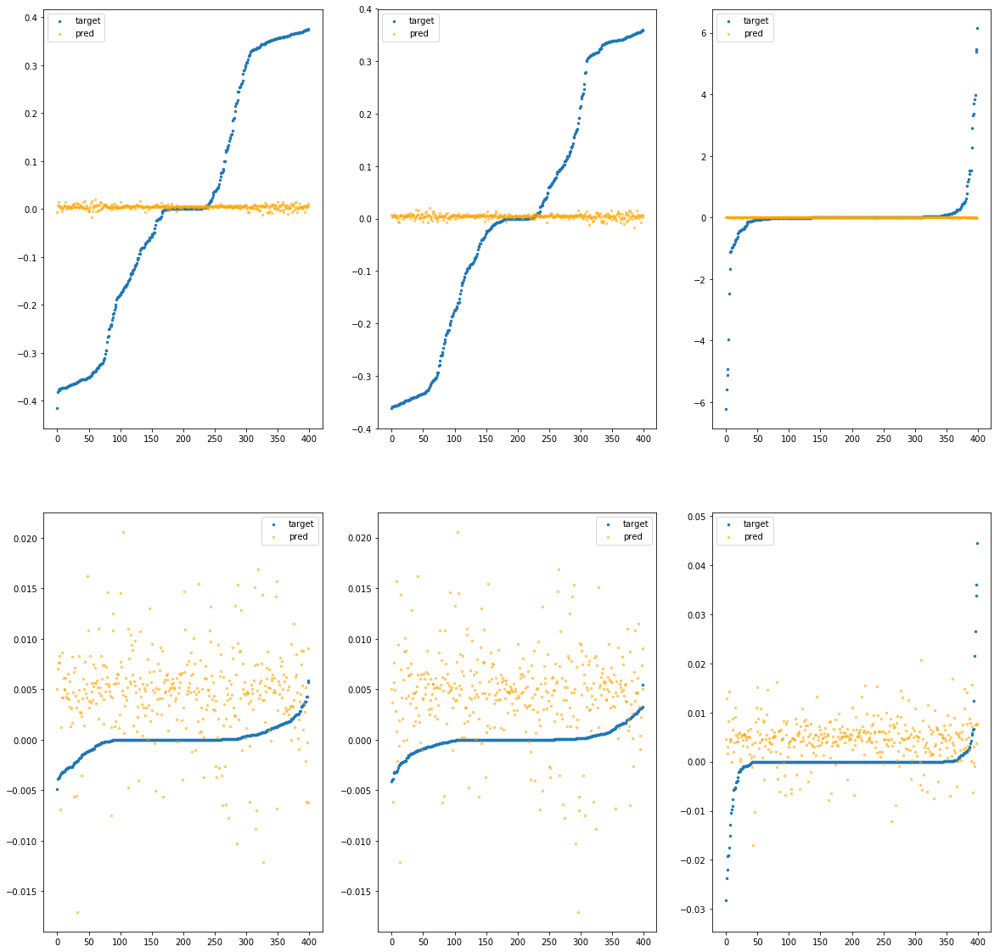

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bd4fd0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.62e-03	4.42e-01	2.06e-01	4.94e+02	6.42e-02	4.12e-03
y		-9.96e-04	3.67e-01	1.88e-01	4.01e+01	5.49e-02	3.01e-03
z		-1.95e-03	6.23e+00	2.78e-01	4.74e+01	8.77e-01	7.68e-01
phi		-1.40e+01	2.78e-02	3.54e-03	1.87e+05	2.80e-05	7.82e-10
theta		-2.27e+01	3.10e-02	3.50e-03	4.62e+04	3.00e-05	9.03e-10
psi		-1.37e+00	5.03e-02	4.12e-03	9.12e+04	5.82e-05	3.39e-09


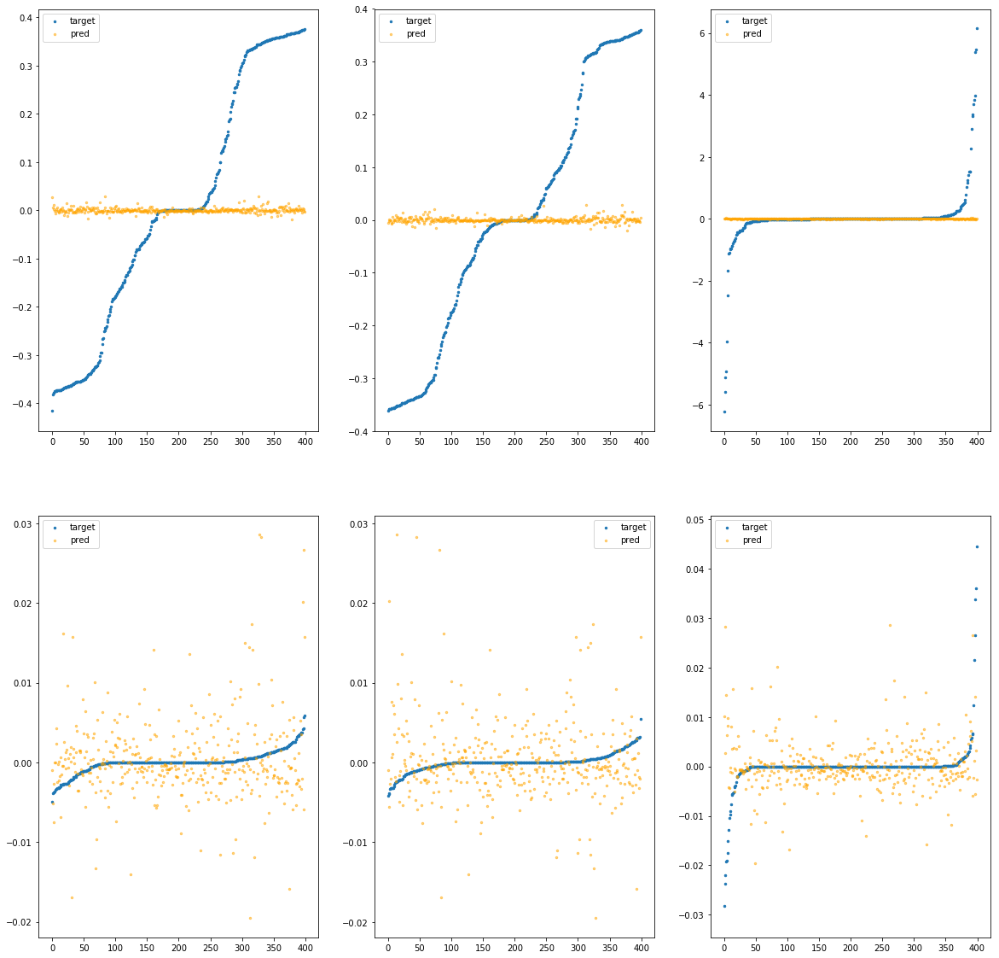

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bde070>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.45e-04	4.09e-01	2.05e-01	3.11e+02	6.42e-02	4.12e-03
y		5.25e-04	3.70e-01	1.88e-01	9.29e+01	5.48e-02	3.00e-03
z		-1.87e-03	6.24e+00	2.78e-01	3.29e+01	8.76e-01	7.68e-01
phi		-1.19e+01	1.84e-02	3.40e-03	1.38e+05	2.40e-05	5.77e-10
theta		-1.73e+01	1.99e-02	3.28e-03	2.95e+04	2.32e-05	5.40e-10
psi		-1.02e+00	4.88e-02	4.05e-03	4.77e+04	4.96e-05	2.46e-09


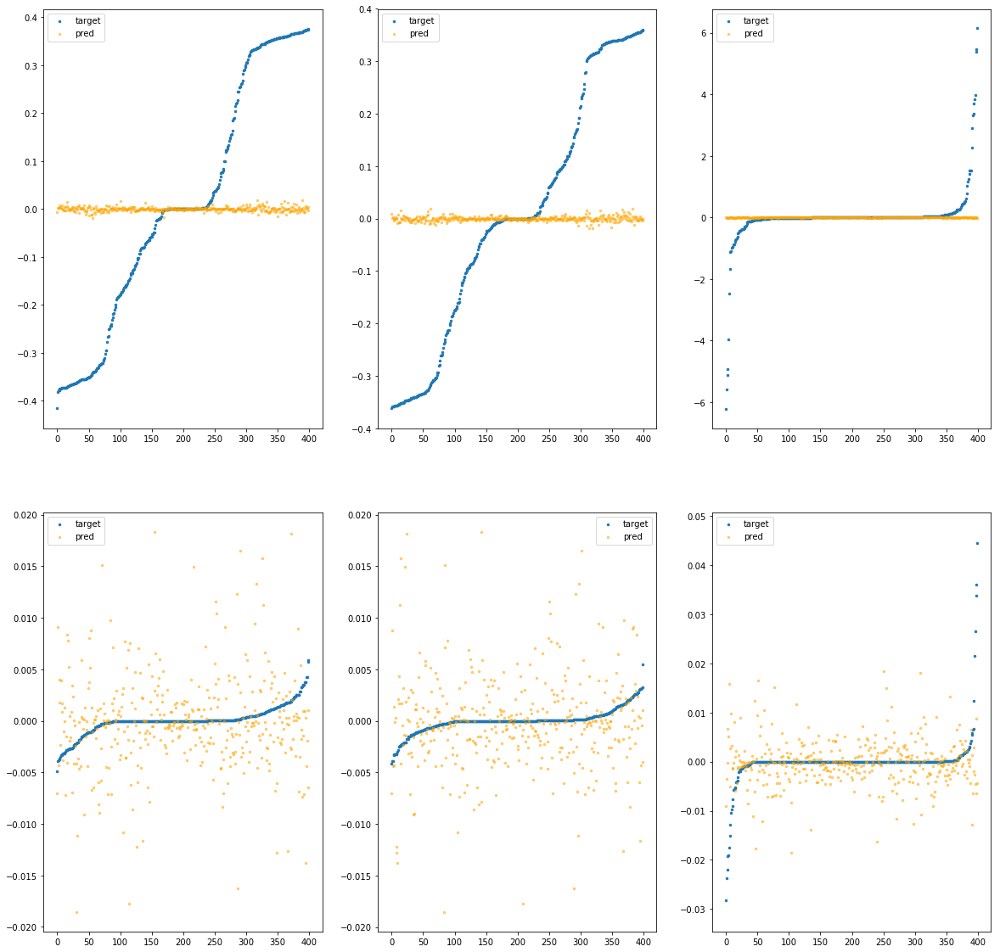

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bde0d0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.45e-01	6.26e-01	2.62e-01	1.10e+05	9.27e-02	8.59e-03
y		-5.39e-01	5.44e-01	2.46e-01	1.47e+04	8.44e-02	7.12e-03
z		-2.48e-02	6.42e+00	4.03e-01	7.69e+03	8.97e-01	8.04e-01
phi		-1.74e+04	2.05e-01	1.80e-01	4.21e+07	3.24e-02	1.05e-03
theta		-2.55e+04	2.11e-01	1.80e-01	1.52e+07	3.24e-02	1.05e-03
psi		-1.32e+03	2.18e-01	1.80e-01	4.92e+06	3.24e-02	1.05e-03


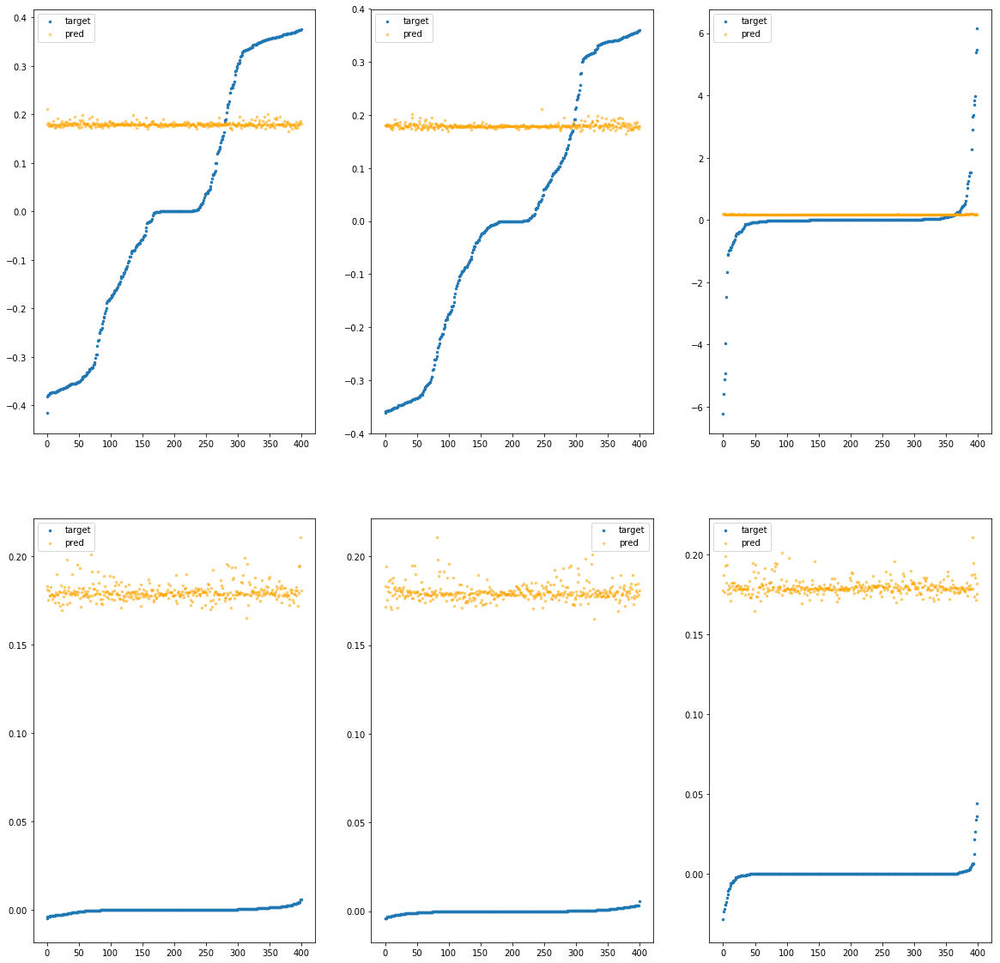

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bde130>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.12e-03	4.31e-01	2.05e-01	4.04e+02	6.42e-02	4.12e-03
y		3.83e-03	3.69e-01	1.87e-01	4.08e+01	5.46e-02	2.98e-03
z		-1.29e-03	6.23e+00	2.78e-01	4.00e+01	8.76e-01	7.67e-01
phi		-1.08e+01	1.94e-02	3.22e-03	1.41e+05	2.21e-05	4.86e-10
theta		-1.69e+01	1.87e-02	3.24e-03	4.03e+04	2.27e-05	5.16e-10
psi		-9.81e-01	4.61e-02	3.91e-03	7.31e+04	4.86e-05	2.36e-09


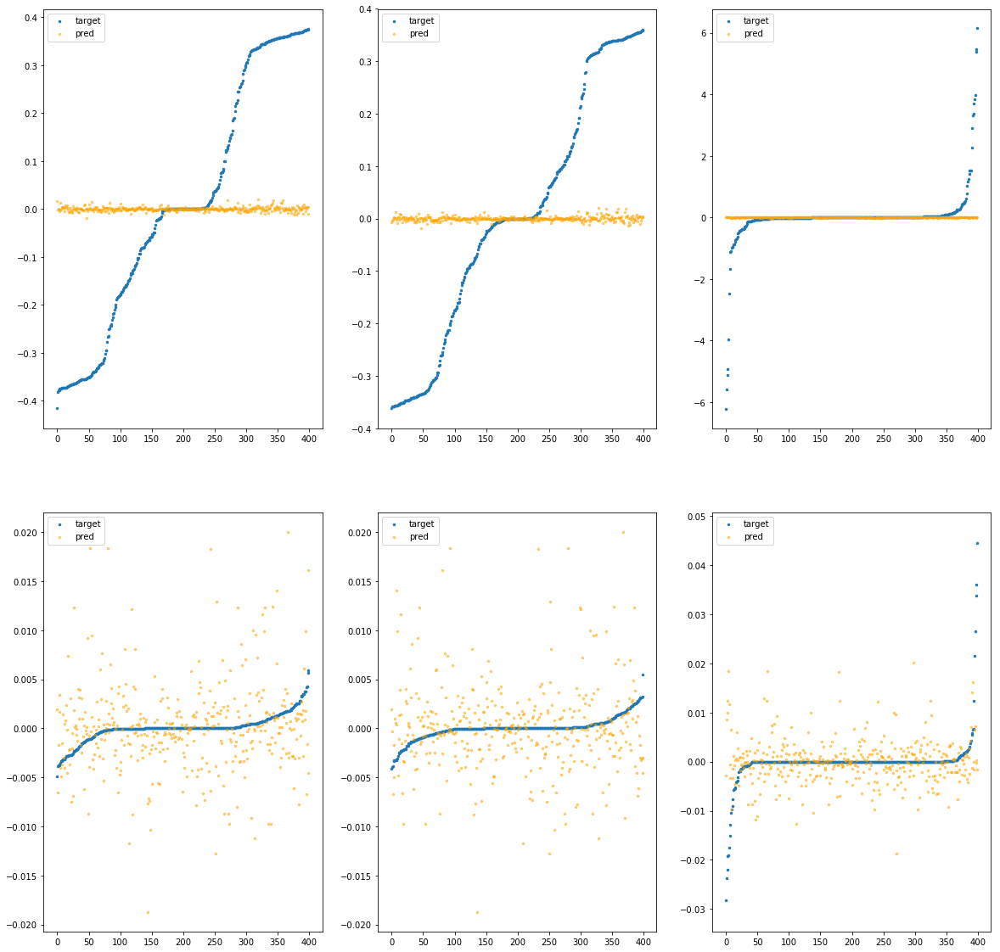

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bde190>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.83e-02	4.68e-01	2.20e-01	3.70e+04	6.66e-02	4.43e-03
y		-4.96e-02	4.30e-01	2.00e-01	4.92e+03	5.75e-02	3.31e-03
z		-1.01e-03	6.30e+00	3.11e-01	2.58e+03	8.76e-01	7.67e-01
phi		-1.99e+03	9.21e-02	6.07e-02	1.41e+07	3.70e-03	1.37e-05
theta		-2.92e+03	9.21e-02	6.07e-02	5.09e+06	3.71e-03	1.37e-05
psi		-1.51e+02	1.04e-01	6.08e-02	1.63e+06	3.73e-03	1.39e-05


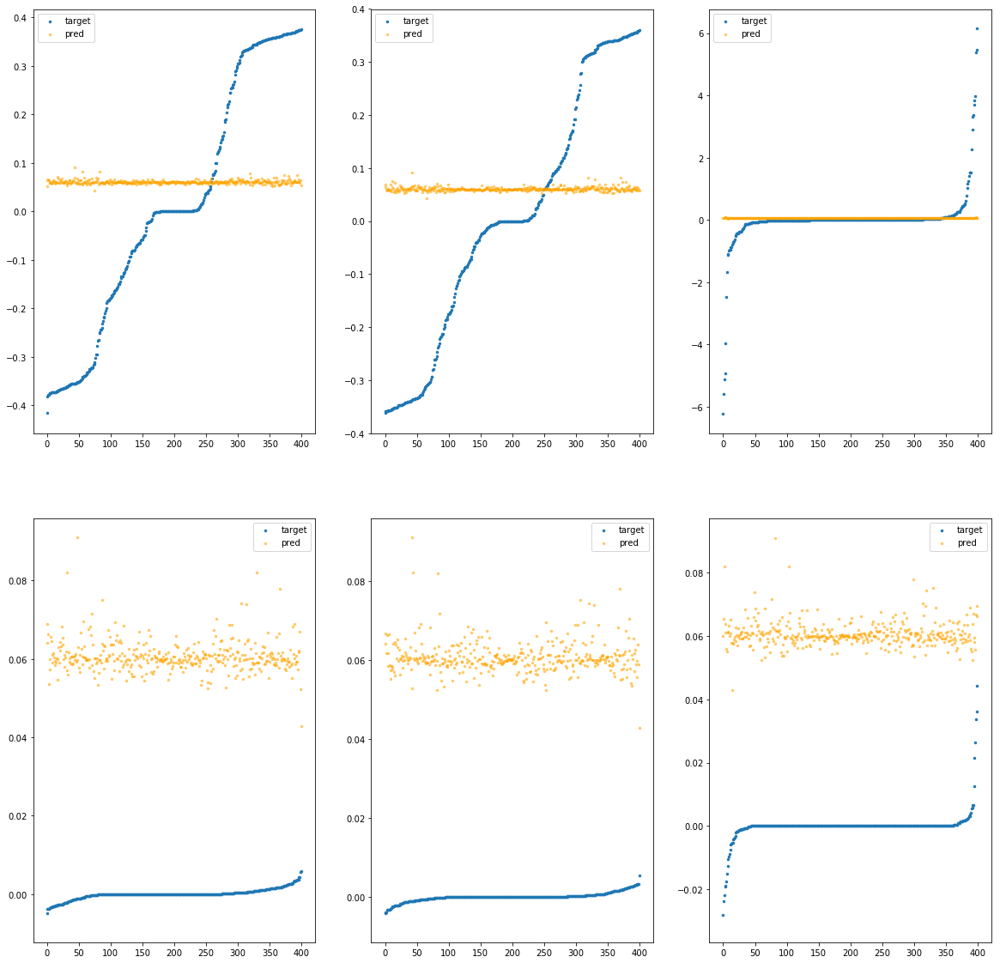

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bde1f0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.16e-04	4.18e-01	2.05e-01	6.37e+02	6.42e-02	4.12e-03
y		-2.19e-03	3.64e-01	1.88e-01	6.27e+01	5.49e-02	3.02e-03
z		-1.03e-03	6.24e+00	2.78e-01	6.11e+01	8.76e-01	7.67e-01
phi		-9.99e+00	2.12e-02	3.14e-03	2.49e+05	2.05e-05	4.18e-10
theta		-1.47e+01	1.97e-02	3.12e-03	6.37e+04	2.00e-05	4.00e-10
psi		-8.05e-01	4.33e-02	3.89e-03	5.52e+04	4.43e-05	1.96e-09


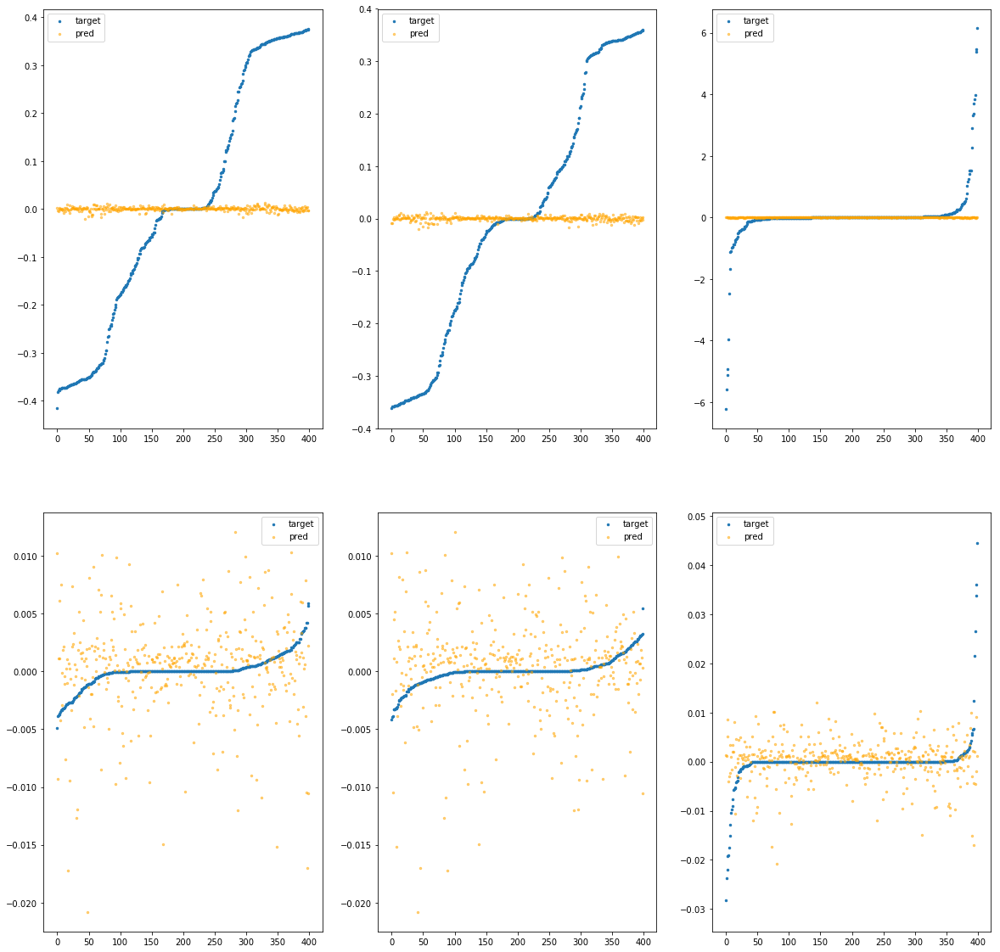

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bde250>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.27e-04	4.01e-01	2.05e-01	2.85e+02	6.41e-02	4.11e-03
y		-2.42e-03	3.68e-01	1.88e-01	4.78e+01	5.50e-02	3.02e-03
z		-1.05e-03	6.24e+00	2.77e-01	3.47e+01	8.76e-01	7.67e-01
phi		-8.04e+00	2.04e-02	2.67e-03	9.44e+04	1.68e-05	2.83e-10
theta		-1.20e+01	2.02e-02	2.64e-03	3.32e+04	1.64e-05	2.71e-10
psi		-5.46e-01	3.93e-02	3.29e-03	3.29e+04	3.79e-05	1.44e-09


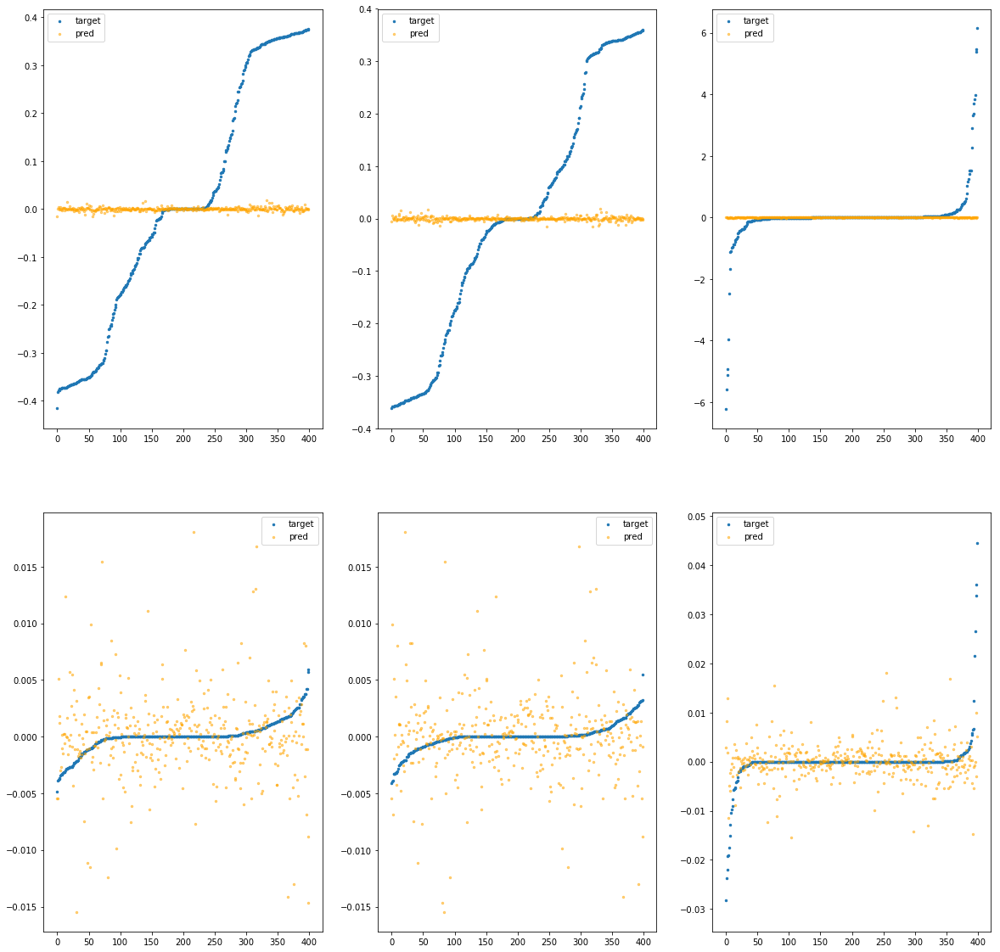

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bde2b0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.43e-01	4.64e-01	2.25e-01	5.11e+04	7.33e-02	5.37e-03
y		-1.56e-01	4.46e-01	2.10e-01	6.83e+03	6.34e-02	4.01e-03
z		-1.55e-02	6.23e+00	3.30e-01	3.56e+03	8.88e-01	7.89e-01
phi		-3.84e+03	1.09e-01	8.45e-02	1.95e+07	7.16e-03	5.12e-05
theta		-5.63e+03	1.12e-01	8.44e-02	7.05e+06	7.15e-03	5.11e-05
psi		-2.91e+02	1.37e-01	8.44e-02	2.30e+06	7.16e-03	5.13e-05


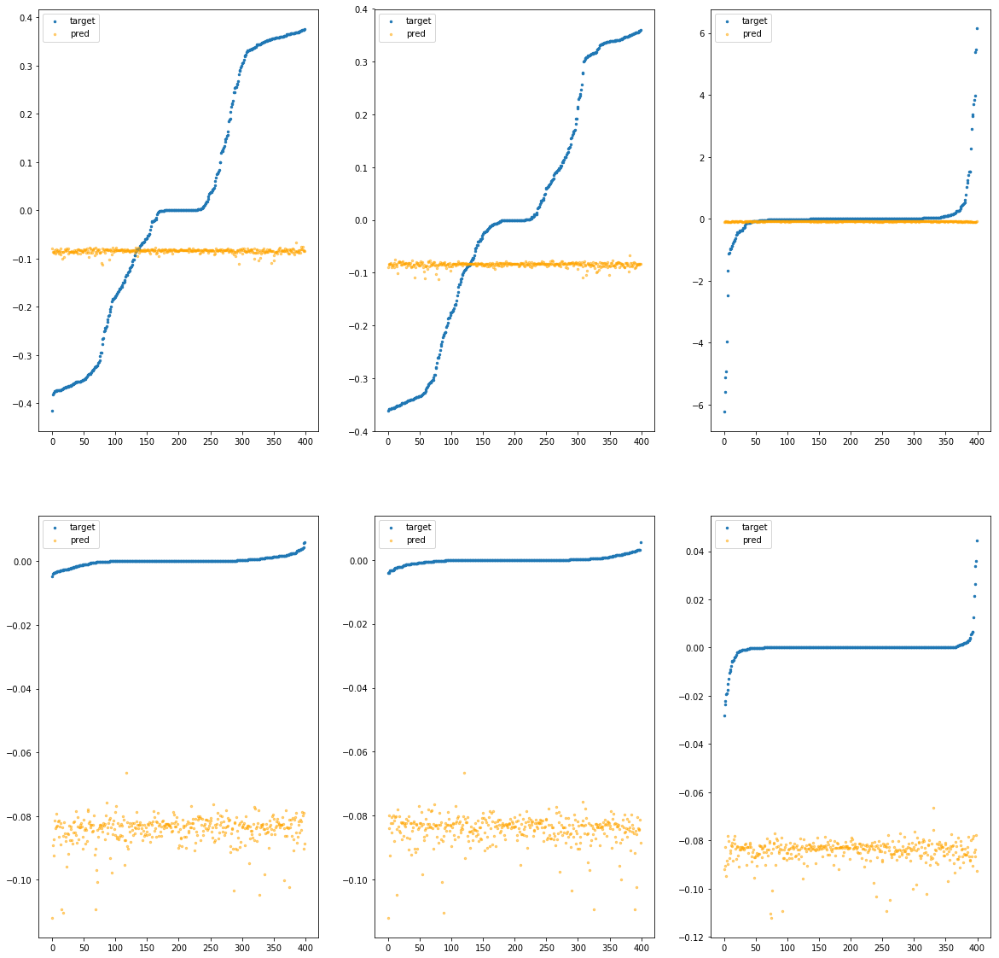

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bde310>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.70e-04	4.06e-01	2.05e-01	3.01e+02	6.41e-02	4.11e-03
y		-4.45e-03	3.69e-01	1.88e-01	2.90e+01	5.51e-02	3.03e-03
z		-1.31e-03	6.22e+00	2.78e-01	4.38e+01	8.76e-01	7.67e-01
phi		-1.26e+01	3.08e-02	3.19e-03	1.13e+05	2.54e-05	6.43e-10
theta		-1.84e+01	3.14e-02	3.17e-03	3.21e+04	2.47e-05	6.09e-10
psi		-8.96e-01	4.70e-02	3.68e-03	4.41e+04	4.65e-05	2.16e-09


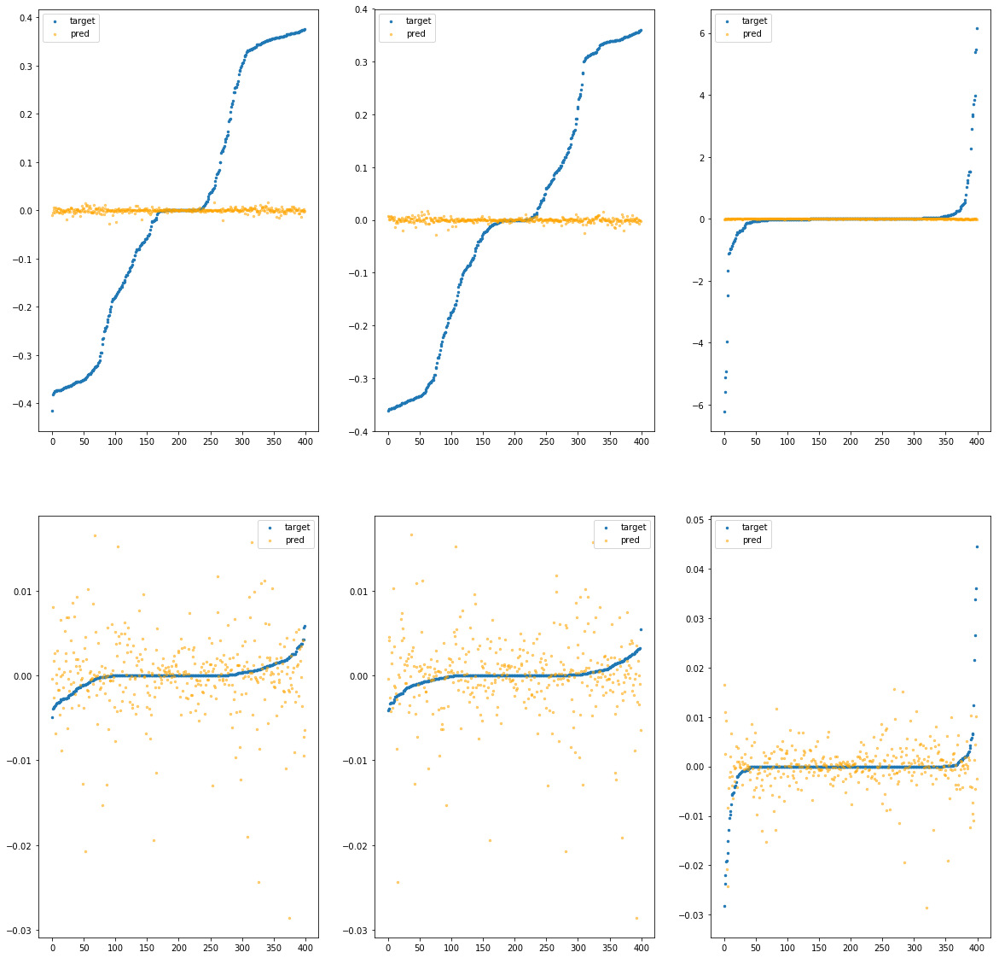

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bde370>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		2.93e-03	4.19e-01	2.05e-01	2.56e+02	6.39e-02	4.09e-03
y		-4.26e-03	3.67e-01	1.88e-01	5.41e+01	5.51e-02	3.03e-03
z		-1.21e-03	6.22e+00	2.78e-01	4.25e+01	8.76e-01	7.67e-01
phi		-1.07e+01	2.95e-02	2.98e-03	9.75e+04	2.18e-05	4.73e-10
theta		-1.57e+01	2.94e-02	2.88e-03	5.45e+04	2.12e-05	4.49e-10
psi		-8.51e-01	7.10e-02	3.54e-03	6.74e+04	4.54e-05	2.06e-09


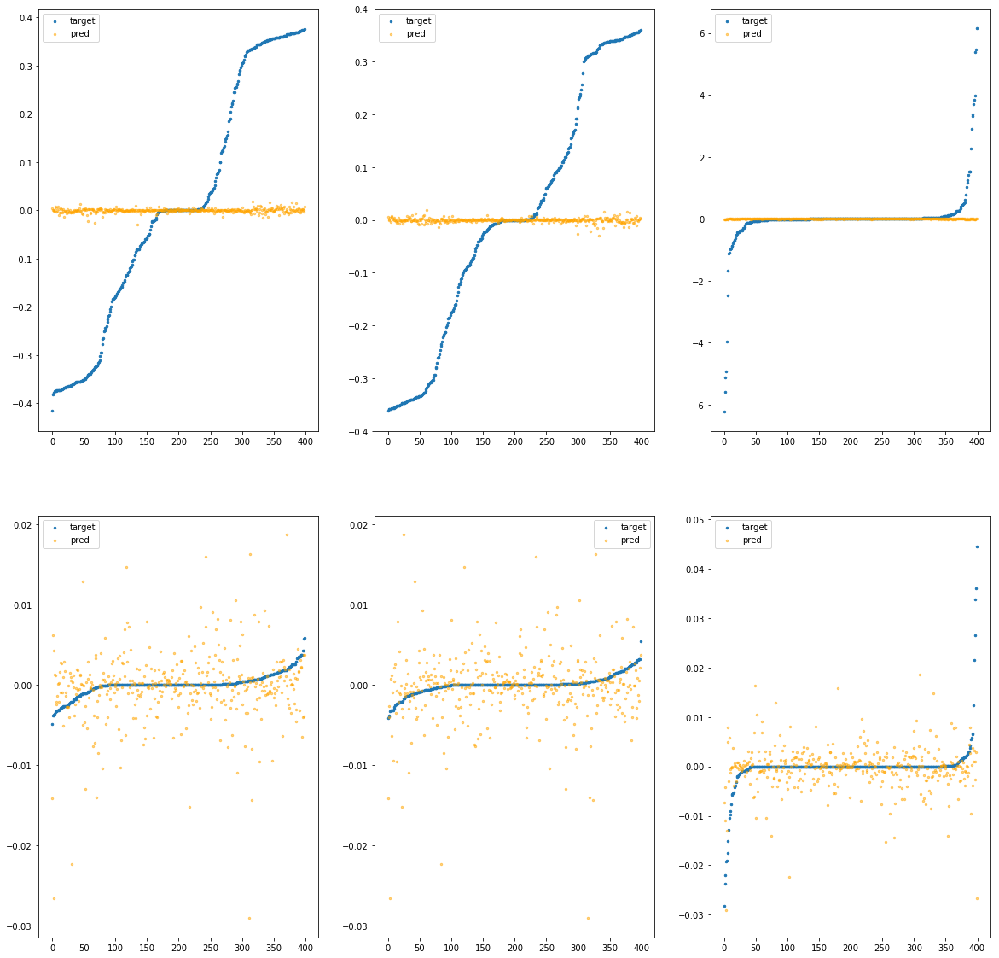

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bde3d0>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.64e-03	4.16e-01	2.06e-01	5.85e+02	6.42e-02	4.12e-03
y		-3.81e-03	3.64e-01	1.88e-01	9.07e+01	5.50e-02	3.03e-03
z		-2.43e-03	6.23e+00	2.78e-01	4.69e+01	8.77e-01	7.69e-01
phi		-7.69e+00	1.74e-02	2.79e-03	2.03e+05	1.62e-05	2.62e-10
theta		-1.13e+01	1.86e-02	2.70e-03	5.70e+04	1.56e-05	2.44e-10
psi		-7.01e-01	4.92e-02	3.42e-03	6.30e+04	4.17e-05	1.74e-09


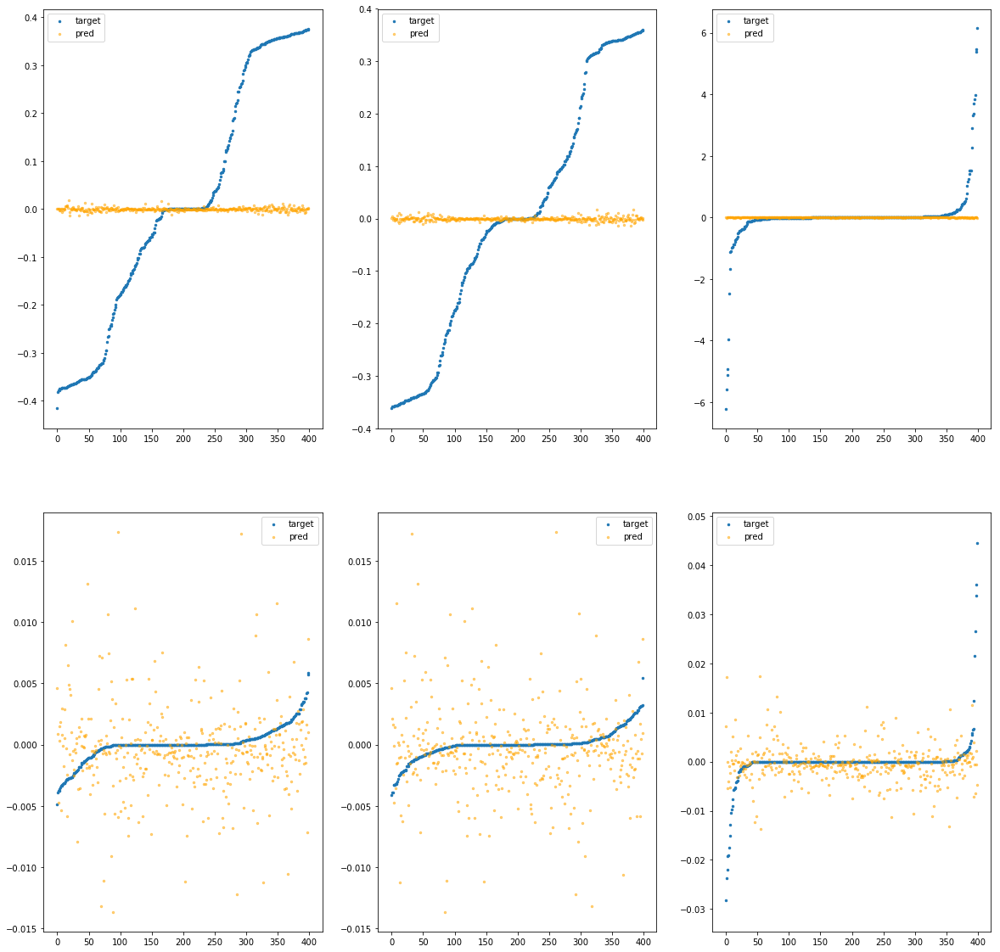

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bde430>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.72e-03	4.12e-01	2.06e-01	3.63e+02	6.44e-02	4.14e-03
y		-1.48e-03	3.64e-01	1.88e-01	7.25e+01	5.49e-02	3.01e-03
z		-2.04e-03	6.22e+00	2.78e-01	4.65e+01	8.77e-01	7.69e-01
phi		-8.25e+00	2.01e-02	2.77e-03	1.33e+05	1.72e-05	2.97e-10
theta		-1.25e+01	1.83e-02	2.79e-03	5.18e+04	1.71e-05	2.92e-10
psi		-3.90e-01	4.59e-02	3.21e-03	4.79e+04	3.41e-05	1.16e-09


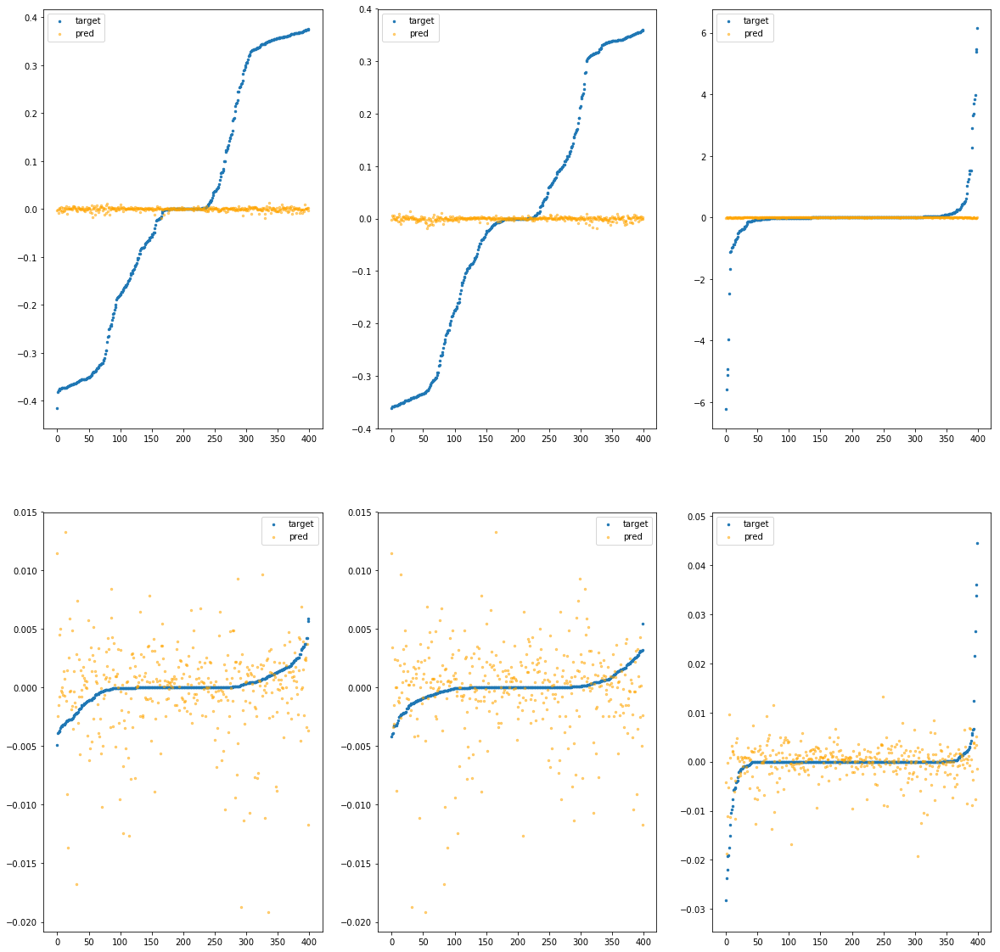

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bde490>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.58e-03	4.12e-01	2.06e-01	4.35e+02	6.43e-02	4.14e-03
y		-7.76e-03	3.69e-01	1.88e-01	4.86e+01	5.52e-02	3.05e-03
z		-5.70e-04	6.21e+00	2.78e-01	3.10e+01	8.75e-01	7.66e-01
phi		-1.10e+01	2.53e-02	3.16e-03	1.75e+05	2.24e-05	5.00e-10
theta		-1.60e+01	2.52e-02	3.00e-03	4.12e+04	2.16e-05	4.66e-10
psi		-8.14e-01	5.21e-02	3.81e-03	3.78e+04	4.45e-05	1.98e-09


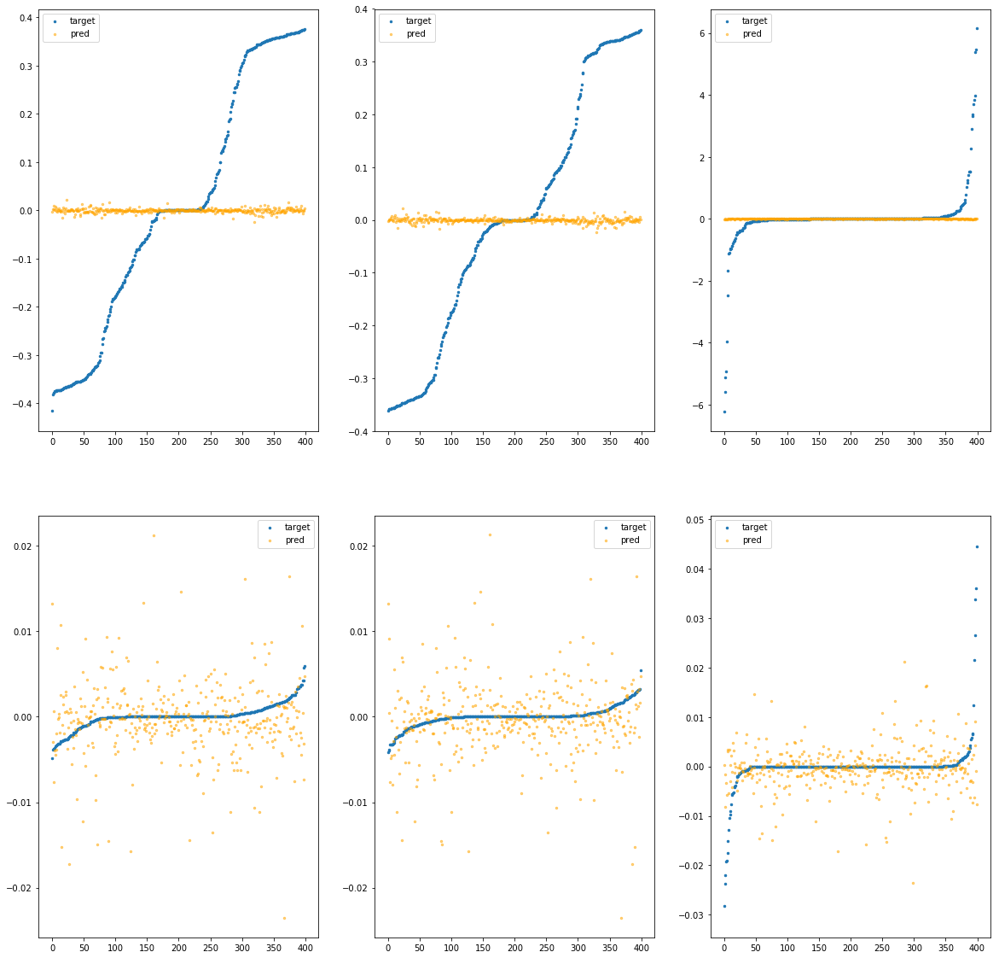

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bde4f0>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.25e-03	4.06e-01	2.06e-01	3.18e+02	6.42e-02	4.12e-03
y		-6.57e-04	3.68e-01	1.88e-01	5.74e+01	5.49e-02	3.01e-03
z		-1.41e-03	6.20e+00	2.78e-01	3.65e+01	8.76e-01	7.68e-01
phi		-1.43e+01	3.00e-02	3.45e-03	1.29e+05	2.84e-05	8.07e-10
theta		-1.94e+01	2.83e-02	3.22e-03	4.95e+04	2.59e-05	6.69e-10
psi		-1.21e+00	5.61e-02	4.02e-03	4.26e+04	5.42e-05	2.94e-09


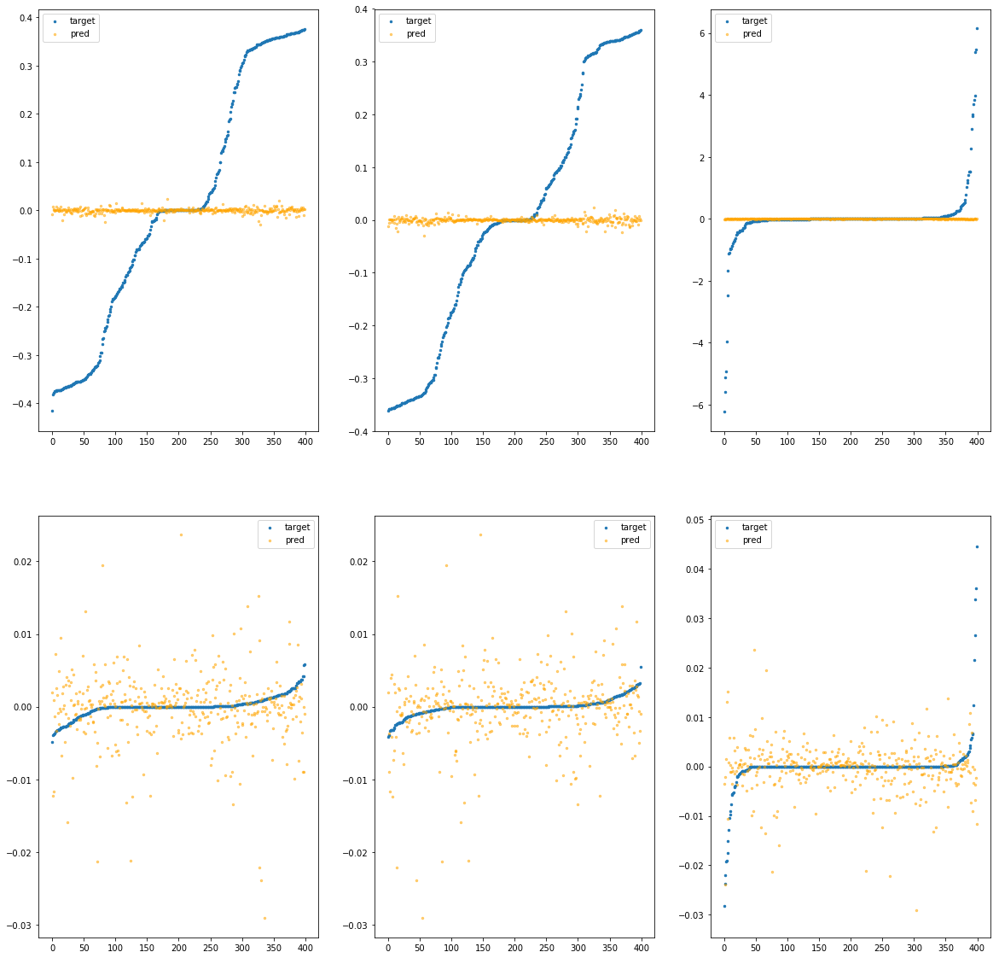

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba51bde550>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.80e-03	4.51e-01	2.10e-01	1.22e+04	6.44e-02	4.15e-03
y		-4.67e-03	4.00e-01	1.91e-01	1.66e+03	5.51e-02	3.03e-03
z		1.61e-03	6.26e+00	2.85e-01	8.70e+02	8.73e-01	7.63e-01
phi		-2.58e+02	4.80e-02	2.13e-02	4.71e+06	4.83e-04	2.33e-07
theta		-3.80e+02	4.77e-02	2.14e-02	1.73e+06	4.84e-04	2.35e-07
psi		-2.00e+01	6.87e-02	2.18e-02	5.61e+05	5.16e-04	2.66e-07


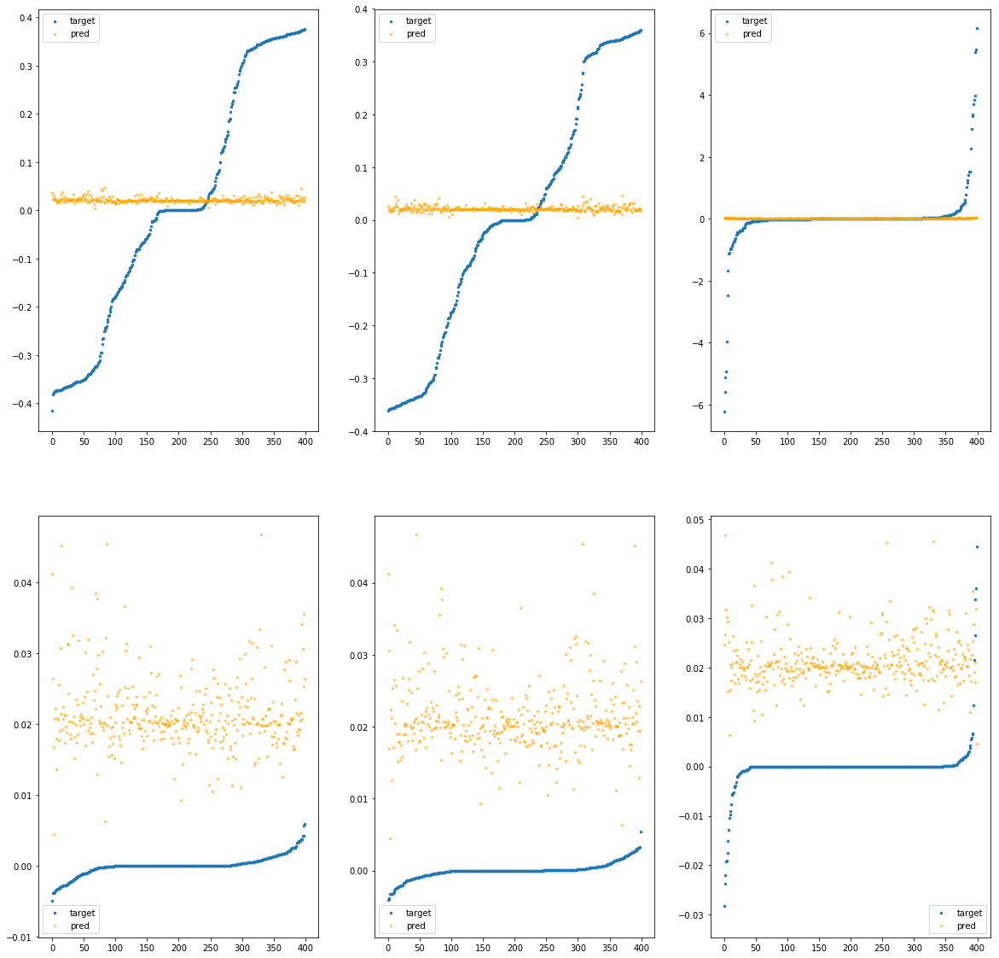

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bde5b0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.28e-03	4.18e-01	2.06e-01	1.98e+02	6.45e-02	4.16e-03
y		-2.29e-03	3.63e-01	1.88e-01	4.14e+01	5.49e-02	3.02e-03
z		-1.09e-03	6.23e+00	2.77e-01	2.17e+01	8.76e-01	7.67e-01
phi		-6.24e+00	1.90e-02	2.50e-03	9.99e+04	1.35e-05	1.82e-10
theta		-8.57e+00	1.71e-02	2.28e-03	2.89e+04	1.22e-05	1.48e-10
psi		-7.67e-01	5.14e-02	3.23e-03	3.63e+04	4.33e-05	1.88e-09


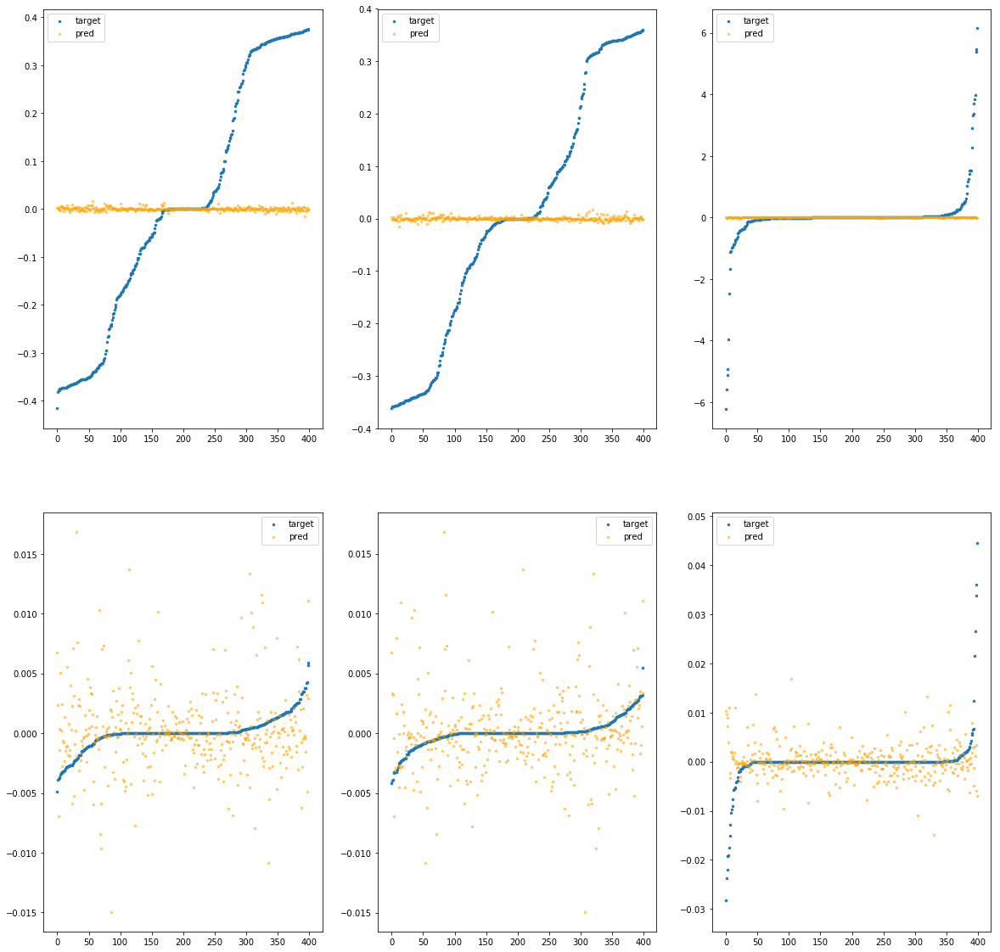

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bde610>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.03e-03	3.92e-01	2.05e-01	2.52e+02	6.42e-02	4.12e-03
y		-3.61e-03	3.80e-01	1.88e-01	1.20e+02	5.50e-02	3.03e-03
z		-1.44e-03	6.19e+00	2.78e-01	5.76e+01	8.76e-01	7.68e-01
phi		-1.91e+01	3.31e-02	3.75e-03	8.97e+04	3.73e-05	1.39e-09
theta		-2.72e+01	3.17e-02	3.66e-03	7.05e+04	3.59e-05	1.29e-09
psi		-1.27e+00	4.32e-02	4.18e-03	3.84e+04	5.58e-05	3.11e-09


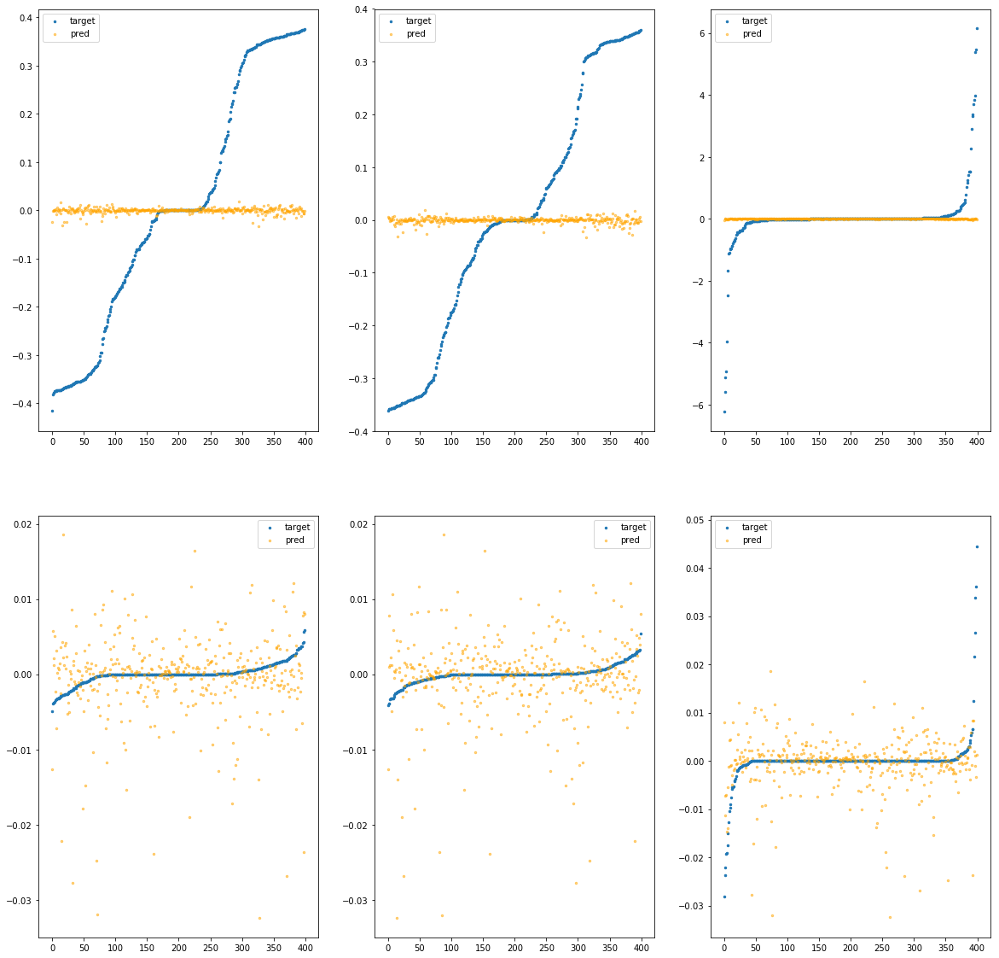

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bde670>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.08e-03	4.06e-01	2.06e-01	3.93e+02	6.44e-02	4.14e-03
y		3.31e-03	3.69e-01	1.87e-01	3.16e+01	5.46e-02	2.99e-03
z		-2.56e-03	6.23e+00	2.77e-01	3.61e+01	8.77e-01	7.69e-01
phi		-1.59e+01	3.40e-02	3.58e-03	1.69e+05	3.14e-05	9.87e-10
theta		-2.44e+01	3.40e-02	3.59e-03	1.78e+04	3.22e-05	1.04e-09
psi		-1.14e+00	4.85e-02	4.07e-03	4.22e+04	5.25e-05	2.75e-09


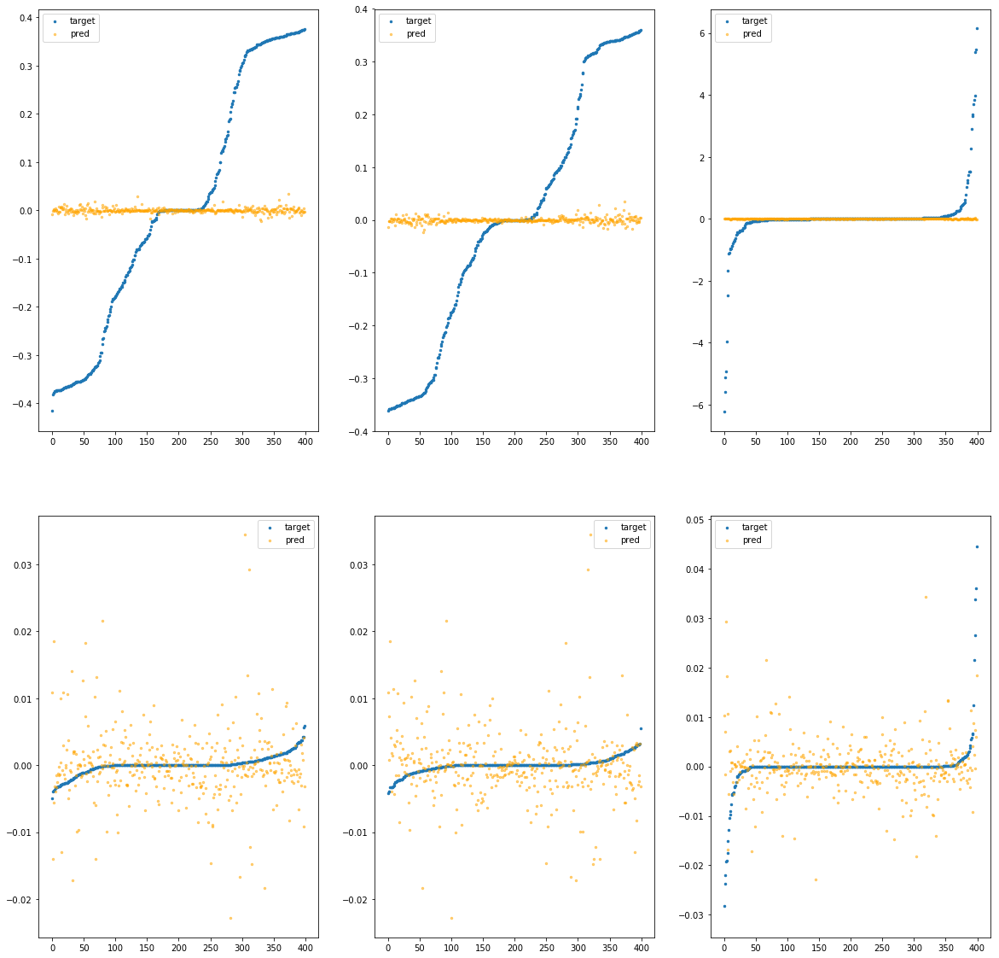

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bde6d0>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.91e-03	4.10e-01	2.05e-01	2.44e+02	6.40e-02	4.10e-03
y		2.08e-04	3.69e-01	1.88e-01	4.40e+01	5.48e-02	3.00e-03
z		6.21e-05	6.21e+00	2.77e-01	4.79e+01	8.75e-01	7.65e-01
phi		-1.31e+01	2.80e-02	3.29e-03	1.16e+05	2.62e-05	6.86e-10
theta		-1.89e+01	2.76e-02	3.17e-03	4.14e+04	2.52e-05	6.37e-10
psi		-5.78e-01	4.88e-02	3.56e-03	4.52e+04	3.87e-05	1.50e-09


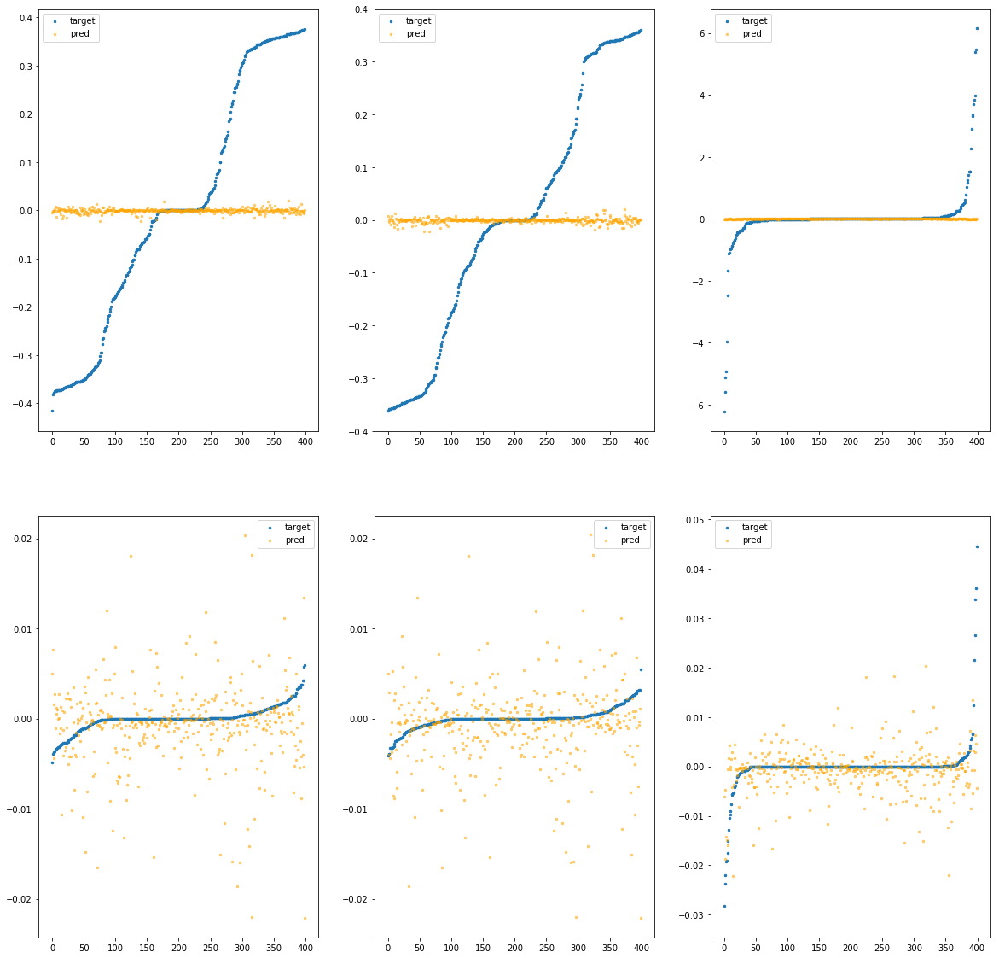

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bde730>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.83e-03	4.11e-01	2.06e-01	3.34e+02	6.42e-02	4.13e-03
y		9.16e-04	3.67e-01	1.88e-01	6.63e+01	5.48e-02	3.00e-03
z		6.03e-04	6.23e+00	2.78e-01	3.22e+01	8.74e-01	7.64e-01
phi		-8.39e+00	2.16e-02	2.83e-03	1.52e+05	1.75e-05	3.05e-10
theta		-1.14e+01	2.16e-02	2.71e-03	6.41e+04	1.58e-05	2.49e-10
psi		-7.69e-01	5.44e-02	3.59e-03	3.59e+04	4.34e-05	1.88e-09


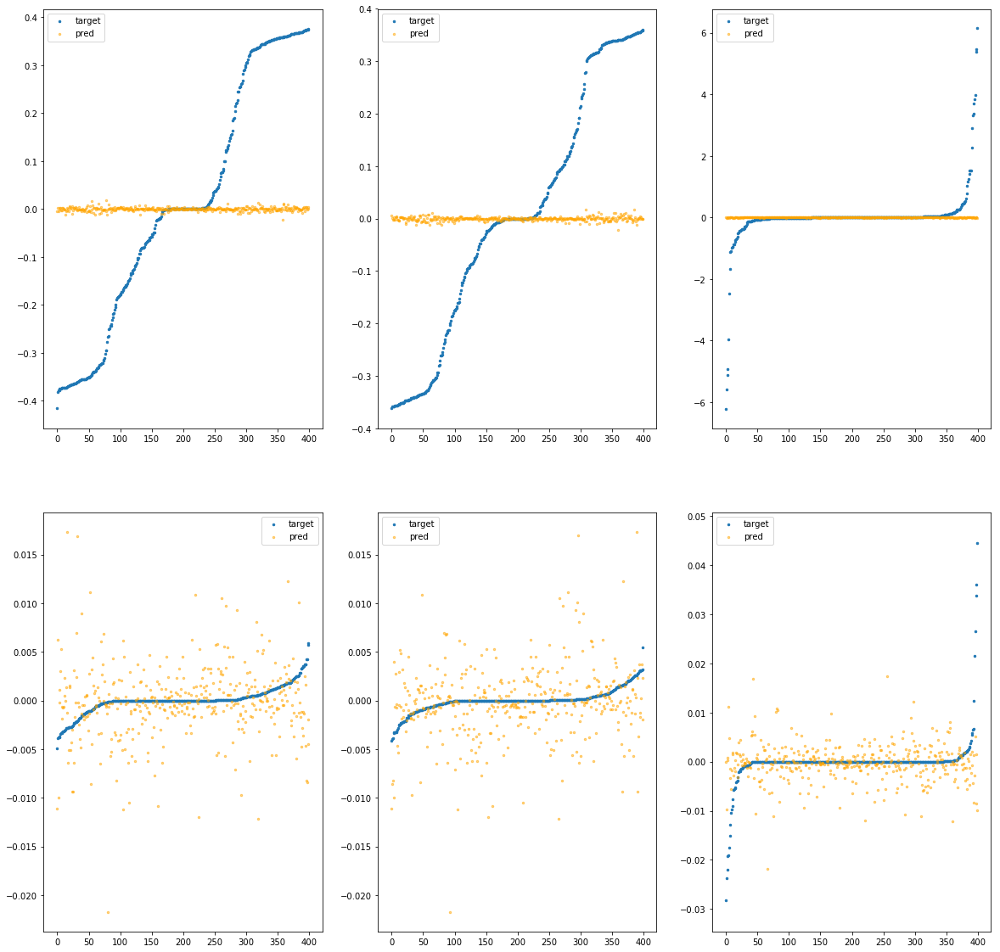

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bde790>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.90e-03	4.31e-01	2.06e-01	3.05e+02	6.43e-02	4.13e-03
y		-1.06e-04	3.66e-01	1.88e-01	4.61e+01	5.48e-02	3.01e-03
z		5.85e-04	6.23e+00	2.78e-01	3.07e+01	8.74e-01	7.64e-01
phi		-1.11e+01	2.39e-02	3.18e-03	1.05e+05	2.25e-05	5.06e-10
theta		-1.68e+01	2.30e-02	3.11e-03	4.26e+04	2.26e-05	5.12e-10
psi		-7.36e-01	4.17e-02	3.75e-03	4.90e+04	4.26e-05	1.81e-09


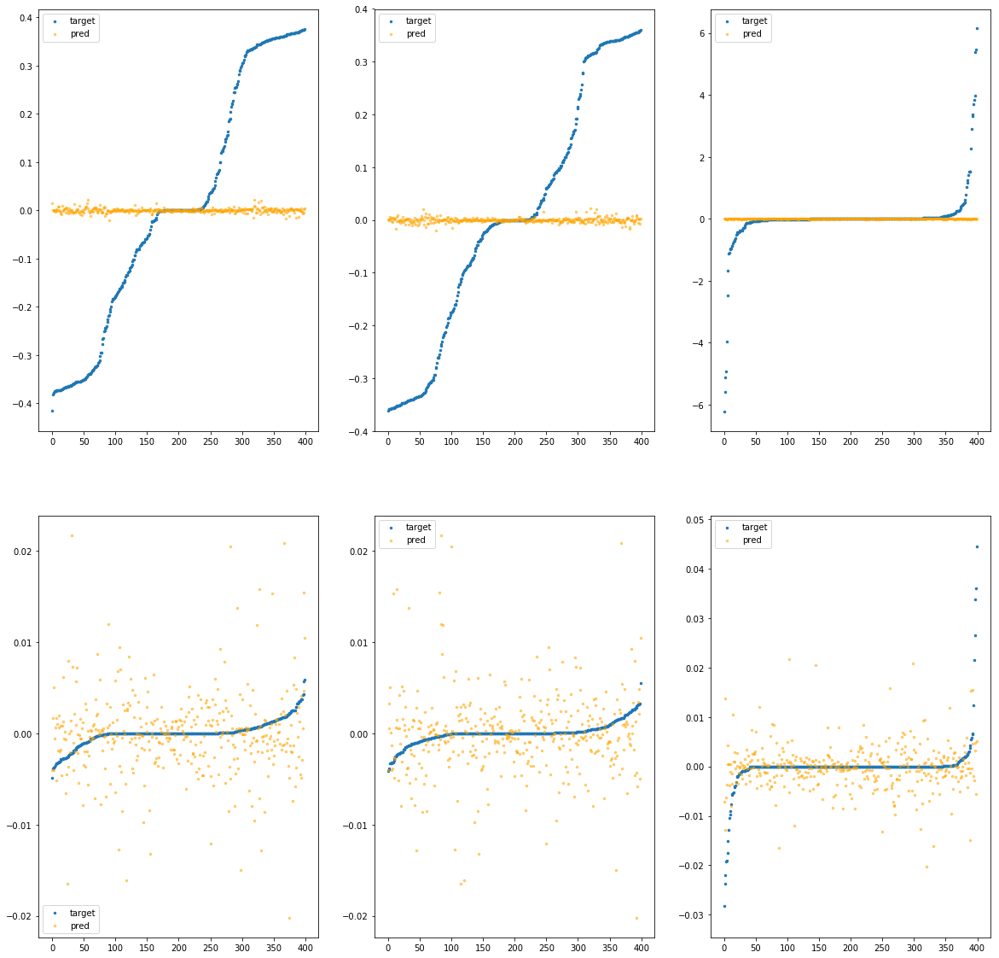

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bde7f0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.82e-03	4.15e-01	2.06e-01	1.77e+02	6.43e-02	4.13e-03
y		-1.34e-03	3.63e-01	1.88e-01	2.28e+01	5.49e-02	3.01e-03
z		-1.35e-03	6.24e+00	2.77e-01	2.61e+01	8.76e-01	7.67e-01
phi		-4.26e+00	1.29e-02	2.16e-03	6.99e+04	9.79e-06	9.59e-11
theta		-6.46e+00	1.43e-02	2.10e-03	2.91e+04	9.48e-06	8.98e-11
psi		-4.83e-01	5.04e-02	2.99e-03	5.04e+04	3.64e-05	1.32e-09


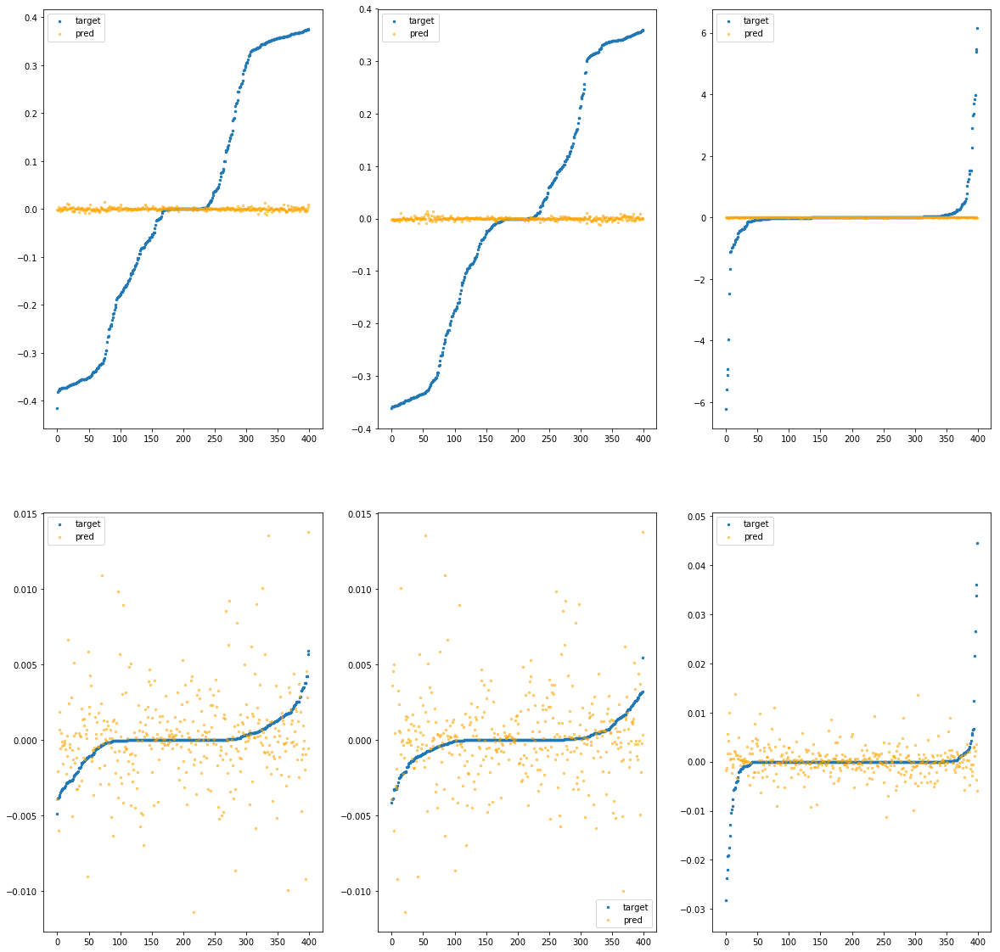

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bde850>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.05e-03	4.18e-01	2.06e-01	3.29e+02	6.42e-02	4.13e-03
y		-1.60e-03	3.65e-01	1.88e-01	5.58e+01	5.49e-02	3.02e-03
z		7.87e-04	6.20e+00	2.77e-01	4.94e+01	8.74e-01	7.64e-01
phi		-1.03e+01	2.93e-02	3.10e-03	1.36e+05	2.11e-05	4.44e-10
theta		-1.58e+01	2.94e-02	3.09e-03	3.11e+04	2.13e-05	4.53e-10
psi		-5.36e-01	4.05e-02	3.63e-03	5.07e+04	3.77e-05	1.42e-09


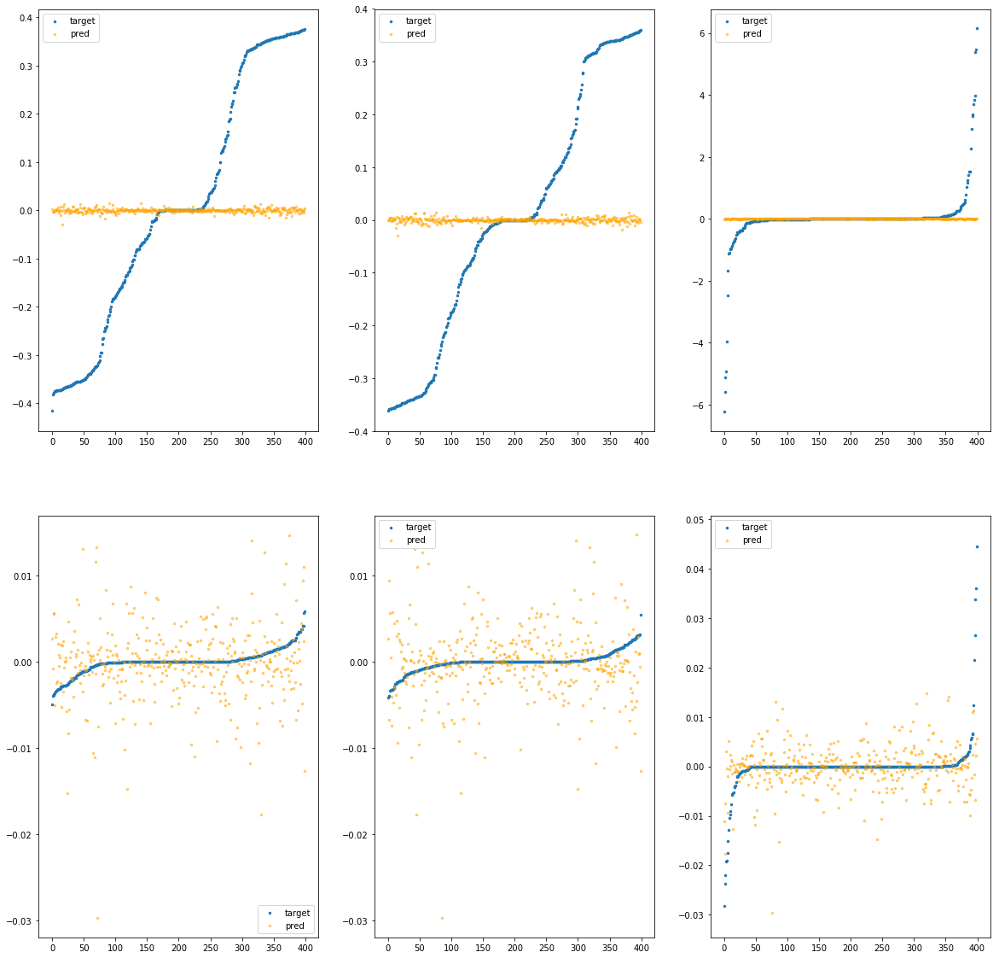

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bde8b0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.25e-03	4.16e-01	2.06e-01	2.12e+02	6.43e-02	4.13e-03
y		1.46e-03	3.66e-01	1.88e-01	2.99e+01	5.47e-02	3.00e-03
z		-2.88e-04	6.23e+00	2.77e-01	2.23e+01	8.75e-01	7.66e-01
phi		-5.82e+00	2.05e-02	2.34e-03	8.40e+04	1.27e-05	1.61e-10
theta		-8.47e+00	1.83e-02	2.30e-03	3.70e+04	1.20e-05	1.45e-10
psi		-2.42e-01	4.03e-02	2.90e-03	3.75e+04	3.05e-05	9.28e-10


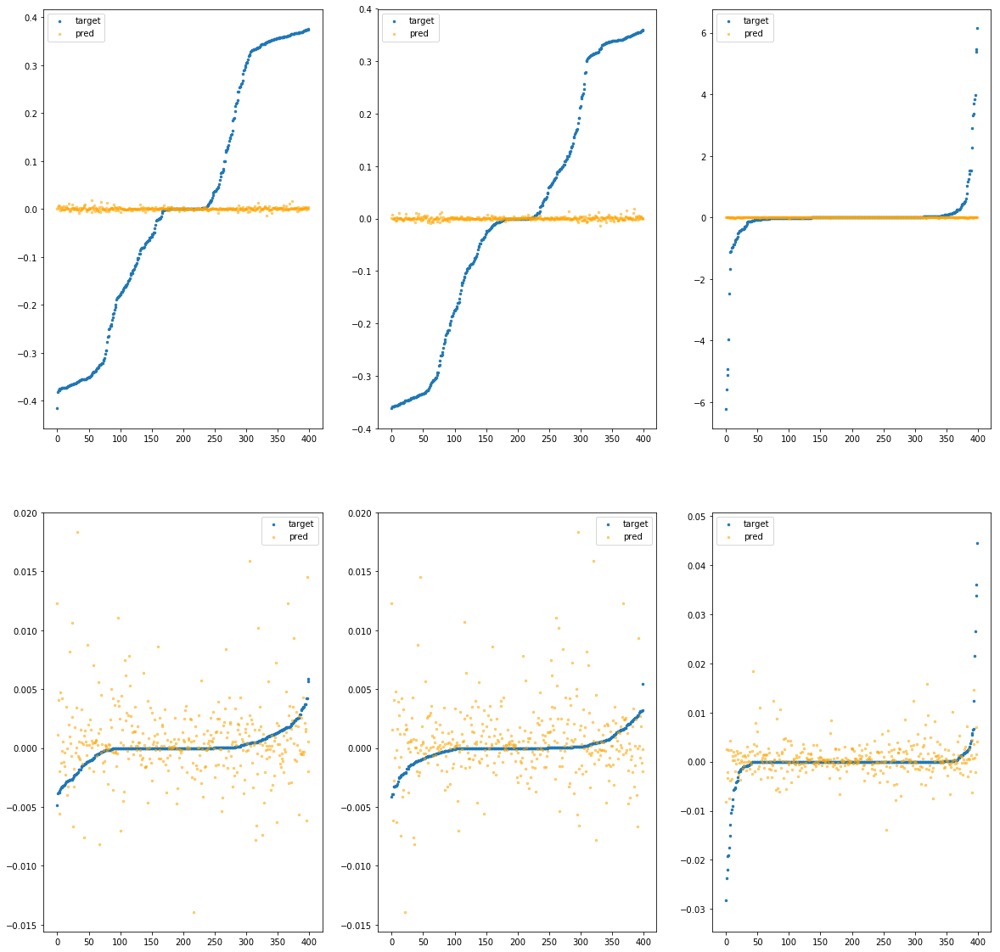

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bde910>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		2.10e-04	4.16e-01	2.05e-01	1.45e+02	6.41e-02	4.11e-03
y		-1.02e-03	3.67e-01	1.88e-01	1.61e+01	5.49e-02	3.01e-03
z		-2.49e-05	6.21e+00	2.78e-01	1.99e+01	8.75e-01	7.65e-01
phi		-6.21e+00	1.84e-02	2.41e-03	6.77e+04	1.34e-05	1.80e-10
theta		-9.12e+00	2.06e-02	2.35e-03	2.05e+04	1.28e-05	1.65e-10
psi		-6.31e-01	5.79e-02	3.09e-03	4.71e+04	4.00e-05	1.60e-09


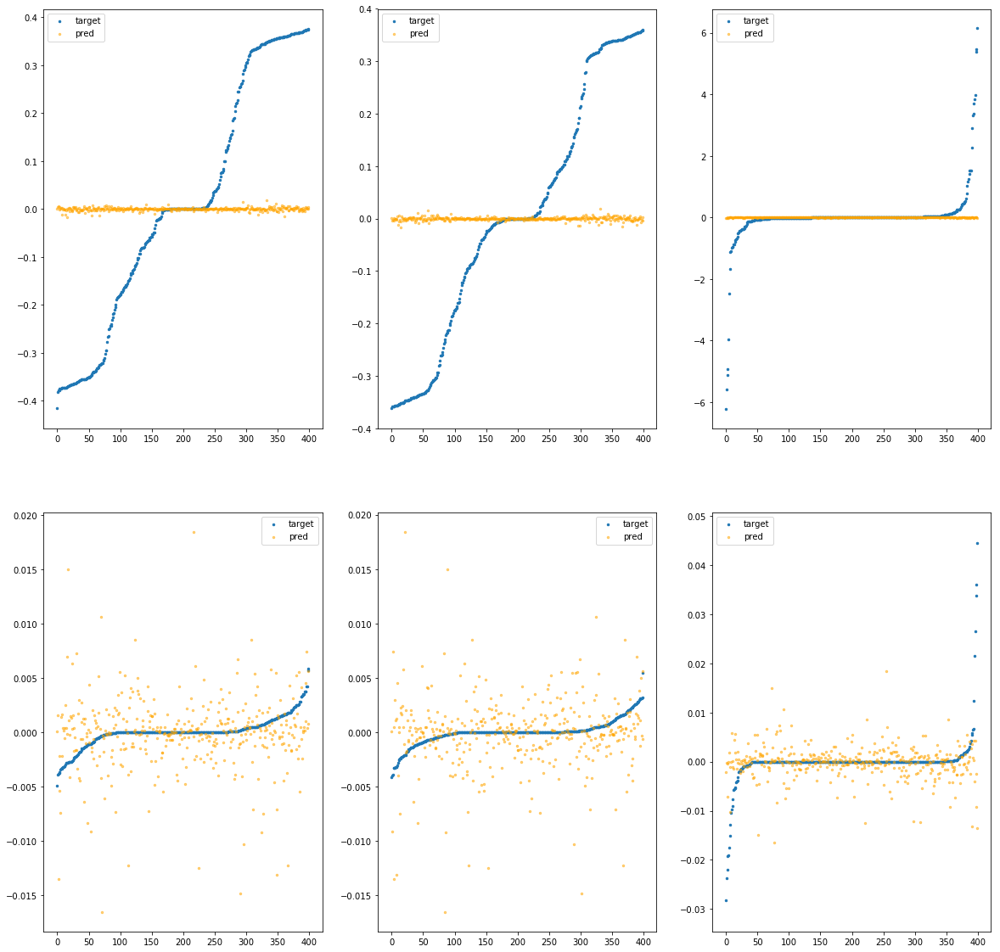

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bde970>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.65e-03	4.10e-01	2.06e-01	1.66e+02	6.44e-02	4.15e-03
y		-7.22e-04	3.63e-01	1.88e-01	3.28e+01	5.49e-02	3.01e-03
z		-1.41e-03	6.21e+00	2.78e-01	3.32e+01	8.76e-01	7.68e-01
phi		-8.80e+00	2.00e-02	2.83e-03	6.57e+04	1.82e-05	3.33e-10
theta		-1.28e+01	2.00e-02	2.80e-03	2.71e+04	1.75e-05	3.07e-10
psi		-6.53e-01	4.91e-02	3.51e-03	6.13e+04	4.06e-05	1.64e-09


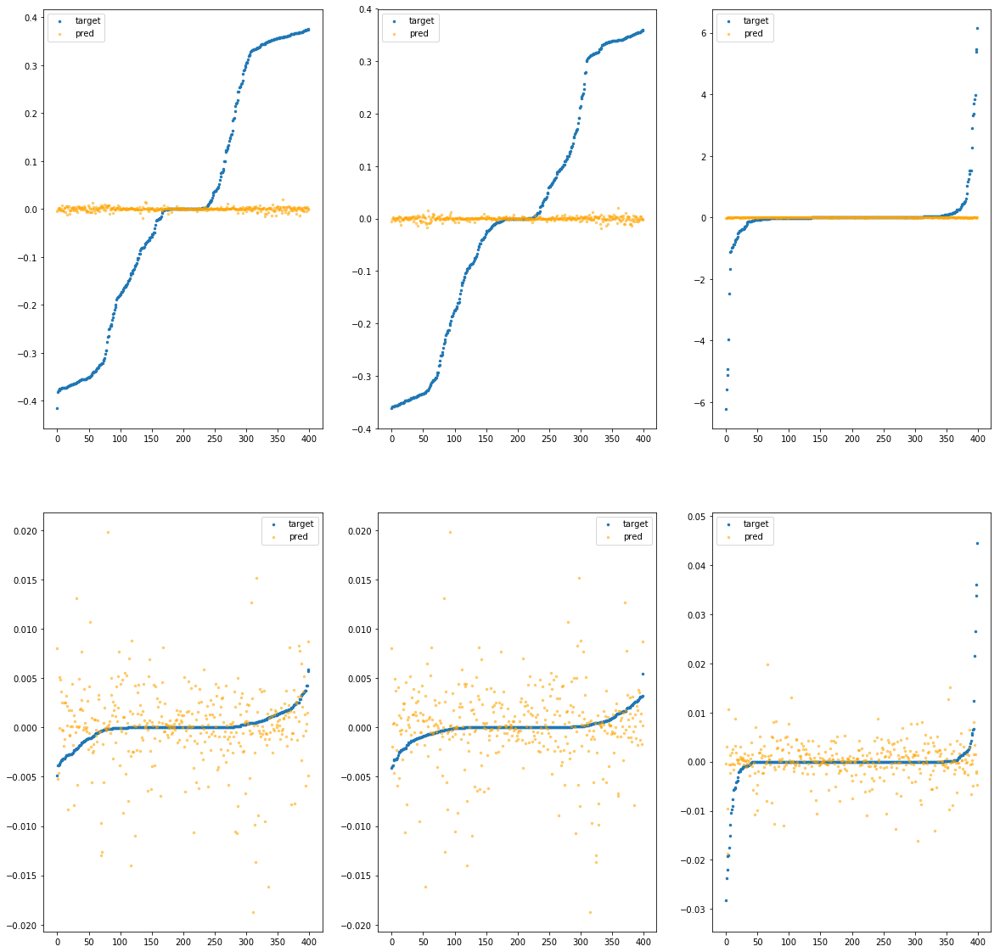

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bde9d0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.11e-04	4.18e-01	2.05e-01	2.70e+02	6.42e-02	4.12e-03
y		2.01e-04	3.61e-01	1.88e-01	3.66e+01	5.48e-02	3.00e-03
z		1.08e-03	6.21e+00	2.77e-01	4.75e+01	8.74e-01	7.64e-01
phi		-6.08e+00	1.77e-02	2.54e-03	1.25e+05	1.32e-05	1.74e-10
theta		-8.63e+00	1.65e-02	2.40e-03	3.57e+04	1.22e-05	1.49e-10
psi		-4.87e-01	5.99e-02	3.07e-03	3.99e+04	3.65e-05	1.33e-09


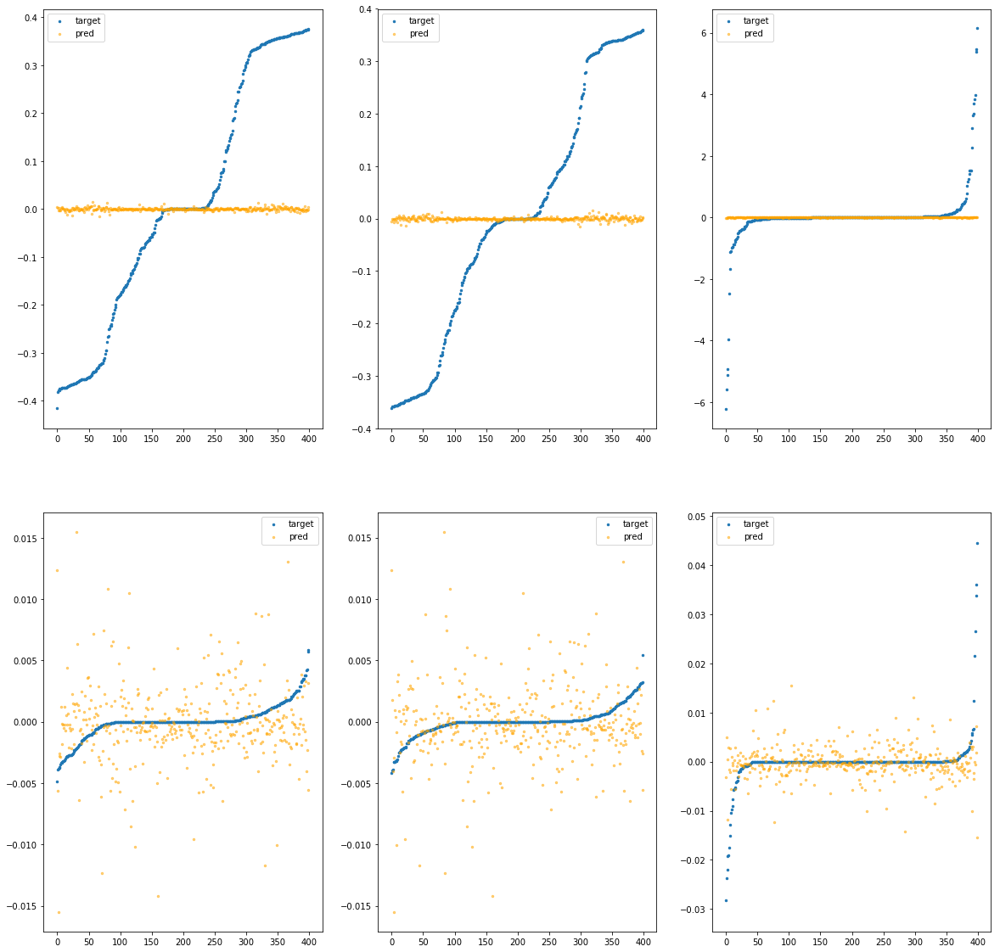

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bdea30>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-7.77e-03	4.35e-01	2.06e-01	2.67e+02	6.46e-02	4.17e-03
y		-3.77e-03	3.68e-01	1.88e-01	7.11e+01	5.50e-02	3.03e-03
z		-7.27e-04	6.24e+00	2.77e-01	2.94e+01	8.75e-01	7.66e-01
phi		-1.14e+01	2.27e-02	3.28e-03	1.15e+05	2.31e-05	5.33e-10
theta		-1.76e+01	2.58e-02	3.22e-03	7.00e+04	2.36e-05	5.58e-10
psi		-7.80e-01	4.46e-02	3.79e-03	8.11e+04	4.37e-05	1.91e-09


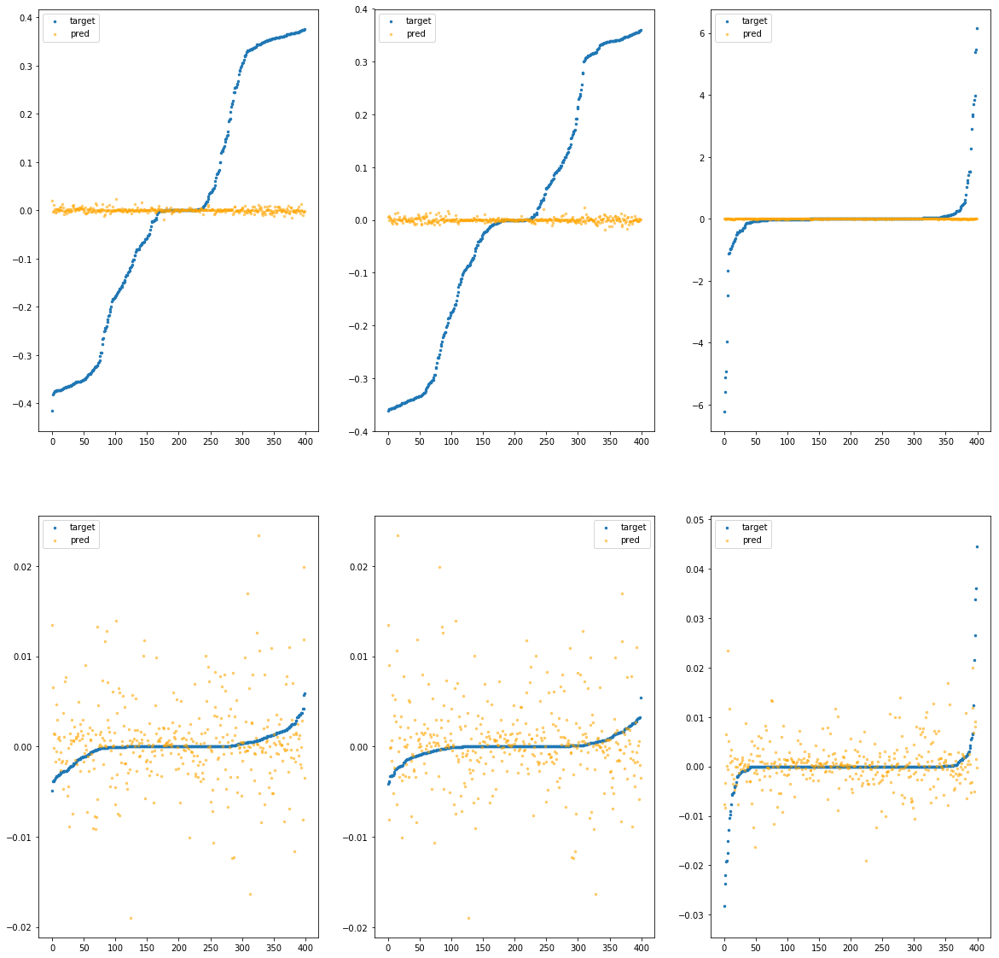

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bdea90>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.62e-03	4.13e-01	2.06e-01	3.49e+02	6.43e-02	4.13e-03
y		3.17e-04	3.68e-01	1.88e-01	8.67e+01	5.48e-02	3.00e-03
z		-6.91e-04	6.22e+00	2.78e-01	4.02e+01	8.75e-01	7.66e-01
phi		-7.86e+00	1.79e-02	2.78e-03	1.37e+05	1.65e-05	2.72e-10
theta		-1.27e+01	2.23e-02	2.81e-03	4.54e+04	1.74e-05	3.03e-10
psi		-6.32e-01	5.08e-02	3.56e-03	3.13e+04	4.00e-05	1.60e-09


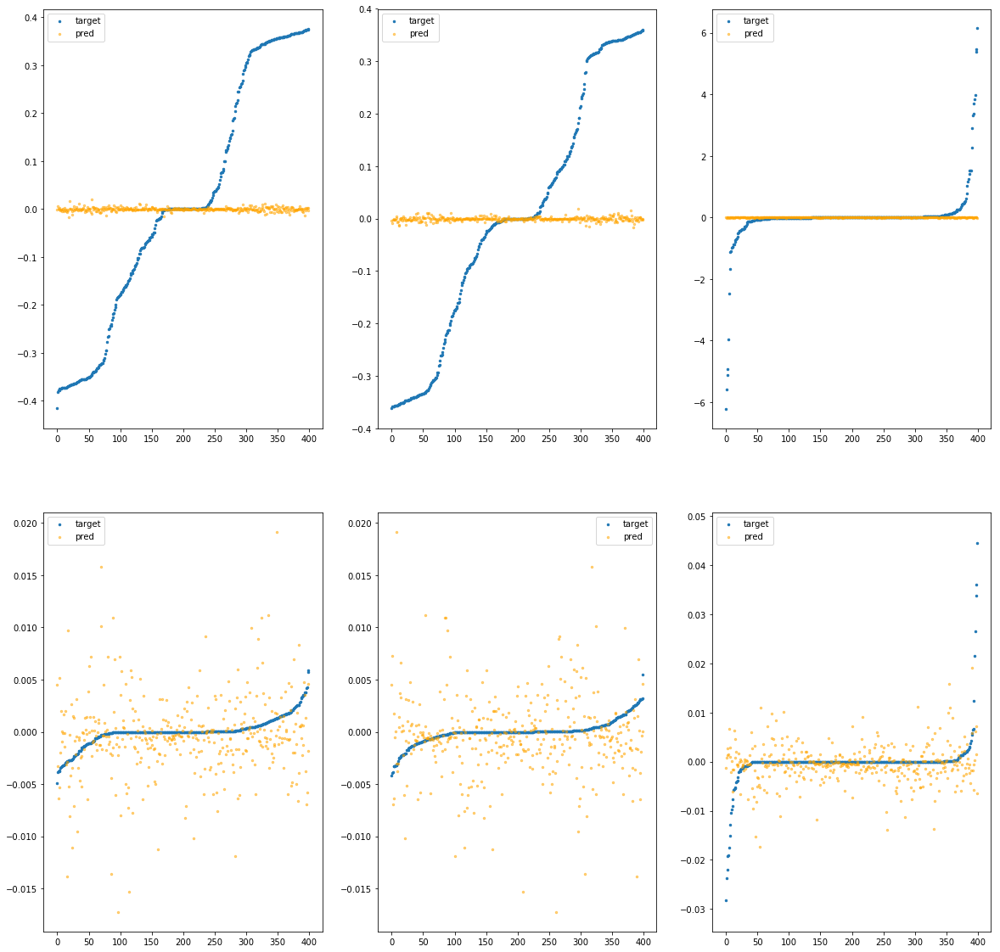

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bdeaf0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.04e-03	4.23e-01	2.05e-01	5.46e+02	6.40e-02	4.10e-03
y		-3.21e-03	3.68e-01	1.88e-01	7.54e+01	5.50e-02	3.02e-03
z		1.10e-03	6.24e+00	2.78e-01	4.32e+01	8.74e-01	7.64e-01
phi		-1.43e+01	2.39e-02	3.66e-03	1.95e+05	2.84e-05	8.08e-10
theta		-2.01e+01	2.41e-02	3.48e-03	5.52e+04	2.67e-05	7.15e-10
psi		-1.07e+00	4.69e-02	4.11e-03	8.87e+04	5.09e-05	2.59e-09


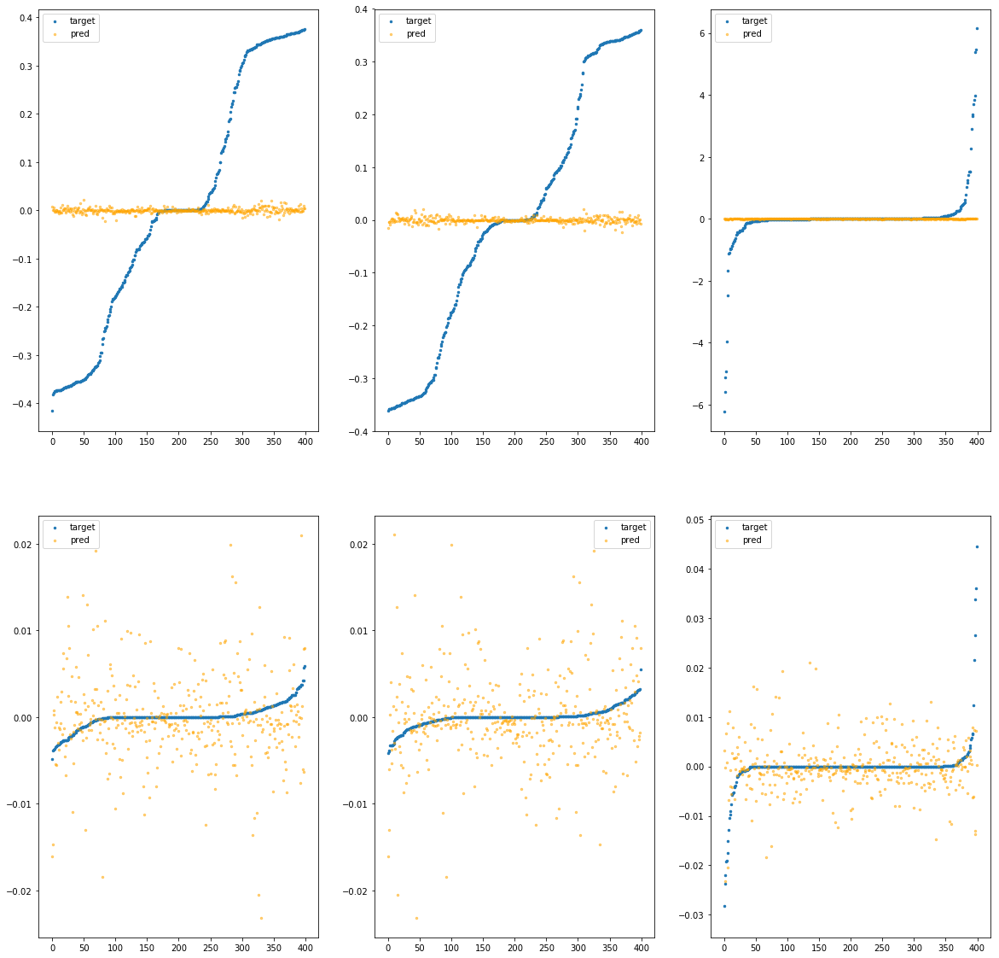

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bdeb50>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.83e-03	4.24e-01	2.06e-01	3.55e+02	6.44e-02	4.14e-03
y		-3.79e-03	3.67e-01	1.88e-01	6.20e+01	5.50e-02	3.03e-03
z		-1.16e-03	6.23e+00	2.77e-01	3.56e+01	8.76e-01	7.67e-01
phi		-7.07e+00	2.57e-02	2.47e-03	1.36e+05	1.50e-05	2.26e-10
theta		-1.01e+01	2.76e-02	2.35e-03	7.90e+04	1.41e-05	1.98e-10
psi		-4.80e-01	4.85e-02	3.00e-03	4.61e+04	3.63e-05	1.32e-09


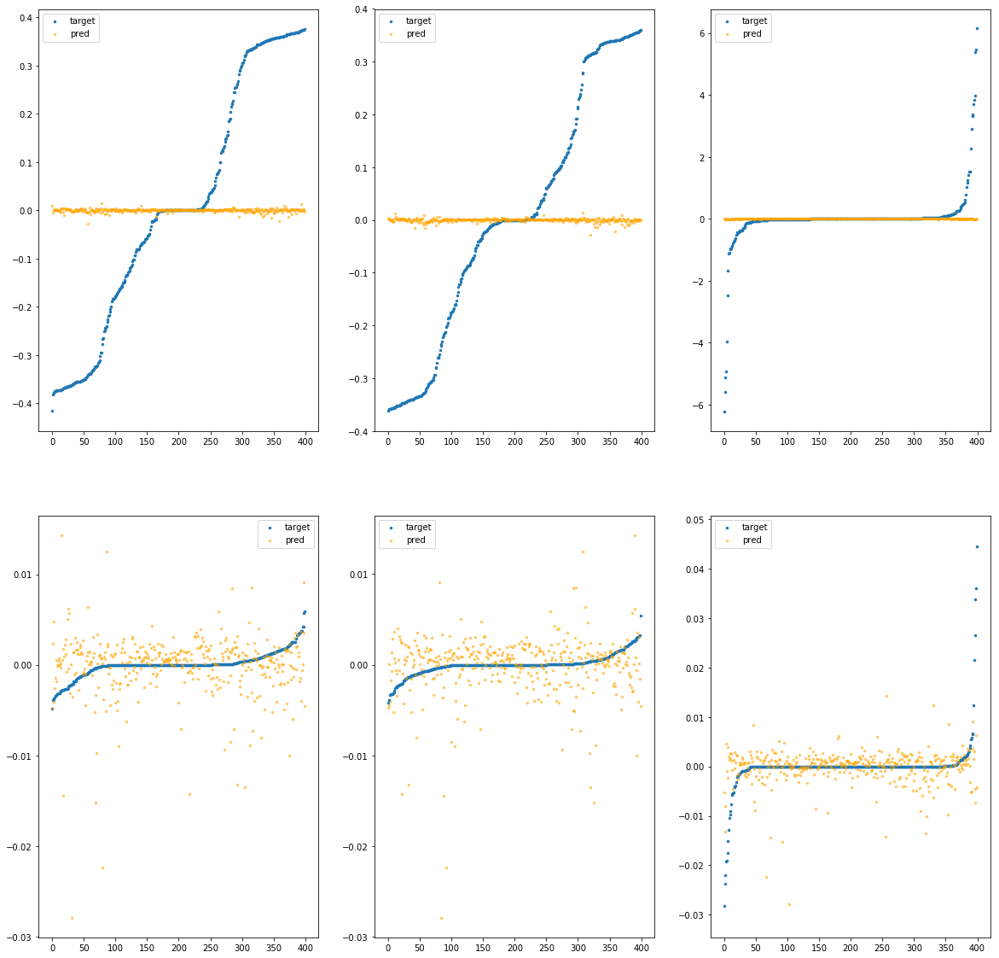

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bdebb0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.94e-03	4.01e-01	2.06e-01	2.83e+02	6.43e-02	4.13e-03
y		8.22e-04	3.63e-01	1.88e-01	4.18e+01	5.48e-02	3.00e-03
z		-1.93e-03	6.24e+00	2.77e-01	3.43e+01	8.77e-01	7.68e-01
phi		-7.80e+00	2.05e-02	2.65e-03	8.97e+04	1.64e-05	2.68e-10
theta		-1.17e+01	2.05e-02	2.63e-03	2.66e+04	1.61e-05	2.58e-10
psi		-7.75e-01	4.35e-02	3.26e-03	3.66e+04	4.35e-05	1.90e-09


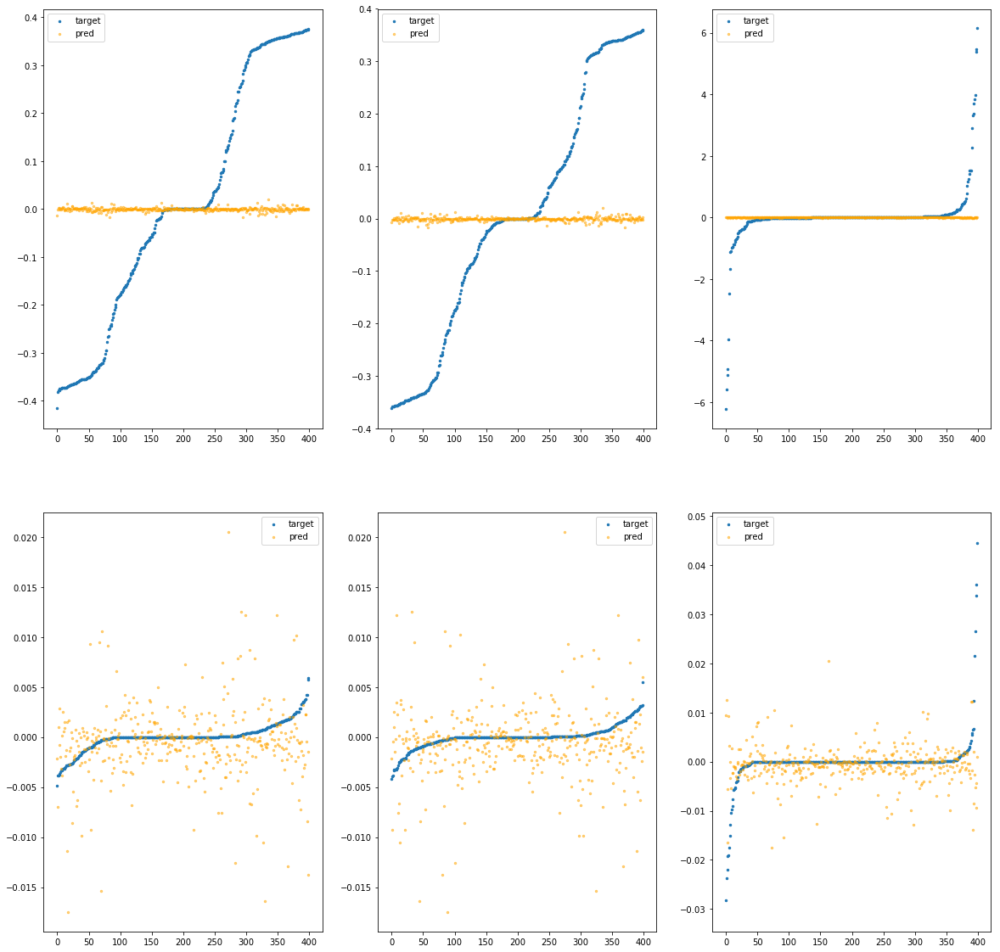

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bdec10>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.28e-03	4.15e-01	2.06e-01	3.98e+02	6.43e-02	4.13e-03
y		3.97e-03	3.65e-01	1.87e-01	7.24e+01	5.46e-02	2.98e-03
z		-1.59e-03	6.22e+00	2.78e-01	3.42e+01	8.76e-01	7.68e-01
phi		-6.43e+00	2.16e-02	2.53e-03	1.60e+05	1.38e-05	1.91e-10
theta		-9.83e+00	2.16e-02	2.54e-03	6.53e+04	1.38e-05	1.89e-10
psi		-4.67e-01	4.15e-02	3.26e-03	3.75e+04	3.60e-05	1.30e-09


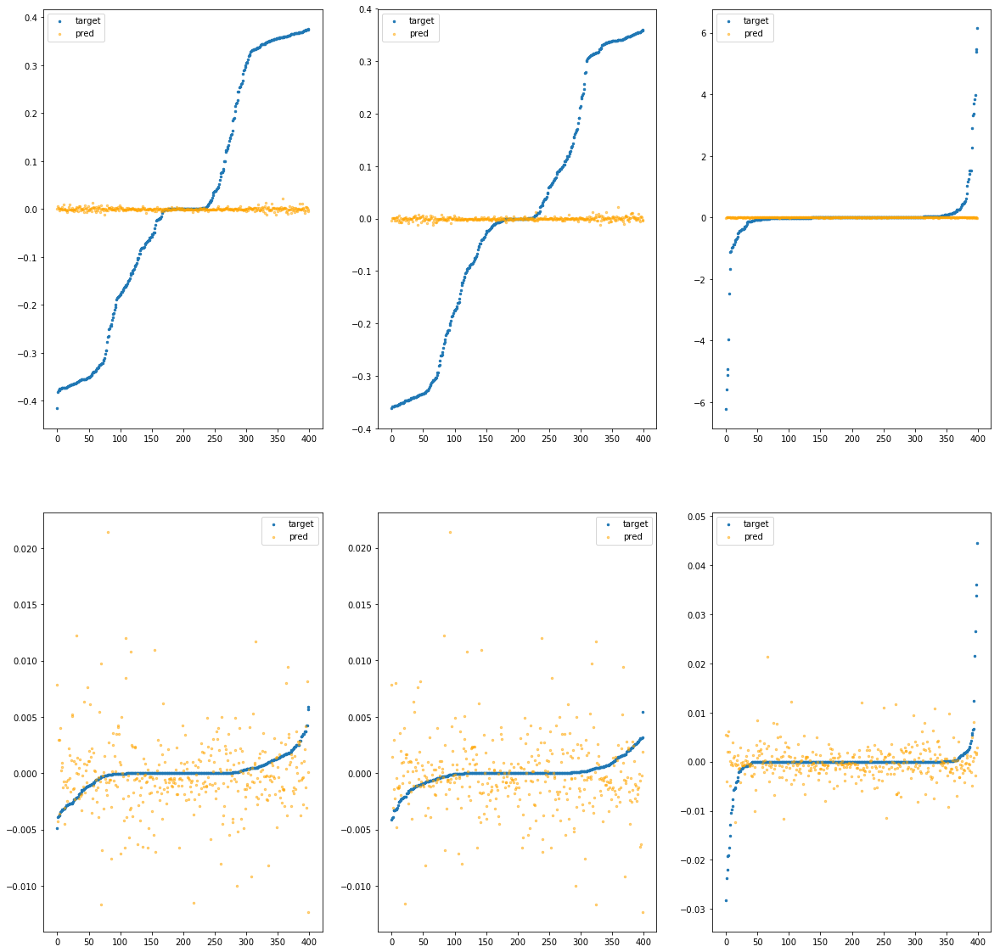

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bdec70>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.65e-03	4.11e-01	2.06e-01	2.74e+02	6.42e-02	4.12e-03
y		-3.11e-03	3.72e-01	1.88e-01	3.66e+01	5.50e-02	3.02e-03
z		-1.25e-03	6.25e+00	2.78e-01	2.99e+01	8.76e-01	7.67e-01
phi		-9.37e+00	2.45e-02	2.94e-03	1.08e+05	1.93e-05	3.73e-10
theta		-1.45e+01	2.00e-02	2.93e-03	4.51e+04	1.96e-05	3.86e-10
psi		-9.83e-01	6.07e-02	3.62e-03	4.04e+04	4.87e-05	2.37e-09


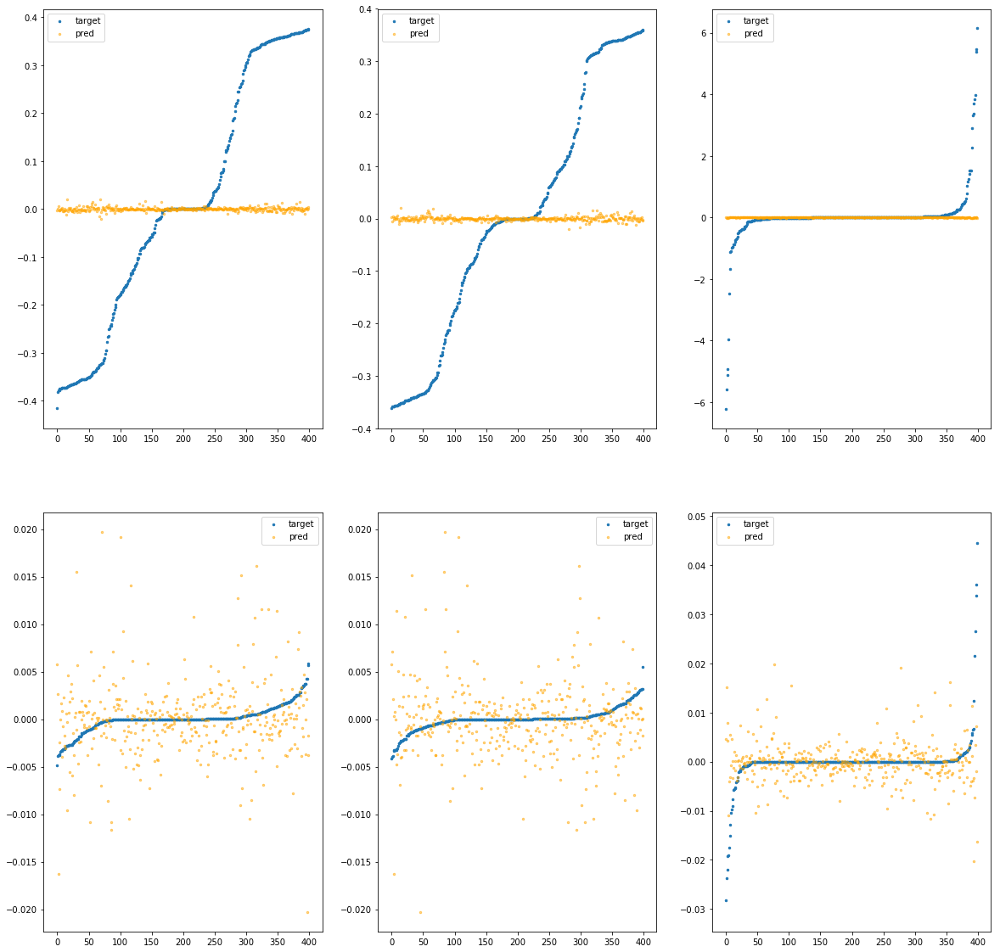

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adagrad.Adagrad object at 0x7fba51bdecd0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.35e-04	4.08e-01	2.06e-01	3.85e+02	6.42e-02	4.12e-03
y		-1.84e-03	3.65e-01	1.88e-01	8.26e+01	5.49e-02	3.02e-03
z		-8.58e-04	6.21e+00	2.77e-01	4.39e+01	8.76e-01	7.67e-01
phi		-9.49e+00	3.19e-02	3.03e-03	1.58e+05	1.95e-05	3.82e-10
theta		-1.50e+01	3.25e-02	3.03e-03	6.74e+04	2.04e-05	4.14e-10
psi		-6.09e-01	4.10e-02	3.65e-03	7.10e+04	3.95e-05	1.56e-09


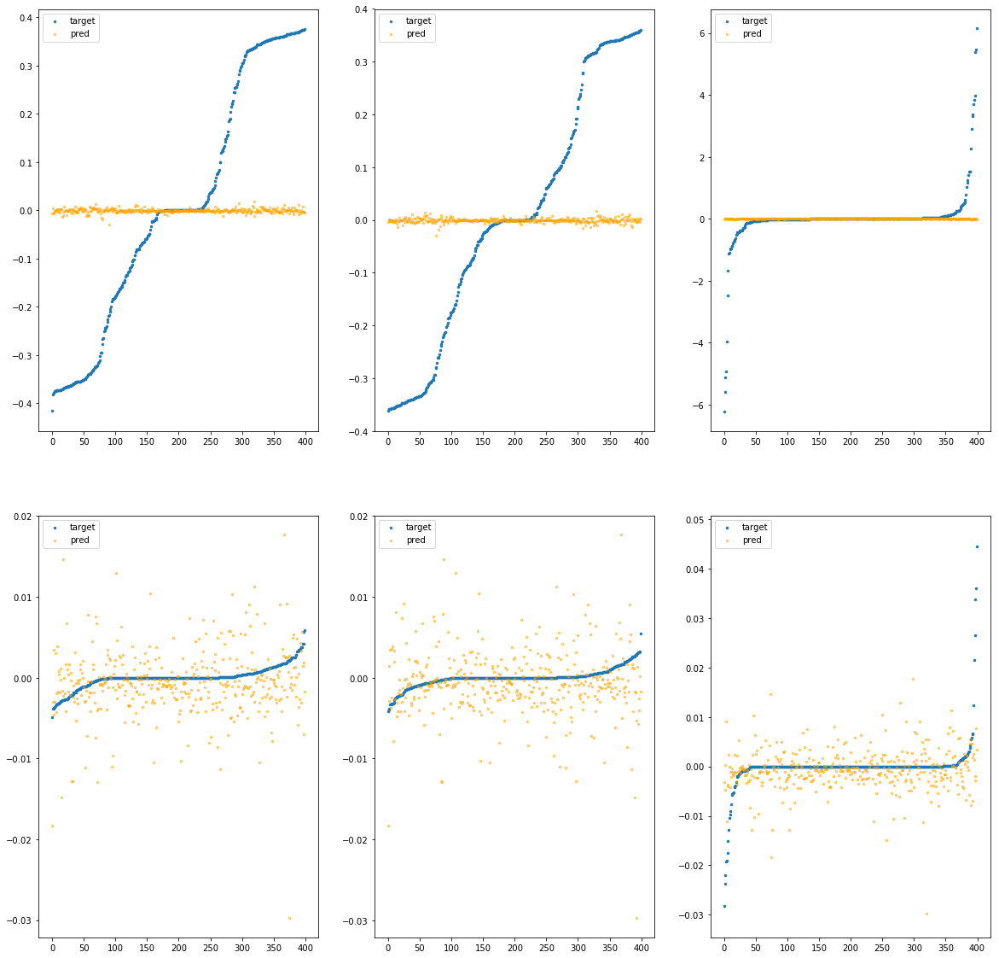

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bded30>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.72e-03	4.12e-01	2.06e-01	1.08e+03	6.43e-02	4.13e-03
y		4.41e-04	3.68e-01	1.88e-01	1.54e+02	5.48e-02	3.00e-03
z		-1.21e-03	6.23e+00	2.77e-01	7.31e+01	8.76e-01	7.67e-01
phi		-8.12e+00	3.20e-02	2.61e-03	3.98e+05	1.70e-05	2.88e-10
theta		-1.16e+01	3.15e-02	2.52e-03	1.39e+05	1.60e-05	2.56e-10
psi		-3.49e-01	4.26e-02	3.06e-03	5.18e+04	3.31e-05	1.10e-09


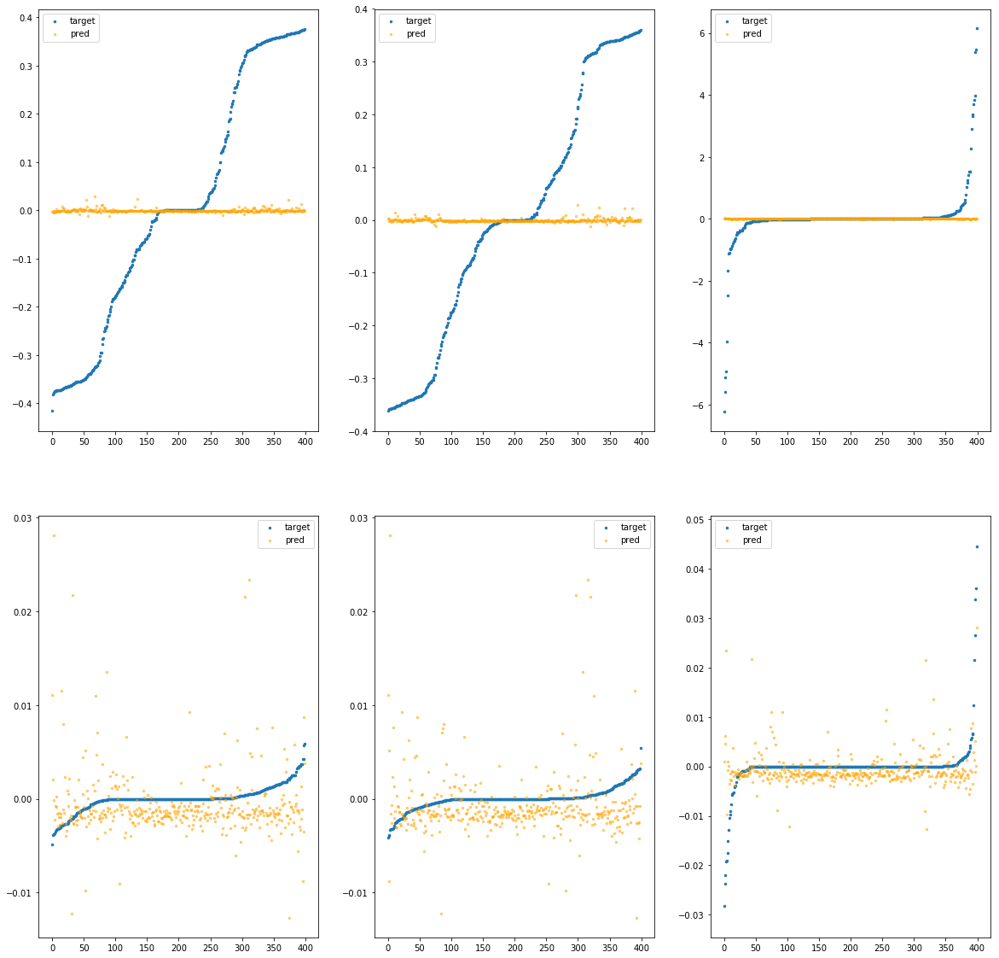

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bded90>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.65e-03	4.05e-01	2.06e-01	6.09e+02	6.43e-02	4.13e-03
y		-5.68e-05	3.61e-01	1.88e-01	7.09e+01	5.48e-02	3.01e-03
z		-2.59e-03	6.23e+00	2.77e-01	3.70e+01	8.77e-01	7.69e-01
phi		-5.74e+00	2.81e-02	2.17e-03	2.19e+05	1.25e-05	1.57e-10
theta		-7.97e+00	2.76e-02	2.08e-03	7.42e+04	1.14e-05	1.30e-10
psi		-2.17e-01	3.74e-02	2.66e-03	3.40e+04	2.99e-05	8.92e-10


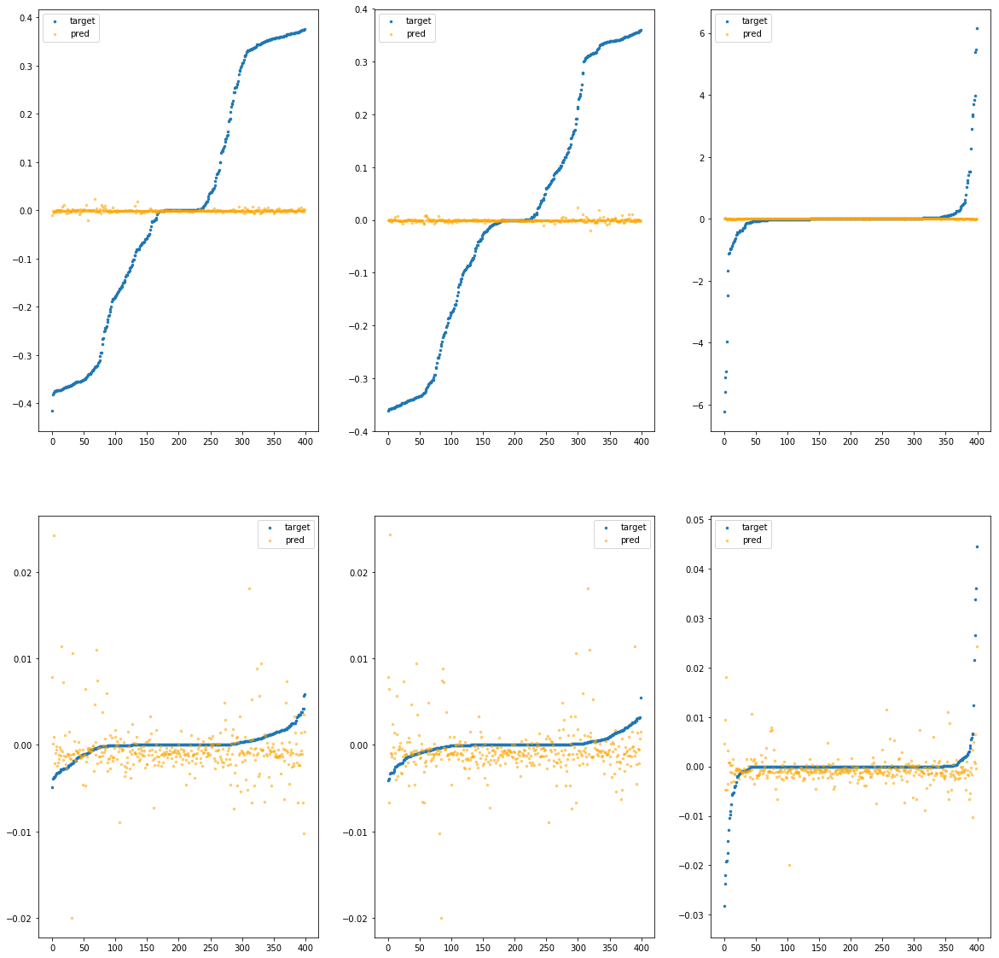

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bdedf0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.60e-03	4.05e-01	2.05e-01	2.71e+02	6.42e-02	4.12e-03
y		-9.95e-04	3.68e-01	1.88e-01	3.53e+01	5.49e-02	3.01e-03
z		-1.75e-03	6.22e+00	2.77e-01	1.76e+01	8.76e-01	7.68e-01
phi		-6.02e+00	2.24e-02	2.06e-03	9.43e+04	1.31e-05	1.71e-10
theta		-7.79e+00	2.24e-02	1.91e-03	3.11e+04	1.12e-05	1.25e-10
psi		-3.69e-01	4.32e-02	2.58e-03	2.42e+04	3.36e-05	1.13e-09


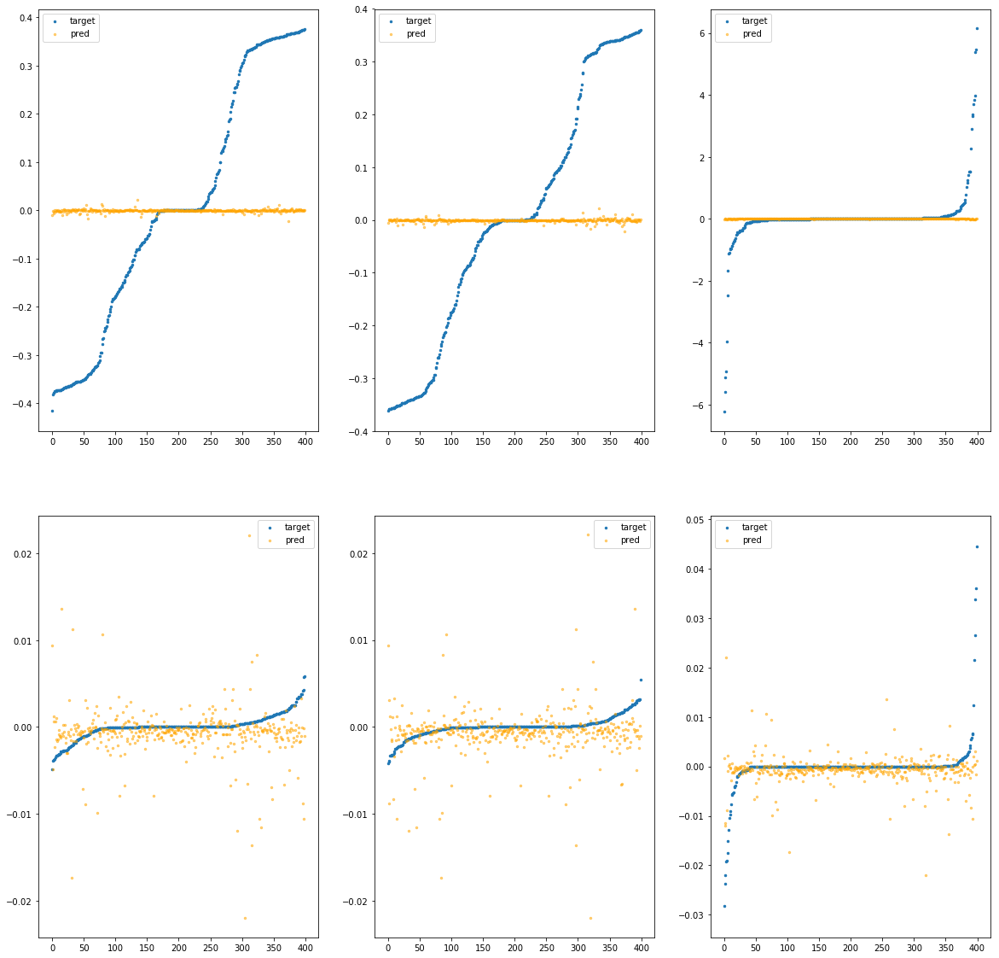

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bdee50>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.43e-04	4.10e-01	2.05e-01	4.19e+02	6.42e-02	4.12e-03
y		1.33e-03	3.62e-01	1.88e-01	6.53e+01	5.47e-02	3.00e-03
z		-9.24e-05	6.24e+00	2.77e-01	3.96e+01	8.75e-01	7.66e-01
phi		-6.79e+00	1.89e-02	2.37e-03	1.50e+05	1.45e-05	2.10e-10
theta		-9.83e+00	2.10e-02	2.27e-03	6.69e+04	1.38e-05	1.89e-10
psi		-5.49e-01	4.11e-02	2.95e-03	2.98e+04	3.80e-05	1.44e-09


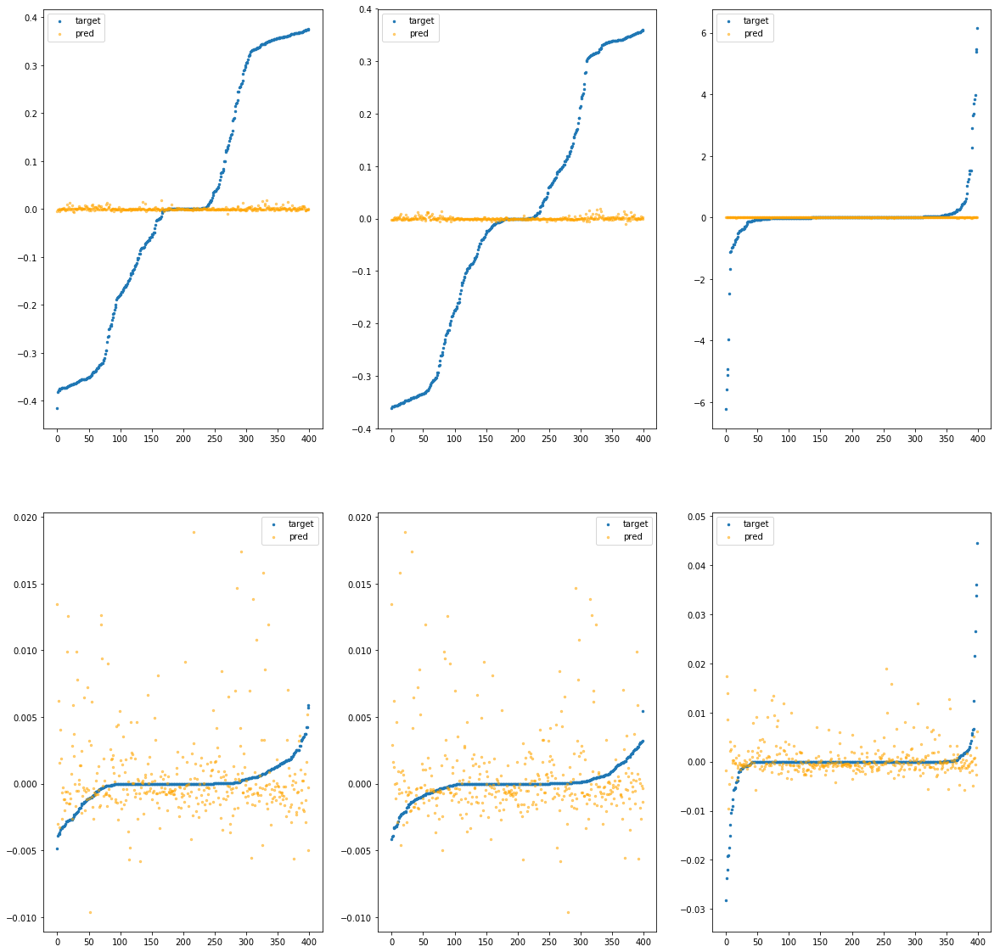

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bdeeb0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.22e-03	4.04e-01	2.05e-01	1.33e+02	6.42e-02	4.12e-03
y		-6.46e-04	3.64e-01	1.88e-01	1.90e+01	5.49e-02	3.01e-03
z		-1.16e-03	6.23e+00	2.77e-01	1.14e+01	8.76e-01	7.67e-01
phi		-4.49e+00	1.73e-02	1.82e-03	4.64e+04	1.02e-05	1.04e-10
theta		-5.55e+00	1.94e-02	1.63e-03	9.56e+03	8.32e-06	6.92e-11
psi		-4.08e-01	5.39e-02	2.43e-03	2.11e+04	3.45e-05	1.19e-09


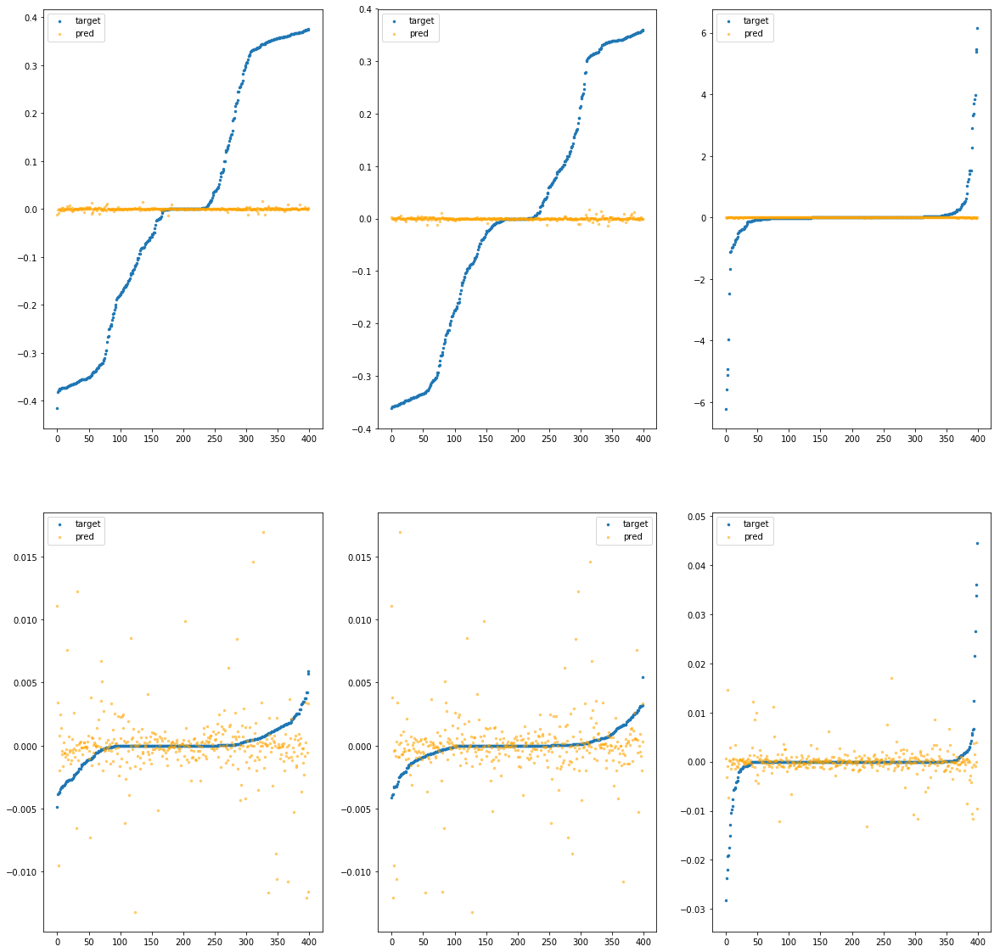

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bdef10>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.97e-03	4.01e-01	2.07e-01	5.23e+03	6.44e-02	4.15e-03
y		-5.33e-03	3.69e-01	1.89e-01	6.85e+02	5.51e-02	3.04e-03
z		-3.15e-03	6.22e+00	2.80e-01	3.55e+02	8.78e-01	7.70e-01
phi		-4.22e+01	2.52e-02	8.48e-03	1.98e+06	8.05e-05	6.48e-09
theta		-6.10e+01	2.71e-02	8.45e-03	6.93e+05	7.87e-05	6.19e-09
psi		-3.05e+00	4.75e-02	8.85e-03	2.40e+05	9.94e-05	9.88e-09


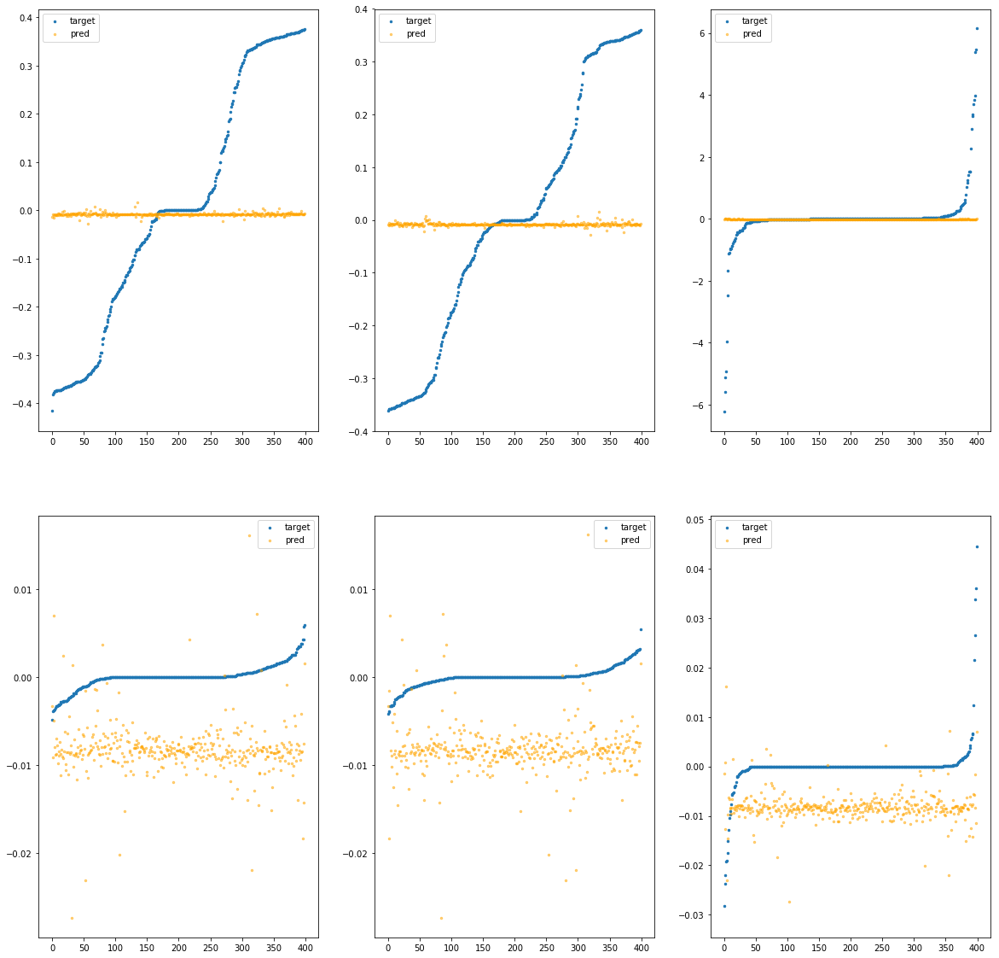

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bdef70>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.14e-03	3.95e-01	2.06e-01	1.51e+03	6.43e-02	4.14e-03
y		-3.19e-03	3.71e-01	1.88e-01	2.05e+02	5.50e-02	3.02e-03
z		-4.04e-03	6.22e+00	2.78e-01	1.08e+02	8.78e-01	7.72e-01
phi		-1.57e+01	2.91e-02	4.01e-03	5.66e+05	3.10e-05	9.63e-10
theta		-2.16e+01	3.10e-02	3.95e-03	2.04e+05	2.87e-05	8.24e-10
psi		-9.15e-01	4.19e-02	4.39e-03	8.66e+04	4.70e-05	2.21e-09


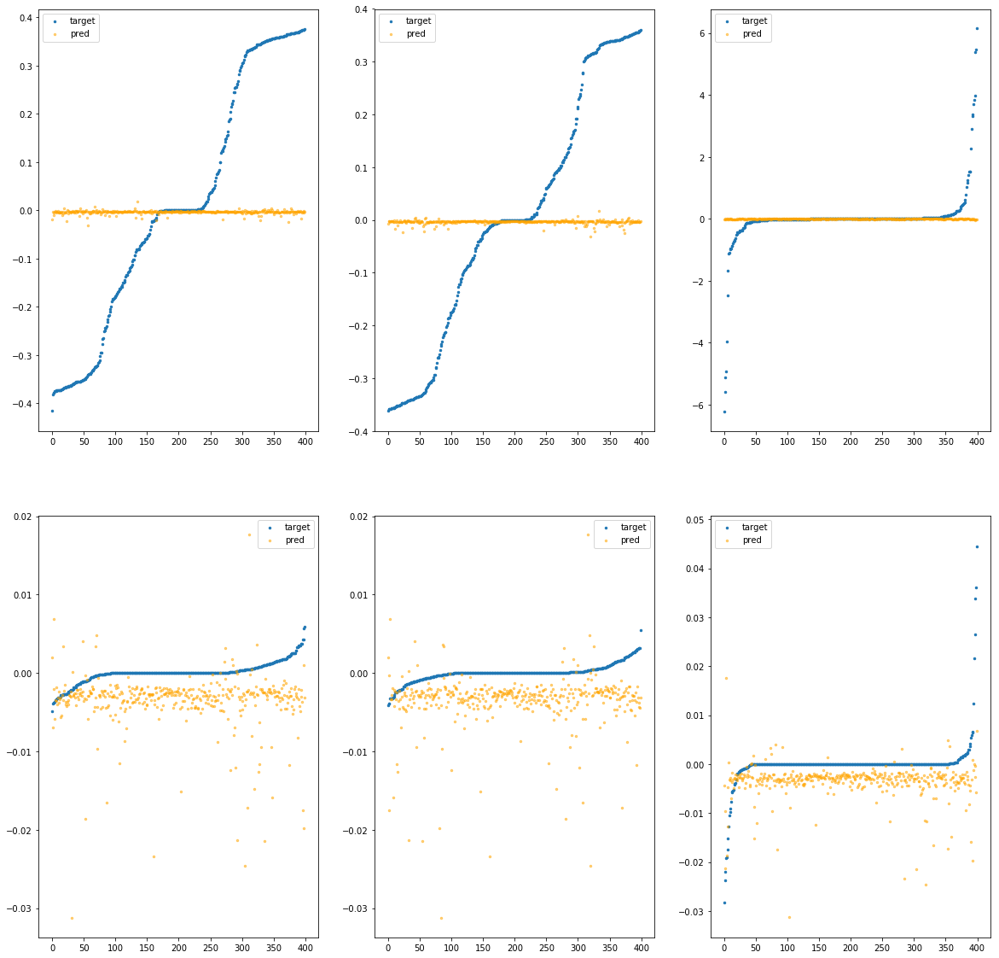

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51bdefd0>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.04e-04	4.08e-01	2.05e-01	1.80e+02	6.41e-02	4.11e-03
y		-1.53e-03	3.61e-01	1.88e-01	2.35e+01	5.49e-02	3.01e-03
z		-1.44e-03	6.21e+00	2.77e-01	1.25e+01	8.76e-01	7.68e-01
phi		-6.77e+00	4.02e-02	2.05e-03	6.27e+04	1.45e-05	2.09e-10
theta		-9.25e+00	4.20e-02	1.89e-03	1.27e+04	1.30e-05	1.69e-10
psi		-3.77e-01	4.23e-02	2.50e-03	2.19e+04	3.38e-05	1.14e-09


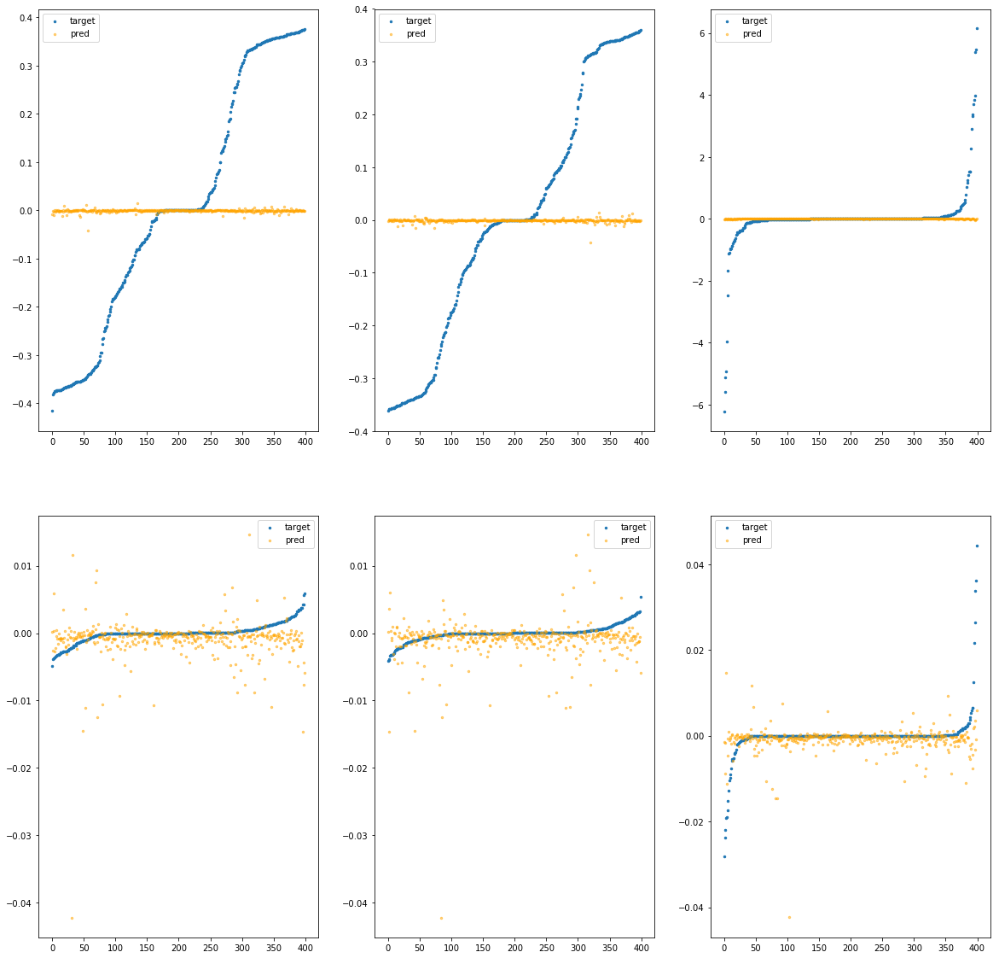

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51be8070>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.07e-03	4.19e-01	2.06e-01	1.65e+02	6.42e-02	4.13e-03
y		-1.96e-03	3.66e-01	1.88e-01	2.69e+01	5.49e-02	3.02e-03
z		-1.46e-03	6.24e+00	2.77e-01	1.54e+01	8.76e-01	7.68e-01
phi		-4.26e+00	1.72e-02	1.92e-03	7.16e+04	9.79e-06	9.58e-11
theta		-6.56e+00	1.65e-02	1.86e-03	2.50e+04	9.60e-06	9.22e-11
psi		-2.78e-01	3.59e-02	2.50e-03	2.21e+04	3.14e-05	9.83e-10


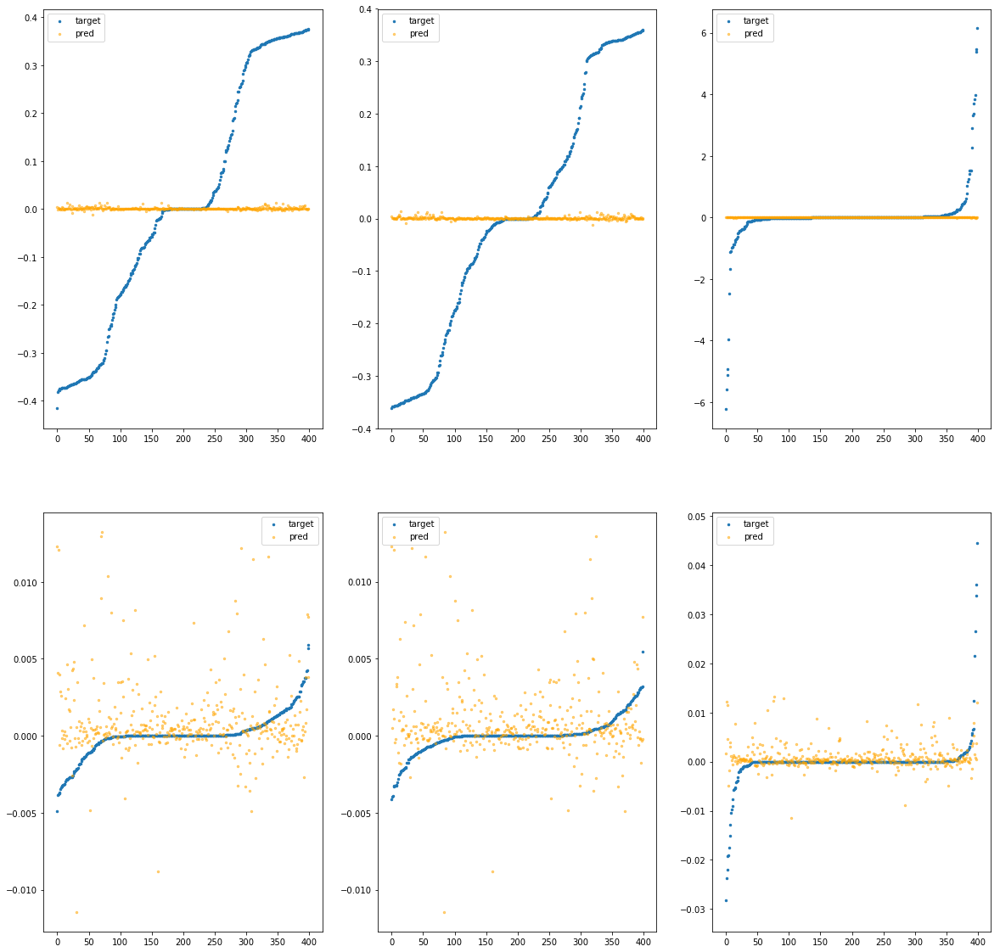

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51be80d0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		3.37e-04	4.01e-01	2.05e-01	2.77e+02	6.41e-02	4.11e-03
y		-2.21e-03	3.64e-01	1.88e-01	3.26e+01	5.49e-02	3.02e-03
z		-2.10e-03	6.22e+00	2.77e-01	1.91e+01	8.77e-01	7.69e-01
phi		-6.57e+00	3.18e-02	2.12e-03	9.67e+04	1.41e-05	1.99e-10
theta		-9.28e+00	3.37e-02	1.97e-03	2.55e+04	1.31e-05	1.70e-10
psi		-4.88e-01	4.41e-02	2.66e-03	2.65e+04	3.65e-05	1.33e-09


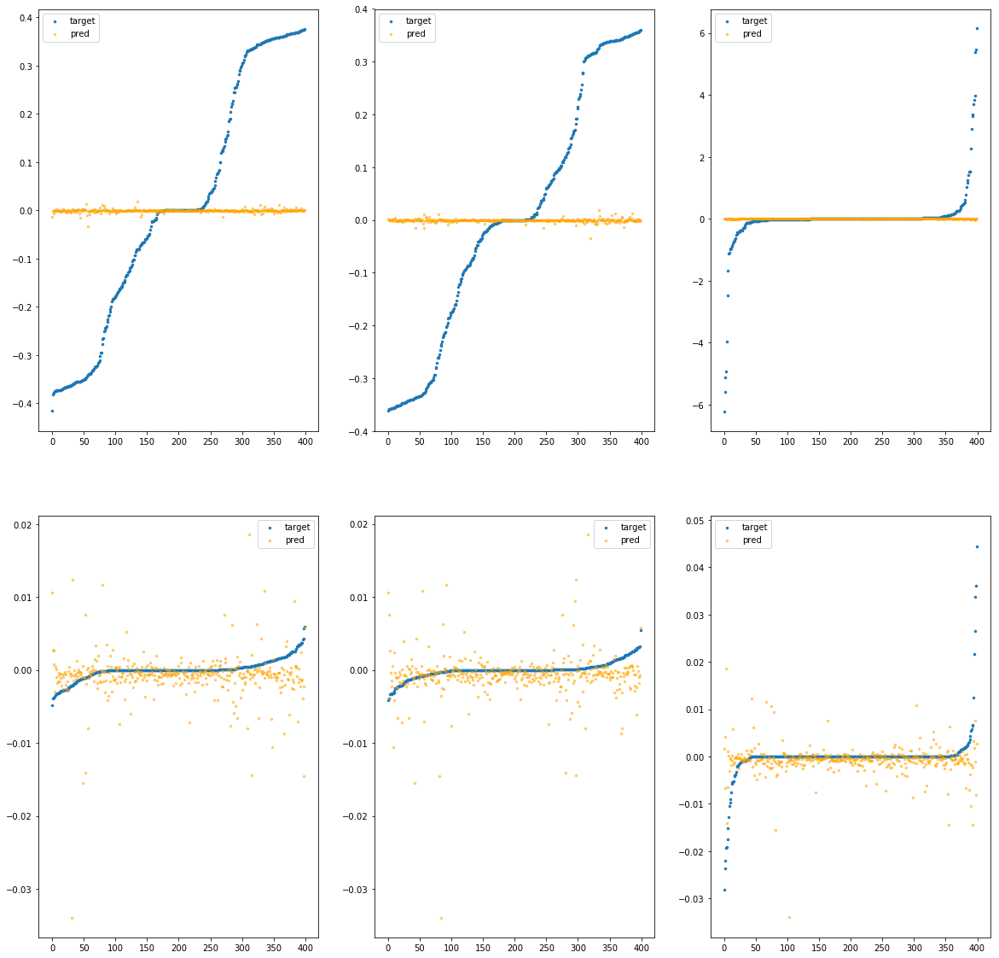

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51be8130>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.21e-03	3.99e-01	2.06e-01	7.64e+02	6.43e-02	4.13e-03
y		-1.73e-03	3.62e-01	1.88e-01	9.34e+01	5.49e-02	3.02e-03
z		-2.43e-03	6.22e+00	2.78e-01	4.83e+01	8.77e-01	7.69e-01
phi		-8.71e+00	2.18e-02	2.75e-03	2.77e+05	1.81e-05	3.27e-10
theta		-1.18e+01	2.12e-02	2.62e-03	9.49e+04	1.62e-05	2.63e-10
psi		-3.84e-01	3.93e-02	3.22e-03	4.98e+04	3.39e-05	1.15e-09


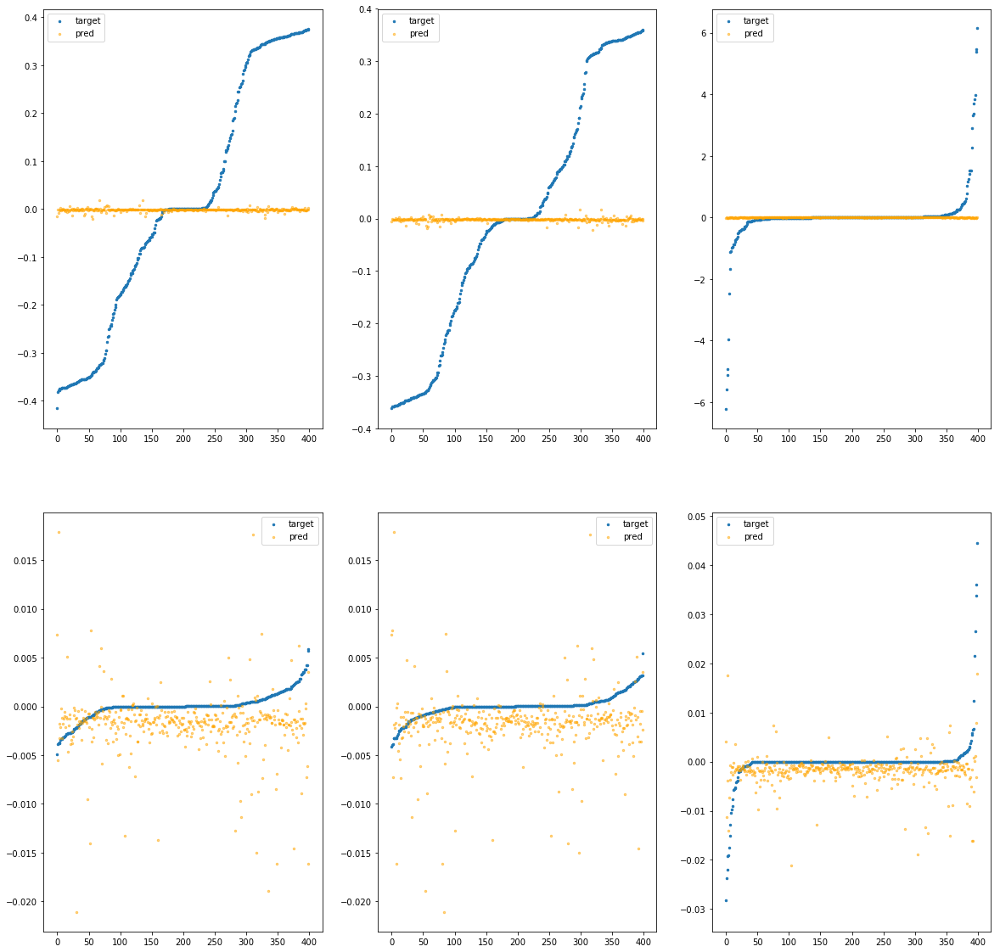

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51be8190>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-6.96e-04	4.08e-01	2.06e-01	1.49e+03	6.42e-02	4.12e-03
y		-9.04e-04	3.64e-01	1.88e-01	2.05e+02	5.49e-02	3.01e-03
z		-2.63e-03	6.24e+00	2.78e-01	1.19e+02	8.77e-01	7.69e-01
phi		-1.22e+01	2.56e-02	3.52e-03	6.10e+05	2.45e-05	5.99e-10
theta		-1.80e+01	2.58e-02	3.44e-03	2.23e+05	2.41e-05	5.82e-10
psi		-1.00e+00	4.53e-02	4.21e-03	6.50e+04	4.92e-05	2.42e-09


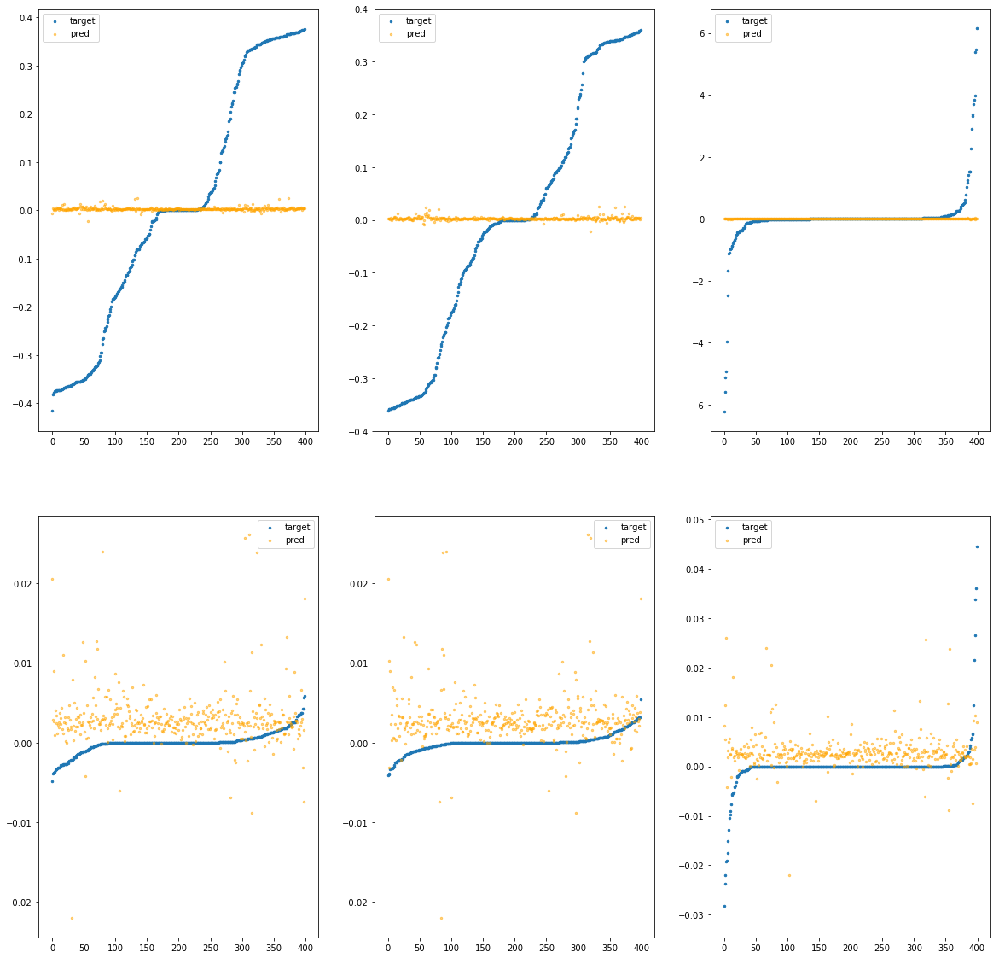

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51be81f0>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.89e-03	3.92e-01	2.06e-01	9.64e+02	6.42e-02	4.13e-03
y		-1.38e-03	3.69e-01	1.88e-01	1.23e+02	5.49e-02	3.01e-03
z		-2.81e-03	6.21e+00	2.78e-01	5.84e+01	8.77e-01	7.70e-01
phi		-1.04e+01	2.91e-02	2.86e-03	3.45e+05	2.11e-05	4.47e-10
theta		-1.42e+01	3.10e-02	2.76e-03	1.18e+05	1.93e-05	3.74e-10
psi		-5.33e-01	3.76e-02	3.36e-03	5.00e+04	3.76e-05	1.41e-09


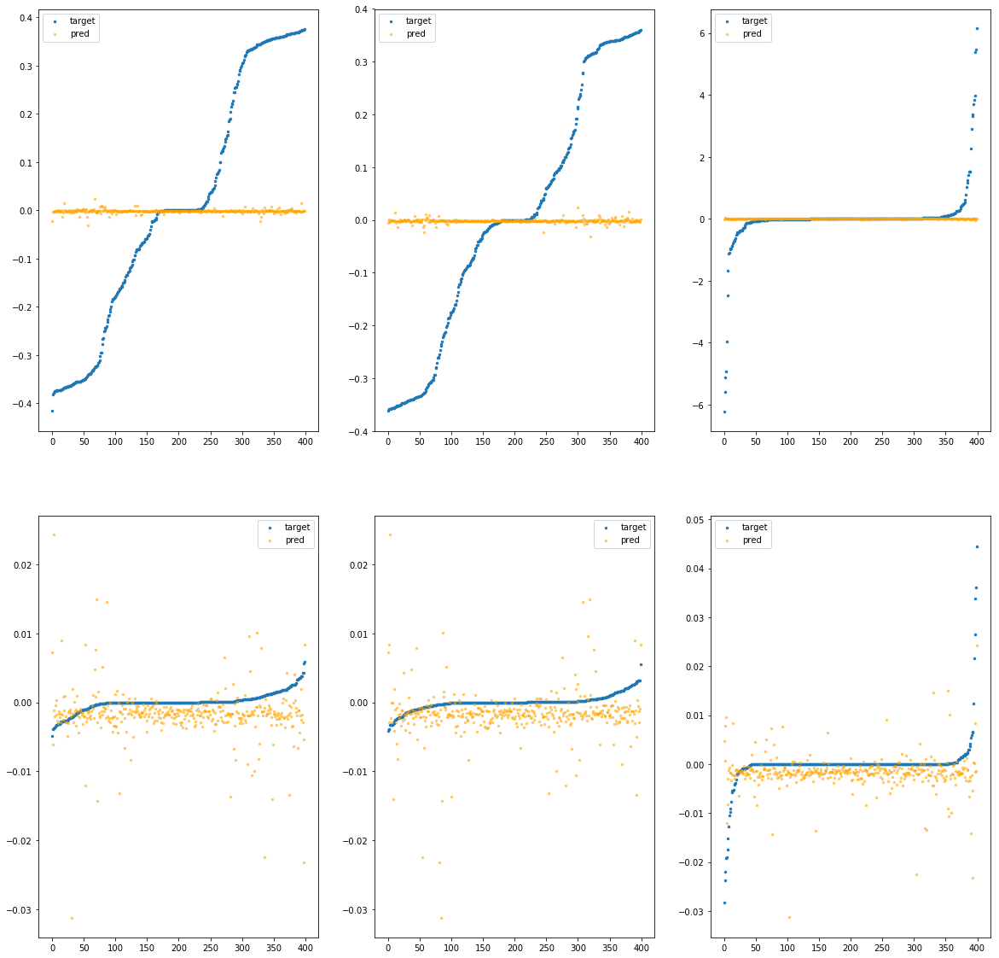

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51be8250>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.82e-03	4.06e-01	2.06e-01	1.08e+03	6.44e-02	4.14e-03
y		-9.31e-04	3.67e-01	1.88e-01	1.48e+02	5.49e-02	3.01e-03
z		-2.42e-03	6.24e+00	2.77e-01	7.14e+01	8.77e-01	7.69e-01
phi		-7.32e+00	2.24e-02	2.62e-03	3.98e+05	1.55e-05	2.40e-10
theta		-1.01e+01	2.26e-02	2.51e-03	1.46e+05	1.41e-05	1.98e-10
psi		-3.55e-01	4.22e-02	3.09e-03	5.22e+04	3.32e-05	1.10e-09


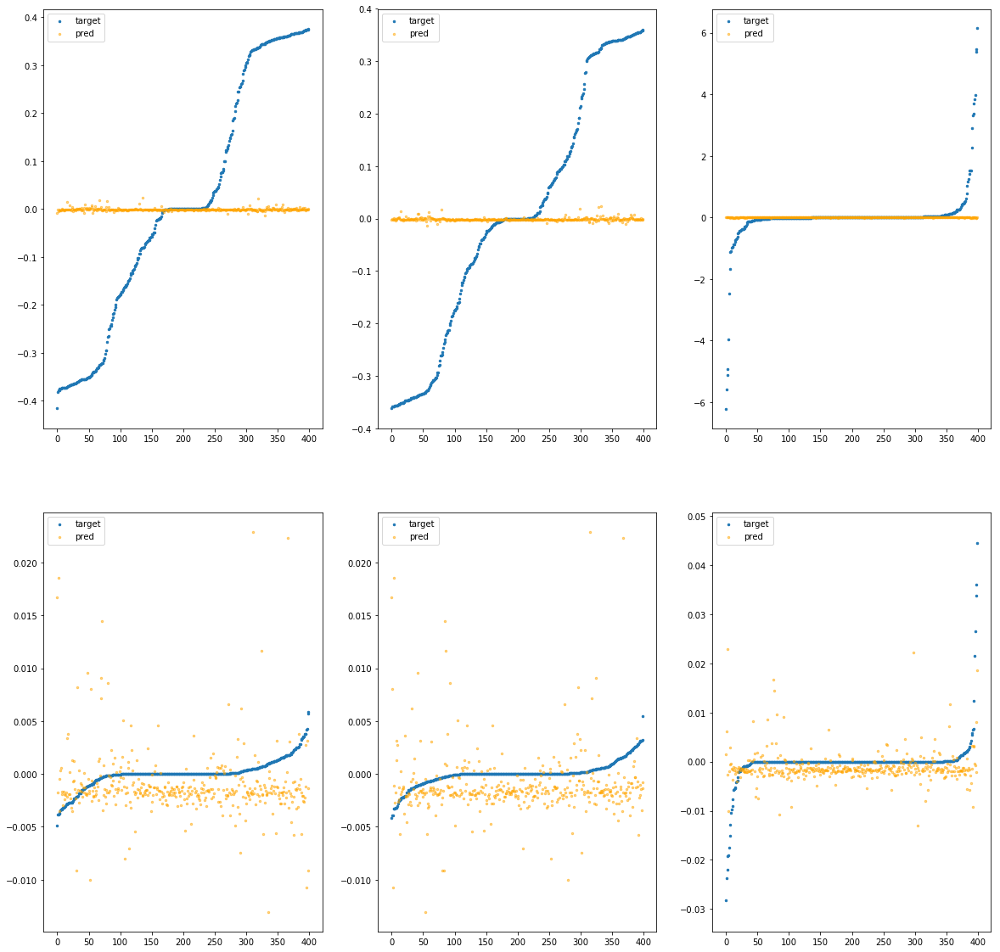

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51be82b0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.17e-03	4.09e-01	2.06e-01	1.54e+02	6.43e-02	4.14e-03
y		-2.12e-03	3.61e-01	1.88e-01	2.52e+01	5.49e-02	3.02e-03
z		-1.39e-03	6.22e+00	2.77e-01	1.93e+01	8.76e-01	7.68e-01
phi		-4.91e+00	1.88e-02	1.89e-03	6.40e+04	1.10e-05	1.21e-10
theta		-6.41e+00	1.88e-02	1.73e-03	2.49e+04	9.42e-06	8.87e-11
psi		-1.03e-01	3.65e-02	2.28e-03	1.62e+04	2.70e-05	7.32e-10


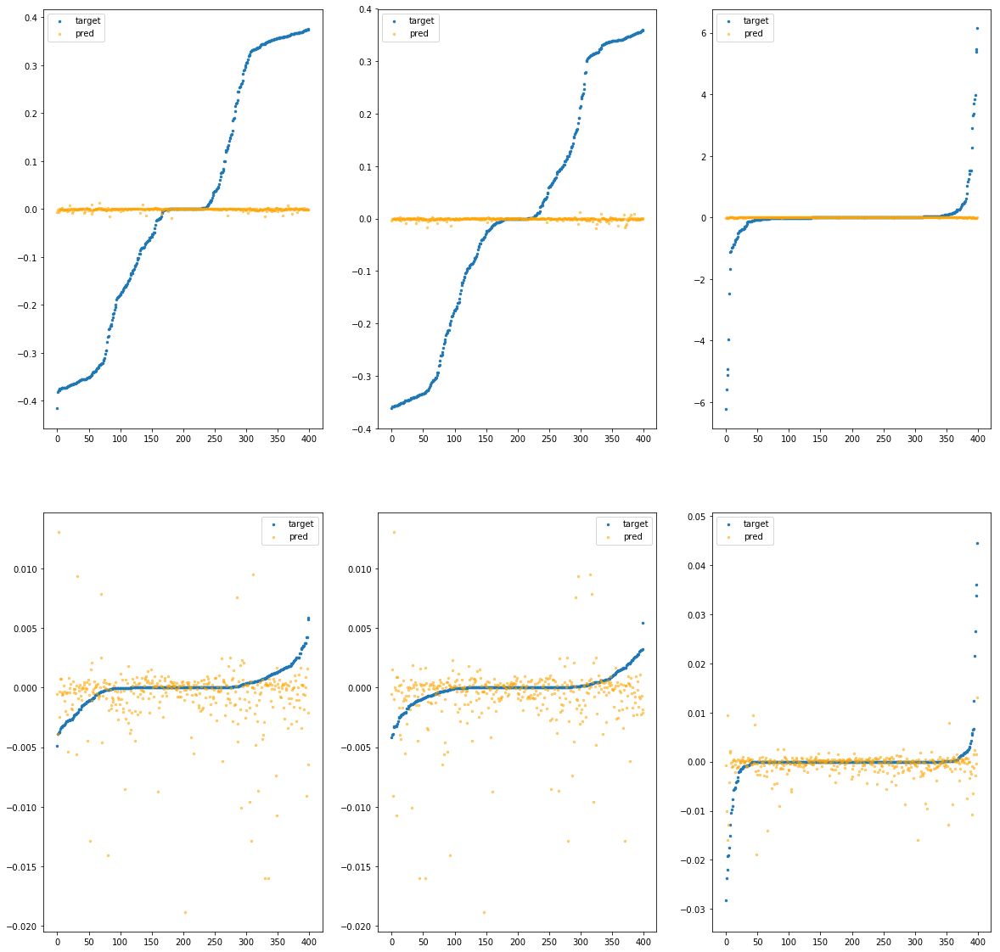

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51be8310>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.92e-04	3.90e-01	2.06e-01	1.65e+03	6.41e-02	4.11e-03
y		-1.15e-03	3.62e-01	1.88e-01	2.12e+02	5.49e-02	3.01e-03
z		-4.22e-03	6.22e+00	2.78e-01	1.26e+02	8.79e-01	7.72e-01
phi		-1.20e+01	3.28e-02	3.37e-03	6.51e+05	2.43e-05	5.89e-10
theta		-1.65e+01	3.47e-02	3.22e-03	2.31e+05	2.22e-05	4.92e-10
psi		-6.94e-01	3.80e-02	3.91e-03	7.20e+04	4.16e-05	1.73e-09


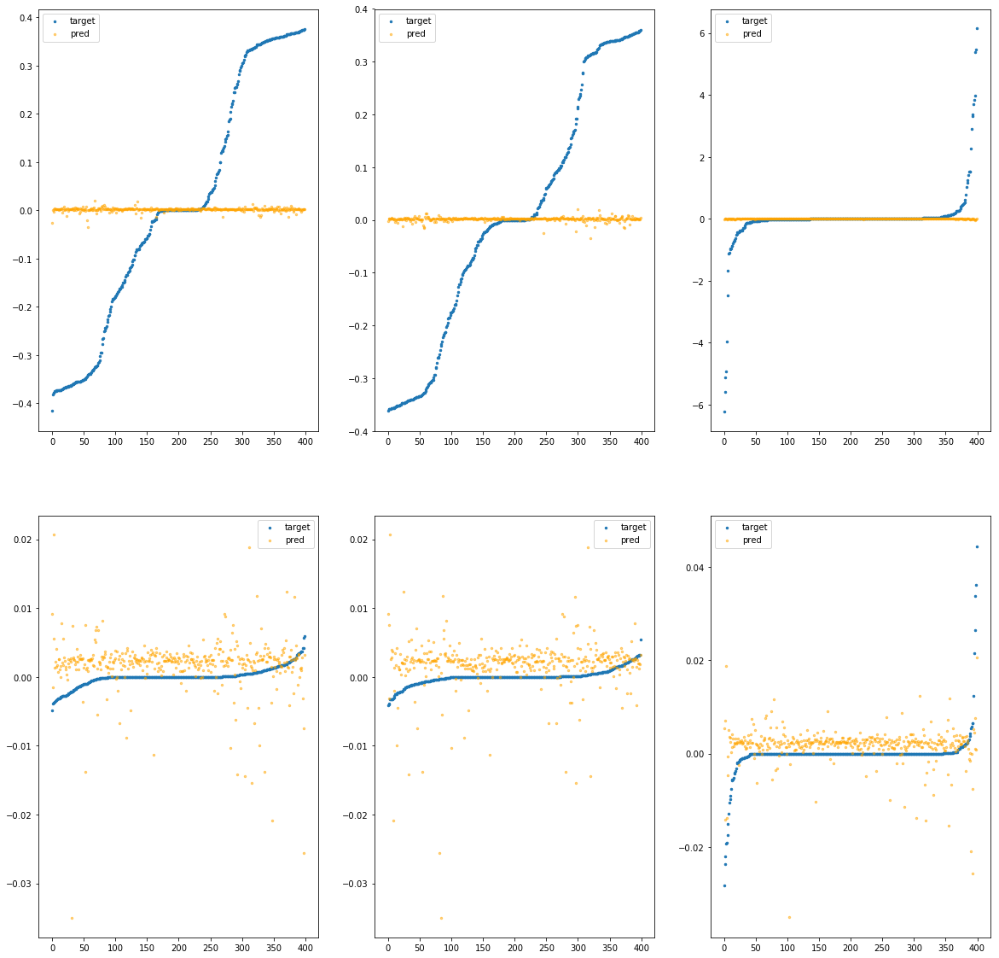

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51be8370>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.03e-03	3.98e-01	2.05e-01	8.79e+02	6.42e-02	4.12e-03
y		2.57e-04	3.61e-01	1.88e-01	1.24e+02	5.48e-02	3.00e-03
z		-1.63e-03	6.22e+00	2.77e-01	6.14e+01	8.76e-01	7.68e-01
phi		-7.37e+00	2.30e-02	2.38e-03	3.46e+05	1.56e-05	2.43e-10
theta		-9.73e+00	1.95e-02	2.27e-03	1.24e+05	1.36e-05	1.86e-10
psi		-3.64e-01	3.82e-02	2.92e-03	3.34e+04	3.35e-05	1.12e-09


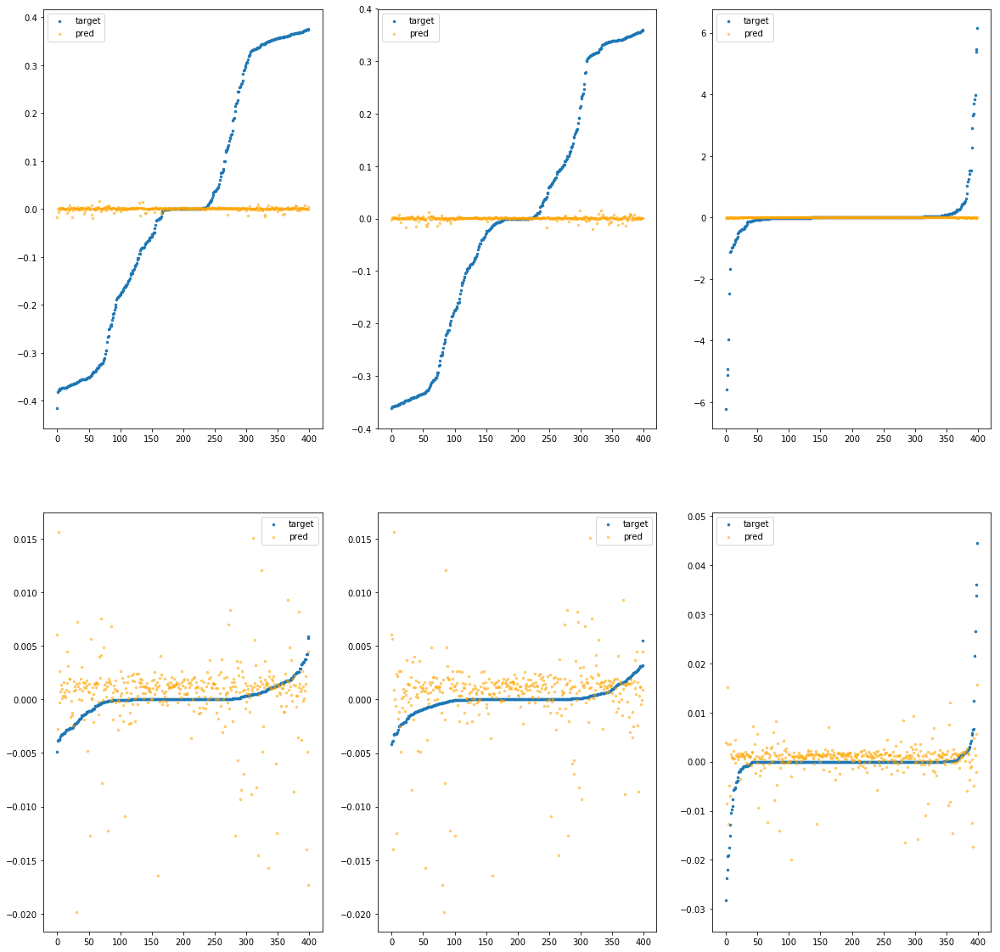

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51be83d0>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.76e-03	4.01e-01	2.06e-01	6.83e+02	6.43e-02	4.13e-03
y		-2.69e-03	3.65e-01	1.88e-01	8.33e+01	5.50e-02	3.02e-03
z		-2.78e-03	6.22e+00	2.78e-01	4.59e+01	8.77e-01	7.70e-01
phi		-8.09e+00	2.38e-02	2.58e-03	2.41e+05	1.69e-05	2.86e-10
theta		-1.08e+01	2.57e-02	2.48e-03	8.94e+04	1.49e-05	2.23e-10
psi		-4.83e-01	4.20e-02	3.10e-03	4.43e+04	3.64e-05	1.32e-09


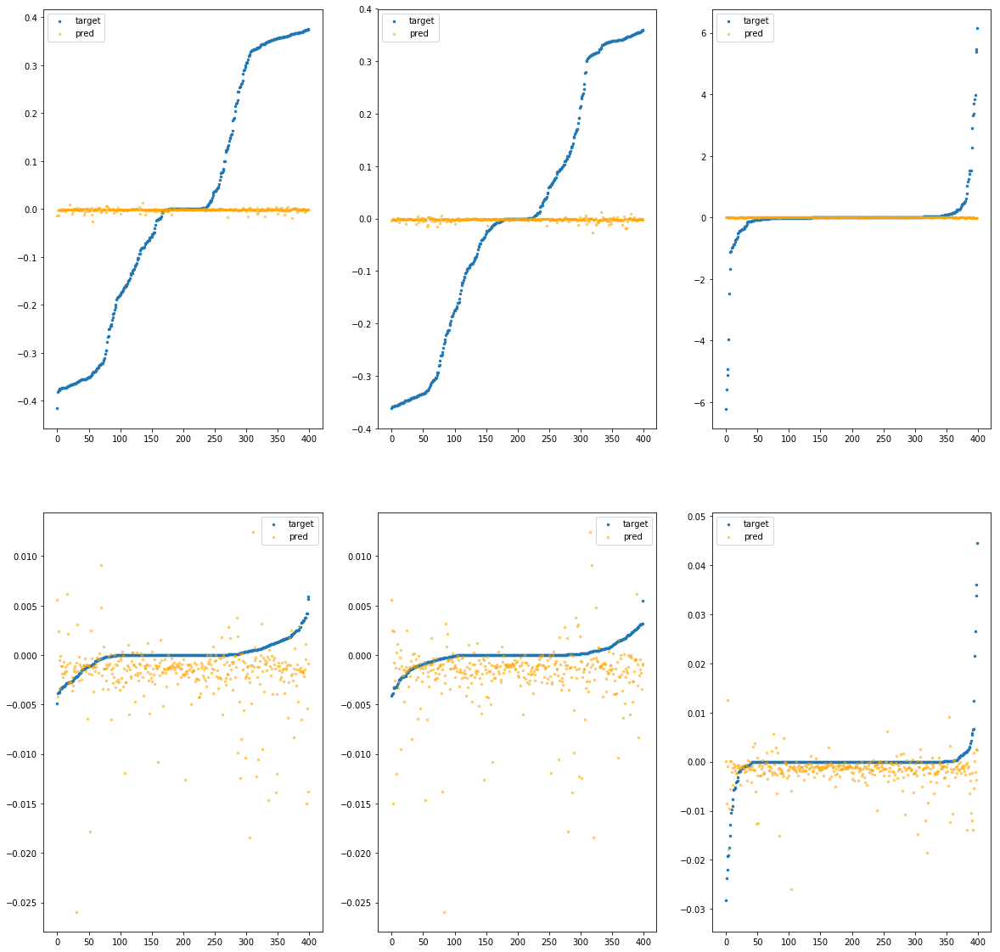

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51be8430>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		2.36e-04	3.97e-01	2.05e-01	3.33e+02	6.41e-02	4.11e-03
y		-5.09e-04	3.61e-01	1.88e-01	4.90e+01	5.48e-02	3.01e-03
z		-3.62e-03	6.22e+00	2.78e-01	3.69e+01	8.78e-01	7.71e-01
phi		-9.10e+00	2.59e-02	2.31e-03	1.40e+05	1.88e-05	3.53e-10
theta		-1.28e+01	2.78e-02	2.17e-03	5.20e+04	1.75e-05	3.05e-10
psi		-4.98e-01	3.93e-02	2.76e-03	1.90e+04	3.67e-05	1.35e-09


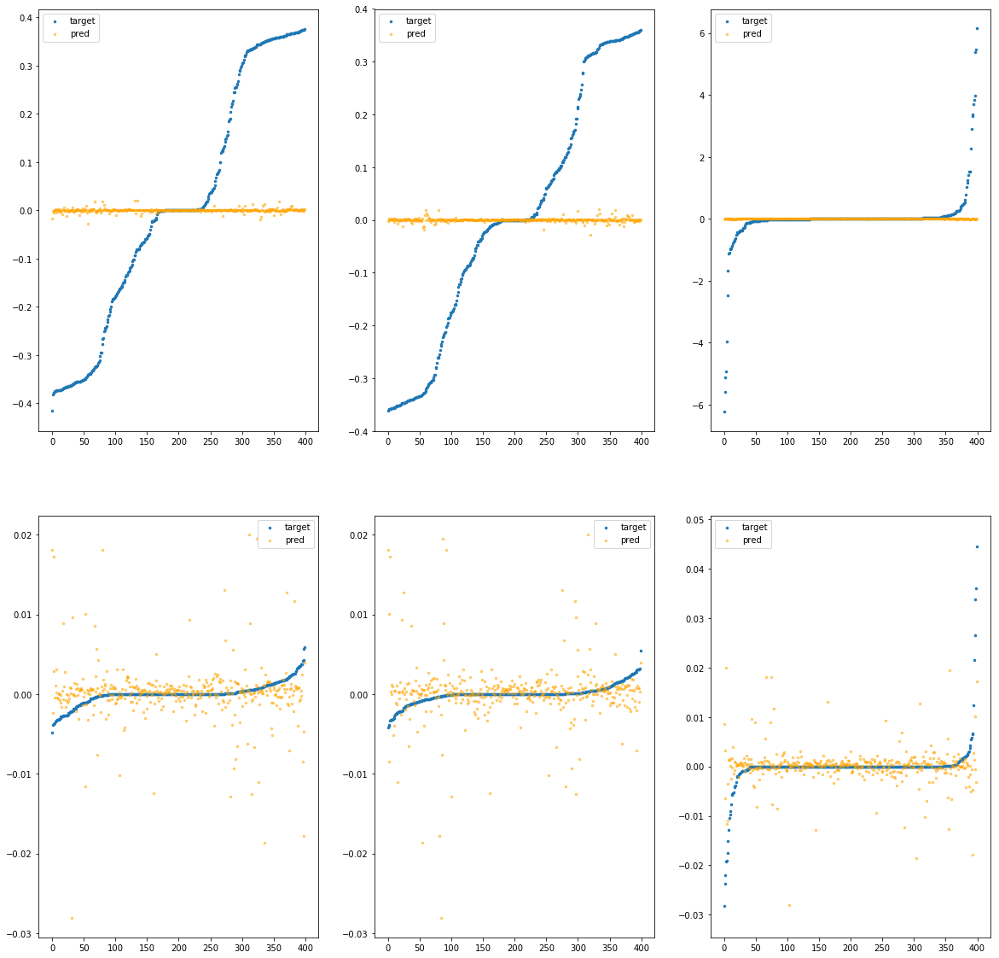

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adamax.Adamax object at 0x7fba51be8490>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.39e-03	4.13e-01	2.06e-01	2.44e+02	6.43e-02	4.13e-03
y		-5.32e-04	3.63e-01	1.88e-01	4.10e+01	5.49e-02	3.01e-03
z		-1.60e-03	6.23e+00	2.77e-01	2.09e+01	8.76e-01	7.68e-01
phi		-5.35e+00	2.55e-02	1.95e-03	8.36e+04	1.18e-05	1.40e-10
theta		-7.53e+00	2.47e-02	1.80e-03	3.37e+04	1.08e-05	1.17e-10
psi		-3.28e-01	4.05e-02	2.52e-03	2.63e+04	3.26e-05	1.06e-09


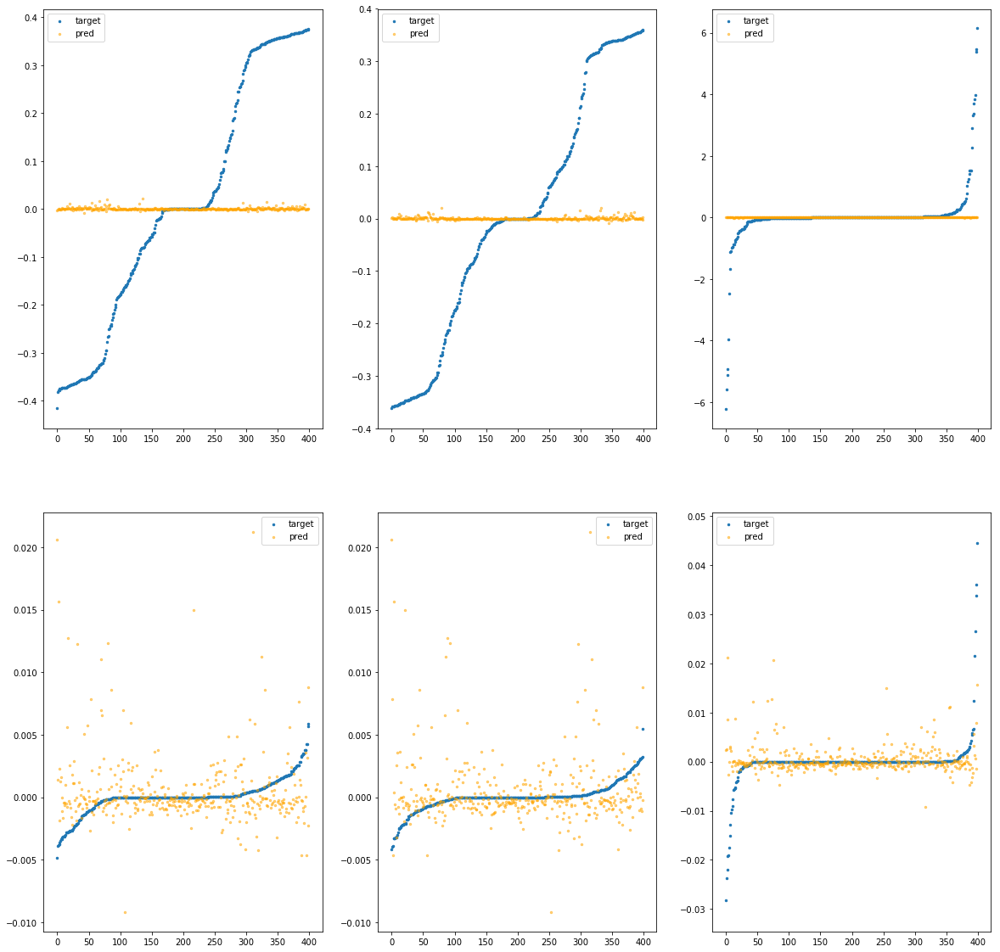

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be84f0>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.25e-03	3.95e-01	2.06e-01	8.27e+02	6.43e-02	4.13e-03
y		-4.10e-04	3.60e-01	1.88e-01	1.06e+02	5.48e-02	3.01e-03
z		-2.26e-03	6.23e+00	2.77e-01	6.23e+01	8.77e-01	7.69e-01
phi		-7.01e+00	2.65e-02	2.39e-03	3.37e+05	1.49e-05	2.22e-10
theta		-9.25e+00	2.05e-02	2.27e-03	1.16e+05	1.30e-05	1.69e-10
psi		-4.18e-01	3.75e-02	2.98e-03	4.45e+04	3.48e-05	1.21e-09


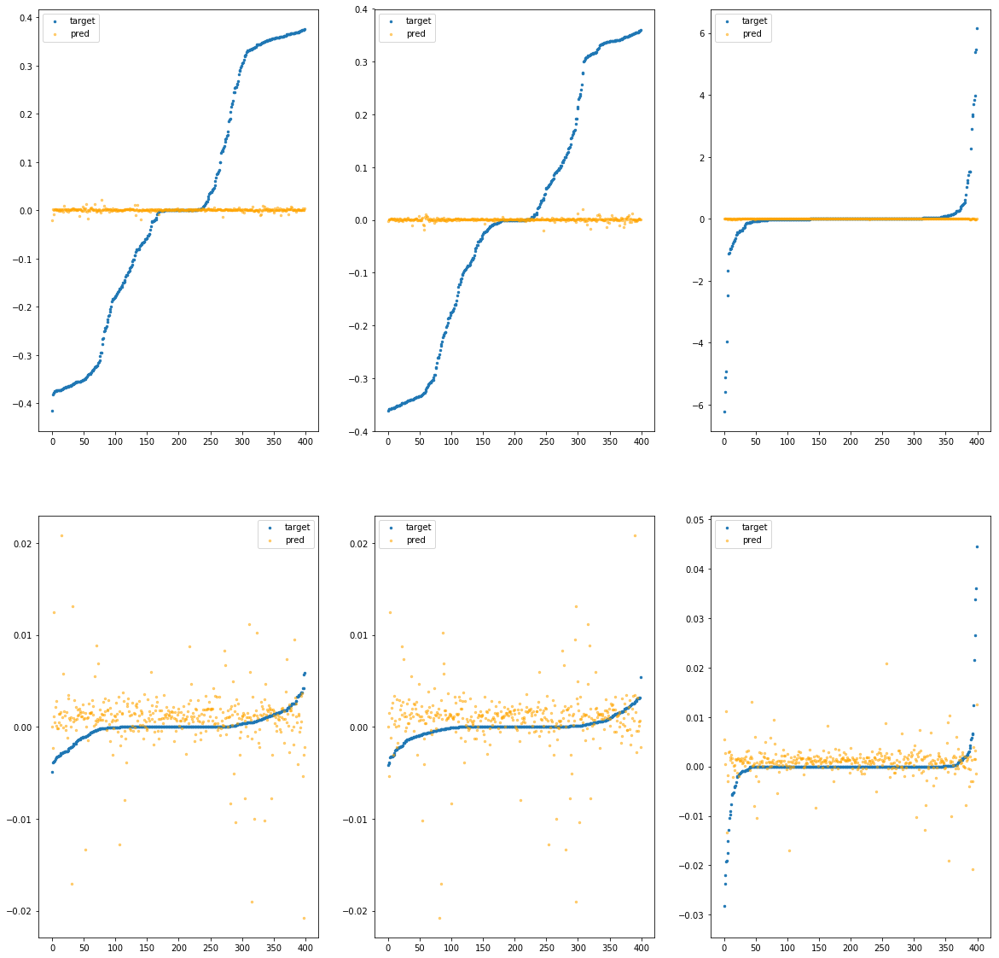

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be8550>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.26e-03	4.08e-01	2.06e-01	3.51e+02	6.43e-02	4.13e-03
y		-5.53e-04	3.62e-01	1.88e-01	4.15e+01	5.49e-02	3.01e-03
z		-2.29e-03	6.23e+00	2.77e-01	2.40e+01	8.77e-01	7.69e-01
phi		-5.39e+00	2.41e-02	2.13e-03	1.16e+05	1.19e-05	1.41e-10
theta		-7.39e+00	2.36e-02	1.91e-03	3.80e+04	1.06e-05	1.13e-10
psi		-2.33e-01	3.89e-02	2.51e-03	2.49e+04	3.03e-05	9.16e-10


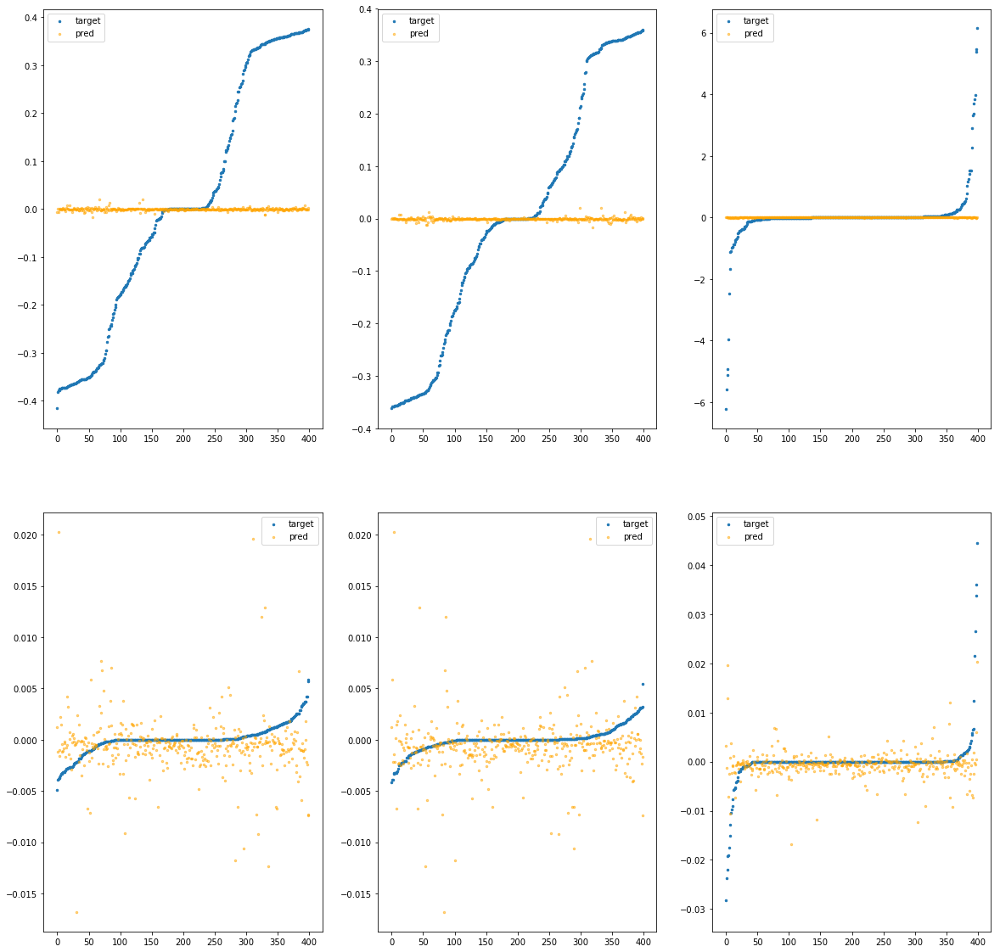

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be85b0>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-8.03e-04	3.98e-01	2.05e-01	5.07e+02	6.42e-02	4.12e-03
y		-1.70e-03	3.61e-01	1.88e-01	6.47e+01	5.49e-02	3.02e-03
z		-1.12e-03	6.22e+00	2.77e-01	3.23e+01	8.76e-01	7.67e-01
phi		-5.49e+00	2.33e-02	2.12e-03	1.74e+05	1.21e-05	1.46e-10
theta		-7.07e+00	2.24e-02	1.96e-03	6.10e+04	1.03e-05	1.05e-10
psi		-3.31e-01	4.20e-02	2.62e-03	2.92e+04	3.26e-05	1.07e-09


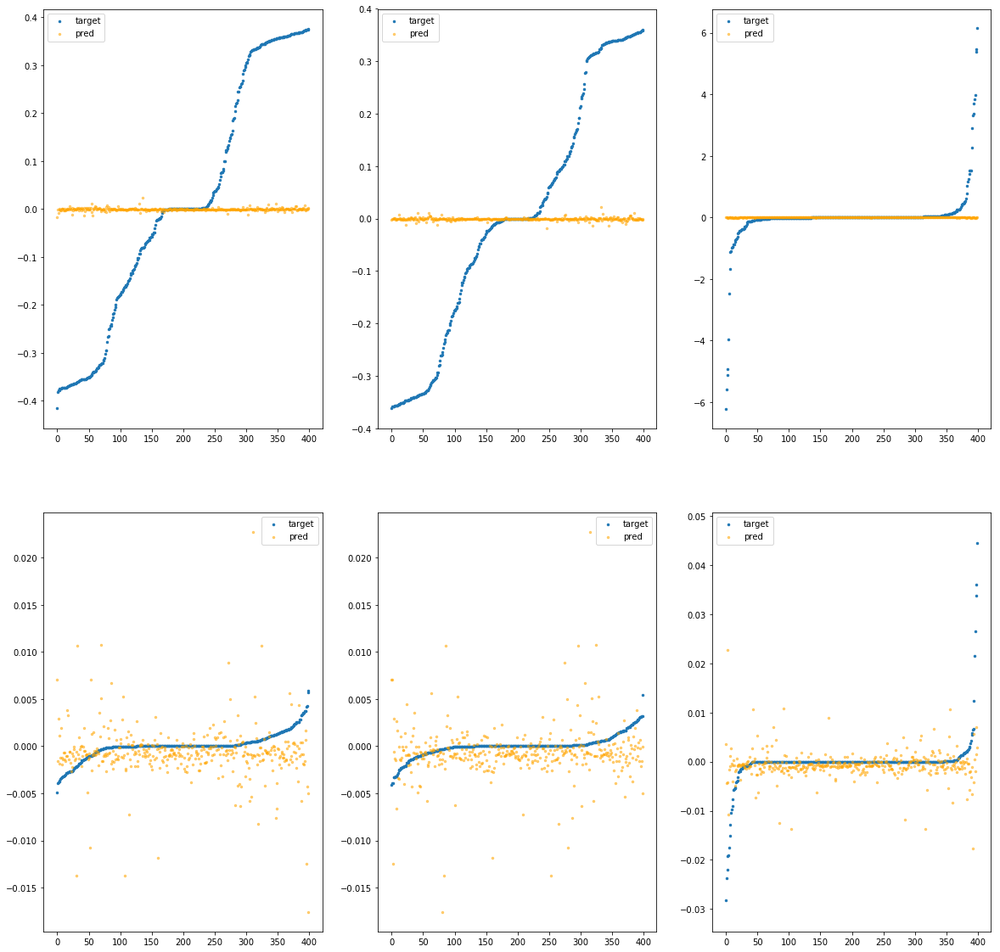

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be8610>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.22e-03	4.06e-01	2.05e-01	1.53e+02	6.42e-02	4.12e-03
y		-1.33e-03	3.63e-01	1.88e-01	1.88e+01	5.49e-02	3.01e-03
z		-1.99e-03	6.23e+00	2.77e-01	1.77e+01	8.77e-01	7.68e-01
phi		-3.94e+00	1.89e-02	1.82e-03	6.39e+04	9.19e-06	8.44e-11
theta		-5.06e+00	2.07e-02	1.64e-03	1.89e+04	7.70e-06	5.93e-11
psi		-1.75e-01	3.70e-02	2.30e-03	1.85e+04	2.88e-05	8.31e-10


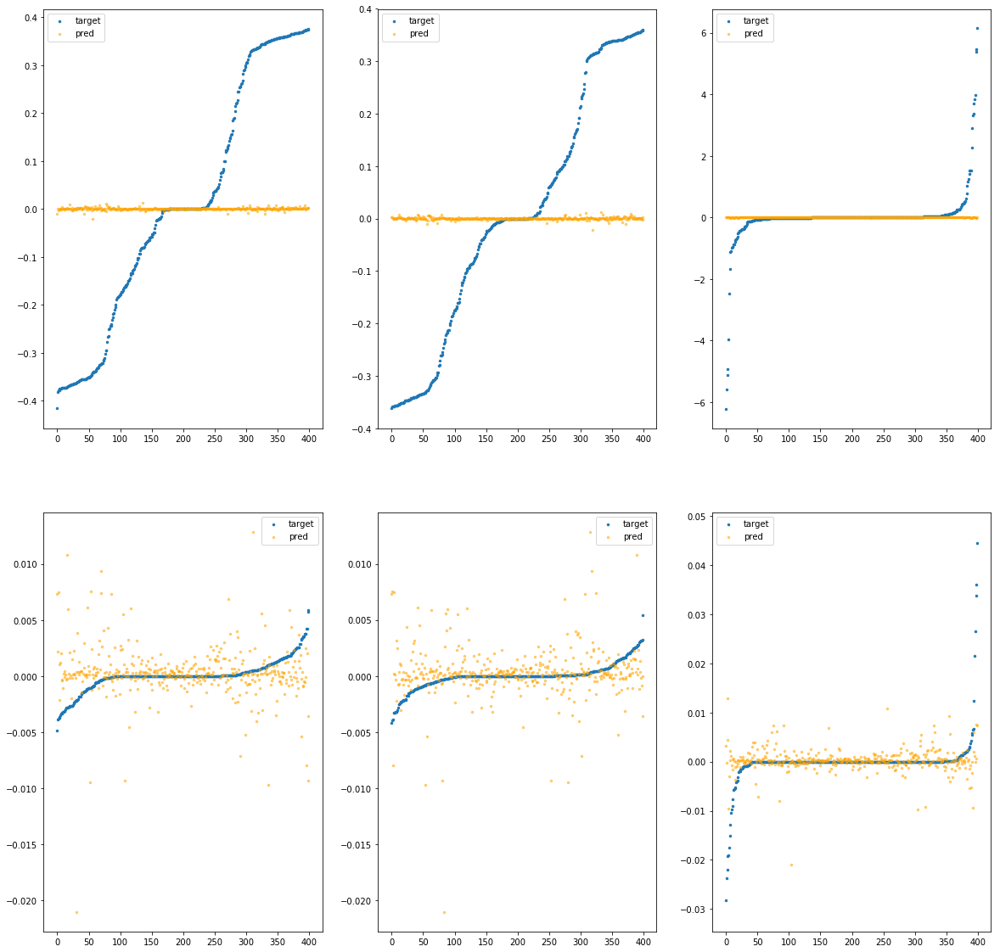

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be8670>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.35e-03	4.10e-01	2.05e-01	1.42e+02	6.42e-02	4.12e-03
y		-3.41e-04	3.60e-01	1.88e-01	1.95e+01	5.48e-02	3.01e-03
z		-1.26e-03	6.23e+00	2.77e-01	1.41e+01	8.76e-01	7.67e-01
phi		-2.30e+00	1.32e-02	1.57e-03	5.92e+04	6.13e-06	3.76e-11
theta		-2.89e+00	1.28e-02	1.38e-03	1.98e+04	4.94e-06	2.44e-11
psi		-5.42e-02	3.50e-02	2.06e-03	1.22e+04	2.59e-05	6.69e-10


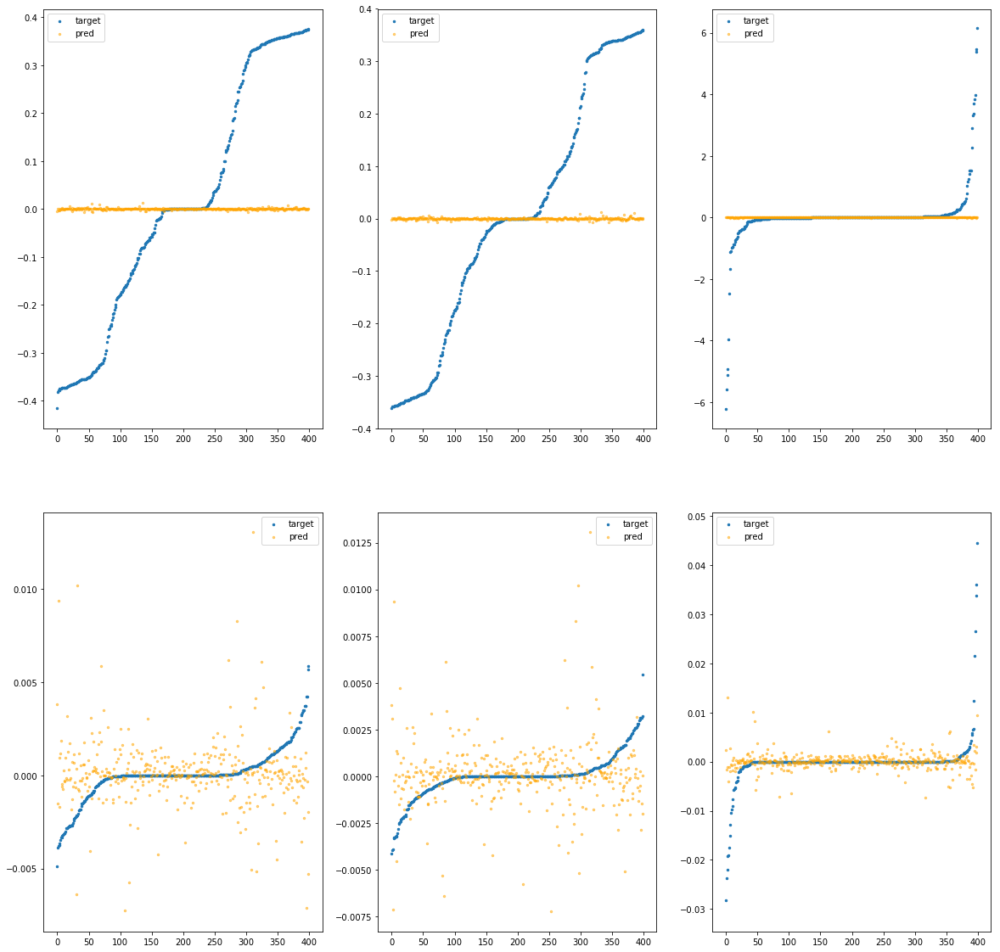

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be86d0>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		2.00e-04	4.07e-01	2.05e-01	1.04e+03	6.41e-02	4.11e-03
y		-1.30e-03	3.63e-01	1.88e-01	1.51e+02	5.49e-02	3.01e-03
z		-1.72e-03	6.23e+00	2.77e-01	7.11e+01	8.76e-01	7.68e-01
phi		-5.17e+00	2.63e-02	2.41e-03	4.07e+05	1.15e-05	1.32e-10
theta		-6.80e+00	2.19e-02	2.28e-03	1.53e+05	9.91e-06	9.82e-11
psi		-2.87e-01	3.76e-02	3.07e-03	5.29e+04	3.16e-05	9.97e-10


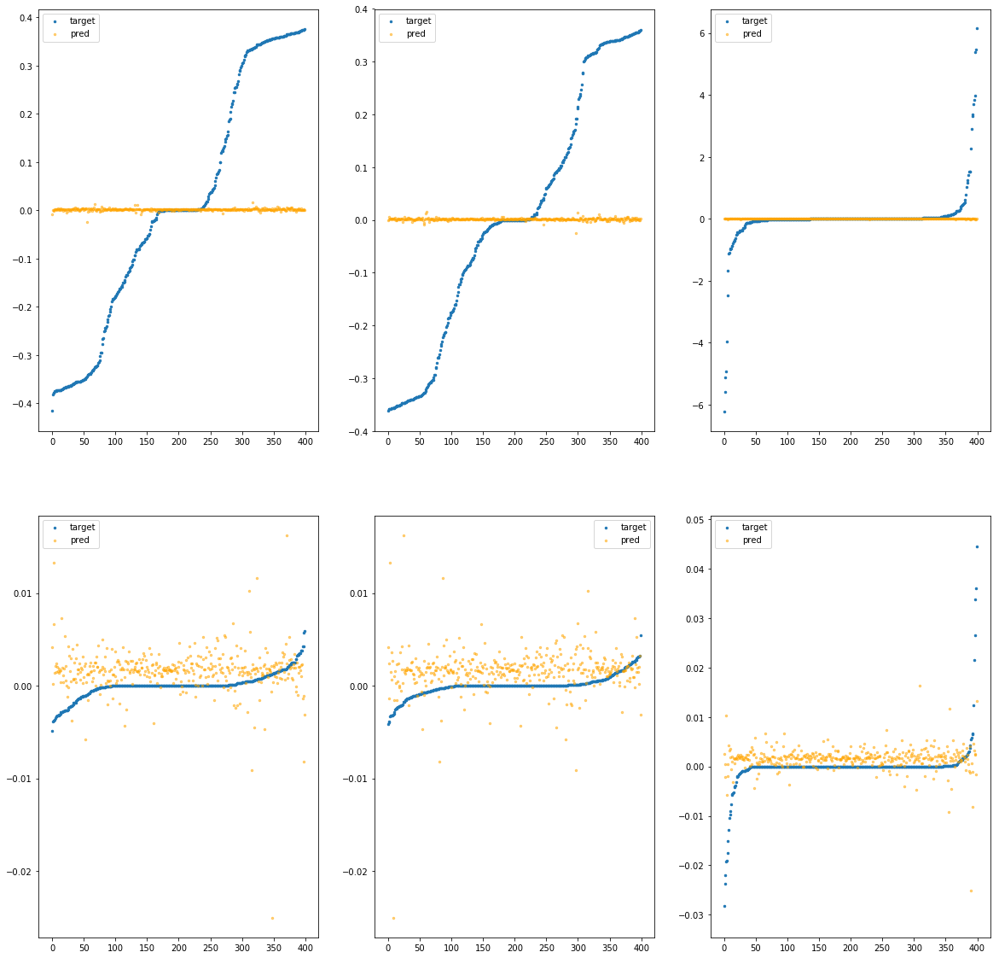

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be8730>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.16e-03	3.98e-01	2.06e-01	2.42e+03	6.44e-02	4.14e-03
y		-2.78e-03	3.63e-01	1.88e-01	3.13e+02	5.50e-02	3.02e-03
z		-1.94e-03	6.22e+00	2.78e-01	1.67e+02	8.77e-01	7.68e-01
phi		-1.45e+01	2.25e-02	4.56e-03	9.01e+05	2.88e-05	8.31e-10
theta		-2.04e+01	1.73e-02	4.49e-03	3.25e+05	2.71e-05	7.37e-10
psi		-1.01e+00	4.60e-02	5.12e-03	1.02e+05	4.93e-05	2.43e-09


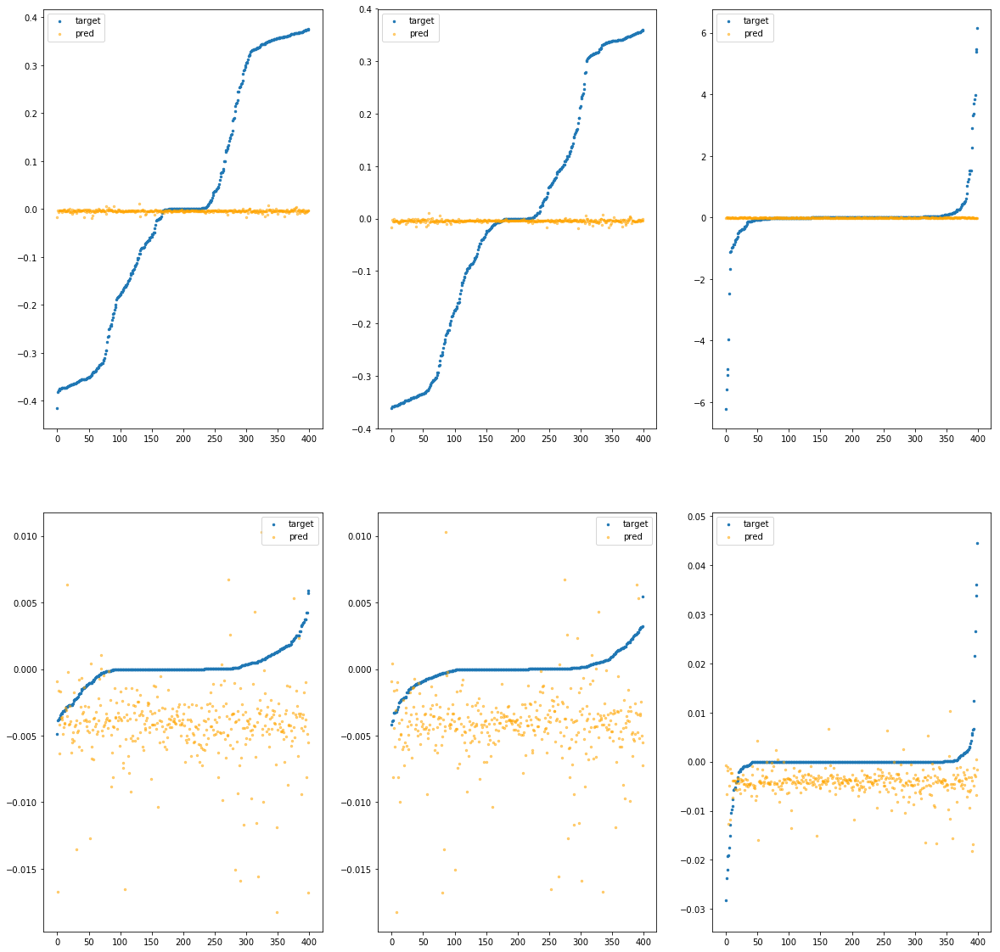

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be8790>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.52e-03	3.98e-01	2.06e-01	7.40e+02	6.42e-02	4.12e-03
y		-2.47e-03	3.62e-01	1.88e-01	1.10e+02	5.50e-02	3.02e-03
z		-2.71e-03	6.23e+00	2.78e-01	5.92e+01	8.77e-01	7.70e-01
phi		-5.81e+00	2.25e-02	2.33e-03	3.04e+05	1.27e-05	1.61e-10
theta		-7.85e+00	1.65e-02	2.21e-03	1.08e+05	1.12e-05	1.26e-10
psi		-3.77e-01	3.69e-02	2.94e-03	3.50e+04	3.38e-05	1.14e-09


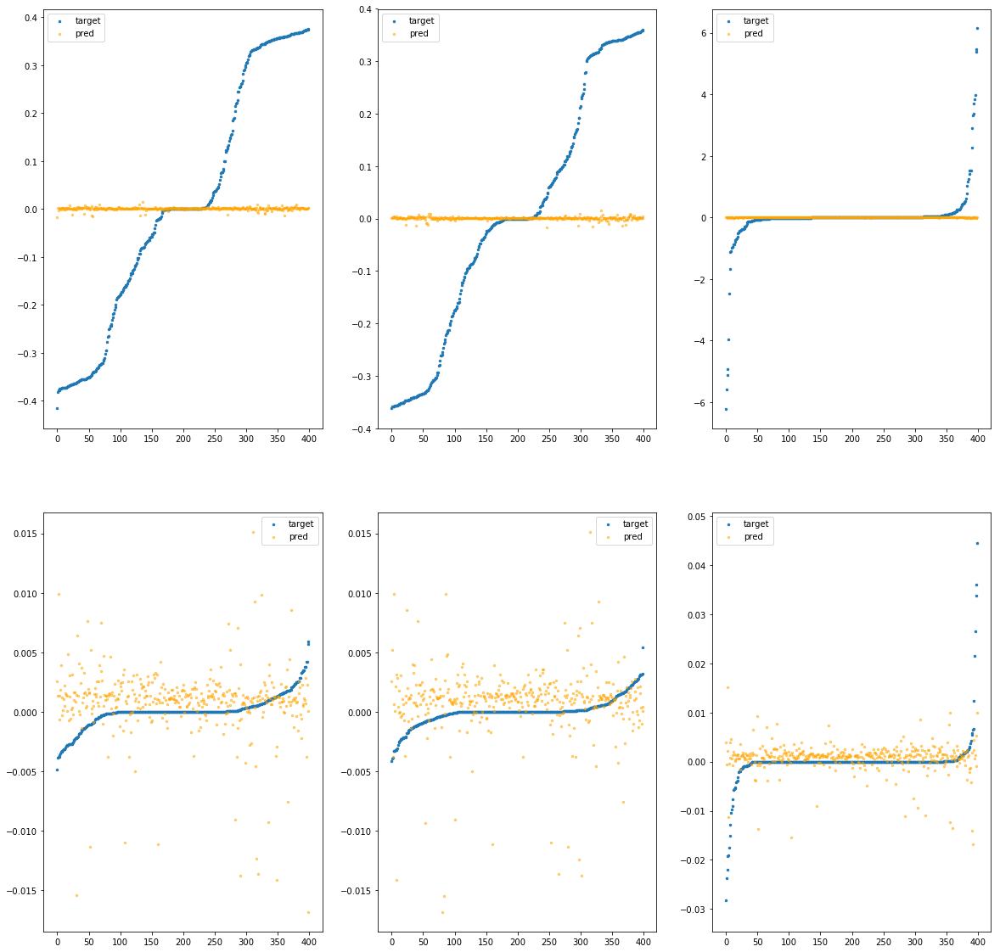

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be87f0>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.32e-03	3.97e-01	2.06e-01	7.67e+02	6.43e-02	4.13e-03
y		-1.90e-03	3.61e-01	1.88e-01	1.01e+02	5.49e-02	3.02e-03
z		-3.71e-03	6.22e+00	2.78e-01	4.90e+01	8.78e-01	7.71e-01
phi		-8.29e+00	2.48e-02	2.57e-03	2.74e+05	1.73e-05	2.99e-10
theta		-1.12e+01	2.67e-02	2.44e-03	1.06e+05	1.54e-05	2.39e-10
psi		-3.67e-01	4.06e-02	2.98e-03	4.06e+04	3.35e-05	1.12e-09


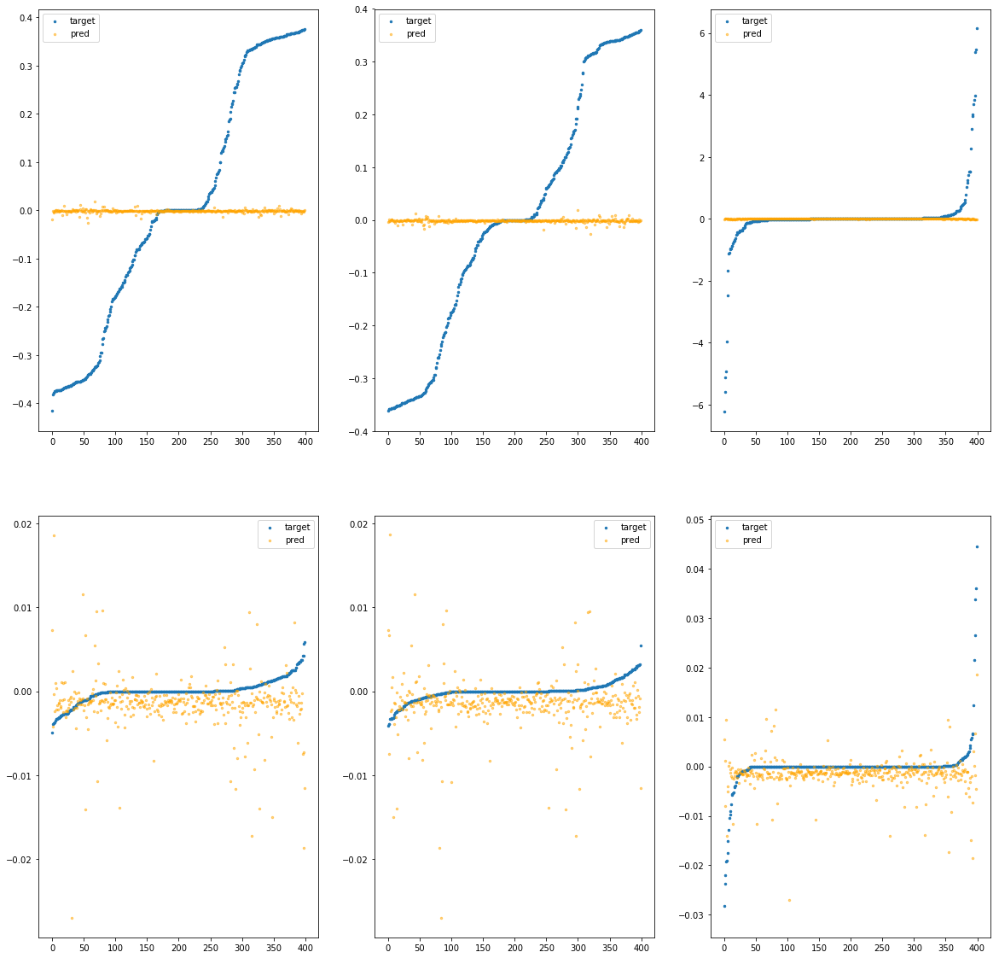

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be8850>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.85e-03	4.11e-01	2.05e-01	1.62e+02	6.42e-02	4.13e-03
y		-1.46e-03	3.62e-01	1.88e-01	2.04e+01	5.49e-02	3.01e-03
z		-1.22e-03	6.22e+00	2.77e-01	1.26e+01	8.76e-01	7.67e-01
phi		-5.02e-01	9.67e-03	1.10e-03	6.21e+04	2.80e-06	7.82e-12
theta		-5.38e-01	6.71e-03	9.58e-04	1.79e+04	1.95e-06	3.82e-12
psi		-1.07e-02	4.33e-02	1.68e-03	1.15e+04	2.48e-05	6.15e-10


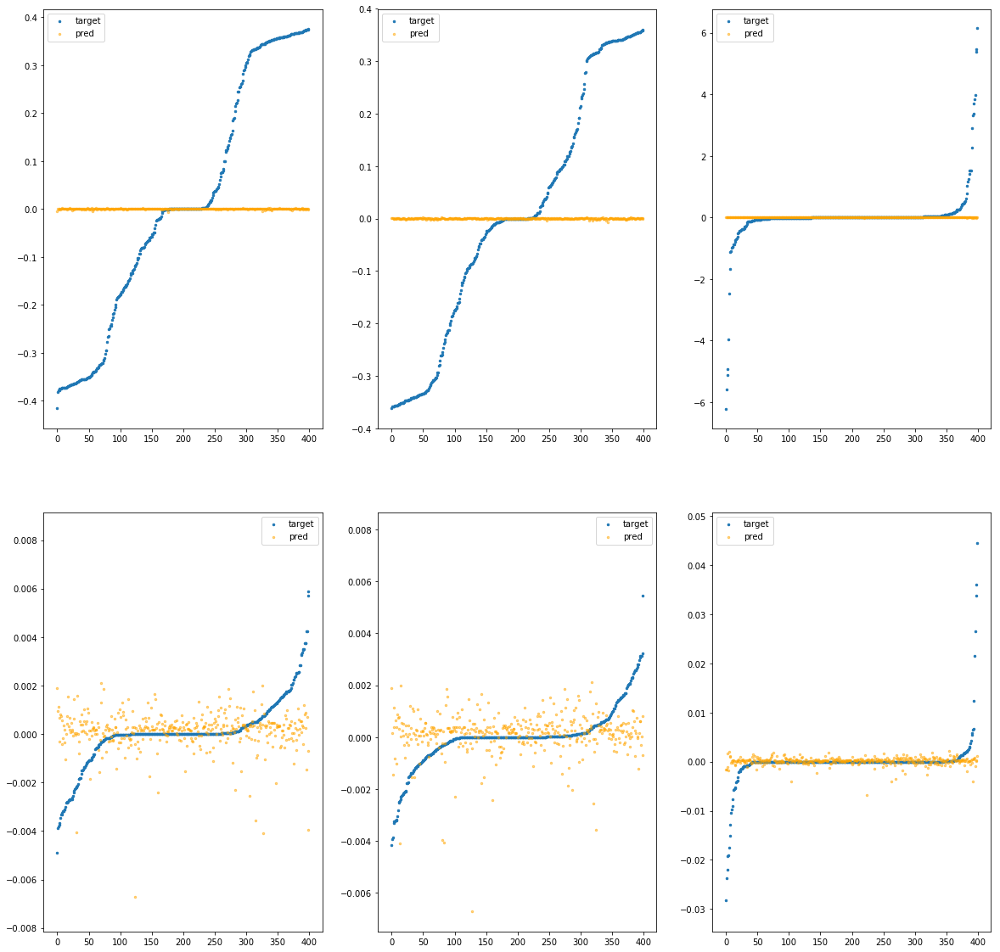

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be88b0>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.73e-03	4.06e-01	2.06e-01	2.03e+03	6.44e-02	4.14e-03
y		-2.83e-03	3.64e-01	1.88e-01	2.70e+02	5.50e-02	3.02e-03
z		-1.48e-03	6.22e+00	2.78e-01	1.39e+02	8.76e-01	7.68e-01
phi		-8.61e+00	2.50e-02	3.61e-03	7.72e+05	1.79e-05	3.20e-10
theta		-1.20e+01	2.05e-02	3.54e-03	2.81e+05	1.65e-05	2.72e-10
psi		-6.00e-01	4.37e-02	4.18e-03	8.56e+04	3.92e-05	1.54e-09


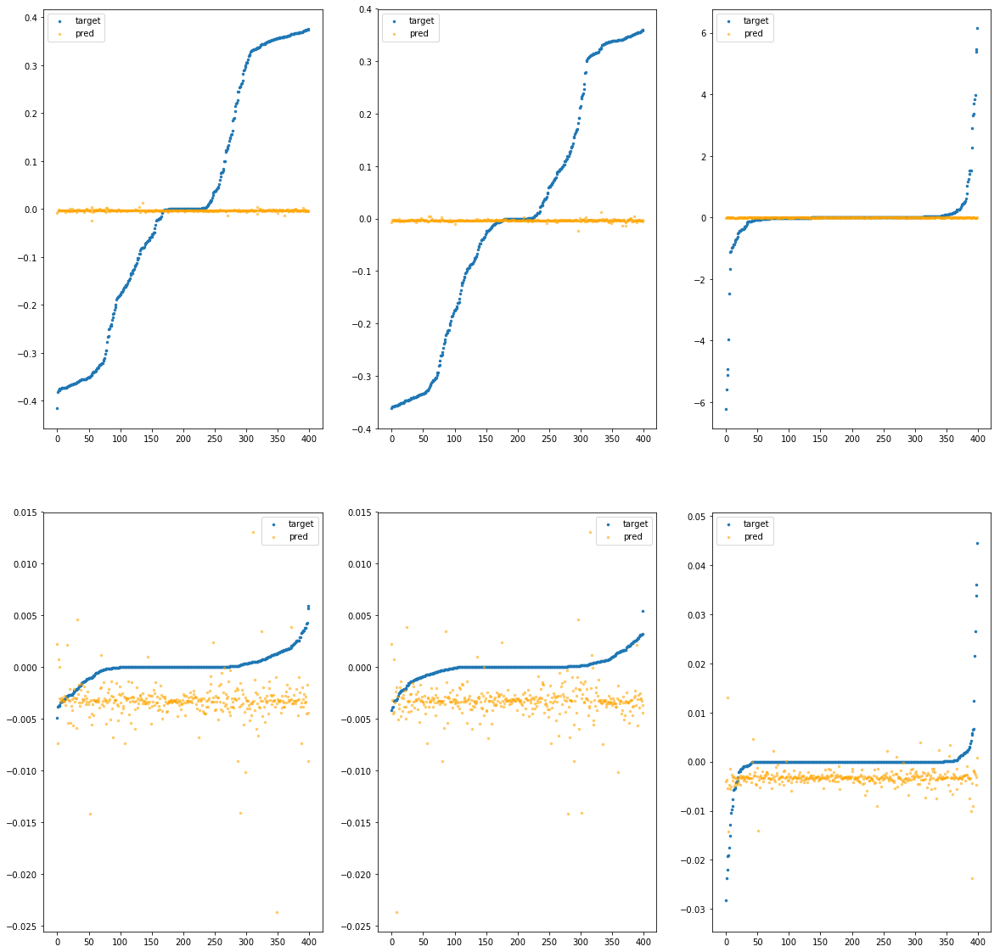

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be8910>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.49e-03	3.96e-01	2.05e-01	4.41e+02	6.42e-02	4.12e-03
y		-9.02e-05	3.62e-01	1.88e-01	5.28e+01	5.48e-02	3.01e-03
z		-1.15e-03	6.23e+00	2.77e-01	3.42e+01	8.76e-01	7.67e-01
phi		-3.81e+00	2.53e-02	1.84e-03	1.83e+05	8.95e-06	8.01e-11
theta		-4.94e+00	1.93e-02	1.73e-03	6.49e+04	7.55e-06	5.69e-11
psi		-2.46e-01	3.86e-02	2.42e-03	2.29e+04	3.06e-05	9.35e-10


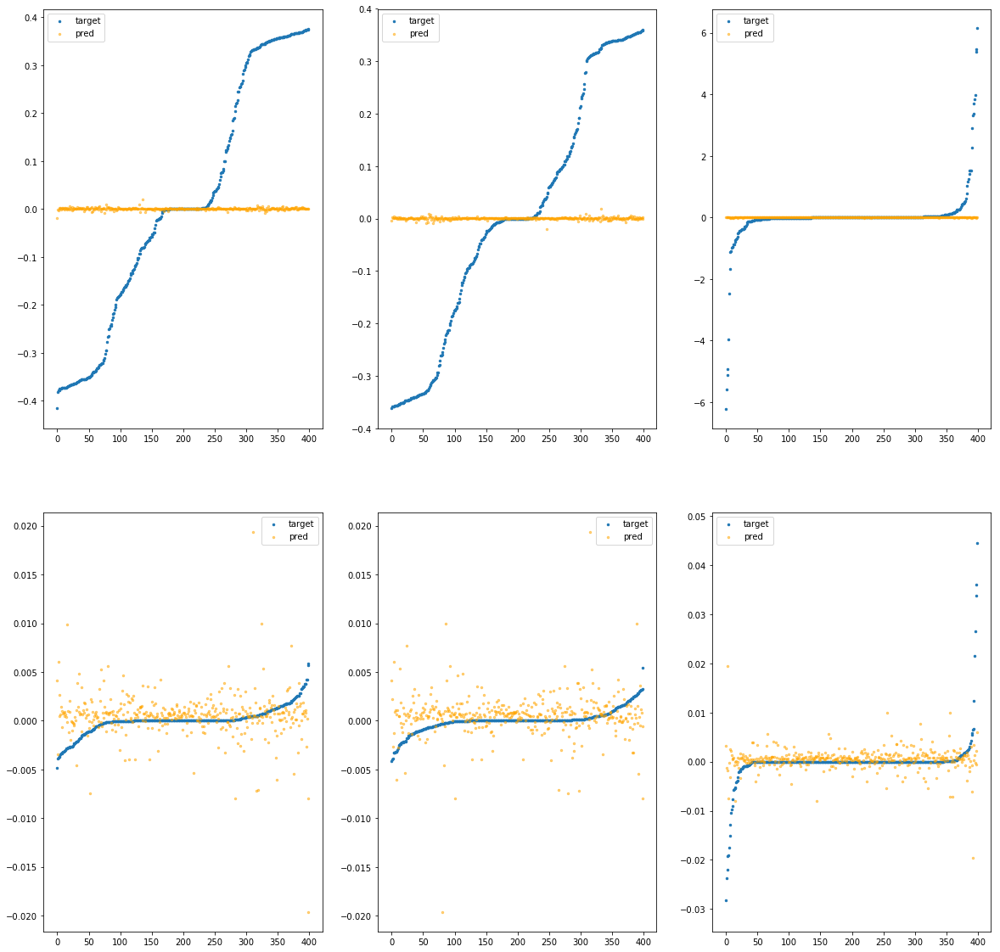

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be8970>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.46e-03	4.08e-01	2.06e-01	8.53e+02	6.43e-02	4.14e-03
y		-2.93e-04	3.65e-01	1.88e-01	1.11e+02	5.48e-02	3.01e-03
z		-2.54e-03	6.22e+00	2.77e-01	5.26e+01	8.77e-01	7.69e-01
phi		-6.03e+00	1.81e-02	2.43e-03	3.10e+05	1.31e-05	1.71e-10
theta		-8.49e+00	1.88e-02	2.33e-03	1.06e+05	1.21e-05	1.45e-10
psi		-1.95e-01	3.96e-02	2.82e-03	3.93e+04	2.93e-05	8.60e-10


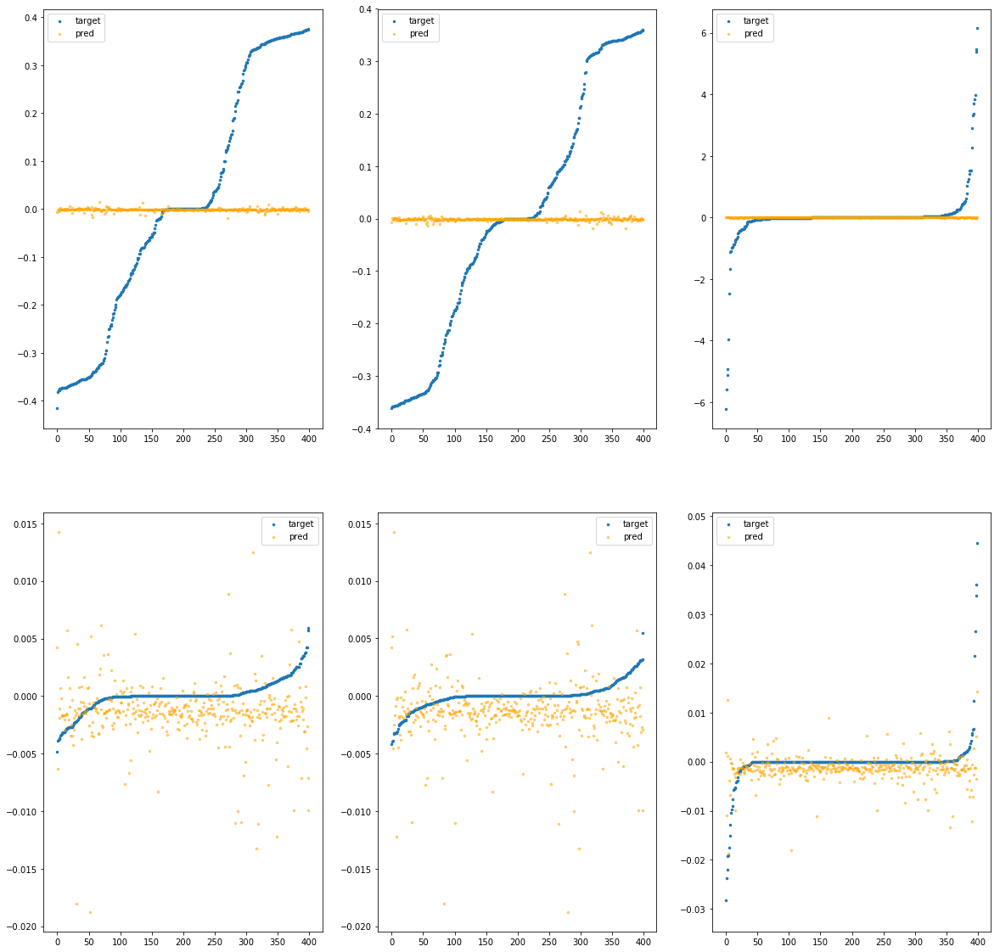

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be89d0>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.31e-03	3.89e-01	2.06e-01	4.02e+03	6.44e-02	4.15e-03
y		-2.45e-03	3.68e-01	1.88e-01	5.25e+02	5.50e-02	3.02e-03
z		-2.95e-03	6.21e+00	2.79e-01	2.76e+02	8.77e-01	7.70e-01
phi		-3.00e+01	3.24e-02	6.91e-03	1.53e+06	5.77e-05	3.33e-09
theta		-4.30e+01	2.64e-02	6.90e-03	5.46e+05	5.59e-05	3.13e-09
psi		-2.13e+00	4.33e-02	7.35e-03	1.83e+05	7.68e-05	5.90e-09


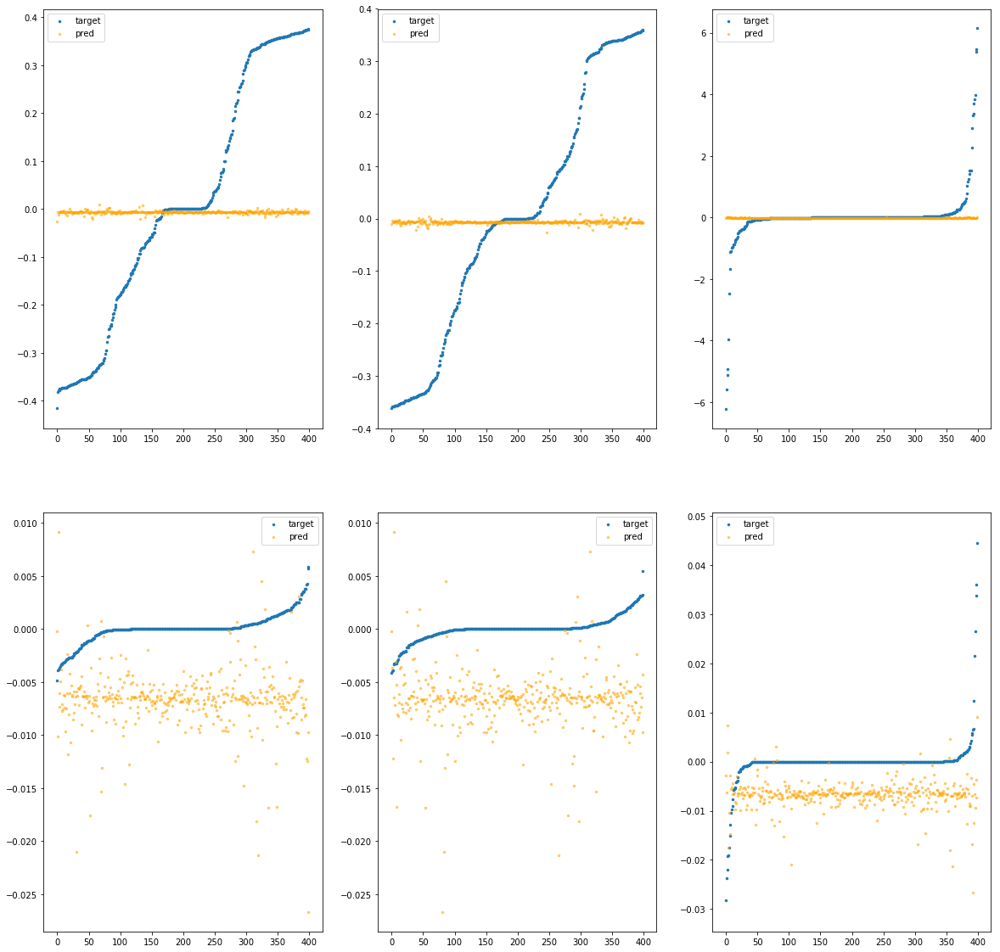

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be8a30>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.30e-03	3.98e-01	2.05e-01	1.30e+02	6.42e-02	4.12e-03
y		-1.80e-03	3.60e-01	1.88e-01	1.53e+01	5.49e-02	3.02e-03
z		-2.71e-03	6.22e+00	2.77e-01	1.23e+01	8.77e-01	7.70e-01
phi		-7.63e+00	3.64e-02	2.18e-03	4.93e+04	1.61e-05	2.58e-10
theta		-1.06e+01	3.83e-02	2.00e-03	2.05e+04	1.47e-05	2.18e-10
psi		-4.95e-01	3.85e-02	2.65e-03	1.90e+04	3.67e-05	1.34e-09


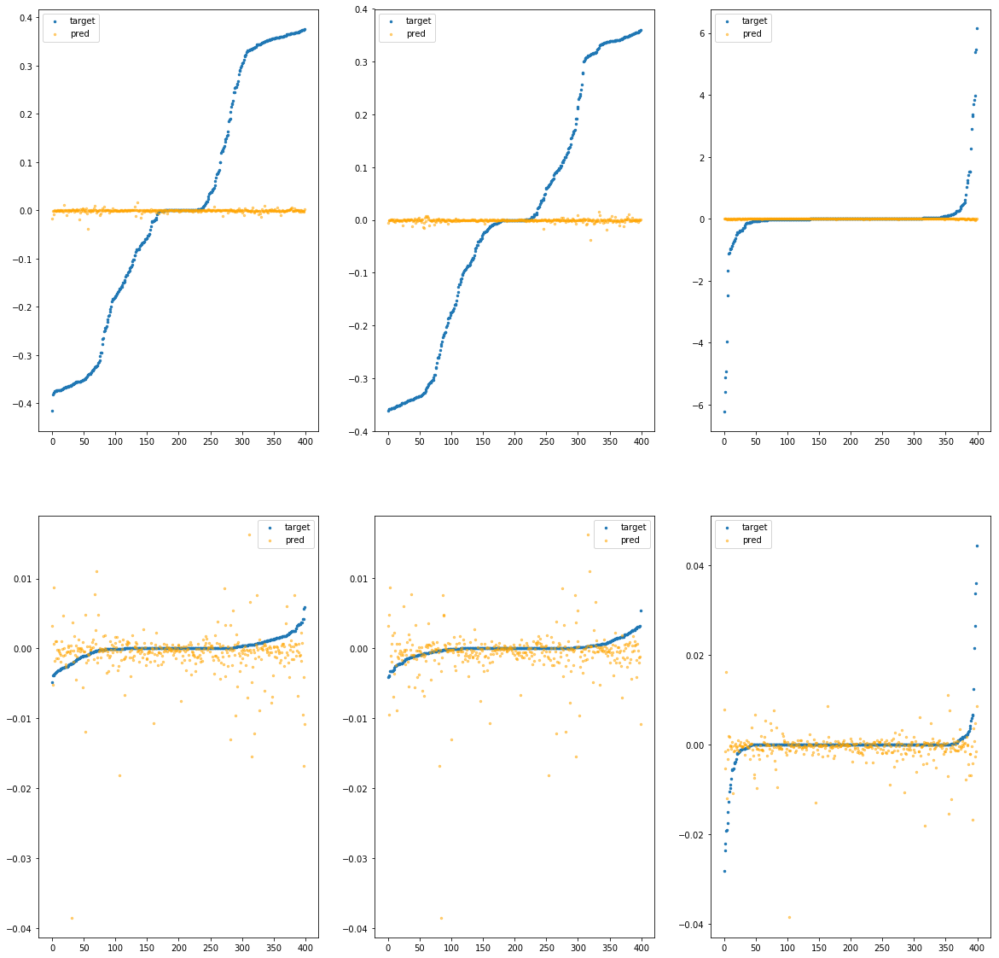

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be8a90>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		1.02e-04	3.99e-01	2.06e-01	2.03e+03	6.41e-02	4.11e-03
y		4.15e-04	3.63e-01	1.88e-01	2.71e+02	5.48e-02	3.00e-03
z		-1.12e-03	6.23e+00	2.78e-01	1.44e+02	8.76e-01	7.67e-01
phi		-9.42e+00	2.63e-02	3.63e-03	7.84e+05	1.94e-05	3.76e-10
theta		-1.33e+01	2.64e-02	3.62e-03	2.77e+05	1.82e-05	3.30e-10
psi		-7.13e-01	4.60e-02	4.43e-03	9.59e+04	4.20e-05	1.77e-09


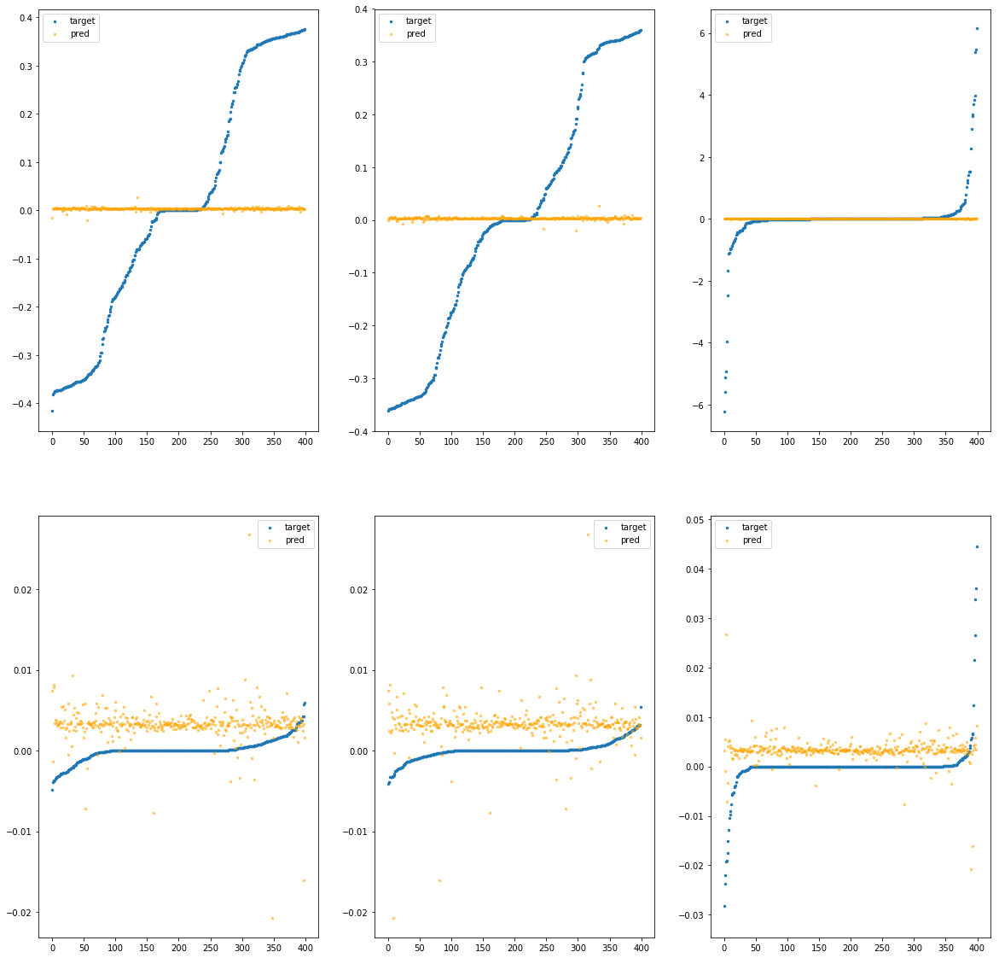

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be8af0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.83e-04	4.02e-01	2.06e-01	2.77e+03	6.41e-02	4.11e-03
y		1.33e-03	3.66e-01	1.88e-01	3.70e+02	5.47e-02	3.00e-03
z		-1.71e-03	6.23e+00	2.78e-01	1.97e+02	8.76e-01	7.68e-01
phi		-1.44e+01	2.73e-02	4.73e-03	1.08e+06	2.88e-05	8.27e-10
theta		-2.08e+01	2.75e-02	4.72e-03	3.75e+05	2.77e-05	7.69e-10
psi		-1.10e+00	4.70e-02	5.46e-03	1.22e+05	5.16e-05	2.67e-09


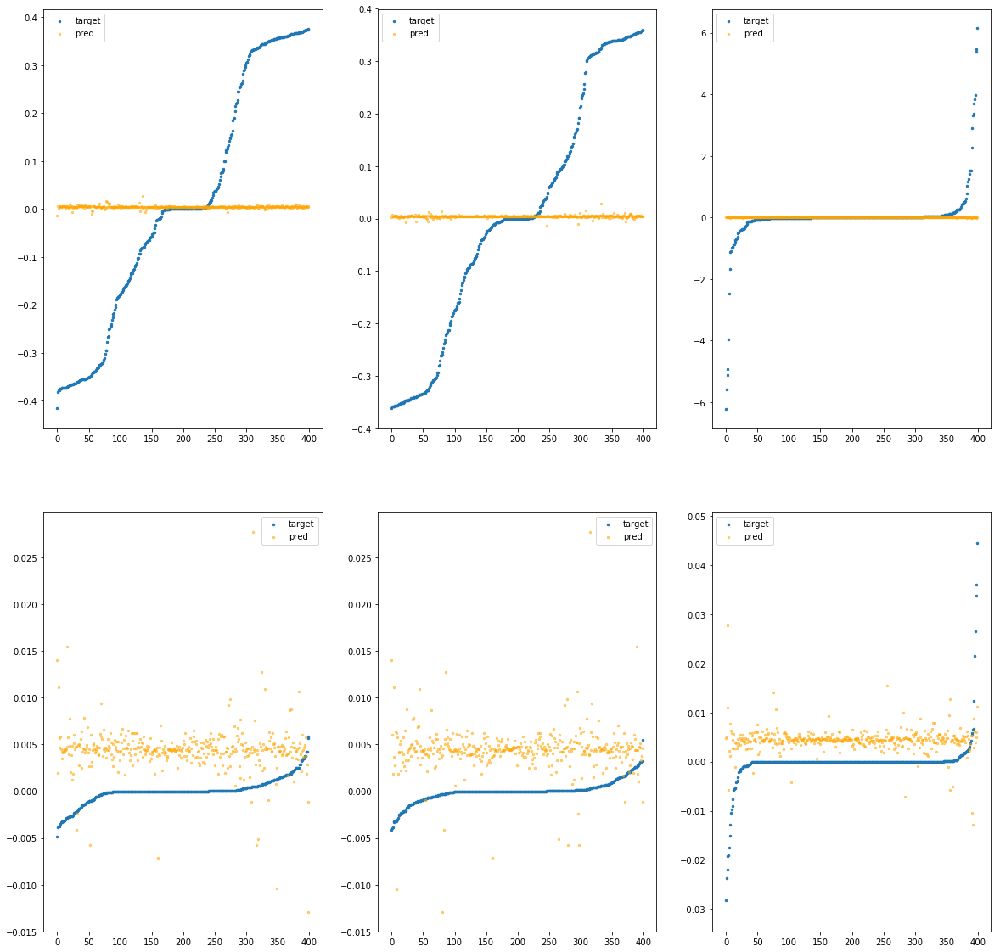

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be8b50>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-3.27e-03	3.84e-01	2.06e-01	4.34e+03	6.43e-02	4.14e-03
y		-2.19e-03	3.68e-01	1.88e-01	5.82e+02	5.49e-02	3.02e-03
z		-2.54e-03	6.21e+00	2.79e-01	3.05e+02	8.77e-01	7.69e-01
phi		-3.51e+01	3.67e-02	7.49e-03	1.65e+06	6.72e-05	4.52e-09
theta		-5.01e+01	3.07e-02	7.43e-03	5.93e+05	6.49e-05	4.22e-09
psi		-2.51e+00	4.66e-02	7.88e-03	1.98e+05	8.61e-05	7.41e-09


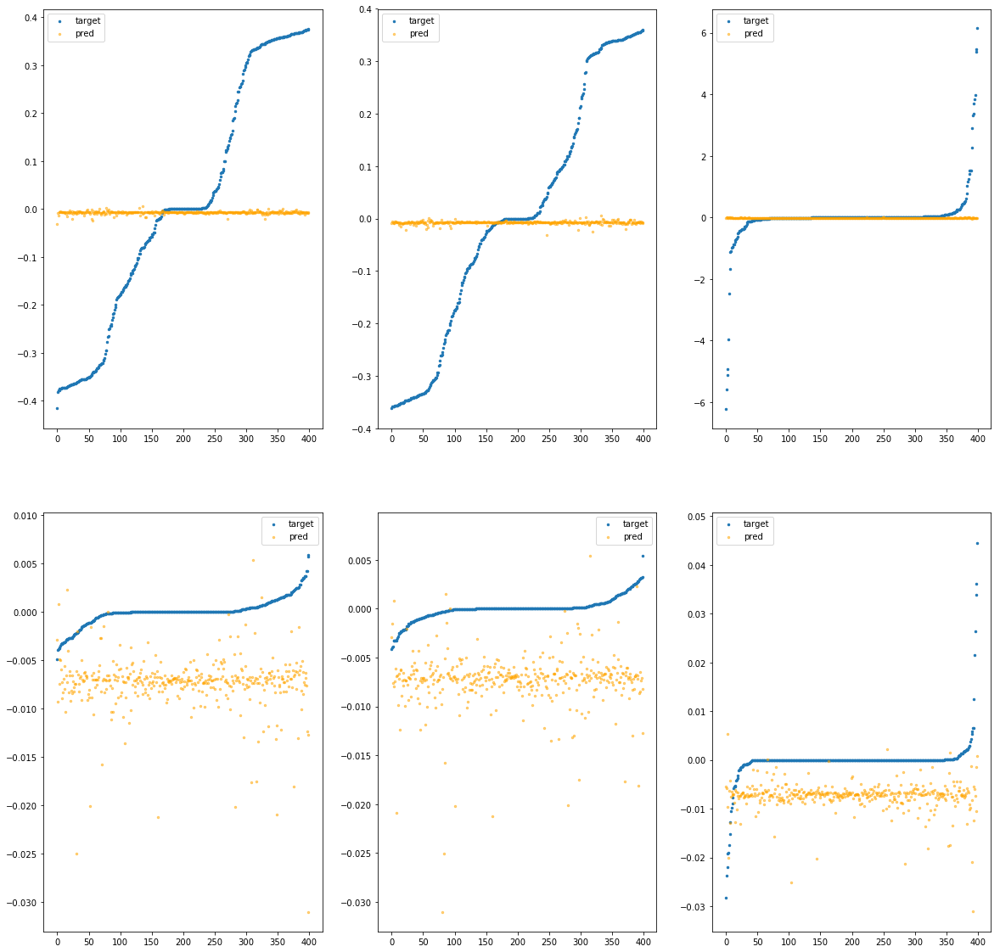

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be8bb0>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-4.22e-03	4.02e-01	2.06e-01	2.64e+03	6.44e-02	4.15e-03
y		-3.06e-03	3.66e-01	1.88e-01	3.49e+02	5.50e-02	3.02e-03
z		-2.16e-03	6.22e+00	2.78e-01	1.86e+02	8.77e-01	7.69e-01
phi		-1.55e+01	1.85e-02	4.79e-03	9.88e+05	3.07e-05	9.40e-10
theta		-2.22e+01	1.85e-02	4.80e-03	3.57e+05	2.95e-05	8.71e-10
psi		-1.00e+00	4.30e-02	5.26e-03	1.18e+05	4.91e-05	2.41e-09


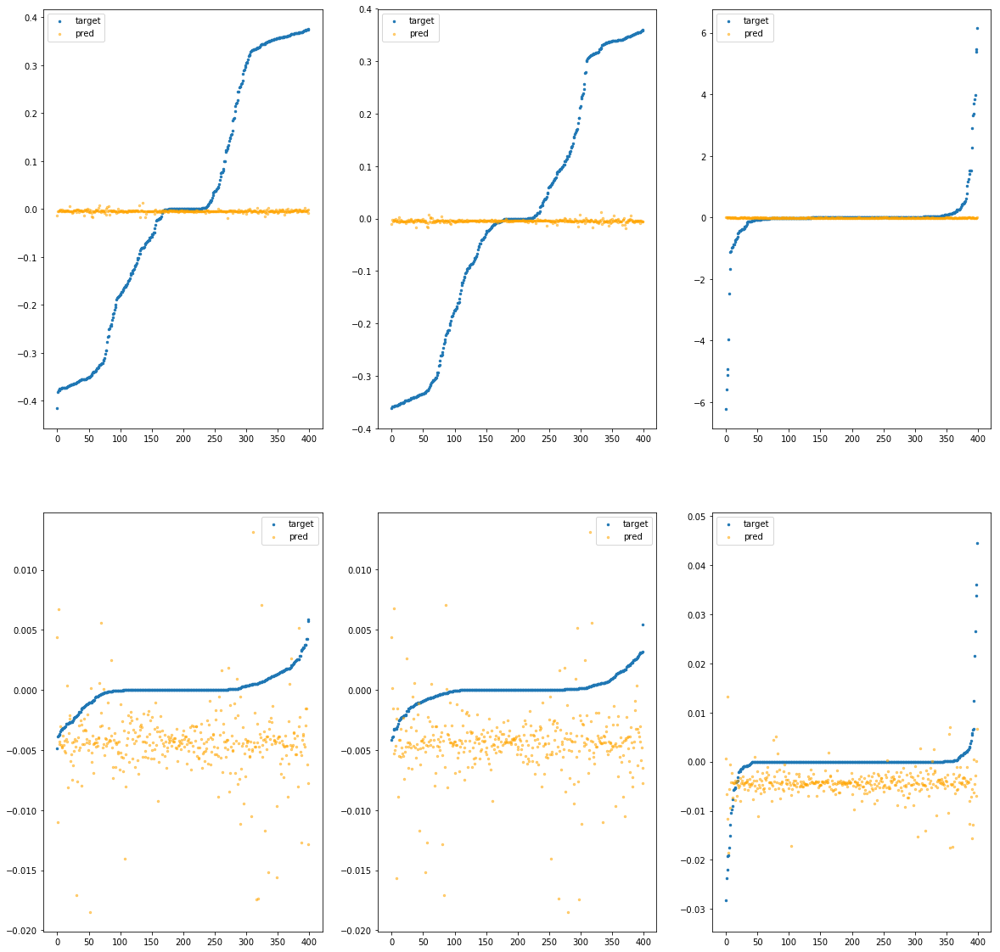

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.nadam.Nadam object at 0x7fba51be8c10>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.02e-03	4.15e-01	2.05e-01	8.77e+01	6.42e-02	4.13e-03
y		-1.01e-03	3.61e-01	1.88e-01	1.15e+01	5.49e-02	3.01e-03
z		-1.01e-03	6.23e+00	2.77e-01	7.31e+00	8.76e-01	7.67e-01
phi		-4.00e-02	5.92e-03	8.65e-04	3.05e+04	1.94e-06	3.75e-12
theta		-1.26e-02	5.41e-03	7.00e-04	9.83e+03	1.29e-06	1.65e-12
psi		-8.06e-04	4.45e-02	1.39e-03	4.19e+03	2.46e-05	6.03e-10


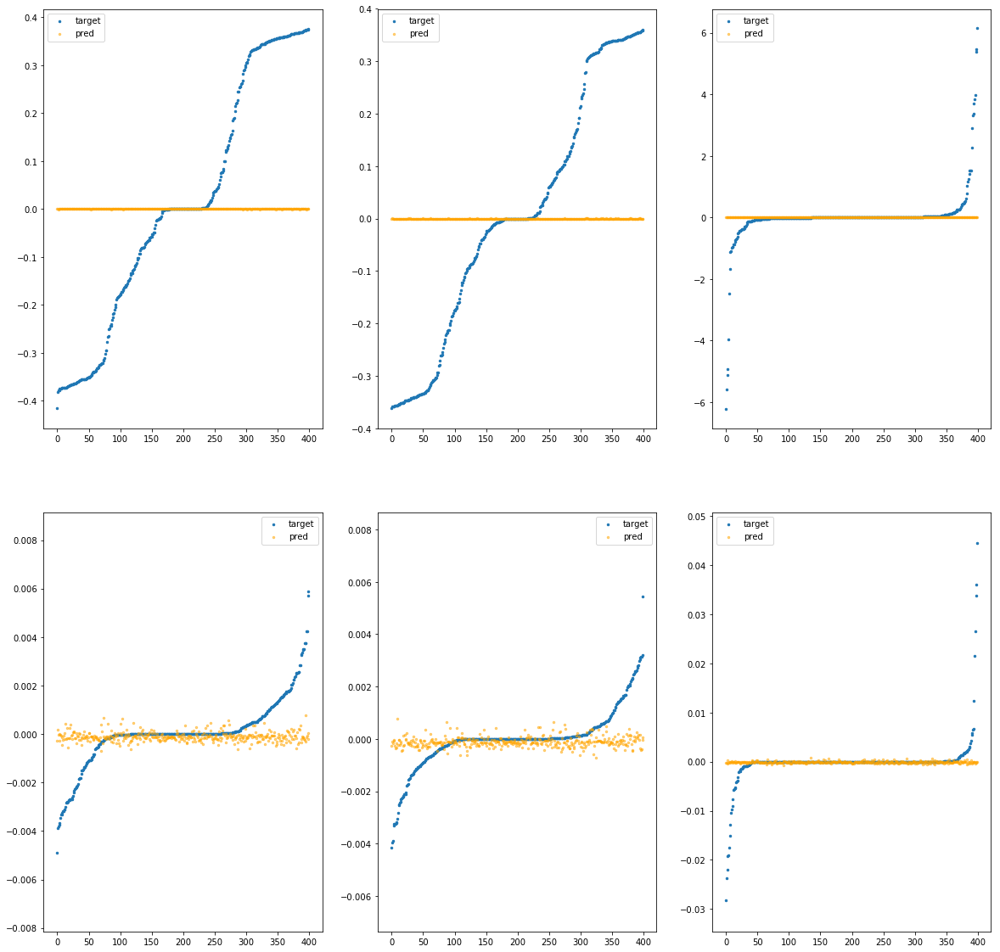

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51be8c70>, epochs=30, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.03e-03	4.15e-01	2.05e-01	1.25e+02	6.42e-02	4.13e-03
y		-1.14e-03	3.61e-01	1.88e-01	1.75e+01	5.49e-02	3.01e-03
z		-9.74e-04	6.23e+00	2.77e-01	9.43e+00	8.76e-01	7.67e-01
phi		-3.61e-02	6.09e-03	8.80e-04	4.75e+04	1.93e-06	3.72e-12
theta		-3.59e-02	5.66e-03	7.27e-04	1.71e+04	1.32e-06	1.73e-12
psi		-1.22e-03	4.46e-02	1.40e-03	5.53e+03	2.46e-05	6.03e-10


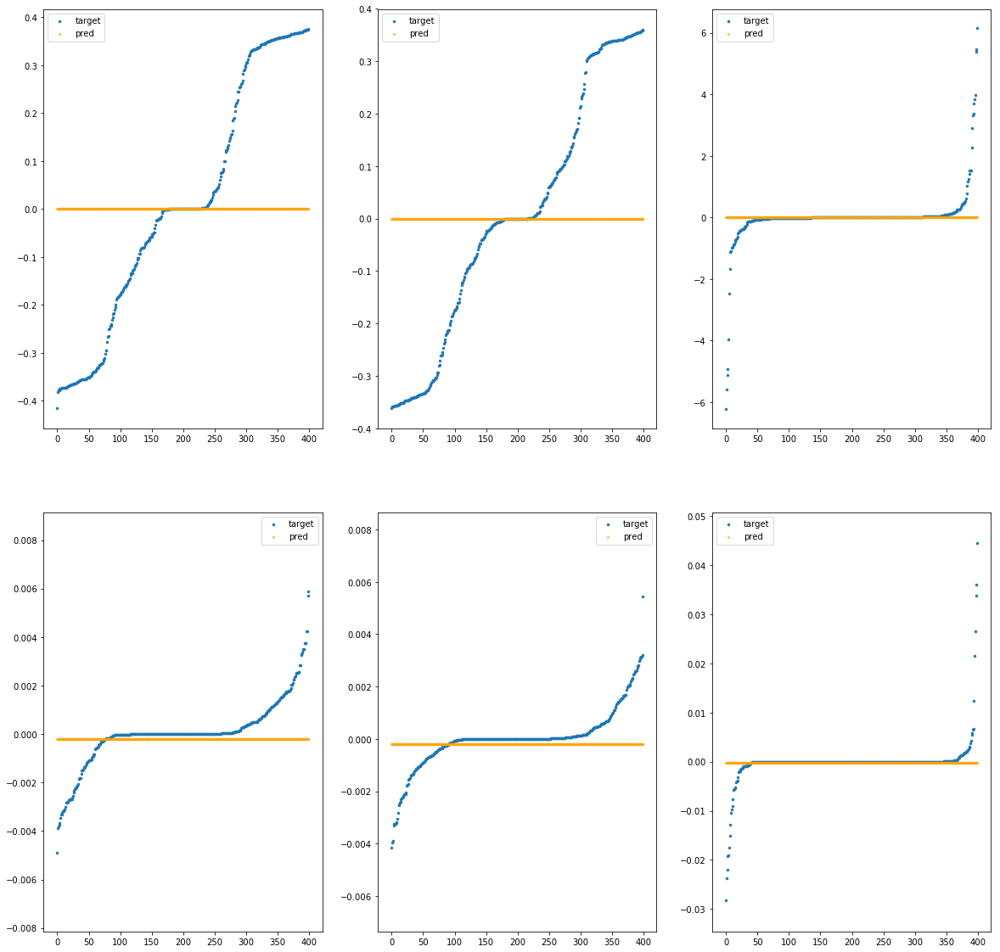

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51be8cd0>, epochs=30, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	7.80e+01	6.42e-02	4.13e-03
y		-1.12e-03	3.61e-01	1.88e-01	1.12e+01	5.49e-02	3.01e-03
z		-9.69e-04	6.23e+00	2.77e-01	6.17e+00	8.76e-01	7.67e-01
phi		-1.80e-02	6.01e-03	8.35e-04	2.95e+04	1.89e-06	3.59e-12
theta		-1.48e-02	5.58e-03	6.86e-04	1.06e+04	1.29e-06	1.66e-12
psi		-3.82e-04	4.45e-02	1.34e-03	3.44e+03	2.45e-05	6.02e-10


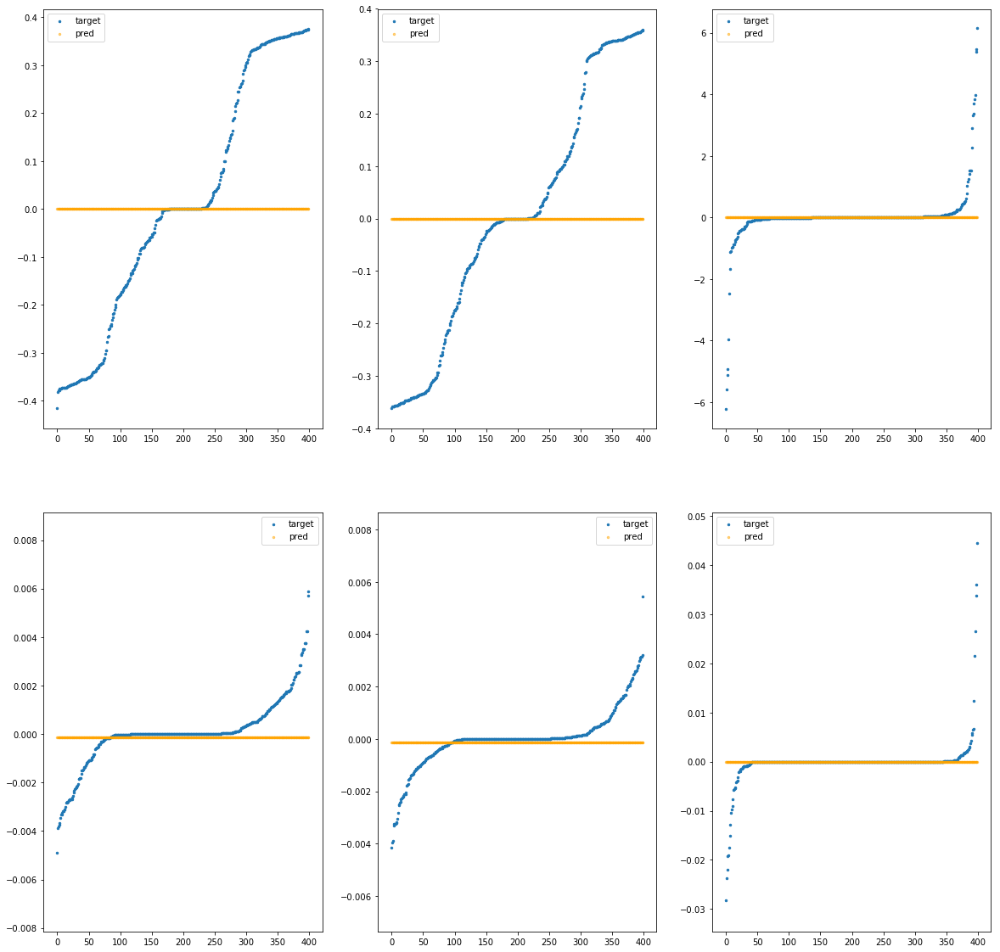

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51be8d30>, epochs=30, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.95e-03	4.15e-01	2.05e-01	2.49e+01	6.42e-02	4.13e-03
y		-1.07e-03	3.61e-01	1.88e-01	4.10e+00	5.49e-02	3.01e-03
z		-9.58e-04	6.23e+00	2.77e-01	2.56e+00	8.76e-01	7.67e-01
phi		-1.97e-04	5.85e-03	7.81e-04	9.14e+03	1.86e-06	3.47e-12
theta		-5.52e-04	5.42e-03	6.37e-04	3.29e+03	1.27e-06	1.61e-12
psi		-1.83e-04	4.44e-02	1.27e-03	1.07e+03	2.45e-05	6.02e-10


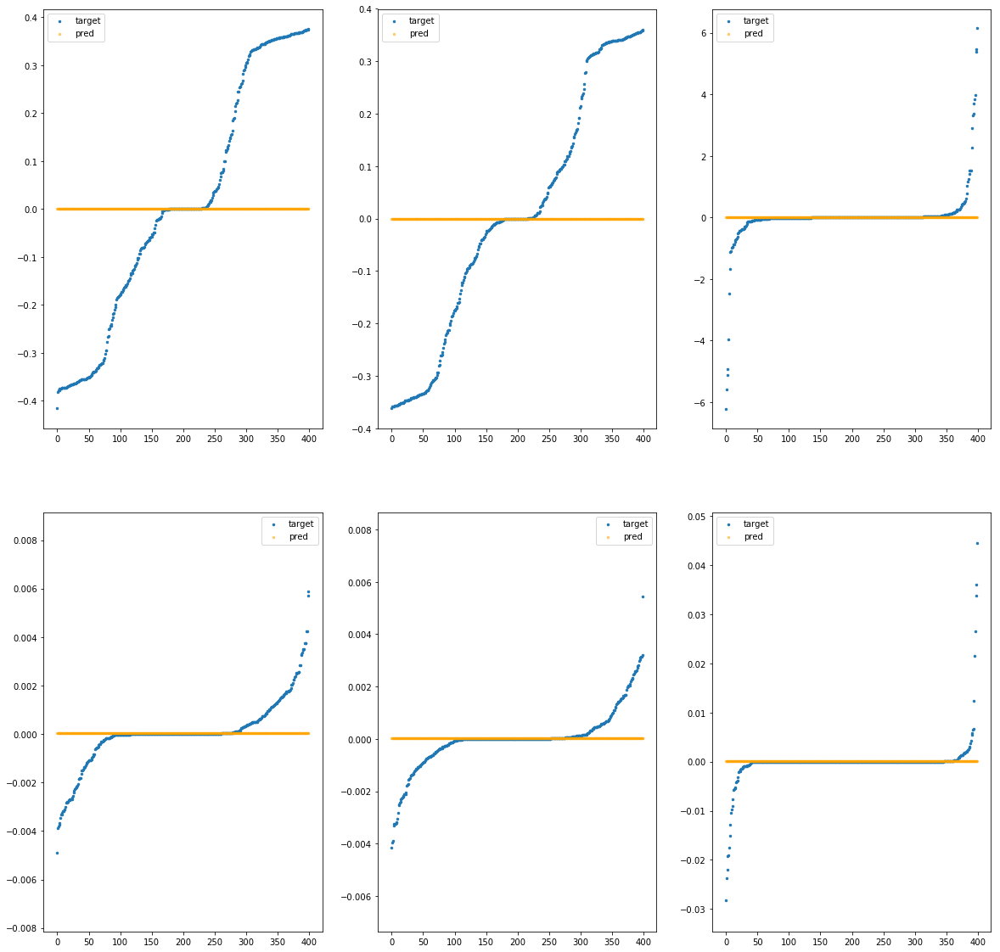

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51be8d90>, epochs=30, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.96e-03	4.15e-01	2.05e-01	1.71e+00	6.42e-02	4.13e-03
y		-1.08e-03	3.61e-01	1.88e-01	1.06e+00	5.49e-02	3.01e-03
z		-9.61e-04	6.23e+00	2.77e-01	1.03e+00	8.76e-01	7.67e-01
phi		-1.73e-03	5.89e-03	7.70e-04	2.73e+02	1.86e-06	3.48e-12
theta		-9.77e-05	5.45e-03	6.27e-04	9.86e+01	1.27e-06	1.61e-12
psi		-3.52e-05	4.44e-02	1.25e-03	3.19e+01	2.45e-05	6.02e-10


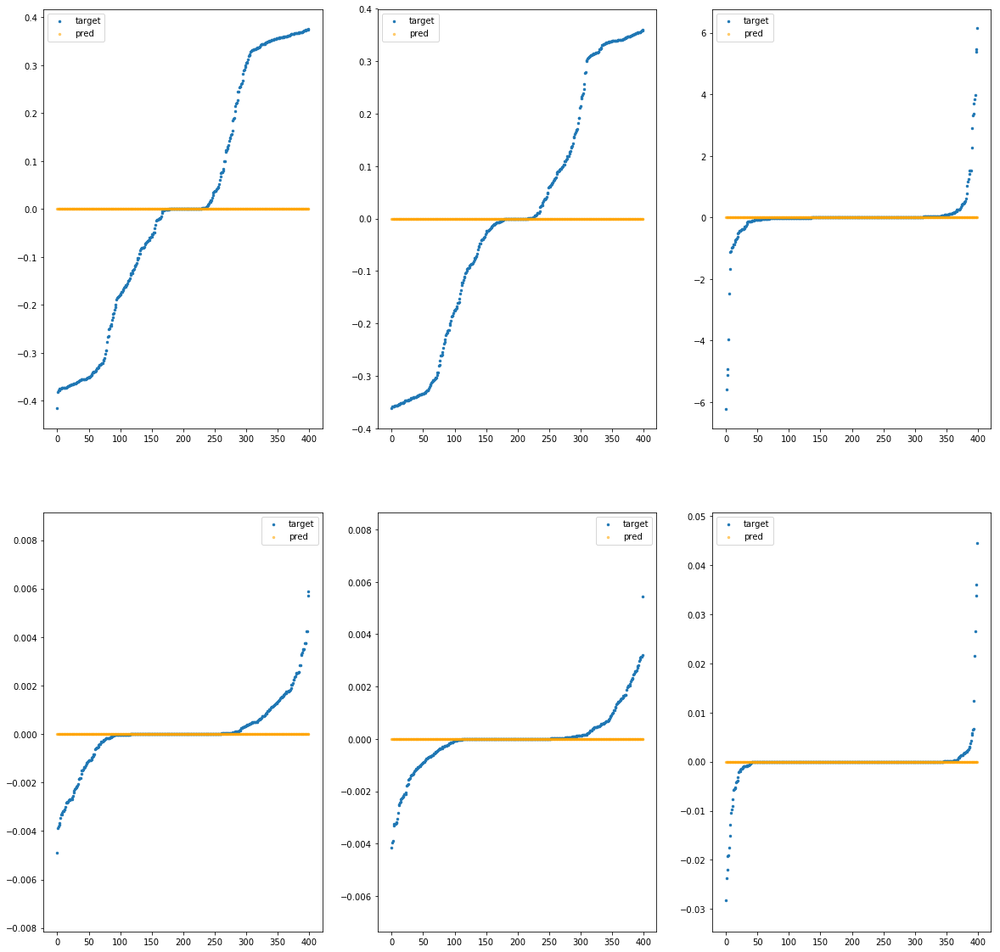

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51be8df0>, epochs=30, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-9.14e-04	4.19e-01	2.06e-01	2.20e+03	6.42e-02	4.12e-03
y		-3.14e-04	3.65e-01	1.88e-01	2.93e+02	5.48e-02	3.01e-03
z		-7.39e-04	6.23e+00	2.78e-01	1.54e+02	8.76e-01	7.67e-01
phi		-6.60e+00	8.44e-03	3.54e-03	8.40e+05	1.41e-05	2.00e-10
theta		-9.92e+00	7.71e-03	3.56e-03	3.02e+05	1.39e-05	1.92e-10
psi		-5.25e-01	4.09e-02	4.41e-03	9.79e+04	3.74e-05	1.40e-09


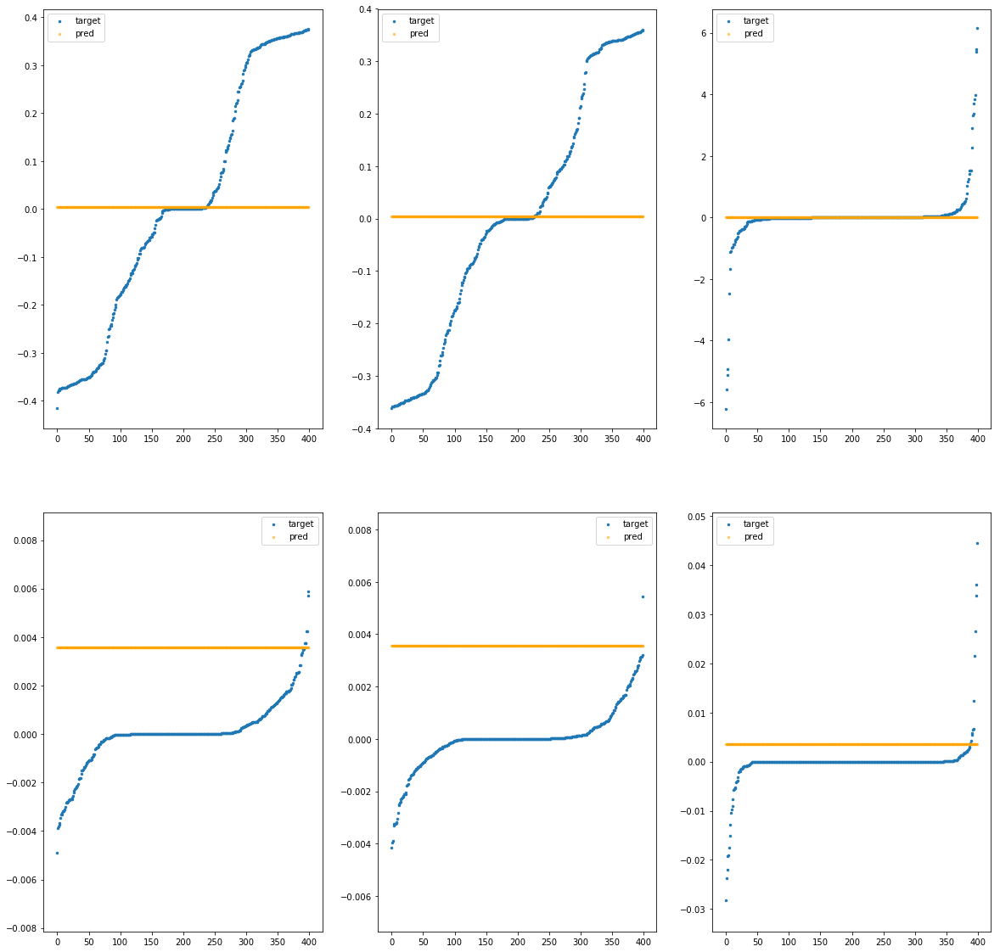

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51be8e50>, epochs=50, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.03e-03	4.15e-01	2.05e-01	1.16e+02	6.42e-02	4.13e-03
y		-1.14e-03	3.61e-01	1.88e-01	1.62e+01	5.49e-02	3.01e-03
z		-9.73e-04	6.23e+00	2.77e-01	8.79e+00	8.76e-01	7.67e-01
phi		-3.21e-02	6.07e-03	8.71e-04	4.39e+04	1.92e-06	3.69e-12
theta		-3.11e-02	5.64e-03	7.18e-04	1.58e+04	1.31e-06	1.71e-12
psi		-1.02e-03	4.46e-02	1.39e-03	5.12e+03	2.46e-05	6.03e-10


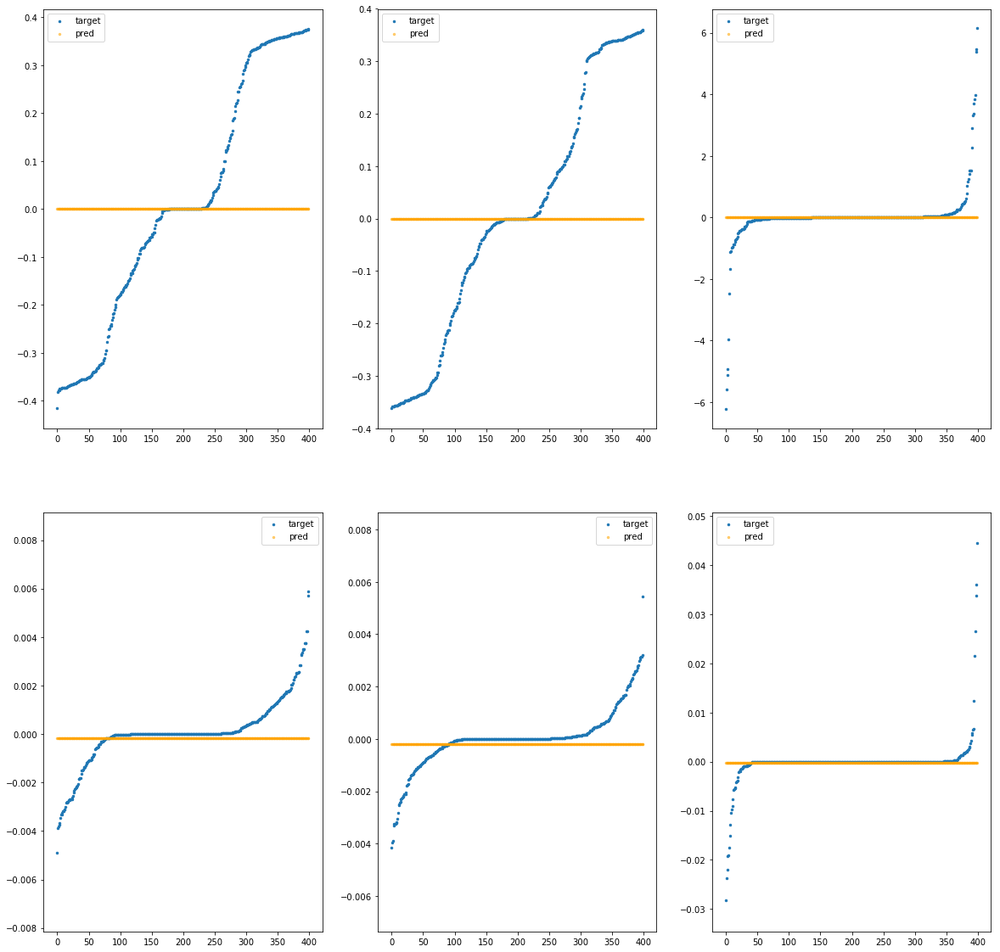

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51be8eb0>, epochs=50, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.03e-03	4.15e-01	2.05e-01	1.13e+02	6.42e-02	4.13e-03
y		-1.14e-03	3.61e-01	1.88e-01	1.58e+01	5.49e-02	3.01e-03
z		-9.73e-04	6.23e+00	2.77e-01	8.58e+00	8.76e-01	7.67e-01
phi		-3.08e-02	6.07e-03	8.68e-04	4.28e+04	1.92e-06	3.68e-12
theta		-2.95e-02	5.64e-03	7.16e-04	1.54e+04	1.31e-06	1.71e-12
psi		-9.56e-04	4.46e-02	1.39e-03	4.99e+03	2.46e-05	6.03e-10


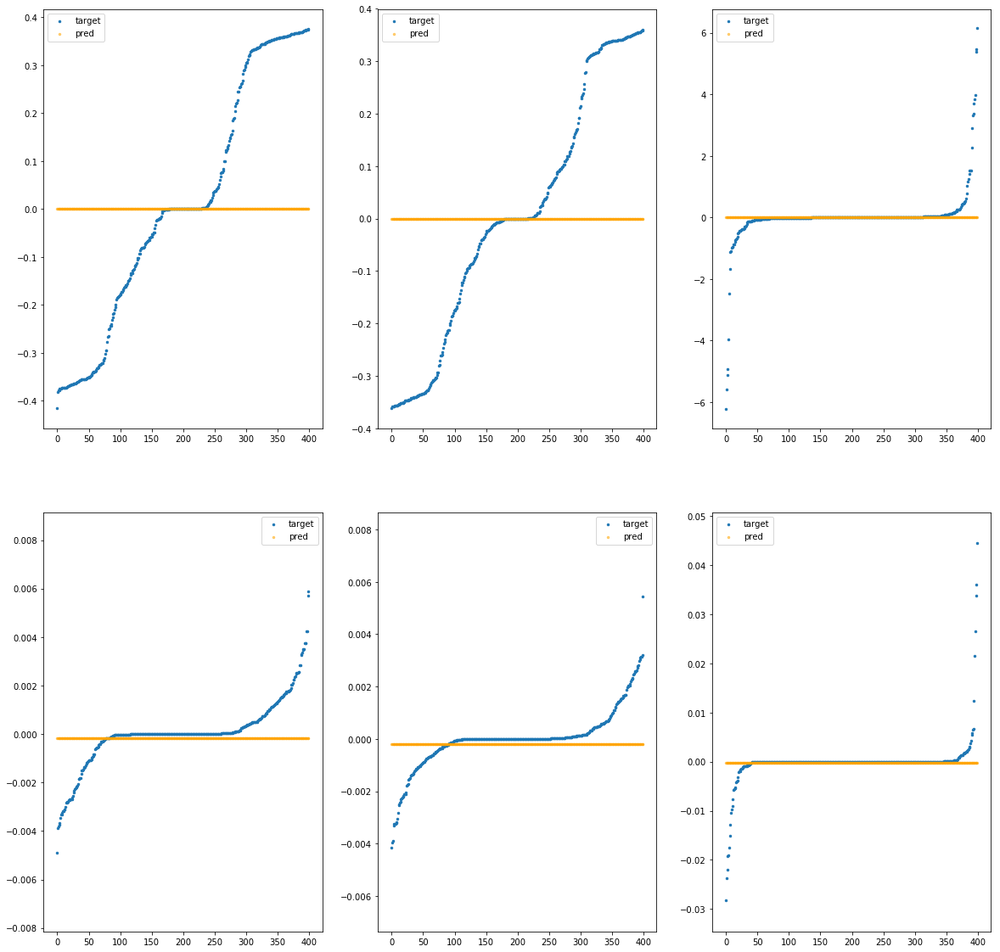

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51be8f10>, epochs=50, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	8.83e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.26e+01	5.49e-02	3.01e-03
z		-9.70e-04	6.23e+00	2.77e-01	6.89e+00	8.76e-01	7.67e-01
phi		-2.14e-02	6.03e-03	8.45e-04	3.34e+04	1.90e-06	3.61e-12
theta		-1.87e-02	5.60e-03	6.94e-04	1.20e+04	1.29e-06	1.67e-12
psi		-5.25e-04	4.46e-02	1.36e-03	3.90e+03	2.45e-05	6.02e-10


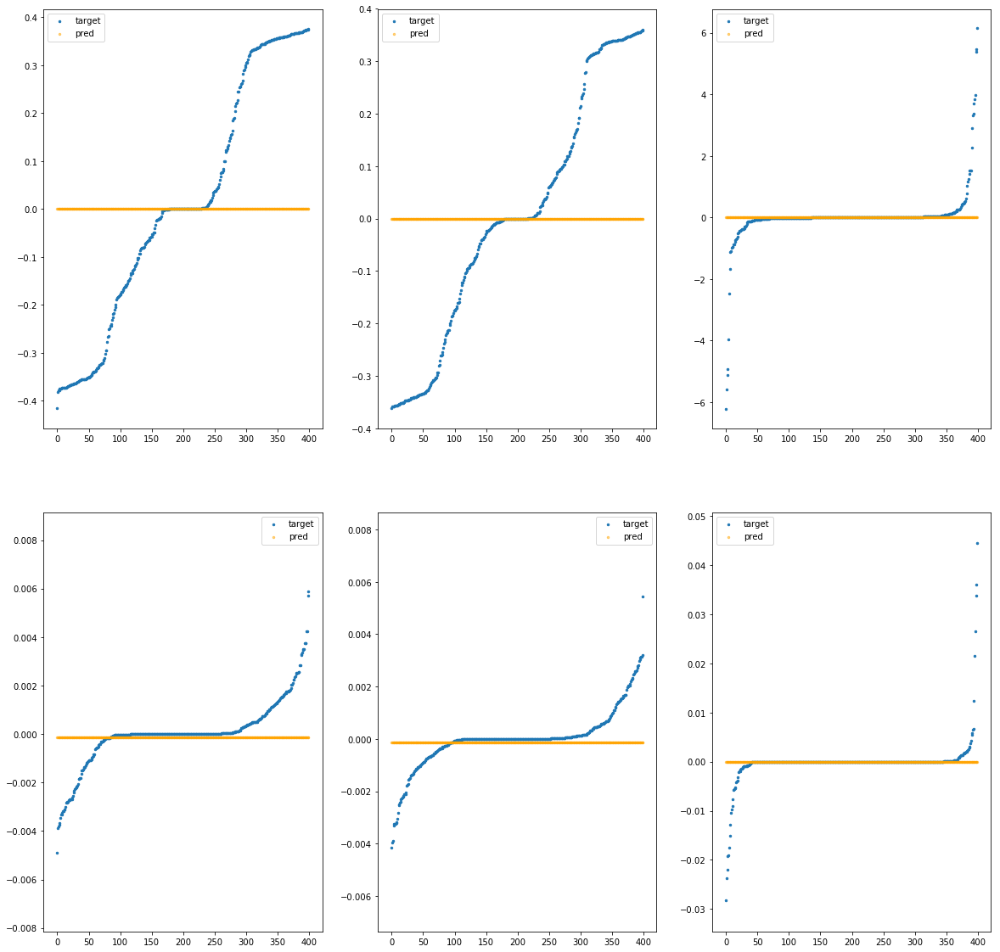

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51be8f70>, epochs=50, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.98e-03	4.15e-01	2.05e-01	3.98e+01	6.42e-02	4.13e-03
y		-1.10e-03	3.61e-01	1.88e-01	6.13e+00	5.49e-02	3.01e-03
z		-9.65e-04	6.23e+00	2.77e-01	3.54e+00	8.76e-01	7.67e-01
phi		-7.88e-03	5.95e-03	8.00e-04	1.49e+04	1.88e-06	3.52e-12
theta		-4.48e-03	5.52e-03	6.54e-04	5.36e+03	1.28e-06	1.63e-12
psi		-4.97e-05	4.45e-02	1.29e-03	1.74e+03	2.45e-05	6.02e-10


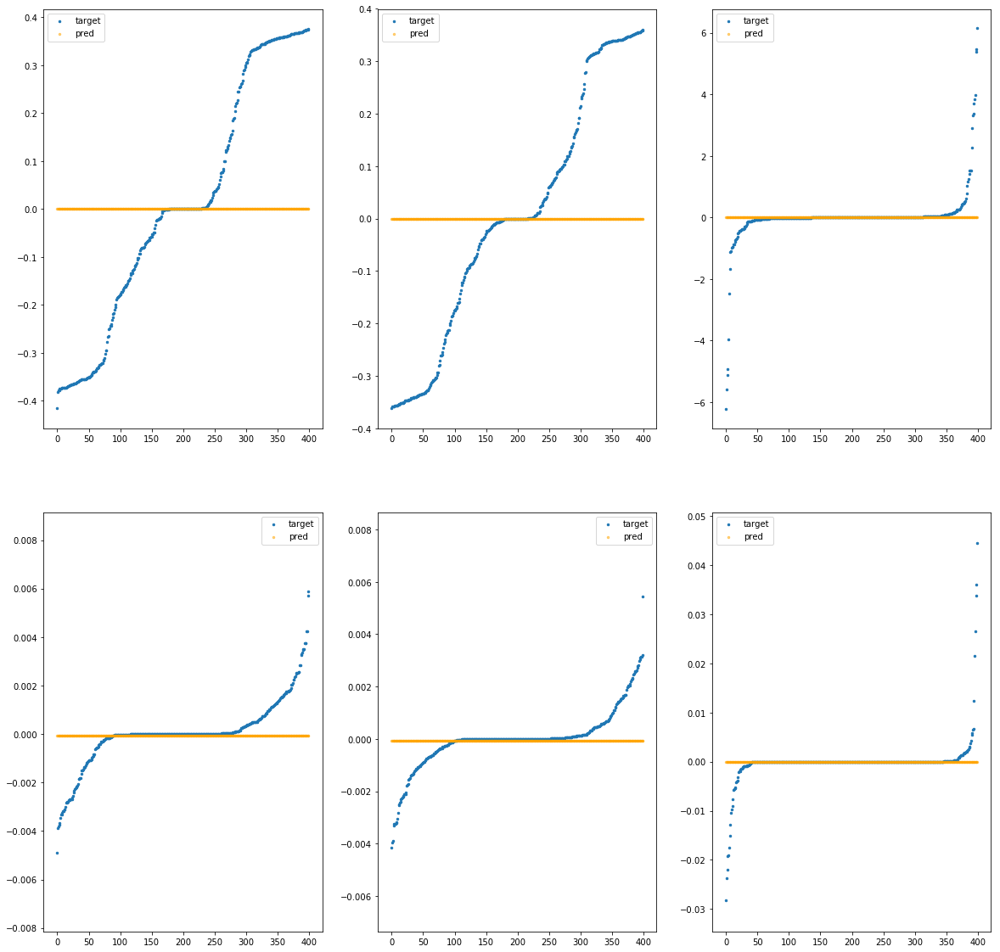

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51be8fd0>, epochs=50, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.02e-03	4.15e-01	2.05e-01	9.90e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.40e+01	5.49e-02	3.01e-03
z		-9.72e-04	6.23e+00	2.77e-01	7.63e+00	8.76e-01	7.67e-01
phi		-2.53e-02	6.05e-03	8.55e-04	3.75e+04	1.91e-06	3.64e-12
theta		-2.31e-02	5.61e-03	7.04e-04	1.35e+04	1.30e-06	1.69e-12
psi		-6.98e-04	4.46e-02	1.37e-03	4.37e+03	2.45e-05	6.03e-10


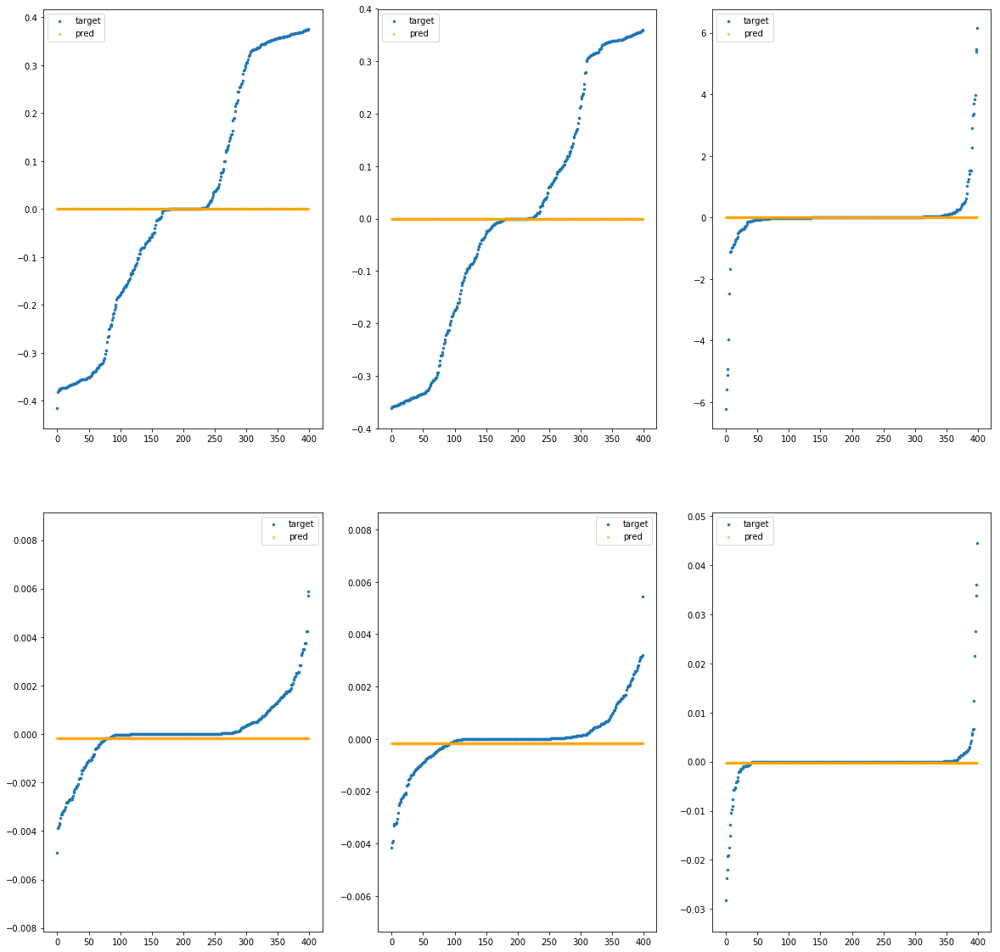

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bf2070>, epochs=75, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-1.97e-03	4.15e-01	2.05e-01	2.23e+01	6.42e-02	4.13e-03
y		-1.09e-03	3.61e-01	1.88e-01	3.82e+00	5.49e-02	3.01e-03
z		-9.63e-04	6.23e+00	2.77e-01	2.35e+00	8.76e-01	7.67e-01
phi		-4.61e-03	5.92e-03	7.85e-04	8.20e+03	1.87e-06	3.50e-12
theta		-1.74e-03	5.49e-03	6.41e-04	2.95e+03	1.27e-06	1.62e-12
psi		-1.73e-06	4.45e-02	1.27e-03	9.56e+02	2.45e-05	6.02e-10


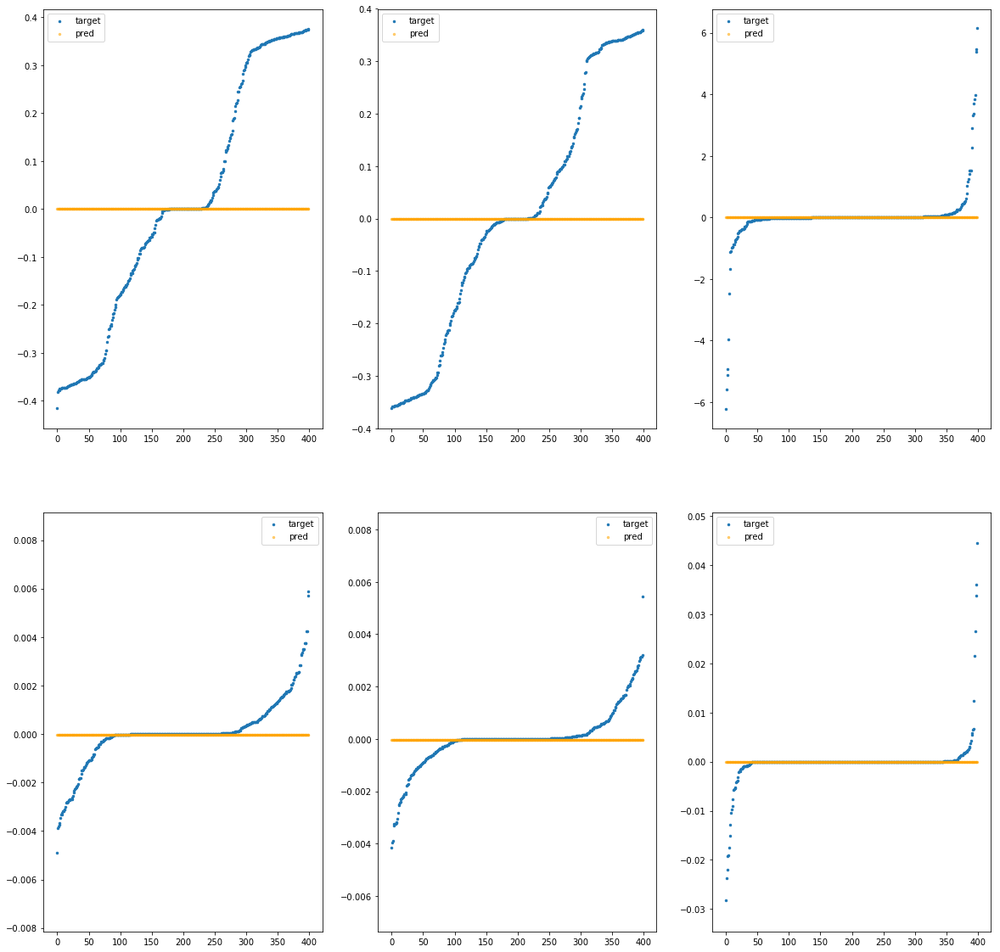

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bf20d0>, epochs=75, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.03e-03	4.15e-01	2.05e-01	1.15e+02	6.42e-02	4.13e-03
y		-1.14e-03	3.61e-01	1.88e-01	1.62e+01	5.49e-02	3.01e-03
z		-9.73e-04	6.23e+00	2.77e-01	8.75e+00	8.76e-01	7.67e-01
phi		-3.18e-02	6.07e-03	8.71e-04	4.37e+04	1.92e-06	3.69e-12
theta		-3.08e-02	5.64e-03	7.18e-04	1.57e+04	1.31e-06	1.71e-12
psi		-1.01e-03	4.46e-02	1.39e-03	5.10e+03	2.46e-05	6.03e-10


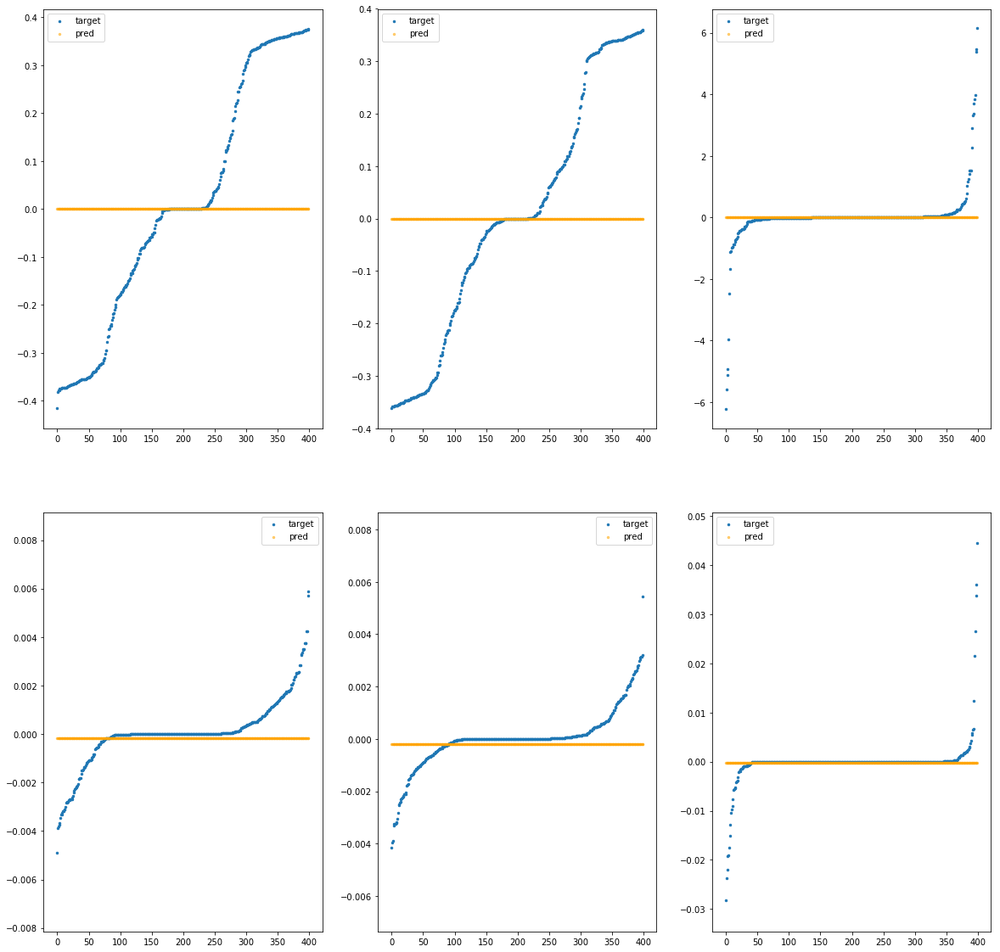

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bf2130>, epochs=75, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.15e-03	4.15e-01	2.05e-01	3.31e+02	6.43e-02	4.13e-03
y		-1.24e-03	3.61e-01	1.88e-01	4.49e+01	5.49e-02	3.01e-03
z		-9.97e-04	6.23e+00	2.77e-01	2.37e+01	8.76e-01	7.67e-01
phi		-1.89e-01	6.42e-03	1.10e-03	1.26e+05	2.21e-06	4.90e-12
theta		-2.36e-01	5.99e-03	9.29e-04	4.54e+04	1.57e-06	2.47e-12
psi		-1.05e-02	4.50e-02	1.67e-03	1.47e+04	2.48e-05	6.14e-10


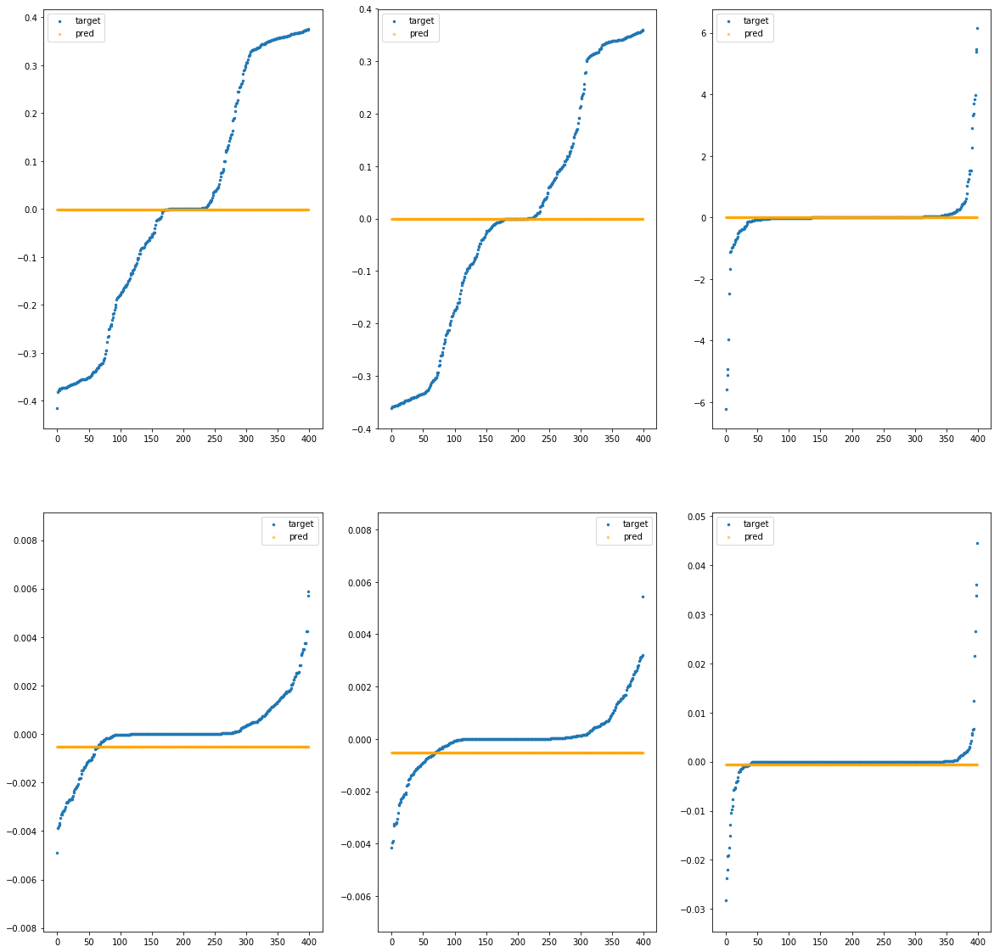

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bf2190>, epochs=75, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.00e-03	4.15e-01	2.05e-01	7.53e+01	6.42e-02	4.13e-03
y		-1.12e-03	3.61e-01	1.88e-01	1.08e+01	5.49e-02	3.01e-03
z		-9.69e-04	6.23e+00	2.77e-01	5.99e+00	8.76e-01	7.67e-01
phi		-1.71e-02	6.01e-03	8.32e-04	2.85e+04	1.89e-06	3.58e-12
theta		-1.39e-02	5.57e-03	6.83e-04	1.02e+04	1.29e-06	1.66e-12
psi		-3.49e-04	4.45e-02	1.34e-03	3.32e+03	2.45e-05	6.02e-10


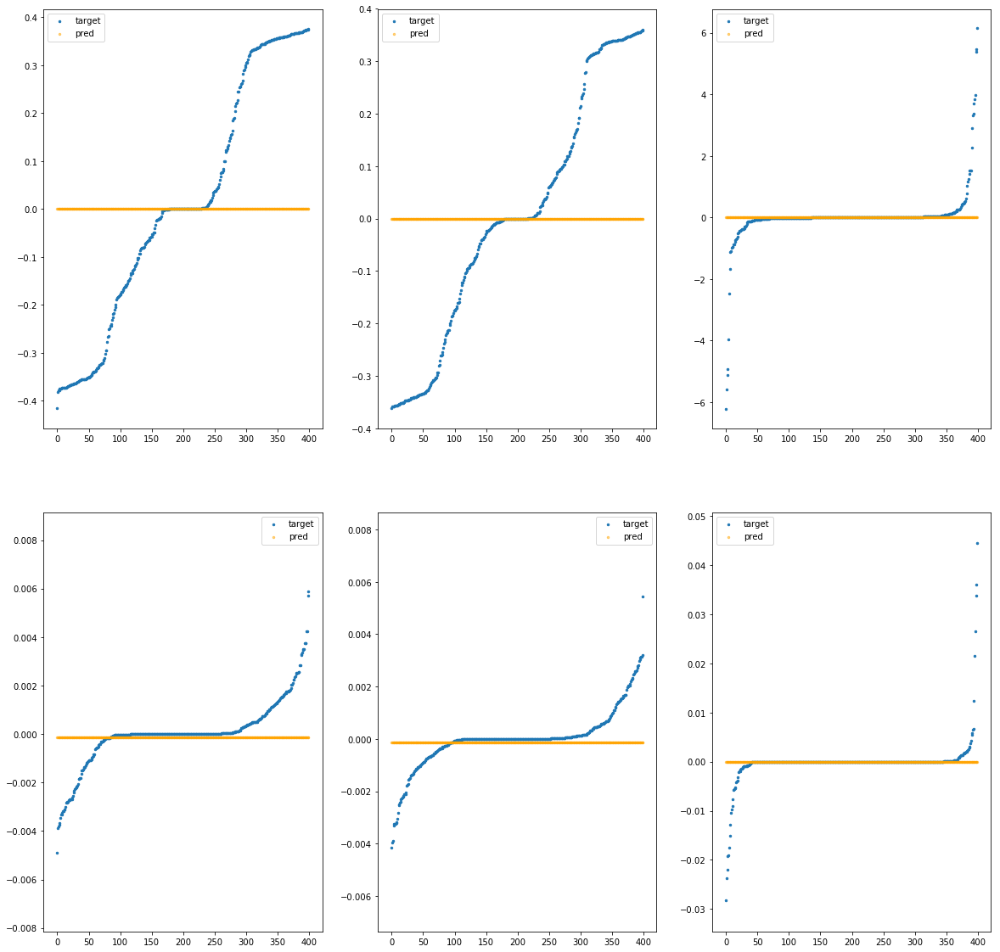

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bf21f0>, epochs=75, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.02e-03	4.15e-01	2.05e-01	9.53e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.35e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.37e+00	8.76e-01	7.67e-01
phi		-2.39e-02	6.04e-03	8.51e-04	3.61e+04	1.91e-06	3.63e-12
theta		-2.15e-02	5.61e-03	7.00e-04	1.30e+04	1.30e-06	1.68e-12
psi		-6.35e-04	4.46e-02	1.37e-03	4.21e+03	2.45e-05	6.03e-10


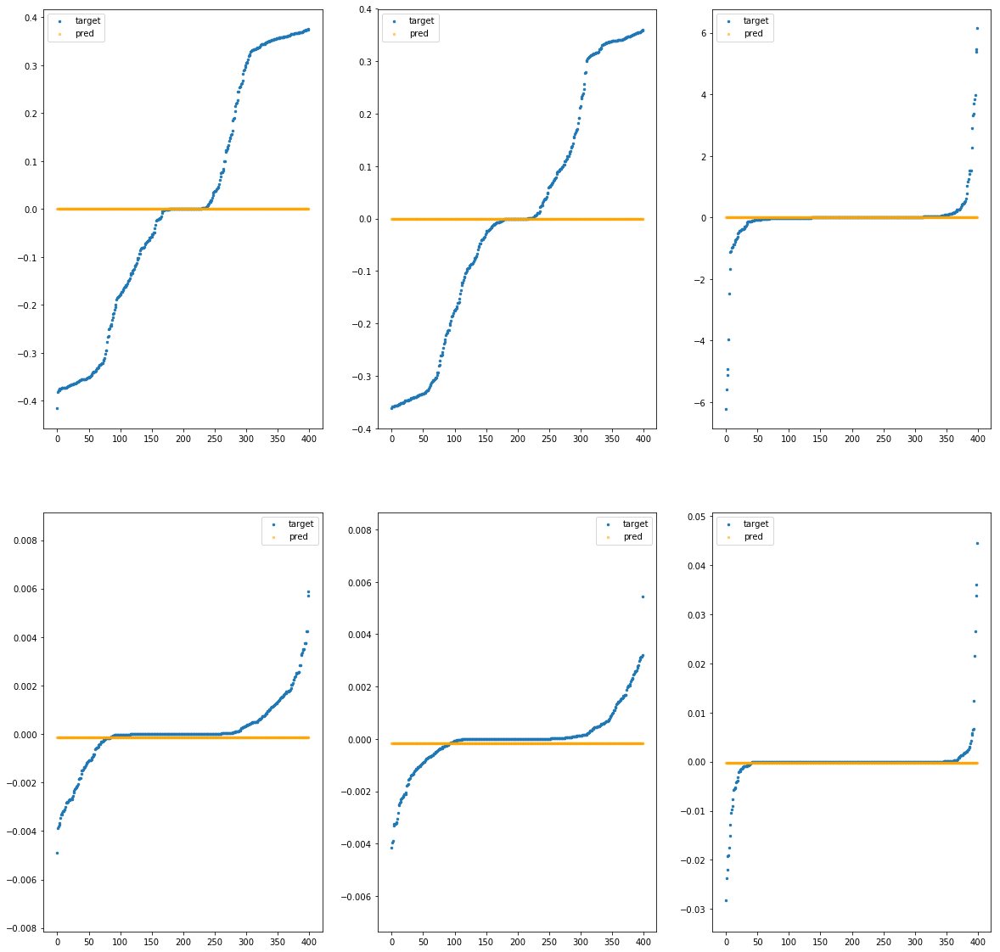

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bf2250>, epochs=100, batch_size=12
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.00e-03	4.15e-01	2.05e-01	7.36e+01	6.42e-02	4.13e-03
y		-1.12e-03	3.61e-01	1.88e-01	1.06e+01	5.49e-02	3.01e-03
z		-9.69e-04	6.23e+00	2.77e-01	5.87e+00	8.76e-01	7.67e-01
phi		-1.66e-02	6.01e-03	8.31e-04	2.78e+04	1.89e-06	3.58e-12
theta		-1.34e-02	5.57e-03	6.82e-04	1.00e+04	1.29e-06	1.66e-12
psi		-3.28e-04	4.45e-02	1.34e-03	3.24e+03	2.45e-05	6.02e-10


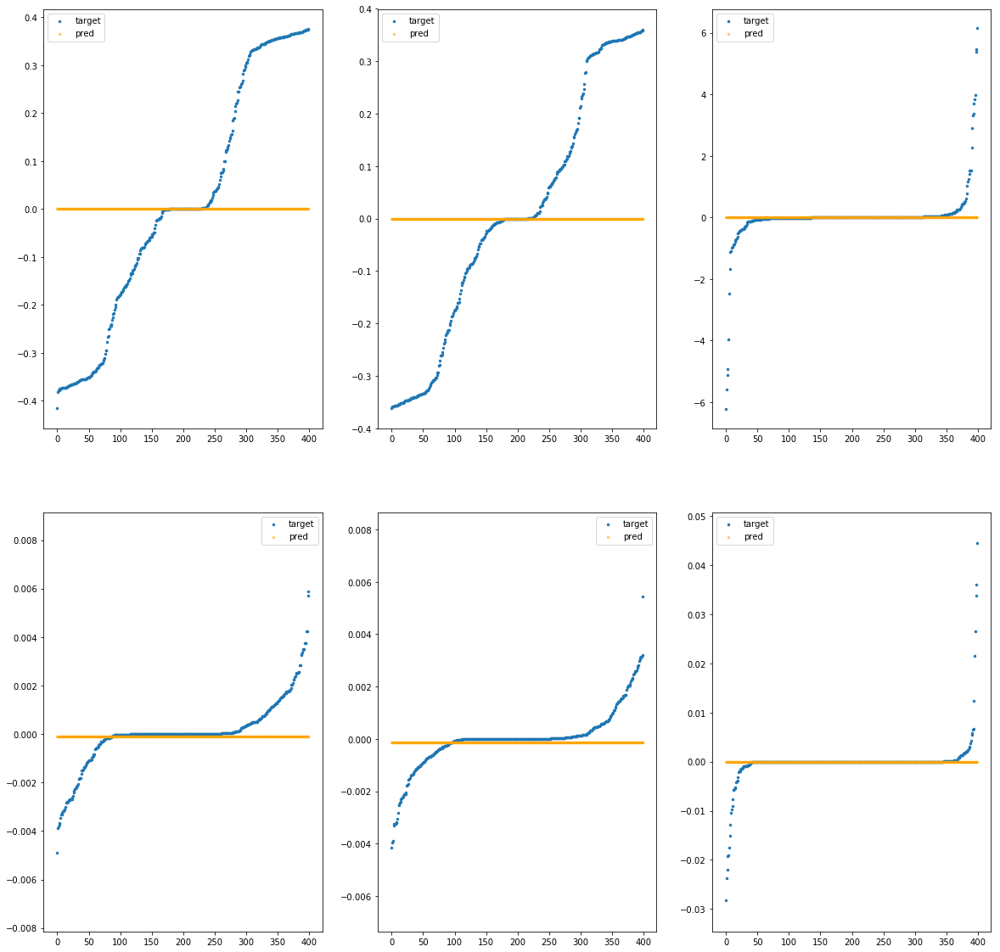

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bf22b0>, epochs=100, batch_size=18
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.03e-03	4.15e-01	2.05e-01	1.17e+02	6.42e-02	4.13e-03
y		-1.14e-03	3.61e-01	1.88e-01	1.63e+01	5.49e-02	3.01e-03
z		-9.73e-04	6.23e+00	2.77e-01	8.85e+00	8.76e-01	7.67e-01
phi		-3.24e-02	6.08e-03	8.72e-04	4.42e+04	1.92e-06	3.69e-12
theta		-3.15e-02	5.64e-03	7.19e-04	1.59e+04	1.31e-06	1.72e-12
psi		-1.04e-03	4.46e-02	1.39e-03	5.16e+03	2.46e-05	6.03e-10


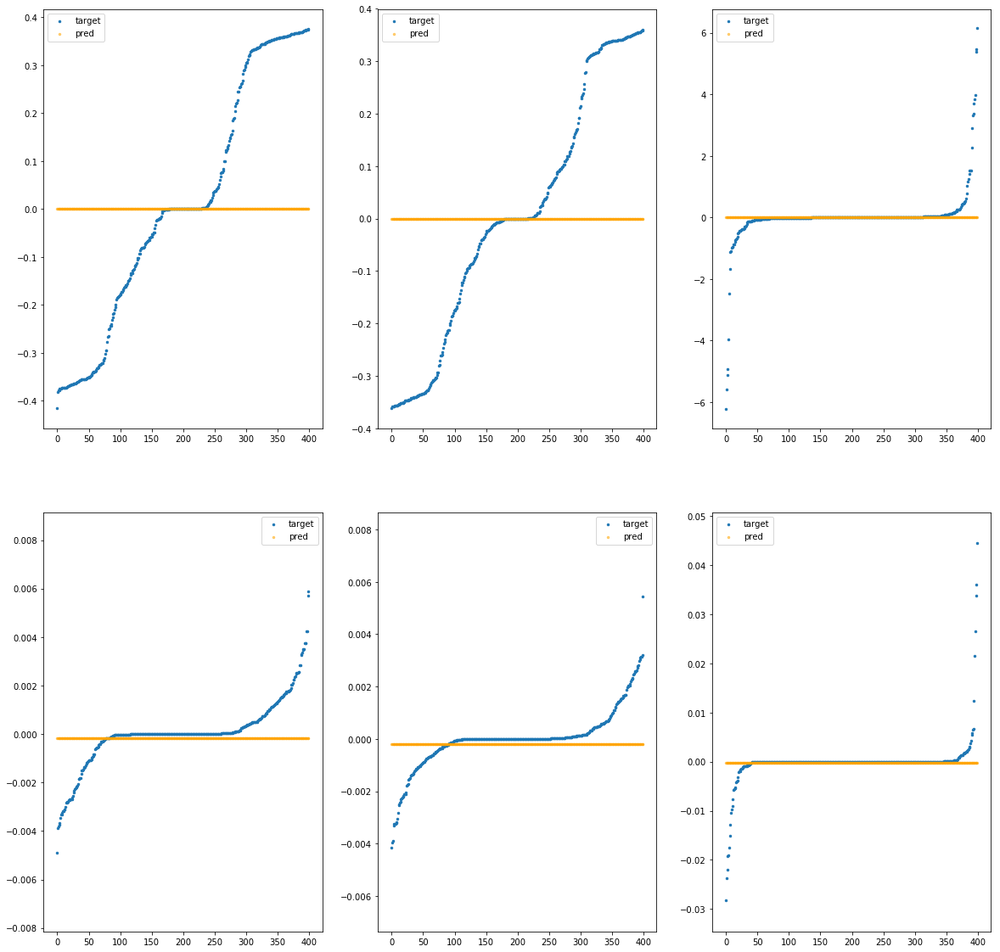

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bf2310>, epochs=100, batch_size=24
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.08e-03	4.15e-01	2.05e-01	2.00e+02	6.42e-02	4.13e-03
y		-1.18e-03	3.61e-01	1.88e-01	2.75e+01	5.49e-02	3.01e-03
z		-9.83e-04	6.23e+00	2.77e-01	1.46e+01	8.76e-01	7.67e-01
phi		-7.80e-02	6.21e-03	9.57e-04	7.62e+04	2.01e-06	4.03e-12
theta		-8.86e-02	5.78e-03	7.96e-04	2.74e+04	1.38e-06	1.91e-12
psi		-3.55e-03	4.47e-02	1.50e-03	8.89e+03	2.46e-05	6.06e-10


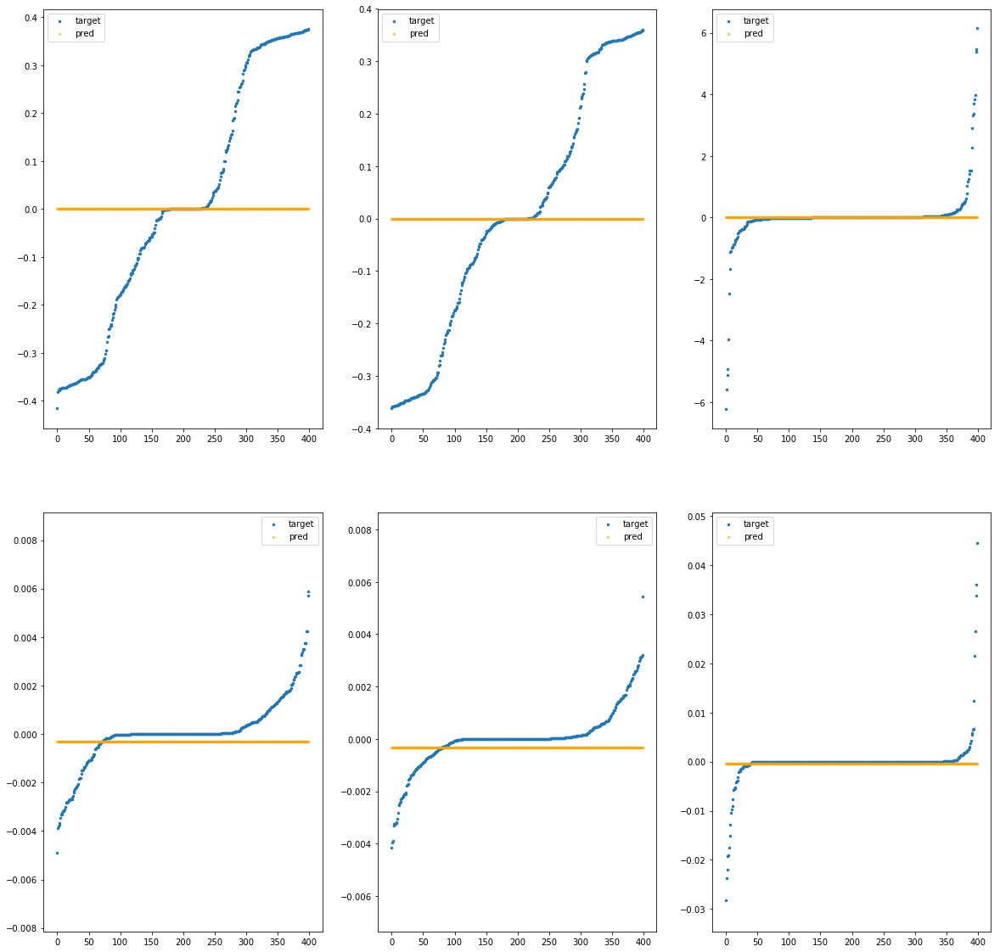

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bf2370>, epochs=100, batch_size=32
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	9.09e+01	6.42e-02	4.13e-03
y		-1.13e-03	3.61e-01	1.88e-01	1.29e+01	5.49e-02	3.01e-03
z		-9.71e-04	6.23e+00	2.77e-01	7.07e+00	8.76e-01	7.67e-01
phi		-2.23e-02	6.03e-03	8.47e-04	3.44e+04	1.90e-06	3.62e-12
theta		-1.97e-02	5.60e-03	6.97e-04	1.24e+04	1.30e-06	1.68e-12
psi		-5.65e-04	4.46e-02	1.36e-03	4.01e+03	2.45e-05	6.02e-10


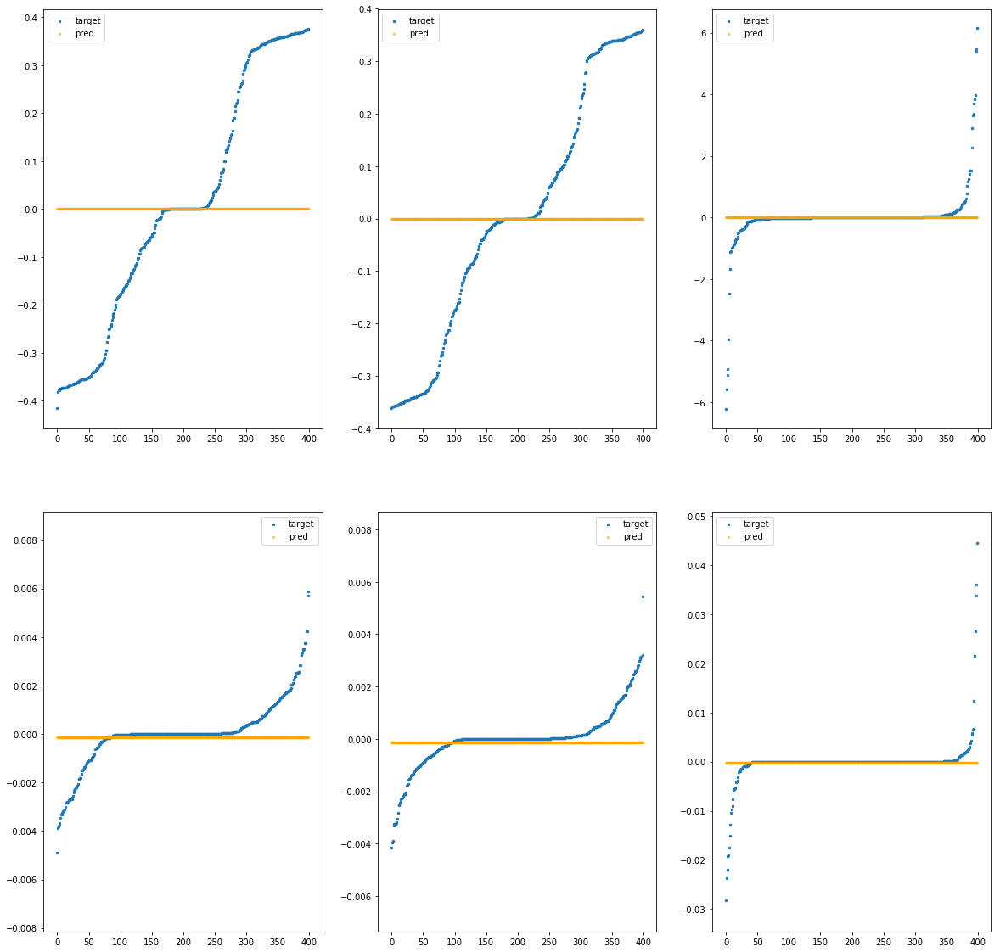

Parameters: filename=../../preprocessed/row_size100_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.ftrl.Ftrl object at 0x7fba51bf23d0>, epochs=100, batch_size=40
		R2		max_err		MAE		MAPE		MSE		RMSE
x		-2.01e-03	4.15e-01	2.05e-01	8.44e+01	6.42e-02	4.13e-03
y		-1.12e-03	3.61e-01	1.88e-01	1.21e+01	5.49e-02	3.01e-03
z		-9.70e-04	6.23e+00	2.77e-01	6.62e+00	8.76e-01	7.67e-01
phi		-2.01e-02	6.02e-03	8.41e-04	3.19e+04	1.90e-06	3.61e-12
theta		-1.72e-02	5.59e-03	6.91e-04	1.15e+04	1.29e-06	1.67e-12
psi		-4.68e-04	4.46e-02	1.35e-03	3.72e+03	2.45e-05	6.02e-10


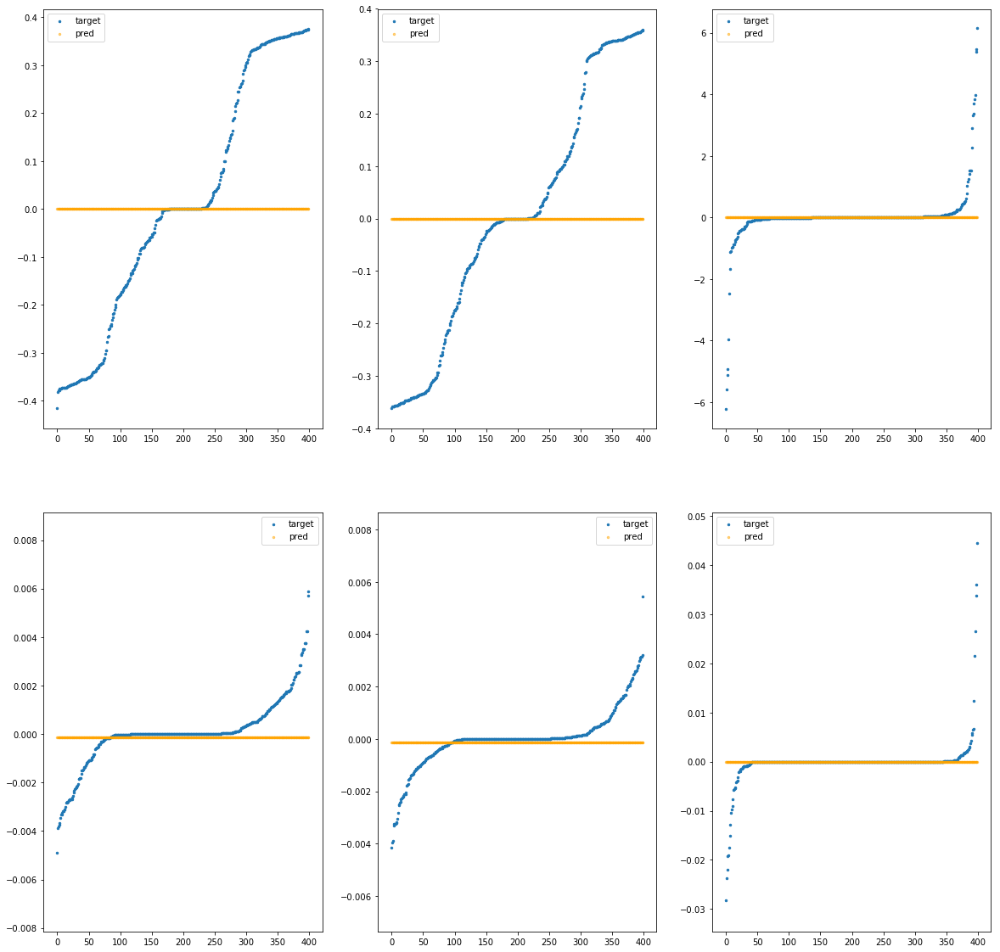

In [3]:
for key, result in search.results.items():
    print(key)
    result['estimator'].print_metrics();
    result['estimator'].plot()

In [4]:

search.print();

X:     1.6372159128841907e-05, Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf850>, epochs=100, batch_size=40
Y:     1.4218186972781555e-05, Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activation="sigmoid"), Dense(64, activation="sigmoid"), Dense(32, activation="sigmoid")], loss=<function mean_squared_error at 0x7fba6a66c0d0>, optimizer=<tensorflow.python.keras.optimizer_v2.adadelta.Adadelta object at 0x7fba6fcbf850>, epochs=100, batch_size=40
Z:     0.006842274734072949, Parameters: filename=../../preprocessed/row_size25_vector_size2000.csv, layers=[Dense(256, activation="sigmoid"), Dense(128, activati